# How to train on a dataset with two bias sources 

In [1]:
import os
os.environ['CUDA_VISIBLE_DEVICES'] = '0'
import sys
from pathlib import Path

module_folder = os.path.abspath('../gridsaliency-original')
if module_folder not in sys.path:
    sys.path.append(module_folder)
from mnist_generators_simple import gen_texture_mnist, plot_samples

scr_folder = os.path.abspath('../scr')
if scr_folder not in sys.path:
    sys.path.insert(1, scr_folder)
from dataloaders import Cityscapes
from metrics import iou_coef, dice_coef, dice_loss
from unet import csbd_unet, manual_unet, TrainUnet
from training_write import TrainingParameters, TrainingResults
from training_plots import plot_predict_and_gt, plot_loss, plot_metric


trainparam = TrainingParameters(
    dataset_name = 'TexturedMnist',
                 n_classes=11
                ,scale = 1
                ,batch_size = 20
                ,last_activation = 'softmax'
                ,n_depth = 4
                ,n_filter_base = 32  # 16
                ,pool = 2
                ,lr = 3.e-4
                ,epochs = 200
                ,validation_steps = 500
                ,steps_per_epoch = 2500
                ,loss = "categorical_crossentropy"
                #,optimizer = Adam(lr=3.e-4)
                ,metrics = ['accuracy',iou_coef,dice_coef]
                ,input_shape=(None, None, 1)

,n_train= 50000
,n_val = 10000

)
trainparam.saveToJson()

patch_shape=(64,64)
unbiased_config = {
    'background_split': 2,
    'dataset_seed': 0,
    'tex_res' : 400,
    'tile_size' : 64,
    'train_samples' : trainparam.n_train,
    'test_samples' : trainparam.n_val,
    'exclude_bias_textures': False,
    'fix_test_set': True,
    'batch_size': trainparam.batch_size,
    'bias': None,
    'textures_path' : Path(module_folder)/'textures/',
}
biased_config = {
    'background_split': 2,
    'dataset_seed': 0,
    'tex_res' : 400,
    'tile_size' : 64,
    'train_samples' : trainparam.n_train,
    'test_samples' : trainparam.n_val,
    'exclude_bias_textures': True,
    'fix_test_set': True,
    'batch_size': trainparam.batch_size,
    'bias': {1 : {
        "source_1_id": "'e55ac5dd.png", 
        "source_2_id": "'e55ac5dd.png",
        "source_1_bias": 0.0, # this texture won't be assigned to the digit
        "source_2_bias": 1.0 # this texture will appear in at least one part of bgr with P=1
    }, 

    2 : {
        "source_1_id": "'feeccd96.png", 
        "source_2_id": "'f135d029.png",
        "source_1_bias": 0.0,
        "source_2_bias": 1.0
    }},
    'textures_path' : Path(module_folder)/'textures/',
}

with open(os.path.join(str(trainparam.outfolder),'bias_configs.txt'), 'w+') as file:
    file.write("Biased config:\n")
    
    for k in biased_config.items():
        file.write(str(k)+"\n")
        
    file.write("\nUnbiased config:\n")
    for k in unbiased_config.items():
        file.write(str(k)+"\n")
    file.close()

Using TensorFlow backend.


print('Biased Test Set')
biased_generator = gen_texture_mnist(biased_config,'test')
plot_samples(biased_generator, 20)

print('Unbiased Test Set')
unbiased_generator = gen_texture_mnist(unbiased_config,'test')
plot_samples(unbiased_generator, 20)

In [2]:
biased_gen_train = gen_texture_mnist(biased_config,'train', return_dict=False)
biased_gen_test = gen_texture_mnist(biased_config,'test', return_dict=False)
unbiased_gen_test = gen_texture_mnist(unbiased_config,'test', return_dict=False)


In [3]:
trainunet = TrainUnet(trainparam)

trainunet.csbdUnet()
fit_out = trainunet.fit_generator(biased_gen_train, biased_gen_test)


trainingResults = TrainingResults(trainparam, fit_out)
trainingResults.modelSummaryTxt()
trainingResults.writeResultsTxt()

Epoch 1/200


 104/2500 [>.............................] - ETA: 2:30:56 - loss: 2.4234 - acc: 0.1115 - iou_coef: 0.0577 - dice_coef: 0.108 - ETA: 1:16:51 - loss: 2.3982 - acc: 0.1319 - iou_coef: 0.0594 - dice_coef: 0.112 - ETA: 52:07 - loss: 2.3637 - acc: 0.1481 - iou_coef: 0.0618 - dice_coef: 0.1162  - ETA: 39:45 - loss: 2.3394 - acc: 0.1642 - iou_coef: 0.0636 - dice_coef: 0.119 - ETA: 32:21 - loss: 2.3150 - acc: 0.1759 - iou_coef: 0.0653 - dice_coef: 0.122 - ETA: 27:24 - loss: 2.2911 - acc: 0.1933 - iou_coef: 0.0674 - dice_coef: 0.126 - ETA: 23:53 - loss: 2.2744 - acc: 0.2092 - iou_coef: 0.0691 - dice_coef: 0.129 - ETA: 21:13 - loss: 2.2564 - acc: 0.2246 - iou_coef: 0.0712 - dice_coef: 0.132 - ETA: 19:09 - loss: 2.2384 - acc: 0.2396 - iou_coef: 0.0733 - dice_coef: 0.136 - ETA: 17:30 - loss: 2.2232 - acc: 0.2538 - iou_coef: 0.0750 - dice_coef: 0.139 - ETA: 16:09 - loss: 2.2055 - acc: 0.2692 - iou_coef: 0.0769 - dice_coef: 0.142 - ETA: 15:02 - loss: 2.1900 - acc: 0.2815 - iou_coef: 0.0786 - dice_coe

 419/2500 [====>.........................] - ETA: 2:49 - loss: 1.0475 - acc: 0.7690 - iou_coef: 0.3273 - dice_coef: 0.47 - ETA: 2:48 - loss: 1.0462 - acc: 0.7693 - iou_coef: 0.3278 - dice_coef: 0.48 - ETA: 2:48 - loss: 1.0448 - acc: 0.7697 - iou_coef: 0.3284 - dice_coef: 0.48 - ETA: 2:48 - loss: 1.0437 - acc: 0.7700 - iou_coef: 0.3289 - dice_coef: 0.48 - ETA: 2:48 - loss: 1.0424 - acc: 0.7703 - iou_coef: 0.3294 - dice_coef: 0.48 - ETA: 2:48 - loss: 1.0411 - acc: 0.7706 - iou_coef: 0.3300 - dice_coef: 0.48 - ETA: 2:48 - loss: 1.0397 - acc: 0.7709 - iou_coef: 0.3306 - dice_coef: 0.48 - ETA: 2:47 - loss: 1.0383 - acc: 0.7713 - iou_coef: 0.3312 - dice_coef: 0.48 - ETA: 2:47 - loss: 1.0369 - acc: 0.7717 - iou_coef: 0.3318 - dice_coef: 0.48 - ETA: 2:47 - loss: 1.0356 - acc: 0.7719 - iou_coef: 0.3323 - dice_coef: 0.48 - ETA: 2:47 - loss: 1.0343 - acc: 0.7723 - iou_coef: 0.3329 - dice_coef: 0.48 - ETA: 2:47 - loss: 1.0331 - acc: 0.7725 - iou_coef: 0.3334 - dice_coef: 0.48 - ETA: 2:47 - loss: 1

 524/2500 [=====>........................] - ETA: 2:34 - loss: 0.9264 - acc: 0.7961 - iou_coef: 0.3834 - dice_coef: 0.53 - ETA: 2:34 - loss: 0.9254 - acc: 0.7963 - iou_coef: 0.3839 - dice_coef: 0.53 - ETA: 2:34 - loss: 0.9243 - acc: 0.7965 - iou_coef: 0.3844 - dice_coef: 0.53 - ETA: 2:34 - loss: 0.9232 - acc: 0.7967 - iou_coef: 0.3849 - dice_coef: 0.53 - ETA: 2:34 - loss: 0.9222 - acc: 0.7969 - iou_coef: 0.3854 - dice_coef: 0.53 - ETA: 2:34 - loss: 0.9211 - acc: 0.7971 - iou_coef: 0.3859 - dice_coef: 0.53 - ETA: 2:34 - loss: 0.9203 - acc: 0.7973 - iou_coef: 0.3864 - dice_coef: 0.53 - ETA: 2:34 - loss: 0.9194 - acc: 0.7975 - iou_coef: 0.3869 - dice_coef: 0.54 - ETA: 2:33 - loss: 0.9184 - acc: 0.7977 - iou_coef: 0.3874 - dice_coef: 0.54 - ETA: 2:33 - loss: 0.9173 - acc: 0.7979 - iou_coef: 0.3879 - dice_coef: 0.54 - ETA: 2:33 - loss: 0.9164 - acc: 0.7981 - iou_coef: 0.3884 - dice_coef: 0.54 - ETA: 2:33 - loss: 0.9154 - acc: 0.7983 - iou_coef: 0.3889 - dice_coef: 0.54 - ETA: 2:33 - loss: 0

 629/2500 [======>.......................] - ETA: 2:23 - loss: 0.8349 - acc: 0.8138 - iou_coef: 0.4306 - dice_coef: 0.58 - ETA: 2:23 - loss: 0.8342 - acc: 0.8139 - iou_coef: 0.4310 - dice_coef: 0.58 - ETA: 2:23 - loss: 0.8335 - acc: 0.8141 - iou_coef: 0.4314 - dice_coef: 0.58 - ETA: 2:23 - loss: 0.8326 - acc: 0.8142 - iou_coef: 0.4318 - dice_coef: 0.58 - ETA: 2:23 - loss: 0.8319 - acc: 0.8144 - iou_coef: 0.4322 - dice_coef: 0.58 - ETA: 2:23 - loss: 0.8311 - acc: 0.8145 - iou_coef: 0.4326 - dice_coef: 0.58 - ETA: 2:23 - loss: 0.8303 - acc: 0.8147 - iou_coef: 0.4330 - dice_coef: 0.58 - ETA: 2:23 - loss: 0.8295 - acc: 0.8148 - iou_coef: 0.4334 - dice_coef: 0.58 - ETA: 2:22 - loss: 0.8287 - acc: 0.8150 - iou_coef: 0.4338 - dice_coef: 0.58 - ETA: 2:22 - loss: 0.8280 - acc: 0.8151 - iou_coef: 0.4342 - dice_coef: 0.58 - ETA: 2:22 - loss: 0.8272 - acc: 0.8152 - iou_coef: 0.4346 - dice_coef: 0.58 - ETA: 2:22 - loss: 0.8266 - acc: 0.8154 - iou_coef: 0.4350 - dice_coef: 0.58 - ETA: 2:22 - loss: 0

 734/2500 [=======>......................] - ETA: 2:13 - loss: 0.7631 - acc: 0.8269 - iou_coef: 0.4692 - dice_coef: 0.61 - ETA: 2:13 - loss: 0.7625 - acc: 0.8270 - iou_coef: 0.4696 - dice_coef: 0.61 - ETA: 2:13 - loss: 0.7618 - acc: 0.8272 - iou_coef: 0.4700 - dice_coef: 0.61 - ETA: 2:13 - loss: 0.7612 - acc: 0.8273 - iou_coef: 0.4703 - dice_coef: 0.61 - ETA: 2:13 - loss: 0.7606 - acc: 0.8274 - iou_coef: 0.4706 - dice_coef: 0.61 - ETA: 2:13 - loss: 0.7598 - acc: 0.8275 - iou_coef: 0.4710 - dice_coef: 0.61 - ETA: 2:13 - loss: 0.7591 - acc: 0.8277 - iou_coef: 0.4714 - dice_coef: 0.61 - ETA: 2:13 - loss: 0.7585 - acc: 0.8278 - iou_coef: 0.4718 - dice_coef: 0.61 - ETA: 2:13 - loss: 0.7578 - acc: 0.8279 - iou_coef: 0.4721 - dice_coef: 0.62 - ETA: 2:13 - loss: 0.7571 - acc: 0.8280 - iou_coef: 0.4725 - dice_coef: 0.62 - ETA: 2:12 - loss: 0.7565 - acc: 0.8281 - iou_coef: 0.4728 - dice_coef: 0.62 - ETA: 2:12 - loss: 0.7559 - acc: 0.8282 - iou_coef: 0.4731 - dice_coef: 0.62 - ETA: 2:12 - loss: 0

 839/2500 [=========>....................] - ETA: 2:04 - loss: 0.7028 - acc: 0.8376 - iou_coef: 0.5025 - dice_coef: 0.64 - ETA: 2:04 - loss: 0.7023 - acc: 0.8377 - iou_coef: 0.5028 - dice_coef: 0.64 - ETA: 2:04 - loss: 0.7016 - acc: 0.8378 - iou_coef: 0.5032 - dice_coef: 0.64 - ETA: 2:04 - loss: 0.7011 - acc: 0.8379 - iou_coef: 0.5035 - dice_coef: 0.64 - ETA: 2:04 - loss: 0.7005 - acc: 0.8380 - iou_coef: 0.5038 - dice_coef: 0.64 - ETA: 2:04 - loss: 0.7000 - acc: 0.8381 - iou_coef: 0.5040 - dice_coef: 0.64 - ETA: 2:04 - loss: 0.6994 - acc: 0.8382 - iou_coef: 0.5044 - dice_coef: 0.64 - ETA: 2:04 - loss: 0.6990 - acc: 0.8383 - iou_coef: 0.5046 - dice_coef: 0.64 - ETA: 2:04 - loss: 0.6985 - acc: 0.8384 - iou_coef: 0.5049 - dice_coef: 0.64 - ETA: 2:04 - loss: 0.6979 - acc: 0.8385 - iou_coef: 0.5052 - dice_coef: 0.64 - ETA: 2:04 - loss: 0.6975 - acc: 0.8385 - iou_coef: 0.5055 - dice_coef: 0.64 - ETA: 2:03 - loss: 0.6971 - acc: 0.8386 - iou_coef: 0.5057 - dice_coef: 0.64 - ETA: 2:03 - loss: 0

 944/2500 [==========>...................] - ETA: 1:56 - loss: 0.6520 - acc: 0.8467 - iou_coef: 0.5311 - dice_coef: 0.67 - ETA: 1:56 - loss: 0.6516 - acc: 0.8468 - iou_coef: 0.5313 - dice_coef: 0.67 - ETA: 1:56 - loss: 0.6511 - acc: 0.8469 - iou_coef: 0.5316 - dice_coef: 0.67 - ETA: 1:56 - loss: 0.6507 - acc: 0.8470 - iou_coef: 0.5318 - dice_coef: 0.67 - ETA: 1:56 - loss: 0.6503 - acc: 0.8471 - iou_coef: 0.5321 - dice_coef: 0.67 - ETA: 1:55 - loss: 0.6499 - acc: 0.8471 - iou_coef: 0.5323 - dice_coef: 0.67 - ETA: 1:55 - loss: 0.6494 - acc: 0.8472 - iou_coef: 0.5326 - dice_coef: 0.67 - ETA: 1:55 - loss: 0.6489 - acc: 0.8473 - iou_coef: 0.5329 - dice_coef: 0.67 - ETA: 1:55 - loss: 0.6485 - acc: 0.8474 - iou_coef: 0.5331 - dice_coef: 0.67 - ETA: 1:55 - loss: 0.6480 - acc: 0.8475 - iou_coef: 0.5334 - dice_coef: 0.67 - ETA: 1:55 - loss: 0.6476 - acc: 0.8476 - iou_coef: 0.5336 - dice_coef: 0.67 - ETA: 1:55 - loss: 0.6471 - acc: 0.8477 - iou_coef: 0.5339 - dice_coef: 0.67 - ETA: 1:55 - loss: 0

1049/2500 [===========>..................] - ETA: 1:48 - loss: 0.6072 - acc: 0.8553 - iou_coef: 0.5568 - dice_coef: 0.69 - ETA: 1:48 - loss: 0.6069 - acc: 0.8553 - iou_coef: 0.5570 - dice_coef: 0.69 - ETA: 1:48 - loss: 0.6065 - acc: 0.8554 - iou_coef: 0.5572 - dice_coef: 0.69 - ETA: 1:48 - loss: 0.6060 - acc: 0.8555 - iou_coef: 0.5574 - dice_coef: 0.69 - ETA: 1:47 - loss: 0.6056 - acc: 0.8556 - iou_coef: 0.5577 - dice_coef: 0.69 - ETA: 1:47 - loss: 0.6052 - acc: 0.8557 - iou_coef: 0.5579 - dice_coef: 0.69 - ETA: 1:47 - loss: 0.6048 - acc: 0.8557 - iou_coef: 0.5582 - dice_coef: 0.69 - ETA: 1:47 - loss: 0.6044 - acc: 0.8558 - iou_coef: 0.5584 - dice_coef: 0.69 - ETA: 1:47 - loss: 0.6040 - acc: 0.8559 - iou_coef: 0.5586 - dice_coef: 0.69 - ETA: 1:47 - loss: 0.6037 - acc: 0.8559 - iou_coef: 0.5588 - dice_coef: 0.69 - ETA: 1:47 - loss: 0.6033 - acc: 0.8560 - iou_coef: 0.5591 - dice_coef: 0.69 - ETA: 1:47 - loss: 0.6029 - acc: 0.8561 - iou_coef: 0.5593 - dice_coef: 0.69 - ETA: 1:47 - loss: 0

1154/2500 [============>.................] - ETA: 1:40 - loss: 0.5696 - acc: 0.8626 - iou_coef: 0.5792 - dice_coef: 0.71 - ETA: 1:40 - loss: 0.5693 - acc: 0.8626 - iou_coef: 0.5794 - dice_coef: 0.71 - ETA: 1:40 - loss: 0.5690 - acc: 0.8627 - iou_coef: 0.5796 - dice_coef: 0.71 - ETA: 1:40 - loss: 0.5686 - acc: 0.8628 - iou_coef: 0.5798 - dice_coef: 0.71 - ETA: 1:40 - loss: 0.5683 - acc: 0.8628 - iou_coef: 0.5800 - dice_coef: 0.71 - ETA: 1:39 - loss: 0.5679 - acc: 0.8629 - iou_coef: 0.5802 - dice_coef: 0.71 - ETA: 1:39 - loss: 0.5676 - acc: 0.8630 - iou_coef: 0.5804 - dice_coef: 0.71 - ETA: 1:39 - loss: 0.5672 - acc: 0.8631 - iou_coef: 0.5806 - dice_coef: 0.71 - ETA: 1:39 - loss: 0.5669 - acc: 0.8631 - iou_coef: 0.5808 - dice_coef: 0.71 - ETA: 1:39 - loss: 0.5666 - acc: 0.8632 - iou_coef: 0.5810 - dice_coef: 0.71 - ETA: 1:39 - loss: 0.5663 - acc: 0.8632 - iou_coef: 0.5812 - dice_coef: 0.71 - ETA: 1:39 - loss: 0.5660 - acc: 0.8633 - iou_coef: 0.5814 - dice_coef: 0.71 - ETA: 1:39 - loss: 0

1259/2500 [==============>...............] - ETA: 1:32 - loss: 0.5364 - acc: 0.8692 - iou_coef: 0.5992 - dice_coef: 0.72 - ETA: 1:32 - loss: 0.5361 - acc: 0.8692 - iou_coef: 0.5994 - dice_coef: 0.72 - ETA: 1:32 - loss: 0.5358 - acc: 0.8693 - iou_coef: 0.5996 - dice_coef: 0.72 - ETA: 1:32 - loss: 0.5355 - acc: 0.8694 - iou_coef: 0.5998 - dice_coef: 0.72 - ETA: 1:32 - loss: 0.5352 - acc: 0.8694 - iou_coef: 0.6000 - dice_coef: 0.72 - ETA: 1:32 - loss: 0.5348 - acc: 0.8695 - iou_coef: 0.6002 - dice_coef: 0.72 - ETA: 1:32 - loss: 0.5346 - acc: 0.8695 - iou_coef: 0.6004 - dice_coef: 0.72 - ETA: 1:32 - loss: 0.5343 - acc: 0.8696 - iou_coef: 0.6005 - dice_coef: 0.72 - ETA: 1:32 - loss: 0.5340 - acc: 0.8696 - iou_coef: 0.6007 - dice_coef: 0.72 - ETA: 1:32 - loss: 0.5337 - acc: 0.8697 - iou_coef: 0.6009 - dice_coef: 0.72 - ETA: 1:32 - loss: 0.5334 - acc: 0.8698 - iou_coef: 0.6010 - dice_coef: 0.72 - ETA: 1:32 - loss: 0.5332 - acc: 0.8698 - iou_coef: 0.6012 - dice_coef: 0.72 - ETA: 1:32 - loss: 0

1364/2500 [===============>..............] - ETA: 1:25 - loss: 0.5075 - acc: 0.8750 - iou_coef: 0.6173 - dice_coef: 0.74 - ETA: 1:25 - loss: 0.5073 - acc: 0.8750 - iou_coef: 0.6174 - dice_coef: 0.74 - ETA: 1:25 - loss: 0.5070 - acc: 0.8751 - iou_coef: 0.6176 - dice_coef: 0.74 - ETA: 1:25 - loss: 0.5067 - acc: 0.8751 - iou_coef: 0.6177 - dice_coef: 0.74 - ETA: 1:25 - loss: 0.5064 - acc: 0.8752 - iou_coef: 0.6179 - dice_coef: 0.74 - ETA: 1:25 - loss: 0.5061 - acc: 0.8752 - iou_coef: 0.6181 - dice_coef: 0.74 - ETA: 1:25 - loss: 0.5058 - acc: 0.8753 - iou_coef: 0.6183 - dice_coef: 0.74 - ETA: 1:25 - loss: 0.5056 - acc: 0.8754 - iou_coef: 0.6184 - dice_coef: 0.74 - ETA: 1:25 - loss: 0.5053 - acc: 0.8754 - iou_coef: 0.6186 - dice_coef: 0.74 - ETA: 1:24 - loss: 0.5051 - acc: 0.8754 - iou_coef: 0.6187 - dice_coef: 0.74 - ETA: 1:24 - loss: 0.5048 - acc: 0.8755 - iou_coef: 0.6189 - dice_coef: 0.74 - ETA: 1:24 - loss: 0.5046 - acc: 0.8756 - iou_coef: 0.6191 - dice_coef: 0.74 - ETA: 1:24 - loss: 0

1469/2500 [================>.............] - ETA: 1:18 - loss: 0.4827 - acc: 0.8799 - iou_coef: 0.6329 - dice_coef: 0.75 - ETA: 1:18 - loss: 0.4825 - acc: 0.8799 - iou_coef: 0.6331 - dice_coef: 0.75 - ETA: 1:18 - loss: 0.4822 - acc: 0.8800 - iou_coef: 0.6332 - dice_coef: 0.75 - ETA: 1:17 - loss: 0.4821 - acc: 0.8800 - iou_coef: 0.6333 - dice_coef: 0.75 - ETA: 1:17 - loss: 0.4818 - acc: 0.8801 - iou_coef: 0.6335 - dice_coef: 0.75 - ETA: 1:17 - loss: 0.4817 - acc: 0.8801 - iou_coef: 0.6336 - dice_coef: 0.75 - ETA: 1:17 - loss: 0.4815 - acc: 0.8801 - iou_coef: 0.6337 - dice_coef: 0.75 - ETA: 1:17 - loss: 0.4813 - acc: 0.8802 - iou_coef: 0.6338 - dice_coef: 0.75 - ETA: 1:17 - loss: 0.4811 - acc: 0.8802 - iou_coef: 0.6340 - dice_coef: 0.75 - ETA: 1:17 - loss: 0.4809 - acc: 0.8802 - iou_coef: 0.6341 - dice_coef: 0.75 - ETA: 1:17 - loss: 0.4807 - acc: 0.8803 - iou_coef: 0.6342 - dice_coef: 0.75 - ETA: 1:17 - loss: 0.4805 - acc: 0.8803 - iou_coef: 0.6344 - dice_coef: 0.75 - ETA: 1:17 - loss: 0

1574/2500 [=================>............] - ETA: 1:10 - loss: 0.4608 - acc: 0.8843 - iou_coef: 0.6469 - dice_coef: 0.76 - ETA: 1:10 - loss: 0.4606 - acc: 0.8843 - iou_coef: 0.6470 - dice_coef: 0.76 - ETA: 1:10 - loss: 0.4604 - acc: 0.8844 - iou_coef: 0.6472 - dice_coef: 0.76 - ETA: 1:10 - loss: 0.4602 - acc: 0.8844 - iou_coef: 0.6473 - dice_coef: 0.76 - ETA: 1:10 - loss: 0.4600 - acc: 0.8845 - iou_coef: 0.6474 - dice_coef: 0.76 - ETA: 1:10 - loss: 0.4597 - acc: 0.8845 - iou_coef: 0.6476 - dice_coef: 0.76 - ETA: 1:10 - loss: 0.4595 - acc: 0.8846 - iou_coef: 0.6477 - dice_coef: 0.76 - ETA: 1:10 - loss: 0.4593 - acc: 0.8846 - iou_coef: 0.6478 - dice_coef: 0.76 - ETA: 1:10 - loss: 0.4592 - acc: 0.8846 - iou_coef: 0.6479 - dice_coef: 0.76 - ETA: 1:10 - loss: 0.4590 - acc: 0.8846 - iou_coef: 0.6480 - dice_coef: 0.76 - ETA: 1:10 - loss: 0.4588 - acc: 0.8847 - iou_coef: 0.6482 - dice_coef: 0.76 - ETA: 1:10 - loss: 0.4587 - acc: 0.8847 - iou_coef: 0.6483 - dice_coef: 0.76 - ETA: 1:09 - loss: 0

1679/2500 [===================>..........] - ETA: 1:03 - loss: 0.4407 - acc: 0.8884 - iou_coef: 0.6599 - dice_coef: 0.77 - ETA: 1:03 - loss: 0.4406 - acc: 0.8884 - iou_coef: 0.6600 - dice_coef: 0.77 - ETA: 1:03 - loss: 0.4405 - acc: 0.8885 - iou_coef: 0.6601 - dice_coef: 0.77 - ETA: 1:03 - loss: 0.4402 - acc: 0.8885 - iou_coef: 0.6602 - dice_coef: 0.77 - ETA: 1:03 - loss: 0.4401 - acc: 0.8885 - iou_coef: 0.6603 - dice_coef: 0.77 - ETA: 1:03 - loss: 0.4399 - acc: 0.8886 - iou_coef: 0.6604 - dice_coef: 0.77 - ETA: 1:03 - loss: 0.4398 - acc: 0.8886 - iou_coef: 0.6605 - dice_coef: 0.77 - ETA: 1:03 - loss: 0.4396 - acc: 0.8886 - iou_coef: 0.6606 - dice_coef: 0.77 - ETA: 1:03 - loss: 0.4394 - acc: 0.8887 - iou_coef: 0.6607 - dice_coef: 0.77 - ETA: 1:03 - loss: 0.4392 - acc: 0.8887 - iou_coef: 0.6609 - dice_coef: 0.77 - ETA: 1:02 - loss: 0.4391 - acc: 0.8887 - iou_coef: 0.6610 - dice_coef: 0.77 - ETA: 1:02 - loss: 0.4389 - acc: 0.8888 - iou_coef: 0.6611 - dice_coef: 0.77 - ETA: 1:02 - loss: 0

1784/2500 [====================>.........] - ETA: 56s - loss: 0.4229 - acc: 0.8921 - iou_coef: 0.6715 - dice_coef: 0.782 - ETA: 56s - loss: 0.4228 - acc: 0.8921 - iou_coef: 0.6716 - dice_coef: 0.782 - ETA: 56s - loss: 0.4226 - acc: 0.8922 - iou_coef: 0.6718 - dice_coef: 0.782 - ETA: 56s - loss: 0.4224 - acc: 0.8922 - iou_coef: 0.6719 - dice_coef: 0.783 - ETA: 56s - loss: 0.4222 - acc: 0.8922 - iou_coef: 0.6720 - dice_coef: 0.783 - ETA: 56s - loss: 0.4221 - acc: 0.8923 - iou_coef: 0.6721 - dice_coef: 0.783 - ETA: 56s - loss: 0.4219 - acc: 0.8923 - iou_coef: 0.6722 - dice_coef: 0.783 - ETA: 55s - loss: 0.4217 - acc: 0.8923 - iou_coef: 0.6723 - dice_coef: 0.783 - ETA: 55s - loss: 0.4216 - acc: 0.8924 - iou_coef: 0.6724 - dice_coef: 0.783 - ETA: 55s - loss: 0.4214 - acc: 0.8924 - iou_coef: 0.6725 - dice_coef: 0.783 - ETA: 55s - loss: 0.4213 - acc: 0.8924 - iou_coef: 0.6726 - dice_coef: 0.783 - ETA: 55s - loss: 0.4211 - acc: 0.8925 - iou_coef: 0.6727 - dice_coef: 0.783 - ETA: 55s - loss: 0.

1889/2500 [=====================>........] - ETA: 49s - loss: 0.4065 - acc: 0.8955 - iou_coef: 0.6823 - dice_coef: 0.790 - ETA: 49s - loss: 0.4064 - acc: 0.8955 - iou_coef: 0.6824 - dice_coef: 0.790 - ETA: 49s - loss: 0.4063 - acc: 0.8956 - iou_coef: 0.6825 - dice_coef: 0.791 - ETA: 49s - loss: 0.4061 - acc: 0.8956 - iou_coef: 0.6826 - dice_coef: 0.791 - ETA: 48s - loss: 0.4060 - acc: 0.8956 - iou_coef: 0.6827 - dice_coef: 0.791 - ETA: 48s - loss: 0.4058 - acc: 0.8957 - iou_coef: 0.6828 - dice_coef: 0.791 - ETA: 48s - loss: 0.4056 - acc: 0.8957 - iou_coef: 0.6829 - dice_coef: 0.791 - ETA: 48s - loss: 0.4055 - acc: 0.8957 - iou_coef: 0.6830 - dice_coef: 0.791 - ETA: 48s - loss: 0.4054 - acc: 0.8957 - iou_coef: 0.6831 - dice_coef: 0.791 - ETA: 48s - loss: 0.4052 - acc: 0.8958 - iou_coef: 0.6832 - dice_coef: 0.791 - ETA: 48s - loss: 0.4050 - acc: 0.8958 - iou_coef: 0.6833 - dice_coef: 0.791 - ETA: 48s - loss: 0.4049 - acc: 0.8959 - iou_coef: 0.6834 - dice_coef: 0.791 - ETA: 48s - loss: 0.

1994/2500 [======================>.......] - ETA: 42s - loss: 0.3923 - acc: 0.8984 - iou_coef: 0.6918 - dice_coef: 0.798 - ETA: 41s - loss: 0.3922 - acc: 0.8984 - iou_coef: 0.6919 - dice_coef: 0.798 - ETA: 41s - loss: 0.3920 - acc: 0.8985 - iou_coef: 0.6920 - dice_coef: 0.798 - ETA: 41s - loss: 0.3919 - acc: 0.8985 - iou_coef: 0.6921 - dice_coef: 0.798 - ETA: 41s - loss: 0.3918 - acc: 0.8985 - iou_coef: 0.6922 - dice_coef: 0.798 - ETA: 41s - loss: 0.3917 - acc: 0.8985 - iou_coef: 0.6922 - dice_coef: 0.798 - ETA: 41s - loss: 0.3916 - acc: 0.8986 - iou_coef: 0.6923 - dice_coef: 0.798 - ETA: 41s - loss: 0.3915 - acc: 0.8986 - iou_coef: 0.6924 - dice_coef: 0.798 - ETA: 41s - loss: 0.3914 - acc: 0.8986 - iou_coef: 0.6925 - dice_coef: 0.798 - ETA: 41s - loss: 0.3912 - acc: 0.8986 - iou_coef: 0.6926 - dice_coef: 0.798 - ETA: 41s - loss: 0.3911 - acc: 0.8987 - iou_coef: 0.6927 - dice_coef: 0.798 - ETA: 41s - loss: 0.3909 - acc: 0.8987 - iou_coef: 0.6928 - dice_coef: 0.798 - ETA: 41s - loss: 0.

2099/2500 [========================>.....] - ETA: 34s - loss: 0.3793 - acc: 0.9011 - iou_coef: 0.7005 - dice_coef: 0.804 - ETA: 34s - loss: 0.3792 - acc: 0.9011 - iou_coef: 0.7006 - dice_coef: 0.804 - ETA: 34s - loss: 0.3791 - acc: 0.9011 - iou_coef: 0.7007 - dice_coef: 0.804 - ETA: 34s - loss: 0.3789 - acc: 0.9012 - iou_coef: 0.7008 - dice_coef: 0.804 - ETA: 34s - loss: 0.3788 - acc: 0.9012 - iou_coef: 0.7009 - dice_coef: 0.804 - ETA: 34s - loss: 0.3786 - acc: 0.9012 - iou_coef: 0.7009 - dice_coef: 0.804 - ETA: 34s - loss: 0.3785 - acc: 0.9012 - iou_coef: 0.7010 - dice_coef: 0.804 - ETA: 34s - loss: 0.3784 - acc: 0.9013 - iou_coef: 0.7011 - dice_coef: 0.804 - ETA: 34s - loss: 0.3783 - acc: 0.9013 - iou_coef: 0.7012 - dice_coef: 0.804 - ETA: 34s - loss: 0.3781 - acc: 0.9013 - iou_coef: 0.7013 - dice_coef: 0.805 - ETA: 34s - loss: 0.3780 - acc: 0.9014 - iou_coef: 0.7014 - dice_coef: 0.805 - ETA: 34s - loss: 0.3779 - acc: 0.9014 - iou_coef: 0.7015 - dice_coef: 0.805 - ETA: 33s - loss: 0.

2204/2500 [=========================>....] - ETA: 27s - loss: 0.3669 - acc: 0.9037 - iou_coef: 0.7088 - dice_coef: 0.810 - ETA: 27s - loss: 0.3669 - acc: 0.9037 - iou_coef: 0.7089 - dice_coef: 0.810 - ETA: 27s - loss: 0.3667 - acc: 0.9037 - iou_coef: 0.7089 - dice_coef: 0.810 - ETA: 27s - loss: 0.3666 - acc: 0.9038 - iou_coef: 0.7090 - dice_coef: 0.810 - ETA: 27s - loss: 0.3665 - acc: 0.9038 - iou_coef: 0.7091 - dice_coef: 0.810 - ETA: 27s - loss: 0.3664 - acc: 0.9038 - iou_coef: 0.7092 - dice_coef: 0.810 - ETA: 27s - loss: 0.3663 - acc: 0.9038 - iou_coef: 0.7092 - dice_coef: 0.810 - ETA: 27s - loss: 0.3662 - acc: 0.9039 - iou_coef: 0.7093 - dice_coef: 0.811 - ETA: 27s - loss: 0.3660 - acc: 0.9039 - iou_coef: 0.7094 - dice_coef: 0.811 - ETA: 26s - loss: 0.3659 - acc: 0.9039 - iou_coef: 0.7095 - dice_coef: 0.811 - ETA: 26s - loss: 0.3658 - acc: 0.9039 - iou_coef: 0.7096 - dice_coef: 0.811 - ETA: 26s - loss: 0.3657 - acc: 0.9040 - iou_coef: 0.7096 - dice_coef: 0.811 - ETA: 26s - loss: 0.

2309/2500 [==========================>...] - ETA: 20s - loss: 0.3555 - acc: 0.9062 - iou_coef: 0.7166 - dice_coef: 0.816 - ETA: 20s - loss: 0.3554 - acc: 0.9062 - iou_coef: 0.7166 - dice_coef: 0.816 - ETA: 20s - loss: 0.3553 - acc: 0.9062 - iou_coef: 0.7167 - dice_coef: 0.816 - ETA: 20s - loss: 0.3552 - acc: 0.9062 - iou_coef: 0.7168 - dice_coef: 0.816 - ETA: 20s - loss: 0.3551 - acc: 0.9063 - iou_coef: 0.7169 - dice_coef: 0.816 - ETA: 20s - loss: 0.3550 - acc: 0.9063 - iou_coef: 0.7169 - dice_coef: 0.816 - ETA: 19s - loss: 0.3549 - acc: 0.9063 - iou_coef: 0.7170 - dice_coef: 0.816 - ETA: 19s - loss: 0.3548 - acc: 0.9063 - iou_coef: 0.7171 - dice_coef: 0.816 - ETA: 19s - loss: 0.3547 - acc: 0.9063 - iou_coef: 0.7171 - dice_coef: 0.816 - ETA: 19s - loss: 0.3546 - acc: 0.9064 - iou_coef: 0.7172 - dice_coef: 0.816 - ETA: 19s - loss: 0.3545 - acc: 0.9064 - iou_coef: 0.7173 - dice_coef: 0.816 - ETA: 19s - loss: 0.3544 - acc: 0.9064 - iou_coef: 0.7174 - dice_coef: 0.816 - ETA: 19s - loss: 0.

2415/2500 [===========================>..] - ETA: 13s - loss: 0.3452 - acc: 0.9084 - iou_coef: 0.7236 - dice_coef: 0.821 - ETA: 13s - loss: 0.3451 - acc: 0.9084 - iou_coef: 0.7237 - dice_coef: 0.821 - ETA: 12s - loss: 0.3450 - acc: 0.9084 - iou_coef: 0.7238 - dice_coef: 0.821 - ETA: 12s - loss: 0.3449 - acc: 0.9084 - iou_coef: 0.7238 - dice_coef: 0.821 - ETA: 12s - loss: 0.3448 - acc: 0.9085 - iou_coef: 0.7239 - dice_coef: 0.821 - ETA: 12s - loss: 0.3447 - acc: 0.9085 - iou_coef: 0.7240 - dice_coef: 0.821 - ETA: 12s - loss: 0.3446 - acc: 0.9085 - iou_coef: 0.7240 - dice_coef: 0.821 - ETA: 12s - loss: 0.3445 - acc: 0.9085 - iou_coef: 0.7241 - dice_coef: 0.821 - ETA: 12s - loss: 0.3444 - acc: 0.9085 - iou_coef: 0.7241 - dice_coef: 0.821 - ETA: 12s - loss: 0.3443 - acc: 0.9086 - iou_coef: 0.7242 - dice_coef: 0.821 - ETA: 12s - loss: 0.3442 - acc: 0.9086 - iou_coef: 0.7243 - dice_coef: 0.822 - ETA: 12s - loss: 0.3441 - acc: 0.9086 - iou_coef: 0.7244 - dice_coef: 0.822 - ETA: 12s - loss: 0.

2500/2500 [==============================] - ETA: 5s - loss: 0.3354 - acc: 0.9105 - iou_coef: 0.7304 - dice_coef: 0.82 - ETA: 5s - loss: 0.3353 - acc: 0.9105 - iou_coef: 0.7305 - dice_coef: 0.82 - ETA: 5s - loss: 0.3352 - acc: 0.9106 - iou_coef: 0.7305 - dice_coef: 0.82 - ETA: 5s - loss: 0.3352 - acc: 0.9106 - iou_coef: 0.7306 - dice_coef: 0.82 - ETA: 5s - loss: 0.3351 - acc: 0.9106 - iou_coef: 0.7307 - dice_coef: 0.82 - ETA: 5s - loss: 0.3350 - acc: 0.9106 - iou_coef: 0.7307 - dice_coef: 0.82 - ETA: 5s - loss: 0.3349 - acc: 0.9106 - iou_coef: 0.7308 - dice_coef: 0.82 - ETA: 5s - loss: 0.3348 - acc: 0.9107 - iou_coef: 0.7308 - dice_coef: 0.82 - ETA: 5s - loss: 0.3347 - acc: 0.9107 - iou_coef: 0.7309 - dice_coef: 0.82 - ETA: 5s - loss: 0.3347 - acc: 0.9107 - iou_coef: 0.7310 - dice_coef: 0.82 - ETA: 5s - loss: 0.3346 - acc: 0.9107 - iou_coef: 0.7310 - dice_coef: 0.82 - ETA: 5s - loss: 0.3345 - acc: 0.9107 - iou_coef: 0.7311 - dice_coef: 0.82 - ETA: 4s - loss: 0.3344 - acc: 0.9107 - iou_

 105/2500 [>.............................] - ETA: 2:54 - loss: 0.2363 - acc: 0.9192 - iou_coef: 0.8193 - dice_coef: 0.89 - ETA: 2:54 - loss: 0.1904 - acc: 0.9336 - iou_coef: 0.8389 - dice_coef: 0.91 - ETA: 2:53 - loss: 0.1530 - acc: 0.9466 - iou_coef: 0.8604 - dice_coef: 0.92 - ETA: 2:52 - loss: 0.1330 - acc: 0.9532 - iou_coef: 0.8722 - dice_coef: 0.93 - ETA: 2:51 - loss: 0.1247 - acc: 0.9553 - iou_coef: 0.8768 - dice_coef: 0.93 - ETA: 2:50 - loss: 0.1173 - acc: 0.9580 - iou_coef: 0.8809 - dice_coef: 0.93 - ETA: 2:49 - loss: 0.1312 - acc: 0.9533 - iou_coef: 0.8739 - dice_coef: 0.93 - ETA: 2:48 - loss: 0.1236 - acc: 0.9560 - iou_coef: 0.8786 - dice_coef: 0.93 - ETA: 2:48 - loss: 0.1208 - acc: 0.9569 - iou_coef: 0.8796 - dice_coef: 0.93 - ETA: 2:47 - loss: 0.1202 - acc: 0.9571 - iou_coef: 0.8791 - dice_coef: 0.93 - ETA: 2:46 - loss: 0.1175 - acc: 0.9581 - iou_coef: 0.8802 - dice_coef: 0.93 - ETA: 2:46 - loss: 0.1210 - acc: 0.9570 - iou_coef: 0.8790 - dice_coef: 0.93 - ETA: 2:46 - loss: 0

 420/2500 [====>.........................] - ETA: 2:42 - loss: 0.1164 - acc: 0.9584 - iou_coef: 0.8830 - dice_coef: 0.93 - ETA: 2:42 - loss: 0.1163 - acc: 0.9585 - iou_coef: 0.8831 - dice_coef: 0.93 - ETA: 2:42 - loss: 0.1163 - acc: 0.9584 - iou_coef: 0.8831 - dice_coef: 0.93 - ETA: 2:42 - loss: 0.1163 - acc: 0.9585 - iou_coef: 0.8831 - dice_coef: 0.93 - ETA: 2:41 - loss: 0.1162 - acc: 0.9585 - iou_coef: 0.8832 - dice_coef: 0.93 - ETA: 2:41 - loss: 0.1162 - acc: 0.9585 - iou_coef: 0.8831 - dice_coef: 0.93 - ETA: 2:41 - loss: 0.1163 - acc: 0.9585 - iou_coef: 0.8831 - dice_coef: 0.93 - ETA: 2:41 - loss: 0.1166 - acc: 0.9584 - iou_coef: 0.8829 - dice_coef: 0.93 - ETA: 2:41 - loss: 0.1166 - acc: 0.9584 - iou_coef: 0.8829 - dice_coef: 0.93 - ETA: 2:41 - loss: 0.1166 - acc: 0.9584 - iou_coef: 0.8829 - dice_coef: 0.93 - ETA: 2:41 - loss: 0.1164 - acc: 0.9584 - iou_coef: 0.8831 - dice_coef: 0.93 - ETA: 2:41 - loss: 0.1164 - acc: 0.9585 - iou_coef: 0.8831 - dice_coef: 0.93 - ETA: 2:41 - loss: 0

 525/2500 [=====>........................] - ETA: 2:33 - loss: 0.1154 - acc: 0.9590 - iou_coef: 0.8845 - dice_coef: 0.93 - ETA: 2:33 - loss: 0.1154 - acc: 0.9590 - iou_coef: 0.8845 - dice_coef: 0.93 - ETA: 2:33 - loss: 0.1154 - acc: 0.9590 - iou_coef: 0.8846 - dice_coef: 0.93 - ETA: 2:33 - loss: 0.1153 - acc: 0.9590 - iou_coef: 0.8846 - dice_coef: 0.93 - ETA: 2:33 - loss: 0.1154 - acc: 0.9590 - iou_coef: 0.8845 - dice_coef: 0.93 - ETA: 2:33 - loss: 0.1154 - acc: 0.9590 - iou_coef: 0.8846 - dice_coef: 0.93 - ETA: 2:33 - loss: 0.1153 - acc: 0.9591 - iou_coef: 0.8846 - dice_coef: 0.93 - ETA: 2:33 - loss: 0.1153 - acc: 0.9591 - iou_coef: 0.8846 - dice_coef: 0.93 - ETA: 2:33 - loss: 0.1154 - acc: 0.9590 - iou_coef: 0.8846 - dice_coef: 0.93 - ETA: 2:33 - loss: 0.1152 - acc: 0.9591 - iou_coef: 0.8847 - dice_coef: 0.93 - ETA: 2:33 - loss: 0.1154 - acc: 0.9590 - iou_coef: 0.8846 - dice_coef: 0.93 - ETA: 2:33 - loss: 0.1152 - acc: 0.9591 - iou_coef: 0.8847 - dice_coef: 0.93 - ETA: 2:32 - loss: 0

 630/2500 [======>.......................] - ETA: 2:25 - loss: 0.1123 - acc: 0.9600 - iou_coef: 0.8869 - dice_coef: 0.93 - ETA: 2:25 - loss: 0.1123 - acc: 0.9600 - iou_coef: 0.8869 - dice_coef: 0.93 - ETA: 2:25 - loss: 0.1122 - acc: 0.9600 - iou_coef: 0.8870 - dice_coef: 0.93 - ETA: 2:25 - loss: 0.1122 - acc: 0.9600 - iou_coef: 0.8869 - dice_coef: 0.93 - ETA: 2:25 - loss: 0.1121 - acc: 0.9601 - iou_coef: 0.8870 - dice_coef: 0.93 - ETA: 2:25 - loss: 0.1121 - acc: 0.9601 - iou_coef: 0.8870 - dice_coef: 0.93 - ETA: 2:25 - loss: 0.1121 - acc: 0.9601 - iou_coef: 0.8870 - dice_coef: 0.93 - ETA: 2:25 - loss: 0.1120 - acc: 0.9601 - iou_coef: 0.8871 - dice_coef: 0.93 - ETA: 2:25 - loss: 0.1119 - acc: 0.9601 - iou_coef: 0.8871 - dice_coef: 0.93 - ETA: 2:25 - loss: 0.1119 - acc: 0.9601 - iou_coef: 0.8871 - dice_coef: 0.93 - ETA: 2:25 - loss: 0.1120 - acc: 0.9601 - iou_coef: 0.8871 - dice_coef: 0.93 - ETA: 2:24 - loss: 0.1120 - acc: 0.9601 - iou_coef: 0.8871 - dice_coef: 0.93 - ETA: 2:24 - loss: 0

 735/2500 [=======>......................] - ETA: 2:17 - loss: 0.1115 - acc: 0.9602 - iou_coef: 0.8877 - dice_coef: 0.93 - ETA: 2:17 - loss: 0.1115 - acc: 0.9602 - iou_coef: 0.8877 - dice_coef: 0.93 - ETA: 2:17 - loss: 0.1115 - acc: 0.9602 - iou_coef: 0.8877 - dice_coef: 0.93 - ETA: 2:17 - loss: 0.1115 - acc: 0.9602 - iou_coef: 0.8877 - dice_coef: 0.93 - ETA: 2:17 - loss: 0.1115 - acc: 0.9602 - iou_coef: 0.8877 - dice_coef: 0.93 - ETA: 2:17 - loss: 0.1115 - acc: 0.9602 - iou_coef: 0.8877 - dice_coef: 0.93 - ETA: 2:17 - loss: 0.1114 - acc: 0.9603 - iou_coef: 0.8878 - dice_coef: 0.93 - ETA: 2:17 - loss: 0.1114 - acc: 0.9603 - iou_coef: 0.8878 - dice_coef: 0.93 - ETA: 2:17 - loss: 0.1113 - acc: 0.9603 - iou_coef: 0.8878 - dice_coef: 0.93 - ETA: 2:17 - loss: 0.1113 - acc: 0.9603 - iou_coef: 0.8878 - dice_coef: 0.93 - ETA: 2:17 - loss: 0.1113 - acc: 0.9603 - iou_coef: 0.8878 - dice_coef: 0.93 - ETA: 2:17 - loss: 0.1112 - acc: 0.9603 - iou_coef: 0.8878 - dice_coef: 0.93 - ETA: 2:17 - loss: 0

 840/2500 [=========>....................] - ETA: 2:10 - loss: 0.1089 - acc: 0.9611 - iou_coef: 0.8898 - dice_coef: 0.94 - ETA: 2:10 - loss: 0.1089 - acc: 0.9611 - iou_coef: 0.8898 - dice_coef: 0.94 - ETA: 2:09 - loss: 0.1088 - acc: 0.9611 - iou_coef: 0.8899 - dice_coef: 0.94 - ETA: 2:09 - loss: 0.1088 - acc: 0.9611 - iou_coef: 0.8899 - dice_coef: 0.94 - ETA: 2:09 - loss: 0.1087 - acc: 0.9611 - iou_coef: 0.8900 - dice_coef: 0.94 - ETA: 2:09 - loss: 0.1087 - acc: 0.9611 - iou_coef: 0.8900 - dice_coef: 0.94 - ETA: 2:09 - loss: 0.1087 - acc: 0.9611 - iou_coef: 0.8900 - dice_coef: 0.94 - ETA: 2:09 - loss: 0.1088 - acc: 0.9611 - iou_coef: 0.8899 - dice_coef: 0.94 - ETA: 2:09 - loss: 0.1088 - acc: 0.9611 - iou_coef: 0.8899 - dice_coef: 0.94 - ETA: 2:09 - loss: 0.1088 - acc: 0.9611 - iou_coef: 0.8899 - dice_coef: 0.94 - ETA: 2:09 - loss: 0.1088 - acc: 0.9611 - iou_coef: 0.8900 - dice_coef: 0.94 - ETA: 2:09 - loss: 0.1087 - acc: 0.9612 - iou_coef: 0.8900 - dice_coef: 0.94 - ETA: 2:09 - loss: 0

 945/2500 [==========>...................] - ETA: 2:05 - loss: 0.1072 - acc: 0.9616 - iou_coef: 0.8913 - dice_coef: 0.94 - ETA: 2:05 - loss: 0.1072 - acc: 0.9616 - iou_coef: 0.8914 - dice_coef: 0.94 - ETA: 2:05 - loss: 0.1072 - acc: 0.9616 - iou_coef: 0.8914 - dice_coef: 0.94 - ETA: 2:05 - loss: 0.1071 - acc: 0.9617 - iou_coef: 0.8914 - dice_coef: 0.94 - ETA: 2:05 - loss: 0.1072 - acc: 0.9616 - iou_coef: 0.8913 - dice_coef: 0.94 - ETA: 2:05 - loss: 0.1072 - acc: 0.9616 - iou_coef: 0.8914 - dice_coef: 0.94 - ETA: 2:05 - loss: 0.1071 - acc: 0.9617 - iou_coef: 0.8914 - dice_coef: 0.94 - ETA: 2:04 - loss: 0.1071 - acc: 0.9617 - iou_coef: 0.8914 - dice_coef: 0.94 - ETA: 2:04 - loss: 0.1071 - acc: 0.9617 - iou_coef: 0.8914 - dice_coef: 0.94 - ETA: 2:04 - loss: 0.1071 - acc: 0.9617 - iou_coef: 0.8915 - dice_coef: 0.94 - ETA: 2:04 - loss: 0.1071 - acc: 0.9617 - iou_coef: 0.8915 - dice_coef: 0.94 - ETA: 2:04 - loss: 0.1071 - acc: 0.9617 - iou_coef: 0.8915 - dice_coef: 0.94 - ETA: 2:04 - loss: 0

1050/2500 [===========>..................] - ETA: 1:57 - loss: 0.1062 - acc: 0.9619 - iou_coef: 0.8923 - dice_coef: 0.94 - ETA: 1:57 - loss: 0.1062 - acc: 0.9619 - iou_coef: 0.8923 - dice_coef: 0.94 - ETA: 1:57 - loss: 0.1063 - acc: 0.9619 - iou_coef: 0.8923 - dice_coef: 0.94 - ETA: 1:57 - loss: 0.1062 - acc: 0.9619 - iou_coef: 0.8923 - dice_coef: 0.94 - ETA: 1:57 - loss: 0.1062 - acc: 0.9619 - iou_coef: 0.8923 - dice_coef: 0.94 - ETA: 1:57 - loss: 0.1063 - acc: 0.9619 - iou_coef: 0.8923 - dice_coef: 0.94 - ETA: 1:57 - loss: 0.1063 - acc: 0.9619 - iou_coef: 0.8923 - dice_coef: 0.94 - ETA: 1:57 - loss: 0.1062 - acc: 0.9619 - iou_coef: 0.8924 - dice_coef: 0.94 - ETA: 1:57 - loss: 0.1063 - acc: 0.9619 - iou_coef: 0.8923 - dice_coef: 0.94 - ETA: 1:56 - loss: 0.1062 - acc: 0.9619 - iou_coef: 0.8924 - dice_coef: 0.94 - ETA: 1:56 - loss: 0.1063 - acc: 0.9619 - iou_coef: 0.8923 - dice_coef: 0.94 - ETA: 1:56 - loss: 0.1063 - acc: 0.9619 - iou_coef: 0.8923 - dice_coef: 0.94 - ETA: 1:56 - loss: 0

1155/2500 [============>.................] - ETA: 1:49 - loss: 0.1055 - acc: 0.9622 - iou_coef: 0.8931 - dice_coef: 0.94 - ETA: 1:49 - loss: 0.1055 - acc: 0.9622 - iou_coef: 0.8932 - dice_coef: 0.94 - ETA: 1:48 - loss: 0.1055 - acc: 0.9622 - iou_coef: 0.8932 - dice_coef: 0.94 - ETA: 1:48 - loss: 0.1055 - acc: 0.9622 - iou_coef: 0.8932 - dice_coef: 0.94 - ETA: 1:48 - loss: 0.1054 - acc: 0.9622 - iou_coef: 0.8932 - dice_coef: 0.94 - ETA: 1:48 - loss: 0.1054 - acc: 0.9622 - iou_coef: 0.8932 - dice_coef: 0.94 - ETA: 1:48 - loss: 0.1054 - acc: 0.9622 - iou_coef: 0.8932 - dice_coef: 0.94 - ETA: 1:48 - loss: 0.1054 - acc: 0.9622 - iou_coef: 0.8932 - dice_coef: 0.94 - ETA: 1:48 - loss: 0.1054 - acc: 0.9622 - iou_coef: 0.8932 - dice_coef: 0.94 - ETA: 1:48 - loss: 0.1053 - acc: 0.9623 - iou_coef: 0.8933 - dice_coef: 0.94 - ETA: 1:48 - loss: 0.1053 - acc: 0.9623 - iou_coef: 0.8933 - dice_coef: 0.94 - ETA: 1:48 - loss: 0.1053 - acc: 0.9623 - iou_coef: 0.8933 - dice_coef: 0.94 - ETA: 1:48 - loss: 0

1260/2500 [==============>...............] - ETA: 1:41 - loss: 0.1045 - acc: 0.9625 - iou_coef: 0.8941 - dice_coef: 0.94 - ETA: 1:41 - loss: 0.1045 - acc: 0.9625 - iou_coef: 0.8941 - dice_coef: 0.94 - ETA: 1:41 - loss: 0.1045 - acc: 0.9625 - iou_coef: 0.8941 - dice_coef: 0.94 - ETA: 1:41 - loss: 0.1045 - acc: 0.9625 - iou_coef: 0.8941 - dice_coef: 0.94 - ETA: 1:41 - loss: 0.1045 - acc: 0.9626 - iou_coef: 0.8942 - dice_coef: 0.94 - ETA: 1:40 - loss: 0.1044 - acc: 0.9626 - iou_coef: 0.8942 - dice_coef: 0.94 - ETA: 1:40 - loss: 0.1045 - acc: 0.9626 - iou_coef: 0.8942 - dice_coef: 0.94 - ETA: 1:40 - loss: 0.1044 - acc: 0.9626 - iou_coef: 0.8942 - dice_coef: 0.94 - ETA: 1:40 - loss: 0.1044 - acc: 0.9626 - iou_coef: 0.8942 - dice_coef: 0.94 - ETA: 1:40 - loss: 0.1044 - acc: 0.9626 - iou_coef: 0.8942 - dice_coef: 0.94 - ETA: 1:40 - loss: 0.1043 - acc: 0.9626 - iou_coef: 0.8943 - dice_coef: 0.94 - ETA: 1:40 - loss: 0.1043 - acc: 0.9626 - iou_coef: 0.8943 - dice_coef: 0.94 - ETA: 1:40 - loss: 0

1365/2500 [===============>..............] - ETA: 1:33 - loss: 0.1036 - acc: 0.9629 - iou_coef: 0.8951 - dice_coef: 0.94 - ETA: 1:33 - loss: 0.1035 - acc: 0.9629 - iou_coef: 0.8951 - dice_coef: 0.94 - ETA: 1:33 - loss: 0.1036 - acc: 0.9629 - iou_coef: 0.8951 - dice_coef: 0.94 - ETA: 1:33 - loss: 0.1035 - acc: 0.9629 - iou_coef: 0.8951 - dice_coef: 0.94 - ETA: 1:33 - loss: 0.1036 - acc: 0.9628 - iou_coef: 0.8951 - dice_coef: 0.94 - ETA: 1:33 - loss: 0.1036 - acc: 0.9628 - iou_coef: 0.8951 - dice_coef: 0.94 - ETA: 1:33 - loss: 0.1035 - acc: 0.9629 - iou_coef: 0.8951 - dice_coef: 0.94 - ETA: 1:33 - loss: 0.1035 - acc: 0.9629 - iou_coef: 0.8951 - dice_coef: 0.94 - ETA: 1:32 - loss: 0.1035 - acc: 0.9629 - iou_coef: 0.8951 - dice_coef: 0.94 - ETA: 1:32 - loss: 0.1035 - acc: 0.9629 - iou_coef: 0.8951 - dice_coef: 0.94 - ETA: 1:32 - loss: 0.1035 - acc: 0.9629 - iou_coef: 0.8952 - dice_coef: 0.94 - ETA: 1:32 - loss: 0.1034 - acc: 0.9629 - iou_coef: 0.8952 - dice_coef: 0.94 - ETA: 1:32 - loss: 0

1470/2500 [================>.............] - ETA: 1:25 - loss: 0.1029 - acc: 0.9631 - iou_coef: 0.8958 - dice_coef: 0.94 - ETA: 1:25 - loss: 0.1029 - acc: 0.9631 - iou_coef: 0.8958 - dice_coef: 0.94 - ETA: 1:25 - loss: 0.1029 - acc: 0.9631 - iou_coef: 0.8959 - dice_coef: 0.94 - ETA: 1:25 - loss: 0.1029 - acc: 0.9631 - iou_coef: 0.8959 - dice_coef: 0.94 - ETA: 1:25 - loss: 0.1029 - acc: 0.9631 - iou_coef: 0.8959 - dice_coef: 0.94 - ETA: 1:25 - loss: 0.1029 - acc: 0.9631 - iou_coef: 0.8959 - dice_coef: 0.94 - ETA: 1:25 - loss: 0.1029 - acc: 0.9631 - iou_coef: 0.8959 - dice_coef: 0.94 - ETA: 1:25 - loss: 0.1029 - acc: 0.9631 - iou_coef: 0.8959 - dice_coef: 0.94 - ETA: 1:25 - loss: 0.1029 - acc: 0.9631 - iou_coef: 0.8959 - dice_coef: 0.94 - ETA: 1:25 - loss: 0.1029 - acc: 0.9631 - iou_coef: 0.8959 - dice_coef: 0.94 - ETA: 1:25 - loss: 0.1029 - acc: 0.9631 - iou_coef: 0.8959 - dice_coef: 0.94 - ETA: 1:24 - loss: 0.1029 - acc: 0.9631 - iou_coef: 0.8959 - dice_coef: 0.94 - ETA: 1:24 - loss: 0

1575/2500 [=================>............] - ETA: 1:17 - loss: 0.1018 - acc: 0.9635 - iou_coef: 0.8969 - dice_coef: 0.94 - ETA: 1:17 - loss: 0.1018 - acc: 0.9635 - iou_coef: 0.8970 - dice_coef: 0.94 - ETA: 1:17 - loss: 0.1018 - acc: 0.9635 - iou_coef: 0.8970 - dice_coef: 0.94 - ETA: 1:17 - loss: 0.1018 - acc: 0.9635 - iou_coef: 0.8970 - dice_coef: 0.94 - ETA: 1:17 - loss: 0.1018 - acc: 0.9635 - iou_coef: 0.8970 - dice_coef: 0.94 - ETA: 1:17 - loss: 0.1017 - acc: 0.9635 - iou_coef: 0.8970 - dice_coef: 0.94 - ETA: 1:17 - loss: 0.1017 - acc: 0.9635 - iou_coef: 0.8970 - dice_coef: 0.94 - ETA: 1:17 - loss: 0.1017 - acc: 0.9635 - iou_coef: 0.8970 - dice_coef: 0.94 - ETA: 1:17 - loss: 0.1017 - acc: 0.9635 - iou_coef: 0.8970 - dice_coef: 0.94 - ETA: 1:17 - loss: 0.1017 - acc: 0.9635 - iou_coef: 0.8971 - dice_coef: 0.94 - ETA: 1:17 - loss: 0.1017 - acc: 0.9635 - iou_coef: 0.8970 - dice_coef: 0.94 - ETA: 1:17 - loss: 0.1017 - acc: 0.9635 - iou_coef: 0.8971 - dice_coef: 0.94 - ETA: 1:17 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.1010 - acc: 0.9638 - iou_coef: 0.8978 - dice_coef: 0.94 - ETA: 1:09 - loss: 0.1010 - acc: 0.9638 - iou_coef: 0.8978 - dice_coef: 0.94 - ETA: 1:09 - loss: 0.1010 - acc: 0.9638 - iou_coef: 0.8978 - dice_coef: 0.94 - ETA: 1:09 - loss: 0.1010 - acc: 0.9638 - iou_coef: 0.8978 - dice_coef: 0.94 - ETA: 1:09 - loss: 0.1010 - acc: 0.9638 - iou_coef: 0.8978 - dice_coef: 0.94 - ETA: 1:09 - loss: 0.1010 - acc: 0.9638 - iou_coef: 0.8978 - dice_coef: 0.94 - ETA: 1:09 - loss: 0.1009 - acc: 0.9638 - iou_coef: 0.8978 - dice_coef: 0.94 - ETA: 1:09 - loss: 0.1009 - acc: 0.9638 - iou_coef: 0.8979 - dice_coef: 0.94 - ETA: 1:09 - loss: 0.1009 - acc: 0.9638 - iou_coef: 0.8979 - dice_coef: 0.94 - ETA: 1:09 - loss: 0.1009 - acc: 0.9638 - iou_coef: 0.8979 - dice_coef: 0.94 - ETA: 1:09 - loss: 0.1009 - acc: 0.9638 - iou_coef: 0.8979 - dice_coef: 0.94 - ETA: 1:09 - loss: 0.1009 - acc: 0.9638 - iou_coef: 0.8979 - dice_coef: 0.94 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.1003 - acc: 0.9640 - iou_coef: 0.8985 - dice_coef: 0.94 - ETA: 1:01 - loss: 0.1003 - acc: 0.9640 - iou_coef: 0.8985 - dice_coef: 0.94 - ETA: 1:01 - loss: 0.1003 - acc: 0.9640 - iou_coef: 0.8985 - dice_coef: 0.94 - ETA: 1:01 - loss: 0.1003 - acc: 0.9640 - iou_coef: 0.8985 - dice_coef: 0.94 - ETA: 1:01 - loss: 0.1003 - acc: 0.9640 - iou_coef: 0.8985 - dice_coef: 0.94 - ETA: 1:01 - loss: 0.1002 - acc: 0.9640 - iou_coef: 0.8986 - dice_coef: 0.94 - ETA: 1:01 - loss: 0.1003 - acc: 0.9640 - iou_coef: 0.8985 - dice_coef: 0.94 - ETA: 1:01 - loss: 0.1002 - acc: 0.9640 - iou_coef: 0.8986 - dice_coef: 0.94 - ETA: 1:01 - loss: 0.1002 - acc: 0.9640 - iou_coef: 0.8986 - dice_coef: 0.94 - ETA: 1:01 - loss: 0.1002 - acc: 0.9640 - iou_coef: 0.8986 - dice_coef: 0.94 - ETA: 1:01 - loss: 0.1002 - acc: 0.9640 - iou_coef: 0.8986 - dice_coef: 0.94 - ETA: 1:00 - loss: 0.1002 - acc: 0.9640 - iou_coef: 0.8986 - dice_coef: 0.94 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0996 - acc: 0.9643 - iou_coef: 0.8993 - dice_coef: 0.945 - ETA: 53s - loss: 0.0996 - acc: 0.9643 - iou_coef: 0.8993 - dice_coef: 0.945 - ETA: 53s - loss: 0.0995 - acc: 0.9643 - iou_coef: 0.8993 - dice_coef: 0.945 - ETA: 53s - loss: 0.0995 - acc: 0.9643 - iou_coef: 0.8993 - dice_coef: 0.945 - ETA: 53s - loss: 0.0995 - acc: 0.9643 - iou_coef: 0.8993 - dice_coef: 0.945 - ETA: 53s - loss: 0.0995 - acc: 0.9643 - iou_coef: 0.8993 - dice_coef: 0.945 - ETA: 53s - loss: 0.0995 - acc: 0.9643 - iou_coef: 0.8993 - dice_coef: 0.945 - ETA: 53s - loss: 0.0995 - acc: 0.9643 - iou_coef: 0.8994 - dice_coef: 0.945 - ETA: 53s - loss: 0.0994 - acc: 0.9643 - iou_coef: 0.8994 - dice_coef: 0.945 - ETA: 53s - loss: 0.0994 - acc: 0.9643 - iou_coef: 0.8994 - dice_coef: 0.945 - ETA: 52s - loss: 0.0994 - acc: 0.9643 - iou_coef: 0.8994 - dice_coef: 0.945 - ETA: 52s - loss: 0.0994 - acc: 0.9643 - iou_coef: 0.8994 - dice_coef: 0.945 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0984 - acc: 0.9647 - iou_coef: 0.9004 - dice_coef: 0.946 - ETA: 45s - loss: 0.0984 - acc: 0.9647 - iou_coef: 0.9004 - dice_coef: 0.946 - ETA: 45s - loss: 0.0983 - acc: 0.9647 - iou_coef: 0.9004 - dice_coef: 0.946 - ETA: 45s - loss: 0.0983 - acc: 0.9647 - iou_coef: 0.9004 - dice_coef: 0.946 - ETA: 45s - loss: 0.0983 - acc: 0.9647 - iou_coef: 0.9004 - dice_coef: 0.946 - ETA: 45s - loss: 0.0983 - acc: 0.9647 - iou_coef: 0.9004 - dice_coef: 0.946 - ETA: 45s - loss: 0.0983 - acc: 0.9647 - iou_coef: 0.9004 - dice_coef: 0.946 - ETA: 45s - loss: 0.0983 - acc: 0.9647 - iou_coef: 0.9004 - dice_coef: 0.946 - ETA: 45s - loss: 0.0983 - acc: 0.9647 - iou_coef: 0.9004 - dice_coef: 0.946 - ETA: 45s - loss: 0.0983 - acc: 0.9647 - iou_coef: 0.9004 - dice_coef: 0.946 - ETA: 45s - loss: 0.0983 - acc: 0.9647 - iou_coef: 0.9004 - dice_coef: 0.946 - ETA: 44s - loss: 0.0983 - acc: 0.9647 - iou_coef: 0.9004 - dice_coef: 0.946 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0976 - acc: 0.9650 - iou_coef: 0.9012 - dice_coef: 0.946 - ETA: 37s - loss: 0.0976 - acc: 0.9650 - iou_coef: 0.9012 - dice_coef: 0.946 - ETA: 37s - loss: 0.0976 - acc: 0.9650 - iou_coef: 0.9012 - dice_coef: 0.946 - ETA: 37s - loss: 0.0976 - acc: 0.9650 - iou_coef: 0.9012 - dice_coef: 0.946 - ETA: 37s - loss: 0.0976 - acc: 0.9650 - iou_coef: 0.9012 - dice_coef: 0.946 - ETA: 37s - loss: 0.0976 - acc: 0.9650 - iou_coef: 0.9012 - dice_coef: 0.946 - ETA: 37s - loss: 0.0976 - acc: 0.9650 - iou_coef: 0.9012 - dice_coef: 0.946 - ETA: 37s - loss: 0.0975 - acc: 0.9650 - iou_coef: 0.9012 - dice_coef: 0.946 - ETA: 37s - loss: 0.0975 - acc: 0.9650 - iou_coef: 0.9012 - dice_coef: 0.946 - ETA: 37s - loss: 0.0975 - acc: 0.9650 - iou_coef: 0.9012 - dice_coef: 0.946 - ETA: 37s - loss: 0.0976 - acc: 0.9650 - iou_coef: 0.9012 - dice_coef: 0.946 - ETA: 37s - loss: 0.0976 - acc: 0.9650 - iou_coef: 0.9012 - dice_coef: 0.946 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0966 - acc: 0.9653 - iou_coef: 0.9021 - dice_coef: 0.947 - ETA: 29s - loss: 0.0966 - acc: 0.9653 - iou_coef: 0.9021 - dice_coef: 0.947 - ETA: 29s - loss: 0.0965 - acc: 0.9653 - iou_coef: 0.9021 - dice_coef: 0.947 - ETA: 29s - loss: 0.0965 - acc: 0.9653 - iou_coef: 0.9021 - dice_coef: 0.947 - ETA: 29s - loss: 0.0966 - acc: 0.9653 - iou_coef: 0.9021 - dice_coef: 0.947 - ETA: 29s - loss: 0.0965 - acc: 0.9653 - iou_coef: 0.9021 - dice_coef: 0.947 - ETA: 29s - loss: 0.0965 - acc: 0.9653 - iou_coef: 0.9021 - dice_coef: 0.947 - ETA: 29s - loss: 0.0965 - acc: 0.9653 - iou_coef: 0.9022 - dice_coef: 0.947 - ETA: 29s - loss: 0.0965 - acc: 0.9653 - iou_coef: 0.9022 - dice_coef: 0.947 - ETA: 29s - loss: 0.0965 - acc: 0.9653 - iou_coef: 0.9022 - dice_coef: 0.947 - ETA: 29s - loss: 0.0965 - acc: 0.9653 - iou_coef: 0.9022 - dice_coef: 0.947 - ETA: 29s - loss: 0.0965 - acc: 0.9653 - iou_coef: 0.9022 - dice_coef: 0.947 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0957 - acc: 0.9656 - iou_coef: 0.9029 - dice_coef: 0.947 - ETA: 21s - loss: 0.0957 - acc: 0.9656 - iou_coef: 0.9030 - dice_coef: 0.947 - ETA: 21s - loss: 0.0957 - acc: 0.9656 - iou_coef: 0.9030 - dice_coef: 0.947 - ETA: 21s - loss: 0.0956 - acc: 0.9656 - iou_coef: 0.9030 - dice_coef: 0.947 - ETA: 21s - loss: 0.0956 - acc: 0.9656 - iou_coef: 0.9030 - dice_coef: 0.947 - ETA: 21s - loss: 0.0956 - acc: 0.9656 - iou_coef: 0.9030 - dice_coef: 0.947 - ETA: 21s - loss: 0.0956 - acc: 0.9656 - iou_coef: 0.9030 - dice_coef: 0.947 - ETA: 21s - loss: 0.0957 - acc: 0.9656 - iou_coef: 0.9030 - dice_coef: 0.947 - ETA: 21s - loss: 0.0957 - acc: 0.9656 - iou_coef: 0.9030 - dice_coef: 0.947 - ETA: 21s - loss: 0.0957 - acc: 0.9656 - iou_coef: 0.9030 - dice_coef: 0.947 - ETA: 21s - loss: 0.0957 - acc: 0.9656 - iou_coef: 0.9030 - dice_coef: 0.947 - ETA: 21s - loss: 0.0957 - acc: 0.9656 - iou_coef: 0.9030 - dice_coef: 0.947 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0951 - acc: 0.9658 - iou_coef: 0.9036 - dice_coef: 0.948 - ETA: 13s - loss: 0.0951 - acc: 0.9658 - iou_coef: 0.9036 - dice_coef: 0.948 - ETA: 13s - loss: 0.0951 - acc: 0.9658 - iou_coef: 0.9036 - dice_coef: 0.948 - ETA: 13s - loss: 0.0951 - acc: 0.9658 - iou_coef: 0.9036 - dice_coef: 0.948 - ETA: 13s - loss: 0.0951 - acc: 0.9658 - iou_coef: 0.9036 - dice_coef: 0.948 - ETA: 13s - loss: 0.0951 - acc: 0.9658 - iou_coef: 0.9036 - dice_coef: 0.948 - ETA: 13s - loss: 0.0951 - acc: 0.9658 - iou_coef: 0.9036 - dice_coef: 0.948 - ETA: 13s - loss: 0.0951 - acc: 0.9658 - iou_coef: 0.9036 - dice_coef: 0.948 - ETA: 13s - loss: 0.0951 - acc: 0.9658 - iou_coef: 0.9036 - dice_coef: 0.948 - ETA: 13s - loss: 0.0951 - acc: 0.9658 - iou_coef: 0.9036 - dice_coef: 0.948 - ETA: 13s - loss: 0.0951 - acc: 0.9658 - iou_coef: 0.9036 - dice_coef: 0.948 - ETA: 13s - loss: 0.0951 - acc: 0.9658 - iou_coef: 0.9036 - dice_coef: 0.948 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0945 - acc: 0.9660 - iou_coef: 0.9042 - dice_coef: 0.94 - ETA: 6s - loss: 0.0945 - acc: 0.9660 - iou_coef: 0.9042 - dice_coef: 0.94 - ETA: 5s - loss: 0.0945 - acc: 0.9660 - iou_coef: 0.9042 - dice_coef: 0.94 - ETA: 5s - loss: 0.0945 - acc: 0.9660 - iou_coef: 0.9042 - dice_coef: 0.94 - ETA: 5s - loss: 0.0945 - acc: 0.9660 - iou_coef: 0.9042 - dice_coef: 0.94 - ETA: 5s - loss: 0.0945 - acc: 0.9660 - iou_coef: 0.9042 - dice_coef: 0.94 - ETA: 5s - loss: 0.0945 - acc: 0.9660 - iou_coef: 0.9042 - dice_coef: 0.94 - ETA: 5s - loss: 0.0945 - acc: 0.9660 - iou_coef: 0.9042 - dice_coef: 0.94 - ETA: 5s - loss: 0.0945 - acc: 0.9660 - iou_coef: 0.9042 - dice_coef: 0.94 - ETA: 5s - loss: 0.0945 - acc: 0.9660 - iou_coef: 0.9042 - dice_coef: 0.94 - ETA: 5s - loss: 0.0945 - acc: 0.9661 - iou_coef: 0.9042 - dice_coef: 0.94 - ETA: 5s - loss: 0.0945 - acc: 0.9661 - iou_coef: 0.9042 - dice_coef: 0.94 - ETA: 5s - loss: 0.0945 - acc: 0.9661 - iou_

 105/2500 [>.............................] - ETA: 2:42 - loss: 0.0397 - acc: 0.9880 - iou_coef: 0.9553 - dice_coef: 0.97 - ETA: 2:46 - loss: 0.0506 - acc: 0.9838 - iou_coef: 0.9490 - dice_coef: 0.97 - ETA: 2:48 - loss: 0.0611 - acc: 0.9795 - iou_coef: 0.9385 - dice_coef: 0.96 - ETA: 2:50 - loss: 0.0826 - acc: 0.9715 - iou_coef: 0.9226 - dice_coef: 0.95 - ETA: 2:50 - loss: 0.0718 - acc: 0.9752 - iou_coef: 0.9303 - dice_coef: 0.96 - ETA: 2:51 - loss: 0.0758 - acc: 0.9741 - iou_coef: 0.9283 - dice_coef: 0.96 - ETA: 2:50 - loss: 0.0782 - acc: 0.9736 - iou_coef: 0.9261 - dice_coef: 0.96 - ETA: 2:50 - loss: 0.0738 - acc: 0.9752 - iou_coef: 0.9284 - dice_coef: 0.96 - ETA: 2:49 - loss: 0.0734 - acc: 0.9752 - iou_coef: 0.9274 - dice_coef: 0.96 - ETA: 2:48 - loss: 0.0697 - acc: 0.9765 - iou_coef: 0.9299 - dice_coef: 0.96 - ETA: 2:48 - loss: 0.0716 - acc: 0.9752 - iou_coef: 0.9275 - dice_coef: 0.96 - ETA: 2:48 - loss: 0.0727 - acc: 0.9746 - iou_coef: 0.9263 - dice_coef: 0.96 - ETA: 2:47 - loss: 0

 420/2500 [====>.........................] - ETA: 2:25 - loss: 0.0819 - acc: 0.9703 - iou_coef: 0.9176 - dice_coef: 0.95 - ETA: 2:25 - loss: 0.0818 - acc: 0.9703 - iou_coef: 0.9177 - dice_coef: 0.95 - ETA: 2:24 - loss: 0.0819 - acc: 0.9703 - iou_coef: 0.9176 - dice_coef: 0.95 - ETA: 2:24 - loss: 0.0819 - acc: 0.9703 - iou_coef: 0.9176 - dice_coef: 0.95 - ETA: 2:24 - loss: 0.0818 - acc: 0.9704 - iou_coef: 0.9177 - dice_coef: 0.95 - ETA: 2:24 - loss: 0.0818 - acc: 0.9704 - iou_coef: 0.9176 - dice_coef: 0.95 - ETA: 2:24 - loss: 0.0818 - acc: 0.9704 - iou_coef: 0.9176 - dice_coef: 0.95 - ETA: 2:24 - loss: 0.0823 - acc: 0.9702 - iou_coef: 0.9174 - dice_coef: 0.95 - ETA: 2:24 - loss: 0.0822 - acc: 0.9702 - iou_coef: 0.9174 - dice_coef: 0.95 - ETA: 2:24 - loss: 0.0821 - acc: 0.9703 - iou_coef: 0.9175 - dice_coef: 0.95 - ETA: 2:24 - loss: 0.0820 - acc: 0.9703 - iou_coef: 0.9176 - dice_coef: 0.95 - ETA: 2:24 - loss: 0.0819 - acc: 0.9704 - iou_coef: 0.9177 - dice_coef: 0.95 - ETA: 2:24 - loss: 0

 525/2500 [=====>........................] - ETA: 2:18 - loss: 0.0803 - acc: 0.9710 - iou_coef: 0.9190 - dice_coef: 0.95 - ETA: 2:18 - loss: 0.0804 - acc: 0.9709 - iou_coef: 0.9189 - dice_coef: 0.95 - ETA: 2:18 - loss: 0.0803 - acc: 0.9709 - iou_coef: 0.9189 - dice_coef: 0.95 - ETA: 2:17 - loss: 0.0803 - acc: 0.9710 - iou_coef: 0.9190 - dice_coef: 0.95 - ETA: 2:17 - loss: 0.0803 - acc: 0.9709 - iou_coef: 0.9189 - dice_coef: 0.95 - ETA: 2:17 - loss: 0.0803 - acc: 0.9709 - iou_coef: 0.9190 - dice_coef: 0.95 - ETA: 2:17 - loss: 0.0802 - acc: 0.9710 - iou_coef: 0.9190 - dice_coef: 0.95 - ETA: 2:17 - loss: 0.0802 - acc: 0.9710 - iou_coef: 0.9190 - dice_coef: 0.95 - ETA: 2:17 - loss: 0.0802 - acc: 0.9710 - iou_coef: 0.9190 - dice_coef: 0.95 - ETA: 2:17 - loss: 0.0801 - acc: 0.9710 - iou_coef: 0.9191 - dice_coef: 0.95 - ETA: 2:17 - loss: 0.0801 - acc: 0.9710 - iou_coef: 0.9190 - dice_coef: 0.95 - ETA: 2:17 - loss: 0.0800 - acc: 0.9710 - iou_coef: 0.9191 - dice_coef: 0.95 - ETA: 2:17 - loss: 0

 630/2500 [======>.......................] - ETA: 2:10 - loss: 0.0785 - acc: 0.9715 - iou_coef: 0.9206 - dice_coef: 0.95 - ETA: 2:10 - loss: 0.0784 - acc: 0.9715 - iou_coef: 0.9206 - dice_coef: 0.95 - ETA: 2:10 - loss: 0.0784 - acc: 0.9716 - iou_coef: 0.9206 - dice_coef: 0.95 - ETA: 2:10 - loss: 0.0784 - acc: 0.9716 - iou_coef: 0.9206 - dice_coef: 0.95 - ETA: 2:10 - loss: 0.0783 - acc: 0.9716 - iou_coef: 0.9207 - dice_coef: 0.95 - ETA: 2:10 - loss: 0.0783 - acc: 0.9716 - iou_coef: 0.9207 - dice_coef: 0.95 - ETA: 2:10 - loss: 0.0783 - acc: 0.9716 - iou_coef: 0.9207 - dice_coef: 0.95 - ETA: 2:10 - loss: 0.0782 - acc: 0.9716 - iou_coef: 0.9208 - dice_coef: 0.95 - ETA: 2:10 - loss: 0.0782 - acc: 0.9716 - iou_coef: 0.9208 - dice_coef: 0.95 - ETA: 2:10 - loss: 0.0782 - acc: 0.9716 - iou_coef: 0.9208 - dice_coef: 0.95 - ETA: 2:10 - loss: 0.0782 - acc: 0.9716 - iou_coef: 0.9207 - dice_coef: 0.95 - ETA: 2:10 - loss: 0.0782 - acc: 0.9716 - iou_coef: 0.9208 - dice_coef: 0.95 - ETA: 2:10 - loss: 0

 735/2500 [=======>......................] - ETA: 2:03 - loss: 0.0784 - acc: 0.9715 - iou_coef: 0.9206 - dice_coef: 0.95 - ETA: 2:03 - loss: 0.0784 - acc: 0.9715 - iou_coef: 0.9206 - dice_coef: 0.95 - ETA: 2:03 - loss: 0.0784 - acc: 0.9715 - iou_coef: 0.9206 - dice_coef: 0.95 - ETA: 2:03 - loss: 0.0784 - acc: 0.9715 - iou_coef: 0.9207 - dice_coef: 0.95 - ETA: 2:03 - loss: 0.0784 - acc: 0.9715 - iou_coef: 0.9207 - dice_coef: 0.95 - ETA: 2:03 - loss: 0.0784 - acc: 0.9715 - iou_coef: 0.9207 - dice_coef: 0.95 - ETA: 2:03 - loss: 0.0783 - acc: 0.9715 - iou_coef: 0.9207 - dice_coef: 0.95 - ETA: 2:03 - loss: 0.0783 - acc: 0.9715 - iou_coef: 0.9207 - dice_coef: 0.95 - ETA: 2:03 - loss: 0.0783 - acc: 0.9715 - iou_coef: 0.9207 - dice_coef: 0.95 - ETA: 2:03 - loss: 0.0784 - acc: 0.9715 - iou_coef: 0.9207 - dice_coef: 0.95 - ETA: 2:03 - loss: 0.0784 - acc: 0.9715 - iou_coef: 0.9207 - dice_coef: 0.95 - ETA: 2:03 - loss: 0.0783 - acc: 0.9716 - iou_coef: 0.9207 - dice_coef: 0.95 - ETA: 2:02 - loss: 0

 840/2500 [=========>....................] - ETA: 1:56 - loss: 0.0771 - acc: 0.9720 - iou_coef: 0.9218 - dice_coef: 0.95 - ETA: 1:56 - loss: 0.0771 - acc: 0.9720 - iou_coef: 0.9218 - dice_coef: 0.95 - ETA: 1:56 - loss: 0.0771 - acc: 0.9720 - iou_coef: 0.9218 - dice_coef: 0.95 - ETA: 1:56 - loss: 0.0771 - acc: 0.9720 - iou_coef: 0.9219 - dice_coef: 0.95 - ETA: 1:56 - loss: 0.0770 - acc: 0.9720 - iou_coef: 0.9219 - dice_coef: 0.95 - ETA: 1:56 - loss: 0.0770 - acc: 0.9720 - iou_coef: 0.9219 - dice_coef: 0.95 - ETA: 1:56 - loss: 0.0770 - acc: 0.9720 - iou_coef: 0.9219 - dice_coef: 0.95 - ETA: 1:56 - loss: 0.0771 - acc: 0.9720 - iou_coef: 0.9219 - dice_coef: 0.95 - ETA: 1:56 - loss: 0.0771 - acc: 0.9720 - iou_coef: 0.9218 - dice_coef: 0.95 - ETA: 1:56 - loss: 0.0772 - acc: 0.9720 - iou_coef: 0.9218 - dice_coef: 0.95 - ETA: 1:56 - loss: 0.0772 - acc: 0.9720 - iou_coef: 0.9218 - dice_coef: 0.95 - ETA: 1:56 - loss: 0.0771 - acc: 0.9720 - iou_coef: 0.9219 - dice_coef: 0.95 - ETA: 1:56 - loss: 0

 945/2500 [==========>...................] - ETA: 1:50 - loss: 0.0762 - acc: 0.9723 - iou_coef: 0.9227 - dice_coef: 0.95 - ETA: 1:50 - loss: 0.0762 - acc: 0.9723 - iou_coef: 0.9227 - dice_coef: 0.95 - ETA: 1:50 - loss: 0.0762 - acc: 0.9723 - iou_coef: 0.9227 - dice_coef: 0.95 - ETA: 1:50 - loss: 0.0761 - acc: 0.9723 - iou_coef: 0.9227 - dice_coef: 0.95 - ETA: 1:49 - loss: 0.0762 - acc: 0.9723 - iou_coef: 0.9227 - dice_coef: 0.95 - ETA: 1:49 - loss: 0.0762 - acc: 0.9723 - iou_coef: 0.9227 - dice_coef: 0.95 - ETA: 1:49 - loss: 0.0761 - acc: 0.9723 - iou_coef: 0.9228 - dice_coef: 0.95 - ETA: 1:49 - loss: 0.0761 - acc: 0.9724 - iou_coef: 0.9228 - dice_coef: 0.95 - ETA: 1:49 - loss: 0.0761 - acc: 0.9724 - iou_coef: 0.9228 - dice_coef: 0.95 - ETA: 1:49 - loss: 0.0761 - acc: 0.9724 - iou_coef: 0.9228 - dice_coef: 0.95 - ETA: 1:49 - loss: 0.0761 - acc: 0.9724 - iou_coef: 0.9228 - dice_coef: 0.95 - ETA: 1:49 - loss: 0.0761 - acc: 0.9724 - iou_coef: 0.9228 - dice_coef: 0.95 - ETA: 1:49 - loss: 0

1050/2500 [===========>..................] - ETA: 1:43 - loss: 0.0755 - acc: 0.9726 - iou_coef: 0.9233 - dice_coef: 0.95 - ETA: 1:43 - loss: 0.0755 - acc: 0.9726 - iou_coef: 0.9233 - dice_coef: 0.95 - ETA: 1:43 - loss: 0.0755 - acc: 0.9725 - iou_coef: 0.9232 - dice_coef: 0.95 - ETA: 1:43 - loss: 0.0755 - acc: 0.9725 - iou_coef: 0.9232 - dice_coef: 0.95 - ETA: 1:43 - loss: 0.0755 - acc: 0.9725 - iou_coef: 0.9232 - dice_coef: 0.95 - ETA: 1:43 - loss: 0.0755 - acc: 0.9725 - iou_coef: 0.9232 - dice_coef: 0.95 - ETA: 1:42 - loss: 0.0755 - acc: 0.9725 - iou_coef: 0.9232 - dice_coef: 0.95 - ETA: 1:42 - loss: 0.0755 - acc: 0.9725 - iou_coef: 0.9232 - dice_coef: 0.95 - ETA: 1:42 - loss: 0.0756 - acc: 0.9725 - iou_coef: 0.9232 - dice_coef: 0.95 - ETA: 1:42 - loss: 0.0755 - acc: 0.9725 - iou_coef: 0.9232 - dice_coef: 0.95 - ETA: 1:42 - loss: 0.0755 - acc: 0.9725 - iou_coef: 0.9232 - dice_coef: 0.95 - ETA: 1:42 - loss: 0.0755 - acc: 0.9725 - iou_coef: 0.9232 - dice_coef: 0.95 - ETA: 1:42 - loss: 0

1155/2500 [============>.................] - ETA: 1:36 - loss: 0.0759 - acc: 0.9724 - iou_coef: 0.9231 - dice_coef: 0.95 - ETA: 1:36 - loss: 0.0759 - acc: 0.9725 - iou_coef: 0.9231 - dice_coef: 0.95 - ETA: 1:36 - loss: 0.0759 - acc: 0.9725 - iou_coef: 0.9231 - dice_coef: 0.95 - ETA: 1:36 - loss: 0.0759 - acc: 0.9724 - iou_coef: 0.9231 - dice_coef: 0.95 - ETA: 1:36 - loss: 0.0759 - acc: 0.9725 - iou_coef: 0.9231 - dice_coef: 0.95 - ETA: 1:36 - loss: 0.0759 - acc: 0.9725 - iou_coef: 0.9232 - dice_coef: 0.95 - ETA: 1:36 - loss: 0.0759 - acc: 0.9725 - iou_coef: 0.9231 - dice_coef: 0.95 - ETA: 1:36 - loss: 0.0759 - acc: 0.9725 - iou_coef: 0.9231 - dice_coef: 0.95 - ETA: 1:35 - loss: 0.0759 - acc: 0.9725 - iou_coef: 0.9231 - dice_coef: 0.95 - ETA: 1:35 - loss: 0.0758 - acc: 0.9725 - iou_coef: 0.9232 - dice_coef: 0.95 - ETA: 1:35 - loss: 0.0758 - acc: 0.9725 - iou_coef: 0.9232 - dice_coef: 0.95 - ETA: 1:35 - loss: 0.0758 - acc: 0.9725 - iou_coef: 0.9232 - dice_coef: 0.95 - ETA: 1:35 - loss: 0

1260/2500 [==============>...............] - ETA: 1:29 - loss: 0.0756 - acc: 0.9725 - iou_coef: 0.9234 - dice_coef: 0.95 - ETA: 1:29 - loss: 0.0756 - acc: 0.9725 - iou_coef: 0.9234 - dice_coef: 0.95 - ETA: 1:29 - loss: 0.0756 - acc: 0.9725 - iou_coef: 0.9234 - dice_coef: 0.95 - ETA: 1:29 - loss: 0.0756 - acc: 0.9726 - iou_coef: 0.9235 - dice_coef: 0.95 - ETA: 1:29 - loss: 0.0755 - acc: 0.9726 - iou_coef: 0.9235 - dice_coef: 0.95 - ETA: 1:29 - loss: 0.0755 - acc: 0.9726 - iou_coef: 0.9235 - dice_coef: 0.95 - ETA: 1:29 - loss: 0.0755 - acc: 0.9726 - iou_coef: 0.9235 - dice_coef: 0.95 - ETA: 1:29 - loss: 0.0755 - acc: 0.9726 - iou_coef: 0.9235 - dice_coef: 0.95 - ETA: 1:29 - loss: 0.0755 - acc: 0.9726 - iou_coef: 0.9235 - dice_coef: 0.95 - ETA: 1:28 - loss: 0.0755 - acc: 0.9726 - iou_coef: 0.9235 - dice_coef: 0.95 - ETA: 1:28 - loss: 0.0754 - acc: 0.9726 - iou_coef: 0.9235 - dice_coef: 0.95 - ETA: 1:28 - loss: 0.0754 - acc: 0.9726 - iou_coef: 0.9236 - dice_coef: 0.95 - ETA: 1:28 - loss: 0

1365/2500 [===============>..............] - ETA: 1:22 - loss: 0.0751 - acc: 0.9727 - iou_coef: 0.9238 - dice_coef: 0.95 - ETA: 1:22 - loss: 0.0750 - acc: 0.9727 - iou_coef: 0.9239 - dice_coef: 0.95 - ETA: 1:22 - loss: 0.0750 - acc: 0.9727 - iou_coef: 0.9239 - dice_coef: 0.95 - ETA: 1:22 - loss: 0.0750 - acc: 0.9727 - iou_coef: 0.9239 - dice_coef: 0.95 - ETA: 1:22 - loss: 0.0750 - acc: 0.9727 - iou_coef: 0.9239 - dice_coef: 0.95 - ETA: 1:22 - loss: 0.0750 - acc: 0.9727 - iou_coef: 0.9239 - dice_coef: 0.95 - ETA: 1:22 - loss: 0.0750 - acc: 0.9727 - iou_coef: 0.9239 - dice_coef: 0.95 - ETA: 1:22 - loss: 0.0750 - acc: 0.9727 - iou_coef: 0.9239 - dice_coef: 0.95 - ETA: 1:22 - loss: 0.0750 - acc: 0.9727 - iou_coef: 0.9239 - dice_coef: 0.95 - ETA: 1:22 - loss: 0.0750 - acc: 0.9727 - iou_coef: 0.9239 - dice_coef: 0.95 - ETA: 1:22 - loss: 0.0750 - acc: 0.9727 - iou_coef: 0.9239 - dice_coef: 0.95 - ETA: 1:21 - loss: 0.0749 - acc: 0.9728 - iou_coef: 0.9239 - dice_coef: 0.95 - ETA: 1:21 - loss: 0

1470/2500 [================>.............] - ETA: 1:15 - loss: 0.0745 - acc: 0.9729 - iou_coef: 0.9243 - dice_coef: 0.95 - ETA: 1:15 - loss: 0.0745 - acc: 0.9729 - iou_coef: 0.9243 - dice_coef: 0.95 - ETA: 1:15 - loss: 0.0745 - acc: 0.9729 - iou_coef: 0.9243 - dice_coef: 0.95 - ETA: 1:15 - loss: 0.0745 - acc: 0.9729 - iou_coef: 0.9243 - dice_coef: 0.95 - ETA: 1:15 - loss: 0.0745 - acc: 0.9729 - iou_coef: 0.9243 - dice_coef: 0.95 - ETA: 1:15 - loss: 0.0745 - acc: 0.9729 - iou_coef: 0.9243 - dice_coef: 0.95 - ETA: 1:15 - loss: 0.0745 - acc: 0.9729 - iou_coef: 0.9243 - dice_coef: 0.95 - ETA: 1:15 - loss: 0.0745 - acc: 0.9729 - iou_coef: 0.9243 - dice_coef: 0.95 - ETA: 1:15 - loss: 0.0744 - acc: 0.9729 - iou_coef: 0.9243 - dice_coef: 0.95 - ETA: 1:15 - loss: 0.0744 - acc: 0.9729 - iou_coef: 0.9243 - dice_coef: 0.95 - ETA: 1:15 - loss: 0.0744 - acc: 0.9729 - iou_coef: 0.9243 - dice_coef: 0.95 - ETA: 1:15 - loss: 0.0745 - acc: 0.9729 - iou_coef: 0.9243 - dice_coef: 0.95 - ETA: 1:15 - loss: 0

1575/2500 [=================>............] - ETA: 1:09 - loss: 0.0739 - acc: 0.9731 - iou_coef: 0.9248 - dice_coef: 0.96 - ETA: 1:08 - loss: 0.0739 - acc: 0.9731 - iou_coef: 0.9248 - dice_coef: 0.96 - ETA: 1:08 - loss: 0.0739 - acc: 0.9731 - iou_coef: 0.9248 - dice_coef: 0.96 - ETA: 1:08 - loss: 0.0739 - acc: 0.9731 - iou_coef: 0.9248 - dice_coef: 0.96 - ETA: 1:08 - loss: 0.0739 - acc: 0.9731 - iou_coef: 0.9248 - dice_coef: 0.96 - ETA: 1:08 - loss: 0.0739 - acc: 0.9731 - iou_coef: 0.9249 - dice_coef: 0.96 - ETA: 1:08 - loss: 0.0739 - acc: 0.9731 - iou_coef: 0.9249 - dice_coef: 0.96 - ETA: 1:08 - loss: 0.0739 - acc: 0.9731 - iou_coef: 0.9249 - dice_coef: 0.96 - ETA: 1:08 - loss: 0.0739 - acc: 0.9731 - iou_coef: 0.9249 - dice_coef: 0.96 - ETA: 1:08 - loss: 0.0739 - acc: 0.9731 - iou_coef: 0.9249 - dice_coef: 0.96 - ETA: 1:08 - loss: 0.0740 - acc: 0.9731 - iou_coef: 0.9248 - dice_coef: 0.96 - ETA: 1:08 - loss: 0.0740 - acc: 0.9731 - iou_coef: 0.9248 - dice_coef: 0.96 - ETA: 1:08 - loss: 0

1680/2500 [===================>..........] - ETA: 1:02 - loss: 0.0743 - acc: 0.9730 - iou_coef: 0.9247 - dice_coef: 0.96 - ETA: 1:01 - loss: 0.0743 - acc: 0.9730 - iou_coef: 0.9247 - dice_coef: 0.96 - ETA: 1:01 - loss: 0.0743 - acc: 0.9730 - iou_coef: 0.9247 - dice_coef: 0.96 - ETA: 1:01 - loss: 0.0743 - acc: 0.9730 - iou_coef: 0.9247 - dice_coef: 0.96 - ETA: 1:01 - loss: 0.0742 - acc: 0.9730 - iou_coef: 0.9247 - dice_coef: 0.96 - ETA: 1:01 - loss: 0.0742 - acc: 0.9730 - iou_coef: 0.9247 - dice_coef: 0.96 - ETA: 1:01 - loss: 0.0742 - acc: 0.9730 - iou_coef: 0.9247 - dice_coef: 0.96 - ETA: 1:01 - loss: 0.0742 - acc: 0.9730 - iou_coef: 0.9247 - dice_coef: 0.96 - ETA: 1:01 - loss: 0.0742 - acc: 0.9730 - iou_coef: 0.9248 - dice_coef: 0.96 - ETA: 1:01 - loss: 0.0742 - acc: 0.9730 - iou_coef: 0.9248 - dice_coef: 0.96 - ETA: 1:01 - loss: 0.0742 - acc: 0.9730 - iou_coef: 0.9247 - dice_coef: 0.96 - ETA: 1:01 - loss: 0.0742 - acc: 0.9730 - iou_coef: 0.9248 - dice_coef: 0.96 - ETA: 1:01 - loss: 0

1785/2500 [====================>.........] - ETA: 55s - loss: 0.0740 - acc: 0.9731 - iou_coef: 0.9248 - dice_coef: 0.960 - ETA: 54s - loss: 0.0741 - acc: 0.9731 - iou_coef: 0.9248 - dice_coef: 0.960 - ETA: 54s - loss: 0.0741 - acc: 0.9730 - iou_coef: 0.9248 - dice_coef: 0.960 - ETA: 54s - loss: 0.0741 - acc: 0.9730 - iou_coef: 0.9248 - dice_coef: 0.960 - ETA: 54s - loss: 0.0741 - acc: 0.9730 - iou_coef: 0.9248 - dice_coef: 0.960 - ETA: 54s - loss: 0.0740 - acc: 0.9731 - iou_coef: 0.9249 - dice_coef: 0.960 - ETA: 54s - loss: 0.0740 - acc: 0.9730 - iou_coef: 0.9248 - dice_coef: 0.960 - ETA: 54s - loss: 0.0740 - acc: 0.9731 - iou_coef: 0.9249 - dice_coef: 0.960 - ETA: 54s - loss: 0.0741 - acc: 0.9731 - iou_coef: 0.9248 - dice_coef: 0.960 - ETA: 54s - loss: 0.0740 - acc: 0.9731 - iou_coef: 0.9249 - dice_coef: 0.960 - ETA: 54s - loss: 0.0740 - acc: 0.9731 - iou_coef: 0.9249 - dice_coef: 0.960 - ETA: 54s - loss: 0.0740 - acc: 0.9731 - iou_coef: 0.9249 - dice_coef: 0.960 - ETA: 54s - loss: 0.

1890/2500 [=====================>........] - ETA: 48s - loss: 0.0740 - acc: 0.9731 - iou_coef: 0.9250 - dice_coef: 0.960 - ETA: 47s - loss: 0.0740 - acc: 0.9731 - iou_coef: 0.9250 - dice_coef: 0.960 - ETA: 47s - loss: 0.0740 - acc: 0.9731 - iou_coef: 0.9250 - dice_coef: 0.960 - ETA: 47s - loss: 0.0740 - acc: 0.9731 - iou_coef: 0.9250 - dice_coef: 0.960 - ETA: 47s - loss: 0.0740 - acc: 0.9731 - iou_coef: 0.9250 - dice_coef: 0.960 - ETA: 47s - loss: 0.0740 - acc: 0.9731 - iou_coef: 0.9251 - dice_coef: 0.960 - ETA: 47s - loss: 0.0739 - acc: 0.9731 - iou_coef: 0.9251 - dice_coef: 0.960 - ETA: 47s - loss: 0.0739 - acc: 0.9731 - iou_coef: 0.9251 - dice_coef: 0.960 - ETA: 47s - loss: 0.0739 - acc: 0.9731 - iou_coef: 0.9251 - dice_coef: 0.960 - ETA: 47s - loss: 0.0739 - acc: 0.9731 - iou_coef: 0.9251 - dice_coef: 0.960 - ETA: 47s - loss: 0.0739 - acc: 0.9731 - iou_coef: 0.9251 - dice_coef: 0.960 - ETA: 47s - loss: 0.0740 - acc: 0.9731 - iou_coef: 0.9251 - dice_coef: 0.960 - ETA: 47s - loss: 0.

1995/2500 [======================>.......] - ETA: 41s - loss: 0.0735 - acc: 0.9733 - iou_coef: 0.9255 - dice_coef: 0.960 - ETA: 40s - loss: 0.0735 - acc: 0.9733 - iou_coef: 0.9255 - dice_coef: 0.960 - ETA: 40s - loss: 0.0735 - acc: 0.9733 - iou_coef: 0.9255 - dice_coef: 0.960 - ETA: 40s - loss: 0.0735 - acc: 0.9733 - iou_coef: 0.9255 - dice_coef: 0.960 - ETA: 40s - loss: 0.0735 - acc: 0.9733 - iou_coef: 0.9255 - dice_coef: 0.960 - ETA: 40s - loss: 0.0734 - acc: 0.9733 - iou_coef: 0.9255 - dice_coef: 0.960 - ETA: 40s - loss: 0.0735 - acc: 0.9733 - iou_coef: 0.9255 - dice_coef: 0.960 - ETA: 40s - loss: 0.0735 - acc: 0.9733 - iou_coef: 0.9255 - dice_coef: 0.960 - ETA: 40s - loss: 0.0735 - acc: 0.9733 - iou_coef: 0.9255 - dice_coef: 0.960 - ETA: 40s - loss: 0.0735 - acc: 0.9733 - iou_coef: 0.9255 - dice_coef: 0.960 - ETA: 40s - loss: 0.0735 - acc: 0.9733 - iou_coef: 0.9255 - dice_coef: 0.960 - ETA: 40s - loss: 0.0735 - acc: 0.9733 - iou_coef: 0.9255 - dice_coef: 0.960 - ETA: 40s - loss: 0.

2100/2500 [========================>.....] - ETA: 34s - loss: 0.0730 - acc: 0.9734 - iou_coef: 0.9259 - dice_coef: 0.960 - ETA: 33s - loss: 0.0729 - acc: 0.9735 - iou_coef: 0.9259 - dice_coef: 0.960 - ETA: 33s - loss: 0.0729 - acc: 0.9735 - iou_coef: 0.9259 - dice_coef: 0.960 - ETA: 33s - loss: 0.0729 - acc: 0.9735 - iou_coef: 0.9259 - dice_coef: 0.960 - ETA: 33s - loss: 0.0729 - acc: 0.9735 - iou_coef: 0.9259 - dice_coef: 0.960 - ETA: 33s - loss: 0.0729 - acc: 0.9735 - iou_coef: 0.9259 - dice_coef: 0.960 - ETA: 33s - loss: 0.0729 - acc: 0.9735 - iou_coef: 0.9260 - dice_coef: 0.960 - ETA: 33s - loss: 0.0729 - acc: 0.9735 - iou_coef: 0.9260 - dice_coef: 0.960 - ETA: 33s - loss: 0.0729 - acc: 0.9735 - iou_coef: 0.9260 - dice_coef: 0.960 - ETA: 33s - loss: 0.0729 - acc: 0.9735 - iou_coef: 0.9260 - dice_coef: 0.960 - ETA: 33s - loss: 0.0729 - acc: 0.9735 - iou_coef: 0.9260 - dice_coef: 0.960 - ETA: 33s - loss: 0.0729 - acc: 0.9735 - iou_coef: 0.9260 - dice_coef: 0.960 - ETA: 33s - loss: 0.

2205/2500 [=========================>....] - ETA: 26s - loss: 0.0722 - acc: 0.9737 - iou_coef: 0.9266 - dice_coef: 0.961 - ETA: 26s - loss: 0.0722 - acc: 0.9737 - iou_coef: 0.9266 - dice_coef: 0.961 - ETA: 26s - loss: 0.0722 - acc: 0.9737 - iou_coef: 0.9266 - dice_coef: 0.961 - ETA: 26s - loss: 0.0722 - acc: 0.9737 - iou_coef: 0.9266 - dice_coef: 0.961 - ETA: 26s - loss: 0.0722 - acc: 0.9737 - iou_coef: 0.9266 - dice_coef: 0.961 - ETA: 26s - loss: 0.0722 - acc: 0.9737 - iou_coef: 0.9266 - dice_coef: 0.961 - ETA: 26s - loss: 0.0722 - acc: 0.9737 - iou_coef: 0.9266 - dice_coef: 0.961 - ETA: 26s - loss: 0.0722 - acc: 0.9737 - iou_coef: 0.9266 - dice_coef: 0.961 - ETA: 26s - loss: 0.0722 - acc: 0.9737 - iou_coef: 0.9266 - dice_coef: 0.961 - ETA: 26s - loss: 0.0722 - acc: 0.9737 - iou_coef: 0.9266 - dice_coef: 0.961 - ETA: 26s - loss: 0.0722 - acc: 0.9737 - iou_coef: 0.9266 - dice_coef: 0.961 - ETA: 26s - loss: 0.0722 - acc: 0.9737 - iou_coef: 0.9266 - dice_coef: 0.961 - ETA: 26s - loss: 0.

2310/2500 [==========================>...] - ETA: 19s - loss: 0.0718 - acc: 0.9738 - iou_coef: 0.9270 - dice_coef: 0.961 - ETA: 19s - loss: 0.0718 - acc: 0.9738 - iou_coef: 0.9270 - dice_coef: 0.961 - ETA: 19s - loss: 0.0718 - acc: 0.9738 - iou_coef: 0.9270 - dice_coef: 0.961 - ETA: 19s - loss: 0.0717 - acc: 0.9738 - iou_coef: 0.9270 - dice_coef: 0.961 - ETA: 19s - loss: 0.0717 - acc: 0.9738 - iou_coef: 0.9270 - dice_coef: 0.961 - ETA: 19s - loss: 0.0717 - acc: 0.9738 - iou_coef: 0.9270 - dice_coef: 0.961 - ETA: 19s - loss: 0.0717 - acc: 0.9739 - iou_coef: 0.9270 - dice_coef: 0.961 - ETA: 19s - loss: 0.0717 - acc: 0.9739 - iou_coef: 0.9270 - dice_coef: 0.961 - ETA: 19s - loss: 0.0717 - acc: 0.9739 - iou_coef: 0.9270 - dice_coef: 0.961 - ETA: 19s - loss: 0.0717 - acc: 0.9738 - iou_coef: 0.9270 - dice_coef: 0.961 - ETA: 19s - loss: 0.0717 - acc: 0.9738 - iou_coef: 0.9270 - dice_coef: 0.961 - ETA: 19s - loss: 0.0717 - acc: 0.9739 - iou_coef: 0.9270 - dice_coef: 0.961 - ETA: 19s - loss: 0.

2417/2500 [============================>.] - ETA: 12s - loss: 0.0715 - acc: 0.9739 - iou_coef: 0.9272 - dice_coef: 0.961 - ETA: 12s - loss: 0.0715 - acc: 0.9739 - iou_coef: 0.9272 - dice_coef: 0.961 - ETA: 12s - loss: 0.0715 - acc: 0.9739 - iou_coef: 0.9272 - dice_coef: 0.961 - ETA: 12s - loss: 0.0715 - acc: 0.9739 - iou_coef: 0.9272 - dice_coef: 0.961 - ETA: 12s - loss: 0.0715 - acc: 0.9739 - iou_coef: 0.9272 - dice_coef: 0.961 - ETA: 12s - loss: 0.0715 - acc: 0.9739 - iou_coef: 0.9272 - dice_coef: 0.961 - ETA: 12s - loss: 0.0715 - acc: 0.9739 - iou_coef: 0.9272 - dice_coef: 0.961 - ETA: 12s - loss: 0.0715 - acc: 0.9739 - iou_coef: 0.9272 - dice_coef: 0.961 - ETA: 12s - loss: 0.0715 - acc: 0.9739 - iou_coef: 0.9272 - dice_coef: 0.961 - ETA: 12s - loss: 0.0715 - acc: 0.9739 - iou_coef: 0.9272 - dice_coef: 0.961 - ETA: 12s - loss: 0.0715 - acc: 0.9739 - iou_coef: 0.9272 - dice_coef: 0.961 - ETA: 12s - loss: 0.0715 - acc: 0.9739 - iou_coef: 0.9272 - dice_coef: 0.961 - ETA: 11s - loss: 0.

2500/2500 [==============================] - ETA: 5s - loss: 0.0714 - acc: 0.9739 - iou_coef: 0.9273 - dice_coef: 0.96 - ETA: 5s - loss: 0.0714 - acc: 0.9739 - iou_coef: 0.9273 - dice_coef: 0.96 - ETA: 5s - loss: 0.0714 - acc: 0.9740 - iou_coef: 0.9273 - dice_coef: 0.96 - ETA: 5s - loss: 0.0714 - acc: 0.9739 - iou_coef: 0.9273 - dice_coef: 0.96 - ETA: 5s - loss: 0.0715 - acc: 0.9739 - iou_coef: 0.9273 - dice_coef: 0.96 - ETA: 5s - loss: 0.0715 - acc: 0.9739 - iou_coef: 0.9273 - dice_coef: 0.96 - ETA: 5s - loss: 0.0715 - acc: 0.9739 - iou_coef: 0.9273 - dice_coef: 0.96 - ETA: 5s - loss: 0.0715 - acc: 0.9739 - iou_coef: 0.9273 - dice_coef: 0.96 - ETA: 5s - loss: 0.0715 - acc: 0.9739 - iou_coef: 0.9273 - dice_coef: 0.96 - ETA: 4s - loss: 0.0715 - acc: 0.9739 - iou_coef: 0.9273 - dice_coef: 0.96 - ETA: 4s - loss: 0.0714 - acc: 0.9739 - iou_coef: 0.9273 - dice_coef: 0.96 - ETA: 4s - loss: 0.0714 - acc: 0.9740 - iou_coef: 0.9273 - dice_coef: 0.96 - ETA: 4s - loss: 0.0714 - acc: 0.9740 - iou_

 105/2500 [>.............................] - ETA: 2:54 - loss: 0.0257 - acc: 0.9909 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0298 - acc: 0.9901 - iou_coef: 0.9621 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0520 - acc: 0.9813 - iou_coef: 0.9463 - dice_coef: 0.97 - ETA: 2:59 - loss: 0.0759 - acc: 0.9727 - iou_coef: 0.9303 - dice_coef: 0.96 - ETA: 3:00 - loss: 0.0656 - acc: 0.9765 - iou_coef: 0.9382 - dice_coef: 0.96 - ETA: 3:01 - loss: 0.0644 - acc: 0.9765 - iou_coef: 0.9374 - dice_coef: 0.96 - ETA: 3:01 - loss: 0.0618 - acc: 0.9773 - iou_coef: 0.9391 - dice_coef: 0.96 - ETA: 3:02 - loss: 0.0589 - acc: 0.9784 - iou_coef: 0.9411 - dice_coef: 0.96 - ETA: 3:01 - loss: 0.0611 - acc: 0.9777 - iou_coef: 0.9386 - dice_coef: 0.96 - ETA: 3:01 - loss: 0.0586 - acc: 0.9787 - iou_coef: 0.9405 - dice_coef: 0.96 - ETA: 3:00 - loss: 0.0628 - acc: 0.9769 - iou_coef: 0.9368 - dice_coef: 0.96 - ETA: 3:00 - loss: 0.0609 - acc: 0.9777 - iou_coef: 0.9383 - dice_coef: 0.96 - ETA: 2:59 - loss: 0

 420/2500 [====>.........................] - ETA: 2:36 - loss: 0.0679 - acc: 0.9752 - iou_coef: 0.9312 - dice_coef: 0.96 - ETA: 2:36 - loss: 0.0678 - acc: 0.9752 - iou_coef: 0.9312 - dice_coef: 0.96 - ETA: 2:36 - loss: 0.0677 - acc: 0.9752 - iou_coef: 0.9312 - dice_coef: 0.96 - ETA: 2:36 - loss: 0.0676 - acc: 0.9753 - iou_coef: 0.9313 - dice_coef: 0.96 - ETA: 2:36 - loss: 0.0675 - acc: 0.9753 - iou_coef: 0.9314 - dice_coef: 0.96 - ETA: 2:36 - loss: 0.0675 - acc: 0.9753 - iou_coef: 0.9313 - dice_coef: 0.96 - ETA: 2:36 - loss: 0.0675 - acc: 0.9753 - iou_coef: 0.9313 - dice_coef: 0.96 - ETA: 2:36 - loss: 0.0680 - acc: 0.9752 - iou_coef: 0.9311 - dice_coef: 0.96 - ETA: 2:36 - loss: 0.0678 - acc: 0.9752 - iou_coef: 0.9312 - dice_coef: 0.96 - ETA: 2:36 - loss: 0.0678 - acc: 0.9752 - iou_coef: 0.9312 - dice_coef: 0.96 - ETA: 2:36 - loss: 0.0677 - acc: 0.9752 - iou_coef: 0.9313 - dice_coef: 0.96 - ETA: 2:35 - loss: 0.0676 - acc: 0.9753 - iou_coef: 0.9314 - dice_coef: 0.96 - ETA: 2:35 - loss: 0

 525/2500 [=====>........................] - ETA: 2:30 - loss: 0.0670 - acc: 0.9756 - iou_coef: 0.9322 - dice_coef: 0.96 - ETA: 2:30 - loss: 0.0672 - acc: 0.9756 - iou_coef: 0.9321 - dice_coef: 0.96 - ETA: 2:30 - loss: 0.0671 - acc: 0.9756 - iou_coef: 0.9322 - dice_coef: 0.96 - ETA: 2:30 - loss: 0.0671 - acc: 0.9756 - iou_coef: 0.9322 - dice_coef: 0.96 - ETA: 2:30 - loss: 0.0670 - acc: 0.9756 - iou_coef: 0.9322 - dice_coef: 0.96 - ETA: 2:29 - loss: 0.0670 - acc: 0.9757 - iou_coef: 0.9323 - dice_coef: 0.96 - ETA: 2:29 - loss: 0.0669 - acc: 0.9757 - iou_coef: 0.9323 - dice_coef: 0.96 - ETA: 2:29 - loss: 0.0669 - acc: 0.9757 - iou_coef: 0.9323 - dice_coef: 0.96 - ETA: 2:29 - loss: 0.0669 - acc: 0.9757 - iou_coef: 0.9323 - dice_coef: 0.96 - ETA: 2:29 - loss: 0.0668 - acc: 0.9757 - iou_coef: 0.9324 - dice_coef: 0.96 - ETA: 2:29 - loss: 0.0668 - acc: 0.9757 - iou_coef: 0.9323 - dice_coef: 0.96 - ETA: 2:29 - loss: 0.0668 - acc: 0.9757 - iou_coef: 0.9324 - dice_coef: 0.96 - ETA: 2:29 - loss: 0

 630/2500 [======>.......................] - ETA: 2:23 - loss: 0.0656 - acc: 0.9761 - iou_coef: 0.9334 - dice_coef: 0.96 - ETA: 2:23 - loss: 0.0656 - acc: 0.9761 - iou_coef: 0.9334 - dice_coef: 0.96 - ETA: 2:23 - loss: 0.0655 - acc: 0.9761 - iou_coef: 0.9335 - dice_coef: 0.96 - ETA: 2:22 - loss: 0.0655 - acc: 0.9761 - iou_coef: 0.9335 - dice_coef: 0.96 - ETA: 2:22 - loss: 0.0655 - acc: 0.9761 - iou_coef: 0.9335 - dice_coef: 0.96 - ETA: 2:22 - loss: 0.0655 - acc: 0.9762 - iou_coef: 0.9335 - dice_coef: 0.96 - ETA: 2:22 - loss: 0.0654 - acc: 0.9762 - iou_coef: 0.9336 - dice_coef: 0.96 - ETA: 2:22 - loss: 0.0654 - acc: 0.9762 - iou_coef: 0.9336 - dice_coef: 0.96 - ETA: 2:22 - loss: 0.0654 - acc: 0.9762 - iou_coef: 0.9336 - dice_coef: 0.96 - ETA: 2:22 - loss: 0.0653 - acc: 0.9762 - iou_coef: 0.9336 - dice_coef: 0.96 - ETA: 2:22 - loss: 0.0654 - acc: 0.9761 - iou_coef: 0.9336 - dice_coef: 0.96 - ETA: 2:22 - loss: 0.0655 - acc: 0.9761 - iou_coef: 0.9336 - dice_coef: 0.96 - ETA: 2:22 - loss: 0

 735/2500 [=======>......................] - ETA: 2:15 - loss: 0.0649 - acc: 0.9762 - iou_coef: 0.9337 - dice_coef: 0.96 - ETA: 2:15 - loss: 0.0649 - acc: 0.9762 - iou_coef: 0.9337 - dice_coef: 0.96 - ETA: 2:15 - loss: 0.0649 - acc: 0.9762 - iou_coef: 0.9337 - dice_coef: 0.96 - ETA: 2:15 - loss: 0.0649 - acc: 0.9762 - iou_coef: 0.9337 - dice_coef: 0.96 - ETA: 2:15 - loss: 0.0649 - acc: 0.9762 - iou_coef: 0.9337 - dice_coef: 0.96 - ETA: 2:15 - loss: 0.0649 - acc: 0.9762 - iou_coef: 0.9337 - dice_coef: 0.96 - ETA: 2:15 - loss: 0.0648 - acc: 0.9762 - iou_coef: 0.9337 - dice_coef: 0.96 - ETA: 2:15 - loss: 0.0648 - acc: 0.9762 - iou_coef: 0.9338 - dice_coef: 0.96 - ETA: 2:15 - loss: 0.0648 - acc: 0.9762 - iou_coef: 0.9338 - dice_coef: 0.96 - ETA: 2:15 - loss: 0.0649 - acc: 0.9762 - iou_coef: 0.9337 - dice_coef: 0.96 - ETA: 2:14 - loss: 0.0648 - acc: 0.9762 - iou_coef: 0.9337 - dice_coef: 0.96 - ETA: 2:14 - loss: 0.0648 - acc: 0.9762 - iou_coef: 0.9338 - dice_coef: 0.96 - ETA: 2:14 - loss: 0

 840/2500 [=========>....................] - ETA: 2:07 - loss: 0.0637 - acc: 0.9766 - iou_coef: 0.9347 - dice_coef: 0.96 - ETA: 2:07 - loss: 0.0637 - acc: 0.9766 - iou_coef: 0.9348 - dice_coef: 0.96 - ETA: 2:07 - loss: 0.0636 - acc: 0.9766 - iou_coef: 0.9348 - dice_coef: 0.96 - ETA: 2:07 - loss: 0.0636 - acc: 0.9766 - iou_coef: 0.9348 - dice_coef: 0.96 - ETA: 2:07 - loss: 0.0636 - acc: 0.9767 - iou_coef: 0.9349 - dice_coef: 0.96 - ETA: 2:07 - loss: 0.0636 - acc: 0.9767 - iou_coef: 0.9349 - dice_coef: 0.96 - ETA: 2:07 - loss: 0.0636 - acc: 0.9766 - iou_coef: 0.9349 - dice_coef: 0.96 - ETA: 2:07 - loss: 0.0636 - acc: 0.9766 - iou_coef: 0.9348 - dice_coef: 0.96 - ETA: 2:07 - loss: 0.0637 - acc: 0.9766 - iou_coef: 0.9348 - dice_coef: 0.96 - ETA: 2:07 - loss: 0.0636 - acc: 0.9766 - iou_coef: 0.9348 - dice_coef: 0.96 - ETA: 2:07 - loss: 0.0636 - acc: 0.9766 - iou_coef: 0.9348 - dice_coef: 0.96 - ETA: 2:07 - loss: 0.0635 - acc: 0.9767 - iou_coef: 0.9349 - dice_coef: 0.96 - ETA: 2:07 - loss: 0

 945/2500 [==========>...................] - ETA: 2:00 - loss: 0.0629 - acc: 0.9769 - iou_coef: 0.9355 - dice_coef: 0.96 - ETA: 2:00 - loss: 0.0628 - acc: 0.9769 - iou_coef: 0.9355 - dice_coef: 0.96 - ETA: 2:00 - loss: 0.0628 - acc: 0.9769 - iou_coef: 0.9355 - dice_coef: 0.96 - ETA: 2:00 - loss: 0.0628 - acc: 0.9769 - iou_coef: 0.9355 - dice_coef: 0.96 - ETA: 2:00 - loss: 0.0628 - acc: 0.9769 - iou_coef: 0.9355 - dice_coef: 0.96 - ETA: 1:59 - loss: 0.0628 - acc: 0.9769 - iou_coef: 0.9355 - dice_coef: 0.96 - ETA: 1:59 - loss: 0.0628 - acc: 0.9769 - iou_coef: 0.9355 - dice_coef: 0.96 - ETA: 1:59 - loss: 0.0628 - acc: 0.9769 - iou_coef: 0.9355 - dice_coef: 0.96 - ETA: 1:59 - loss: 0.0627 - acc: 0.9769 - iou_coef: 0.9356 - dice_coef: 0.96 - ETA: 1:59 - loss: 0.0627 - acc: 0.9769 - iou_coef: 0.9356 - dice_coef: 0.96 - ETA: 1:59 - loss: 0.0627 - acc: 0.9769 - iou_coef: 0.9356 - dice_coef: 0.96 - ETA: 1:59 - loss: 0.0627 - acc: 0.9769 - iou_coef: 0.9356 - dice_coef: 0.96 - ETA: 1:59 - loss: 0

1050/2500 [===========>..................] - ETA: 1:52 - loss: 0.0624 - acc: 0.9770 - iou_coef: 0.9358 - dice_coef: 0.96 - ETA: 1:52 - loss: 0.0624 - acc: 0.9770 - iou_coef: 0.9358 - dice_coef: 0.96 - ETA: 1:52 - loss: 0.0625 - acc: 0.9770 - iou_coef: 0.9358 - dice_coef: 0.96 - ETA: 1:52 - loss: 0.0625 - acc: 0.9770 - iou_coef: 0.9358 - dice_coef: 0.96 - ETA: 1:52 - loss: 0.0625 - acc: 0.9770 - iou_coef: 0.9357 - dice_coef: 0.96 - ETA: 1:52 - loss: 0.0625 - acc: 0.9770 - iou_coef: 0.9358 - dice_coef: 0.96 - ETA: 1:52 - loss: 0.0625 - acc: 0.9770 - iou_coef: 0.9357 - dice_coef: 0.96 - ETA: 1:52 - loss: 0.0625 - acc: 0.9770 - iou_coef: 0.9358 - dice_coef: 0.96 - ETA: 1:52 - loss: 0.0626 - acc: 0.9770 - iou_coef: 0.9357 - dice_coef: 0.96 - ETA: 1:51 - loss: 0.0625 - acc: 0.9770 - iou_coef: 0.9357 - dice_coef: 0.96 - ETA: 1:51 - loss: 0.0625 - acc: 0.9770 - iou_coef: 0.9357 - dice_coef: 0.96 - ETA: 1:51 - loss: 0.0625 - acc: 0.9770 - iou_coef: 0.9358 - dice_coef: 0.96 - ETA: 1:51 - loss: 0

1155/2500 [============>.................] - ETA: 1:44 - loss: 0.0623 - acc: 0.9770 - iou_coef: 0.9359 - dice_coef: 0.96 - ETA: 1:44 - loss: 0.0623 - acc: 0.9770 - iou_coef: 0.9359 - dice_coef: 0.96 - ETA: 1:44 - loss: 0.0623 - acc: 0.9770 - iou_coef: 0.9359 - dice_coef: 0.96 - ETA: 1:44 - loss: 0.0623 - acc: 0.9770 - iou_coef: 0.9359 - dice_coef: 0.96 - ETA: 1:44 - loss: 0.0623 - acc: 0.9770 - iou_coef: 0.9359 - dice_coef: 0.96 - ETA: 1:44 - loss: 0.0623 - acc: 0.9770 - iou_coef: 0.9359 - dice_coef: 0.96 - ETA: 1:44 - loss: 0.0623 - acc: 0.9770 - iou_coef: 0.9359 - dice_coef: 0.96 - ETA: 1:44 - loss: 0.0623 - acc: 0.9770 - iou_coef: 0.9359 - dice_coef: 0.96 - ETA: 1:44 - loss: 0.0623 - acc: 0.9770 - iou_coef: 0.9359 - dice_coef: 0.96 - ETA: 1:44 - loss: 0.0623 - acc: 0.9771 - iou_coef: 0.9359 - dice_coef: 0.96 - ETA: 1:44 - loss: 0.0622 - acc: 0.9771 - iou_coef: 0.9359 - dice_coef: 0.96 - ETA: 1:44 - loss: 0.0622 - acc: 0.9771 - iou_coef: 0.9360 - dice_coef: 0.96 - ETA: 1:44 - loss: 0

1260/2500 [==============>...............] - ETA: 1:37 - loss: 0.0619 - acc: 0.9772 - iou_coef: 0.9362 - dice_coef: 0.96 - ETA: 1:37 - loss: 0.0619 - acc: 0.9772 - iou_coef: 0.9363 - dice_coef: 0.96 - ETA: 1:37 - loss: 0.0619 - acc: 0.9772 - iou_coef: 0.9363 - dice_coef: 0.96 - ETA: 1:37 - loss: 0.0619 - acc: 0.9772 - iou_coef: 0.9363 - dice_coef: 0.96 - ETA: 1:36 - loss: 0.0619 - acc: 0.9772 - iou_coef: 0.9363 - dice_coef: 0.96 - ETA: 1:36 - loss: 0.0619 - acc: 0.9772 - iou_coef: 0.9363 - dice_coef: 0.96 - ETA: 1:36 - loss: 0.0619 - acc: 0.9772 - iou_coef: 0.9363 - dice_coef: 0.96 - ETA: 1:36 - loss: 0.0619 - acc: 0.9772 - iou_coef: 0.9363 - dice_coef: 0.96 - ETA: 1:36 - loss: 0.0619 - acc: 0.9772 - iou_coef: 0.9363 - dice_coef: 0.96 - ETA: 1:36 - loss: 0.0619 - acc: 0.9772 - iou_coef: 0.9363 - dice_coef: 0.96 - ETA: 1:36 - loss: 0.0618 - acc: 0.9772 - iou_coef: 0.9363 - dice_coef: 0.96 - ETA: 1:36 - loss: 0.0618 - acc: 0.9772 - iou_coef: 0.9363 - dice_coef: 0.96 - ETA: 1:36 - loss: 0

1365/2500 [===============>..............] - ETA: 1:29 - loss: 0.0618 - acc: 0.9772 - iou_coef: 0.9364 - dice_coef: 0.96 - ETA: 1:29 - loss: 0.0618 - acc: 0.9772 - iou_coef: 0.9364 - dice_coef: 0.96 - ETA: 1:29 - loss: 0.0618 - acc: 0.9772 - iou_coef: 0.9364 - dice_coef: 0.96 - ETA: 1:29 - loss: 0.0618 - acc: 0.9772 - iou_coef: 0.9364 - dice_coef: 0.96 - ETA: 1:29 - loss: 0.0618 - acc: 0.9772 - iou_coef: 0.9364 - dice_coef: 0.96 - ETA: 1:29 - loss: 0.0618 - acc: 0.9772 - iou_coef: 0.9364 - dice_coef: 0.96 - ETA: 1:29 - loss: 0.0618 - acc: 0.9772 - iou_coef: 0.9364 - dice_coef: 0.96 - ETA: 1:29 - loss: 0.0618 - acc: 0.9772 - iou_coef: 0.9364 - dice_coef: 0.96 - ETA: 1:29 - loss: 0.0618 - acc: 0.9772 - iou_coef: 0.9364 - dice_coef: 0.96 - ETA: 1:28 - loss: 0.0618 - acc: 0.9772 - iou_coef: 0.9364 - dice_coef: 0.96 - ETA: 1:28 - loss: 0.0618 - acc: 0.9772 - iou_coef: 0.9364 - dice_coef: 0.96 - ETA: 1:28 - loss: 0.0618 - acc: 0.9772 - iou_coef: 0.9364 - dice_coef: 0.96 - ETA: 1:28 - loss: 0

1470/2500 [================>.............] - ETA: 1:21 - loss: 0.0619 - acc: 0.9772 - iou_coef: 0.9364 - dice_coef: 0.96 - ETA: 1:21 - loss: 0.0619 - acc: 0.9772 - iou_coef: 0.9364 - dice_coef: 0.96 - ETA: 1:21 - loss: 0.0618 - acc: 0.9772 - iou_coef: 0.9365 - dice_coef: 0.96 - ETA: 1:21 - loss: 0.0618 - acc: 0.9772 - iou_coef: 0.9365 - dice_coef: 0.96 - ETA: 1:21 - loss: 0.0618 - acc: 0.9772 - iou_coef: 0.9365 - dice_coef: 0.96 - ETA: 1:21 - loss: 0.0619 - acc: 0.9772 - iou_coef: 0.9364 - dice_coef: 0.96 - ETA: 1:21 - loss: 0.0619 - acc: 0.9772 - iou_coef: 0.9364 - dice_coef: 0.96 - ETA: 1:21 - loss: 0.0618 - acc: 0.9772 - iou_coef: 0.9364 - dice_coef: 0.96 - ETA: 1:21 - loss: 0.0618 - acc: 0.9772 - iou_coef: 0.9364 - dice_coef: 0.96 - ETA: 1:21 - loss: 0.0618 - acc: 0.9772 - iou_coef: 0.9364 - dice_coef: 0.96 - ETA: 1:21 - loss: 0.0618 - acc: 0.9772 - iou_coef: 0.9364 - dice_coef: 0.96 - ETA: 1:21 - loss: 0.0619 - acc: 0.9772 - iou_coef: 0.9364 - dice_coef: 0.96 - ETA: 1:21 - loss: 0

1575/2500 [=================>............] - ETA: 1:14 - loss: 0.0616 - acc: 0.9773 - iou_coef: 0.9367 - dice_coef: 0.96 - ETA: 1:14 - loss: 0.0616 - acc: 0.9773 - iou_coef: 0.9367 - dice_coef: 0.96 - ETA: 1:14 - loss: 0.0616 - acc: 0.9773 - iou_coef: 0.9367 - dice_coef: 0.96 - ETA: 1:14 - loss: 0.0616 - acc: 0.9773 - iou_coef: 0.9367 - dice_coef: 0.96 - ETA: 1:14 - loss: 0.0616 - acc: 0.9773 - iou_coef: 0.9367 - dice_coef: 0.96 - ETA: 1:14 - loss: 0.0615 - acc: 0.9773 - iou_coef: 0.9367 - dice_coef: 0.96 - ETA: 1:13 - loss: 0.0615 - acc: 0.9773 - iou_coef: 0.9367 - dice_coef: 0.96 - ETA: 1:13 - loss: 0.0615 - acc: 0.9773 - iou_coef: 0.9367 - dice_coef: 0.96 - ETA: 1:13 - loss: 0.0616 - acc: 0.9773 - iou_coef: 0.9367 - dice_coef: 0.96 - ETA: 1:13 - loss: 0.0616 - acc: 0.9773 - iou_coef: 0.9367 - dice_coef: 0.96 - ETA: 1:13 - loss: 0.0616 - acc: 0.9773 - iou_coef: 0.9367 - dice_coef: 0.96 - ETA: 1:13 - loss: 0.0616 - acc: 0.9773 - iou_coef: 0.9367 - dice_coef: 0.96 - ETA: 1:13 - loss: 0

1680/2500 [===================>..........] - ETA: 1:06 - loss: 0.0615 - acc: 0.9773 - iou_coef: 0.9368 - dice_coef: 0.96 - ETA: 1:06 - loss: 0.0615 - acc: 0.9773 - iou_coef: 0.9368 - dice_coef: 0.96 - ETA: 1:06 - loss: 0.0615 - acc: 0.9773 - iou_coef: 0.9368 - dice_coef: 0.96 - ETA: 1:06 - loss: 0.0615 - acc: 0.9773 - iou_coef: 0.9368 - dice_coef: 0.96 - ETA: 1:06 - loss: 0.0614 - acc: 0.9773 - iou_coef: 0.9368 - dice_coef: 0.96 - ETA: 1:06 - loss: 0.0615 - acc: 0.9773 - iou_coef: 0.9368 - dice_coef: 0.96 - ETA: 1:06 - loss: 0.0614 - acc: 0.9773 - iou_coef: 0.9368 - dice_coef: 0.96 - ETA: 1:06 - loss: 0.0614 - acc: 0.9773 - iou_coef: 0.9368 - dice_coef: 0.96 - ETA: 1:06 - loss: 0.0614 - acc: 0.9773 - iou_coef: 0.9368 - dice_coef: 0.96 - ETA: 1:06 - loss: 0.0614 - acc: 0.9773 - iou_coef: 0.9368 - dice_coef: 0.96 - ETA: 1:06 - loss: 0.0614 - acc: 0.9773 - iou_coef: 0.9368 - dice_coef: 0.96 - ETA: 1:05 - loss: 0.0615 - acc: 0.9773 - iou_coef: 0.9368 - dice_coef: 0.96 - ETA: 1:05 - loss: 0

1785/2500 [====================>.........] - ETA: 59s - loss: 0.0615 - acc: 0.9773 - iou_coef: 0.9368 - dice_coef: 0.966 - ETA: 59s - loss: 0.0615 - acc: 0.9773 - iou_coef: 0.9368 - dice_coef: 0.966 - ETA: 59s - loss: 0.0615 - acc: 0.9773 - iou_coef: 0.9368 - dice_coef: 0.966 - ETA: 58s - loss: 0.0615 - acc: 0.9773 - iou_coef: 0.9368 - dice_coef: 0.966 - ETA: 58s - loss: 0.0615 - acc: 0.9773 - iou_coef: 0.9368 - dice_coef: 0.966 - ETA: 58s - loss: 0.0615 - acc: 0.9773 - iou_coef: 0.9368 - dice_coef: 0.966 - ETA: 58s - loss: 0.0615 - acc: 0.9773 - iou_coef: 0.9368 - dice_coef: 0.966 - ETA: 58s - loss: 0.0615 - acc: 0.9773 - iou_coef: 0.9368 - dice_coef: 0.966 - ETA: 58s - loss: 0.0615 - acc: 0.9773 - iou_coef: 0.9368 - dice_coef: 0.966 - ETA: 58s - loss: 0.0615 - acc: 0.9773 - iou_coef: 0.9368 - dice_coef: 0.966 - ETA: 58s - loss: 0.0615 - acc: 0.9773 - iou_coef: 0.9368 - dice_coef: 0.966 - ETA: 58s - loss: 0.0615 - acc: 0.9773 - iou_coef: 0.9368 - dice_coef: 0.966 - ETA: 58s - loss: 0.

1890/2500 [=====================>........] - ETA: 51s - loss: 0.0617 - acc: 0.9773 - iou_coef: 0.9368 - dice_coef: 0.966 - ETA: 51s - loss: 0.0617 - acc: 0.9773 - iou_coef: 0.9368 - dice_coef: 0.966 - ETA: 51s - loss: 0.0617 - acc: 0.9774 - iou_coef: 0.9368 - dice_coef: 0.966 - ETA: 51s - loss: 0.0617 - acc: 0.9773 - iou_coef: 0.9368 - dice_coef: 0.966 - ETA: 51s - loss: 0.0617 - acc: 0.9773 - iou_coef: 0.9368 - dice_coef: 0.966 - ETA: 51s - loss: 0.0617 - acc: 0.9774 - iou_coef: 0.9368 - dice_coef: 0.966 - ETA: 51s - loss: 0.0616 - acc: 0.9774 - iou_coef: 0.9368 - dice_coef: 0.966 - ETA: 51s - loss: 0.0616 - acc: 0.9774 - iou_coef: 0.9368 - dice_coef: 0.966 - ETA: 50s - loss: 0.0616 - acc: 0.9774 - iou_coef: 0.9368 - dice_coef: 0.966 - ETA: 50s - loss: 0.0616 - acc: 0.9774 - iou_coef: 0.9368 - dice_coef: 0.966 - ETA: 50s - loss: 0.0616 - acc: 0.9774 - iou_coef: 0.9368 - dice_coef: 0.966 - ETA: 50s - loss: 0.0616 - acc: 0.9774 - iou_coef: 0.9368 - dice_coef: 0.966 - ETA: 50s - loss: 0.

1995/2500 [======================>.......] - ETA: 43s - loss: 0.0612 - acc: 0.9775 - iou_coef: 0.9372 - dice_coef: 0.966 - ETA: 43s - loss: 0.0612 - acc: 0.9775 - iou_coef: 0.9372 - dice_coef: 0.966 - ETA: 43s - loss: 0.0611 - acc: 0.9775 - iou_coef: 0.9372 - dice_coef: 0.966 - ETA: 43s - loss: 0.0611 - acc: 0.9775 - iou_coef: 0.9372 - dice_coef: 0.966 - ETA: 43s - loss: 0.0611 - acc: 0.9775 - iou_coef: 0.9372 - dice_coef: 0.966 - ETA: 43s - loss: 0.0611 - acc: 0.9775 - iou_coef: 0.9372 - dice_coef: 0.966 - ETA: 43s - loss: 0.0612 - acc: 0.9775 - iou_coef: 0.9372 - dice_coef: 0.966 - ETA: 43s - loss: 0.0612 - acc: 0.9775 - iou_coef: 0.9372 - dice_coef: 0.966 - ETA: 43s - loss: 0.0612 - acc: 0.9775 - iou_coef: 0.9372 - dice_coef: 0.966 - ETA: 43s - loss: 0.0612 - acc: 0.9775 - iou_coef: 0.9372 - dice_coef: 0.966 - ETA: 43s - loss: 0.0612 - acc: 0.9775 - iou_coef: 0.9372 - dice_coef: 0.966 - ETA: 43s - loss: 0.0612 - acc: 0.9775 - iou_coef: 0.9372 - dice_coef: 0.966 - ETA: 43s - loss: 0.

2100/2500 [========================>.....] - ETA: 36s - loss: 0.0609 - acc: 0.9776 - iou_coef: 0.9375 - dice_coef: 0.967 - ETA: 36s - loss: 0.0608 - acc: 0.9776 - iou_coef: 0.9375 - dice_coef: 0.967 - ETA: 36s - loss: 0.0608 - acc: 0.9776 - iou_coef: 0.9375 - dice_coef: 0.967 - ETA: 36s - loss: 0.0608 - acc: 0.9776 - iou_coef: 0.9375 - dice_coef: 0.967 - ETA: 36s - loss: 0.0608 - acc: 0.9776 - iou_coef: 0.9375 - dice_coef: 0.967 - ETA: 36s - loss: 0.0608 - acc: 0.9776 - iou_coef: 0.9375 - dice_coef: 0.967 - ETA: 35s - loss: 0.0608 - acc: 0.9776 - iou_coef: 0.9375 - dice_coef: 0.967 - ETA: 35s - loss: 0.0608 - acc: 0.9776 - iou_coef: 0.9375 - dice_coef: 0.967 - ETA: 35s - loss: 0.0608 - acc: 0.9776 - iou_coef: 0.9375 - dice_coef: 0.967 - ETA: 35s - loss: 0.0608 - acc: 0.9776 - iou_coef: 0.9375 - dice_coef: 0.967 - ETA: 35s - loss: 0.0608 - acc: 0.9776 - iou_coef: 0.9375 - dice_coef: 0.967 - ETA: 35s - loss: 0.0608 - acc: 0.9776 - iou_coef: 0.9375 - dice_coef: 0.967 - ETA: 35s - loss: 0.

2205/2500 [=========================>....] - ETA: 28s - loss: 0.0604 - acc: 0.9778 - iou_coef: 0.9379 - dice_coef: 0.967 - ETA: 28s - loss: 0.0604 - acc: 0.9778 - iou_coef: 0.9379 - dice_coef: 0.967 - ETA: 28s - loss: 0.0604 - acc: 0.9778 - iou_coef: 0.9379 - dice_coef: 0.967 - ETA: 28s - loss: 0.0603 - acc: 0.9778 - iou_coef: 0.9379 - dice_coef: 0.967 - ETA: 28s - loss: 0.0604 - acc: 0.9778 - iou_coef: 0.9379 - dice_coef: 0.967 - ETA: 28s - loss: 0.0604 - acc: 0.9778 - iou_coef: 0.9379 - dice_coef: 0.967 - ETA: 28s - loss: 0.0604 - acc: 0.9778 - iou_coef: 0.9379 - dice_coef: 0.967 - ETA: 28s - loss: 0.0604 - acc: 0.9778 - iou_coef: 0.9379 - dice_coef: 0.967 - ETA: 28s - loss: 0.0603 - acc: 0.9778 - iou_coef: 0.9379 - dice_coef: 0.967 - ETA: 28s - loss: 0.0604 - acc: 0.9778 - iou_coef: 0.9379 - dice_coef: 0.967 - ETA: 28s - loss: 0.0604 - acc: 0.9778 - iou_coef: 0.9379 - dice_coef: 0.967 - ETA: 28s - loss: 0.0604 - acc: 0.9778 - iou_coef: 0.9379 - dice_coef: 0.967 - ETA: 27s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0602 - acc: 0.9779 - iou_coef: 0.9381 - dice_coef: 0.967 - ETA: 21s - loss: 0.0602 - acc: 0.9779 - iou_coef: 0.9381 - dice_coef: 0.967 - ETA: 21s - loss: 0.0602 - acc: 0.9779 - iou_coef: 0.9381 - dice_coef: 0.967 - ETA: 21s - loss: 0.0602 - acc: 0.9779 - iou_coef: 0.9381 - dice_coef: 0.967 - ETA: 20s - loss: 0.0602 - acc: 0.9779 - iou_coef: 0.9381 - dice_coef: 0.967 - ETA: 20s - loss: 0.0602 - acc: 0.9779 - iou_coef: 0.9381 - dice_coef: 0.967 - ETA: 20s - loss: 0.0602 - acc: 0.9779 - iou_coef: 0.9381 - dice_coef: 0.967 - ETA: 20s - loss: 0.0602 - acc: 0.9779 - iou_coef: 0.9381 - dice_coef: 0.967 - ETA: 20s - loss: 0.0602 - acc: 0.9779 - iou_coef: 0.9381 - dice_coef: 0.967 - ETA: 20s - loss: 0.0602 - acc: 0.9779 - iou_coef: 0.9381 - dice_coef: 0.967 - ETA: 20s - loss: 0.0602 - acc: 0.9779 - iou_coef: 0.9381 - dice_coef: 0.967 - ETA: 20s - loss: 0.0602 - acc: 0.9779 - iou_coef: 0.9381 - dice_coef: 0.967 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 13s - loss: 0.0599 - acc: 0.9780 - iou_coef: 0.9383 - dice_coef: 0.967 - ETA: 13s - loss: 0.0599 - acc: 0.9780 - iou_coef: 0.9383 - dice_coef: 0.967 - ETA: 13s - loss: 0.0599 - acc: 0.9780 - iou_coef: 0.9383 - dice_coef: 0.967 - ETA: 13s - loss: 0.0599 - acc: 0.9780 - iou_coef: 0.9383 - dice_coef: 0.967 - ETA: 13s - loss: 0.0599 - acc: 0.9780 - iou_coef: 0.9383 - dice_coef: 0.967 - ETA: 13s - loss: 0.0599 - acc: 0.9780 - iou_coef: 0.9383 - dice_coef: 0.967 - ETA: 13s - loss: 0.0599 - acc: 0.9780 - iou_coef: 0.9383 - dice_coef: 0.967 - ETA: 13s - loss: 0.0599 - acc: 0.9780 - iou_coef: 0.9384 - dice_coef: 0.967 - ETA: 13s - loss: 0.0599 - acc: 0.9780 - iou_coef: 0.9383 - dice_coef: 0.967 - ETA: 12s - loss: 0.0599 - acc: 0.9780 - iou_coef: 0.9383 - dice_coef: 0.967 - ETA: 12s - loss: 0.0599 - acc: 0.9780 - iou_coef: 0.9383 - dice_coef: 0.967 - ETA: 12s - loss: 0.0599 - acc: 0.9780 - iou_coef: 0.9383 - dice_coef: 0.967 - ETA: 12s - loss: 0.

2500/2500 [==============================] - ETA: 5s - loss: 0.0598 - acc: 0.9780 - iou_coef: 0.9385 - dice_coef: 0.96 - ETA: 5s - loss: 0.0598 - acc: 0.9780 - iou_coef: 0.9385 - dice_coef: 0.96 - ETA: 5s - loss: 0.0598 - acc: 0.9780 - iou_coef: 0.9385 - dice_coef: 0.96 - ETA: 5s - loss: 0.0598 - acc: 0.9780 - iou_coef: 0.9385 - dice_coef: 0.96 - ETA: 5s - loss: 0.0598 - acc: 0.9780 - iou_coef: 0.9384 - dice_coef: 0.96 - ETA: 5s - loss: 0.0598 - acc: 0.9780 - iou_coef: 0.9384 - dice_coef: 0.96 - ETA: 5s - loss: 0.0598 - acc: 0.9780 - iou_coef: 0.9384 - dice_coef: 0.96 - ETA: 5s - loss: 0.0598 - acc: 0.9780 - iou_coef: 0.9385 - dice_coef: 0.96 - ETA: 5s - loss: 0.0598 - acc: 0.9780 - iou_coef: 0.9385 - dice_coef: 0.96 - ETA: 5s - loss: 0.0598 - acc: 0.9780 - iou_coef: 0.9385 - dice_coef: 0.96 - ETA: 5s - loss: 0.0598 - acc: 0.9780 - iou_coef: 0.9385 - dice_coef: 0.96 - ETA: 5s - loss: 0.0598 - acc: 0.9780 - iou_coef: 0.9385 - dice_coef: 0.96 - ETA: 5s - loss: 0.0598 - acc: 0.9780 - iou_

 105/2500 [>.............................] - ETA: 2:52 - loss: 0.0219 - acc: 0.9925 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0237 - acc: 0.9915 - iou_coef: 0.9704 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0330 - acc: 0.9877 - iou_coef: 0.9616 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0518 - acc: 0.9805 - iou_coef: 0.9467 - dice_coef: 0.97 - ETA: 3:00 - loss: 0.0450 - acc: 0.9835 - iou_coef: 0.9534 - dice_coef: 0.97 - ETA: 2:59 - loss: 0.0449 - acc: 0.9836 - iou_coef: 0.9525 - dice_coef: 0.97 - ETA: 2:59 - loss: 0.0445 - acc: 0.9835 - iou_coef: 0.9530 - dice_coef: 0.97 - ETA: 2:59 - loss: 0.0425 - acc: 0.9841 - iou_coef: 0.9544 - dice_coef: 0.97 - ETA: 2:58 - loss: 0.0468 - acc: 0.9826 - iou_coef: 0.9512 - dice_coef: 0.97 - ETA: 2:58 - loss: 0.0449 - acc: 0.9833 - iou_coef: 0.9526 - dice_coef: 0.97 - ETA: 2:58 - loss: 0.0467 - acc: 0.9824 - iou_coef: 0.9503 - dice_coef: 0.97 - ETA: 2:58 - loss: 0.0468 - acc: 0.9824 - iou_coef: 0.9498 - dice_coef: 0.97 - ETA: 2:59 - loss: 0

 420/2500 [====>.........................] - ETA: 2:40 - loss: 0.0559 - acc: 0.9791 - iou_coef: 0.9418 - dice_coef: 0.96 - ETA: 2:40 - loss: 0.0559 - acc: 0.9791 - iou_coef: 0.9418 - dice_coef: 0.96 - ETA: 2:39 - loss: 0.0559 - acc: 0.9791 - iou_coef: 0.9417 - dice_coef: 0.96 - ETA: 2:39 - loss: 0.0558 - acc: 0.9791 - iou_coef: 0.9418 - dice_coef: 0.96 - ETA: 2:39 - loss: 0.0558 - acc: 0.9791 - iou_coef: 0.9418 - dice_coef: 0.96 - ETA: 2:39 - loss: 0.0558 - acc: 0.9791 - iou_coef: 0.9418 - dice_coef: 0.96 - ETA: 2:39 - loss: 0.0558 - acc: 0.9791 - iou_coef: 0.9418 - dice_coef: 0.96 - ETA: 2:39 - loss: 0.0559 - acc: 0.9791 - iou_coef: 0.9417 - dice_coef: 0.96 - ETA: 2:39 - loss: 0.0559 - acc: 0.9791 - iou_coef: 0.9418 - dice_coef: 0.96 - ETA: 2:39 - loss: 0.0559 - acc: 0.9791 - iou_coef: 0.9418 - dice_coef: 0.96 - ETA: 2:39 - loss: 0.0558 - acc: 0.9791 - iou_coef: 0.9418 - dice_coef: 0.96 - ETA: 2:39 - loss: 0.0557 - acc: 0.9792 - iou_coef: 0.9419 - dice_coef: 0.96 - ETA: 2:39 - loss: 0

 525/2500 [=====>........................] - ETA: 2:32 - loss: 0.0550 - acc: 0.9795 - iou_coef: 0.9426 - dice_coef: 0.96 - ETA: 2:32 - loss: 0.0551 - acc: 0.9794 - iou_coef: 0.9425 - dice_coef: 0.96 - ETA: 2:32 - loss: 0.0550 - acc: 0.9795 - iou_coef: 0.9426 - dice_coef: 0.96 - ETA: 2:32 - loss: 0.0550 - acc: 0.9795 - iou_coef: 0.9426 - dice_coef: 0.96 - ETA: 2:32 - loss: 0.0549 - acc: 0.9795 - iou_coef: 0.9426 - dice_coef: 0.96 - ETA: 2:32 - loss: 0.0549 - acc: 0.9795 - iou_coef: 0.9427 - dice_coef: 0.96 - ETA: 2:31 - loss: 0.0548 - acc: 0.9795 - iou_coef: 0.9427 - dice_coef: 0.96 - ETA: 2:31 - loss: 0.0549 - acc: 0.9795 - iou_coef: 0.9427 - dice_coef: 0.96 - ETA: 2:31 - loss: 0.0549 - acc: 0.9795 - iou_coef: 0.9427 - dice_coef: 0.96 - ETA: 2:31 - loss: 0.0548 - acc: 0.9795 - iou_coef: 0.9427 - dice_coef: 0.96 - ETA: 2:31 - loss: 0.0549 - acc: 0.9795 - iou_coef: 0.9427 - dice_coef: 0.96 - ETA: 2:31 - loss: 0.0548 - acc: 0.9795 - iou_coef: 0.9427 - dice_coef: 0.96 - ETA: 2:31 - loss: 0

 630/2500 [======>.......................] - ETA: 2:24 - loss: 0.0547 - acc: 0.9797 - iou_coef: 0.9431 - dice_coef: 0.97 - ETA: 2:24 - loss: 0.0546 - acc: 0.9797 - iou_coef: 0.9432 - dice_coef: 0.97 - ETA: 2:24 - loss: 0.0546 - acc: 0.9797 - iou_coef: 0.9432 - dice_coef: 0.97 - ETA: 2:24 - loss: 0.0546 - acc: 0.9797 - iou_coef: 0.9432 - dice_coef: 0.97 - ETA: 2:24 - loss: 0.0545 - acc: 0.9797 - iou_coef: 0.9432 - dice_coef: 0.97 - ETA: 2:24 - loss: 0.0545 - acc: 0.9797 - iou_coef: 0.9433 - dice_coef: 0.97 - ETA: 2:24 - loss: 0.0545 - acc: 0.9797 - iou_coef: 0.9433 - dice_coef: 0.97 - ETA: 2:24 - loss: 0.0544 - acc: 0.9798 - iou_coef: 0.9433 - dice_coef: 0.97 - ETA: 2:24 - loss: 0.0544 - acc: 0.9798 - iou_coef: 0.9434 - dice_coef: 0.97 - ETA: 2:24 - loss: 0.0544 - acc: 0.9798 - iou_coef: 0.9434 - dice_coef: 0.97 - ETA: 2:24 - loss: 0.0544 - acc: 0.9797 - iou_coef: 0.9433 - dice_coef: 0.97 - ETA: 2:24 - loss: 0.0544 - acc: 0.9798 - iou_coef: 0.9433 - dice_coef: 0.97 - ETA: 2:23 - loss: 0

 735/2500 [=======>......................] - ETA: 2:17 - loss: 0.0553 - acc: 0.9795 - iou_coef: 0.9427 - dice_coef: 0.96 - ETA: 2:17 - loss: 0.0553 - acc: 0.9795 - iou_coef: 0.9427 - dice_coef: 0.96 - ETA: 2:17 - loss: 0.0553 - acc: 0.9795 - iou_coef: 0.9427 - dice_coef: 0.96 - ETA: 2:17 - loss: 0.0553 - acc: 0.9795 - iou_coef: 0.9427 - dice_coef: 0.96 - ETA: 2:17 - loss: 0.0553 - acc: 0.9795 - iou_coef: 0.9427 - dice_coef: 0.96 - ETA: 2:16 - loss: 0.0552 - acc: 0.9795 - iou_coef: 0.9427 - dice_coef: 0.96 - ETA: 2:16 - loss: 0.0552 - acc: 0.9795 - iou_coef: 0.9428 - dice_coef: 0.96 - ETA: 2:16 - loss: 0.0552 - acc: 0.9795 - iou_coef: 0.9428 - dice_coef: 0.96 - ETA: 2:16 - loss: 0.0552 - acc: 0.9795 - iou_coef: 0.9428 - dice_coef: 0.96 - ETA: 2:16 - loss: 0.0553 - acc: 0.9795 - iou_coef: 0.9427 - dice_coef: 0.96 - ETA: 2:16 - loss: 0.0553 - acc: 0.9795 - iou_coef: 0.9427 - dice_coef: 0.96 - ETA: 2:16 - loss: 0.0552 - acc: 0.9795 - iou_coef: 0.9428 - dice_coef: 0.96 - ETA: 2:16 - loss: 0

 840/2500 [=========>....................] - ETA: 2:09 - loss: 0.0545 - acc: 0.9798 - iou_coef: 0.9435 - dice_coef: 0.97 - ETA: 2:09 - loss: 0.0544 - acc: 0.9798 - iou_coef: 0.9436 - dice_coef: 0.97 - ETA: 2:09 - loss: 0.0544 - acc: 0.9799 - iou_coef: 0.9436 - dice_coef: 0.97 - ETA: 2:09 - loss: 0.0544 - acc: 0.9799 - iou_coef: 0.9436 - dice_coef: 0.97 - ETA: 2:09 - loss: 0.0543 - acc: 0.9799 - iou_coef: 0.9436 - dice_coef: 0.97 - ETA: 2:09 - loss: 0.0544 - acc: 0.9799 - iou_coef: 0.9436 - dice_coef: 0.97 - ETA: 2:09 - loss: 0.0544 - acc: 0.9799 - iou_coef: 0.9436 - dice_coef: 0.97 - ETA: 2:09 - loss: 0.0544 - acc: 0.9799 - iou_coef: 0.9436 - dice_coef: 0.97 - ETA: 2:09 - loss: 0.0544 - acc: 0.9799 - iou_coef: 0.9436 - dice_coef: 0.97 - ETA: 2:09 - loss: 0.0544 - acc: 0.9799 - iou_coef: 0.9436 - dice_coef: 0.97 - ETA: 2:09 - loss: 0.0544 - acc: 0.9799 - iou_coef: 0.9436 - dice_coef: 0.97 - ETA: 2:08 - loss: 0.0543 - acc: 0.9799 - iou_coef: 0.9437 - dice_coef: 0.97 - ETA: 2:08 - loss: 0

 945/2500 [==========>...................] - ETA: 2:02 - loss: 0.0538 - acc: 0.9801 - iou_coef: 0.9442 - dice_coef: 0.97 - ETA: 2:02 - loss: 0.0538 - acc: 0.9801 - iou_coef: 0.9442 - dice_coef: 0.97 - ETA: 2:01 - loss: 0.0538 - acc: 0.9801 - iou_coef: 0.9442 - dice_coef: 0.97 - ETA: 2:01 - loss: 0.0539 - acc: 0.9801 - iou_coef: 0.9442 - dice_coef: 0.97 - ETA: 2:01 - loss: 0.0540 - acc: 0.9801 - iou_coef: 0.9441 - dice_coef: 0.97 - ETA: 2:01 - loss: 0.0540 - acc: 0.9801 - iou_coef: 0.9441 - dice_coef: 0.97 - ETA: 2:01 - loss: 0.0539 - acc: 0.9801 - iou_coef: 0.9442 - dice_coef: 0.97 - ETA: 2:01 - loss: 0.0539 - acc: 0.9801 - iou_coef: 0.9442 - dice_coef: 0.97 - ETA: 2:01 - loss: 0.0539 - acc: 0.9801 - iou_coef: 0.9442 - dice_coef: 0.97 - ETA: 2:01 - loss: 0.0539 - acc: 0.9801 - iou_coef: 0.9442 - dice_coef: 0.97 - ETA: 2:01 - loss: 0.0539 - acc: 0.9801 - iou_coef: 0.9442 - dice_coef: 0.97 - ETA: 2:01 - loss: 0.0539 - acc: 0.9801 - iou_coef: 0.9442 - dice_coef: 0.97 - ETA: 2:01 - loss: 0

1050/2500 [===========>..................] - ETA: 1:54 - loss: 0.0537 - acc: 0.9802 - iou_coef: 0.9444 - dice_coef: 0.97 - ETA: 1:54 - loss: 0.0538 - acc: 0.9802 - iou_coef: 0.9443 - dice_coef: 0.97 - ETA: 1:54 - loss: 0.0538 - acc: 0.9801 - iou_coef: 0.9443 - dice_coef: 0.97 - ETA: 1:54 - loss: 0.0538 - acc: 0.9801 - iou_coef: 0.9443 - dice_coef: 0.97 - ETA: 1:54 - loss: 0.0538 - acc: 0.9801 - iou_coef: 0.9443 - dice_coef: 0.97 - ETA: 1:54 - loss: 0.0538 - acc: 0.9801 - iou_coef: 0.9443 - dice_coef: 0.97 - ETA: 1:54 - loss: 0.0538 - acc: 0.9801 - iou_coef: 0.9443 - dice_coef: 0.97 - ETA: 1:54 - loss: 0.0538 - acc: 0.9801 - iou_coef: 0.9443 - dice_coef: 0.97 - ETA: 1:53 - loss: 0.0539 - acc: 0.9801 - iou_coef: 0.9442 - dice_coef: 0.97 - ETA: 1:53 - loss: 0.0538 - acc: 0.9801 - iou_coef: 0.9443 - dice_coef: 0.97 - ETA: 1:53 - loss: 0.0538 - acc: 0.9801 - iou_coef: 0.9442 - dice_coef: 0.97 - ETA: 1:53 - loss: 0.0538 - acc: 0.9801 - iou_coef: 0.9443 - dice_coef: 0.97 - ETA: 1:53 - loss: 0

1155/2500 [============>.................] - ETA: 1:46 - loss: 0.0539 - acc: 0.9801 - iou_coef: 0.9442 - dice_coef: 0.97 - ETA: 1:46 - loss: 0.0539 - acc: 0.9801 - iou_coef: 0.9442 - dice_coef: 0.97 - ETA: 1:46 - loss: 0.0539 - acc: 0.9801 - iou_coef: 0.9442 - dice_coef: 0.97 - ETA: 1:46 - loss: 0.0539 - acc: 0.9801 - iou_coef: 0.9442 - dice_coef: 0.97 - ETA: 1:46 - loss: 0.0539 - acc: 0.9801 - iou_coef: 0.9442 - dice_coef: 0.97 - ETA: 1:46 - loss: 0.0539 - acc: 0.9801 - iou_coef: 0.9442 - dice_coef: 0.97 - ETA: 1:46 - loss: 0.0539 - acc: 0.9801 - iou_coef: 0.9442 - dice_coef: 0.97 - ETA: 1:46 - loss: 0.0539 - acc: 0.9801 - iou_coef: 0.9442 - dice_coef: 0.97 - ETA: 1:46 - loss: 0.0539 - acc: 0.9801 - iou_coef: 0.9442 - dice_coef: 0.97 - ETA: 1:46 - loss: 0.0539 - acc: 0.9801 - iou_coef: 0.9442 - dice_coef: 0.97 - ETA: 1:46 - loss: 0.0538 - acc: 0.9801 - iou_coef: 0.9443 - dice_coef: 0.97 - ETA: 1:46 - loss: 0.0538 - acc: 0.9801 - iou_coef: 0.9443 - dice_coef: 0.97 - ETA: 1:46 - loss: 0

1260/2500 [==============>...............] - ETA: 1:39 - loss: 0.0538 - acc: 0.9801 - iou_coef: 0.9443 - dice_coef: 0.97 - ETA: 1:39 - loss: 0.0538 - acc: 0.9801 - iou_coef: 0.9443 - dice_coef: 0.97 - ETA: 1:39 - loss: 0.0538 - acc: 0.9801 - iou_coef: 0.9443 - dice_coef: 0.97 - ETA: 1:38 - loss: 0.0538 - acc: 0.9802 - iou_coef: 0.9443 - dice_coef: 0.97 - ETA: 1:38 - loss: 0.0538 - acc: 0.9802 - iou_coef: 0.9443 - dice_coef: 0.97 - ETA: 1:38 - loss: 0.0537 - acc: 0.9802 - iou_coef: 0.9444 - dice_coef: 0.97 - ETA: 1:38 - loss: 0.0538 - acc: 0.9801 - iou_coef: 0.9443 - dice_coef: 0.97 - ETA: 1:38 - loss: 0.0538 - acc: 0.9801 - iou_coef: 0.9443 - dice_coef: 0.97 - ETA: 1:38 - loss: 0.0538 - acc: 0.9802 - iou_coef: 0.9443 - dice_coef: 0.97 - ETA: 1:38 - loss: 0.0537 - acc: 0.9802 - iou_coef: 0.9443 - dice_coef: 0.97 - ETA: 1:38 - loss: 0.0537 - acc: 0.9802 - iou_coef: 0.9444 - dice_coef: 0.97 - ETA: 1:38 - loss: 0.0537 - acc: 0.9802 - iou_coef: 0.9444 - dice_coef: 0.97 - ETA: 1:38 - loss: 0

1365/2500 [===============>..............] - ETA: 1:31 - loss: 0.0538 - acc: 0.9801 - iou_coef: 0.9443 - dice_coef: 0.97 - ETA: 1:31 - loss: 0.0538 - acc: 0.9801 - iou_coef: 0.9443 - dice_coef: 0.97 - ETA: 1:31 - loss: 0.0538 - acc: 0.9801 - iou_coef: 0.9443 - dice_coef: 0.97 - ETA: 1:31 - loss: 0.0538 - acc: 0.9801 - iou_coef: 0.9443 - dice_coef: 0.97 - ETA: 1:31 - loss: 0.0538 - acc: 0.9801 - iou_coef: 0.9443 - dice_coef: 0.97 - ETA: 1:31 - loss: 0.0538 - acc: 0.9801 - iou_coef: 0.9443 - dice_coef: 0.97 - ETA: 1:31 - loss: 0.0538 - acc: 0.9801 - iou_coef: 0.9443 - dice_coef: 0.97 - ETA: 1:30 - loss: 0.0538 - acc: 0.9801 - iou_coef: 0.9443 - dice_coef: 0.97 - ETA: 1:30 - loss: 0.0538 - acc: 0.9801 - iou_coef: 0.9443 - dice_coef: 0.97 - ETA: 1:30 - loss: 0.0538 - acc: 0.9801 - iou_coef: 0.9443 - dice_coef: 0.97 - ETA: 1:30 - loss: 0.0538 - acc: 0.9801 - iou_coef: 0.9443 - dice_coef: 0.97 - ETA: 1:30 - loss: 0.0538 - acc: 0.9801 - iou_coef: 0.9443 - dice_coef: 0.97 - ETA: 1:30 - loss: 0

1470/2500 [================>.............] - ETA: 1:23 - loss: 0.0537 - acc: 0.9802 - iou_coef: 0.9444 - dice_coef: 0.97 - ETA: 1:23 - loss: 0.0537 - acc: 0.9802 - iou_coef: 0.9444 - dice_coef: 0.97 - ETA: 1:23 - loss: 0.0537 - acc: 0.9802 - iou_coef: 0.9444 - dice_coef: 0.97 - ETA: 1:23 - loss: 0.0537 - acc: 0.9802 - iou_coef: 0.9444 - dice_coef: 0.97 - ETA: 1:23 - loss: 0.0537 - acc: 0.9802 - iou_coef: 0.9444 - dice_coef: 0.97 - ETA: 1:23 - loss: 0.0537 - acc: 0.9802 - iou_coef: 0.9444 - dice_coef: 0.97 - ETA: 1:23 - loss: 0.0537 - acc: 0.9802 - iou_coef: 0.9444 - dice_coef: 0.97 - ETA: 1:23 - loss: 0.0537 - acc: 0.9802 - iou_coef: 0.9444 - dice_coef: 0.97 - ETA: 1:23 - loss: 0.0537 - acc: 0.9802 - iou_coef: 0.9444 - dice_coef: 0.97 - ETA: 1:23 - loss: 0.0537 - acc: 0.9802 - iou_coef: 0.9444 - dice_coef: 0.97 - ETA: 1:23 - loss: 0.0537 - acc: 0.9802 - iou_coef: 0.9444 - dice_coef: 0.97 - ETA: 1:22 - loss: 0.0537 - acc: 0.9802 - iou_coef: 0.9444 - dice_coef: 0.97 - ETA: 1:22 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0536 - acc: 0.9802 - iou_coef: 0.9446 - dice_coef: 0.97 - ETA: 1:15 - loss: 0.0536 - acc: 0.9802 - iou_coef: 0.9446 - dice_coef: 0.97 - ETA: 1:15 - loss: 0.0536 - acc: 0.9802 - iou_coef: 0.9446 - dice_coef: 0.97 - ETA: 1:15 - loss: 0.0536 - acc: 0.9802 - iou_coef: 0.9446 - dice_coef: 0.97 - ETA: 1:15 - loss: 0.0536 - acc: 0.9802 - iou_coef: 0.9446 - dice_coef: 0.97 - ETA: 1:15 - loss: 0.0536 - acc: 0.9803 - iou_coef: 0.9446 - dice_coef: 0.97 - ETA: 1:15 - loss: 0.0536 - acc: 0.9803 - iou_coef: 0.9446 - dice_coef: 0.97 - ETA: 1:15 - loss: 0.0536 - acc: 0.9802 - iou_coef: 0.9446 - dice_coef: 0.97 - ETA: 1:15 - loss: 0.0536 - acc: 0.9803 - iou_coef: 0.9446 - dice_coef: 0.97 - ETA: 1:15 - loss: 0.0536 - acc: 0.9803 - iou_coef: 0.9446 - dice_coef: 0.97 - ETA: 1:15 - loss: 0.0536 - acc: 0.9802 - iou_coef: 0.9446 - dice_coef: 0.97 - ETA: 1:15 - loss: 0.0536 - acc: 0.9802 - iou_coef: 0.9446 - dice_coef: 0.97 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0534 - acc: 0.9803 - iou_coef: 0.9447 - dice_coef: 0.97 - ETA: 1:08 - loss: 0.0535 - acc: 0.9803 - iou_coef: 0.9447 - dice_coef: 0.97 - ETA: 1:08 - loss: 0.0535 - acc: 0.9803 - iou_coef: 0.9447 - dice_coef: 0.97 - ETA: 1:08 - loss: 0.0534 - acc: 0.9803 - iou_coef: 0.9447 - dice_coef: 0.97 - ETA: 1:07 - loss: 0.0534 - acc: 0.9803 - iou_coef: 0.9447 - dice_coef: 0.97 - ETA: 1:07 - loss: 0.0534 - acc: 0.9803 - iou_coef: 0.9447 - dice_coef: 0.97 - ETA: 1:07 - loss: 0.0534 - acc: 0.9803 - iou_coef: 0.9447 - dice_coef: 0.97 - ETA: 1:07 - loss: 0.0534 - acc: 0.9803 - iou_coef: 0.9447 - dice_coef: 0.97 - ETA: 1:07 - loss: 0.0534 - acc: 0.9803 - iou_coef: 0.9447 - dice_coef: 0.97 - ETA: 1:07 - loss: 0.0534 - acc: 0.9803 - iou_coef: 0.9447 - dice_coef: 0.97 - ETA: 1:07 - loss: 0.0534 - acc: 0.9803 - iou_coef: 0.9447 - dice_coef: 0.97 - ETA: 1:07 - loss: 0.0534 - acc: 0.9803 - iou_coef: 0.9447 - dice_coef: 0.97 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:00 - loss: 0.0535 - acc: 0.9803 - iou_coef: 0.9447 - dice_coef: 0.97 - ETA: 1:00 - loss: 0.0536 - acc: 0.9803 - iou_coef: 0.9447 - dice_coef: 0.97 - ETA: 1:00 - loss: 0.0536 - acc: 0.9803 - iou_coef: 0.9446 - dice_coef: 0.97 - ETA: 1:00 - loss: 0.0536 - acc: 0.9803 - iou_coef: 0.9446 - dice_coef: 0.97 - ETA: 1:00 - loss: 0.0536 - acc: 0.9803 - iou_coef: 0.9447 - dice_coef: 0.97 - ETA: 1:00 - loss: 0.0535 - acc: 0.9803 - iou_coef: 0.9447 - dice_coef: 0.97 - ETA: 1:00 - loss: 0.0536 - acc: 0.9802 - iou_coef: 0.9446 - dice_coef: 0.97 - ETA: 1:00 - loss: 0.0536 - acc: 0.9803 - iou_coef: 0.9446 - dice_coef: 0.97 - ETA: 59s - loss: 0.0536 - acc: 0.9803 - iou_coef: 0.9446 - dice_coef: 0.9709 - ETA: 59s - loss: 0.0536 - acc: 0.9803 - iou_coef: 0.9446 - dice_coef: 0.970 - ETA: 59s - loss: 0.0536 - acc: 0.9803 - iou_coef: 0.9446 - dice_coef: 0.970 - ETA: 59s - loss: 0.0536 - acc: 0.9803 - iou_coef: 0.9446 - dice_coef: 0.970 - ETA: 59s - loss: 0

1890/2500 [=====================>........] - ETA: 52s - loss: 0.0537 - acc: 0.9802 - iou_coef: 0.9446 - dice_coef: 0.970 - ETA: 52s - loss: 0.0537 - acc: 0.9802 - iou_coef: 0.9446 - dice_coef: 0.970 - ETA: 52s - loss: 0.0537 - acc: 0.9802 - iou_coef: 0.9446 - dice_coef: 0.970 - ETA: 52s - loss: 0.0537 - acc: 0.9802 - iou_coef: 0.9446 - dice_coef: 0.970 - ETA: 52s - loss: 0.0537 - acc: 0.9802 - iou_coef: 0.9446 - dice_coef: 0.970 - ETA: 52s - loss: 0.0537 - acc: 0.9802 - iou_coef: 0.9446 - dice_coef: 0.970 - ETA: 52s - loss: 0.0536 - acc: 0.9802 - iou_coef: 0.9446 - dice_coef: 0.970 - ETA: 52s - loss: 0.0536 - acc: 0.9802 - iou_coef: 0.9446 - dice_coef: 0.970 - ETA: 52s - loss: 0.0536 - acc: 0.9803 - iou_coef: 0.9447 - dice_coef: 0.970 - ETA: 52s - loss: 0.0536 - acc: 0.9803 - iou_coef: 0.9447 - dice_coef: 0.970 - ETA: 52s - loss: 0.0536 - acc: 0.9803 - iou_coef: 0.9447 - dice_coef: 0.970 - ETA: 51s - loss: 0.0536 - acc: 0.9802 - iou_coef: 0.9446 - dice_coef: 0.970 - ETA: 51s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0533 - acc: 0.9804 - iou_coef: 0.9450 - dice_coef: 0.971 - ETA: 44s - loss: 0.0533 - acc: 0.9804 - iou_coef: 0.9450 - dice_coef: 0.971 - ETA: 44s - loss: 0.0533 - acc: 0.9804 - iou_coef: 0.9450 - dice_coef: 0.971 - ETA: 44s - loss: 0.0533 - acc: 0.9804 - iou_coef: 0.9450 - dice_coef: 0.971 - ETA: 44s - loss: 0.0532 - acc: 0.9804 - iou_coef: 0.9450 - dice_coef: 0.971 - ETA: 44s - loss: 0.0532 - acc: 0.9804 - iou_coef: 0.9450 - dice_coef: 0.971 - ETA: 44s - loss: 0.0533 - acc: 0.9804 - iou_coef: 0.9450 - dice_coef: 0.971 - ETA: 44s - loss: 0.0533 - acc: 0.9804 - iou_coef: 0.9450 - dice_coef: 0.971 - ETA: 44s - loss: 0.0533 - acc: 0.9804 - iou_coef: 0.9450 - dice_coef: 0.971 - ETA: 44s - loss: 0.0533 - acc: 0.9804 - iou_coef: 0.9450 - dice_coef: 0.971 - ETA: 44s - loss: 0.0533 - acc: 0.9804 - iou_coef: 0.9450 - dice_coef: 0.971 - ETA: 44s - loss: 0.0533 - acc: 0.9804 - iou_coef: 0.9450 - dice_coef: 0.971 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0530 - acc: 0.9805 - iou_coef: 0.9452 - dice_coef: 0.971 - ETA: 37s - loss: 0.0529 - acc: 0.9805 - iou_coef: 0.9452 - dice_coef: 0.971 - ETA: 37s - loss: 0.0529 - acc: 0.9805 - iou_coef: 0.9452 - dice_coef: 0.971 - ETA: 37s - loss: 0.0530 - acc: 0.9805 - iou_coef: 0.9452 - dice_coef: 0.971 - ETA: 36s - loss: 0.0530 - acc: 0.9805 - iou_coef: 0.9452 - dice_coef: 0.971 - ETA: 36s - loss: 0.0530 - acc: 0.9805 - iou_coef: 0.9452 - dice_coef: 0.971 - ETA: 36s - loss: 0.0530 - acc: 0.9805 - iou_coef: 0.9452 - dice_coef: 0.971 - ETA: 36s - loss: 0.0530 - acc: 0.9805 - iou_coef: 0.9452 - dice_coef: 0.971 - ETA: 36s - loss: 0.0530 - acc: 0.9805 - iou_coef: 0.9452 - dice_coef: 0.971 - ETA: 36s - loss: 0.0530 - acc: 0.9805 - iou_coef: 0.9452 - dice_coef: 0.971 - ETA: 36s - loss: 0.0530 - acc: 0.9805 - iou_coef: 0.9452 - dice_coef: 0.971 - ETA: 36s - loss: 0.0530 - acc: 0.9805 - iou_coef: 0.9452 - dice_coef: 0.971 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0526 - acc: 0.9806 - iou_coef: 0.9455 - dice_coef: 0.971 - ETA: 29s - loss: 0.0526 - acc: 0.9806 - iou_coef: 0.9455 - dice_coef: 0.971 - ETA: 29s - loss: 0.0526 - acc: 0.9806 - iou_coef: 0.9455 - dice_coef: 0.971 - ETA: 29s - loss: 0.0526 - acc: 0.9806 - iou_coef: 0.9455 - dice_coef: 0.971 - ETA: 29s - loss: 0.0526 - acc: 0.9806 - iou_coef: 0.9455 - dice_coef: 0.971 - ETA: 29s - loss: 0.0526 - acc: 0.9806 - iou_coef: 0.9455 - dice_coef: 0.971 - ETA: 29s - loss: 0.0526 - acc: 0.9806 - iou_coef: 0.9455 - dice_coef: 0.971 - ETA: 28s - loss: 0.0526 - acc: 0.9806 - iou_coef: 0.9455 - dice_coef: 0.971 - ETA: 28s - loss: 0.0526 - acc: 0.9806 - iou_coef: 0.9455 - dice_coef: 0.971 - ETA: 28s - loss: 0.0527 - acc: 0.9806 - iou_coef: 0.9455 - dice_coef: 0.971 - ETA: 28s - loss: 0.0527 - acc: 0.9806 - iou_coef: 0.9455 - dice_coef: 0.971 - ETA: 28s - loss: 0.0526 - acc: 0.9806 - iou_coef: 0.9455 - dice_coef: 0.971 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0525 - acc: 0.9806 - iou_coef: 0.9456 - dice_coef: 0.971 - ETA: 21s - loss: 0.0525 - acc: 0.9806 - iou_coef: 0.9457 - dice_coef: 0.971 - ETA: 21s - loss: 0.0525 - acc: 0.9806 - iou_coef: 0.9457 - dice_coef: 0.971 - ETA: 21s - loss: 0.0525 - acc: 0.9806 - iou_coef: 0.9457 - dice_coef: 0.971 - ETA: 21s - loss: 0.0525 - acc: 0.9806 - iou_coef: 0.9457 - dice_coef: 0.971 - ETA: 21s - loss: 0.0525 - acc: 0.9806 - iou_coef: 0.9457 - dice_coef: 0.971 - ETA: 21s - loss: 0.0525 - acc: 0.9806 - iou_coef: 0.9457 - dice_coef: 0.971 - ETA: 21s - loss: 0.0525 - acc: 0.9806 - iou_coef: 0.9457 - dice_coef: 0.971 - ETA: 21s - loss: 0.0525 - acc: 0.9806 - iou_coef: 0.9457 - dice_coef: 0.971 - ETA: 21s - loss: 0.0525 - acc: 0.9806 - iou_coef: 0.9457 - dice_coef: 0.971 - ETA: 21s - loss: 0.0525 - acc: 0.9806 - iou_coef: 0.9457 - dice_coef: 0.971 - ETA: 20s - loss: 0.0525 - acc: 0.9806 - iou_coef: 0.9457 - dice_coef: 0.971 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 13s - loss: 0.0523 - acc: 0.9807 - iou_coef: 0.9458 - dice_coef: 0.971 - ETA: 13s - loss: 0.0523 - acc: 0.9807 - iou_coef: 0.9458 - dice_coef: 0.971 - ETA: 13s - loss: 0.0522 - acc: 0.9807 - iou_coef: 0.9458 - dice_coef: 0.971 - ETA: 13s - loss: 0.0522 - acc: 0.9807 - iou_coef: 0.9458 - dice_coef: 0.971 - ETA: 13s - loss: 0.0523 - acc: 0.9807 - iou_coef: 0.9458 - dice_coef: 0.971 - ETA: 13s - loss: 0.0523 - acc: 0.9807 - iou_coef: 0.9458 - dice_coef: 0.971 - ETA: 13s - loss: 0.0523 - acc: 0.9807 - iou_coef: 0.9458 - dice_coef: 0.971 - ETA: 13s - loss: 0.0523 - acc: 0.9807 - iou_coef: 0.9458 - dice_coef: 0.971 - ETA: 13s - loss: 0.0523 - acc: 0.9807 - iou_coef: 0.9458 - dice_coef: 0.971 - ETA: 13s - loss: 0.0523 - acc: 0.9807 - iou_coef: 0.9458 - dice_coef: 0.971 - ETA: 13s - loss: 0.0523 - acc: 0.9807 - iou_coef: 0.9458 - dice_coef: 0.971 - ETA: 13s - loss: 0.0523 - acc: 0.9807 - iou_coef: 0.9458 - dice_coef: 0.971 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0525 - acc: 0.9807 - iou_coef: 0.9457 - dice_coef: 0.97 - ETA: 6s - loss: 0.0525 - acc: 0.9807 - iou_coef: 0.9457 - dice_coef: 0.97 - ETA: 5s - loss: 0.0525 - acc: 0.9807 - iou_coef: 0.9457 - dice_coef: 0.97 - ETA: 5s - loss: 0.0525 - acc: 0.9807 - iou_coef: 0.9457 - dice_coef: 0.97 - ETA: 5s - loss: 0.0525 - acc: 0.9807 - iou_coef: 0.9457 - dice_coef: 0.97 - ETA: 5s - loss: 0.0525 - acc: 0.9807 - iou_coef: 0.9457 - dice_coef: 0.97 - ETA: 5s - loss: 0.0525 - acc: 0.9807 - iou_coef: 0.9457 - dice_coef: 0.97 - ETA: 5s - loss: 0.0525 - acc: 0.9807 - iou_coef: 0.9457 - dice_coef: 0.97 - ETA: 5s - loss: 0.0525 - acc: 0.9807 - iou_coef: 0.9457 - dice_coef: 0.97 - ETA: 5s - loss: 0.0525 - acc: 0.9807 - iou_coef: 0.9457 - dice_coef: 0.97 - ETA: 5s - loss: 0.0525 - acc: 0.9807 - iou_coef: 0.9457 - dice_coef: 0.97 - ETA: 5s - loss: 0.0525 - acc: 0.9807 - iou_coef: 0.9457 - dice_coef: 0.97 - ETA: 5s - loss: 0.0525 - acc: 0.9807 - iou_

 105/2500 [>.............................] - ETA: 2:57 - loss: 0.0189 - acc: 0.9938 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 3:08 - loss: 0.0239 - acc: 0.9919 - iou_coef: 0.9726 - dice_coef: 0.98 - ETA: 3:10 - loss: 0.0300 - acc: 0.9893 - iou_coef: 0.9654 - dice_coef: 0.98 - ETA: 3:10 - loss: 0.0506 - acc: 0.9810 - iou_coef: 0.9481 - dice_coef: 0.97 - ETA: 3:10 - loss: 0.0432 - acc: 0.9840 - iou_coef: 0.9549 - dice_coef: 0.97 - ETA: 3:10 - loss: 0.0433 - acc: 0.9842 - iou_coef: 0.9541 - dice_coef: 0.97 - ETA: 3:10 - loss: 0.0431 - acc: 0.9842 - iou_coef: 0.9546 - dice_coef: 0.97 - ETA: 3:09 - loss: 0.0403 - acc: 0.9852 - iou_coef: 0.9570 - dice_coef: 0.97 - ETA: 3:08 - loss: 0.0433 - acc: 0.9838 - iou_coef: 0.9534 - dice_coef: 0.97 - ETA: 3:08 - loss: 0.0419 - acc: 0.9844 - iou_coef: 0.9546 - dice_coef: 0.97 - ETA: 3:08 - loss: 0.0439 - acc: 0.9836 - iou_coef: 0.9519 - dice_coef: 0.97 - ETA: 3:08 - loss: 0.0461 - acc: 0.9828 - iou_coef: 0.9499 - dice_coef: 0.97 - ETA: 3:07 - loss: 0

 420/2500 [====>.........................] - ETA: 2:43 - loss: 0.0493 - acc: 0.9814 - iou_coef: 0.9478 - dice_coef: 0.97 - ETA: 2:43 - loss: 0.0493 - acc: 0.9814 - iou_coef: 0.9479 - dice_coef: 0.97 - ETA: 2:43 - loss: 0.0494 - acc: 0.9814 - iou_coef: 0.9478 - dice_coef: 0.97 - ETA: 2:43 - loss: 0.0493 - acc: 0.9814 - iou_coef: 0.9478 - dice_coef: 0.97 - ETA: 2:43 - loss: 0.0493 - acc: 0.9814 - iou_coef: 0.9479 - dice_coef: 0.97 - ETA: 2:43 - loss: 0.0493 - acc: 0.9814 - iou_coef: 0.9478 - dice_coef: 0.97 - ETA: 2:43 - loss: 0.0493 - acc: 0.9814 - iou_coef: 0.9478 - dice_coef: 0.97 - ETA: 2:43 - loss: 0.0495 - acc: 0.9814 - iou_coef: 0.9477 - dice_coef: 0.97 - ETA: 2:43 - loss: 0.0494 - acc: 0.9814 - iou_coef: 0.9478 - dice_coef: 0.97 - ETA: 2:42 - loss: 0.0494 - acc: 0.9814 - iou_coef: 0.9478 - dice_coef: 0.97 - ETA: 2:42 - loss: 0.0493 - acc: 0.9814 - iou_coef: 0.9479 - dice_coef: 0.97 - ETA: 2:42 - loss: 0.0493 - acc: 0.9815 - iou_coef: 0.9479 - dice_coef: 0.97 - ETA: 2:42 - loss: 0

 525/2500 [=====>........................] - ETA: 2:35 - loss: 0.0495 - acc: 0.9815 - iou_coef: 0.9481 - dice_coef: 0.97 - ETA: 2:35 - loss: 0.0495 - acc: 0.9815 - iou_coef: 0.9481 - dice_coef: 0.97 - ETA: 2:35 - loss: 0.0495 - acc: 0.9815 - iou_coef: 0.9481 - dice_coef: 0.97 - ETA: 2:35 - loss: 0.0495 - acc: 0.9815 - iou_coef: 0.9481 - dice_coef: 0.97 - ETA: 2:35 - loss: 0.0495 - acc: 0.9815 - iou_coef: 0.9481 - dice_coef: 0.97 - ETA: 2:35 - loss: 0.0495 - acc: 0.9815 - iou_coef: 0.9481 - dice_coef: 0.97 - ETA: 2:35 - loss: 0.0494 - acc: 0.9815 - iou_coef: 0.9481 - dice_coef: 0.97 - ETA: 2:35 - loss: 0.0494 - acc: 0.9815 - iou_coef: 0.9481 - dice_coef: 0.97 - ETA: 2:35 - loss: 0.0494 - acc: 0.9815 - iou_coef: 0.9481 - dice_coef: 0.97 - ETA: 2:34 - loss: 0.0494 - acc: 0.9815 - iou_coef: 0.9482 - dice_coef: 0.97 - ETA: 2:34 - loss: 0.0494 - acc: 0.9815 - iou_coef: 0.9481 - dice_coef: 0.97 - ETA: 2:34 - loss: 0.0493 - acc: 0.9815 - iou_coef: 0.9482 - dice_coef: 0.97 - ETA: 2:34 - loss: 0

 630/2500 [======>.......................] - ETA: 2:27 - loss: 0.0490 - acc: 0.9817 - iou_coef: 0.9486 - dice_coef: 0.97 - ETA: 2:27 - loss: 0.0490 - acc: 0.9817 - iou_coef: 0.9487 - dice_coef: 0.97 - ETA: 2:27 - loss: 0.0490 - acc: 0.9817 - iou_coef: 0.9487 - dice_coef: 0.97 - ETA: 2:27 - loss: 0.0490 - acc: 0.9817 - iou_coef: 0.9487 - dice_coef: 0.97 - ETA: 2:27 - loss: 0.0490 - acc: 0.9817 - iou_coef: 0.9487 - dice_coef: 0.97 - ETA: 2:27 - loss: 0.0489 - acc: 0.9817 - iou_coef: 0.9487 - dice_coef: 0.97 - ETA: 2:27 - loss: 0.0490 - acc: 0.9817 - iou_coef: 0.9487 - dice_coef: 0.97 - ETA: 2:27 - loss: 0.0490 - acc: 0.9817 - iou_coef: 0.9487 - dice_coef: 0.97 - ETA: 2:27 - loss: 0.0490 - acc: 0.9817 - iou_coef: 0.9487 - dice_coef: 0.97 - ETA: 2:27 - loss: 0.0490 - acc: 0.9817 - iou_coef: 0.9487 - dice_coef: 0.97 - ETA: 2:26 - loss: 0.0490 - acc: 0.9817 - iou_coef: 0.9487 - dice_coef: 0.97 - ETA: 2:26 - loss: 0.0490 - acc: 0.9817 - iou_coef: 0.9487 - dice_coef: 0.97 - ETA: 2:26 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0497 - acc: 0.9815 - iou_coef: 0.9481 - dice_coef: 0.97 - ETA: 2:19 - loss: 0.0497 - acc: 0.9815 - iou_coef: 0.9481 - dice_coef: 0.97 - ETA: 2:19 - loss: 0.0497 - acc: 0.9815 - iou_coef: 0.9481 - dice_coef: 0.97 - ETA: 2:19 - loss: 0.0497 - acc: 0.9815 - iou_coef: 0.9481 - dice_coef: 0.97 - ETA: 2:19 - loss: 0.0497 - acc: 0.9815 - iou_coef: 0.9481 - dice_coef: 0.97 - ETA: 2:19 - loss: 0.0497 - acc: 0.9815 - iou_coef: 0.9481 - dice_coef: 0.97 - ETA: 2:19 - loss: 0.0496 - acc: 0.9815 - iou_coef: 0.9481 - dice_coef: 0.97 - ETA: 2:19 - loss: 0.0496 - acc: 0.9815 - iou_coef: 0.9482 - dice_coef: 0.97 - ETA: 2:19 - loss: 0.0496 - acc: 0.9815 - iou_coef: 0.9482 - dice_coef: 0.97 - ETA: 2:19 - loss: 0.0496 - acc: 0.9815 - iou_coef: 0.9481 - dice_coef: 0.97 - ETA: 2:19 - loss: 0.0496 - acc: 0.9815 - iou_coef: 0.9482 - dice_coef: 0.97 - ETA: 2:18 - loss: 0.0495 - acc: 0.9815 - iou_coef: 0.9482 - dice_coef: 0.97 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0489 - acc: 0.9818 - iou_coef: 0.9489 - dice_coef: 0.97 - ETA: 2:11 - loss: 0.0488 - acc: 0.9818 - iou_coef: 0.9490 - dice_coef: 0.97 - ETA: 2:11 - loss: 0.0488 - acc: 0.9818 - iou_coef: 0.9490 - dice_coef: 0.97 - ETA: 2:11 - loss: 0.0488 - acc: 0.9818 - iou_coef: 0.9490 - dice_coef: 0.97 - ETA: 2:11 - loss: 0.0488 - acc: 0.9818 - iou_coef: 0.9490 - dice_coef: 0.97 - ETA: 2:11 - loss: 0.0488 - acc: 0.9818 - iou_coef: 0.9490 - dice_coef: 0.97 - ETA: 2:11 - loss: 0.0488 - acc: 0.9819 - iou_coef: 0.9490 - dice_coef: 0.97 - ETA: 2:11 - loss: 0.0488 - acc: 0.9818 - iou_coef: 0.9490 - dice_coef: 0.97 - ETA: 2:11 - loss: 0.0488 - acc: 0.9818 - iou_coef: 0.9490 - dice_coef: 0.97 - ETA: 2:11 - loss: 0.0488 - acc: 0.9818 - iou_coef: 0.9490 - dice_coef: 0.97 - ETA: 2:11 - loss: 0.0488 - acc: 0.9818 - iou_coef: 0.9490 - dice_coef: 0.97 - ETA: 2:11 - loss: 0.0487 - acc: 0.9819 - iou_coef: 0.9491 - dice_coef: 0.97 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:04 - loss: 0.0479 - acc: 0.9822 - iou_coef: 0.9498 - dice_coef: 0.97 - ETA: 2:03 - loss: 0.0479 - acc: 0.9822 - iou_coef: 0.9498 - dice_coef: 0.97 - ETA: 2:03 - loss: 0.0479 - acc: 0.9822 - iou_coef: 0.9498 - dice_coef: 0.97 - ETA: 2:03 - loss: 0.0479 - acc: 0.9822 - iou_coef: 0.9498 - dice_coef: 0.97 - ETA: 2:03 - loss: 0.0479 - acc: 0.9822 - iou_coef: 0.9498 - dice_coef: 0.97 - ETA: 2:03 - loss: 0.0479 - acc: 0.9822 - iou_coef: 0.9498 - dice_coef: 0.97 - ETA: 2:03 - loss: 0.0479 - acc: 0.9822 - iou_coef: 0.9499 - dice_coef: 0.97 - ETA: 2:03 - loss: 0.0479 - acc: 0.9822 - iou_coef: 0.9499 - dice_coef: 0.97 - ETA: 2:03 - loss: 0.0478 - acc: 0.9822 - iou_coef: 0.9499 - dice_coef: 0.97 - ETA: 2:03 - loss: 0.0478 - acc: 0.9822 - iou_coef: 0.9499 - dice_coef: 0.97 - ETA: 2:03 - loss: 0.0478 - acc: 0.9822 - iou_coef: 0.9499 - dice_coef: 0.97 - ETA: 2:03 - loss: 0.0478 - acc: 0.9822 - iou_coef: 0.9499 - dice_coef: 0.97 - ETA: 2:03 - loss: 0

1050/2500 [===========>..................] - ETA: 1:56 - loss: 0.0476 - acc: 0.9823 - iou_coef: 0.9501 - dice_coef: 0.97 - ETA: 1:56 - loss: 0.0476 - acc: 0.9823 - iou_coef: 0.9501 - dice_coef: 0.97 - ETA: 1:55 - loss: 0.0477 - acc: 0.9823 - iou_coef: 0.9500 - dice_coef: 0.97 - ETA: 1:55 - loss: 0.0477 - acc: 0.9823 - iou_coef: 0.9500 - dice_coef: 0.97 - ETA: 1:55 - loss: 0.0477 - acc: 0.9822 - iou_coef: 0.9500 - dice_coef: 0.97 - ETA: 1:55 - loss: 0.0477 - acc: 0.9823 - iou_coef: 0.9500 - dice_coef: 0.97 - ETA: 1:55 - loss: 0.0477 - acc: 0.9822 - iou_coef: 0.9500 - dice_coef: 0.97 - ETA: 1:55 - loss: 0.0477 - acc: 0.9823 - iou_coef: 0.9500 - dice_coef: 0.97 - ETA: 1:55 - loss: 0.0477 - acc: 0.9822 - iou_coef: 0.9500 - dice_coef: 0.97 - ETA: 1:55 - loss: 0.0477 - acc: 0.9822 - iou_coef: 0.9500 - dice_coef: 0.97 - ETA: 1:55 - loss: 0.0477 - acc: 0.9822 - iou_coef: 0.9500 - dice_coef: 0.97 - ETA: 1:55 - loss: 0.0477 - acc: 0.9823 - iou_coef: 0.9500 - dice_coef: 0.97 - ETA: 1:55 - loss: 0

1155/2500 [============>.................] - ETA: 1:48 - loss: 0.0479 - acc: 0.9822 - iou_coef: 0.9499 - dice_coef: 0.97 - ETA: 1:48 - loss: 0.0479 - acc: 0.9822 - iou_coef: 0.9499 - dice_coef: 0.97 - ETA: 1:48 - loss: 0.0479 - acc: 0.9822 - iou_coef: 0.9499 - dice_coef: 0.97 - ETA: 1:48 - loss: 0.0479 - acc: 0.9822 - iou_coef: 0.9499 - dice_coef: 0.97 - ETA: 1:47 - loss: 0.0479 - acc: 0.9822 - iou_coef: 0.9499 - dice_coef: 0.97 - ETA: 1:47 - loss: 0.0478 - acc: 0.9822 - iou_coef: 0.9500 - dice_coef: 0.97 - ETA: 1:47 - loss: 0.0478 - acc: 0.9822 - iou_coef: 0.9500 - dice_coef: 0.97 - ETA: 1:47 - loss: 0.0479 - acc: 0.9822 - iou_coef: 0.9499 - dice_coef: 0.97 - ETA: 1:47 - loss: 0.0478 - acc: 0.9822 - iou_coef: 0.9499 - dice_coef: 0.97 - ETA: 1:47 - loss: 0.0478 - acc: 0.9822 - iou_coef: 0.9500 - dice_coef: 0.97 - ETA: 1:47 - loss: 0.0478 - acc: 0.9822 - iou_coef: 0.9500 - dice_coef: 0.97 - ETA: 1:47 - loss: 0.0478 - acc: 0.9822 - iou_coef: 0.9500 - dice_coef: 0.97 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0481 - acc: 0.9822 - iou_coef: 0.9498 - dice_coef: 0.97 - ETA: 1:40 - loss: 0.0481 - acc: 0.9822 - iou_coef: 0.9498 - dice_coef: 0.97 - ETA: 1:40 - loss: 0.0481 - acc: 0.9822 - iou_coef: 0.9499 - dice_coef: 0.97 - ETA: 1:40 - loss: 0.0480 - acc: 0.9822 - iou_coef: 0.9499 - dice_coef: 0.97 - ETA: 1:40 - loss: 0.0480 - acc: 0.9822 - iou_coef: 0.9499 - dice_coef: 0.97 - ETA: 1:39 - loss: 0.0480 - acc: 0.9822 - iou_coef: 0.9499 - dice_coef: 0.97 - ETA: 1:39 - loss: 0.0480 - acc: 0.9822 - iou_coef: 0.9499 - dice_coef: 0.97 - ETA: 1:39 - loss: 0.0480 - acc: 0.9822 - iou_coef: 0.9499 - dice_coef: 0.97 - ETA: 1:39 - loss: 0.0480 - acc: 0.9822 - iou_coef: 0.9499 - dice_coef: 0.97 - ETA: 1:39 - loss: 0.0480 - acc: 0.9822 - iou_coef: 0.9499 - dice_coef: 0.97 - ETA: 1:39 - loss: 0.0480 - acc: 0.9822 - iou_coef: 0.9499 - dice_coef: 0.97 - ETA: 1:39 - loss: 0.0480 - acc: 0.9822 - iou_coef: 0.9499 - dice_coef: 0.97 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0480 - acc: 0.9822 - iou_coef: 0.9500 - dice_coef: 0.97 - ETA: 1:32 - loss: 0.0480 - acc: 0.9822 - iou_coef: 0.9500 - dice_coef: 0.97 - ETA: 1:32 - loss: 0.0480 - acc: 0.9822 - iou_coef: 0.9500 - dice_coef: 0.97 - ETA: 1:32 - loss: 0.0480 - acc: 0.9822 - iou_coef: 0.9500 - dice_coef: 0.97 - ETA: 1:32 - loss: 0.0480 - acc: 0.9822 - iou_coef: 0.9500 - dice_coef: 0.97 - ETA: 1:32 - loss: 0.0480 - acc: 0.9822 - iou_coef: 0.9500 - dice_coef: 0.97 - ETA: 1:32 - loss: 0.0480 - acc: 0.9822 - iou_coef: 0.9500 - dice_coef: 0.97 - ETA: 1:31 - loss: 0.0480 - acc: 0.9822 - iou_coef: 0.9500 - dice_coef: 0.97 - ETA: 1:31 - loss: 0.0480 - acc: 0.9822 - iou_coef: 0.9500 - dice_coef: 0.97 - ETA: 1:31 - loss: 0.0480 - acc: 0.9822 - iou_coef: 0.9500 - dice_coef: 0.97 - ETA: 1:31 - loss: 0.0480 - acc: 0.9822 - iou_coef: 0.9500 - dice_coef: 0.97 - ETA: 1:31 - loss: 0.0479 - acc: 0.9822 - iou_coef: 0.9500 - dice_coef: 0.97 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0478 - acc: 0.9823 - iou_coef: 0.9501 - dice_coef: 0.97 - ETA: 1:24 - loss: 0.0478 - acc: 0.9823 - iou_coef: 0.9501 - dice_coef: 0.97 - ETA: 1:24 - loss: 0.0478 - acc: 0.9823 - iou_coef: 0.9501 - dice_coef: 0.97 - ETA: 1:24 - loss: 0.0478 - acc: 0.9823 - iou_coef: 0.9501 - dice_coef: 0.97 - ETA: 1:24 - loss: 0.0478 - acc: 0.9823 - iou_coef: 0.9502 - dice_coef: 0.97 - ETA: 1:24 - loss: 0.0478 - acc: 0.9823 - iou_coef: 0.9501 - dice_coef: 0.97 - ETA: 1:24 - loss: 0.0478 - acc: 0.9823 - iou_coef: 0.9501 - dice_coef: 0.97 - ETA: 1:24 - loss: 0.0478 - acc: 0.9823 - iou_coef: 0.9501 - dice_coef: 0.97 - ETA: 1:24 - loss: 0.0478 - acc: 0.9823 - iou_coef: 0.9501 - dice_coef: 0.97 - ETA: 1:23 - loss: 0.0478 - acc: 0.9823 - iou_coef: 0.9501 - dice_coef: 0.97 - ETA: 1:23 - loss: 0.0478 - acc: 0.9823 - iou_coef: 0.9501 - dice_coef: 0.97 - ETA: 1:23 - loss: 0.0478 - acc: 0.9823 - iou_coef: 0.9501 - dice_coef: 0.97 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0477 - acc: 0.9823 - iou_coef: 0.9503 - dice_coef: 0.97 - ETA: 1:16 - loss: 0.0477 - acc: 0.9823 - iou_coef: 0.9503 - dice_coef: 0.97 - ETA: 1:16 - loss: 0.0477 - acc: 0.9823 - iou_coef: 0.9503 - dice_coef: 0.97 - ETA: 1:16 - loss: 0.0477 - acc: 0.9823 - iou_coef: 0.9503 - dice_coef: 0.97 - ETA: 1:16 - loss: 0.0477 - acc: 0.9823 - iou_coef: 0.9503 - dice_coef: 0.97 - ETA: 1:16 - loss: 0.0476 - acc: 0.9823 - iou_coef: 0.9503 - dice_coef: 0.97 - ETA: 1:16 - loss: 0.0476 - acc: 0.9823 - iou_coef: 0.9503 - dice_coef: 0.97 - ETA: 1:16 - loss: 0.0476 - acc: 0.9823 - iou_coef: 0.9503 - dice_coef: 0.97 - ETA: 1:16 - loss: 0.0476 - acc: 0.9823 - iou_coef: 0.9503 - dice_coef: 0.97 - ETA: 1:16 - loss: 0.0476 - acc: 0.9823 - iou_coef: 0.9503 - dice_coef: 0.97 - ETA: 1:16 - loss: 0.0476 - acc: 0.9823 - iou_coef: 0.9503 - dice_coef: 0.97 - ETA: 1:15 - loss: 0.0476 - acc: 0.9823 - iou_coef: 0.9503 - dice_coef: 0.97 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0478 - acc: 0.9823 - iou_coef: 0.9502 - dice_coef: 0.97 - ETA: 1:08 - loss: 0.0478 - acc: 0.9823 - iou_coef: 0.9502 - dice_coef: 0.97 - ETA: 1:08 - loss: 0.0478 - acc: 0.9823 - iou_coef: 0.9502 - dice_coef: 0.97 - ETA: 1:08 - loss: 0.0478 - acc: 0.9823 - iou_coef: 0.9502 - dice_coef: 0.97 - ETA: 1:08 - loss: 0.0478 - acc: 0.9823 - iou_coef: 0.9502 - dice_coef: 0.97 - ETA: 1:08 - loss: 0.0478 - acc: 0.9823 - iou_coef: 0.9502 - dice_coef: 0.97 - ETA: 1:08 - loss: 0.0478 - acc: 0.9823 - iou_coef: 0.9502 - dice_coef: 0.97 - ETA: 1:08 - loss: 0.0478 - acc: 0.9823 - iou_coef: 0.9502 - dice_coef: 0.97 - ETA: 1:08 - loss: 0.0478 - acc: 0.9823 - iou_coef: 0.9502 - dice_coef: 0.97 - ETA: 1:08 - loss: 0.0478 - acc: 0.9823 - iou_coef: 0.9502 - dice_coef: 0.97 - ETA: 1:08 - loss: 0.0478 - acc: 0.9823 - iou_coef: 0.9502 - dice_coef: 0.97 - ETA: 1:08 - loss: 0.0478 - acc: 0.9823 - iou_coef: 0.9502 - dice_coef: 0.97 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0478 - acc: 0.9823 - iou_coef: 0.9503 - dice_coef: 0.97 - ETA: 1:00 - loss: 0.0478 - acc: 0.9823 - iou_coef: 0.9503 - dice_coef: 0.97 - ETA: 1:00 - loss: 0.0478 - acc: 0.9823 - iou_coef: 0.9503 - dice_coef: 0.97 - ETA: 1:00 - loss: 0.0478 - acc: 0.9823 - iou_coef: 0.9503 - dice_coef: 0.97 - ETA: 1:00 - loss: 0.0478 - acc: 0.9823 - iou_coef: 0.9503 - dice_coef: 0.97 - ETA: 1:00 - loss: 0.0477 - acc: 0.9823 - iou_coef: 0.9503 - dice_coef: 0.97 - ETA: 1:00 - loss: 0.0478 - acc: 0.9823 - iou_coef: 0.9503 - dice_coef: 0.97 - ETA: 1:00 - loss: 0.0478 - acc: 0.9823 - iou_coef: 0.9503 - dice_coef: 0.97 - ETA: 1:00 - loss: 0.0478 - acc: 0.9823 - iou_coef: 0.9503 - dice_coef: 0.97 - ETA: 1:00 - loss: 0.0478 - acc: 0.9823 - iou_coef: 0.9503 - dice_coef: 0.97 - ETA: 1:00 - loss: 0.0477 - acc: 0.9823 - iou_coef: 0.9503 - dice_coef: 0.97 - ETA: 1:00 - loss: 0.0477 - acc: 0.9823 - iou_coef: 0.9503 - dice_coef: 0.97 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0477 - acc: 0.9823 - iou_coef: 0.9503 - dice_coef: 0.973 - ETA: 53s - loss: 0.0477 - acc: 0.9823 - iou_coef: 0.9503 - dice_coef: 0.973 - ETA: 53s - loss: 0.0477 - acc: 0.9823 - iou_coef: 0.9503 - dice_coef: 0.974 - ETA: 53s - loss: 0.0477 - acc: 0.9823 - iou_coef: 0.9503 - dice_coef: 0.973 - ETA: 52s - loss: 0.0477 - acc: 0.9823 - iou_coef: 0.9503 - dice_coef: 0.974 - ETA: 52s - loss: 0.0477 - acc: 0.9823 - iou_coef: 0.9503 - dice_coef: 0.974 - ETA: 52s - loss: 0.0477 - acc: 0.9824 - iou_coef: 0.9503 - dice_coef: 0.974 - ETA: 52s - loss: 0.0477 - acc: 0.9824 - iou_coef: 0.9504 - dice_coef: 0.974 - ETA: 52s - loss: 0.0476 - acc: 0.9824 - iou_coef: 0.9504 - dice_coef: 0.974 - ETA: 52s - loss: 0.0476 - acc: 0.9824 - iou_coef: 0.9504 - dice_coef: 0.974 - ETA: 52s - loss: 0.0476 - acc: 0.9824 - iou_coef: 0.9504 - dice_coef: 0.974 - ETA: 52s - loss: 0.0476 - acc: 0.9824 - iou_coef: 0.9504 - dice_coef: 0.974 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0474 - acc: 0.9825 - iou_coef: 0.9506 - dice_coef: 0.974 - ETA: 45s - loss: 0.0474 - acc: 0.9825 - iou_coef: 0.9506 - dice_coef: 0.974 - ETA: 45s - loss: 0.0474 - acc: 0.9825 - iou_coef: 0.9507 - dice_coef: 0.974 - ETA: 45s - loss: 0.0474 - acc: 0.9825 - iou_coef: 0.9507 - dice_coef: 0.974 - ETA: 45s - loss: 0.0474 - acc: 0.9825 - iou_coef: 0.9507 - dice_coef: 0.974 - ETA: 45s - loss: 0.0474 - acc: 0.9825 - iou_coef: 0.9507 - dice_coef: 0.974 - ETA: 44s - loss: 0.0474 - acc: 0.9825 - iou_coef: 0.9506 - dice_coef: 0.974 - ETA: 44s - loss: 0.0474 - acc: 0.9825 - iou_coef: 0.9506 - dice_coef: 0.974 - ETA: 44s - loss: 0.0474 - acc: 0.9825 - iou_coef: 0.9506 - dice_coef: 0.974 - ETA: 44s - loss: 0.0475 - acc: 0.9824 - iou_coef: 0.9506 - dice_coef: 0.974 - ETA: 44s - loss: 0.0475 - acc: 0.9825 - iou_coef: 0.9506 - dice_coef: 0.974 - ETA: 44s - loss: 0.0475 - acc: 0.9824 - iou_coef: 0.9506 - dice_coef: 0.974 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0473 - acc: 0.9825 - iou_coef: 0.9507 - dice_coef: 0.974 - ETA: 37s - loss: 0.0473 - acc: 0.9825 - iou_coef: 0.9507 - dice_coef: 0.974 - ETA: 37s - loss: 0.0473 - acc: 0.9825 - iou_coef: 0.9507 - dice_coef: 0.974 - ETA: 37s - loss: 0.0473 - acc: 0.9825 - iou_coef: 0.9507 - dice_coef: 0.974 - ETA: 37s - loss: 0.0473 - acc: 0.9825 - iou_coef: 0.9507 - dice_coef: 0.974 - ETA: 37s - loss: 0.0473 - acc: 0.9825 - iou_coef: 0.9507 - dice_coef: 0.974 - ETA: 37s - loss: 0.0473 - acc: 0.9825 - iou_coef: 0.9507 - dice_coef: 0.974 - ETA: 37s - loss: 0.0473 - acc: 0.9825 - iou_coef: 0.9507 - dice_coef: 0.974 - ETA: 36s - loss: 0.0473 - acc: 0.9825 - iou_coef: 0.9507 - dice_coef: 0.974 - ETA: 36s - loss: 0.0473 - acc: 0.9825 - iou_coef: 0.9507 - dice_coef: 0.974 - ETA: 36s - loss: 0.0473 - acc: 0.9825 - iou_coef: 0.9507 - dice_coef: 0.974 - ETA: 36s - loss: 0.0473 - acc: 0.9825 - iou_coef: 0.9507 - dice_coef: 0.974 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0469 - acc: 0.9826 - iou_coef: 0.9511 - dice_coef: 0.974 - ETA: 29s - loss: 0.0469 - acc: 0.9826 - iou_coef: 0.9511 - dice_coef: 0.974 - ETA: 29s - loss: 0.0469 - acc: 0.9826 - iou_coef: 0.9511 - dice_coef: 0.974 - ETA: 29s - loss: 0.0469 - acc: 0.9826 - iou_coef: 0.9511 - dice_coef: 0.974 - ETA: 29s - loss: 0.0469 - acc: 0.9826 - iou_coef: 0.9511 - dice_coef: 0.974 - ETA: 29s - loss: 0.0469 - acc: 0.9826 - iou_coef: 0.9511 - dice_coef: 0.974 - ETA: 29s - loss: 0.0469 - acc: 0.9826 - iou_coef: 0.9511 - dice_coef: 0.974 - ETA: 29s - loss: 0.0469 - acc: 0.9826 - iou_coef: 0.9511 - dice_coef: 0.974 - ETA: 29s - loss: 0.0469 - acc: 0.9826 - iou_coef: 0.9511 - dice_coef: 0.974 - ETA: 29s - loss: 0.0469 - acc: 0.9826 - iou_coef: 0.9511 - dice_coef: 0.974 - ETA: 29s - loss: 0.0469 - acc: 0.9826 - iou_coef: 0.9511 - dice_coef: 0.974 - ETA: 28s - loss: 0.0469 - acc: 0.9826 - iou_coef: 0.9511 - dice_coef: 0.974 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0471 - acc: 0.9826 - iou_coef: 0.9510 - dice_coef: 0.974 - ETA: 21s - loss: 0.0470 - acc: 0.9826 - iou_coef: 0.9510 - dice_coef: 0.974 - ETA: 21s - loss: 0.0470 - acc: 0.9826 - iou_coef: 0.9510 - dice_coef: 0.974 - ETA: 21s - loss: 0.0470 - acc: 0.9826 - iou_coef: 0.9510 - dice_coef: 0.974 - ETA: 21s - loss: 0.0470 - acc: 0.9826 - iou_coef: 0.9510 - dice_coef: 0.974 - ETA: 21s - loss: 0.0470 - acc: 0.9826 - iou_coef: 0.9510 - dice_coef: 0.974 - ETA: 21s - loss: 0.0470 - acc: 0.9826 - iou_coef: 0.9510 - dice_coef: 0.974 - ETA: 21s - loss: 0.0470 - acc: 0.9826 - iou_coef: 0.9510 - dice_coef: 0.974 - ETA: 21s - loss: 0.0470 - acc: 0.9826 - iou_coef: 0.9510 - dice_coef: 0.974 - ETA: 21s - loss: 0.0470 - acc: 0.9826 - iou_coef: 0.9510 - dice_coef: 0.974 - ETA: 21s - loss: 0.0470 - acc: 0.9826 - iou_coef: 0.9510 - dice_coef: 0.974 - ETA: 21s - loss: 0.0471 - acc: 0.9826 - iou_coef: 0.9510 - dice_coef: 0.974 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0471 - acc: 0.9826 - iou_coef: 0.9510 - dice_coef: 0.974 - ETA: 14s - loss: 0.0471 - acc: 0.9826 - iou_coef: 0.9510 - dice_coef: 0.974 - ETA: 13s - loss: 0.0471 - acc: 0.9826 - iou_coef: 0.9510 - dice_coef: 0.974 - ETA: 13s - loss: 0.0471 - acc: 0.9826 - iou_coef: 0.9510 - dice_coef: 0.974 - ETA: 13s - loss: 0.0471 - acc: 0.9826 - iou_coef: 0.9510 - dice_coef: 0.974 - ETA: 13s - loss: 0.0471 - acc: 0.9826 - iou_coef: 0.9510 - dice_coef: 0.974 - ETA: 13s - loss: 0.0471 - acc: 0.9826 - iou_coef: 0.9510 - dice_coef: 0.974 - ETA: 13s - loss: 0.0471 - acc: 0.9826 - iou_coef: 0.9510 - dice_coef: 0.974 - ETA: 13s - loss: 0.0471 - acc: 0.9826 - iou_coef: 0.9510 - dice_coef: 0.974 - ETA: 13s - loss: 0.0471 - acc: 0.9826 - iou_coef: 0.9510 - dice_coef: 0.974 - ETA: 13s - loss: 0.0471 - acc: 0.9826 - iou_coef: 0.9510 - dice_coef: 0.974 - ETA: 13s - loss: 0.0471 - acc: 0.9826 - iou_coef: 0.9509 - dice_coef: 0.974 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0471 - acc: 0.9826 - iou_coef: 0.9509 - dice_coef: 0.97 - ETA: 6s - loss: 0.0471 - acc: 0.9826 - iou_coef: 0.9509 - dice_coef: 0.97 - ETA: 6s - loss: 0.0471 - acc: 0.9826 - iou_coef: 0.9509 - dice_coef: 0.97 - ETA: 5s - loss: 0.0471 - acc: 0.9826 - iou_coef: 0.9509 - dice_coef: 0.97 - ETA: 5s - loss: 0.0471 - acc: 0.9826 - iou_coef: 0.9509 - dice_coef: 0.97 - ETA: 5s - loss: 0.0471 - acc: 0.9826 - iou_coef: 0.9509 - dice_coef: 0.97 - ETA: 5s - loss: 0.0471 - acc: 0.9826 - iou_coef: 0.9509 - dice_coef: 0.97 - ETA: 5s - loss: 0.0471 - acc: 0.9826 - iou_coef: 0.9509 - dice_coef: 0.97 - ETA: 5s - loss: 0.0471 - acc: 0.9826 - iou_coef: 0.9509 - dice_coef: 0.97 - ETA: 5s - loss: 0.0471 - acc: 0.9826 - iou_coef: 0.9509 - dice_coef: 0.97 - ETA: 5s - loss: 0.0471 - acc: 0.9826 - iou_coef: 0.9509 - dice_coef: 0.97 - ETA: 5s - loss: 0.0471 - acc: 0.9826 - iou_coef: 0.9509 - dice_coef: 0.97 - ETA: 5s - loss: 0.0471 - acc: 0.9826 - iou_

 105/2500 [>.............................] - ETA: 2:59 - loss: 0.0153 - acc: 0.9944 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0171 - acc: 0.9937 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 3:08 - loss: 0.0231 - acc: 0.9913 - iou_coef: 0.9715 - dice_coef: 0.98 - ETA: 3:08 - loss: 0.0484 - acc: 0.9827 - iou_coef: 0.9547 - dice_coef: 0.97 - ETA: 3:08 - loss: 0.0492 - acc: 0.9824 - iou_coef: 0.9554 - dice_coef: 0.97 - ETA: 3:08 - loss: 0.0468 - acc: 0.9829 - iou_coef: 0.9561 - dice_coef: 0.97 - ETA: 3:07 - loss: 0.0446 - acc: 0.9838 - iou_coef: 0.9578 - dice_coef: 0.97 - ETA: 3:08 - loss: 0.0417 - acc: 0.9848 - iou_coef: 0.9597 - dice_coef: 0.97 - ETA: 3:07 - loss: 0.0425 - acc: 0.9846 - iou_coef: 0.9584 - dice_coef: 0.97 - ETA: 3:07 - loss: 0.0406 - acc: 0.9853 - iou_coef: 0.9598 - dice_coef: 0.97 - ETA: 3:07 - loss: 0.0444 - acc: 0.9840 - iou_coef: 0.9566 - dice_coef: 0.97 - ETA: 3:07 - loss: 0.0442 - acc: 0.9839 - iou_coef: 0.9561 - dice_coef: 0.97 - ETA: 3:06 - loss: 0

 420/2500 [====>.........................] - ETA: 2:43 - loss: 0.0457 - acc: 0.9830 - iou_coef: 0.9524 - dice_coef: 0.97 - ETA: 2:43 - loss: 0.0456 - acc: 0.9830 - iou_coef: 0.9525 - dice_coef: 0.97 - ETA: 2:43 - loss: 0.0456 - acc: 0.9830 - iou_coef: 0.9524 - dice_coef: 0.97 - ETA: 2:43 - loss: 0.0456 - acc: 0.9830 - iou_coef: 0.9524 - dice_coef: 0.97 - ETA: 2:42 - loss: 0.0455 - acc: 0.9830 - iou_coef: 0.9525 - dice_coef: 0.97 - ETA: 2:42 - loss: 0.0455 - acc: 0.9830 - iou_coef: 0.9525 - dice_coef: 0.97 - ETA: 2:42 - loss: 0.0455 - acc: 0.9830 - iou_coef: 0.9525 - dice_coef: 0.97 - ETA: 2:42 - loss: 0.0457 - acc: 0.9829 - iou_coef: 0.9524 - dice_coef: 0.97 - ETA: 2:42 - loss: 0.0456 - acc: 0.9830 - iou_coef: 0.9524 - dice_coef: 0.97 - ETA: 2:42 - loss: 0.0456 - acc: 0.9830 - iou_coef: 0.9525 - dice_coef: 0.97 - ETA: 2:42 - loss: 0.0455 - acc: 0.9830 - iou_coef: 0.9525 - dice_coef: 0.97 - ETA: 2:42 - loss: 0.0454 - acc: 0.9830 - iou_coef: 0.9526 - dice_coef: 0.97 - ETA: 2:42 - loss: 0

 525/2500 [=====>........................] - ETA: 2:35 - loss: 0.0456 - acc: 0.9830 - iou_coef: 0.9525 - dice_coef: 0.97 - ETA: 2:34 - loss: 0.0457 - acc: 0.9830 - iou_coef: 0.9524 - dice_coef: 0.97 - ETA: 2:34 - loss: 0.0457 - acc: 0.9830 - iou_coef: 0.9525 - dice_coef: 0.97 - ETA: 2:34 - loss: 0.0457 - acc: 0.9830 - iou_coef: 0.9525 - dice_coef: 0.97 - ETA: 2:34 - loss: 0.0457 - acc: 0.9830 - iou_coef: 0.9524 - dice_coef: 0.97 - ETA: 2:34 - loss: 0.0457 - acc: 0.9830 - iou_coef: 0.9525 - dice_coef: 0.97 - ETA: 2:34 - loss: 0.0456 - acc: 0.9830 - iou_coef: 0.9525 - dice_coef: 0.97 - ETA: 2:34 - loss: 0.0456 - acc: 0.9830 - iou_coef: 0.9525 - dice_coef: 0.97 - ETA: 2:34 - loss: 0.0456 - acc: 0.9830 - iou_coef: 0.9525 - dice_coef: 0.97 - ETA: 2:34 - loss: 0.0456 - acc: 0.9830 - iou_coef: 0.9526 - dice_coef: 0.97 - ETA: 2:34 - loss: 0.0456 - acc: 0.9830 - iou_coef: 0.9525 - dice_coef: 0.97 - ETA: 2:34 - loss: 0.0455 - acc: 0.9831 - iou_coef: 0.9526 - dice_coef: 0.97 - ETA: 2:34 - loss: 0

 630/2500 [======>.......................] - ETA: 2:26 - loss: 0.0454 - acc: 0.9832 - iou_coef: 0.9528 - dice_coef: 0.97 - ETA: 2:26 - loss: 0.0454 - acc: 0.9832 - iou_coef: 0.9529 - dice_coef: 0.97 - ETA: 2:26 - loss: 0.0453 - acc: 0.9832 - iou_coef: 0.9529 - dice_coef: 0.97 - ETA: 2:26 - loss: 0.0453 - acc: 0.9832 - iou_coef: 0.9529 - dice_coef: 0.97 - ETA: 2:26 - loss: 0.0453 - acc: 0.9832 - iou_coef: 0.9529 - dice_coef: 0.97 - ETA: 2:26 - loss: 0.0453 - acc: 0.9832 - iou_coef: 0.9529 - dice_coef: 0.97 - ETA: 2:26 - loss: 0.0453 - acc: 0.9832 - iou_coef: 0.9530 - dice_coef: 0.97 - ETA: 2:26 - loss: 0.0453 - acc: 0.9833 - iou_coef: 0.9530 - dice_coef: 0.97 - ETA: 2:26 - loss: 0.0452 - acc: 0.9833 - iou_coef: 0.9530 - dice_coef: 0.97 - ETA: 2:26 - loss: 0.0452 - acc: 0.9833 - iou_coef: 0.9530 - dice_coef: 0.97 - ETA: 2:26 - loss: 0.0452 - acc: 0.9833 - iou_coef: 0.9530 - dice_coef: 0.97 - ETA: 2:26 - loss: 0.0452 - acc: 0.9833 - iou_coef: 0.9530 - dice_coef: 0.97 - ETA: 2:26 - loss: 0

 735/2500 [=======>......................] - ETA: 2:18 - loss: 0.0464 - acc: 0.9830 - iou_coef: 0.9522 - dice_coef: 0.97 - ETA: 2:18 - loss: 0.0464 - acc: 0.9830 - iou_coef: 0.9522 - dice_coef: 0.97 - ETA: 2:18 - loss: 0.0464 - acc: 0.9830 - iou_coef: 0.9522 - dice_coef: 0.97 - ETA: 2:18 - loss: 0.0464 - acc: 0.9830 - iou_coef: 0.9522 - dice_coef: 0.97 - ETA: 2:18 - loss: 0.0464 - acc: 0.9830 - iou_coef: 0.9522 - dice_coef: 0.97 - ETA: 2:18 - loss: 0.0463 - acc: 0.9830 - iou_coef: 0.9522 - dice_coef: 0.97 - ETA: 2:18 - loss: 0.0463 - acc: 0.9830 - iou_coef: 0.9522 - dice_coef: 0.97 - ETA: 2:18 - loss: 0.0463 - acc: 0.9830 - iou_coef: 0.9523 - dice_coef: 0.97 - ETA: 2:18 - loss: 0.0462 - acc: 0.9830 - iou_coef: 0.9523 - dice_coef: 0.97 - ETA: 2:18 - loss: 0.0463 - acc: 0.9830 - iou_coef: 0.9522 - dice_coef: 0.97 - ETA: 2:18 - loss: 0.0462 - acc: 0.9830 - iou_coef: 0.9523 - dice_coef: 0.97 - ETA: 2:18 - loss: 0.0462 - acc: 0.9830 - iou_coef: 0.9523 - dice_coef: 0.97 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0452 - acc: 0.9833 - iou_coef: 0.9531 - dice_coef: 0.97 - ETA: 2:11 - loss: 0.0452 - acc: 0.9834 - iou_coef: 0.9531 - dice_coef: 0.97 - ETA: 2:11 - loss: 0.0452 - acc: 0.9834 - iou_coef: 0.9531 - dice_coef: 0.97 - ETA: 2:10 - loss: 0.0452 - acc: 0.9834 - iou_coef: 0.9532 - dice_coef: 0.97 - ETA: 2:10 - loss: 0.0451 - acc: 0.9834 - iou_coef: 0.9532 - dice_coef: 0.97 - ETA: 2:10 - loss: 0.0451 - acc: 0.9834 - iou_coef: 0.9532 - dice_coef: 0.97 - ETA: 2:10 - loss: 0.0451 - acc: 0.9834 - iou_coef: 0.9532 - dice_coef: 0.97 - ETA: 2:10 - loss: 0.0451 - acc: 0.9834 - iou_coef: 0.9532 - dice_coef: 0.97 - ETA: 2:10 - loss: 0.0451 - acc: 0.9834 - iou_coef: 0.9532 - dice_coef: 0.97 - ETA: 2:10 - loss: 0.0451 - acc: 0.9834 - iou_coef: 0.9531 - dice_coef: 0.97 - ETA: 2:10 - loss: 0.0451 - acc: 0.9834 - iou_coef: 0.9532 - dice_coef: 0.97 - ETA: 2:10 - loss: 0.0451 - acc: 0.9834 - iou_coef: 0.9532 - dice_coef: 0.97 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0446 - acc: 0.9836 - iou_coef: 0.9537 - dice_coef: 0.97 - ETA: 2:03 - loss: 0.0445 - acc: 0.9836 - iou_coef: 0.9537 - dice_coef: 0.97 - ETA: 2:03 - loss: 0.0445 - acc: 0.9836 - iou_coef: 0.9537 - dice_coef: 0.97 - ETA: 2:03 - loss: 0.0445 - acc: 0.9836 - iou_coef: 0.9537 - dice_coef: 0.97 - ETA: 2:03 - loss: 0.0446 - acc: 0.9836 - iou_coef: 0.9537 - dice_coef: 0.97 - ETA: 2:03 - loss: 0.0446 - acc: 0.9836 - iou_coef: 0.9537 - dice_coef: 0.97 - ETA: 2:03 - loss: 0.0445 - acc: 0.9836 - iou_coef: 0.9538 - dice_coef: 0.97 - ETA: 2:02 - loss: 0.0445 - acc: 0.9836 - iou_coef: 0.9538 - dice_coef: 0.97 - ETA: 2:02 - loss: 0.0445 - acc: 0.9836 - iou_coef: 0.9538 - dice_coef: 0.97 - ETA: 2:02 - loss: 0.0445 - acc: 0.9837 - iou_coef: 0.9538 - dice_coef: 0.97 - ETA: 2:02 - loss: 0.0445 - acc: 0.9836 - iou_coef: 0.9538 - dice_coef: 0.97 - ETA: 2:02 - loss: 0.0445 - acc: 0.9836 - iou_coef: 0.9538 - dice_coef: 0.97 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0440 - acc: 0.9837 - iou_coef: 0.9541 - dice_coef: 0.97 - ETA: 1:55 - loss: 0.0440 - acc: 0.9837 - iou_coef: 0.9540 - dice_coef: 0.97 - ETA: 1:55 - loss: 0.0441 - acc: 0.9837 - iou_coef: 0.9540 - dice_coef: 0.97 - ETA: 1:55 - loss: 0.0441 - acc: 0.9837 - iou_coef: 0.9540 - dice_coef: 0.97 - ETA: 1:55 - loss: 0.0441 - acc: 0.9837 - iou_coef: 0.9540 - dice_coef: 0.97 - ETA: 1:55 - loss: 0.0441 - acc: 0.9837 - iou_coef: 0.9540 - dice_coef: 0.97 - ETA: 1:55 - loss: 0.0440 - acc: 0.9837 - iou_coef: 0.9540 - dice_coef: 0.97 - ETA: 1:55 - loss: 0.0440 - acc: 0.9837 - iou_coef: 0.9540 - dice_coef: 0.97 - ETA: 1:55 - loss: 0.0441 - acc: 0.9837 - iou_coef: 0.9540 - dice_coef: 0.97 - ETA: 1:55 - loss: 0.0441 - acc: 0.9837 - iou_coef: 0.9540 - dice_coef: 0.97 - ETA: 1:55 - loss: 0.0441 - acc: 0.9837 - iou_coef: 0.9540 - dice_coef: 0.97 - ETA: 1:54 - loss: 0.0440 - acc: 0.9837 - iou_coef: 0.9540 - dice_coef: 0.97 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0442 - acc: 0.9837 - iou_coef: 0.9540 - dice_coef: 0.97 - ETA: 1:47 - loss: 0.0442 - acc: 0.9837 - iou_coef: 0.9540 - dice_coef: 0.97 - ETA: 1:47 - loss: 0.0442 - acc: 0.9837 - iou_coef: 0.9540 - dice_coef: 0.97 - ETA: 1:47 - loss: 0.0442 - acc: 0.9837 - iou_coef: 0.9540 - dice_coef: 0.97 - ETA: 1:47 - loss: 0.0442 - acc: 0.9837 - iou_coef: 0.9540 - dice_coef: 0.97 - ETA: 1:47 - loss: 0.0442 - acc: 0.9837 - iou_coef: 0.9540 - dice_coef: 0.97 - ETA: 1:47 - loss: 0.0442 - acc: 0.9837 - iou_coef: 0.9540 - dice_coef: 0.97 - ETA: 1:47 - loss: 0.0442 - acc: 0.9837 - iou_coef: 0.9540 - dice_coef: 0.97 - ETA: 1:47 - loss: 0.0442 - acc: 0.9837 - iou_coef: 0.9540 - dice_coef: 0.97 - ETA: 1:47 - loss: 0.0442 - acc: 0.9837 - iou_coef: 0.9540 - dice_coef: 0.97 - ETA: 1:47 - loss: 0.0441 - acc: 0.9837 - iou_coef: 0.9540 - dice_coef: 0.97 - ETA: 1:47 - loss: 0.0441 - acc: 0.9837 - iou_coef: 0.9540 - dice_coef: 0.97 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0441 - acc: 0.9837 - iou_coef: 0.9540 - dice_coef: 0.97 - ETA: 1:40 - loss: 0.0441 - acc: 0.9837 - iou_coef: 0.9540 - dice_coef: 0.97 - ETA: 1:40 - loss: 0.0441 - acc: 0.9837 - iou_coef: 0.9540 - dice_coef: 0.97 - ETA: 1:39 - loss: 0.0441 - acc: 0.9837 - iou_coef: 0.9541 - dice_coef: 0.97 - ETA: 1:39 - loss: 0.0441 - acc: 0.9837 - iou_coef: 0.9541 - dice_coef: 0.97 - ETA: 1:39 - loss: 0.0440 - acc: 0.9838 - iou_coef: 0.9541 - dice_coef: 0.97 - ETA: 1:39 - loss: 0.0441 - acc: 0.9837 - iou_coef: 0.9540 - dice_coef: 0.97 - ETA: 1:39 - loss: 0.0441 - acc: 0.9837 - iou_coef: 0.9540 - dice_coef: 0.97 - ETA: 1:39 - loss: 0.0441 - acc: 0.9837 - iou_coef: 0.9541 - dice_coef: 0.97 - ETA: 1:39 - loss: 0.0441 - acc: 0.9837 - iou_coef: 0.9541 - dice_coef: 0.97 - ETA: 1:39 - loss: 0.0441 - acc: 0.9837 - iou_coef: 0.9541 - dice_coef: 0.97 - ETA: 1:39 - loss: 0.0441 - acc: 0.9837 - iou_coef: 0.9541 - dice_coef: 0.97 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0438 - acc: 0.9838 - iou_coef: 0.9543 - dice_coef: 0.97 - ETA: 1:32 - loss: 0.0438 - acc: 0.9838 - iou_coef: 0.9543 - dice_coef: 0.97 - ETA: 1:32 - loss: 0.0438 - acc: 0.9838 - iou_coef: 0.9543 - dice_coef: 0.97 - ETA: 1:32 - loss: 0.0438 - acc: 0.9838 - iou_coef: 0.9543 - dice_coef: 0.97 - ETA: 1:32 - loss: 0.0438 - acc: 0.9838 - iou_coef: 0.9543 - dice_coef: 0.97 - ETA: 1:32 - loss: 0.0438 - acc: 0.9838 - iou_coef: 0.9543 - dice_coef: 0.97 - ETA: 1:31 - loss: 0.0438 - acc: 0.9838 - iou_coef: 0.9543 - dice_coef: 0.97 - ETA: 1:31 - loss: 0.0438 - acc: 0.9838 - iou_coef: 0.9543 - dice_coef: 0.97 - ETA: 1:31 - loss: 0.0438 - acc: 0.9838 - iou_coef: 0.9543 - dice_coef: 0.97 - ETA: 1:31 - loss: 0.0438 - acc: 0.9838 - iou_coef: 0.9543 - dice_coef: 0.97 - ETA: 1:31 - loss: 0.0438 - acc: 0.9838 - iou_coef: 0.9543 - dice_coef: 0.97 - ETA: 1:31 - loss: 0.0438 - acc: 0.9838 - iou_coef: 0.9543 - dice_coef: 0.97 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0437 - acc: 0.9838 - iou_coef: 0.9543 - dice_coef: 0.97 - ETA: 1:24 - loss: 0.0437 - acc: 0.9838 - iou_coef: 0.9543 - dice_coef: 0.97 - ETA: 1:24 - loss: 0.0437 - acc: 0.9838 - iou_coef: 0.9543 - dice_coef: 0.97 - ETA: 1:24 - loss: 0.0437 - acc: 0.9838 - iou_coef: 0.9543 - dice_coef: 0.97 - ETA: 1:24 - loss: 0.0437 - acc: 0.9838 - iou_coef: 0.9543 - dice_coef: 0.97 - ETA: 1:24 - loss: 0.0437 - acc: 0.9838 - iou_coef: 0.9543 - dice_coef: 0.97 - ETA: 1:24 - loss: 0.0437 - acc: 0.9838 - iou_coef: 0.9543 - dice_coef: 0.97 - ETA: 1:24 - loss: 0.0437 - acc: 0.9838 - iou_coef: 0.9543 - dice_coef: 0.97 - ETA: 1:23 - loss: 0.0437 - acc: 0.9838 - iou_coef: 0.9543 - dice_coef: 0.97 - ETA: 1:23 - loss: 0.0437 - acc: 0.9838 - iou_coef: 0.9543 - dice_coef: 0.97 - ETA: 1:23 - loss: 0.0437 - acc: 0.9838 - iou_coef: 0.9543 - dice_coef: 0.97 - ETA: 1:23 - loss: 0.0437 - acc: 0.9838 - iou_coef: 0.9543 - dice_coef: 0.97 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0434 - acc: 0.9839 - iou_coef: 0.9546 - dice_coef: 0.97 - ETA: 1:16 - loss: 0.0434 - acc: 0.9839 - iou_coef: 0.9546 - dice_coef: 0.97 - ETA: 1:16 - loss: 0.0434 - acc: 0.9839 - iou_coef: 0.9546 - dice_coef: 0.97 - ETA: 1:16 - loss: 0.0434 - acc: 0.9839 - iou_coef: 0.9546 - dice_coef: 0.97 - ETA: 1:16 - loss: 0.0434 - acc: 0.9839 - iou_coef: 0.9546 - dice_coef: 0.97 - ETA: 1:16 - loss: 0.0434 - acc: 0.9839 - iou_coef: 0.9546 - dice_coef: 0.97 - ETA: 1:16 - loss: 0.0434 - acc: 0.9840 - iou_coef: 0.9546 - dice_coef: 0.97 - ETA: 1:16 - loss: 0.0434 - acc: 0.9839 - iou_coef: 0.9546 - dice_coef: 0.97 - ETA: 1:16 - loss: 0.0434 - acc: 0.9839 - iou_coef: 0.9546 - dice_coef: 0.97 - ETA: 1:16 - loss: 0.0434 - acc: 0.9839 - iou_coef: 0.9546 - dice_coef: 0.97 - ETA: 1:16 - loss: 0.0434 - acc: 0.9839 - iou_coef: 0.9546 - dice_coef: 0.97 - ETA: 1:15 - loss: 0.0434 - acc: 0.9839 - iou_coef: 0.9546 - dice_coef: 0.97 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0434 - acc: 0.9839 - iou_coef: 0.9546 - dice_coef: 0.97 - ETA: 1:08 - loss: 0.0434 - acc: 0.9839 - iou_coef: 0.9546 - dice_coef: 0.97 - ETA: 1:08 - loss: 0.0434 - acc: 0.9839 - iou_coef: 0.9546 - dice_coef: 0.97 - ETA: 1:08 - loss: 0.0434 - acc: 0.9839 - iou_coef: 0.9546 - dice_coef: 0.97 - ETA: 1:08 - loss: 0.0434 - acc: 0.9839 - iou_coef: 0.9546 - dice_coef: 0.97 - ETA: 1:08 - loss: 0.0434 - acc: 0.9839 - iou_coef: 0.9546 - dice_coef: 0.97 - ETA: 1:08 - loss: 0.0434 - acc: 0.9839 - iou_coef: 0.9546 - dice_coef: 0.97 - ETA: 1:08 - loss: 0.0434 - acc: 0.9839 - iou_coef: 0.9546 - dice_coef: 0.97 - ETA: 1:08 - loss: 0.0433 - acc: 0.9839 - iou_coef: 0.9547 - dice_coef: 0.97 - ETA: 1:08 - loss: 0.0433 - acc: 0.9840 - iou_coef: 0.9547 - dice_coef: 0.97 - ETA: 1:08 - loss: 0.0434 - acc: 0.9839 - iou_coef: 0.9547 - dice_coef: 0.97 - ETA: 1:08 - loss: 0.0434 - acc: 0.9839 - iou_coef: 0.9547 - dice_coef: 0.97 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0435 - acc: 0.9839 - iou_coef: 0.9545 - dice_coef: 0.97 - ETA: 1:01 - loss: 0.0435 - acc: 0.9839 - iou_coef: 0.9545 - dice_coef: 0.97 - ETA: 1:00 - loss: 0.0435 - acc: 0.9839 - iou_coef: 0.9545 - dice_coef: 0.97 - ETA: 1:00 - loss: 0.0435 - acc: 0.9839 - iou_coef: 0.9545 - dice_coef: 0.97 - ETA: 1:00 - loss: 0.0435 - acc: 0.9839 - iou_coef: 0.9545 - dice_coef: 0.97 - ETA: 1:00 - loss: 0.0435 - acc: 0.9839 - iou_coef: 0.9545 - dice_coef: 0.97 - ETA: 1:00 - loss: 0.0435 - acc: 0.9839 - iou_coef: 0.9545 - dice_coef: 0.97 - ETA: 1:00 - loss: 0.0435 - acc: 0.9839 - iou_coef: 0.9545 - dice_coef: 0.97 - ETA: 1:00 - loss: 0.0435 - acc: 0.9839 - iou_coef: 0.9545 - dice_coef: 0.97 - ETA: 1:00 - loss: 0.0435 - acc: 0.9839 - iou_coef: 0.9545 - dice_coef: 0.97 - ETA: 1:00 - loss: 0.0435 - acc: 0.9839 - iou_coef: 0.9545 - dice_coef: 0.97 - ETA: 1:00 - loss: 0.0435 - acc: 0.9839 - iou_coef: 0.9545 - dice_coef: 0.97 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0437 - acc: 0.9838 - iou_coef: 0.9544 - dice_coef: 0.976 - ETA: 53s - loss: 0.0437 - acc: 0.9838 - iou_coef: 0.9544 - dice_coef: 0.976 - ETA: 53s - loss: 0.0437 - acc: 0.9838 - iou_coef: 0.9544 - dice_coef: 0.976 - ETA: 53s - loss: 0.0437 - acc: 0.9838 - iou_coef: 0.9544 - dice_coef: 0.976 - ETA: 53s - loss: 0.0437 - acc: 0.9838 - iou_coef: 0.9544 - dice_coef: 0.976 - ETA: 52s - loss: 0.0437 - acc: 0.9838 - iou_coef: 0.9544 - dice_coef: 0.976 - ETA: 52s - loss: 0.0437 - acc: 0.9839 - iou_coef: 0.9544 - dice_coef: 0.976 - ETA: 52s - loss: 0.0437 - acc: 0.9839 - iou_coef: 0.9544 - dice_coef: 0.976 - ETA: 52s - loss: 0.0437 - acc: 0.9839 - iou_coef: 0.9544 - dice_coef: 0.976 - ETA: 52s - loss: 0.0437 - acc: 0.9839 - iou_coef: 0.9544 - dice_coef: 0.976 - ETA: 52s - loss: 0.0437 - acc: 0.9839 - iou_coef: 0.9544 - dice_coef: 0.976 - ETA: 52s - loss: 0.0437 - acc: 0.9838 - iou_coef: 0.9544 - dice_coef: 0.976 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0435 - acc: 0.9839 - iou_coef: 0.9546 - dice_coef: 0.976 - ETA: 45s - loss: 0.0435 - acc: 0.9839 - iou_coef: 0.9546 - dice_coef: 0.976 - ETA: 45s - loss: 0.0435 - acc: 0.9839 - iou_coef: 0.9546 - dice_coef: 0.976 - ETA: 45s - loss: 0.0435 - acc: 0.9839 - iou_coef: 0.9546 - dice_coef: 0.976 - ETA: 45s - loss: 0.0435 - acc: 0.9839 - iou_coef: 0.9546 - dice_coef: 0.976 - ETA: 45s - loss: 0.0435 - acc: 0.9839 - iou_coef: 0.9546 - dice_coef: 0.976 - ETA: 45s - loss: 0.0435 - acc: 0.9839 - iou_coef: 0.9546 - dice_coef: 0.976 - ETA: 44s - loss: 0.0435 - acc: 0.9839 - iou_coef: 0.9546 - dice_coef: 0.976 - ETA: 44s - loss: 0.0435 - acc: 0.9839 - iou_coef: 0.9546 - dice_coef: 0.976 - ETA: 44s - loss: 0.0435 - acc: 0.9839 - iou_coef: 0.9546 - dice_coef: 0.976 - ETA: 44s - loss: 0.0435 - acc: 0.9839 - iou_coef: 0.9546 - dice_coef: 0.976 - ETA: 44s - loss: 0.0435 - acc: 0.9839 - iou_coef: 0.9546 - dice_coef: 0.976 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0433 - acc: 0.9840 - iou_coef: 0.9547 - dice_coef: 0.976 - ETA: 37s - loss: 0.0433 - acc: 0.9840 - iou_coef: 0.9547 - dice_coef: 0.976 - ETA: 37s - loss: 0.0433 - acc: 0.9840 - iou_coef: 0.9547 - dice_coef: 0.976 - ETA: 37s - loss: 0.0433 - acc: 0.9840 - iou_coef: 0.9547 - dice_coef: 0.976 - ETA: 37s - loss: 0.0433 - acc: 0.9840 - iou_coef: 0.9547 - dice_coef: 0.976 - ETA: 37s - loss: 0.0433 - acc: 0.9840 - iou_coef: 0.9547 - dice_coef: 0.976 - ETA: 37s - loss: 0.0433 - acc: 0.9840 - iou_coef: 0.9547 - dice_coef: 0.976 - ETA: 37s - loss: 0.0433 - acc: 0.9840 - iou_coef: 0.9547 - dice_coef: 0.976 - ETA: 37s - loss: 0.0433 - acc: 0.9840 - iou_coef: 0.9547 - dice_coef: 0.976 - ETA: 36s - loss: 0.0433 - acc: 0.9840 - iou_coef: 0.9547 - dice_coef: 0.976 - ETA: 36s - loss: 0.0433 - acc: 0.9840 - iou_coef: 0.9547 - dice_coef: 0.976 - ETA: 36s - loss: 0.0433 - acc: 0.9840 - iou_coef: 0.9547 - dice_coef: 0.976 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0431 - acc: 0.9840 - iou_coef: 0.9549 - dice_coef: 0.976 - ETA: 29s - loss: 0.0432 - acc: 0.9840 - iou_coef: 0.9549 - dice_coef: 0.976 - ETA: 29s - loss: 0.0431 - acc: 0.9840 - iou_coef: 0.9549 - dice_coef: 0.976 - ETA: 29s - loss: 0.0431 - acc: 0.9840 - iou_coef: 0.9549 - dice_coef: 0.976 - ETA: 29s - loss: 0.0432 - acc: 0.9840 - iou_coef: 0.9549 - dice_coef: 0.976 - ETA: 29s - loss: 0.0432 - acc: 0.9840 - iou_coef: 0.9549 - dice_coef: 0.976 - ETA: 29s - loss: 0.0432 - acc: 0.9840 - iou_coef: 0.9549 - dice_coef: 0.976 - ETA: 29s - loss: 0.0431 - acc: 0.9840 - iou_coef: 0.9549 - dice_coef: 0.976 - ETA: 29s - loss: 0.0431 - acc: 0.9840 - iou_coef: 0.9549 - dice_coef: 0.976 - ETA: 29s - loss: 0.0432 - acc: 0.9840 - iou_coef: 0.9549 - dice_coef: 0.976 - ETA: 29s - loss: 0.0432 - acc: 0.9840 - iou_coef: 0.9549 - dice_coef: 0.976 - ETA: 29s - loss: 0.0432 - acc: 0.9840 - iou_coef: 0.9549 - dice_coef: 0.976 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0430 - acc: 0.9841 - iou_coef: 0.9549 - dice_coef: 0.976 - ETA: 21s - loss: 0.0430 - acc: 0.9841 - iou_coef: 0.9550 - dice_coef: 0.976 - ETA: 21s - loss: 0.0430 - acc: 0.9841 - iou_coef: 0.9550 - dice_coef: 0.976 - ETA: 21s - loss: 0.0430 - acc: 0.9841 - iou_coef: 0.9550 - dice_coef: 0.976 - ETA: 21s - loss: 0.0430 - acc: 0.9841 - iou_coef: 0.9550 - dice_coef: 0.976 - ETA: 21s - loss: 0.0430 - acc: 0.9841 - iou_coef: 0.9550 - dice_coef: 0.976 - ETA: 21s - loss: 0.0430 - acc: 0.9841 - iou_coef: 0.9550 - dice_coef: 0.976 - ETA: 21s - loss: 0.0430 - acc: 0.9841 - iou_coef: 0.9550 - dice_coef: 0.976 - ETA: 21s - loss: 0.0430 - acc: 0.9841 - iou_coef: 0.9550 - dice_coef: 0.976 - ETA: 21s - loss: 0.0430 - acc: 0.9841 - iou_coef: 0.9550 - dice_coef: 0.976 - ETA: 21s - loss: 0.0430 - acc: 0.9841 - iou_coef: 0.9550 - dice_coef: 0.976 - ETA: 21s - loss: 0.0430 - acc: 0.9841 - iou_coef: 0.9550 - dice_coef: 0.976 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0429 - acc: 0.9841 - iou_coef: 0.9550 - dice_coef: 0.976 - ETA: 14s - loss: 0.0429 - acc: 0.9841 - iou_coef: 0.9550 - dice_coef: 0.976 - ETA: 14s - loss: 0.0429 - acc: 0.9841 - iou_coef: 0.9550 - dice_coef: 0.976 - ETA: 13s - loss: 0.0429 - acc: 0.9841 - iou_coef: 0.9550 - dice_coef: 0.976 - ETA: 13s - loss: 0.0429 - acc: 0.9841 - iou_coef: 0.9550 - dice_coef: 0.976 - ETA: 13s - loss: 0.0429 - acc: 0.9841 - iou_coef: 0.9550 - dice_coef: 0.976 - ETA: 13s - loss: 0.0429 - acc: 0.9841 - iou_coef: 0.9550 - dice_coef: 0.976 - ETA: 13s - loss: 0.0429 - acc: 0.9841 - iou_coef: 0.9550 - dice_coef: 0.976 - ETA: 13s - loss: 0.0429 - acc: 0.9841 - iou_coef: 0.9550 - dice_coef: 0.976 - ETA: 13s - loss: 0.0429 - acc: 0.9841 - iou_coef: 0.9550 - dice_coef: 0.976 - ETA: 13s - loss: 0.0429 - acc: 0.9841 - iou_coef: 0.9550 - dice_coef: 0.976 - ETA: 13s - loss: 0.0429 - acc: 0.9841 - iou_coef: 0.9550 - dice_coef: 0.976 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0429 - acc: 0.9841 - iou_coef: 0.9550 - dice_coef: 0.97 - ETA: 6s - loss: 0.0429 - acc: 0.9841 - iou_coef: 0.9550 - dice_coef: 0.97 - ETA: 6s - loss: 0.0429 - acc: 0.9841 - iou_coef: 0.9550 - dice_coef: 0.97 - ETA: 5s - loss: 0.0429 - acc: 0.9841 - iou_coef: 0.9550 - dice_coef: 0.97 - ETA: 5s - loss: 0.0429 - acc: 0.9841 - iou_coef: 0.9550 - dice_coef: 0.97 - ETA: 5s - loss: 0.0429 - acc: 0.9841 - iou_coef: 0.9550 - dice_coef: 0.97 - ETA: 5s - loss: 0.0429 - acc: 0.9841 - iou_coef: 0.9550 - dice_coef: 0.97 - ETA: 5s - loss: 0.0429 - acc: 0.9841 - iou_coef: 0.9550 - dice_coef: 0.97 - ETA: 5s - loss: 0.0429 - acc: 0.9841 - iou_coef: 0.9550 - dice_coef: 0.97 - ETA: 5s - loss: 0.0429 - acc: 0.9841 - iou_coef: 0.9550 - dice_coef: 0.97 - ETA: 5s - loss: 0.0429 - acc: 0.9841 - iou_coef: 0.9550 - dice_coef: 0.97 - ETA: 5s - loss: 0.0429 - acc: 0.9841 - iou_coef: 0.9550 - dice_coef: 0.97 - ETA: 5s - loss: 0.0429 - acc: 0.9841 - iou_

 105/2500 [>.............................] - ETA: 2:59 - loss: 0.0166 - acc: 0.9941 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0149 - acc: 0.9949 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0219 - acc: 0.9920 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 3:09 - loss: 0.0391 - acc: 0.9847 - iou_coef: 0.9590 - dice_coef: 0.97 - ETA: 3:10 - loss: 0.0344 - acc: 0.9868 - iou_coef: 0.9632 - dice_coef: 0.98 - ETA: 3:09 - loss: 0.0338 - acc: 0.9869 - iou_coef: 0.9634 - dice_coef: 0.98 - ETA: 3:09 - loss: 0.0329 - acc: 0.9873 - iou_coef: 0.9643 - dice_coef: 0.98 - ETA: 3:08 - loss: 0.0315 - acc: 0.9879 - iou_coef: 0.9656 - dice_coef: 0.98 - ETA: 3:08 - loss: 0.0316 - acc: 0.9878 - iou_coef: 0.9654 - dice_coef: 0.98 - ETA: 3:07 - loss: 0.0304 - acc: 0.9883 - iou_coef: 0.9666 - dice_coef: 0.98 - ETA: 3:07 - loss: 0.0335 - acc: 0.9870 - iou_coef: 0.9636 - dice_coef: 0.98 - ETA: 3:07 - loss: 0.0344 - acc: 0.9867 - iou_coef: 0.9625 - dice_coef: 0.98 - ETA: 3:07 - loss: 0

 420/2500 [====>.........................] - ETA: 2:43 - loss: 0.0443 - acc: 0.9834 - iou_coef: 0.9537 - dice_coef: 0.97 - ETA: 2:43 - loss: 0.0444 - acc: 0.9833 - iou_coef: 0.9536 - dice_coef: 0.97 - ETA: 2:43 - loss: 0.0444 - acc: 0.9833 - iou_coef: 0.9535 - dice_coef: 0.97 - ETA: 2:43 - loss: 0.0444 - acc: 0.9833 - iou_coef: 0.9536 - dice_coef: 0.97 - ETA: 2:43 - loss: 0.0443 - acc: 0.9833 - iou_coef: 0.9536 - dice_coef: 0.97 - ETA: 2:42 - loss: 0.0443 - acc: 0.9833 - iou_coef: 0.9536 - dice_coef: 0.97 - ETA: 2:42 - loss: 0.0443 - acc: 0.9833 - iou_coef: 0.9536 - dice_coef: 0.97 - ETA: 2:42 - loss: 0.0443 - acc: 0.9833 - iou_coef: 0.9536 - dice_coef: 0.97 - ETA: 2:42 - loss: 0.0443 - acc: 0.9833 - iou_coef: 0.9536 - dice_coef: 0.97 - ETA: 2:42 - loss: 0.0442 - acc: 0.9834 - iou_coef: 0.9536 - dice_coef: 0.97 - ETA: 2:42 - loss: 0.0442 - acc: 0.9834 - iou_coef: 0.9537 - dice_coef: 0.97 - ETA: 2:42 - loss: 0.0441 - acc: 0.9834 - iou_coef: 0.9538 - dice_coef: 0.97 - ETA: 2:42 - loss: 0

 525/2500 [=====>........................] - ETA: 2:35 - loss: 0.0434 - acc: 0.9837 - iou_coef: 0.9545 - dice_coef: 0.97 - ETA: 2:35 - loss: 0.0435 - acc: 0.9836 - iou_coef: 0.9544 - dice_coef: 0.97 - ETA: 2:35 - loss: 0.0435 - acc: 0.9836 - iou_coef: 0.9544 - dice_coef: 0.97 - ETA: 2:35 - loss: 0.0435 - acc: 0.9836 - iou_coef: 0.9544 - dice_coef: 0.97 - ETA: 2:35 - loss: 0.0435 - acc: 0.9836 - iou_coef: 0.9544 - dice_coef: 0.97 - ETA: 2:34 - loss: 0.0434 - acc: 0.9837 - iou_coef: 0.9545 - dice_coef: 0.97 - ETA: 2:34 - loss: 0.0434 - acc: 0.9837 - iou_coef: 0.9545 - dice_coef: 0.97 - ETA: 2:34 - loss: 0.0434 - acc: 0.9837 - iou_coef: 0.9545 - dice_coef: 0.97 - ETA: 2:34 - loss: 0.0434 - acc: 0.9837 - iou_coef: 0.9545 - dice_coef: 0.97 - ETA: 2:34 - loss: 0.0433 - acc: 0.9837 - iou_coef: 0.9545 - dice_coef: 0.97 - ETA: 2:34 - loss: 0.0433 - acc: 0.9837 - iou_coef: 0.9546 - dice_coef: 0.97 - ETA: 2:34 - loss: 0.0433 - acc: 0.9837 - iou_coef: 0.9546 - dice_coef: 0.97 - ETA: 2:34 - loss: 0

 630/2500 [======>.......................] - ETA: 2:27 - loss: 0.0430 - acc: 0.9840 - iou_coef: 0.9551 - dice_coef: 0.97 - ETA: 2:27 - loss: 0.0430 - acc: 0.9840 - iou_coef: 0.9551 - dice_coef: 0.97 - ETA: 2:27 - loss: 0.0430 - acc: 0.9840 - iou_coef: 0.9551 - dice_coef: 0.97 - ETA: 2:27 - loss: 0.0429 - acc: 0.9840 - iou_coef: 0.9552 - dice_coef: 0.97 - ETA: 2:27 - loss: 0.0429 - acc: 0.9840 - iou_coef: 0.9552 - dice_coef: 0.97 - ETA: 2:27 - loss: 0.0429 - acc: 0.9840 - iou_coef: 0.9552 - dice_coef: 0.97 - ETA: 2:27 - loss: 0.0429 - acc: 0.9840 - iou_coef: 0.9552 - dice_coef: 0.97 - ETA: 2:27 - loss: 0.0428 - acc: 0.9840 - iou_coef: 0.9553 - dice_coef: 0.97 - ETA: 2:26 - loss: 0.0428 - acc: 0.9840 - iou_coef: 0.9553 - dice_coef: 0.97 - ETA: 2:26 - loss: 0.0428 - acc: 0.9840 - iou_coef: 0.9553 - dice_coef: 0.97 - ETA: 2:26 - loss: 0.0428 - acc: 0.9840 - iou_coef: 0.9553 - dice_coef: 0.97 - ETA: 2:26 - loss: 0.0428 - acc: 0.9840 - iou_coef: 0.9553 - dice_coef: 0.97 - ETA: 2:26 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0429 - acc: 0.9840 - iou_coef: 0.9550 - dice_coef: 0.97 - ETA: 2:19 - loss: 0.0429 - acc: 0.9840 - iou_coef: 0.9551 - dice_coef: 0.97 - ETA: 2:19 - loss: 0.0429 - acc: 0.9840 - iou_coef: 0.9551 - dice_coef: 0.97 - ETA: 2:19 - loss: 0.0429 - acc: 0.9840 - iou_coef: 0.9551 - dice_coef: 0.97 - ETA: 2:19 - loss: 0.0430 - acc: 0.9840 - iou_coef: 0.9550 - dice_coef: 0.97 - ETA: 2:19 - loss: 0.0430 - acc: 0.9840 - iou_coef: 0.9551 - dice_coef: 0.97 - ETA: 2:19 - loss: 0.0429 - acc: 0.9840 - iou_coef: 0.9551 - dice_coef: 0.97 - ETA: 2:19 - loss: 0.0429 - acc: 0.9840 - iou_coef: 0.9551 - dice_coef: 0.97 - ETA: 2:19 - loss: 0.0429 - acc: 0.9840 - iou_coef: 0.9551 - dice_coef: 0.97 - ETA: 2:19 - loss: 0.0430 - acc: 0.9840 - iou_coef: 0.9551 - dice_coef: 0.97 - ETA: 2:18 - loss: 0.0430 - acc: 0.9840 - iou_coef: 0.9550 - dice_coef: 0.97 - ETA: 2:18 - loss: 0.0430 - acc: 0.9840 - iou_coef: 0.9551 - dice_coef: 0.97 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0419 - acc: 0.9843 - iou_coef: 0.9559 - dice_coef: 0.97 - ETA: 2:11 - loss: 0.0419 - acc: 0.9843 - iou_coef: 0.9559 - dice_coef: 0.97 - ETA: 2:11 - loss: 0.0419 - acc: 0.9843 - iou_coef: 0.9559 - dice_coef: 0.97 - ETA: 2:11 - loss: 0.0419 - acc: 0.9843 - iou_coef: 0.9559 - dice_coef: 0.97 - ETA: 2:11 - loss: 0.0418 - acc: 0.9844 - iou_coef: 0.9560 - dice_coef: 0.97 - ETA: 2:11 - loss: 0.0418 - acc: 0.9844 - iou_coef: 0.9560 - dice_coef: 0.97 - ETA: 2:11 - loss: 0.0418 - acc: 0.9844 - iou_coef: 0.9560 - dice_coef: 0.97 - ETA: 2:11 - loss: 0.0418 - acc: 0.9844 - iou_coef: 0.9560 - dice_coef: 0.97 - ETA: 2:11 - loss: 0.0419 - acc: 0.9843 - iou_coef: 0.9559 - dice_coef: 0.97 - ETA: 2:11 - loss: 0.0418 - acc: 0.9843 - iou_coef: 0.9560 - dice_coef: 0.97 - ETA: 2:11 - loss: 0.0418 - acc: 0.9844 - iou_coef: 0.9560 - dice_coef: 0.97 - ETA: 2:11 - loss: 0.0418 - acc: 0.9844 - iou_coef: 0.9560 - dice_coef: 0.97 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0416 - acc: 0.9845 - iou_coef: 0.9564 - dice_coef: 0.97 - ETA: 2:03 - loss: 0.0416 - acc: 0.9845 - iou_coef: 0.9564 - dice_coef: 0.97 - ETA: 2:03 - loss: 0.0416 - acc: 0.9845 - iou_coef: 0.9564 - dice_coef: 0.97 - ETA: 2:03 - loss: 0.0416 - acc: 0.9845 - iou_coef: 0.9564 - dice_coef: 0.97 - ETA: 2:03 - loss: 0.0416 - acc: 0.9845 - iou_coef: 0.9564 - dice_coef: 0.97 - ETA: 2:03 - loss: 0.0416 - acc: 0.9845 - iou_coef: 0.9564 - dice_coef: 0.97 - ETA: 2:03 - loss: 0.0416 - acc: 0.9845 - iou_coef: 0.9564 - dice_coef: 0.97 - ETA: 2:03 - loss: 0.0416 - acc: 0.9845 - iou_coef: 0.9564 - dice_coef: 0.97 - ETA: 2:03 - loss: 0.0415 - acc: 0.9845 - iou_coef: 0.9564 - dice_coef: 0.97 - ETA: 2:03 - loss: 0.0415 - acc: 0.9845 - iou_coef: 0.9564 - dice_coef: 0.97 - ETA: 2:03 - loss: 0.0415 - acc: 0.9846 - iou_coef: 0.9565 - dice_coef: 0.97 - ETA: 2:03 - loss: 0.0415 - acc: 0.9845 - iou_coef: 0.9564 - dice_coef: 0.97 - ETA: 2:03 - loss: 0

1050/2500 [===========>..................] - ETA: 1:56 - loss: 0.0412 - acc: 0.9846 - iou_coef: 0.9566 - dice_coef: 0.97 - ETA: 1:56 - loss: 0.0412 - acc: 0.9846 - iou_coef: 0.9566 - dice_coef: 0.97 - ETA: 1:56 - loss: 0.0412 - acc: 0.9846 - iou_coef: 0.9566 - dice_coef: 0.97 - ETA: 1:55 - loss: 0.0413 - acc: 0.9846 - iou_coef: 0.9565 - dice_coef: 0.97 - ETA: 1:55 - loss: 0.0414 - acc: 0.9846 - iou_coef: 0.9565 - dice_coef: 0.97 - ETA: 1:55 - loss: 0.0413 - acc: 0.9846 - iou_coef: 0.9565 - dice_coef: 0.97 - ETA: 1:55 - loss: 0.0413 - acc: 0.9846 - iou_coef: 0.9566 - dice_coef: 0.97 - ETA: 1:55 - loss: 0.0413 - acc: 0.9846 - iou_coef: 0.9565 - dice_coef: 0.97 - ETA: 1:55 - loss: 0.0413 - acc: 0.9846 - iou_coef: 0.9566 - dice_coef: 0.97 - ETA: 1:55 - loss: 0.0414 - acc: 0.9846 - iou_coef: 0.9565 - dice_coef: 0.97 - ETA: 1:55 - loss: 0.0414 - acc: 0.9846 - iou_coef: 0.9565 - dice_coef: 0.97 - ETA: 1:55 - loss: 0.0414 - acc: 0.9846 - iou_coef: 0.9565 - dice_coef: 0.97 - ETA: 1:55 - loss: 0

1155/2500 [============>.................] - ETA: 1:48 - loss: 0.0417 - acc: 0.9845 - iou_coef: 0.9562 - dice_coef: 0.97 - ETA: 1:48 - loss: 0.0418 - acc: 0.9844 - iou_coef: 0.9562 - dice_coef: 0.97 - ETA: 1:48 - loss: 0.0417 - acc: 0.9845 - iou_coef: 0.9562 - dice_coef: 0.97 - ETA: 1:48 - loss: 0.0417 - acc: 0.9845 - iou_coef: 0.9562 - dice_coef: 0.97 - ETA: 1:48 - loss: 0.0417 - acc: 0.9845 - iou_coef: 0.9562 - dice_coef: 0.97 - ETA: 1:47 - loss: 0.0417 - acc: 0.9845 - iou_coef: 0.9562 - dice_coef: 0.97 - ETA: 1:47 - loss: 0.0417 - acc: 0.9845 - iou_coef: 0.9562 - dice_coef: 0.97 - ETA: 1:47 - loss: 0.0417 - acc: 0.9845 - iou_coef: 0.9563 - dice_coef: 0.97 - ETA: 1:47 - loss: 0.0417 - acc: 0.9845 - iou_coef: 0.9562 - dice_coef: 0.97 - ETA: 1:47 - loss: 0.0417 - acc: 0.9845 - iou_coef: 0.9562 - dice_coef: 0.97 - ETA: 1:47 - loss: 0.0417 - acc: 0.9845 - iou_coef: 0.9563 - dice_coef: 0.97 - ETA: 1:47 - loss: 0.0417 - acc: 0.9845 - iou_coef: 0.9563 - dice_coef: 0.97 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0417 - acc: 0.9845 - iou_coef: 0.9563 - dice_coef: 0.97 - ETA: 1:40 - loss: 0.0417 - acc: 0.9845 - iou_coef: 0.9562 - dice_coef: 0.97 - ETA: 1:40 - loss: 0.0417 - acc: 0.9845 - iou_coef: 0.9562 - dice_coef: 0.97 - ETA: 1:40 - loss: 0.0417 - acc: 0.9845 - iou_coef: 0.9562 - dice_coef: 0.97 - ETA: 1:40 - loss: 0.0417 - acc: 0.9845 - iou_coef: 0.9563 - dice_coef: 0.97 - ETA: 1:40 - loss: 0.0416 - acc: 0.9845 - iou_coef: 0.9563 - dice_coef: 0.97 - ETA: 1:40 - loss: 0.0416 - acc: 0.9845 - iou_coef: 0.9563 - dice_coef: 0.97 - ETA: 1:39 - loss: 0.0416 - acc: 0.9845 - iou_coef: 0.9563 - dice_coef: 0.97 - ETA: 1:39 - loss: 0.0416 - acc: 0.9845 - iou_coef: 0.9563 - dice_coef: 0.97 - ETA: 1:39 - loss: 0.0416 - acc: 0.9845 - iou_coef: 0.9563 - dice_coef: 0.97 - ETA: 1:39 - loss: 0.0416 - acc: 0.9845 - iou_coef: 0.9563 - dice_coef: 0.97 - ETA: 1:39 - loss: 0.0416 - acc: 0.9845 - iou_coef: 0.9563 - dice_coef: 0.97 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0415 - acc: 0.9846 - iou_coef: 0.9564 - dice_coef: 0.97 - ETA: 1:32 - loss: 0.0415 - acc: 0.9846 - iou_coef: 0.9564 - dice_coef: 0.97 - ETA: 1:32 - loss: 0.0415 - acc: 0.9846 - iou_coef: 0.9564 - dice_coef: 0.97 - ETA: 1:32 - loss: 0.0414 - acc: 0.9846 - iou_coef: 0.9564 - dice_coef: 0.97 - ETA: 1:32 - loss: 0.0415 - acc: 0.9846 - iou_coef: 0.9564 - dice_coef: 0.97 - ETA: 1:32 - loss: 0.0415 - acc: 0.9846 - iou_coef: 0.9564 - dice_coef: 0.97 - ETA: 1:32 - loss: 0.0414 - acc: 0.9846 - iou_coef: 0.9564 - dice_coef: 0.97 - ETA: 1:32 - loss: 0.0414 - acc: 0.9846 - iou_coef: 0.9564 - dice_coef: 0.97 - ETA: 1:32 - loss: 0.0414 - acc: 0.9846 - iou_coef: 0.9564 - dice_coef: 0.97 - ETA: 1:31 - loss: 0.0415 - acc: 0.9846 - iou_coef: 0.9564 - dice_coef: 0.97 - ETA: 1:31 - loss: 0.0415 - acc: 0.9846 - iou_coef: 0.9564 - dice_coef: 0.97 - ETA: 1:31 - loss: 0.0414 - acc: 0.9846 - iou_coef: 0.9564 - dice_coef: 0.97 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0413 - acc: 0.9846 - iou_coef: 0.9565 - dice_coef: 0.97 - ETA: 1:24 - loss: 0.0413 - acc: 0.9846 - iou_coef: 0.9565 - dice_coef: 0.97 - ETA: 1:24 - loss: 0.0413 - acc: 0.9846 - iou_coef: 0.9565 - dice_coef: 0.97 - ETA: 1:24 - loss: 0.0413 - acc: 0.9846 - iou_coef: 0.9565 - dice_coef: 0.97 - ETA: 1:24 - loss: 0.0413 - acc: 0.9846 - iou_coef: 0.9565 - dice_coef: 0.97 - ETA: 1:24 - loss: 0.0413 - acc: 0.9846 - iou_coef: 0.9565 - dice_coef: 0.97 - ETA: 1:24 - loss: 0.0414 - acc: 0.9846 - iou_coef: 0.9565 - dice_coef: 0.97 - ETA: 1:24 - loss: 0.0413 - acc: 0.9846 - iou_coef: 0.9565 - dice_coef: 0.97 - ETA: 1:24 - loss: 0.0413 - acc: 0.9846 - iou_coef: 0.9565 - dice_coef: 0.97 - ETA: 1:24 - loss: 0.0413 - acc: 0.9846 - iou_coef: 0.9565 - dice_coef: 0.97 - ETA: 1:24 - loss: 0.0413 - acc: 0.9846 - iou_coef: 0.9565 - dice_coef: 0.97 - ETA: 1:23 - loss: 0.0414 - acc: 0.9846 - iou_coef: 0.9565 - dice_coef: 0.97 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0412 - acc: 0.9847 - iou_coef: 0.9567 - dice_coef: 0.97 - ETA: 1:16 - loss: 0.0412 - acc: 0.9847 - iou_coef: 0.9567 - dice_coef: 0.97 - ETA: 1:16 - loss: 0.0412 - acc: 0.9847 - iou_coef: 0.9567 - dice_coef: 0.97 - ETA: 1:16 - loss: 0.0412 - acc: 0.9847 - iou_coef: 0.9567 - dice_coef: 0.97 - ETA: 1:16 - loss: 0.0412 - acc: 0.9847 - iou_coef: 0.9567 - dice_coef: 0.97 - ETA: 1:16 - loss: 0.0412 - acc: 0.9847 - iou_coef: 0.9567 - dice_coef: 0.97 - ETA: 1:16 - loss: 0.0412 - acc: 0.9847 - iou_coef: 0.9567 - dice_coef: 0.97 - ETA: 1:16 - loss: 0.0412 - acc: 0.9847 - iou_coef: 0.9568 - dice_coef: 0.97 - ETA: 1:16 - loss: 0.0412 - acc: 0.9847 - iou_coef: 0.9567 - dice_coef: 0.97 - ETA: 1:16 - loss: 0.0412 - acc: 0.9847 - iou_coef: 0.9567 - dice_coef: 0.97 - ETA: 1:16 - loss: 0.0412 - acc: 0.9847 - iou_coef: 0.9567 - dice_coef: 0.97 - ETA: 1:16 - loss: 0.0412 - acc: 0.9847 - iou_coef: 0.9567 - dice_coef: 0.97 - ETA: 1:16 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0412 - acc: 0.9847 - iou_coef: 0.9567 - dice_coef: 0.97 - ETA: 1:08 - loss: 0.0412 - acc: 0.9847 - iou_coef: 0.9567 - dice_coef: 0.97 - ETA: 1:08 - loss: 0.0412 - acc: 0.9847 - iou_coef: 0.9567 - dice_coef: 0.97 - ETA: 1:08 - loss: 0.0412 - acc: 0.9847 - iou_coef: 0.9567 - dice_coef: 0.97 - ETA: 1:08 - loss: 0.0412 - acc: 0.9847 - iou_coef: 0.9568 - dice_coef: 0.97 - ETA: 1:08 - loss: 0.0412 - acc: 0.9847 - iou_coef: 0.9568 - dice_coef: 0.97 - ETA: 1:08 - loss: 0.0412 - acc: 0.9847 - iou_coef: 0.9567 - dice_coef: 0.97 - ETA: 1:08 - loss: 0.0412 - acc: 0.9847 - iou_coef: 0.9568 - dice_coef: 0.97 - ETA: 1:08 - loss: 0.0412 - acc: 0.9847 - iou_coef: 0.9568 - dice_coef: 0.97 - ETA: 1:08 - loss: 0.0412 - acc: 0.9847 - iou_coef: 0.9568 - dice_coef: 0.97 - ETA: 1:08 - loss: 0.0412 - acc: 0.9847 - iou_coef: 0.9568 - dice_coef: 0.97 - ETA: 1:08 - loss: 0.0412 - acc: 0.9847 - iou_coef: 0.9568 - dice_coef: 0.97 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0411 - acc: 0.9847 - iou_coef: 0.9568 - dice_coef: 0.97 - ETA: 1:01 - loss: 0.0411 - acc: 0.9847 - iou_coef: 0.9568 - dice_coef: 0.97 - ETA: 1:01 - loss: 0.0411 - acc: 0.9847 - iou_coef: 0.9568 - dice_coef: 0.97 - ETA: 1:01 - loss: 0.0411 - acc: 0.9847 - iou_coef: 0.9568 - dice_coef: 0.97 - ETA: 1:00 - loss: 0.0411 - acc: 0.9847 - iou_coef: 0.9568 - dice_coef: 0.97 - ETA: 1:00 - loss: 0.0411 - acc: 0.9847 - iou_coef: 0.9568 - dice_coef: 0.97 - ETA: 1:00 - loss: 0.0411 - acc: 0.9847 - iou_coef: 0.9568 - dice_coef: 0.97 - ETA: 1:00 - loss: 0.0411 - acc: 0.9847 - iou_coef: 0.9568 - dice_coef: 0.97 - ETA: 1:00 - loss: 0.0411 - acc: 0.9847 - iou_coef: 0.9568 - dice_coef: 0.97 - ETA: 1:00 - loss: 0.0411 - acc: 0.9847 - iou_coef: 0.9568 - dice_coef: 0.97 - ETA: 1:00 - loss: 0.0411 - acc: 0.9847 - iou_coef: 0.9568 - dice_coef: 0.97 - ETA: 1:00 - loss: 0.0411 - acc: 0.9847 - iou_coef: 0.9568 - dice_coef: 0.97 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0414 - acc: 0.9847 - iou_coef: 0.9567 - dice_coef: 0.977 - ETA: 53s - loss: 0.0414 - acc: 0.9847 - iou_coef: 0.9567 - dice_coef: 0.977 - ETA: 53s - loss: 0.0414 - acc: 0.9846 - iou_coef: 0.9567 - dice_coef: 0.977 - ETA: 53s - loss: 0.0414 - acc: 0.9847 - iou_coef: 0.9567 - dice_coef: 0.977 - ETA: 53s - loss: 0.0414 - acc: 0.9847 - iou_coef: 0.9567 - dice_coef: 0.977 - ETA: 53s - loss: 0.0414 - acc: 0.9847 - iou_coef: 0.9567 - dice_coef: 0.977 - ETA: 52s - loss: 0.0414 - acc: 0.9847 - iou_coef: 0.9567 - dice_coef: 0.977 - ETA: 52s - loss: 0.0414 - acc: 0.9847 - iou_coef: 0.9567 - dice_coef: 0.977 - ETA: 52s - loss: 0.0413 - acc: 0.9847 - iou_coef: 0.9567 - dice_coef: 0.977 - ETA: 52s - loss: 0.0413 - acc: 0.9847 - iou_coef: 0.9567 - dice_coef: 0.977 - ETA: 52s - loss: 0.0413 - acc: 0.9847 - iou_coef: 0.9567 - dice_coef: 0.977 - ETA: 52s - loss: 0.0413 - acc: 0.9847 - iou_coef: 0.9567 - dice_coef: 0.977 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0411 - acc: 0.9847 - iou_coef: 0.9569 - dice_coef: 0.977 - ETA: 45s - loss: 0.0411 - acc: 0.9847 - iou_coef: 0.9569 - dice_coef: 0.977 - ETA: 45s - loss: 0.0411 - acc: 0.9848 - iou_coef: 0.9569 - dice_coef: 0.977 - ETA: 45s - loss: 0.0411 - acc: 0.9848 - iou_coef: 0.9569 - dice_coef: 0.977 - ETA: 45s - loss: 0.0411 - acc: 0.9848 - iou_coef: 0.9569 - dice_coef: 0.977 - ETA: 45s - loss: 0.0411 - acc: 0.9848 - iou_coef: 0.9569 - dice_coef: 0.977 - ETA: 45s - loss: 0.0411 - acc: 0.9848 - iou_coef: 0.9569 - dice_coef: 0.977 - ETA: 45s - loss: 0.0411 - acc: 0.9847 - iou_coef: 0.9569 - dice_coef: 0.977 - ETA: 44s - loss: 0.0411 - acc: 0.9847 - iou_coef: 0.9569 - dice_coef: 0.977 - ETA: 44s - loss: 0.0411 - acc: 0.9847 - iou_coef: 0.9569 - dice_coef: 0.977 - ETA: 44s - loss: 0.0411 - acc: 0.9847 - iou_coef: 0.9569 - dice_coef: 0.977 - ETA: 44s - loss: 0.0412 - acc: 0.9847 - iou_coef: 0.9569 - dice_coef: 0.977 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0410 - acc: 0.9848 - iou_coef: 0.9570 - dice_coef: 0.977 - ETA: 37s - loss: 0.0410 - acc: 0.9848 - iou_coef: 0.9570 - dice_coef: 0.977 - ETA: 37s - loss: 0.0409 - acc: 0.9848 - iou_coef: 0.9570 - dice_coef: 0.977 - ETA: 37s - loss: 0.0410 - acc: 0.9848 - iou_coef: 0.9570 - dice_coef: 0.977 - ETA: 37s - loss: 0.0410 - acc: 0.9848 - iou_coef: 0.9570 - dice_coef: 0.977 - ETA: 37s - loss: 0.0409 - acc: 0.9848 - iou_coef: 0.9570 - dice_coef: 0.977 - ETA: 37s - loss: 0.0409 - acc: 0.9848 - iou_coef: 0.9570 - dice_coef: 0.977 - ETA: 37s - loss: 0.0409 - acc: 0.9848 - iou_coef: 0.9570 - dice_coef: 0.977 - ETA: 37s - loss: 0.0409 - acc: 0.9848 - iou_coef: 0.9570 - dice_coef: 0.977 - ETA: 36s - loss: 0.0409 - acc: 0.9848 - iou_coef: 0.9570 - dice_coef: 0.977 - ETA: 36s - loss: 0.0409 - acc: 0.9848 - iou_coef: 0.9570 - dice_coef: 0.977 - ETA: 36s - loss: 0.0409 - acc: 0.9848 - iou_coef: 0.9570 - dice_coef: 0.977 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0406 - acc: 0.9849 - iou_coef: 0.9573 - dice_coef: 0.977 - ETA: 29s - loss: 0.0406 - acc: 0.9849 - iou_coef: 0.9573 - dice_coef: 0.977 - ETA: 29s - loss: 0.0406 - acc: 0.9849 - iou_coef: 0.9573 - dice_coef: 0.977 - ETA: 29s - loss: 0.0406 - acc: 0.9849 - iou_coef: 0.9573 - dice_coef: 0.977 - ETA: 29s - loss: 0.0406 - acc: 0.9849 - iou_coef: 0.9573 - dice_coef: 0.977 - ETA: 29s - loss: 0.0406 - acc: 0.9849 - iou_coef: 0.9573 - dice_coef: 0.977 - ETA: 29s - loss: 0.0406 - acc: 0.9849 - iou_coef: 0.9573 - dice_coef: 0.977 - ETA: 29s - loss: 0.0406 - acc: 0.9849 - iou_coef: 0.9573 - dice_coef: 0.977 - ETA: 29s - loss: 0.0406 - acc: 0.9849 - iou_coef: 0.9573 - dice_coef: 0.977 - ETA: 29s - loss: 0.0406 - acc: 0.9849 - iou_coef: 0.9573 - dice_coef: 0.977 - ETA: 29s - loss: 0.0406 - acc: 0.9849 - iou_coef: 0.9573 - dice_coef: 0.977 - ETA: 28s - loss: 0.0406 - acc: 0.9849 - iou_coef: 0.9573 - dice_coef: 0.977 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0406 - acc: 0.9849 - iou_coef: 0.9573 - dice_coef: 0.977 - ETA: 21s - loss: 0.0406 - acc: 0.9849 - iou_coef: 0.9573 - dice_coef: 0.977 - ETA: 21s - loss: 0.0406 - acc: 0.9849 - iou_coef: 0.9573 - dice_coef: 0.977 - ETA: 21s - loss: 0.0406 - acc: 0.9849 - iou_coef: 0.9573 - dice_coef: 0.977 - ETA: 21s - loss: 0.0406 - acc: 0.9849 - iou_coef: 0.9573 - dice_coef: 0.977 - ETA: 21s - loss: 0.0406 - acc: 0.9849 - iou_coef: 0.9573 - dice_coef: 0.977 - ETA: 21s - loss: 0.0406 - acc: 0.9849 - iou_coef: 0.9573 - dice_coef: 0.977 - ETA: 21s - loss: 0.0406 - acc: 0.9849 - iou_coef: 0.9573 - dice_coef: 0.977 - ETA: 21s - loss: 0.0406 - acc: 0.9849 - iou_coef: 0.9573 - dice_coef: 0.977 - ETA: 21s - loss: 0.0406 - acc: 0.9849 - iou_coef: 0.9573 - dice_coef: 0.977 - ETA: 21s - loss: 0.0406 - acc: 0.9849 - iou_coef: 0.9573 - dice_coef: 0.977 - ETA: 21s - loss: 0.0406 - acc: 0.9849 - iou_coef: 0.9573 - dice_coef: 0.977 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0406 - acc: 0.9849 - iou_coef: 0.9574 - dice_coef: 0.977 - ETA: 14s - loss: 0.0406 - acc: 0.9849 - iou_coef: 0.9574 - dice_coef: 0.977 - ETA: 13s - loss: 0.0406 - acc: 0.9849 - iou_coef: 0.9574 - dice_coef: 0.977 - ETA: 13s - loss: 0.0406 - acc: 0.9849 - iou_coef: 0.9574 - dice_coef: 0.977 - ETA: 13s - loss: 0.0406 - acc: 0.9849 - iou_coef: 0.9574 - dice_coef: 0.977 - ETA: 13s - loss: 0.0406 - acc: 0.9849 - iou_coef: 0.9574 - dice_coef: 0.977 - ETA: 13s - loss: 0.0406 - acc: 0.9849 - iou_coef: 0.9574 - dice_coef: 0.977 - ETA: 13s - loss: 0.0406 - acc: 0.9849 - iou_coef: 0.9574 - dice_coef: 0.977 - ETA: 13s - loss: 0.0406 - acc: 0.9849 - iou_coef: 0.9574 - dice_coef: 0.977 - ETA: 13s - loss: 0.0406 - acc: 0.9849 - iou_coef: 0.9574 - dice_coef: 0.977 - ETA: 13s - loss: 0.0406 - acc: 0.9849 - iou_coef: 0.9574 - dice_coef: 0.977 - ETA: 13s - loss: 0.0406 - acc: 0.9849 - iou_coef: 0.9574 - dice_coef: 0.977 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0406 - acc: 0.9849 - iou_coef: 0.9573 - dice_coef: 0.97 - ETA: 6s - loss: 0.0406 - acc: 0.9849 - iou_coef: 0.9573 - dice_coef: 0.97 - ETA: 6s - loss: 0.0406 - acc: 0.9849 - iou_coef: 0.9573 - dice_coef: 0.97 - ETA: 5s - loss: 0.0406 - acc: 0.9849 - iou_coef: 0.9573 - dice_coef: 0.97 - ETA: 5s - loss: 0.0406 - acc: 0.9849 - iou_coef: 0.9573 - dice_coef: 0.97 - ETA: 5s - loss: 0.0406 - acc: 0.9849 - iou_coef: 0.9573 - dice_coef: 0.97 - ETA: 5s - loss: 0.0406 - acc: 0.9849 - iou_coef: 0.9573 - dice_coef: 0.97 - ETA: 5s - loss: 0.0406 - acc: 0.9849 - iou_coef: 0.9573 - dice_coef: 0.97 - ETA: 5s - loss: 0.0406 - acc: 0.9849 - iou_coef: 0.9573 - dice_coef: 0.97 - ETA: 5s - loss: 0.0406 - acc: 0.9849 - iou_coef: 0.9573 - dice_coef: 0.97 - ETA: 5s - loss: 0.0406 - acc: 0.9849 - iou_coef: 0.9573 - dice_coef: 0.97 - ETA: 5s - loss: 0.0406 - acc: 0.9849 - iou_coef: 0.9573 - dice_coef: 0.97 - ETA: 5s - loss: 0.0406 - acc: 0.9849 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0308 - acc: 0.9894 - iou_coef: 0.9676 - dice_coef: 0.98 - ETA: 3:06 - loss: 0.0213 - acc: 0.9926 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 3:08 - loss: 0.0191 - acc: 0.9933 - iou_coef: 0.9781 - dice_coef: 0.98 - ETA: 3:09 - loss: 0.0390 - acc: 0.9853 - iou_coef: 0.9614 - dice_coef: 0.97 - ETA: 3:11 - loss: 0.0348 - acc: 0.9869 - iou_coef: 0.9651 - dice_coef: 0.98 - ETA: 3:10 - loss: 0.0316 - acc: 0.9880 - iou_coef: 0.9677 - dice_coef: 0.98 - ETA: 3:09 - loss: 0.0319 - acc: 0.9880 - iou_coef: 0.9671 - dice_coef: 0.98 - ETA: 3:09 - loss: 0.0307 - acc: 0.9884 - iou_coef: 0.9679 - dice_coef: 0.98 - ETA: 3:09 - loss: 0.0285 - acc: 0.9892 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 3:08 - loss: 0.0288 - acc: 0.9892 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 3:08 - loss: 0.0280 - acc: 0.9895 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 3:08 - loss: 0.0281 - acc: 0.9894 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 3:08 - loss: 0

 420/2500 [====>.........................] - ETA: 2:43 - loss: 0.0391 - acc: 0.9851 - iou_coef: 0.9583 - dice_coef: 0.97 - ETA: 2:43 - loss: 0.0390 - acc: 0.9852 - iou_coef: 0.9584 - dice_coef: 0.97 - ETA: 2:43 - loss: 0.0391 - acc: 0.9851 - iou_coef: 0.9583 - dice_coef: 0.97 - ETA: 2:43 - loss: 0.0390 - acc: 0.9851 - iou_coef: 0.9583 - dice_coef: 0.97 - ETA: 2:43 - loss: 0.0390 - acc: 0.9852 - iou_coef: 0.9583 - dice_coef: 0.97 - ETA: 2:43 - loss: 0.0391 - acc: 0.9851 - iou_coef: 0.9583 - dice_coef: 0.97 - ETA: 2:43 - loss: 0.0391 - acc: 0.9851 - iou_coef: 0.9583 - dice_coef: 0.97 - ETA: 2:43 - loss: 0.0392 - acc: 0.9851 - iou_coef: 0.9582 - dice_coef: 0.97 - ETA: 2:43 - loss: 0.0391 - acc: 0.9851 - iou_coef: 0.9583 - dice_coef: 0.97 - ETA: 2:43 - loss: 0.0391 - acc: 0.9851 - iou_coef: 0.9583 - dice_coef: 0.97 - ETA: 2:43 - loss: 0.0390 - acc: 0.9852 - iou_coef: 0.9584 - dice_coef: 0.97 - ETA: 2:43 - loss: 0.0390 - acc: 0.9852 - iou_coef: 0.9584 - dice_coef: 0.97 - ETA: 2:42 - loss: 0

 525/2500 [=====>........................] - ETA: 2:35 - loss: 0.0391 - acc: 0.9852 - iou_coef: 0.9585 - dice_coef: 0.97 - ETA: 2:35 - loss: 0.0392 - acc: 0.9852 - iou_coef: 0.9584 - dice_coef: 0.97 - ETA: 2:35 - loss: 0.0391 - acc: 0.9852 - iou_coef: 0.9585 - dice_coef: 0.97 - ETA: 2:35 - loss: 0.0391 - acc: 0.9852 - iou_coef: 0.9585 - dice_coef: 0.97 - ETA: 2:35 - loss: 0.0391 - acc: 0.9852 - iou_coef: 0.9585 - dice_coef: 0.97 - ETA: 2:35 - loss: 0.0391 - acc: 0.9853 - iou_coef: 0.9585 - dice_coef: 0.97 - ETA: 2:35 - loss: 0.0390 - acc: 0.9853 - iou_coef: 0.9586 - dice_coef: 0.97 - ETA: 2:35 - loss: 0.0390 - acc: 0.9853 - iou_coef: 0.9586 - dice_coef: 0.97 - ETA: 2:35 - loss: 0.0390 - acc: 0.9853 - iou_coef: 0.9586 - dice_coef: 0.97 - ETA: 2:35 - loss: 0.0389 - acc: 0.9853 - iou_coef: 0.9586 - dice_coef: 0.97 - ETA: 2:35 - loss: 0.0390 - acc: 0.9853 - iou_coef: 0.9586 - dice_coef: 0.97 - ETA: 2:35 - loss: 0.0389 - acc: 0.9853 - iou_coef: 0.9586 - dice_coef: 0.97 - ETA: 2:35 - loss: 0

 630/2500 [======>.......................] - ETA: 2:27 - loss: 0.0385 - acc: 0.9855 - iou_coef: 0.9591 - dice_coef: 0.97 - ETA: 2:27 - loss: 0.0385 - acc: 0.9855 - iou_coef: 0.9592 - dice_coef: 0.97 - ETA: 2:27 - loss: 0.0384 - acc: 0.9855 - iou_coef: 0.9592 - dice_coef: 0.97 - ETA: 2:27 - loss: 0.0384 - acc: 0.9855 - iou_coef: 0.9592 - dice_coef: 0.97 - ETA: 2:27 - loss: 0.0384 - acc: 0.9855 - iou_coef: 0.9592 - dice_coef: 0.97 - ETA: 2:27 - loss: 0.0384 - acc: 0.9855 - iou_coef: 0.9592 - dice_coef: 0.97 - ETA: 2:27 - loss: 0.0384 - acc: 0.9856 - iou_coef: 0.9592 - dice_coef: 0.97 - ETA: 2:27 - loss: 0.0384 - acc: 0.9856 - iou_coef: 0.9593 - dice_coef: 0.97 - ETA: 2:27 - loss: 0.0383 - acc: 0.9856 - iou_coef: 0.9593 - dice_coef: 0.97 - ETA: 2:27 - loss: 0.0383 - acc: 0.9856 - iou_coef: 0.9593 - dice_coef: 0.97 - ETA: 2:27 - loss: 0.0384 - acc: 0.9856 - iou_coef: 0.9592 - dice_coef: 0.97 - ETA: 2:27 - loss: 0.0384 - acc: 0.9856 - iou_coef: 0.9592 - dice_coef: 0.97 - ETA: 2:27 - loss: 0

 735/2500 [=======>......................] - ETA: 2:20 - loss: 0.0387 - acc: 0.9854 - iou_coef: 0.9589 - dice_coef: 0.97 - ETA: 2:19 - loss: 0.0387 - acc: 0.9854 - iou_coef: 0.9589 - dice_coef: 0.97 - ETA: 2:19 - loss: 0.0387 - acc: 0.9854 - iou_coef: 0.9589 - dice_coef: 0.97 - ETA: 2:19 - loss: 0.0387 - acc: 0.9854 - iou_coef: 0.9589 - dice_coef: 0.97 - ETA: 2:19 - loss: 0.0387 - acc: 0.9854 - iou_coef: 0.9590 - dice_coef: 0.97 - ETA: 2:19 - loss: 0.0386 - acc: 0.9854 - iou_coef: 0.9590 - dice_coef: 0.97 - ETA: 2:19 - loss: 0.0386 - acc: 0.9855 - iou_coef: 0.9590 - dice_coef: 0.97 - ETA: 2:19 - loss: 0.0386 - acc: 0.9855 - iou_coef: 0.9590 - dice_coef: 0.97 - ETA: 2:19 - loss: 0.0386 - acc: 0.9855 - iou_coef: 0.9590 - dice_coef: 0.97 - ETA: 2:19 - loss: 0.0386 - acc: 0.9855 - iou_coef: 0.9590 - dice_coef: 0.97 - ETA: 2:19 - loss: 0.0386 - acc: 0.9855 - iou_coef: 0.9590 - dice_coef: 0.97 - ETA: 2:19 - loss: 0.0386 - acc: 0.9855 - iou_coef: 0.9590 - dice_coef: 0.97 - ETA: 2:19 - loss: 0

 840/2500 [=========>....................] - ETA: 2:12 - loss: 0.0377 - acc: 0.9858 - iou_coef: 0.9598 - dice_coef: 0.97 - ETA: 2:12 - loss: 0.0377 - acc: 0.9858 - iou_coef: 0.9598 - dice_coef: 0.97 - ETA: 2:11 - loss: 0.0377 - acc: 0.9858 - iou_coef: 0.9598 - dice_coef: 0.97 - ETA: 2:11 - loss: 0.0377 - acc: 0.9858 - iou_coef: 0.9599 - dice_coef: 0.97 - ETA: 2:11 - loss: 0.0376 - acc: 0.9858 - iou_coef: 0.9599 - dice_coef: 0.97 - ETA: 2:11 - loss: 0.0376 - acc: 0.9858 - iou_coef: 0.9599 - dice_coef: 0.97 - ETA: 2:11 - loss: 0.0376 - acc: 0.9858 - iou_coef: 0.9599 - dice_coef: 0.97 - ETA: 2:11 - loss: 0.0376 - acc: 0.9858 - iou_coef: 0.9599 - dice_coef: 0.97 - ETA: 2:11 - loss: 0.0378 - acc: 0.9858 - iou_coef: 0.9598 - dice_coef: 0.97 - ETA: 2:11 - loss: 0.0378 - acc: 0.9858 - iou_coef: 0.9598 - dice_coef: 0.97 - ETA: 2:11 - loss: 0.0377 - acc: 0.9858 - iou_coef: 0.9598 - dice_coef: 0.97 - ETA: 2:11 - loss: 0.0377 - acc: 0.9858 - iou_coef: 0.9599 - dice_coef: 0.97 - ETA: 2:11 - loss: 0

 945/2500 [==========>...................] - ETA: 2:04 - loss: 0.0375 - acc: 0.9859 - iou_coef: 0.9602 - dice_coef: 0.97 - ETA: 2:04 - loss: 0.0374 - acc: 0.9859 - iou_coef: 0.9602 - dice_coef: 0.97 - ETA: 2:04 - loss: 0.0374 - acc: 0.9859 - iou_coef: 0.9602 - dice_coef: 0.97 - ETA: 2:04 - loss: 0.0374 - acc: 0.9859 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 2:03 - loss: 0.0374 - acc: 0.9859 - iou_coef: 0.9602 - dice_coef: 0.97 - ETA: 2:03 - loss: 0.0374 - acc: 0.9859 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 2:03 - loss: 0.0374 - acc: 0.9859 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 2:03 - loss: 0.0374 - acc: 0.9859 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 2:03 - loss: 0.0374 - acc: 0.9859 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 2:03 - loss: 0.0374 - acc: 0.9859 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 2:03 - loss: 0.0374 - acc: 0.9859 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 2:03 - loss: 0.0374 - acc: 0.9859 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 2:03 - loss: 0

1050/2500 [===========>..................] - ETA: 1:56 - loss: 0.0374 - acc: 0.9860 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 1:56 - loss: 0.0374 - acc: 0.9859 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 1:56 - loss: 0.0375 - acc: 0.9859 - iou_coef: 0.9602 - dice_coef: 0.97 - ETA: 1:56 - loss: 0.0375 - acc: 0.9859 - iou_coef: 0.9602 - dice_coef: 0.97 - ETA: 1:56 - loss: 0.0375 - acc: 0.9859 - iou_coef: 0.9602 - dice_coef: 0.97 - ETA: 1:56 - loss: 0.0375 - acc: 0.9859 - iou_coef: 0.9602 - dice_coef: 0.97 - ETA: 1:56 - loss: 0.0375 - acc: 0.9859 - iou_coef: 0.9602 - dice_coef: 0.97 - ETA: 1:55 - loss: 0.0375 - acc: 0.9859 - iou_coef: 0.9602 - dice_coef: 0.97 - ETA: 1:55 - loss: 0.0375 - acc: 0.9859 - iou_coef: 0.9602 - dice_coef: 0.97 - ETA: 1:55 - loss: 0.0375 - acc: 0.9859 - iou_coef: 0.9602 - dice_coef: 0.97 - ETA: 1:55 - loss: 0.0375 - acc: 0.9859 - iou_coef: 0.9602 - dice_coef: 0.97 - ETA: 1:55 - loss: 0.0375 - acc: 0.9859 - iou_coef: 0.9602 - dice_coef: 0.97 - ETA: 1:55 - loss: 0

1155/2500 [============>.................] - ETA: 1:48 - loss: 0.0375 - acc: 0.9859 - iou_coef: 0.9601 - dice_coef: 0.97 - ETA: 1:48 - loss: 0.0375 - acc: 0.9859 - iou_coef: 0.9601 - dice_coef: 0.97 - ETA: 1:48 - loss: 0.0375 - acc: 0.9859 - iou_coef: 0.9601 - dice_coef: 0.97 - ETA: 1:48 - loss: 0.0376 - acc: 0.9859 - iou_coef: 0.9601 - dice_coef: 0.97 - ETA: 1:48 - loss: 0.0375 - acc: 0.9859 - iou_coef: 0.9601 - dice_coef: 0.97 - ETA: 1:48 - loss: 0.0375 - acc: 0.9859 - iou_coef: 0.9601 - dice_coef: 0.97 - ETA: 1:48 - loss: 0.0375 - acc: 0.9859 - iou_coef: 0.9601 - dice_coef: 0.97 - ETA: 1:48 - loss: 0.0375 - acc: 0.9859 - iou_coef: 0.9601 - dice_coef: 0.97 - ETA: 1:48 - loss: 0.0375 - acc: 0.9859 - iou_coef: 0.9601 - dice_coef: 0.97 - ETA: 1:48 - loss: 0.0375 - acc: 0.9859 - iou_coef: 0.9601 - dice_coef: 0.97 - ETA: 1:48 - loss: 0.0375 - acc: 0.9859 - iou_coef: 0.9602 - dice_coef: 0.97 - ETA: 1:47 - loss: 0.0375 - acc: 0.9859 - iou_coef: 0.9602 - dice_coef: 0.97 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0377 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 1:40 - loss: 0.0376 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 1:40 - loss: 0.0376 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 1:40 - loss: 0.0376 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 1:40 - loss: 0.0376 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 1:40 - loss: 0.0376 - acc: 0.9859 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 1:40 - loss: 0.0376 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 1:40 - loss: 0.0376 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 1:40 - loss: 0.0376 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 1:40 - loss: 0.0376 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 1:40 - loss: 0.0377 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 1:40 - loss: 0.0376 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:33 - loss: 0.0376 - acc: 0.9859 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 1:32 - loss: 0.0376 - acc: 0.9859 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 1:32 - loss: 0.0376 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 1:32 - loss: 0.0376 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 1:32 - loss: 0.0377 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 1:32 - loss: 0.0377 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 1:32 - loss: 0.0376 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 1:32 - loss: 0.0376 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 1:32 - loss: 0.0376 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 1:32 - loss: 0.0376 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 1:32 - loss: 0.0376 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 1:32 - loss: 0.0376 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 1:32 - loss: 0

1470/2500 [================>.............] - ETA: 1:25 - loss: 0.0376 - acc: 0.9859 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 1:25 - loss: 0.0376 - acc: 0.9859 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 1:25 - loss: 0.0376 - acc: 0.9859 - iou_coef: 0.9601 - dice_coef: 0.97 - ETA: 1:24 - loss: 0.0376 - acc: 0.9859 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 1:24 - loss: 0.0376 - acc: 0.9859 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 1:24 - loss: 0.0376 - acc: 0.9859 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 1:24 - loss: 0.0376 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 1:24 - loss: 0.0376 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 1:24 - loss: 0.0376 - acc: 0.9859 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 1:24 - loss: 0.0376 - acc: 0.9859 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 1:24 - loss: 0.0376 - acc: 0.9859 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 1:24 - loss: 0.0376 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 1:24 - loss: 0

1575/2500 [=================>............] - ETA: 1:17 - loss: 0.0378 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 1:17 - loss: 0.0378 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 1:17 - loss: 0.0378 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 1:17 - loss: 0.0378 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 1:17 - loss: 0.0378 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 1:16 - loss: 0.0378 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 1:16 - loss: 0.0377 - acc: 0.9859 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 1:16 - loss: 0.0377 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 1:16 - loss: 0.0377 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 1:16 - loss: 0.0377 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 1:16 - loss: 0.0378 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 1:16 - loss: 0.0378 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 1:16 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0380 - acc: 0.9858 - iou_coef: 0.9599 - dice_coef: 0.97 - ETA: 1:09 - loss: 0.0380 - acc: 0.9858 - iou_coef: 0.9599 - dice_coef: 0.97 - ETA: 1:09 - loss: 0.0380 - acc: 0.9858 - iou_coef: 0.9599 - dice_coef: 0.97 - ETA: 1:09 - loss: 0.0380 - acc: 0.9858 - iou_coef: 0.9599 - dice_coef: 0.97 - ETA: 1:09 - loss: 0.0380 - acc: 0.9858 - iou_coef: 0.9599 - dice_coef: 0.97 - ETA: 1:09 - loss: 0.0380 - acc: 0.9858 - iou_coef: 0.9599 - dice_coef: 0.97 - ETA: 1:09 - loss: 0.0380 - acc: 0.9858 - iou_coef: 0.9599 - dice_coef: 0.97 - ETA: 1:08 - loss: 0.0380 - acc: 0.9858 - iou_coef: 0.9599 - dice_coef: 0.97 - ETA: 1:08 - loss: 0.0380 - acc: 0.9858 - iou_coef: 0.9599 - dice_coef: 0.97 - ETA: 1:08 - loss: 0.0380 - acc: 0.9858 - iou_coef: 0.9599 - dice_coef: 0.97 - ETA: 1:08 - loss: 0.0380 - acc: 0.9858 - iou_coef: 0.9599 - dice_coef: 0.97 - ETA: 1:08 - loss: 0.0380 - acc: 0.9858 - iou_coef: 0.9599 - dice_coef: 0.97 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0380 - acc: 0.9858 - iou_coef: 0.9599 - dice_coef: 0.97 - ETA: 1:01 - loss: 0.0380 - acc: 0.9858 - iou_coef: 0.9599 - dice_coef: 0.97 - ETA: 1:01 - loss: 0.0380 - acc: 0.9858 - iou_coef: 0.9598 - dice_coef: 0.97 - ETA: 1:01 - loss: 0.0380 - acc: 0.9858 - iou_coef: 0.9598 - dice_coef: 0.97 - ETA: 1:01 - loss: 0.0380 - acc: 0.9858 - iou_coef: 0.9599 - dice_coef: 0.97 - ETA: 1:01 - loss: 0.0380 - acc: 0.9858 - iou_coef: 0.9599 - dice_coef: 0.97 - ETA: 1:01 - loss: 0.0380 - acc: 0.9858 - iou_coef: 0.9598 - dice_coef: 0.97 - ETA: 1:01 - loss: 0.0380 - acc: 0.9858 - iou_coef: 0.9599 - dice_coef: 0.97 - ETA: 1:01 - loss: 0.0380 - acc: 0.9858 - iou_coef: 0.9598 - dice_coef: 0.97 - ETA: 1:00 - loss: 0.0380 - acc: 0.9858 - iou_coef: 0.9598 - dice_coef: 0.97 - ETA: 1:00 - loss: 0.0380 - acc: 0.9858 - iou_coef: 0.9599 - dice_coef: 0.97 - ETA: 1:00 - loss: 0.0380 - acc: 0.9858 - iou_coef: 0.9598 - dice_coef: 0.97 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0381 - acc: 0.9858 - iou_coef: 0.9598 - dice_coef: 0.979 - ETA: 53s - loss: 0.0381 - acc: 0.9858 - iou_coef: 0.9598 - dice_coef: 0.979 - ETA: 53s - loss: 0.0381 - acc: 0.9858 - iou_coef: 0.9598 - dice_coef: 0.979 - ETA: 53s - loss: 0.0381 - acc: 0.9858 - iou_coef: 0.9598 - dice_coef: 0.979 - ETA: 53s - loss: 0.0381 - acc: 0.9858 - iou_coef: 0.9598 - dice_coef: 0.979 - ETA: 53s - loss: 0.0381 - acc: 0.9858 - iou_coef: 0.9598 - dice_coef: 0.979 - ETA: 53s - loss: 0.0381 - acc: 0.9858 - iou_coef: 0.9598 - dice_coef: 0.979 - ETA: 53s - loss: 0.0381 - acc: 0.9858 - iou_coef: 0.9598 - dice_coef: 0.979 - ETA: 53s - loss: 0.0381 - acc: 0.9858 - iou_coef: 0.9598 - dice_coef: 0.979 - ETA: 53s - loss: 0.0381 - acc: 0.9858 - iou_coef: 0.9598 - dice_coef: 0.979 - ETA: 53s - loss: 0.0381 - acc: 0.9858 - iou_coef: 0.9598 - dice_coef: 0.979 - ETA: 52s - loss: 0.0381 - acc: 0.9858 - iou_coef: 0.9598 - dice_coef: 0.979 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0379 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.979 - ETA: 45s - loss: 0.0379 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.979 - ETA: 45s - loss: 0.0379 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.979 - ETA: 45s - loss: 0.0379 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.979 - ETA: 45s - loss: 0.0379 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.979 - ETA: 45s - loss: 0.0379 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.979 - ETA: 45s - loss: 0.0379 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.979 - ETA: 45s - loss: 0.0379 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.979 - ETA: 45s - loss: 0.0379 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.979 - ETA: 45s - loss: 0.0379 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.979 - ETA: 45s - loss: 0.0379 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.979 - ETA: 45s - loss: 0.0379 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.979 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0377 - acc: 0.9859 - iou_coef: 0.9601 - dice_coef: 0.979 - ETA: 37s - loss: 0.0377 - acc: 0.9859 - iou_coef: 0.9601 - dice_coef: 0.979 - ETA: 37s - loss: 0.0377 - acc: 0.9859 - iou_coef: 0.9601 - dice_coef: 0.979 - ETA: 37s - loss: 0.0377 - acc: 0.9859 - iou_coef: 0.9601 - dice_coef: 0.979 - ETA: 37s - loss: 0.0377 - acc: 0.9859 - iou_coef: 0.9601 - dice_coef: 0.979 - ETA: 37s - loss: 0.0377 - acc: 0.9859 - iou_coef: 0.9601 - dice_coef: 0.979 - ETA: 37s - loss: 0.0377 - acc: 0.9859 - iou_coef: 0.9601 - dice_coef: 0.979 - ETA: 37s - loss: 0.0377 - acc: 0.9859 - iou_coef: 0.9601 - dice_coef: 0.979 - ETA: 37s - loss: 0.0378 - acc: 0.9859 - iou_coef: 0.9601 - dice_coef: 0.979 - ETA: 37s - loss: 0.0377 - acc: 0.9859 - iou_coef: 0.9601 - dice_coef: 0.979 - ETA: 37s - loss: 0.0378 - acc: 0.9859 - iou_coef: 0.9601 - dice_coef: 0.979 - ETA: 37s - loss: 0.0378 - acc: 0.9859 - iou_coef: 0.9601 - dice_coef: 0.979 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0375 - acc: 0.9860 - iou_coef: 0.9603 - dice_coef: 0.979 - ETA: 29s - loss: 0.0375 - acc: 0.9860 - iou_coef: 0.9603 - dice_coef: 0.979 - ETA: 29s - loss: 0.0375 - acc: 0.9860 - iou_coef: 0.9603 - dice_coef: 0.979 - ETA: 29s - loss: 0.0375 - acc: 0.9860 - iou_coef: 0.9603 - dice_coef: 0.979 - ETA: 29s - loss: 0.0375 - acc: 0.9859 - iou_coef: 0.9603 - dice_coef: 0.979 - ETA: 29s - loss: 0.0375 - acc: 0.9859 - iou_coef: 0.9603 - dice_coef: 0.979 - ETA: 29s - loss: 0.0375 - acc: 0.9860 - iou_coef: 0.9603 - dice_coef: 0.979 - ETA: 29s - loss: 0.0375 - acc: 0.9860 - iou_coef: 0.9603 - dice_coef: 0.979 - ETA: 29s - loss: 0.0375 - acc: 0.9860 - iou_coef: 0.9603 - dice_coef: 0.979 - ETA: 29s - loss: 0.0375 - acc: 0.9860 - iou_coef: 0.9603 - dice_coef: 0.979 - ETA: 29s - loss: 0.0375 - acc: 0.9860 - iou_coef: 0.9603 - dice_coef: 0.979 - ETA: 29s - loss: 0.0375 - acc: 0.9860 - iou_coef: 0.9603 - dice_coef: 0.979 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0374 - acc: 0.9860 - iou_coef: 0.9604 - dice_coef: 0.979 - ETA: 22s - loss: 0.0374 - acc: 0.9860 - iou_coef: 0.9604 - dice_coef: 0.979 - ETA: 21s - loss: 0.0374 - acc: 0.9860 - iou_coef: 0.9604 - dice_coef: 0.979 - ETA: 21s - loss: 0.0374 - acc: 0.9860 - iou_coef: 0.9604 - dice_coef: 0.979 - ETA: 21s - loss: 0.0374 - acc: 0.9860 - iou_coef: 0.9604 - dice_coef: 0.979 - ETA: 21s - loss: 0.0374 - acc: 0.9860 - iou_coef: 0.9604 - dice_coef: 0.979 - ETA: 21s - loss: 0.0374 - acc: 0.9860 - iou_coef: 0.9604 - dice_coef: 0.979 - ETA: 21s - loss: 0.0374 - acc: 0.9860 - iou_coef: 0.9604 - dice_coef: 0.979 - ETA: 21s - loss: 0.0374 - acc: 0.9860 - iou_coef: 0.9604 - dice_coef: 0.979 - ETA: 21s - loss: 0.0374 - acc: 0.9860 - iou_coef: 0.9604 - dice_coef: 0.979 - ETA: 21s - loss: 0.0374 - acc: 0.9860 - iou_coef: 0.9604 - dice_coef: 0.979 - ETA: 21s - loss: 0.0374 - acc: 0.9860 - iou_coef: 0.9604 - dice_coef: 0.979 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0372 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.979 - ETA: 14s - loss: 0.0372 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.979 - ETA: 14s - loss: 0.0372 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.979 - ETA: 13s - loss: 0.0372 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.979 - ETA: 13s - loss: 0.0372 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.979 - ETA: 13s - loss: 0.0372 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.979 - ETA: 13s - loss: 0.0372 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.979 - ETA: 13s - loss: 0.0372 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.979 - ETA: 13s - loss: 0.0372 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.979 - ETA: 13s - loss: 0.0372 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.979 - ETA: 13s - loss: 0.0372 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.979 - ETA: 13s - loss: 0.0372 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.979 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0372 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.97 - ETA: 6s - loss: 0.0372 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.97 - ETA: 6s - loss: 0.0372 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.97 - ETA: 6s - loss: 0.0372 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.97 - ETA: 5s - loss: 0.0372 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.97 - ETA: 5s - loss: 0.0372 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.97 - ETA: 5s - loss: 0.0372 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.97 - ETA: 5s - loss: 0.0372 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.97 - ETA: 5s - loss: 0.0372 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.97 - ETA: 5s - loss: 0.0372 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.97 - ETA: 5s - loss: 0.0372 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.97 - ETA: 5s - loss: 0.0372 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.97 - ETA: 5s - loss: 0.0372 - acc: 0.9860 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0124 - acc: 0.9956 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0129 - acc: 0.9954 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0233 - acc: 0.9911 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 3:11 - loss: 0.0340 - acc: 0.9866 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 3:12 - loss: 0.0294 - acc: 0.9885 - iou_coef: 0.9655 - dice_coef: 0.98 - ETA: 3:13 - loss: 0.0286 - acc: 0.9890 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 3:12 - loss: 0.0276 - acc: 0.9895 - iou_coef: 0.9675 - dice_coef: 0.98 - ETA: 3:11 - loss: 0.0265 - acc: 0.9900 - iou_coef: 0.9689 - dice_coef: 0.98 - ETA: 3:10 - loss: 0.0286 - acc: 0.9889 - iou_coef: 0.9669 - dice_coef: 0.98 - ETA: 3:10 - loss: 0.0273 - acc: 0.9894 - iou_coef: 0.9683 - dice_coef: 0.98 - ETA: 3:09 - loss: 0.0305 - acc: 0.9884 - iou_coef: 0.9656 - dice_coef: 0.98 - ETA: 3:09 - loss: 0.0320 - acc: 0.9877 - iou_coef: 0.9641 - dice_coef: 0.98 - ETA: 3:09 - loss: 0

 420/2500 [====>.........................] - ETA: 2:43 - loss: 0.0375 - acc: 0.9858 - iou_coef: 0.9599 - dice_coef: 0.97 - ETA: 2:43 - loss: 0.0377 - acc: 0.9857 - iou_coef: 0.9597 - dice_coef: 0.97 - ETA: 2:43 - loss: 0.0376 - acc: 0.9857 - iou_coef: 0.9597 - dice_coef: 0.97 - ETA: 2:43 - loss: 0.0376 - acc: 0.9857 - iou_coef: 0.9597 - dice_coef: 0.97 - ETA: 2:43 - loss: 0.0377 - acc: 0.9857 - iou_coef: 0.9597 - dice_coef: 0.97 - ETA: 2:43 - loss: 0.0377 - acc: 0.9857 - iou_coef: 0.9597 - dice_coef: 0.97 - ETA: 2:43 - loss: 0.0378 - acc: 0.9857 - iou_coef: 0.9596 - dice_coef: 0.97 - ETA: 2:43 - loss: 0.0378 - acc: 0.9857 - iou_coef: 0.9596 - dice_coef: 0.97 - ETA: 2:42 - loss: 0.0378 - acc: 0.9857 - iou_coef: 0.9596 - dice_coef: 0.97 - ETA: 2:42 - loss: 0.0377 - acc: 0.9857 - iou_coef: 0.9596 - dice_coef: 0.97 - ETA: 2:42 - loss: 0.0376 - acc: 0.9857 - iou_coef: 0.9597 - dice_coef: 0.97 - ETA: 2:42 - loss: 0.0376 - acc: 0.9857 - iou_coef: 0.9597 - dice_coef: 0.97 - ETA: 2:42 - loss: 0

 525/2500 [=====>........................] - ETA: 2:35 - loss: 0.0375 - acc: 0.9859 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 2:35 - loss: 0.0376 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 2:35 - loss: 0.0375 - acc: 0.9859 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 2:35 - loss: 0.0375 - acc: 0.9859 - iou_coef: 0.9601 - dice_coef: 0.97 - ETA: 2:35 - loss: 0.0376 - acc: 0.9859 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 2:35 - loss: 0.0376 - acc: 0.9859 - iou_coef: 0.9601 - dice_coef: 0.97 - ETA: 2:35 - loss: 0.0376 - acc: 0.9859 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 2:35 - loss: 0.0376 - acc: 0.9859 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 2:35 - loss: 0.0376 - acc: 0.9859 - iou_coef: 0.9601 - dice_coef: 0.97 - ETA: 2:34 - loss: 0.0375 - acc: 0.9859 - iou_coef: 0.9601 - dice_coef: 0.97 - ETA: 2:34 - loss: 0.0375 - acc: 0.9859 - iou_coef: 0.9601 - dice_coef: 0.97 - ETA: 2:34 - loss: 0.0375 - acc: 0.9859 - iou_coef: 0.9601 - dice_coef: 0.97 - ETA: 2:34 - loss: 0

 630/2500 [======>.......................] - ETA: 2:27 - loss: 0.0374 - acc: 0.9860 - iou_coef: 0.9604 - dice_coef: 0.97 - ETA: 2:27 - loss: 0.0374 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.97 - ETA: 2:27 - loss: 0.0374 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.97 - ETA: 2:27 - loss: 0.0374 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.97 - ETA: 2:27 - loss: 0.0373 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.97 - ETA: 2:27 - loss: 0.0373 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.97 - ETA: 2:27 - loss: 0.0373 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.97 - ETA: 2:27 - loss: 0.0373 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.97 - ETA: 2:27 - loss: 0.0373 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.97 - ETA: 2:27 - loss: 0.0373 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.97 - ETA: 2:27 - loss: 0.0373 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.97 - ETA: 2:26 - loss: 0.0373 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.97 - ETA: 2:26 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0378 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 2:19 - loss: 0.0379 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 2:19 - loss: 0.0379 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 2:19 - loss: 0.0379 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 2:19 - loss: 0.0379 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 2:19 - loss: 0.0378 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 2:19 - loss: 0.0378 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 2:19 - loss: 0.0378 - acc: 0.9858 - iou_coef: 0.9601 - dice_coef: 0.97 - ETA: 2:19 - loss: 0.0378 - acc: 0.9859 - iou_coef: 0.9601 - dice_coef: 0.97 - ETA: 2:19 - loss: 0.0378 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 2:19 - loss: 0.0378 - acc: 0.9858 - iou_coef: 0.9601 - dice_coef: 0.97 - ETA: 2:19 - loss: 0.0378 - acc: 0.9859 - iou_coef: 0.9601 - dice_coef: 0.97 - ETA: 2:19 - loss: 0

 840/2500 [=========>....................] - ETA: 2:12 - loss: 0.0375 - acc: 0.9860 - iou_coef: 0.9604 - dice_coef: 0.97 - ETA: 2:12 - loss: 0.0375 - acc: 0.9860 - iou_coef: 0.9604 - dice_coef: 0.97 - ETA: 2:11 - loss: 0.0374 - acc: 0.9860 - iou_coef: 0.9604 - dice_coef: 0.97 - ETA: 2:11 - loss: 0.0374 - acc: 0.9860 - iou_coef: 0.9604 - dice_coef: 0.97 - ETA: 2:11 - loss: 0.0374 - acc: 0.9860 - iou_coef: 0.9604 - dice_coef: 0.97 - ETA: 2:11 - loss: 0.0374 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.97 - ETA: 2:11 - loss: 0.0374 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.97 - ETA: 2:11 - loss: 0.0374 - acc: 0.9860 - iou_coef: 0.9604 - dice_coef: 0.97 - ETA: 2:11 - loss: 0.0374 - acc: 0.9860 - iou_coef: 0.9604 - dice_coef: 0.97 - ETA: 2:11 - loss: 0.0374 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.97 - ETA: 2:11 - loss: 0.0374 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.97 - ETA: 2:11 - loss: 0.0374 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.97 - ETA: 2:11 - loss: 0

 945/2500 [==========>...................] - ETA: 2:04 - loss: 0.0368 - acc: 0.9862 - iou_coef: 0.9610 - dice_coef: 0.97 - ETA: 2:04 - loss: 0.0368 - acc: 0.9862 - iou_coef: 0.9610 - dice_coef: 0.97 - ETA: 2:04 - loss: 0.0368 - acc: 0.9862 - iou_coef: 0.9610 - dice_coef: 0.97 - ETA: 2:03 - loss: 0.0368 - acc: 0.9862 - iou_coef: 0.9610 - dice_coef: 0.97 - ETA: 2:03 - loss: 0.0368 - acc: 0.9862 - iou_coef: 0.9610 - dice_coef: 0.97 - ETA: 2:03 - loss: 0.0368 - acc: 0.9862 - iou_coef: 0.9610 - dice_coef: 0.97 - ETA: 2:03 - loss: 0.0368 - acc: 0.9862 - iou_coef: 0.9610 - dice_coef: 0.97 - ETA: 2:03 - loss: 0.0368 - acc: 0.9862 - iou_coef: 0.9610 - dice_coef: 0.97 - ETA: 2:03 - loss: 0.0368 - acc: 0.9862 - iou_coef: 0.9611 - dice_coef: 0.97 - ETA: 2:03 - loss: 0.0367 - acc: 0.9863 - iou_coef: 0.9611 - dice_coef: 0.97 - ETA: 2:03 - loss: 0.0368 - acc: 0.9862 - iou_coef: 0.9611 - dice_coef: 0.97 - ETA: 2:03 - loss: 0.0368 - acc: 0.9862 - iou_coef: 0.9611 - dice_coef: 0.97 - ETA: 2:03 - loss: 0

1050/2500 [===========>..................] - ETA: 1:56 - loss: 0.0366 - acc: 0.9863 - iou_coef: 0.9612 - dice_coef: 0.97 - ETA: 1:56 - loss: 0.0366 - acc: 0.9863 - iou_coef: 0.9611 - dice_coef: 0.97 - ETA: 1:56 - loss: 0.0367 - acc: 0.9863 - iou_coef: 0.9611 - dice_coef: 0.97 - ETA: 1:56 - loss: 0.0367 - acc: 0.9863 - iou_coef: 0.9611 - dice_coef: 0.97 - ETA: 1:56 - loss: 0.0367 - acc: 0.9863 - iou_coef: 0.9611 - dice_coef: 0.97 - ETA: 1:55 - loss: 0.0367 - acc: 0.9863 - iou_coef: 0.9611 - dice_coef: 0.97 - ETA: 1:55 - loss: 0.0367 - acc: 0.9863 - iou_coef: 0.9611 - dice_coef: 0.97 - ETA: 1:55 - loss: 0.0367 - acc: 0.9863 - iou_coef: 0.9611 - dice_coef: 0.97 - ETA: 1:55 - loss: 0.0367 - acc: 0.9863 - iou_coef: 0.9611 - dice_coef: 0.97 - ETA: 1:55 - loss: 0.0367 - acc: 0.9863 - iou_coef: 0.9611 - dice_coef: 0.97 - ETA: 1:55 - loss: 0.0367 - acc: 0.9863 - iou_coef: 0.9611 - dice_coef: 0.97 - ETA: 1:55 - loss: 0.0367 - acc: 0.9863 - iou_coef: 0.9611 - dice_coef: 0.97 - ETA: 1:55 - loss: 0

1155/2500 [============>.................] - ETA: 1:48 - loss: 0.0366 - acc: 0.9863 - iou_coef: 0.9611 - dice_coef: 0.97 - ETA: 1:48 - loss: 0.0366 - acc: 0.9863 - iou_coef: 0.9612 - dice_coef: 0.97 - ETA: 1:48 - loss: 0.0366 - acc: 0.9863 - iou_coef: 0.9612 - dice_coef: 0.97 - ETA: 1:48 - loss: 0.0366 - acc: 0.9863 - iou_coef: 0.9612 - dice_coef: 0.97 - ETA: 1:48 - loss: 0.0366 - acc: 0.9863 - iou_coef: 0.9612 - dice_coef: 0.97 - ETA: 1:48 - loss: 0.0366 - acc: 0.9863 - iou_coef: 0.9612 - dice_coef: 0.97 - ETA: 1:48 - loss: 0.0366 - acc: 0.9863 - iou_coef: 0.9612 - dice_coef: 0.97 - ETA: 1:47 - loss: 0.0366 - acc: 0.9863 - iou_coef: 0.9612 - dice_coef: 0.97 - ETA: 1:47 - loss: 0.0366 - acc: 0.9863 - iou_coef: 0.9612 - dice_coef: 0.97 - ETA: 1:47 - loss: 0.0366 - acc: 0.9863 - iou_coef: 0.9612 - dice_coef: 0.97 - ETA: 1:47 - loss: 0.0365 - acc: 0.9863 - iou_coef: 0.9612 - dice_coef: 0.97 - ETA: 1:47 - loss: 0.0365 - acc: 0.9863 - iou_coef: 0.9612 - dice_coef: 0.97 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0367 - acc: 0.9863 - iou_coef: 0.9611 - dice_coef: 0.97 - ETA: 1:40 - loss: 0.0367 - acc: 0.9863 - iou_coef: 0.9611 - dice_coef: 0.97 - ETA: 1:40 - loss: 0.0367 - acc: 0.9863 - iou_coef: 0.9611 - dice_coef: 0.97 - ETA: 1:40 - loss: 0.0367 - acc: 0.9863 - iou_coef: 0.9611 - dice_coef: 0.97 - ETA: 1:40 - loss: 0.0367 - acc: 0.9863 - iou_coef: 0.9611 - dice_coef: 0.97 - ETA: 1:40 - loss: 0.0367 - acc: 0.9863 - iou_coef: 0.9611 - dice_coef: 0.97 - ETA: 1:40 - loss: 0.0367 - acc: 0.9863 - iou_coef: 0.9611 - dice_coef: 0.97 - ETA: 1:40 - loss: 0.0367 - acc: 0.9863 - iou_coef: 0.9611 - dice_coef: 0.97 - ETA: 1:40 - loss: 0.0367 - acc: 0.9863 - iou_coef: 0.9611 - dice_coef: 0.97 - ETA: 1:39 - loss: 0.0367 - acc: 0.9863 - iou_coef: 0.9611 - dice_coef: 0.97 - ETA: 1:39 - loss: 0.0367 - acc: 0.9863 - iou_coef: 0.9611 - dice_coef: 0.97 - ETA: 1:39 - loss: 0.0367 - acc: 0.9863 - iou_coef: 0.9612 - dice_coef: 0.97 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0365 - acc: 0.9864 - iou_coef: 0.9613 - dice_coef: 0.97 - ETA: 1:32 - loss: 0.0365 - acc: 0.9864 - iou_coef: 0.9613 - dice_coef: 0.97 - ETA: 1:32 - loss: 0.0365 - acc: 0.9864 - iou_coef: 0.9613 - dice_coef: 0.97 - ETA: 1:32 - loss: 0.0365 - acc: 0.9864 - iou_coef: 0.9613 - dice_coef: 0.97 - ETA: 1:32 - loss: 0.0365 - acc: 0.9864 - iou_coef: 0.9613 - dice_coef: 0.97 - ETA: 1:32 - loss: 0.0365 - acc: 0.9864 - iou_coef: 0.9613 - dice_coef: 0.97 - ETA: 1:32 - loss: 0.0365 - acc: 0.9864 - iou_coef: 0.9613 - dice_coef: 0.97 - ETA: 1:32 - loss: 0.0365 - acc: 0.9864 - iou_coef: 0.9613 - dice_coef: 0.97 - ETA: 1:32 - loss: 0.0365 - acc: 0.9864 - iou_coef: 0.9613 - dice_coef: 0.97 - ETA: 1:32 - loss: 0.0365 - acc: 0.9864 - iou_coef: 0.9613 - dice_coef: 0.97 - ETA: 1:32 - loss: 0.0365 - acc: 0.9864 - iou_coef: 0.9613 - dice_coef: 0.97 - ETA: 1:31 - loss: 0.0365 - acc: 0.9864 - iou_coef: 0.9613 - dice_coef: 0.97 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0364 - acc: 0.9864 - iou_coef: 0.9614 - dice_coef: 0.97 - ETA: 1:24 - loss: 0.0364 - acc: 0.9864 - iou_coef: 0.9614 - dice_coef: 0.97 - ETA: 1:24 - loss: 0.0364 - acc: 0.9864 - iou_coef: 0.9614 - dice_coef: 0.97 - ETA: 1:24 - loss: 0.0364 - acc: 0.9864 - iou_coef: 0.9614 - dice_coef: 0.97 - ETA: 1:24 - loss: 0.0364 - acc: 0.9864 - iou_coef: 0.9614 - dice_coef: 0.97 - ETA: 1:24 - loss: 0.0364 - acc: 0.9864 - iou_coef: 0.9614 - dice_coef: 0.97 - ETA: 1:24 - loss: 0.0364 - acc: 0.9864 - iou_coef: 0.9614 - dice_coef: 0.97 - ETA: 1:24 - loss: 0.0364 - acc: 0.9864 - iou_coef: 0.9614 - dice_coef: 0.97 - ETA: 1:24 - loss: 0.0364 - acc: 0.9864 - iou_coef: 0.9614 - dice_coef: 0.97 - ETA: 1:24 - loss: 0.0364 - acc: 0.9864 - iou_coef: 0.9614 - dice_coef: 0.97 - ETA: 1:24 - loss: 0.0364 - acc: 0.9864 - iou_coef: 0.9613 - dice_coef: 0.97 - ETA: 1:24 - loss: 0.0364 - acc: 0.9864 - iou_coef: 0.9614 - dice_coef: 0.97 - ETA: 1:24 - loss: 0

1575/2500 [=================>............] - ETA: 1:17 - loss: 0.0361 - acc: 0.9865 - iou_coef: 0.9616 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0361 - acc: 0.9865 - iou_coef: 0.9616 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0361 - acc: 0.9865 - iou_coef: 0.9616 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0362 - acc: 0.9865 - iou_coef: 0.9616 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0362 - acc: 0.9865 - iou_coef: 0.9616 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0361 - acc: 0.9865 - iou_coef: 0.9616 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0361 - acc: 0.9865 - iou_coef: 0.9616 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0362 - acc: 0.9865 - iou_coef: 0.9616 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0362 - acc: 0.9865 - iou_coef: 0.9616 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0362 - acc: 0.9865 - iou_coef: 0.9616 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0362 - acc: 0.9865 - iou_coef: 0.9616 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0362 - acc: 0.9865 - iou_coef: 0.9616 - dice_coef: 0.98 - ETA: 1:16 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0362 - acc: 0.9864 - iou_coef: 0.9615 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0362 - acc: 0.9864 - iou_coef: 0.9615 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0362 - acc: 0.9865 - iou_coef: 0.9615 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0362 - acc: 0.9865 - iou_coef: 0.9616 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0362 - acc: 0.9865 - iou_coef: 0.9616 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0362 - acc: 0.9864 - iou_coef: 0.9615 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0362 - acc: 0.9865 - iou_coef: 0.9616 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0362 - acc: 0.9865 - iou_coef: 0.9616 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0362 - acc: 0.9865 - iou_coef: 0.9616 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0362 - acc: 0.9865 - iou_coef: 0.9616 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0362 - acc: 0.9865 - iou_coef: 0.9616 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0362 - acc: 0.9865 - iou_coef: 0.9616 - dice_coef: 0.98 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0365 - acc: 0.9864 - iou_coef: 0.9613 - dice_coef: 0.97 - ETA: 1:01 - loss: 0.0365 - acc: 0.9863 - iou_coef: 0.9613 - dice_coef: 0.97 - ETA: 1:01 - loss: 0.0365 - acc: 0.9864 - iou_coef: 0.9613 - dice_coef: 0.97 - ETA: 1:01 - loss: 0.0365 - acc: 0.9864 - iou_coef: 0.9613 - dice_coef: 0.97 - ETA: 1:01 - loss: 0.0365 - acc: 0.9864 - iou_coef: 0.9613 - dice_coef: 0.97 - ETA: 1:00 - loss: 0.0365 - acc: 0.9864 - iou_coef: 0.9614 - dice_coef: 0.97 - ETA: 1:00 - loss: 0.0365 - acc: 0.9863 - iou_coef: 0.9613 - dice_coef: 0.97 - ETA: 1:00 - loss: 0.0365 - acc: 0.9864 - iou_coef: 0.9613 - dice_coef: 0.97 - ETA: 1:00 - loss: 0.0365 - acc: 0.9863 - iou_coef: 0.9613 - dice_coef: 0.97 - ETA: 1:00 - loss: 0.0365 - acc: 0.9864 - iou_coef: 0.9613 - dice_coef: 0.97 - ETA: 1:00 - loss: 0.0365 - acc: 0.9864 - iou_coef: 0.9613 - dice_coef: 0.97 - ETA: 1:00 - loss: 0.0365 - acc: 0.9864 - iou_coef: 0.9613 - dice_coef: 0.97 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0367 - acc: 0.9863 - iou_coef: 0.9612 - dice_coef: 0.979 - ETA: 53s - loss: 0.0367 - acc: 0.9863 - iou_coef: 0.9612 - dice_coef: 0.979 - ETA: 53s - loss: 0.0367 - acc: 0.9863 - iou_coef: 0.9612 - dice_coef: 0.979 - ETA: 53s - loss: 0.0367 - acc: 0.9863 - iou_coef: 0.9612 - dice_coef: 0.979 - ETA: 53s - loss: 0.0367 - acc: 0.9863 - iou_coef: 0.9613 - dice_coef: 0.979 - ETA: 53s - loss: 0.0366 - acc: 0.9863 - iou_coef: 0.9613 - dice_coef: 0.979 - ETA: 53s - loss: 0.0366 - acc: 0.9863 - iou_coef: 0.9613 - dice_coef: 0.979 - ETA: 52s - loss: 0.0366 - acc: 0.9863 - iou_coef: 0.9613 - dice_coef: 0.979 - ETA: 52s - loss: 0.0366 - acc: 0.9863 - iou_coef: 0.9613 - dice_coef: 0.979 - ETA: 52s - loss: 0.0366 - acc: 0.9863 - iou_coef: 0.9613 - dice_coef: 0.979 - ETA: 52s - loss: 0.0366 - acc: 0.9863 - iou_coef: 0.9613 - dice_coef: 0.979 - ETA: 52s - loss: 0.0366 - acc: 0.9863 - iou_coef: 0.9613 - dice_coef: 0.979 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0365 - acc: 0.9864 - iou_coef: 0.9614 - dice_coef: 0.979 - ETA: 45s - loss: 0.0365 - acc: 0.9864 - iou_coef: 0.9614 - dice_coef: 0.979 - ETA: 45s - loss: 0.0365 - acc: 0.9864 - iou_coef: 0.9614 - dice_coef: 0.979 - ETA: 45s - loss: 0.0365 - acc: 0.9864 - iou_coef: 0.9614 - dice_coef: 0.979 - ETA: 45s - loss: 0.0365 - acc: 0.9864 - iou_coef: 0.9614 - dice_coef: 0.979 - ETA: 45s - loss: 0.0365 - acc: 0.9864 - iou_coef: 0.9614 - dice_coef: 0.979 - ETA: 45s - loss: 0.0366 - acc: 0.9863 - iou_coef: 0.9613 - dice_coef: 0.979 - ETA: 45s - loss: 0.0366 - acc: 0.9863 - iou_coef: 0.9613 - dice_coef: 0.979 - ETA: 45s - loss: 0.0366 - acc: 0.9863 - iou_coef: 0.9613 - dice_coef: 0.979 - ETA: 44s - loss: 0.0366 - acc: 0.9863 - iou_coef: 0.9613 - dice_coef: 0.979 - ETA: 44s - loss: 0.0366 - acc: 0.9863 - iou_coef: 0.9613 - dice_coef: 0.979 - ETA: 44s - loss: 0.0366 - acc: 0.9863 - iou_coef: 0.9613 - dice_coef: 0.979 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0366 - acc: 0.9863 - iou_coef: 0.9613 - dice_coef: 0.979 - ETA: 37s - loss: 0.0366 - acc: 0.9864 - iou_coef: 0.9613 - dice_coef: 0.979 - ETA: 37s - loss: 0.0366 - acc: 0.9863 - iou_coef: 0.9613 - dice_coef: 0.979 - ETA: 37s - loss: 0.0366 - acc: 0.9863 - iou_coef: 0.9613 - dice_coef: 0.979 - ETA: 37s - loss: 0.0366 - acc: 0.9863 - iou_coef: 0.9613 - dice_coef: 0.979 - ETA: 37s - loss: 0.0366 - acc: 0.9864 - iou_coef: 0.9613 - dice_coef: 0.979 - ETA: 37s - loss: 0.0366 - acc: 0.9864 - iou_coef: 0.9613 - dice_coef: 0.979 - ETA: 37s - loss: 0.0366 - acc: 0.9864 - iou_coef: 0.9613 - dice_coef: 0.979 - ETA: 37s - loss: 0.0366 - acc: 0.9864 - iou_coef: 0.9613 - dice_coef: 0.979 - ETA: 37s - loss: 0.0366 - acc: 0.9863 - iou_coef: 0.9613 - dice_coef: 0.979 - ETA: 37s - loss: 0.0366 - acc: 0.9863 - iou_coef: 0.9613 - dice_coef: 0.979 - ETA: 36s - loss: 0.0366 - acc: 0.9864 - iou_coef: 0.9613 - dice_coef: 0.979 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0363 - acc: 0.9864 - iou_coef: 0.9616 - dice_coef: 0.980 - ETA: 29s - loss: 0.0363 - acc: 0.9864 - iou_coef: 0.9616 - dice_coef: 0.980 - ETA: 29s - loss: 0.0363 - acc: 0.9864 - iou_coef: 0.9616 - dice_coef: 0.980 - ETA: 29s - loss: 0.0363 - acc: 0.9864 - iou_coef: 0.9616 - dice_coef: 0.980 - ETA: 29s - loss: 0.0363 - acc: 0.9864 - iou_coef: 0.9616 - dice_coef: 0.980 - ETA: 29s - loss: 0.0363 - acc: 0.9864 - iou_coef: 0.9616 - dice_coef: 0.980 - ETA: 29s - loss: 0.0363 - acc: 0.9864 - iou_coef: 0.9616 - dice_coef: 0.980 - ETA: 29s - loss: 0.0364 - acc: 0.9864 - iou_coef: 0.9616 - dice_coef: 0.980 - ETA: 29s - loss: 0.0364 - acc: 0.9864 - iou_coef: 0.9615 - dice_coef: 0.980 - ETA: 29s - loss: 0.0364 - acc: 0.9864 - iou_coef: 0.9616 - dice_coef: 0.980 - ETA: 29s - loss: 0.0364 - acc: 0.9864 - iou_coef: 0.9615 - dice_coef: 0.980 - ETA: 29s - loss: 0.0364 - acc: 0.9864 - iou_coef: 0.9616 - dice_coef: 0.980 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0362 - acc: 0.9865 - iou_coef: 0.9617 - dice_coef: 0.980 - ETA: 21s - loss: 0.0362 - acc: 0.9865 - iou_coef: 0.9617 - dice_coef: 0.980 - ETA: 21s - loss: 0.0362 - acc: 0.9865 - iou_coef: 0.9617 - dice_coef: 0.980 - ETA: 21s - loss: 0.0362 - acc: 0.9865 - iou_coef: 0.9617 - dice_coef: 0.980 - ETA: 21s - loss: 0.0362 - acc: 0.9865 - iou_coef: 0.9617 - dice_coef: 0.980 - ETA: 21s - loss: 0.0362 - acc: 0.9865 - iou_coef: 0.9617 - dice_coef: 0.980 - ETA: 21s - loss: 0.0362 - acc: 0.9865 - iou_coef: 0.9617 - dice_coef: 0.980 - ETA: 21s - loss: 0.0362 - acc: 0.9865 - iou_coef: 0.9617 - dice_coef: 0.980 - ETA: 21s - loss: 0.0362 - acc: 0.9865 - iou_coef: 0.9617 - dice_coef: 0.980 - ETA: 21s - loss: 0.0362 - acc: 0.9865 - iou_coef: 0.9617 - dice_coef: 0.980 - ETA: 21s - loss: 0.0362 - acc: 0.9865 - iou_coef: 0.9617 - dice_coef: 0.980 - ETA: 21s - loss: 0.0362 - acc: 0.9865 - iou_coef: 0.9617 - dice_coef: 0.980 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0361 - acc: 0.9865 - iou_coef: 0.9617 - dice_coef: 0.980 - ETA: 14s - loss: 0.0361 - acc: 0.9865 - iou_coef: 0.9617 - dice_coef: 0.980 - ETA: 14s - loss: 0.0361 - acc: 0.9865 - iou_coef: 0.9617 - dice_coef: 0.980 - ETA: 13s - loss: 0.0361 - acc: 0.9865 - iou_coef: 0.9617 - dice_coef: 0.980 - ETA: 13s - loss: 0.0361 - acc: 0.9865 - iou_coef: 0.9617 - dice_coef: 0.980 - ETA: 13s - loss: 0.0361 - acc: 0.9865 - iou_coef: 0.9617 - dice_coef: 0.980 - ETA: 13s - loss: 0.0361 - acc: 0.9865 - iou_coef: 0.9617 - dice_coef: 0.980 - ETA: 13s - loss: 0.0361 - acc: 0.9865 - iou_coef: 0.9617 - dice_coef: 0.980 - ETA: 13s - loss: 0.0361 - acc: 0.9865 - iou_coef: 0.9617 - dice_coef: 0.980 - ETA: 13s - loss: 0.0362 - acc: 0.9865 - iou_coef: 0.9617 - dice_coef: 0.980 - ETA: 13s - loss: 0.0362 - acc: 0.9865 - iou_coef: 0.9617 - dice_coef: 0.980 - ETA: 13s - loss: 0.0362 - acc: 0.9865 - iou_coef: 0.9617 - dice_coef: 0.980 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0363 - acc: 0.9865 - iou_coef: 0.9616 - dice_coef: 0.98 - ETA: 6s - loss: 0.0362 - acc: 0.9865 - iou_coef: 0.9616 - dice_coef: 0.98 - ETA: 6s - loss: 0.0363 - acc: 0.9865 - iou_coef: 0.9616 - dice_coef: 0.98 - ETA: 5s - loss: 0.0362 - acc: 0.9865 - iou_coef: 0.9616 - dice_coef: 0.98 - ETA: 5s - loss: 0.0363 - acc: 0.9865 - iou_coef: 0.9616 - dice_coef: 0.98 - ETA: 5s - loss: 0.0363 - acc: 0.9865 - iou_coef: 0.9616 - dice_coef: 0.98 - ETA: 5s - loss: 0.0363 - acc: 0.9865 - iou_coef: 0.9616 - dice_coef: 0.98 - ETA: 5s - loss: 0.0363 - acc: 0.9865 - iou_coef: 0.9616 - dice_coef: 0.98 - ETA: 5s - loss: 0.0363 - acc: 0.9865 - iou_coef: 0.9616 - dice_coef: 0.98 - ETA: 5s - loss: 0.0362 - acc: 0.9865 - iou_coef: 0.9616 - dice_coef: 0.98 - ETA: 5s - loss: 0.0362 - acc: 0.9865 - iou_coef: 0.9616 - dice_coef: 0.98 - ETA: 5s - loss: 0.0362 - acc: 0.9865 - iou_coef: 0.9616 - dice_coef: 0.98 - ETA: 5s - loss: 0.0362 - acc: 0.9865 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0121 - acc: 0.9958 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0118 - acc: 0.9959 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0492 - acc: 0.9826 - iou_coef: 0.9545 - dice_coef: 0.97 - ETA: 3:09 - loss: 0.0411 - acc: 0.9855 - iou_coef: 0.9613 - dice_coef: 0.97 - ETA: 3:10 - loss: 0.0348 - acc: 0.9876 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 3:09 - loss: 0.0355 - acc: 0.9875 - iou_coef: 0.9659 - dice_coef: 0.98 - ETA: 3:09 - loss: 0.0335 - acc: 0.9881 - iou_coef: 0.9671 - dice_coef: 0.98 - ETA: 3:08 - loss: 0.0308 - acc: 0.9891 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 3:08 - loss: 0.0309 - acc: 0.9890 - iou_coef: 0.9691 - dice_coef: 0.98 - ETA: 3:07 - loss: 0.0295 - acc: 0.9894 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 3:07 - loss: 0.0372 - acc: 0.9877 - iou_coef: 0.9667 - dice_coef: 0.98 - ETA: 3:07 - loss: 0.0360 - acc: 0.9881 - iou_coef: 0.9673 - dice_coef: 0.98 - ETA: 3:07 - loss: 0

 420/2500 [====>.........................] - ETA: 2:43 - loss: 0.0357 - acc: 0.9867 - iou_coef: 0.9626 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0357 - acc: 0.9867 - iou_coef: 0.9626 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0358 - acc: 0.9867 - iou_coef: 0.9625 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0357 - acc: 0.9867 - iou_coef: 0.9626 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0357 - acc: 0.9867 - iou_coef: 0.9626 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0357 - acc: 0.9867 - iou_coef: 0.9626 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0357 - acc: 0.9867 - iou_coef: 0.9626 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0358 - acc: 0.9867 - iou_coef: 0.9624 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0357 - acc: 0.9867 - iou_coef: 0.9625 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0357 - acc: 0.9867 - iou_coef: 0.9625 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0356 - acc: 0.9867 - iou_coef: 0.9626 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0356 - acc: 0.9867 - iou_coef: 0.9626 - dice_coef: 0.98 - ETA: 2:42 - loss: 0

 525/2500 [=====>........................] - ETA: 2:35 - loss: 0.0357 - acc: 0.9868 - iou_coef: 0.9626 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0357 - acc: 0.9868 - iou_coef: 0.9626 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0357 - acc: 0.9868 - iou_coef: 0.9626 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0356 - acc: 0.9868 - iou_coef: 0.9626 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0356 - acc: 0.9868 - iou_coef: 0.9626 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0356 - acc: 0.9868 - iou_coef: 0.9626 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0356 - acc: 0.9868 - iou_coef: 0.9627 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0356 - acc: 0.9868 - iou_coef: 0.9627 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0356 - acc: 0.9868 - iou_coef: 0.9627 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0355 - acc: 0.9868 - iou_coef: 0.9627 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0355 - acc: 0.9868 - iou_coef: 0.9627 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0355 - acc: 0.9868 - iou_coef: 0.9628 - dice_coef: 0.98 - ETA: 2:34 - loss: 0

 630/2500 [======>.......................] - ETA: 2:27 - loss: 0.0354 - acc: 0.9868 - iou_coef: 0.9628 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0354 - acc: 0.9868 - iou_coef: 0.9629 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0354 - acc: 0.9869 - iou_coef: 0.9629 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0354 - acc: 0.9869 - iou_coef: 0.9629 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0353 - acc: 0.9869 - iou_coef: 0.9629 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0353 - acc: 0.9869 - iou_coef: 0.9629 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0353 - acc: 0.9869 - iou_coef: 0.9629 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0353 - acc: 0.9869 - iou_coef: 0.9629 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0353 - acc: 0.9869 - iou_coef: 0.9630 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0353 - acc: 0.9869 - iou_coef: 0.9629 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0353 - acc: 0.9869 - iou_coef: 0.9629 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0353 - acc: 0.9869 - iou_coef: 0.9629 - dice_coef: 0.98 - ETA: 2:26 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0363 - acc: 0.9866 - iou_coef: 0.9621 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0363 - acc: 0.9866 - iou_coef: 0.9621 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0363 - acc: 0.9866 - iou_coef: 0.9621 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0363 - acc: 0.9866 - iou_coef: 0.9621 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0363 - acc: 0.9866 - iou_coef: 0.9621 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0363 - acc: 0.9866 - iou_coef: 0.9622 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0362 - acc: 0.9866 - iou_coef: 0.9622 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0362 - acc: 0.9866 - iou_coef: 0.9622 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0362 - acc: 0.9866 - iou_coef: 0.9622 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0362 - acc: 0.9866 - iou_coef: 0.9622 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0363 - acc: 0.9866 - iou_coef: 0.9622 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0363 - acc: 0.9866 - iou_coef: 0.9622 - dice_coef: 0.98 - ETA: 2:19 - loss: 0

 840/2500 [=========>....................] - ETA: 2:12 - loss: 0.0359 - acc: 0.9868 - iou_coef: 0.9626 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0359 - acc: 0.9868 - iou_coef: 0.9626 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0359 - acc: 0.9868 - iou_coef: 0.9626 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0358 - acc: 0.9868 - iou_coef: 0.9626 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0358 - acc: 0.9868 - iou_coef: 0.9626 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0358 - acc: 0.9868 - iou_coef: 0.9627 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0358 - acc: 0.9868 - iou_coef: 0.9627 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0358 - acc: 0.9868 - iou_coef: 0.9626 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0358 - acc: 0.9868 - iou_coef: 0.9626 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0358 - acc: 0.9868 - iou_coef: 0.9626 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0358 - acc: 0.9868 - iou_coef: 0.9627 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0357 - acc: 0.9868 - iou_coef: 0.9627 - dice_coef: 0.98 - ETA: 2:11 - loss: 0

 945/2500 [==========>...................] - ETA: 2:04 - loss: 0.0353 - acc: 0.9870 - iou_coef: 0.9631 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0353 - acc: 0.9870 - iou_coef: 0.9631 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0353 - acc: 0.9870 - iou_coef: 0.9631 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0353 - acc: 0.9870 - iou_coef: 0.9631 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0353 - acc: 0.9870 - iou_coef: 0.9631 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0353 - acc: 0.9870 - iou_coef: 0.9631 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0353 - acc: 0.9870 - iou_coef: 0.9631 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0353 - acc: 0.9870 - iou_coef: 0.9631 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0352 - acc: 0.9870 - iou_coef: 0.9631 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0352 - acc: 0.9870 - iou_coef: 0.9632 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0352 - acc: 0.9870 - iou_coef: 0.9632 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0352 - acc: 0.9870 - iou_coef: 0.9632 - dice_coef: 0.98 - ETA: 2:03 - loss: 0

1050/2500 [===========>..................] - ETA: 1:56 - loss: 0.0352 - acc: 0.9870 - iou_coef: 0.9632 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0352 - acc: 0.9870 - iou_coef: 0.9632 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0353 - acc: 0.9870 - iou_coef: 0.9631 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0353 - acc: 0.9870 - iou_coef: 0.9631 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0353 - acc: 0.9870 - iou_coef: 0.9631 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0353 - acc: 0.9870 - iou_coef: 0.9631 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0353 - acc: 0.9870 - iou_coef: 0.9631 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0352 - acc: 0.9870 - iou_coef: 0.9631 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0353 - acc: 0.9870 - iou_coef: 0.9631 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0353 - acc: 0.9870 - iou_coef: 0.9631 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0353 - acc: 0.9870 - iou_coef: 0.9631 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0353 - acc: 0.9870 - iou_coef: 0.9631 - dice_coef: 0.98 - ETA: 1:55 - loss: 0

1155/2500 [============>.................] - ETA: 1:49 - loss: 0.0350 - acc: 0.9871 - iou_coef: 0.9633 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0350 - acc: 0.9871 - iou_coef: 0.9633 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0350 - acc: 0.9871 - iou_coef: 0.9633 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0350 - acc: 0.9871 - iou_coef: 0.9633 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0349 - acc: 0.9871 - iou_coef: 0.9633 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0349 - acc: 0.9871 - iou_coef: 0.9633 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0349 - acc: 0.9871 - iou_coef: 0.9633 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0349 - acc: 0.9871 - iou_coef: 0.9633 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0349 - acc: 0.9871 - iou_coef: 0.9633 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0349 - acc: 0.9871 - iou_coef: 0.9633 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0349 - acc: 0.9871 - iou_coef: 0.9633 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0349 - acc: 0.9871 - iou_coef: 0.9633 - dice_coef: 0.98 - ETA: 1:48 - loss: 0

1260/2500 [==============>...............] - ETA: 1:41 - loss: 0.0348 - acc: 0.9871 - iou_coef: 0.9634 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0348 - acc: 0.9871 - iou_coef: 0.9634 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0348 - acc: 0.9871 - iou_coef: 0.9634 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0348 - acc: 0.9871 - iou_coef: 0.9634 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0348 - acc: 0.9871 - iou_coef: 0.9634 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0347 - acc: 0.9871 - iou_coef: 0.9634 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0348 - acc: 0.9871 - iou_coef: 0.9634 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0348 - acc: 0.9871 - iou_coef: 0.9634 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0347 - acc: 0.9871 - iou_coef: 0.9634 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0347 - acc: 0.9871 - iou_coef: 0.9634 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0347 - acc: 0.9871 - iou_coef: 0.9634 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0347 - acc: 0.9871 - iou_coef: 0.9634 - dice_coef: 0.98 - ETA: 1:40 - loss: 0

1365/2500 [===============>..............] - ETA: 1:33 - loss: 0.0344 - acc: 0.9872 - iou_coef: 0.9636 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0344 - acc: 0.9872 - iou_coef: 0.9636 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0344 - acc: 0.9872 - iou_coef: 0.9636 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0344 - acc: 0.9872 - iou_coef: 0.9636 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0345 - acc: 0.9872 - iou_coef: 0.9636 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0345 - acc: 0.9872 - iou_coef: 0.9636 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0345 - acc: 0.9872 - iou_coef: 0.9636 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0345 - acc: 0.9872 - iou_coef: 0.9636 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0345 - acc: 0.9872 - iou_coef: 0.9636 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0345 - acc: 0.9872 - iou_coef: 0.9636 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0345 - acc: 0.9872 - iou_coef: 0.9636 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0345 - acc: 0.9872 - iou_coef: 0.9636 - dice_coef: 0.98 - ETA: 1:32 - loss: 0

1470/2500 [================>.............] - ETA: 1:25 - loss: 0.0345 - acc: 0.9872 - iou_coef: 0.9637 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0345 - acc: 0.9872 - iou_coef: 0.9637 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0345 - acc: 0.9872 - iou_coef: 0.9637 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0345 - acc: 0.9872 - iou_coef: 0.9637 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0345 - acc: 0.9872 - iou_coef: 0.9637 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0345 - acc: 0.9872 - iou_coef: 0.9637 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0345 - acc: 0.9872 - iou_coef: 0.9636 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0345 - acc: 0.9872 - iou_coef: 0.9636 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0345 - acc: 0.9872 - iou_coef: 0.9637 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0345 - acc: 0.9872 - iou_coef: 0.9637 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0345 - acc: 0.9872 - iou_coef: 0.9637 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0345 - acc: 0.9872 - iou_coef: 0.9636 - dice_coef: 0.98 - ETA: 1:24 - loss: 0

1575/2500 [=================>............] - ETA: 1:17 - loss: 0.0344 - acc: 0.9872 - iou_coef: 0.9638 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0344 - acc: 0.9872 - iou_coef: 0.9638 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0344 - acc: 0.9872 - iou_coef: 0.9638 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0344 - acc: 0.9872 - iou_coef: 0.9638 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0344 - acc: 0.9872 - iou_coef: 0.9638 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0344 - acc: 0.9872 - iou_coef: 0.9638 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0344 - acc: 0.9872 - iou_coef: 0.9638 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0344 - acc: 0.9872 - iou_coef: 0.9638 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0344 - acc: 0.9872 - iou_coef: 0.9638 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0344 - acc: 0.9872 - iou_coef: 0.9638 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0344 - acc: 0.9872 - iou_coef: 0.9637 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0344 - acc: 0.9872 - iou_coef: 0.9637 - dice_coef: 0.98 - ETA: 1:16 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0344 - acc: 0.9872 - iou_coef: 0.9637 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0344 - acc: 0.9872 - iou_coef: 0.9637 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0344 - acc: 0.9872 - iou_coef: 0.9637 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0344 - acc: 0.9872 - iou_coef: 0.9637 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0344 - acc: 0.9872 - iou_coef: 0.9637 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0344 - acc: 0.9872 - iou_coef: 0.9637 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0344 - acc: 0.9872 - iou_coef: 0.9637 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0344 - acc: 0.9872 - iou_coef: 0.9637 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0344 - acc: 0.9872 - iou_coef: 0.9637 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0344 - acc: 0.9872 - iou_coef: 0.9638 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0344 - acc: 0.9872 - iou_coef: 0.9638 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0344 - acc: 0.9872 - iou_coef: 0.9638 - dice_coef: 0.98 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0345 - acc: 0.9872 - iou_coef: 0.9637 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0345 - acc: 0.9872 - iou_coef: 0.9637 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0345 - acc: 0.9872 - iou_coef: 0.9637 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0345 - acc: 0.9872 - iou_coef: 0.9637 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0345 - acc: 0.9872 - iou_coef: 0.9637 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0344 - acc: 0.9872 - iou_coef: 0.9637 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0345 - acc: 0.9872 - iou_coef: 0.9637 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0344 - acc: 0.9872 - iou_coef: 0.9637 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0344 - acc: 0.9872 - iou_coef: 0.9637 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0344 - acc: 0.9872 - iou_coef: 0.9637 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0344 - acc: 0.9872 - iou_coef: 0.9637 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0344 - acc: 0.9872 - iou_coef: 0.9637 - dice_coef: 0.98 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0347 - acc: 0.9871 - iou_coef: 0.9635 - dice_coef: 0.981 - ETA: 53s - loss: 0.0347 - acc: 0.9871 - iou_coef: 0.9635 - dice_coef: 0.981 - ETA: 53s - loss: 0.0347 - acc: 0.9871 - iou_coef: 0.9635 - dice_coef: 0.981 - ETA: 53s - loss: 0.0347 - acc: 0.9871 - iou_coef: 0.9635 - dice_coef: 0.981 - ETA: 53s - loss: 0.0347 - acc: 0.9872 - iou_coef: 0.9635 - dice_coef: 0.981 - ETA: 53s - loss: 0.0347 - acc: 0.9872 - iou_coef: 0.9636 - dice_coef: 0.981 - ETA: 53s - loss: 0.0346 - acc: 0.9872 - iou_coef: 0.9636 - dice_coef: 0.981 - ETA: 53s - loss: 0.0346 - acc: 0.9872 - iou_coef: 0.9636 - dice_coef: 0.981 - ETA: 53s - loss: 0.0346 - acc: 0.9872 - iou_coef: 0.9636 - dice_coef: 0.981 - ETA: 53s - loss: 0.0346 - acc: 0.9872 - iou_coef: 0.9636 - dice_coef: 0.981 - ETA: 53s - loss: 0.0346 - acc: 0.9872 - iou_coef: 0.9636 - dice_coef: 0.981 - ETA: 52s - loss: 0.0346 - acc: 0.9872 - iou_coef: 0.9636 - dice_coef: 0.981 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0346 - acc: 0.9872 - iou_coef: 0.9637 - dice_coef: 0.981 - ETA: 45s - loss: 0.0345 - acc: 0.9872 - iou_coef: 0.9637 - dice_coef: 0.981 - ETA: 45s - loss: 0.0345 - acc: 0.9872 - iou_coef: 0.9637 - dice_coef: 0.981 - ETA: 45s - loss: 0.0345 - acc: 0.9872 - iou_coef: 0.9637 - dice_coef: 0.981 - ETA: 45s - loss: 0.0345 - acc: 0.9872 - iou_coef: 0.9637 - dice_coef: 0.981 - ETA: 45s - loss: 0.0345 - acc: 0.9872 - iou_coef: 0.9637 - dice_coef: 0.981 - ETA: 45s - loss: 0.0345 - acc: 0.9872 - iou_coef: 0.9637 - dice_coef: 0.981 - ETA: 45s - loss: 0.0346 - acc: 0.9872 - iou_coef: 0.9636 - dice_coef: 0.981 - ETA: 45s - loss: 0.0346 - acc: 0.9872 - iou_coef: 0.9636 - dice_coef: 0.981 - ETA: 45s - loss: 0.0346 - acc: 0.9872 - iou_coef: 0.9636 - dice_coef: 0.981 - ETA: 45s - loss: 0.0345 - acc: 0.9872 - iou_coef: 0.9637 - dice_coef: 0.981 - ETA: 45s - loss: 0.0346 - acc: 0.9872 - iou_coef: 0.9636 - dice_coef: 0.981 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0344 - acc: 0.9872 - iou_coef: 0.9638 - dice_coef: 0.981 - ETA: 37s - loss: 0.0344 - acc: 0.9872 - iou_coef: 0.9638 - dice_coef: 0.981 - ETA: 37s - loss: 0.0344 - acc: 0.9872 - iou_coef: 0.9638 - dice_coef: 0.981 - ETA: 37s - loss: 0.0344 - acc: 0.9872 - iou_coef: 0.9638 - dice_coef: 0.981 - ETA: 37s - loss: 0.0344 - acc: 0.9872 - iou_coef: 0.9638 - dice_coef: 0.981 - ETA: 37s - loss: 0.0344 - acc: 0.9872 - iou_coef: 0.9638 - dice_coef: 0.981 - ETA: 37s - loss: 0.0344 - acc: 0.9872 - iou_coef: 0.9638 - dice_coef: 0.981 - ETA: 37s - loss: 0.0344 - acc: 0.9872 - iou_coef: 0.9638 - dice_coef: 0.981 - ETA: 37s - loss: 0.0344 - acc: 0.9872 - iou_coef: 0.9638 - dice_coef: 0.981 - ETA: 37s - loss: 0.0344 - acc: 0.9872 - iou_coef: 0.9638 - dice_coef: 0.981 - ETA: 37s - loss: 0.0344 - acc: 0.9872 - iou_coef: 0.9638 - dice_coef: 0.981 - ETA: 37s - loss: 0.0344 - acc: 0.9872 - iou_coef: 0.9638 - dice_coef: 0.981 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0341 - acc: 0.9873 - iou_coef: 0.9640 - dice_coef: 0.981 - ETA: 29s - loss: 0.0342 - acc: 0.9873 - iou_coef: 0.9640 - dice_coef: 0.981 - ETA: 29s - loss: 0.0342 - acc: 0.9873 - iou_coef: 0.9640 - dice_coef: 0.981 - ETA: 29s - loss: 0.0342 - acc: 0.9873 - iou_coef: 0.9640 - dice_coef: 0.981 - ETA: 29s - loss: 0.0342 - acc: 0.9873 - iou_coef: 0.9640 - dice_coef: 0.981 - ETA: 29s - loss: 0.0342 - acc: 0.9873 - iou_coef: 0.9640 - dice_coef: 0.981 - ETA: 29s - loss: 0.0342 - acc: 0.9873 - iou_coef: 0.9640 - dice_coef: 0.981 - ETA: 29s - loss: 0.0342 - acc: 0.9873 - iou_coef: 0.9640 - dice_coef: 0.981 - ETA: 29s - loss: 0.0342 - acc: 0.9873 - iou_coef: 0.9640 - dice_coef: 0.981 - ETA: 29s - loss: 0.0342 - acc: 0.9873 - iou_coef: 0.9640 - dice_coef: 0.981 - ETA: 29s - loss: 0.0342 - acc: 0.9873 - iou_coef: 0.9640 - dice_coef: 0.981 - ETA: 29s - loss: 0.0342 - acc: 0.9873 - iou_coef: 0.9640 - dice_coef: 0.981 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0342 - acc: 0.9873 - iou_coef: 0.9640 - dice_coef: 0.981 - ETA: 22s - loss: 0.0341 - acc: 0.9873 - iou_coef: 0.9640 - dice_coef: 0.981 - ETA: 21s - loss: 0.0341 - acc: 0.9873 - iou_coef: 0.9640 - dice_coef: 0.981 - ETA: 21s - loss: 0.0341 - acc: 0.9873 - iou_coef: 0.9640 - dice_coef: 0.981 - ETA: 21s - loss: 0.0341 - acc: 0.9873 - iou_coef: 0.9640 - dice_coef: 0.981 - ETA: 21s - loss: 0.0341 - acc: 0.9873 - iou_coef: 0.9640 - dice_coef: 0.981 - ETA: 21s - loss: 0.0341 - acc: 0.9873 - iou_coef: 0.9640 - dice_coef: 0.981 - ETA: 21s - loss: 0.0341 - acc: 0.9873 - iou_coef: 0.9640 - dice_coef: 0.981 - ETA: 21s - loss: 0.0341 - acc: 0.9873 - iou_coef: 0.9640 - dice_coef: 0.981 - ETA: 21s - loss: 0.0341 - acc: 0.9873 - iou_coef: 0.9640 - dice_coef: 0.981 - ETA: 21s - loss: 0.0341 - acc: 0.9873 - iou_coef: 0.9640 - dice_coef: 0.981 - ETA: 21s - loss: 0.0341 - acc: 0.9873 - iou_coef: 0.9640 - dice_coef: 0.981 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0341 - acc: 0.9873 - iou_coef: 0.9640 - dice_coef: 0.981 - ETA: 14s - loss: 0.0341 - acc: 0.9873 - iou_coef: 0.9640 - dice_coef: 0.981 - ETA: 14s - loss: 0.0341 - acc: 0.9873 - iou_coef: 0.9640 - dice_coef: 0.981 - ETA: 13s - loss: 0.0341 - acc: 0.9873 - iou_coef: 0.9640 - dice_coef: 0.981 - ETA: 13s - loss: 0.0341 - acc: 0.9873 - iou_coef: 0.9640 - dice_coef: 0.981 - ETA: 13s - loss: 0.0341 - acc: 0.9873 - iou_coef: 0.9640 - dice_coef: 0.981 - ETA: 13s - loss: 0.0341 - acc: 0.9873 - iou_coef: 0.9640 - dice_coef: 0.981 - ETA: 13s - loss: 0.0341 - acc: 0.9873 - iou_coef: 0.9640 - dice_coef: 0.981 - ETA: 13s - loss: 0.0341 - acc: 0.9873 - iou_coef: 0.9640 - dice_coef: 0.981 - ETA: 13s - loss: 0.0341 - acc: 0.9873 - iou_coef: 0.9640 - dice_coef: 0.981 - ETA: 13s - loss: 0.0341 - acc: 0.9873 - iou_coef: 0.9640 - dice_coef: 0.981 - ETA: 13s - loss: 0.0342 - acc: 0.9873 - iou_coef: 0.9640 - dice_coef: 0.981 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0344 - acc: 0.9873 - iou_coef: 0.9638 - dice_coef: 0.98 - ETA: 6s - loss: 0.0344 - acc: 0.9873 - iou_coef: 0.9638 - dice_coef: 0.98 - ETA: 6s - loss: 0.0344 - acc: 0.9873 - iou_coef: 0.9638 - dice_coef: 0.98 - ETA: 6s - loss: 0.0344 - acc: 0.9873 - iou_coef: 0.9638 - dice_coef: 0.98 - ETA: 5s - loss: 0.0344 - acc: 0.9873 - iou_coef: 0.9638 - dice_coef: 0.98 - ETA: 5s - loss: 0.0344 - acc: 0.9872 - iou_coef: 0.9638 - dice_coef: 0.98 - ETA: 5s - loss: 0.0344 - acc: 0.9873 - iou_coef: 0.9638 - dice_coef: 0.98 - ETA: 5s - loss: 0.0344 - acc: 0.9873 - iou_coef: 0.9638 - dice_coef: 0.98 - ETA: 5s - loss: 0.0344 - acc: 0.9872 - iou_coef: 0.9638 - dice_coef: 0.98 - ETA: 5s - loss: 0.0344 - acc: 0.9873 - iou_coef: 0.9638 - dice_coef: 0.98 - ETA: 5s - loss: 0.0344 - acc: 0.9873 - iou_coef: 0.9638 - dice_coef: 0.98 - ETA: 5s - loss: 0.0344 - acc: 0.9873 - iou_coef: 0.9638 - dice_coef: 0.98 - ETA: 5s - loss: 0.0344 - acc: 0.9873 - iou_

 105/2500 [>.............................] - ETA: 3:04 - loss: 0.0109 - acc: 0.9963 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0125 - acc: 0.9955 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 3:09 - loss: 0.0446 - acc: 0.9863 - iou_coef: 0.9637 - dice_coef: 0.98 - ETA: 3:10 - loss: 0.0373 - acc: 0.9885 - iou_coef: 0.9689 - dice_coef: 0.98 - ETA: 3:09 - loss: 0.0350 - acc: 0.9889 - iou_coef: 0.9695 - dice_coef: 0.98 - ETA: 3:08 - loss: 0.0326 - acc: 0.9896 - iou_coef: 0.9708 - dice_coef: 0.98 - ETA: 3:08 - loss: 0.0303 - acc: 0.9902 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 3:07 - loss: 0.0307 - acc: 0.9900 - iou_coef: 0.9713 - dice_coef: 0.98 - ETA: 3:07 - loss: 0.0291 - acc: 0.9904 - iou_coef: 0.9725 - dice_coef: 0.98 - ETA: 3:07 - loss: 0.0308 - acc: 0.9897 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 3:07 - loss: 0.0320 - acc: 0.9892 - iou_coef: 0.9688 - dice_coef: 0.98 - ETA: 3:06 - loss: 0

 420/2500 [====>.........................] - ETA: 2:42 - loss: 0.0359 - acc: 0.9865 - iou_coef: 0.9620 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0362 - acc: 0.9864 - iou_coef: 0.9618 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0362 - acc: 0.9864 - iou_coef: 0.9618 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0362 - acc: 0.9864 - iou_coef: 0.9618 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0361 - acc: 0.9865 - iou_coef: 0.9619 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0361 - acc: 0.9865 - iou_coef: 0.9618 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0361 - acc: 0.9865 - iou_coef: 0.9619 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0362 - acc: 0.9864 - iou_coef: 0.9618 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0361 - acc: 0.9864 - iou_coef: 0.9618 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0361 - acc: 0.9865 - iou_coef: 0.9618 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0361 - acc: 0.9865 - iou_coef: 0.9619 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0360 - acc: 0.9865 - iou_coef: 0.9619 - dice_coef: 0.98 - ETA: 2:42 - loss: 0

 525/2500 [=====>........................] - ETA: 2:35 - loss: 0.0353 - acc: 0.9868 - iou_coef: 0.9627 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0354 - acc: 0.9868 - iou_coef: 0.9626 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0354 - acc: 0.9867 - iou_coef: 0.9626 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0354 - acc: 0.9867 - iou_coef: 0.9626 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0354 - acc: 0.9868 - iou_coef: 0.9626 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0353 - acc: 0.9868 - iou_coef: 0.9626 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0353 - acc: 0.9868 - iou_coef: 0.9627 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0353 - acc: 0.9868 - iou_coef: 0.9627 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0353 - acc: 0.9868 - iou_coef: 0.9627 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0353 - acc: 0.9868 - iou_coef: 0.9627 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0352 - acc: 0.9868 - iou_coef: 0.9627 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0352 - acc: 0.9868 - iou_coef: 0.9628 - dice_coef: 0.98 - ETA: 2:34 - loss: 0

 630/2500 [======>.......................] - ETA: 2:27 - loss: 0.0347 - acc: 0.9870 - iou_coef: 0.9633 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0346 - acc: 0.9870 - iou_coef: 0.9633 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0346 - acc: 0.9870 - iou_coef: 0.9633 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0346 - acc: 0.9871 - iou_coef: 0.9633 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0346 - acc: 0.9871 - iou_coef: 0.9633 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0345 - acc: 0.9871 - iou_coef: 0.9634 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0345 - acc: 0.9871 - iou_coef: 0.9634 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0345 - acc: 0.9871 - iou_coef: 0.9634 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0345 - acc: 0.9871 - iou_coef: 0.9634 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0345 - acc: 0.9871 - iou_coef: 0.9634 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0345 - acc: 0.9871 - iou_coef: 0.9634 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0345 - acc: 0.9871 - iou_coef: 0.9634 - dice_coef: 0.98 - ETA: 2:26 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0345 - acc: 0.9871 - iou_coef: 0.9633 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0344 - acc: 0.9871 - iou_coef: 0.9634 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0345 - acc: 0.9871 - iou_coef: 0.9633 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0345 - acc: 0.9871 - iou_coef: 0.9633 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0345 - acc: 0.9871 - iou_coef: 0.9633 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0345 - acc: 0.9871 - iou_coef: 0.9634 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0344 - acc: 0.9871 - iou_coef: 0.9634 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0344 - acc: 0.9871 - iou_coef: 0.9634 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0344 - acc: 0.9871 - iou_coef: 0.9634 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0344 - acc: 0.9871 - iou_coef: 0.9635 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0344 - acc: 0.9871 - iou_coef: 0.9634 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0344 - acc: 0.9871 - iou_coef: 0.9634 - dice_coef: 0.98 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0335 - acc: 0.9874 - iou_coef: 0.9642 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0335 - acc: 0.9874 - iou_coef: 0.9642 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0335 - acc: 0.9874 - iou_coef: 0.9643 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0334 - acc: 0.9874 - iou_coef: 0.9643 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0334 - acc: 0.9875 - iou_coef: 0.9643 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0334 - acc: 0.9875 - iou_coef: 0.9643 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0334 - acc: 0.9875 - iou_coef: 0.9643 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0334 - acc: 0.9875 - iou_coef: 0.9643 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0334 - acc: 0.9874 - iou_coef: 0.9643 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0334 - acc: 0.9875 - iou_coef: 0.9643 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0334 - acc: 0.9875 - iou_coef: 0.9643 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0334 - acc: 0.9875 - iou_coef: 0.9643 - dice_coef: 0.98 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0332 - acc: 0.9875 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0332 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0332 - acc: 0.9875 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0332 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9647 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9647 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9647 - dice_coef: 0.98 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9647 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0332 - acc: 0.9875 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0332 - acc: 0.9875 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0332 - acc: 0.9875 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0332 - acc: 0.9875 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0332 - acc: 0.9875 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0332 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0333 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0333 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0333 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 1:55 - loss: 0

1155/2500 [============>.................] - ETA: 1:48 - loss: 0.0334 - acc: 0.9875 - iou_coef: 0.9644 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0334 - acc: 0.9875 - iou_coef: 0.9644 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0334 - acc: 0.9875 - iou_coef: 0.9644 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0334 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0333 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0333 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0333 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0333 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0333 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0333 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0333 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0333 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0333 - acc: 0.9875 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0333 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0333 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0333 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0333 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0333 - acc: 0.9875 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0333 - acc: 0.9875 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0333 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0333 - acc: 0.9875 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0333 - acc: 0.9875 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0333 - acc: 0.9875 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0332 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0332 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0332 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0332 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0332 - acc: 0.9876 - iou_coef: 0.9647 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0332 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0332 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0332 - acc: 0.9876 - iou_coef: 0.9647 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0332 - acc: 0.9876 - iou_coef: 0.9647 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0332 - acc: 0.9876 - iou_coef: 0.9647 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0332 - acc: 0.9876 - iou_coef: 0.9647 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0332 - acc: 0.9876 - iou_coef: 0.9647 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0332 - acc: 0.9876 - iou_coef: 0.9647 - dice_coef: 0.98 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9647 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9647 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9647 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9647 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9647 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9647 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9647 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9647 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9647 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9647 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9647 - dice_coef: 0.98 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0330 - acc: 0.9876 - iou_coef: 0.9649 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0330 - acc: 0.9876 - iou_coef: 0.9649 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0330 - acc: 0.9877 - iou_coef: 0.9649 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0330 - acc: 0.9876 - iou_coef: 0.9649 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0330 - acc: 0.9876 - iou_coef: 0.9649 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0330 - acc: 0.9876 - iou_coef: 0.9649 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0330 - acc: 0.9877 - iou_coef: 0.9649 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0330 - acc: 0.9877 - iou_coef: 0.9649 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0330 - acc: 0.9877 - iou_coef: 0.9649 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0330 - acc: 0.9876 - iou_coef: 0.9649 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0330 - acc: 0.9876 - iou_coef: 0.9649 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0330 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.98 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.98 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.98 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0334 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.981 - ETA: 53s - loss: 0.0334 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.981 - ETA: 53s - loss: 0.0334 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.981 - ETA: 53s - loss: 0.0334 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.981 - ETA: 52s - loss: 0.0334 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.981 - ETA: 52s - loss: 0.0334 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.981 - ETA: 52s - loss: 0.0334 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.981 - ETA: 52s - loss: 0.0333 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.981 - ETA: 52s - loss: 0.0334 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.981 - ETA: 52s - loss: 0.0333 - acc: 0.9876 - iou_coef: 0.9647 - dice_coef: 0.981 - ETA: 52s - loss: 0.0334 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.981 - ETA: 52s - loss: 0.0334 - acc: 0.9876 - iou_coef: 0.9647 - dice_coef: 0.981 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0332 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.981 - ETA: 45s - loss: 0.0332 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.981 - ETA: 45s - loss: 0.0332 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.981 - ETA: 45s - loss: 0.0332 - acc: 0.9877 - iou_coef: 0.9648 - dice_coef: 0.981 - ETA: 45s - loss: 0.0332 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.981 - ETA: 45s - loss: 0.0332 - acc: 0.9877 - iou_coef: 0.9648 - dice_coef: 0.981 - ETA: 44s - loss: 0.0332 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.981 - ETA: 44s - loss: 0.0332 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.981 - ETA: 44s - loss: 0.0332 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.981 - ETA: 44s - loss: 0.0332 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.981 - ETA: 44s - loss: 0.0332 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.981 - ETA: 44s - loss: 0.0332 - acc: 0.9876 - iou_coef: 0.9647 - dice_coef: 0.981 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0331 - acc: 0.9877 - iou_coef: 0.9648 - dice_coef: 0.981 - ETA: 37s - loss: 0.0331 - acc: 0.9877 - iou_coef: 0.9649 - dice_coef: 0.981 - ETA: 37s - loss: 0.0331 - acc: 0.9877 - iou_coef: 0.9649 - dice_coef: 0.981 - ETA: 37s - loss: 0.0331 - acc: 0.9877 - iou_coef: 0.9648 - dice_coef: 0.981 - ETA: 37s - loss: 0.0331 - acc: 0.9877 - iou_coef: 0.9648 - dice_coef: 0.981 - ETA: 37s - loss: 0.0331 - acc: 0.9877 - iou_coef: 0.9648 - dice_coef: 0.981 - ETA: 37s - loss: 0.0331 - acc: 0.9877 - iou_coef: 0.9648 - dice_coef: 0.981 - ETA: 37s - loss: 0.0331 - acc: 0.9877 - iou_coef: 0.9648 - dice_coef: 0.981 - ETA: 36s - loss: 0.0331 - acc: 0.9877 - iou_coef: 0.9648 - dice_coef: 0.981 - ETA: 36s - loss: 0.0331 - acc: 0.9877 - iou_coef: 0.9648 - dice_coef: 0.981 - ETA: 36s - loss: 0.0331 - acc: 0.9877 - iou_coef: 0.9648 - dice_coef: 0.981 - ETA: 36s - loss: 0.0331 - acc: 0.9877 - iou_coef: 0.9648 - dice_coef: 0.981 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0330 - acc: 0.9877 - iou_coef: 0.9650 - dice_coef: 0.981 - ETA: 29s - loss: 0.0330 - acc: 0.9877 - iou_coef: 0.9650 - dice_coef: 0.981 - ETA: 29s - loss: 0.0330 - acc: 0.9877 - iou_coef: 0.9650 - dice_coef: 0.981 - ETA: 29s - loss: 0.0330 - acc: 0.9877 - iou_coef: 0.9650 - dice_coef: 0.981 - ETA: 29s - loss: 0.0330 - acc: 0.9877 - iou_coef: 0.9650 - dice_coef: 0.981 - ETA: 29s - loss: 0.0330 - acc: 0.9877 - iou_coef: 0.9650 - dice_coef: 0.981 - ETA: 29s - loss: 0.0330 - acc: 0.9877 - iou_coef: 0.9650 - dice_coef: 0.981 - ETA: 29s - loss: 0.0330 - acc: 0.9877 - iou_coef: 0.9650 - dice_coef: 0.981 - ETA: 29s - loss: 0.0330 - acc: 0.9877 - iou_coef: 0.9650 - dice_coef: 0.981 - ETA: 29s - loss: 0.0330 - acc: 0.9877 - iou_coef: 0.9650 - dice_coef: 0.981 - ETA: 28s - loss: 0.0330 - acc: 0.9877 - iou_coef: 0.9650 - dice_coef: 0.981 - ETA: 28s - loss: 0.0330 - acc: 0.9877 - iou_coef: 0.9650 - dice_coef: 0.981 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0329 - acc: 0.9877 - iou_coef: 0.9650 - dice_coef: 0.981 - ETA: 21s - loss: 0.0329 - acc: 0.9877 - iou_coef: 0.9650 - dice_coef: 0.981 - ETA: 21s - loss: 0.0329 - acc: 0.9877 - iou_coef: 0.9650 - dice_coef: 0.981 - ETA: 21s - loss: 0.0329 - acc: 0.9877 - iou_coef: 0.9650 - dice_coef: 0.981 - ETA: 21s - loss: 0.0329 - acc: 0.9877 - iou_coef: 0.9650 - dice_coef: 0.981 - ETA: 21s - loss: 0.0329 - acc: 0.9877 - iou_coef: 0.9650 - dice_coef: 0.981 - ETA: 21s - loss: 0.0329 - acc: 0.9877 - iou_coef: 0.9650 - dice_coef: 0.981 - ETA: 21s - loss: 0.0329 - acc: 0.9877 - iou_coef: 0.9651 - dice_coef: 0.981 - ETA: 21s - loss: 0.0329 - acc: 0.9878 - iou_coef: 0.9651 - dice_coef: 0.981 - ETA: 21s - loss: 0.0329 - acc: 0.9877 - iou_coef: 0.9650 - dice_coef: 0.981 - ETA: 21s - loss: 0.0329 - acc: 0.9877 - iou_coef: 0.9650 - dice_coef: 0.981 - ETA: 21s - loss: 0.0329 - acc: 0.9877 - iou_coef: 0.9650 - dice_coef: 0.981 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0329 - acc: 0.9877 - iou_coef: 0.9651 - dice_coef: 0.981 - ETA: 14s - loss: 0.0329 - acc: 0.9878 - iou_coef: 0.9651 - dice_coef: 0.981 - ETA: 13s - loss: 0.0329 - acc: 0.9878 - iou_coef: 0.9651 - dice_coef: 0.981 - ETA: 13s - loss: 0.0329 - acc: 0.9878 - iou_coef: 0.9651 - dice_coef: 0.981 - ETA: 13s - loss: 0.0329 - acc: 0.9878 - iou_coef: 0.9651 - dice_coef: 0.981 - ETA: 13s - loss: 0.0329 - acc: 0.9877 - iou_coef: 0.9651 - dice_coef: 0.981 - ETA: 13s - loss: 0.0329 - acc: 0.9877 - iou_coef: 0.9651 - dice_coef: 0.981 - ETA: 13s - loss: 0.0329 - acc: 0.9877 - iou_coef: 0.9651 - dice_coef: 0.981 - ETA: 13s - loss: 0.0329 - acc: 0.9877 - iou_coef: 0.9651 - dice_coef: 0.981 - ETA: 13s - loss: 0.0329 - acc: 0.9877 - iou_coef: 0.9651 - dice_coef: 0.981 - ETA: 13s - loss: 0.0329 - acc: 0.9877 - iou_coef: 0.9651 - dice_coef: 0.981 - ETA: 13s - loss: 0.0329 - acc: 0.9877 - iou_coef: 0.9651 - dice_coef: 0.981 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0329 - acc: 0.9877 - iou_coef: 0.9650 - dice_coef: 0.98 - ETA: 6s - loss: 0.0330 - acc: 0.9877 - iou_coef: 0.9650 - dice_coef: 0.98 - ETA: 6s - loss: 0.0330 - acc: 0.9877 - iou_coef: 0.9650 - dice_coef: 0.98 - ETA: 5s - loss: 0.0330 - acc: 0.9877 - iou_coef: 0.9650 - dice_coef: 0.98 - ETA: 5s - loss: 0.0330 - acc: 0.9877 - iou_coef: 0.9650 - dice_coef: 0.98 - ETA: 5s - loss: 0.0330 - acc: 0.9877 - iou_coef: 0.9650 - dice_coef: 0.98 - ETA: 5s - loss: 0.0330 - acc: 0.9877 - iou_coef: 0.9650 - dice_coef: 0.98 - ETA: 5s - loss: 0.0330 - acc: 0.9877 - iou_coef: 0.9650 - dice_coef: 0.98 - ETA: 5s - loss: 0.0330 - acc: 0.9877 - iou_coef: 0.9650 - dice_coef: 0.98 - ETA: 5s - loss: 0.0330 - acc: 0.9877 - iou_coef: 0.9650 - dice_coef: 0.98 - ETA: 5s - loss: 0.0330 - acc: 0.9877 - iou_coef: 0.9650 - dice_coef: 0.98 - ETA: 5s - loss: 0.0330 - acc: 0.9877 - iou_coef: 0.9650 - dice_coef: 0.98 - ETA: 5s - loss: 0.0330 - acc: 0.9877 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0219 - acc: 0.9916 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 3:08 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0153 - acc: 0.9944 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0401 - acc: 0.9836 - iou_coef: 0.9596 - dice_coef: 0.97 - ETA: 3:12 - loss: 0.0359 - acc: 0.9854 - iou_coef: 0.9636 - dice_coef: 0.98 - ETA: 3:11 - loss: 0.0313 - acc: 0.9874 - iou_coef: 0.9681 - dice_coef: 0.98 - ETA: 3:10 - loss: 0.0310 - acc: 0.9875 - iou_coef: 0.9679 - dice_coef: 0.98 - ETA: 3:09 - loss: 0.0298 - acc: 0.9880 - iou_coef: 0.9688 - dice_coef: 0.98 - ETA: 3:09 - loss: 0.0278 - acc: 0.9890 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 3:08 - loss: 0.0275 - acc: 0.9892 - iou_coef: 0.9704 - dice_coef: 0.98 - ETA: 3:08 - loss: 0.0264 - acc: 0.9897 - iou_coef: 0.9714 - dice_coef: 0.98 - ETA: 3:08 - loss: 0.0272 - acc: 0.9895 - iou_coef: 0.9704 - dice_coef: 0.98 - ETA: 3:07 - loss: 0

 420/2500 [====>.........................] - ETA: 2:44 - loss: 0.0329 - acc: 0.9876 - iou_coef: 0.9650 - dice_coef: 0.98 - ETA: 2:44 - loss: 0.0330 - acc: 0.9876 - iou_coef: 0.9649 - dice_coef: 0.98 - ETA: 2:44 - loss: 0.0329 - acc: 0.9876 - iou_coef: 0.9649 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0329 - acc: 0.9876 - iou_coef: 0.9649 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0329 - acc: 0.9876 - iou_coef: 0.9649 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0329 - acc: 0.9876 - iou_coef: 0.9649 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0330 - acc: 0.9876 - iou_coef: 0.9649 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0330 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0329 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0329 - acc: 0.9876 - iou_coef: 0.9649 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0328 - acc: 0.9876 - iou_coef: 0.9649 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0328 - acc: 0.9876 - iou_coef: 0.9649 - dice_coef: 0.98 - ETA: 2:43 - loss: 0

 525/2500 [=====>........................] - ETA: 2:35 - loss: 0.0327 - acc: 0.9877 - iou_coef: 0.9652 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0328 - acc: 0.9877 - iou_coef: 0.9652 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0328 - acc: 0.9877 - iou_coef: 0.9652 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0327 - acc: 0.9877 - iou_coef: 0.9652 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0328 - acc: 0.9877 - iou_coef: 0.9652 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0327 - acc: 0.9877 - iou_coef: 0.9652 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0327 - acc: 0.9877 - iou_coef: 0.9652 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0327 - acc: 0.9877 - iou_coef: 0.9652 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0327 - acc: 0.9877 - iou_coef: 0.9653 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0326 - acc: 0.9878 - iou_coef: 0.9653 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0326 - acc: 0.9878 - iou_coef: 0.9653 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0326 - acc: 0.9878 - iou_coef: 0.9653 - dice_coef: 0.98 - ETA: 2:35 - loss: 0

 630/2500 [======>.......................] - ETA: 2:28 - loss: 0.0322 - acc: 0.9880 - iou_coef: 0.9658 - dice_coef: 0.98 - ETA: 2:28 - loss: 0.0322 - acc: 0.9880 - iou_coef: 0.9658 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0322 - acc: 0.9880 - iou_coef: 0.9658 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0322 - acc: 0.9880 - iou_coef: 0.9658 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0321 - acc: 0.9880 - iou_coef: 0.9659 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0322 - acc: 0.9880 - iou_coef: 0.9659 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0321 - acc: 0.9880 - iou_coef: 0.9659 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0321 - acc: 0.9880 - iou_coef: 0.9659 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0321 - acc: 0.9880 - iou_coef: 0.9659 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0321 - acc: 0.9880 - iou_coef: 0.9659 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0321 - acc: 0.9880 - iou_coef: 0.9659 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0321 - acc: 0.9880 - iou_coef: 0.9659 - dice_coef: 0.98 - ETA: 2:27 - loss: 0

 735/2500 [=======>......................] - ETA: 2:20 - loss: 0.0323 - acc: 0.9879 - iou_coef: 0.9656 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0323 - acc: 0.9879 - iou_coef: 0.9656 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0323 - acc: 0.9879 - iou_coef: 0.9656 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0323 - acc: 0.9879 - iou_coef: 0.9656 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0323 - acc: 0.9880 - iou_coef: 0.9656 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0323 - acc: 0.9880 - iou_coef: 0.9656 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0323 - acc: 0.9880 - iou_coef: 0.9657 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0322 - acc: 0.9880 - iou_coef: 0.9657 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0322 - acc: 0.9880 - iou_coef: 0.9657 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0323 - acc: 0.9879 - iou_coef: 0.9656 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0323 - acc: 0.9880 - iou_coef: 0.9657 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0323 - acc: 0.9880 - iou_coef: 0.9657 - dice_coef: 0.98 - ETA: 2:19 - loss: 0

 840/2500 [=========>....................] - ETA: 2:12 - loss: 0.0319 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0319 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0319 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0319 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0318 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0318 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0318 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0320 - acc: 0.9881 - iou_coef: 0.9660 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0320 - acc: 0.9881 - iou_coef: 0.9660 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0320 - acc: 0.9881 - iou_coef: 0.9660 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0320 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0319 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.98 - ETA: 2:11 - loss: 0

 945/2500 [==========>...................] - ETA: 2:04 - loss: 0.0314 - acc: 0.9883 - iou_coef: 0.9665 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0314 - acc: 0.9883 - iou_coef: 0.9665 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0314 - acc: 0.9883 - iou_coef: 0.9665 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0314 - acc: 0.9883 - iou_coef: 0.9665 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0314 - acc: 0.9883 - iou_coef: 0.9665 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0314 - acc: 0.9883 - iou_coef: 0.9665 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0314 - acc: 0.9883 - iou_coef: 0.9665 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0314 - acc: 0.9883 - iou_coef: 0.9665 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0313 - acc: 0.9883 - iou_coef: 0.9666 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0313 - acc: 0.9883 - iou_coef: 0.9666 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0313 - acc: 0.9883 - iou_coef: 0.9666 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0313 - acc: 0.9883 - iou_coef: 0.9666 - dice_coef: 0.98 - ETA: 2:03 - loss: 0

1050/2500 [===========>..................] - ETA: 1:56 - loss: 0.0313 - acc: 0.9883 - iou_coef: 0.9666 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0313 - acc: 0.9883 - iou_coef: 0.9665 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0314 - acc: 0.9883 - iou_coef: 0.9665 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0315 - acc: 0.9883 - iou_coef: 0.9665 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0314 - acc: 0.9883 - iou_coef: 0.9665 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0314 - acc: 0.9883 - iou_coef: 0.9665 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0314 - acc: 0.9883 - iou_coef: 0.9665 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0314 - acc: 0.9883 - iou_coef: 0.9665 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0315 - acc: 0.9883 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0315 - acc: 0.9883 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0315 - acc: 0.9883 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0315 - acc: 0.9883 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 1:55 - loss: 0

1155/2500 [============>.................] - ETA: 1:48 - loss: 0.0316 - acc: 0.9882 - iou_coef: 0.9663 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0316 - acc: 0.9882 - iou_coef: 0.9663 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0316 - acc: 0.9882 - iou_coef: 0.9663 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0316 - acc: 0.9882 - iou_coef: 0.9663 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0315 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0315 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0315 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0315 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0315 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0315 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0315 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0315 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0318 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0318 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0318 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0318 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0318 - acc: 0.9881 - iou_coef: 0.9662 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0318 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0318 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0318 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0318 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0318 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0318 - acc: 0.9881 - iou_coef: 0.9662 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0318 - acc: 0.9881 - iou_coef: 0.9662 - dice_coef: 0.98 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0317 - acc: 0.9882 - iou_coef: 0.9662 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0317 - acc: 0.9882 - iou_coef: 0.9663 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0317 - acc: 0.9882 - iou_coef: 0.9663 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0317 - acc: 0.9882 - iou_coef: 0.9663 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0317 - acc: 0.9882 - iou_coef: 0.9663 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0317 - acc: 0.9882 - iou_coef: 0.9663 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0317 - acc: 0.9882 - iou_coef: 0.9663 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0317 - acc: 0.9882 - iou_coef: 0.9663 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0317 - acc: 0.9882 - iou_coef: 0.9663 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0317 - acc: 0.9882 - iou_coef: 0.9663 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0317 - acc: 0.9882 - iou_coef: 0.9663 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0317 - acc: 0.9882 - iou_coef: 0.9663 - dice_coef: 0.98 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0318 - acc: 0.9882 - iou_coef: 0.9662 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0318 - acc: 0.9882 - iou_coef: 0.9662 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0318 - acc: 0.9882 - iou_coef: 0.9662 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0318 - acc: 0.9882 - iou_coef: 0.9662 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0318 - acc: 0.9882 - iou_coef: 0.9662 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0318 - acc: 0.9881 - iou_coef: 0.9662 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0318 - acc: 0.9882 - iou_coef: 0.9662 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0318 - acc: 0.9882 - iou_coef: 0.9662 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0318 - acc: 0.9882 - iou_coef: 0.9662 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0318 - acc: 0.9882 - iou_coef: 0.9662 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0318 - acc: 0.9881 - iou_coef: 0.9662 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0318 - acc: 0.9882 - iou_coef: 0.9662 - dice_coef: 0.98 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0315 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0315 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0315 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0315 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0315 - acc: 0.9883 - iou_coef: 0.9665 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0315 - acc: 0.9883 - iou_coef: 0.9665 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0315 - acc: 0.9883 - iou_coef: 0.9665 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0315 - acc: 0.9883 - iou_coef: 0.9665 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0315 - acc: 0.9882 - iou_coef: 0.9665 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0315 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0315 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0315 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0316 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0316 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0315 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0315 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0315 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0316 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0315 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0316 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0315 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0316 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0315 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0315 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0317 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0317 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0317 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0317 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0317 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0317 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0317 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0317 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0317 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0317 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0317 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0317 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0317 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.982 - ETA: 53s - loss: 0.0317 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.982 - ETA: 53s - loss: 0.0317 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.982 - ETA: 52s - loss: 0.0317 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.982 - ETA: 52s - loss: 0.0317 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.982 - ETA: 52s - loss: 0.0317 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.982 - ETA: 52s - loss: 0.0317 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.982 - ETA: 52s - loss: 0.0317 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.982 - ETA: 52s - loss: 0.0317 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.982 - ETA: 52s - loss: 0.0317 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.982 - ETA: 52s - loss: 0.0317 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.982 - ETA: 52s - loss: 0.0317 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.982 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0315 - acc: 0.9883 - iou_coef: 0.9665 - dice_coef: 0.982 - ETA: 45s - loss: 0.0315 - acc: 0.9883 - iou_coef: 0.9665 - dice_coef: 0.982 - ETA: 45s - loss: 0.0315 - acc: 0.9883 - iou_coef: 0.9665 - dice_coef: 0.982 - ETA: 45s - loss: 0.0315 - acc: 0.9883 - iou_coef: 0.9665 - dice_coef: 0.982 - ETA: 45s - loss: 0.0315 - acc: 0.9883 - iou_coef: 0.9665 - dice_coef: 0.982 - ETA: 44s - loss: 0.0315 - acc: 0.9883 - iou_coef: 0.9665 - dice_coef: 0.982 - ETA: 44s - loss: 0.0315 - acc: 0.9883 - iou_coef: 0.9665 - dice_coef: 0.982 - ETA: 44s - loss: 0.0315 - acc: 0.9883 - iou_coef: 0.9665 - dice_coef: 0.982 - ETA: 44s - loss: 0.0315 - acc: 0.9883 - iou_coef: 0.9665 - dice_coef: 0.982 - ETA: 44s - loss: 0.0315 - acc: 0.9883 - iou_coef: 0.9665 - dice_coef: 0.982 - ETA: 44s - loss: 0.0315 - acc: 0.9883 - iou_coef: 0.9665 - dice_coef: 0.982 - ETA: 44s - loss: 0.0315 - acc: 0.9883 - iou_coef: 0.9665 - dice_coef: 0.982 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0314 - acc: 0.9883 - iou_coef: 0.9666 - dice_coef: 0.982 - ETA: 37s - loss: 0.0314 - acc: 0.9883 - iou_coef: 0.9666 - dice_coef: 0.982 - ETA: 37s - loss: 0.0314 - acc: 0.9883 - iou_coef: 0.9666 - dice_coef: 0.982 - ETA: 37s - loss: 0.0314 - acc: 0.9883 - iou_coef: 0.9666 - dice_coef: 0.982 - ETA: 37s - loss: 0.0314 - acc: 0.9883 - iou_coef: 0.9666 - dice_coef: 0.982 - ETA: 37s - loss: 0.0314 - acc: 0.9883 - iou_coef: 0.9666 - dice_coef: 0.982 - ETA: 37s - loss: 0.0314 - acc: 0.9883 - iou_coef: 0.9666 - dice_coef: 0.982 - ETA: 36s - loss: 0.0314 - acc: 0.9883 - iou_coef: 0.9666 - dice_coef: 0.982 - ETA: 36s - loss: 0.0314 - acc: 0.9883 - iou_coef: 0.9666 - dice_coef: 0.982 - ETA: 36s - loss: 0.0314 - acc: 0.9883 - iou_coef: 0.9666 - dice_coef: 0.982 - ETA: 36s - loss: 0.0314 - acc: 0.9883 - iou_coef: 0.9666 - dice_coef: 0.982 - ETA: 36s - loss: 0.0314 - acc: 0.9883 - iou_coef: 0.9666 - dice_coef: 0.982 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0312 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 29s - loss: 0.0312 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 29s - loss: 0.0312 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 29s - loss: 0.0312 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 29s - loss: 0.0312 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 29s - loss: 0.0312 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 29s - loss: 0.0312 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 29s - loss: 0.0312 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 29s - loss: 0.0312 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 29s - loss: 0.0312 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 28s - loss: 0.0312 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 28s - loss: 0.0312 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0313 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 21s - loss: 0.0313 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 21s - loss: 0.0313 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 21s - loss: 0.0312 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 21s - loss: 0.0312 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 21s - loss: 0.0312 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 21s - loss: 0.0312 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 21s - loss: 0.0312 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 21s - loss: 0.0313 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 21s - loss: 0.0313 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 21s - loss: 0.0313 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 21s - loss: 0.0313 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0313 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.982 - ETA: 13s - loss: 0.0313 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.982 - ETA: 13s - loss: 0.0313 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.982 - ETA: 13s - loss: 0.0313 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.982 - ETA: 13s - loss: 0.0313 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.982 - ETA: 13s - loss: 0.0313 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.982 - ETA: 13s - loss: 0.0313 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.982 - ETA: 13s - loss: 0.0313 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.982 - ETA: 13s - loss: 0.0313 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.982 - ETA: 13s - loss: 0.0313 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.982 - ETA: 13s - loss: 0.0313 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.982 - ETA: 13s - loss: 0.0313 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.982 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0315 - acc: 0.9883 - iou_coef: 0.9666 - dice_coef: 0.98 - ETA: 6s - loss: 0.0315 - acc: 0.9883 - iou_coef: 0.9666 - dice_coef: 0.98 - ETA: 6s - loss: 0.0315 - acc: 0.9883 - iou_coef: 0.9666 - dice_coef: 0.98 - ETA: 5s - loss: 0.0315 - acc: 0.9883 - iou_coef: 0.9666 - dice_coef: 0.98 - ETA: 5s - loss: 0.0315 - acc: 0.9883 - iou_coef: 0.9666 - dice_coef: 0.98 - ETA: 5s - loss: 0.0315 - acc: 0.9883 - iou_coef: 0.9666 - dice_coef: 0.98 - ETA: 5s - loss: 0.0315 - acc: 0.9883 - iou_coef: 0.9666 - dice_coef: 0.98 - ETA: 5s - loss: 0.0315 - acc: 0.9883 - iou_coef: 0.9666 - dice_coef: 0.98 - ETA: 5s - loss: 0.0315 - acc: 0.9883 - iou_coef: 0.9666 - dice_coef: 0.98 - ETA: 5s - loss: 0.0315 - acc: 0.9883 - iou_coef: 0.9666 - dice_coef: 0.98 - ETA: 5s - loss: 0.0315 - acc: 0.9883 - iou_coef: 0.9666 - dice_coef: 0.98 - ETA: 5s - loss: 0.0315 - acc: 0.9883 - iou_coef: 0.9666 - dice_coef: 0.98 - ETA: 5s - loss: 0.0315 - acc: 0.9883 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0093 - acc: 0.9965 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0435 - acc: 0.9827 - iou_coef: 0.9582 - dice_coef: 0.97 - ETA: 3:05 - loss: 0.0361 - acc: 0.9858 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 3:06 - loss: 0.0307 - acc: 0.9880 - iou_coef: 0.9691 - dice_coef: 0.98 - ETA: 3:06 - loss: 0.0298 - acc: 0.9884 - iou_coef: 0.9692 - dice_coef: 0.98 - ETA: 3:06 - loss: 0.0287 - acc: 0.9889 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 3:06 - loss: 0.0264 - acc: 0.9899 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 3:05 - loss: 0.0315 - acc: 0.9884 - iou_coef: 0.9689 - dice_coef: 0.98 - ETA: 3:05 - loss: 0.0298 - acc: 0.9891 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 3:05 - loss: 0.0312 - acc: 0.9884 - iou_coef: 0.9684 - dice_coef: 0.98 - ETA: 3:05 - loss: 0.0348 - acc: 0.9868 - iou_coef: 0.9641 - dice_coef: 0.98 - ETA: 3:05 - loss: 0

 420/2500 [====>.........................] - ETA: 2:41 - loss: 0.0328 - acc: 0.9877 - iou_coef: 0.9652 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0327 - acc: 0.9877 - iou_coef: 0.9653 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0327 - acc: 0.9877 - iou_coef: 0.9652 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0327 - acc: 0.9877 - iou_coef: 0.9652 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0327 - acc: 0.9877 - iou_coef: 0.9653 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0327 - acc: 0.9877 - iou_coef: 0.9653 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0327 - acc: 0.9877 - iou_coef: 0.9653 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0327 - acc: 0.9877 - iou_coef: 0.9652 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0327 - acc: 0.9877 - iou_coef: 0.9652 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0326 - acc: 0.9877 - iou_coef: 0.9653 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0326 - acc: 0.9877 - iou_coef: 0.9653 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0326 - acc: 0.9877 - iou_coef: 0.9653 - dice_coef: 0.98 - ETA: 2:40 - loss: 0

 525/2500 [=====>........................] - ETA: 2:33 - loss: 0.0322 - acc: 0.9879 - iou_coef: 0.9658 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0323 - acc: 0.9879 - iou_coef: 0.9657 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0323 - acc: 0.9879 - iou_coef: 0.9657 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0323 - acc: 0.9879 - iou_coef: 0.9658 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0323 - acc: 0.9879 - iou_coef: 0.9658 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0322 - acc: 0.9879 - iou_coef: 0.9658 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0322 - acc: 0.9879 - iou_coef: 0.9659 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0322 - acc: 0.9879 - iou_coef: 0.9658 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0322 - acc: 0.9879 - iou_coef: 0.9659 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0322 - acc: 0.9879 - iou_coef: 0.9659 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0322 - acc: 0.9879 - iou_coef: 0.9659 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0321 - acc: 0.9880 - iou_coef: 0.9659 - dice_coef: 0.98 - ETA: 2:33 - loss: 0

 630/2500 [======>.......................] - ETA: 2:26 - loss: 0.0315 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0315 - acc: 0.9882 - iou_coef: 0.9665 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0315 - acc: 0.9882 - iou_coef: 0.9665 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0315 - acc: 0.9882 - iou_coef: 0.9665 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0315 - acc: 0.9882 - iou_coef: 0.9665 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0314 - acc: 0.9882 - iou_coef: 0.9665 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0314 - acc: 0.9882 - iou_coef: 0.9665 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0314 - acc: 0.9882 - iou_coef: 0.9666 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0314 - acc: 0.9882 - iou_coef: 0.9666 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0314 - acc: 0.9882 - iou_coef: 0.9666 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0314 - acc: 0.9882 - iou_coef: 0.9666 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0314 - acc: 0.9882 - iou_coef: 0.9666 - dice_coef: 0.98 - ETA: 2:25 - loss: 0

 735/2500 [=======>......................] - ETA: 2:18 - loss: 0.0317 - acc: 0.9881 - iou_coef: 0.9663 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0317 - acc: 0.9881 - iou_coef: 0.9663 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0317 - acc: 0.9881 - iou_coef: 0.9663 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0317 - acc: 0.9881 - iou_coef: 0.9663 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0317 - acc: 0.9881 - iou_coef: 0.9663 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0317 - acc: 0.9881 - iou_coef: 0.9663 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0317 - acc: 0.9881 - iou_coef: 0.9663 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0316 - acc: 0.9881 - iou_coef: 0.9663 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0316 - acc: 0.9881 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0317 - acc: 0.9881 - iou_coef: 0.9663 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0316 - acc: 0.9881 - iou_coef: 0.9663 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0316 - acc: 0.9881 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 2:17 - loss: 0

 840/2500 [=========>....................] - ETA: 2:10 - loss: 0.0311 - acc: 0.9883 - iou_coef: 0.9669 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0311 - acc: 0.9884 - iou_coef: 0.9670 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0310 - acc: 0.9884 - iou_coef: 0.9670 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0310 - acc: 0.9884 - iou_coef: 0.9670 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0310 - acc: 0.9884 - iou_coef: 0.9670 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0310 - acc: 0.9884 - iou_coef: 0.9670 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0310 - acc: 0.9884 - iou_coef: 0.9670 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0310 - acc: 0.9884 - iou_coef: 0.9670 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0310 - acc: 0.9884 - iou_coef: 0.9670 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0310 - acc: 0.9884 - iou_coef: 0.9670 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0310 - acc: 0.9884 - iou_coef: 0.9670 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0310 - acc: 0.9884 - iou_coef: 0.9670 - dice_coef: 0.98 - ETA: 2:09 - loss: 0

 945/2500 [==========>...................] - ETA: 2:02 - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9673 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0307 - acc: 0.9885 - iou_coef: 0.9673 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.98 - ETA: 2:01 - loss: 0

1050/2500 [===========>..................] - ETA: 1:54 - loss: 0.0305 - acc: 0.9886 - iou_coef: 0.9675 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0305 - acc: 0.9886 - iou_coef: 0.9675 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0307 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.98 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0308 - acc: 0.9885 - iou_coef: 0.9672 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0308 - acc: 0.9885 - iou_coef: 0.9672 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0308 - acc: 0.9885 - iou_coef: 0.9672 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0308 - acc: 0.9885 - iou_coef: 0.9672 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0308 - acc: 0.9885 - iou_coef: 0.9672 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0308 - acc: 0.9885 - iou_coef: 0.9672 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0308 - acc: 0.9885 - iou_coef: 0.9672 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0308 - acc: 0.9885 - iou_coef: 0.9672 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0308 - acc: 0.9885 - iou_coef: 0.9672 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0307 - acc: 0.9885 - iou_coef: 0.9673 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0307 - acc: 0.9885 - iou_coef: 0.9673 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0307 - acc: 0.9885 - iou_coef: 0.9673 - dice_coef: 0.98 - ETA: 1:46 - loss: 0

1260/2500 [==============>...............] - ETA: 1:39 - loss: 0.0308 - acc: 0.9884 - iou_coef: 0.9672 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0308 - acc: 0.9884 - iou_coef: 0.9672 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0308 - acc: 0.9884 - iou_coef: 0.9672 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0308 - acc: 0.9885 - iou_coef: 0.9672 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0308 - acc: 0.9885 - iou_coef: 0.9672 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0308 - acc: 0.9885 - iou_coef: 0.9672 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0308 - acc: 0.9884 - iou_coef: 0.9672 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0309 - acc: 0.9884 - iou_coef: 0.9671 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0309 - acc: 0.9884 - iou_coef: 0.9672 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0309 - acc: 0.9884 - iou_coef: 0.9672 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0308 - acc: 0.9885 - iou_coef: 0.9672 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0308 - acc: 0.9885 - iou_coef: 0.9672 - dice_coef: 0.98 - ETA: 1:38 - loss: 0

1365/2500 [===============>..............] - ETA: 1:31 - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9673 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9673 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.98 - ETA: 1:30 - loss: 0

1470/2500 [================>.............] - ETA: 1:23 - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9673 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9673 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0305 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9673 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9673 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9673 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9673 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9673 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9673 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9673 - dice_coef: 0.98 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0303 - acc: 0.9886 - iou_coef: 0.9676 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0303 - acc: 0.9886 - iou_coef: 0.9676 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0303 - acc: 0.9886 - iou_coef: 0.9676 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0303 - acc: 0.9886 - iou_coef: 0.9676 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0303 - acc: 0.9886 - iou_coef: 0.9676 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0303 - acc: 0.9886 - iou_coef: 0.9676 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0303 - acc: 0.9886 - iou_coef: 0.9676 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0303 - acc: 0.9886 - iou_coef: 0.9676 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0303 - acc: 0.9886 - iou_coef: 0.9676 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0303 - acc: 0.9886 - iou_coef: 0.9676 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0303 - acc: 0.9886 - iou_coef: 0.9676 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0303 - acc: 0.9886 - iou_coef: 0.9676 - dice_coef: 0.98 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0304 - acc: 0.9886 - iou_coef: 0.9675 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0304 - acc: 0.9886 - iou_coef: 0.9675 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0304 - acc: 0.9886 - iou_coef: 0.9675 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0304 - acc: 0.9886 - iou_coef: 0.9675 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0304 - acc: 0.9886 - iou_coef: 0.9675 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0304 - acc: 0.9886 - iou_coef: 0.9675 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0304 - acc: 0.9886 - iou_coef: 0.9675 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0304 - acc: 0.9886 - iou_coef: 0.9675 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0304 - acc: 0.9886 - iou_coef: 0.9675 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0304 - acc: 0.9886 - iou_coef: 0.9675 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0304 - acc: 0.9886 - iou_coef: 0.9675 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0304 - acc: 0.9886 - iou_coef: 0.9675 - dice_coef: 0.98 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:00 - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0305 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0305 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0305 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.98 - ETA: 59s - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.9831 - ETA: 59s - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.983 - ETA: 59s - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.983 - ETA: 59s - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.983 - ETA: 59s - loss: 0

1890/2500 [=====================>........] - ETA: 52s - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.983 - ETA: 52s - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.983 - ETA: 52s - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.983 - ETA: 52s - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.983 - ETA: 52s - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.983 - ETA: 52s - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.983 - ETA: 52s - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.983 - ETA: 52s - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.983 - ETA: 52s - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.983 - ETA: 52s - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.983 - ETA: 52s - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.983 - ETA: 52s - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.983 - ETA: 51s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0304 - acc: 0.9886 - iou_coef: 0.9676 - dice_coef: 0.983 - ETA: 44s - loss: 0.0304 - acc: 0.9886 - iou_coef: 0.9676 - dice_coef: 0.983 - ETA: 44s - loss: 0.0304 - acc: 0.9886 - iou_coef: 0.9676 - dice_coef: 0.983 - ETA: 44s - loss: 0.0304 - acc: 0.9886 - iou_coef: 0.9676 - dice_coef: 0.983 - ETA: 44s - loss: 0.0304 - acc: 0.9886 - iou_coef: 0.9676 - dice_coef: 0.983 - ETA: 44s - loss: 0.0304 - acc: 0.9886 - iou_coef: 0.9676 - dice_coef: 0.983 - ETA: 44s - loss: 0.0304 - acc: 0.9886 - iou_coef: 0.9676 - dice_coef: 0.983 - ETA: 44s - loss: 0.0305 - acc: 0.9886 - iou_coef: 0.9675 - dice_coef: 0.983 - ETA: 44s - loss: 0.0305 - acc: 0.9886 - iou_coef: 0.9675 - dice_coef: 0.983 - ETA: 44s - loss: 0.0305 - acc: 0.9886 - iou_coef: 0.9675 - dice_coef: 0.983 - ETA: 44s - loss: 0.0305 - acc: 0.9886 - iou_coef: 0.9675 - dice_coef: 0.983 - ETA: 44s - loss: 0.0305 - acc: 0.9886 - iou_coef: 0.9675 - dice_coef: 0.983 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0304 - acc: 0.9886 - iou_coef: 0.9676 - dice_coef: 0.983 - ETA: 37s - loss: 0.0304 - acc: 0.9886 - iou_coef: 0.9676 - dice_coef: 0.983 - ETA: 37s - loss: 0.0304 - acc: 0.9886 - iou_coef: 0.9676 - dice_coef: 0.983 - ETA: 37s - loss: 0.0304 - acc: 0.9886 - iou_coef: 0.9676 - dice_coef: 0.983 - ETA: 36s - loss: 0.0304 - acc: 0.9886 - iou_coef: 0.9676 - dice_coef: 0.983 - ETA: 36s - loss: 0.0304 - acc: 0.9886 - iou_coef: 0.9676 - dice_coef: 0.983 - ETA: 36s - loss: 0.0304 - acc: 0.9886 - iou_coef: 0.9676 - dice_coef: 0.983 - ETA: 36s - loss: 0.0304 - acc: 0.9886 - iou_coef: 0.9676 - dice_coef: 0.983 - ETA: 36s - loss: 0.0304 - acc: 0.9886 - iou_coef: 0.9676 - dice_coef: 0.983 - ETA: 36s - loss: 0.0304 - acc: 0.9886 - iou_coef: 0.9676 - dice_coef: 0.983 - ETA: 36s - loss: 0.0304 - acc: 0.9886 - iou_coef: 0.9676 - dice_coef: 0.983 - ETA: 36s - loss: 0.0304 - acc: 0.9886 - iou_coef: 0.9676 - dice_coef: 0.983 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0303 - acc: 0.9887 - iou_coef: 0.9677 - dice_coef: 0.983 - ETA: 29s - loss: 0.0303 - acc: 0.9887 - iou_coef: 0.9677 - dice_coef: 0.983 - ETA: 29s - loss: 0.0303 - acc: 0.9887 - iou_coef: 0.9677 - dice_coef: 0.983 - ETA: 29s - loss: 0.0303 - acc: 0.9887 - iou_coef: 0.9677 - dice_coef: 0.983 - ETA: 29s - loss: 0.0303 - acc: 0.9887 - iou_coef: 0.9677 - dice_coef: 0.983 - ETA: 29s - loss: 0.0303 - acc: 0.9887 - iou_coef: 0.9677 - dice_coef: 0.983 - ETA: 29s - loss: 0.0303 - acc: 0.9887 - iou_coef: 0.9677 - dice_coef: 0.983 - ETA: 28s - loss: 0.0303 - acc: 0.9887 - iou_coef: 0.9678 - dice_coef: 0.983 - ETA: 28s - loss: 0.0303 - acc: 0.9887 - iou_coef: 0.9678 - dice_coef: 0.983 - ETA: 28s - loss: 0.0303 - acc: 0.9887 - iou_coef: 0.9678 - dice_coef: 0.983 - ETA: 28s - loss: 0.0303 - acc: 0.9887 - iou_coef: 0.9677 - dice_coef: 0.983 - ETA: 28s - loss: 0.0303 - acc: 0.9887 - iou_coef: 0.9678 - dice_coef: 0.983 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0303 - acc: 0.9887 - iou_coef: 0.9678 - dice_coef: 0.983 - ETA: 21s - loss: 0.0303 - acc: 0.9887 - iou_coef: 0.9678 - dice_coef: 0.983 - ETA: 21s - loss: 0.0303 - acc: 0.9887 - iou_coef: 0.9678 - dice_coef: 0.983 - ETA: 21s - loss: 0.0303 - acc: 0.9887 - iou_coef: 0.9678 - dice_coef: 0.983 - ETA: 21s - loss: 0.0303 - acc: 0.9887 - iou_coef: 0.9678 - dice_coef: 0.983 - ETA: 21s - loss: 0.0303 - acc: 0.9887 - iou_coef: 0.9678 - dice_coef: 0.983 - ETA: 21s - loss: 0.0303 - acc: 0.9887 - iou_coef: 0.9678 - dice_coef: 0.983 - ETA: 21s - loss: 0.0303 - acc: 0.9887 - iou_coef: 0.9678 - dice_coef: 0.983 - ETA: 21s - loss: 0.0303 - acc: 0.9887 - iou_coef: 0.9678 - dice_coef: 0.983 - ETA: 21s - loss: 0.0303 - acc: 0.9887 - iou_coef: 0.9678 - dice_coef: 0.983 - ETA: 21s - loss: 0.0303 - acc: 0.9887 - iou_coef: 0.9678 - dice_coef: 0.983 - ETA: 20s - loss: 0.0303 - acc: 0.9887 - iou_coef: 0.9678 - dice_coef: 0.983 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 13s - loss: 0.0303 - acc: 0.9887 - iou_coef: 0.9678 - dice_coef: 0.983 - ETA: 13s - loss: 0.0303 - acc: 0.9887 - iou_coef: 0.9678 - dice_coef: 0.983 - ETA: 13s - loss: 0.0303 - acc: 0.9887 - iou_coef: 0.9678 - dice_coef: 0.983 - ETA: 13s - loss: 0.0303 - acc: 0.9887 - iou_coef: 0.9678 - dice_coef: 0.983 - ETA: 13s - loss: 0.0303 - acc: 0.9887 - iou_coef: 0.9678 - dice_coef: 0.983 - ETA: 13s - loss: 0.0303 - acc: 0.9887 - iou_coef: 0.9678 - dice_coef: 0.983 - ETA: 13s - loss: 0.0303 - acc: 0.9887 - iou_coef: 0.9678 - dice_coef: 0.983 - ETA: 13s - loss: 0.0303 - acc: 0.9887 - iou_coef: 0.9678 - dice_coef: 0.983 - ETA: 13s - loss: 0.0303 - acc: 0.9887 - iou_coef: 0.9678 - dice_coef: 0.983 - ETA: 13s - loss: 0.0303 - acc: 0.9887 - iou_coef: 0.9678 - dice_coef: 0.983 - ETA: 13s - loss: 0.0303 - acc: 0.9887 - iou_coef: 0.9678 - dice_coef: 0.983 - ETA: 13s - loss: 0.0303 - acc: 0.9887 - iou_coef: 0.9678 - dice_coef: 0.983 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0302 - acc: 0.9887 - iou_coef: 0.9678 - dice_coef: 0.98 - ETA: 6s - loss: 0.0303 - acc: 0.9887 - iou_coef: 0.9678 - dice_coef: 0.98 - ETA: 5s - loss: 0.0303 - acc: 0.9887 - iou_coef: 0.9678 - dice_coef: 0.98 - ETA: 5s - loss: 0.0303 - acc: 0.9887 - iou_coef: 0.9678 - dice_coef: 0.98 - ETA: 5s - loss: 0.0303 - acc: 0.9887 - iou_coef: 0.9677 - dice_coef: 0.98 - ETA: 5s - loss: 0.0303 - acc: 0.9887 - iou_coef: 0.9677 - dice_coef: 0.98 - ETA: 5s - loss: 0.0303 - acc: 0.9887 - iou_coef: 0.9677 - dice_coef: 0.98 - ETA: 5s - loss: 0.0303 - acc: 0.9887 - iou_coef: 0.9677 - dice_coef: 0.98 - ETA: 5s - loss: 0.0303 - acc: 0.9887 - iou_coef: 0.9677 - dice_coef: 0.98 - ETA: 5s - loss: 0.0303 - acc: 0.9887 - iou_coef: 0.9677 - dice_coef: 0.98 - ETA: 5s - loss: 0.0303 - acc: 0.9887 - iou_coef: 0.9678 - dice_coef: 0.98 - ETA: 5s - loss: 0.0303 - acc: 0.9887 - iou_coef: 0.9678 - dice_coef: 0.98 - ETA: 5s - loss: 0.0303 - acc: 0.9887 - iou_

 105/2500 [>.............................] - ETA: 3:00 - loss: 0.0096 - acc: 0.9964 - iou_coef: 0.9882 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0107 - acc: 0.9961 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0198 - acc: 0.9925 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 3:13 - loss: 0.0363 - acc: 0.9857 - iou_coef: 0.9658 - dice_coef: 0.98 - ETA: 3:13 - loss: 0.0305 - acc: 0.9880 - iou_coef: 0.9708 - dice_coef: 0.98 - ETA: 3:11 - loss: 0.0331 - acc: 0.9873 - iou_coef: 0.9692 - dice_coef: 0.98 - ETA: 3:10 - loss: 0.0309 - acc: 0.9881 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 3:10 - loss: 0.0289 - acc: 0.9889 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 3:10 - loss: 0.0280 - acc: 0.9892 - iou_coef: 0.9725 - dice_coef: 0.98 - ETA: 3:09 - loss: 0.0263 - acc: 0.9899 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 3:09 - loss: 0.0277 - acc: 0.9894 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 3:09 - loss: 0.0287 - acc: 0.9888 - iou_coef: 0.9708 - dice_coef: 0.98 - ETA: 3:08 - loss: 0

 420/2500 [====>.........................] - ETA: 2:44 - loss: 0.0316 - acc: 0.9882 - iou_coef: 0.9668 - dice_coef: 0.98 - ETA: 2:44 - loss: 0.0316 - acc: 0.9882 - iou_coef: 0.9668 - dice_coef: 0.98 - ETA: 2:44 - loss: 0.0316 - acc: 0.9882 - iou_coef: 0.9667 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0316 - acc: 0.9882 - iou_coef: 0.9668 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0316 - acc: 0.9882 - iou_coef: 0.9668 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0316 - acc: 0.9882 - iou_coef: 0.9668 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0317 - acc: 0.9882 - iou_coef: 0.9667 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0317 - acc: 0.9882 - iou_coef: 0.9666 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0316 - acc: 0.9882 - iou_coef: 0.9667 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0316 - acc: 0.9882 - iou_coef: 0.9667 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0316 - acc: 0.9882 - iou_coef: 0.9667 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0315 - acc: 0.9882 - iou_coef: 0.9667 - dice_coef: 0.98 - ETA: 2:43 - loss: 0

 525/2500 [=====>........................] - ETA: 2:35 - loss: 0.0318 - acc: 0.9882 - iou_coef: 0.9666 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0318 - acc: 0.9882 - iou_coef: 0.9666 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0318 - acc: 0.9882 - iou_coef: 0.9666 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0318 - acc: 0.9882 - iou_coef: 0.9666 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0318 - acc: 0.9882 - iou_coef: 0.9666 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0318 - acc: 0.9882 - iou_coef: 0.9667 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0317 - acc: 0.9882 - iou_coef: 0.9667 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0317 - acc: 0.9882 - iou_coef: 0.9667 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0317 - acc: 0.9882 - iou_coef: 0.9667 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0317 - acc: 0.9882 - iou_coef: 0.9667 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0317 - acc: 0.9882 - iou_coef: 0.9667 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0316 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.98 - ETA: 2:34 - loss: 0

 630/2500 [======>.......................] - ETA: 2:27 - loss: 0.0310 - acc: 0.9884 - iou_coef: 0.9672 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0310 - acc: 0.9884 - iou_coef: 0.9673 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0310 - acc: 0.9885 - iou_coef: 0.9673 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0310 - acc: 0.9885 - iou_coef: 0.9673 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0310 - acc: 0.9885 - iou_coef: 0.9673 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0309 - acc: 0.9885 - iou_coef: 0.9673 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0309 - acc: 0.9885 - iou_coef: 0.9673 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0309 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0309 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0309 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0309 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0309 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.98 - ETA: 2:26 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0309 - acc: 0.9885 - iou_coef: 0.9673 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0309 - acc: 0.9885 - iou_coef: 0.9673 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0309 - acc: 0.9885 - iou_coef: 0.9673 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0308 - acc: 0.9885 - iou_coef: 0.9673 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0308 - acc: 0.9885 - iou_coef: 0.9673 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0308 - acc: 0.9885 - iou_coef: 0.9673 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0308 - acc: 0.9885 - iou_coef: 0.9673 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0308 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0308 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0308 - acc: 0.9885 - iou_coef: 0.9673 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0308 - acc: 0.9885 - iou_coef: 0.9673 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0308 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.98 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0299 - acc: 0.9888 - iou_coef: 0.9682 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0299 - acc: 0.9888 - iou_coef: 0.9682 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0299 - acc: 0.9888 - iou_coef: 0.9682 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0299 - acc: 0.9888 - iou_coef: 0.9682 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0298 - acc: 0.9888 - iou_coef: 0.9682 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0298 - acc: 0.9889 - iou_coef: 0.9682 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0298 - acc: 0.9889 - iou_coef: 0.9682 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0298 - acc: 0.9888 - iou_coef: 0.9682 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0298 - acc: 0.9888 - iou_coef: 0.9682 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0298 - acc: 0.9888 - iou_coef: 0.9682 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0298 - acc: 0.9888 - iou_coef: 0.9682 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0298 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.98 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0295 - acc: 0.9890 - iou_coef: 0.9687 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0295 - acc: 0.9890 - iou_coef: 0.9687 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0295 - acc: 0.9890 - iou_coef: 0.9687 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0295 - acc: 0.9890 - iou_coef: 0.9687 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0295 - acc: 0.9890 - iou_coef: 0.9687 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0295 - acc: 0.9890 - iou_coef: 0.9687 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0294 - acc: 0.9890 - iou_coef: 0.9687 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0294 - acc: 0.9890 - iou_coef: 0.9687 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0294 - acc: 0.9890 - iou_coef: 0.9687 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0294 - acc: 0.9891 - iou_coef: 0.9687 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0294 - acc: 0.9890 - iou_coef: 0.9687 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0294 - acc: 0.9890 - iou_coef: 0.9687 - dice_coef: 0.98 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0292 - acc: 0.9891 - iou_coef: 0.9689 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0292 - acc: 0.9891 - iou_coef: 0.9689 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0292 - acc: 0.9891 - iou_coef: 0.9688 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0292 - acc: 0.9891 - iou_coef: 0.9688 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0292 - acc: 0.9891 - iou_coef: 0.9688 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0292 - acc: 0.9891 - iou_coef: 0.9688 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0292 - acc: 0.9891 - iou_coef: 0.9688 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0292 - acc: 0.9891 - iou_coef: 0.9688 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0293 - acc: 0.9891 - iou_coef: 0.9688 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0292 - acc: 0.9891 - iou_coef: 0.9688 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0292 - acc: 0.9891 - iou_coef: 0.9688 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0292 - acc: 0.9891 - iou_coef: 0.9688 - dice_coef: 0.98 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0294 - acc: 0.9891 - iou_coef: 0.9687 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0294 - acc: 0.9891 - iou_coef: 0.9687 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0294 - acc: 0.9891 - iou_coef: 0.9687 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0294 - acc: 0.9891 - iou_coef: 0.9687 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0293 - acc: 0.9891 - iou_coef: 0.9688 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0293 - acc: 0.9891 - iou_coef: 0.9688 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0293 - acc: 0.9891 - iou_coef: 0.9688 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0293 - acc: 0.9891 - iou_coef: 0.9688 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0293 - acc: 0.9891 - iou_coef: 0.9688 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0293 - acc: 0.9891 - iou_coef: 0.9688 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0293 - acc: 0.9891 - iou_coef: 0.9688 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0293 - acc: 0.9891 - iou_coef: 0.9688 - dice_coef: 0.98 - ETA: 1:46 - loss: 0

1260/2500 [==============>...............] - ETA: 1:39 - loss: 0.0291 - acc: 0.9891 - iou_coef: 0.9689 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0291 - acc: 0.9891 - iou_coef: 0.9689 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0291 - acc: 0.9891 - iou_coef: 0.9689 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0291 - acc: 0.9891 - iou_coef: 0.9689 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0291 - acc: 0.9891 - iou_coef: 0.9689 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0291 - acc: 0.9891 - iou_coef: 0.9689 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0291 - acc: 0.9891 - iou_coef: 0.9689 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0291 - acc: 0.9891 - iou_coef: 0.9689 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0291 - acc: 0.9891 - iou_coef: 0.9689 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0291 - acc: 0.9891 - iou_coef: 0.9689 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0291 - acc: 0.9891 - iou_coef: 0.9689 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0291 - acc: 0.9891 - iou_coef: 0.9689 - dice_coef: 0.98 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9690 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9690 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9690 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9690 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9690 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9690 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9690 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9690 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9690 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9690 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9690 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9690 - dice_coef: 0.98 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0291 - acc: 0.9891 - iou_coef: 0.9689 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0291 - acc: 0.9891 - iou_coef: 0.9689 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0291 - acc: 0.9891 - iou_coef: 0.9690 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0291 - acc: 0.9891 - iou_coef: 0.9690 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0291 - acc: 0.9891 - iou_coef: 0.9690 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0291 - acc: 0.9891 - iou_coef: 0.9689 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0291 - acc: 0.9891 - iou_coef: 0.9689 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0291 - acc: 0.9891 - iou_coef: 0.9689 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0291 - acc: 0.9891 - iou_coef: 0.9690 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0291 - acc: 0.9891 - iou_coef: 0.9690 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0291 - acc: 0.9892 - iou_coef: 0.9690 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0291 - acc: 0.9891 - iou_coef: 0.9689 - dice_coef: 0.98 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0289 - acc: 0.9892 - iou_coef: 0.9691 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0289 - acc: 0.9892 - iou_coef: 0.9691 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0289 - acc: 0.9892 - iou_coef: 0.9691 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0289 - acc: 0.9892 - iou_coef: 0.9691 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0289 - acc: 0.9892 - iou_coef: 0.9691 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0289 - acc: 0.9892 - iou_coef: 0.9691 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0289 - acc: 0.9892 - iou_coef: 0.9691 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0289 - acc: 0.9892 - iou_coef: 0.9691 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0289 - acc: 0.9892 - iou_coef: 0.9691 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0289 - acc: 0.9892 - iou_coef: 0.9691 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0289 - acc: 0.9892 - iou_coef: 0.9691 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0289 - acc: 0.9892 - iou_coef: 0.9691 - dice_coef: 0.98 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9691 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9691 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9691 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9691 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9691 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9691 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9691 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9691 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0289 - acc: 0.9892 - iou_coef: 0.9691 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0289 - acc: 0.9892 - iou_coef: 0.9691 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0289 - acc: 0.9892 - iou_coef: 0.9691 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0289 - acc: 0.9892 - iou_coef: 0.9691 - dice_coef: 0.98 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:00 - loss: 0.0292 - acc: 0.9891 - iou_coef: 0.9689 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0292 - acc: 0.9891 - iou_coef: 0.9689 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0292 - acc: 0.9891 - iou_coef: 0.9689 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0292 - acc: 0.9891 - iou_coef: 0.9689 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0292 - acc: 0.9891 - iou_coef: 0.9689 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0292 - acc: 0.9891 - iou_coef: 0.9689 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0292 - acc: 0.9891 - iou_coef: 0.9689 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0292 - acc: 0.9891 - iou_coef: 0.9689 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0292 - acc: 0.9891 - iou_coef: 0.9689 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0292 - acc: 0.9891 - iou_coef: 0.9689 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0292 - acc: 0.9891 - iou_coef: 0.9689 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0292 - acc: 0.9891 - iou_coef: 0.9689 - dice_coef: 0.98 - ETA: 59s - loss: 0.

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0294 - acc: 0.9891 - iou_coef: 0.9688 - dice_coef: 0.983 - ETA: 52s - loss: 0.0294 - acc: 0.9891 - iou_coef: 0.9688 - dice_coef: 0.983 - ETA: 52s - loss: 0.0294 - acc: 0.9891 - iou_coef: 0.9688 - dice_coef: 0.983 - ETA: 52s - loss: 0.0294 - acc: 0.9891 - iou_coef: 0.9688 - dice_coef: 0.983 - ETA: 52s - loss: 0.0294 - acc: 0.9891 - iou_coef: 0.9688 - dice_coef: 0.983 - ETA: 52s - loss: 0.0294 - acc: 0.9891 - iou_coef: 0.9688 - dice_coef: 0.983 - ETA: 52s - loss: 0.0294 - acc: 0.9891 - iou_coef: 0.9688 - dice_coef: 0.983 - ETA: 52s - loss: 0.0294 - acc: 0.9891 - iou_coef: 0.9688 - dice_coef: 0.983 - ETA: 52s - loss: 0.0294 - acc: 0.9891 - iou_coef: 0.9688 - dice_coef: 0.983 - ETA: 52s - loss: 0.0294 - acc: 0.9891 - iou_coef: 0.9688 - dice_coef: 0.983 - ETA: 52s - loss: 0.0294 - acc: 0.9891 - iou_coef: 0.9688 - dice_coef: 0.983 - ETA: 52s - loss: 0.0294 - acc: 0.9891 - iou_coef: 0.9688 - dice_coef: 0.983 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0292 - acc: 0.9891 - iou_coef: 0.9690 - dice_coef: 0.983 - ETA: 45s - loss: 0.0292 - acc: 0.9892 - iou_coef: 0.9690 - dice_coef: 0.983 - ETA: 45s - loss: 0.0292 - acc: 0.9892 - iou_coef: 0.9690 - dice_coef: 0.983 - ETA: 44s - loss: 0.0291 - acc: 0.9892 - iou_coef: 0.9690 - dice_coef: 0.983 - ETA: 44s - loss: 0.0291 - acc: 0.9892 - iou_coef: 0.9690 - dice_coef: 0.983 - ETA: 44s - loss: 0.0291 - acc: 0.9892 - iou_coef: 0.9690 - dice_coef: 0.983 - ETA: 44s - loss: 0.0292 - acc: 0.9891 - iou_coef: 0.9690 - dice_coef: 0.983 - ETA: 44s - loss: 0.0292 - acc: 0.9891 - iou_coef: 0.9690 - dice_coef: 0.983 - ETA: 44s - loss: 0.0292 - acc: 0.9891 - iou_coef: 0.9690 - dice_coef: 0.983 - ETA: 44s - loss: 0.0292 - acc: 0.9891 - iou_coef: 0.9690 - dice_coef: 0.983 - ETA: 44s - loss: 0.0292 - acc: 0.9891 - iou_coef: 0.9690 - dice_coef: 0.983 - ETA: 44s - loss: 0.0292 - acc: 0.9891 - iou_coef: 0.9690 - dice_coef: 0.983 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0291 - acc: 0.9892 - iou_coef: 0.9690 - dice_coef: 0.983 - ETA: 37s - loss: 0.0291 - acc: 0.9892 - iou_coef: 0.9690 - dice_coef: 0.983 - ETA: 37s - loss: 0.0291 - acc: 0.9892 - iou_coef: 0.9690 - dice_coef: 0.983 - ETA: 37s - loss: 0.0291 - acc: 0.9892 - iou_coef: 0.9690 - dice_coef: 0.983 - ETA: 37s - loss: 0.0291 - acc: 0.9892 - iou_coef: 0.9690 - dice_coef: 0.983 - ETA: 37s - loss: 0.0291 - acc: 0.9892 - iou_coef: 0.9690 - dice_coef: 0.983 - ETA: 36s - loss: 0.0291 - acc: 0.9892 - iou_coef: 0.9690 - dice_coef: 0.983 - ETA: 36s - loss: 0.0291 - acc: 0.9892 - iou_coef: 0.9690 - dice_coef: 0.983 - ETA: 36s - loss: 0.0291 - acc: 0.9892 - iou_coef: 0.9690 - dice_coef: 0.983 - ETA: 36s - loss: 0.0291 - acc: 0.9892 - iou_coef: 0.9690 - dice_coef: 0.983 - ETA: 36s - loss: 0.0291 - acc: 0.9892 - iou_coef: 0.9690 - dice_coef: 0.983 - ETA: 36s - loss: 0.0291 - acc: 0.9892 - iou_coef: 0.9690 - dice_coef: 0.983 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.984 - ETA: 29s - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.984 - ETA: 29s - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.984 - ETA: 29s - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.984 - ETA: 29s - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.984 - ETA: 29s - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.984 - ETA: 29s - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.984 - ETA: 29s - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.984 - ETA: 29s - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.984 - ETA: 28s - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.984 - ETA: 28s - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.984 - ETA: 28s - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.984 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.984 - ETA: 21s - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.984 - ETA: 21s - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.984 - ETA: 21s - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.984 - ETA: 21s - loss: 0.0289 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.984 - ETA: 21s - loss: 0.0289 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.984 - ETA: 21s - loss: 0.0289 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.984 - ETA: 21s - loss: 0.0289 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.984 - ETA: 21s - loss: 0.0289 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.984 - ETA: 21s - loss: 0.0289 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.984 - ETA: 21s - loss: 0.0289 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.984 - ETA: 21s - loss: 0.0289 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.984 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.984 - ETA: 13s - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9691 - dice_coef: 0.984 - ETA: 13s - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9691 - dice_coef: 0.984 - ETA: 13s - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9691 - dice_coef: 0.984 - ETA: 13s - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9691 - dice_coef: 0.984 - ETA: 13s - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9691 - dice_coef: 0.984 - ETA: 13s - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9691 - dice_coef: 0.984 - ETA: 13s - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9691 - dice_coef: 0.984 - ETA: 13s - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9691 - dice_coef: 0.984 - ETA: 13s - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9691 - dice_coef: 0.984 - ETA: 13s - loss: 0.0291 - acc: 0.9892 - iou_coef: 0.9691 - dice_coef: 0.984 - ETA: 13s - loss: 0.0291 - acc: 0.9892 - iou_coef: 0.9691 - dice_coef: 0.984 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0292 - acc: 0.9892 - iou_coef: 0.9690 - dice_coef: 0.98 - ETA: 6s - loss: 0.0292 - acc: 0.9892 - iou_coef: 0.9690 - dice_coef: 0.98 - ETA: 6s - loss: 0.0292 - acc: 0.9891 - iou_coef: 0.9690 - dice_coef: 0.98 - ETA: 5s - loss: 0.0292 - acc: 0.9891 - iou_coef: 0.9690 - dice_coef: 0.98 - ETA: 5s - loss: 0.0292 - acc: 0.9891 - iou_coef: 0.9690 - dice_coef: 0.98 - ETA: 5s - loss: 0.0292 - acc: 0.9891 - iou_coef: 0.9690 - dice_coef: 0.98 - ETA: 5s - loss: 0.0292 - acc: 0.9891 - iou_coef: 0.9690 - dice_coef: 0.98 - ETA: 5s - loss: 0.0292 - acc: 0.9891 - iou_coef: 0.9690 - dice_coef: 0.98 - ETA: 5s - loss: 0.0292 - acc: 0.9891 - iou_coef: 0.9690 - dice_coef: 0.98 - ETA: 5s - loss: 0.0292 - acc: 0.9891 - iou_coef: 0.9690 - dice_coef: 0.98 - ETA: 5s - loss: 0.0292 - acc: 0.9891 - iou_coef: 0.9690 - dice_coef: 0.98 - ETA: 5s - loss: 0.0292 - acc: 0.9891 - iou_coef: 0.9690 - dice_coef: 0.98 - ETA: 5s - loss: 0.0292 - acc: 0.9891 - iou_

 105/2500 [>.............................] - ETA: 2:57 - loss: 0.0073 - acc: 0.9979 - iou_coef: 0.9910 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0095 - acc: 0.9968 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0142 - acc: 0.9953 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0367 - acc: 0.9872 - iou_coef: 0.9686 - dice_coef: 0.98 - ETA: 3:08 - loss: 0.0305 - acc: 0.9894 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 3:07 - loss: 0.0282 - acc: 0.9902 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 3:06 - loss: 0.0264 - acc: 0.9907 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 3:06 - loss: 0.0249 - acc: 0.9912 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 3:05 - loss: 0.0246 - acc: 0.9913 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 3:05 - loss: 0.0233 - acc: 0.9917 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 3:05 - loss: 0.0251 - acc: 0.9909 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 3:05 - loss: 0.0249 - acc: 0.9910 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 3:05 - loss: 0

 420/2500 [====>.........................] - ETA: 2:41 - loss: 0.0281 - acc: 0.9895 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0285 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0286 - acc: 0.9893 - iou_coef: 0.9695 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0286 - acc: 0.9893 - iou_coef: 0.9695 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0286 - acc: 0.9893 - iou_coef: 0.9695 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0286 - acc: 0.9893 - iou_coef: 0.9695 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0285 - acc: 0.9894 - iou_coef: 0.9695 - dice_coef: 0.98 - ETA: 2:41 - loss: 0

 525/2500 [=====>........................] - ETA: 2:34 - loss: 0.0281 - acc: 0.9895 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0282 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0282 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0282 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0282 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0282 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0282 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0282 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0282 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0281 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0281 - acc: 0.9895 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0281 - acc: 0.9895 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 2:33 - loss: 0

 630/2500 [======>.......................] - ETA: 2:26 - loss: 0.0281 - acc: 0.9895 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0281 - acc: 0.9895 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0281 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0281 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0281 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0281 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0281 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0281 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0280 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0280 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0280 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0281 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 2:25 - loss: 0

 735/2500 [=======>......................] - ETA: 2:18 - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9693 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9693 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9693 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9693 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9693 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0287 - acc: 0.9893 - iou_coef: 0.9693 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0287 - acc: 0.9893 - iou_coef: 0.9693 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0287 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0287 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0287 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0287 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0287 - acc: 0.9893 - iou_coef: 0.9693 - dice_coef: 0.98 - ETA: 2:17 - loss: 0

 840/2500 [=========>....................] - ETA: 2:10 - loss: 0.0283 - acc: 0.9895 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 2:09 - loss: 0

 945/2500 [==========>...................] - ETA: 2:02 - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0281 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0281 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0281 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0281 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0281 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0281 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0281 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0281 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0281 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0286 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0286 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0286 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0286 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0285 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0285 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0285 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0285 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0285 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0285 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0285 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0285 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.98 - ETA: 1:46 - loss: 0

1260/2500 [==============>...............] - ETA: 1:39 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:38 - loss: 0

1365/2500 [===============>..............] - ETA: 1:31 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0283 - acc: 0.9895 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0283 - acc: 0.9895 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0283 - acc: 0.9895 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0283 - acc: 0.9895 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0283 - acc: 0.9895 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 1:30 - loss: 0

1470/2500 [================>.............] - ETA: 1:23 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0285 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.98 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0283 - acc: 0.9895 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0283 - acc: 0.9895 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0283 - acc: 0.9895 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0283 - acc: 0.9895 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0283 - acc: 0.9895 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0283 - acc: 0.9895 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0283 - acc: 0.9895 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0283 - acc: 0.9895 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0283 - acc: 0.9895 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:00 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 59s - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.9843 - ETA: 59s - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.984 - ETA: 59s - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.984 - ETA: 59s - loss: 0

1890/2500 [=====================>........] - ETA: 52s - loss: 0.0285 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.984 - ETA: 52s - loss: 0.0285 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.984 - ETA: 52s - loss: 0.0285 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.984 - ETA: 52s - loss: 0.0285 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.984 - ETA: 52s - loss: 0.0285 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.984 - ETA: 52s - loss: 0.0285 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.984 - ETA: 52s - loss: 0.0285 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.984 - ETA: 52s - loss: 0.0285 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.984 - ETA: 52s - loss: 0.0285 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.984 - ETA: 52s - loss: 0.0285 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.984 - ETA: 52s - loss: 0.0285 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.984 - ETA: 52s - loss: 0.0285 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.984 - ETA: 51s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0285 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.984 - ETA: 45s - loss: 0.0285 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.984 - ETA: 44s - loss: 0.0285 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.984 - ETA: 44s - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.984 - ETA: 44s - loss: 0.0285 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.984 - ETA: 44s - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.984 - ETA: 44s - loss: 0.0285 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.984 - ETA: 44s - loss: 0.0285 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.984 - ETA: 44s - loss: 0.0285 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.984 - ETA: 44s - loss: 0.0285 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.984 - ETA: 44s - loss: 0.0285 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.984 - ETA: 44s - loss: 0.0285 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.984 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.984 - ETA: 37s - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.984 - ETA: 37s - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.984 - ETA: 37s - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.984 - ETA: 37s - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.984 - ETA: 37s - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.984 - ETA: 36s - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.984 - ETA: 36s - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.984 - ETA: 36s - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.984 - ETA: 36s - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.984 - ETA: 36s - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.984 - ETA: 36s - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.984 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0281 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.984 - ETA: 29s - loss: 0.0281 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.984 - ETA: 29s - loss: 0.0281 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.984 - ETA: 29s - loss: 0.0281 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.984 - ETA: 29s - loss: 0.0281 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.984 - ETA: 29s - loss: 0.0281 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.984 - ETA: 29s - loss: 0.0281 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.984 - ETA: 29s - loss: 0.0281 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.984 - ETA: 29s - loss: 0.0281 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.984 - ETA: 28s - loss: 0.0281 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.984 - ETA: 28s - loss: 0.0281 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.984 - ETA: 28s - loss: 0.0281 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.984 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.984 - ETA: 21s - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.984 - ETA: 21s - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.984 - ETA: 21s - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.984 - ETA: 21s - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.984 - ETA: 21s - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.984 - ETA: 21s - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.984 - ETA: 21s - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.984 - ETA: 21s - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.984 - ETA: 21s - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.984 - ETA: 21s - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.984 - ETA: 21s - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.984 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.984 - ETA: 13s - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.984 - ETA: 13s - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.984 - ETA: 13s - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.984 - ETA: 13s - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.984 - ETA: 13s - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.984 - ETA: 13s - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.984 - ETA: 13s - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.984 - ETA: 13s - loss: 0.0281 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.984 - ETA: 13s - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.984 - ETA: 13s - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.984 - ETA: 13s - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.984 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0282 - acc: 0.9894 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 6s - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 6s - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 5s - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 5s - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 5s - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 5s - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 5s - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 5s - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 5s - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 5s - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 5s - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 5s - loss: 0.0282 - acc: 0.9894 - iou_

 105/2500 [>.............................] - ETA: 2:59 - loss: 0.0116 - acc: 0.9961 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0095 - acc: 0.9968 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0097 - acc: 0.9967 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0302 - acc: 0.9889 - iou_coef: 0.9711 - dice_coef: 0.98 - ETA: 3:06 - loss: 0.0267 - acc: 0.9902 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 3:06 - loss: 0.0230 - acc: 0.9916 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 3:06 - loss: 0.0235 - acc: 0.9912 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 3:06 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 3:05 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 3:05 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9781 - dice_coef: 0.98 - ETA: 3:05 - loss: 0.0203 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 3:05 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 3:05 - loss: 0

 420/2500 [====>.........................] - ETA: 2:41 - loss: 0.0303 - acc: 0.9888 - iou_coef: 0.9679 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0302 - acc: 0.9888 - iou_coef: 0.9679 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0302 - acc: 0.9888 - iou_coef: 0.9678 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0302 - acc: 0.9888 - iou_coef: 0.9679 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0302 - acc: 0.9888 - iou_coef: 0.9679 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0302 - acc: 0.9888 - iou_coef: 0.9679 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0302 - acc: 0.9888 - iou_coef: 0.9679 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0302 - acc: 0.9888 - iou_coef: 0.9678 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0302 - acc: 0.9888 - iou_coef: 0.9679 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0301 - acc: 0.9888 - iou_coef: 0.9679 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0301 - acc: 0.9888 - iou_coef: 0.9679 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0301 - acc: 0.9888 - iou_coef: 0.9680 - dice_coef: 0.98 - ETA: 2:40 - loss: 0

 525/2500 [=====>........................] - ETA: 2:33 - loss: 0.0294 - acc: 0.9890 - iou_coef: 0.9686 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0294 - acc: 0.9890 - iou_coef: 0.9686 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0294 - acc: 0.9890 - iou_coef: 0.9686 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0294 - acc: 0.9890 - iou_coef: 0.9686 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0294 - acc: 0.9890 - iou_coef: 0.9686 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0293 - acc: 0.9890 - iou_coef: 0.9687 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0293 - acc: 0.9891 - iou_coef: 0.9687 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0293 - acc: 0.9891 - iou_coef: 0.9687 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0293 - acc: 0.9891 - iou_coef: 0.9687 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0293 - acc: 0.9891 - iou_coef: 0.9687 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0292 - acc: 0.9891 - iou_coef: 0.9687 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0292 - acc: 0.9891 - iou_coef: 0.9688 - dice_coef: 0.98 - ETA: 2:33 - loss: 0

 630/2500 [======>.......................] - ETA: 2:26 - loss: 0.0290 - acc: 0.9891 - iou_coef: 0.9691 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0289 - acc: 0.9891 - iou_coef: 0.9691 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0289 - acc: 0.9892 - iou_coef: 0.9691 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0289 - acc: 0.9892 - iou_coef: 0.9691 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0289 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0289 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0289 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0288 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0288 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0288 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0289 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0288 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.98 - ETA: 2:25 - loss: 0

 735/2500 [=======>......................] - ETA: 2:18 - loss: 0.0292 - acc: 0.9891 - iou_coef: 0.9689 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0292 - acc: 0.9891 - iou_coef: 0.9689 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0291 - acc: 0.9891 - iou_coef: 0.9689 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0292 - acc: 0.9891 - iou_coef: 0.9689 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0292 - acc: 0.9891 - iou_coef: 0.9689 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0292 - acc: 0.9891 - iou_coef: 0.9689 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0291 - acc: 0.9891 - iou_coef: 0.9690 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0291 - acc: 0.9891 - iou_coef: 0.9690 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0291 - acc: 0.9891 - iou_coef: 0.9690 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0292 - acc: 0.9891 - iou_coef: 0.9689 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0292 - acc: 0.9891 - iou_coef: 0.9690 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0291 - acc: 0.9891 - iou_coef: 0.9690 - dice_coef: 0.98 - ETA: 2:17 - loss: 0

 840/2500 [=========>....................] - ETA: 2:10 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0282 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 2:09 - loss: 0

 945/2500 [==========>...................] - ETA: 2:02 - loss: 0.0280 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0280 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0280 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0280 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0280 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0280 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0280 - acc: 0.9895 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0280 - acc: 0.9895 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0279 - acc: 0.9895 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0279 - acc: 0.9896 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0279 - acc: 0.9895 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0279 - acc: 0.9895 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 2:01 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0278 - acc: 0.9896 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0278 - acc: 0.9896 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0279 - acc: 0.9895 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0279 - acc: 0.9895 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0279 - acc: 0.9895 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0279 - acc: 0.9895 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0279 - acc: 0.9895 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0279 - acc: 0.9895 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0279 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0279 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0279 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0279 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0279 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0279 - acc: 0.9895 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0279 - acc: 0.9895 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0279 - acc: 0.9895 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0279 - acc: 0.9895 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0279 - acc: 0.9895 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0279 - acc: 0.9896 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0279 - acc: 0.9896 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0279 - acc: 0.9896 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0278 - acc: 0.9896 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0278 - acc: 0.9896 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0278 - acc: 0.9896 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 1:46 - loss: 0

1260/2500 [==============>...............] - ETA: 1:39 - loss: 0.0280 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0280 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0280 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0280 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0280 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0280 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0280 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0280 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0280 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0280 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0280 - acc: 0.9895 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0280 - acc: 0.9895 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 1:38 - loss: 0

1365/2500 [===============>..............] - ETA: 1:31 - loss: 0.0278 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0278 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0278 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0278 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0278 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0278 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0278 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0278 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0278 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0278 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0278 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0278 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:30 - loss: 0

1470/2500 [================>.............] - ETA: 1:23 - loss: 0.0278 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0277 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0277 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0278 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0277 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0278 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0278 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0278 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0278 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0278 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0278 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0278 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:00 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 59s - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.9847 - ETA: 59s - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.984 - ETA: 59s - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.984 - ETA: 59s - loss: 0

1890/2500 [=====================>........] - ETA: 52s - loss: 0.0276 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.984 - ETA: 52s - loss: 0.0276 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.984 - ETA: 52s - loss: 0.0276 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.984 - ETA: 52s - loss: 0.0276 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.984 - ETA: 52s - loss: 0.0276 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.984 - ETA: 52s - loss: 0.0276 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.984 - ETA: 52s - loss: 0.0276 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.984 - ETA: 52s - loss: 0.0276 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.984 - ETA: 52s - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.984 - ETA: 52s - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.984 - ETA: 52s - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.984 - ETA: 52s - loss: 0.0276 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.984 - ETA: 51s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0274 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.984 - ETA: 45s - loss: 0.0274 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.984 - ETA: 44s - loss: 0.0274 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.984 - ETA: 44s - loss: 0.0274 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.984 - ETA: 44s - loss: 0.0274 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.984 - ETA: 44s - loss: 0.0274 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.984 - ETA: 44s - loss: 0.0274 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.984 - ETA: 44s - loss: 0.0274 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.984 - ETA: 44s - loss: 0.0274 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.984 - ETA: 44s - loss: 0.0274 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.984 - ETA: 44s - loss: 0.0274 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.984 - ETA: 44s - loss: 0.0274 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.984 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0272 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.984 - ETA: 37s - loss: 0.0272 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.984 - ETA: 37s - loss: 0.0272 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.984 - ETA: 37s - loss: 0.0272 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.984 - ETA: 37s - loss: 0.0272 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.984 - ETA: 36s - loss: 0.0272 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.984 - ETA: 36s - loss: 0.0272 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.984 - ETA: 36s - loss: 0.0272 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.984 - ETA: 36s - loss: 0.0272 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.984 - ETA: 36s - loss: 0.0272 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.984 - ETA: 36s - loss: 0.0272 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.984 - ETA: 36s - loss: 0.0272 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.984 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0270 - acc: 0.9899 - iou_coef: 0.9710 - dice_coef: 0.985 - ETA: 29s - loss: 0.0270 - acc: 0.9899 - iou_coef: 0.9710 - dice_coef: 0.985 - ETA: 29s - loss: 0.0270 - acc: 0.9899 - iou_coef: 0.9710 - dice_coef: 0.985 - ETA: 29s - loss: 0.0270 - acc: 0.9899 - iou_coef: 0.9710 - dice_coef: 0.985 - ETA: 29s - loss: 0.0270 - acc: 0.9899 - iou_coef: 0.9710 - dice_coef: 0.985 - ETA: 29s - loss: 0.0270 - acc: 0.9899 - iou_coef: 0.9710 - dice_coef: 0.985 - ETA: 29s - loss: 0.0270 - acc: 0.9899 - iou_coef: 0.9710 - dice_coef: 0.985 - ETA: 29s - loss: 0.0270 - acc: 0.9899 - iou_coef: 0.9710 - dice_coef: 0.985 - ETA: 28s - loss: 0.0270 - acc: 0.9899 - iou_coef: 0.9710 - dice_coef: 0.985 - ETA: 28s - loss: 0.0270 - acc: 0.9899 - iou_coef: 0.9710 - dice_coef: 0.985 - ETA: 28s - loss: 0.0270 - acc: 0.9899 - iou_coef: 0.9710 - dice_coef: 0.985 - ETA: 28s - loss: 0.0270 - acc: 0.9899 - iou_coef: 0.9710 - dice_coef: 0.985 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0270 - acc: 0.9899 - iou_coef: 0.9710 - dice_coef: 0.985 - ETA: 21s - loss: 0.0270 - acc: 0.9899 - iou_coef: 0.9710 - dice_coef: 0.985 - ETA: 21s - loss: 0.0270 - acc: 0.9899 - iou_coef: 0.9710 - dice_coef: 0.985 - ETA: 21s - loss: 0.0270 - acc: 0.9899 - iou_coef: 0.9710 - dice_coef: 0.985 - ETA: 21s - loss: 0.0270 - acc: 0.9899 - iou_coef: 0.9710 - dice_coef: 0.985 - ETA: 21s - loss: 0.0270 - acc: 0.9899 - iou_coef: 0.9710 - dice_coef: 0.985 - ETA: 21s - loss: 0.0270 - acc: 0.9899 - iou_coef: 0.9710 - dice_coef: 0.985 - ETA: 21s - loss: 0.0270 - acc: 0.9899 - iou_coef: 0.9710 - dice_coef: 0.985 - ETA: 21s - loss: 0.0270 - acc: 0.9899 - iou_coef: 0.9710 - dice_coef: 0.985 - ETA: 21s - loss: 0.0270 - acc: 0.9899 - iou_coef: 0.9710 - dice_coef: 0.985 - ETA: 21s - loss: 0.0270 - acc: 0.9899 - iou_coef: 0.9710 - dice_coef: 0.985 - ETA: 20s - loss: 0.0270 - acc: 0.9899 - iou_coef: 0.9710 - dice_coef: 0.985 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 13s - loss: 0.0270 - acc: 0.9899 - iou_coef: 0.9710 - dice_coef: 0.985 - ETA: 13s - loss: 0.0270 - acc: 0.9899 - iou_coef: 0.9710 - dice_coef: 0.985 - ETA: 13s - loss: 0.0270 - acc: 0.9899 - iou_coef: 0.9710 - dice_coef: 0.985 - ETA: 13s - loss: 0.0270 - acc: 0.9899 - iou_coef: 0.9710 - dice_coef: 0.985 - ETA: 13s - loss: 0.0270 - acc: 0.9899 - iou_coef: 0.9710 - dice_coef: 0.985 - ETA: 13s - loss: 0.0270 - acc: 0.9899 - iou_coef: 0.9710 - dice_coef: 0.985 - ETA: 13s - loss: 0.0269 - acc: 0.9899 - iou_coef: 0.9710 - dice_coef: 0.985 - ETA: 13s - loss: 0.0269 - acc: 0.9899 - iou_coef: 0.9710 - dice_coef: 0.985 - ETA: 13s - loss: 0.0269 - acc: 0.9899 - iou_coef: 0.9710 - dice_coef: 0.985 - ETA: 13s - loss: 0.0270 - acc: 0.9899 - iou_coef: 0.9710 - dice_coef: 0.985 - ETA: 13s - loss: 0.0269 - acc: 0.9899 - iou_coef: 0.9710 - dice_coef: 0.985 - ETA: 13s - loss: 0.0270 - acc: 0.9899 - iou_coef: 0.9710 - dice_coef: 0.985 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0271 - acc: 0.9899 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 6s - loss: 0.0272 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 5s - loss: 0.0272 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 5s - loss: 0.0272 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 5s - loss: 0.0272 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 5s - loss: 0.0272 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 5s - loss: 0.0272 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 5s - loss: 0.0272 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 5s - loss: 0.0272 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 5s - loss: 0.0272 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 5s - loss: 0.0272 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 5s - loss: 0.0272 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 5s - loss: 0.0272 - acc: 0.9898 - iou_

 105/2500 [>.............................] - ETA: 2:57 - loss: 0.0103 - acc: 0.9960 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0109 - acc: 0.9959 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0176 - acc: 0.9928 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0295 - acc: 0.9877 - iou_coef: 0.9692 - dice_coef: 0.98 - ETA: 3:05 - loss: 0.0247 - acc: 0.9898 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 3:05 - loss: 0.0247 - acc: 0.9900 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 3:05 - loss: 0.0235 - acc: 0.9906 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 3:05 - loss: 0.0224 - acc: 0.9911 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 3:05 - loss: 0.0226 - acc: 0.9911 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 3:05 - loss: 0.0214 - acc: 0.9916 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 3:04 - loss: 0.0238 - acc: 0.9908 - iou_coef: 0.9736 - dice_coef: 0.98 - ETA: 3:04 - loss: 0.0276 - acc: 0.9891 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 3:04 - loss: 0

 420/2500 [====>.........................] - ETA: 2:41 - loss: 0.0275 - acc: 0.9895 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0279 - acc: 0.9894 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0278 - acc: 0.9894 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0278 - acc: 0.9894 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0278 - acc: 0.9895 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0278 - acc: 0.9895 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0278 - acc: 0.9894 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0278 - acc: 0.9894 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0277 - acc: 0.9895 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0277 - acc: 0.9895 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0276 - acc: 0.9895 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0276 - acc: 0.9895 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 2:40 - loss: 0

 525/2500 [=====>........................] - ETA: 2:34 - loss: 0.0277 - acc: 0.9895 - iou_coef: 0.9704 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0278 - acc: 0.9895 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0278 - acc: 0.9895 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0277 - acc: 0.9895 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0277 - acc: 0.9895 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0277 - acc: 0.9895 - iou_coef: 0.9704 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0277 - acc: 0.9895 - iou_coef: 0.9704 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0277 - acc: 0.9895 - iou_coef: 0.9704 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0277 - acc: 0.9895 - iou_coef: 0.9704 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0276 - acc: 0.9896 - iou_coef: 0.9704 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0276 - acc: 0.9896 - iou_coef: 0.9704 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0276 - acc: 0.9896 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 2:33 - loss: 0

 630/2500 [======>.......................] - ETA: 2:26 - loss: 0.0279 - acc: 0.9895 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0279 - acc: 0.9895 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0279 - acc: 0.9895 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0279 - acc: 0.9895 - iou_coef: 0.9704 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0278 - acc: 0.9895 - iou_coef: 0.9704 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0278 - acc: 0.9895 - iou_coef: 0.9704 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0278 - acc: 0.9896 - iou_coef: 0.9704 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0278 - acc: 0.9895 - iou_coef: 0.9704 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0278 - acc: 0.9895 - iou_coef: 0.9704 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0278 - acc: 0.9895 - iou_coef: 0.9704 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0279 - acc: 0.9895 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0278 - acc: 0.9895 - iou_coef: 0.9704 - dice_coef: 0.98 - ETA: 2:25 - loss: 0

 735/2500 [=======>......................] - ETA: 2:18 - loss: 0.0280 - acc: 0.9895 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0280 - acc: 0.9895 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0280 - acc: 0.9895 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0280 - acc: 0.9895 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0279 - acc: 0.9895 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0279 - acc: 0.9895 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0279 - acc: 0.9895 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0279 - acc: 0.9895 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0279 - acc: 0.9895 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0279 - acc: 0.9895 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0279 - acc: 0.9895 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0278 - acc: 0.9895 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 2:17 - loss: 0

 840/2500 [=========>....................] - ETA: 2:10 - loss: 0.0273 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0273 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0273 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0272 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0272 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0272 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0272 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0273 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0273 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0273 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0272 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0272 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 2:09 - loss: 0

 945/2500 [==========>...................] - ETA: 2:02 - loss: 0.0268 - acc: 0.9899 - iou_coef: 0.9712 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0268 - acc: 0.9899 - iou_coef: 0.9712 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0268 - acc: 0.9899 - iou_coef: 0.9712 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0268 - acc: 0.9899 - iou_coef: 0.9712 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0268 - acc: 0.9899 - iou_coef: 0.9712 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0268 - acc: 0.9899 - iou_coef: 0.9712 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0268 - acc: 0.9899 - iou_coef: 0.9712 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0268 - acc: 0.9899 - iou_coef: 0.9713 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0268 - acc: 0.9899 - iou_coef: 0.9713 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0268 - acc: 0.9899 - iou_coef: 0.9713 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0269 - acc: 0.9899 - iou_coef: 0.9712 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0269 - acc: 0.9899 - iou_coef: 0.9712 - dice_coef: 0.98 - ETA: 2:01 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0270 - acc: 0.9899 - iou_coef: 0.9711 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0270 - acc: 0.9899 - iou_coef: 0.9711 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0271 - acc: 0.9898 - iou_coef: 0.9710 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0271 - acc: 0.9898 - iou_coef: 0.9710 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0271 - acc: 0.9898 - iou_coef: 0.9710 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0271 - acc: 0.9898 - iou_coef: 0.9710 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0271 - acc: 0.9898 - iou_coef: 0.9710 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0271 - acc: 0.9898 - iou_coef: 0.9710 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0271 - acc: 0.9898 - iou_coef: 0.9710 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0271 - acc: 0.9898 - iou_coef: 0.9710 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0271 - acc: 0.9898 - iou_coef: 0.9710 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0271 - acc: 0.9898 - iou_coef: 0.9710 - dice_coef: 0.98 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0276 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:46 - loss: 0

1260/2500 [==============>...............] - ETA: 1:39 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0274 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:38 - loss: 0

1365/2500 [===============>..............] - ETA: 1:31 - loss: 0.0273 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0273 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0273 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0273 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0273 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0273 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0273 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0273 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0273 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0273 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0273 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0272 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 1:30 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0274 - acc: 0.9897 - iou_coef: 0.9708 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0274 - acc: 0.9897 - iou_coef: 0.9708 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0274 - acc: 0.9897 - iou_coef: 0.9708 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0274 - acc: 0.9897 - iou_coef: 0.9708 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0274 - acc: 0.9897 - iou_coef: 0.9708 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0274 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0274 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0274 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0274 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0274 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0273 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0273 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0273 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0273 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0273 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0273 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0273 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0273 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0273 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0273 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0273 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0273 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 1:16 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0276 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0279 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.984 - ETA: 53s - loss: 0.0279 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.984 - ETA: 53s - loss: 0.0279 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.984 - ETA: 53s - loss: 0.0279 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.984 - ETA: 53s - loss: 0.0279 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.984 - ETA: 53s - loss: 0.0279 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.984 - ETA: 53s - loss: 0.0279 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.984 - ETA: 53s - loss: 0.0279 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.984 - ETA: 53s - loss: 0.0278 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.984 - ETA: 53s - loss: 0.0279 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.984 - ETA: 53s - loss: 0.0279 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.984 - ETA: 53s - loss: 0.0279 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.984 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.984 - ETA: 46s - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.984 - ETA: 46s - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.984 - ETA: 46s - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.984 - ETA: 45s - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.984 - ETA: 45s - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.984 - ETA: 45s - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.984 - ETA: 45s - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.984 - ETA: 45s - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.984 - ETA: 45s - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.984 - ETA: 45s - loss: 0.0278 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.984 - ETA: 45s - loss: 0.0278 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.984 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0276 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.984 - ETA: 38s - loss: 0.0276 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.984 - ETA: 38s - loss: 0.0276 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.984 - ETA: 38s - loss: 0.0276 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.984 - ETA: 38s - loss: 0.0276 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.984 - ETA: 37s - loss: 0.0276 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.984 - ETA: 37s - loss: 0.0276 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.984 - ETA: 37s - loss: 0.0276 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.984 - ETA: 37s - loss: 0.0276 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.984 - ETA: 37s - loss: 0.0276 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.984 - ETA: 37s - loss: 0.0276 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.984 - ETA: 37s - loss: 0.0276 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.984 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0273 - acc: 0.9899 - iou_coef: 0.9710 - dice_coef: 0.985 - ETA: 30s - loss: 0.0273 - acc: 0.9899 - iou_coef: 0.9710 - dice_coef: 0.985 - ETA: 30s - loss: 0.0273 - acc: 0.9899 - iou_coef: 0.9711 - dice_coef: 0.985 - ETA: 30s - loss: 0.0273 - acc: 0.9899 - iou_coef: 0.9711 - dice_coef: 0.985 - ETA: 30s - loss: 0.0273 - acc: 0.9899 - iou_coef: 0.9711 - dice_coef: 0.985 - ETA: 30s - loss: 0.0273 - acc: 0.9899 - iou_coef: 0.9711 - dice_coef: 0.985 - ETA: 29s - loss: 0.0273 - acc: 0.9899 - iou_coef: 0.9711 - dice_coef: 0.985 - ETA: 29s - loss: 0.0273 - acc: 0.9899 - iou_coef: 0.9711 - dice_coef: 0.985 - ETA: 29s - loss: 0.0273 - acc: 0.9899 - iou_coef: 0.9711 - dice_coef: 0.985 - ETA: 29s - loss: 0.0273 - acc: 0.9899 - iou_coef: 0.9711 - dice_coef: 0.985 - ETA: 29s - loss: 0.0273 - acc: 0.9899 - iou_coef: 0.9711 - dice_coef: 0.985 - ETA: 29s - loss: 0.0273 - acc: 0.9899 - iou_coef: 0.9711 - dice_coef: 0.985 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0273 - acc: 0.9899 - iou_coef: 0.9711 - dice_coef: 0.985 - ETA: 22s - loss: 0.0273 - acc: 0.9899 - iou_coef: 0.9711 - dice_coef: 0.985 - ETA: 22s - loss: 0.0273 - acc: 0.9899 - iou_coef: 0.9711 - dice_coef: 0.985 - ETA: 22s - loss: 0.0273 - acc: 0.9899 - iou_coef: 0.9711 - dice_coef: 0.985 - ETA: 22s - loss: 0.0273 - acc: 0.9899 - iou_coef: 0.9711 - dice_coef: 0.985 - ETA: 22s - loss: 0.0273 - acc: 0.9899 - iou_coef: 0.9711 - dice_coef: 0.985 - ETA: 21s - loss: 0.0273 - acc: 0.9899 - iou_coef: 0.9711 - dice_coef: 0.985 - ETA: 21s - loss: 0.0272 - acc: 0.9899 - iou_coef: 0.9711 - dice_coef: 0.985 - ETA: 21s - loss: 0.0273 - acc: 0.9899 - iou_coef: 0.9711 - dice_coef: 0.985 - ETA: 21s - loss: 0.0273 - acc: 0.9899 - iou_coef: 0.9711 - dice_coef: 0.985 - ETA: 21s - loss: 0.0273 - acc: 0.9899 - iou_coef: 0.9711 - dice_coef: 0.985 - ETA: 21s - loss: 0.0273 - acc: 0.9899 - iou_coef: 0.9711 - dice_coef: 0.985 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0272 - acc: 0.9899 - iou_coef: 0.9711 - dice_coef: 0.985 - ETA: 14s - loss: 0.0272 - acc: 0.9899 - iou_coef: 0.9711 - dice_coef: 0.985 - ETA: 14s - loss: 0.0272 - acc: 0.9899 - iou_coef: 0.9711 - dice_coef: 0.985 - ETA: 14s - loss: 0.0272 - acc: 0.9899 - iou_coef: 0.9711 - dice_coef: 0.985 - ETA: 14s - loss: 0.0272 - acc: 0.9899 - iou_coef: 0.9711 - dice_coef: 0.985 - ETA: 14s - loss: 0.0272 - acc: 0.9899 - iou_coef: 0.9711 - dice_coef: 0.985 - ETA: 13s - loss: 0.0272 - acc: 0.9899 - iou_coef: 0.9711 - dice_coef: 0.985 - ETA: 13s - loss: 0.0272 - acc: 0.9899 - iou_coef: 0.9711 - dice_coef: 0.985 - ETA: 13s - loss: 0.0272 - acc: 0.9899 - iou_coef: 0.9711 - dice_coef: 0.985 - ETA: 13s - loss: 0.0272 - acc: 0.9899 - iou_coef: 0.9711 - dice_coef: 0.985 - ETA: 13s - loss: 0.0272 - acc: 0.9899 - iou_coef: 0.9711 - dice_coef: 0.985 - ETA: 13s - loss: 0.0272 - acc: 0.9899 - iou_coef: 0.9711 - dice_coef: 0.985 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0272 - acc: 0.9899 - iou_coef: 0.9711 - dice_coef: 0.98 - ETA: 6s - loss: 0.0272 - acc: 0.9899 - iou_coef: 0.9711 - dice_coef: 0.98 - ETA: 6s - loss: 0.0272 - acc: 0.9899 - iou_coef: 0.9711 - dice_coef: 0.98 - ETA: 6s - loss: 0.0272 - acc: 0.9899 - iou_coef: 0.9711 - dice_coef: 0.98 - ETA: 6s - loss: 0.0272 - acc: 0.9899 - iou_coef: 0.9711 - dice_coef: 0.98 - ETA: 5s - loss: 0.0272 - acc: 0.9899 - iou_coef: 0.9711 - dice_coef: 0.98 - ETA: 5s - loss: 0.0272 - acc: 0.9899 - iou_coef: 0.9711 - dice_coef: 0.98 - ETA: 5s - loss: 0.0272 - acc: 0.9899 - iou_coef: 0.9711 - dice_coef: 0.98 - ETA: 5s - loss: 0.0272 - acc: 0.9899 - iou_coef: 0.9711 - dice_coef: 0.98 - ETA: 5s - loss: 0.0272 - acc: 0.9899 - iou_coef: 0.9711 - dice_coef: 0.98 - ETA: 5s - loss: 0.0272 - acc: 0.9899 - iou_coef: 0.9711 - dice_coef: 0.98 - ETA: 5s - loss: 0.0272 - acc: 0.9899 - iou_coef: 0.9711 - dice_coef: 0.98 - ETA: 5s - loss: 0.0272 - acc: 0.9899 - iou_

 105/2500 [>.............................] - ETA: 3:04 - loss: 0.0063 - acc: 0.9976 - iou_coef: 0.9920 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0085 - acc: 0.9969 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0405 - acc: 0.9844 - iou_coef: 0.9622 - dice_coef: 0.97 - ETA: 3:08 - loss: 0.0331 - acc: 0.9873 - iou_coef: 0.9686 - dice_coef: 0.98 - ETA: 3:08 - loss: 0.0275 - acc: 0.9895 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 3:08 - loss: 0.0261 - acc: 0.9901 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 3:07 - loss: 0.0248 - acc: 0.9906 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 3:07 - loss: 0.0225 - acc: 0.9914 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 3:06 - loss: 0.0229 - acc: 0.9913 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 3:06 - loss: 0.0217 - acc: 0.9918 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 3:06 - loss: 0.0251 - acc: 0.9902 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 3:06 - loss: 0.0260 - acc: 0.9900 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 3:05 - loss: 0

 420/2500 [====>.........................] - ETA: 2:41 - loss: 0.0281 - acc: 0.9894 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0280 - acc: 0.9894 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0281 - acc: 0.9894 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0281 - acc: 0.9894 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0280 - acc: 0.9894 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0280 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0280 - acc: 0.9894 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0282 - acc: 0.9894 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0282 - acc: 0.9894 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0281 - acc: 0.9895 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0281 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 2:41 - loss: 0

 525/2500 [=====>........................] - ETA: 2:34 - loss: 0.0281 - acc: 0.9895 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0281 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0281 - acc: 0.9895 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0281 - acc: 0.9895 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0281 - acc: 0.9895 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0280 - acc: 0.9895 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0280 - acc: 0.9895 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0280 - acc: 0.9895 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0280 - acc: 0.9895 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0280 - acc: 0.9895 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0280 - acc: 0.9895 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0279 - acc: 0.9895 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 2:33 - loss: 0

 630/2500 [======>.......................] - ETA: 2:26 - loss: 0.0276 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0276 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0276 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0276 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0276 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0276 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 2:25 - loss: 0

 735/2500 [=======>......................] - ETA: 2:18 - loss: 0.0279 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0279 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0279 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9704 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0279 - acc: 0.9896 - iou_coef: 0.9704 - dice_coef: 0.98 - ETA: 2:17 - loss: 0

 840/2500 [=========>....................] - ETA: 2:10 - loss: 0.0274 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0273 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0273 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0273 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0273 - acc: 0.9898 - iou_coef: 0.9710 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0273 - acc: 0.9898 - iou_coef: 0.9710 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0273 - acc: 0.9898 - iou_coef: 0.9710 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0273 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0273 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0273 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0273 - acc: 0.9898 - iou_coef: 0.9710 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0273 - acc: 0.9898 - iou_coef: 0.9710 - dice_coef: 0.98 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0268 - acc: 0.9900 - iou_coef: 0.9714 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0268 - acc: 0.9900 - iou_coef: 0.9714 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0268 - acc: 0.9900 - iou_coef: 0.9714 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0268 - acc: 0.9900 - iou_coef: 0.9714 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0268 - acc: 0.9900 - iou_coef: 0.9714 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0268 - acc: 0.9900 - iou_coef: 0.9714 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0268 - acc: 0.9900 - iou_coef: 0.9714 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0268 - acc: 0.9900 - iou_coef: 0.9714 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0268 - acc: 0.9900 - iou_coef: 0.9714 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0268 - acc: 0.9900 - iou_coef: 0.9715 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0268 - acc: 0.9900 - iou_coef: 0.9714 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0268 - acc: 0.9900 - iou_coef: 0.9715 - dice_coef: 0.98 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0265 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0265 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0264 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0264 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0264 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0264 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0264 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0264 - acc: 0.9902 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0264 - acc: 0.9902 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0264 - acc: 0.9902 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0264 - acc: 0.9902 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:46 - loss: 0

1260/2500 [==============>...............] - ETA: 1:39 - loss: 0.0264 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0264 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0264 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0264 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0264 - acc: 0.9902 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0264 - acc: 0.9902 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0264 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0264 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0264 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0264 - acc: 0.9902 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0264 - acc: 0.9902 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0264 - acc: 0.9902 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:38 - loss: 0

1365/2500 [===============>..............] - ETA: 1:31 - loss: 0.0265 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0265 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0265 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0265 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0265 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0265 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0265 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0265 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0265 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0265 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0265 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0265 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0264 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0264 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0264 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0264 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0264 - acc: 0.9902 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0264 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0264 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0264 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0264 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0264 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0264 - acc: 0.9902 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0264 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:00 - loss: 0.0264 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0264 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0264 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0264 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0264 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0264 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0264 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0264 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0264 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0264 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0264 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 59s - loss: 0.0264 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.9854 - ETA: 59s - loss: 0

1890/2500 [=====================>........] - ETA: 52s - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 52s - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 52s - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 52s - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 52s - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 52s - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.985 - ETA: 52s - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.985 - ETA: 52s - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.985 - ETA: 52s - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.985 - ETA: 52s - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.985 - ETA: 52s - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.985 - ETA: 52s - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.985 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.985 - ETA: 45s - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.985 - ETA: 45s - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.985 - ETA: 44s - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.985 - ETA: 44s - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.985 - ETA: 44s - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.985 - ETA: 44s - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.985 - ETA: 44s - loss: 0.0267 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 44s - loss: 0.0267 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 44s - loss: 0.0267 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 44s - loss: 0.0267 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 44s - loss: 0.0267 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.985 - ETA: 37s - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.985 - ETA: 37s - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.985 - ETA: 37s - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.985 - ETA: 37s - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.985 - ETA: 37s - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.985 - ETA: 36s - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.985 - ETA: 36s - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.985 - ETA: 36s - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.985 - ETA: 36s - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.985 - ETA: 36s - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.985 - ETA: 36s - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.985 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0264 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.985 - ETA: 29s - loss: 0.0264 - acc: 0.9902 - iou_coef: 0.9718 - dice_coef: 0.985 - ETA: 29s - loss: 0.0264 - acc: 0.9902 - iou_coef: 0.9718 - dice_coef: 0.985 - ETA: 29s - loss: 0.0264 - acc: 0.9902 - iou_coef: 0.9718 - dice_coef: 0.985 - ETA: 29s - loss: 0.0264 - acc: 0.9902 - iou_coef: 0.9718 - dice_coef: 0.985 - ETA: 29s - loss: 0.0264 - acc: 0.9902 - iou_coef: 0.9718 - dice_coef: 0.985 - ETA: 29s - loss: 0.0264 - acc: 0.9902 - iou_coef: 0.9718 - dice_coef: 0.985 - ETA: 29s - loss: 0.0264 - acc: 0.9902 - iou_coef: 0.9718 - dice_coef: 0.985 - ETA: 29s - loss: 0.0264 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.985 - ETA: 28s - loss: 0.0264 - acc: 0.9902 - iou_coef: 0.9718 - dice_coef: 0.985 - ETA: 28s - loss: 0.0264 - acc: 0.9902 - iou_coef: 0.9718 - dice_coef: 0.985 - ETA: 28s - loss: 0.0264 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.985 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.985 - ETA: 21s - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.985 - ETA: 21s - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.985 - ETA: 21s - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.985 - ETA: 21s - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.985 - ETA: 21s - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.985 - ETA: 21s - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.985 - ETA: 21s - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.985 - ETA: 21s - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.985 - ETA: 21s - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.985 - ETA: 21s - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.985 - ETA: 21s - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.985 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.985 - ETA: 13s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.985 - ETA: 13s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.985 - ETA: 13s - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.985 - ETA: 13s - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.985 - ETA: 13s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.985 - ETA: 13s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.985 - ETA: 13s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.985 - ETA: 13s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.985 - ETA: 13s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.985 - ETA: 13s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.985 - ETA: 13s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.985 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.98 - ETA: 6s - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 6s - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 5s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 5s - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 5s - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 5s - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 5s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 5s - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 5s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 5s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 5s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.98 - ETA: 5s - loss: 0.0262 - acc: 0.9902 - iou_

 105/2500 [>.............................] - ETA: 3:09 - loss: 0.0059 - acc: 0.9985 - iou_coef: 0.9911 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0096 - acc: 0.9972 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0129 - acc: 0.9957 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0282 - acc: 0.9891 - iou_coef: 0.9708 - dice_coef: 0.98 - ETA: 3:17 - loss: 0.0233 - acc: 0.9910 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 3:17 - loss: 0.0223 - acc: 0.9915 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 3:18 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 3:18 - loss: 0.0201 - acc: 0.9924 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 3:19 - loss: 0.0210 - acc: 0.9918 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 3:18 - loss: 0.0200 - acc: 0.9922 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 3:19 - loss: 0.0228 - acc: 0.9911 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 3:18 - loss: 0.0230 - acc: 0.9910 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 3:18 - loss: 0

 420/2500 [====>.........................] - ETA: 2:49 - loss: 0.0262 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0262 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0263 - acc: 0.9900 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0262 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0262 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0262 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0262 - acc: 0.9900 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0264 - acc: 0.9900 - iou_coef: 0.9715 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0263 - acc: 0.9900 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0263 - acc: 0.9900 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0263 - acc: 0.9900 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0262 - acc: 0.9900 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 2:48 - loss: 0

 525/2500 [=====>........................] - ETA: 2:39 - loss: 0.0264 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0264 - acc: 0.9900 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0264 - acc: 0.9900 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0264 - acc: 0.9900 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0264 - acc: 0.9900 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0264 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0263 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0264 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0264 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0263 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0263 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0263 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 2:38 - loss: 0

 630/2500 [======>.......................] - ETA: 2:30 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 2:29 - loss: 0

 735/2500 [=======>......................] - ETA: 2:22 - loss: 0.0266 - acc: 0.9900 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 2:22 - loss: 0.0266 - acc: 0.9900 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0266 - acc: 0.9900 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0266 - acc: 0.9900 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0266 - acc: 0.9900 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0266 - acc: 0.9900 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0265 - acc: 0.9900 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0265 - acc: 0.9900 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0265 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0265 - acc: 0.9900 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0265 - acc: 0.9900 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0265 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 2:21 - loss: 0

 840/2500 [=========>....................] - ETA: 2:13 - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 2:12 - loss: 0

 945/2500 [==========>...................] - ETA: 2:05 - loss: 0.0258 - acc: 0.9904 - iou_coef: 0.9725 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0258 - acc: 0.9904 - iou_coef: 0.9725 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0258 - acc: 0.9904 - iou_coef: 0.9725 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0258 - acc: 0.9904 - iou_coef: 0.9725 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0258 - acc: 0.9903 - iou_coef: 0.9725 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0258 - acc: 0.9903 - iou_coef: 0.9725 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0258 - acc: 0.9904 - iou_coef: 0.9725 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0258 - acc: 0.9904 - iou_coef: 0.9725 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0257 - acc: 0.9904 - iou_coef: 0.9725 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0257 - acc: 0.9904 - iou_coef: 0.9725 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0257 - acc: 0.9904 - iou_coef: 0.9725 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0257 - acc: 0.9904 - iou_coef: 0.9725 - dice_coef: 0.98 - ETA: 2:04 - loss: 0

1050/2500 [===========>..................] - ETA: 1:57 - loss: 0.0258 - acc: 0.9904 - iou_coef: 0.9725 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0258 - acc: 0.9904 - iou_coef: 0.9725 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0258 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0258 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0258 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0258 - acc: 0.9903 - iou_coef: 0.9725 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 1:56 - loss: 0

1155/2500 [============>.................] - ETA: 1:49 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:48 - loss: 0

1260/2500 [==============>...............] - ETA: 1:41 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:40 - loss: 0

1365/2500 [===============>..............] - ETA: 1:35 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:34 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:34 - loss: 0

1470/2500 [================>.............] - ETA: 1:27 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 1:26 - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 1:26 - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:26 - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 1:26 - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 1:26 - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 1:26 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 1:18 - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 1:18 - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 1:18 - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 1:18 - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 1:18 - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 1:18 - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 1:18 - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 1:18 - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 1:10 - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 1:10 - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 1:10 - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 1:10 - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 1:10 - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 1:10 - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 1:10 - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 1:10 - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 1:10 - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 1:10 - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 1:10 - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0262 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:02 - loss: 0.0262 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:02 - loss: 0.0262 - acc: 0.9903 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 1:02 - loss: 0.0262 - acc: 0.9903 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 1:02 - loss: 0.0262 - acc: 0.9903 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 1:02 - loss: 0.0262 - acc: 0.9903 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 1:02 - loss: 0.0262 - acc: 0.9903 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 1:02 - loss: 0.0262 - acc: 0.9903 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 1:02 - loss: 0.0262 - acc: 0.9903 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 1:02 - loss: 0.0262 - acc: 0.9903 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 1:02 - loss: 0.0262 - acc: 0.9903 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0262 - acc: 0.9903 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.985 - ETA: 54s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.985 - ETA: 54s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.985 - ETA: 54s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.985 - ETA: 54s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.985 - ETA: 54s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.985 - ETA: 54s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.985 - ETA: 54s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.985 - ETA: 54s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.985 - ETA: 53s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.985 - ETA: 53s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.985 - ETA: 53s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.985 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.985 - ETA: 46s - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.985 - ETA: 46s - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.985 - ETA: 46s - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.985 - ETA: 46s - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.985 - ETA: 46s - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.985 - ETA: 46s - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.985 - ETA: 46s - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.985 - ETA: 46s - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.985 - ETA: 46s - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.985 - ETA: 46s - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.985 - ETA: 46s - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.985 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.985 - ETA: 38s - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.985 - ETA: 38s - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.985 - ETA: 38s - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.985 - ETA: 38s - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.985 - ETA: 38s - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.985 - ETA: 38s - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.985 - ETA: 38s - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.985 - ETA: 38s - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.985 - ETA: 38s - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.985 - ETA: 38s - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.985 - ETA: 37s - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.985 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0258 - acc: 0.9904 - iou_coef: 0.9725 - dice_coef: 0.985 - ETA: 30s - loss: 0.0258 - acc: 0.9904 - iou_coef: 0.9725 - dice_coef: 0.985 - ETA: 30s - loss: 0.0258 - acc: 0.9904 - iou_coef: 0.9725 - dice_coef: 0.985 - ETA: 30s - loss: 0.0258 - acc: 0.9904 - iou_coef: 0.9725 - dice_coef: 0.985 - ETA: 30s - loss: 0.0259 - acc: 0.9904 - iou_coef: 0.9724 - dice_coef: 0.985 - ETA: 30s - loss: 0.0259 - acc: 0.9904 - iou_coef: 0.9724 - dice_coef: 0.985 - ETA: 30s - loss: 0.0259 - acc: 0.9904 - iou_coef: 0.9724 - dice_coef: 0.985 - ETA: 30s - loss: 0.0259 - acc: 0.9904 - iou_coef: 0.9724 - dice_coef: 0.985 - ETA: 30s - loss: 0.0259 - acc: 0.9904 - iou_coef: 0.9724 - dice_coef: 0.985 - ETA: 30s - loss: 0.0259 - acc: 0.9904 - iou_coef: 0.9724 - dice_coef: 0.985 - ETA: 29s - loss: 0.0259 - acc: 0.9904 - iou_coef: 0.9724 - dice_coef: 0.985 - ETA: 29s - loss: 0.0259 - acc: 0.9904 - iou_coef: 0.9724 - dice_coef: 0.985 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.985 - ETA: 22s - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.985 - ETA: 22s - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.985 - ETA: 22s - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.985 - ETA: 22s - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.985 - ETA: 22s - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.985 - ETA: 22s - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.985 - ETA: 22s - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.985 - ETA: 21s - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.985 - ETA: 21s - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.985 - ETA: 21s - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.985 - ETA: 21s - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.985 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0259 - acc: 0.9904 - iou_coef: 0.9724 - dice_coef: 0.985 - ETA: 14s - loss: 0.0259 - acc: 0.9904 - iou_coef: 0.9724 - dice_coef: 0.985 - ETA: 14s - loss: 0.0259 - acc: 0.9904 - iou_coef: 0.9724 - dice_coef: 0.985 - ETA: 14s - loss: 0.0259 - acc: 0.9904 - iou_coef: 0.9724 - dice_coef: 0.985 - ETA: 14s - loss: 0.0259 - acc: 0.9904 - iou_coef: 0.9724 - dice_coef: 0.985 - ETA: 14s - loss: 0.0259 - acc: 0.9904 - iou_coef: 0.9724 - dice_coef: 0.985 - ETA: 14s - loss: 0.0259 - acc: 0.9904 - iou_coef: 0.9724 - dice_coef: 0.985 - ETA: 13s - loss: 0.0259 - acc: 0.9904 - iou_coef: 0.9724 - dice_coef: 0.985 - ETA: 13s - loss: 0.0259 - acc: 0.9904 - iou_coef: 0.9724 - dice_coef: 0.985 - ETA: 13s - loss: 0.0259 - acc: 0.9904 - iou_coef: 0.9724 - dice_coef: 0.985 - ETA: 13s - loss: 0.0259 - acc: 0.9904 - iou_coef: 0.9724 - dice_coef: 0.985 - ETA: 13s - loss: 0.0259 - acc: 0.9904 - iou_coef: 0.9724 - dice_coef: 0.985 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0258 - acc: 0.9904 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 6s - loss: 0.0259 - acc: 0.9904 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 6s - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 6s - loss: 0.0259 - acc: 0.9904 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 6s - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 5s - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 5s - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 5s - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 5s - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 5s - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 5s - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 5s - loss: 0.0259 - acc: 0.9904 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 5s - loss: 0.0259 - acc: 0.9904 - iou_

 105/2500 [>.............................] - ETA: 2:59 - loss: 0.0070 - acc: 0.9975 - iou_coef: 0.9915 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0069 - acc: 0.9976 - iou_coef: 0.9915 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0119 - acc: 0.9957 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0232 - acc: 0.9909 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 3:08 - loss: 0.0192 - acc: 0.9925 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 3:08 - loss: 0.0180 - acc: 0.9930 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 3:08 - loss: 0.0176 - acc: 0.9932 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0168 - acc: 0.9935 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0177 - acc: 0.9931 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0171 - acc: 0.9934 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0188 - acc: 0.9926 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 3:07 - loss: 0.0197 - acc: 0.9923 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 3:06 - loss: 0

 420/2500 [====>.........................] - ETA: 2:42 - loss: 0.0258 - acc: 0.9904 - iou_coef: 0.9725 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0257 - acc: 0.9904 - iou_coef: 0.9725 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0258 - acc: 0.9904 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0258 - acc: 0.9904 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0258 - acc: 0.9904 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0257 - acc: 0.9904 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0258 - acc: 0.9904 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0258 - acc: 0.9904 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0258 - acc: 0.9904 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0257 - acc: 0.9904 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0257 - acc: 0.9904 - iou_coef: 0.9725 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0257 - acc: 0.9904 - iou_coef: 0.9725 - dice_coef: 0.98 - ETA: 2:42 - loss: 0

 525/2500 [=====>........................] - ETA: 2:35 - loss: 0.0253 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0254 - acc: 0.9905 - iou_coef: 0.9727 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0253 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0253 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0253 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0253 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0253 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0253 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0253 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0252 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0252 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0252 - acc: 0.9906 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:34 - loss: 0

 630/2500 [======>.......................] - ETA: 2:27 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0254 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0254 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0254 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0254 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0254 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0254 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0253 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0253 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0253 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0254 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0253 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:26 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0254 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0254 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0254 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0253 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0253 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0253 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0253 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0253 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0253 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0253 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0253 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0253 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0248 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0248 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0248 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0248 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0248 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0248 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0248 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0248 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0248 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0248 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0248 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0247 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0244 - acc: 0.9909 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0243 - acc: 0.9909 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0244 - acc: 0.9909 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0244 - acc: 0.9909 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0244 - acc: 0.9909 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0244 - acc: 0.9909 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0243 - acc: 0.9909 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0243 - acc: 0.9909 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0243 - acc: 0.9909 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0243 - acc: 0.9909 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0243 - acc: 0.9909 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0243 - acc: 0.9909 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0243 - acc: 0.9909 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0243 - acc: 0.9909 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0245 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0245 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0245 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0244 - acc: 0.9909 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0245 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0245 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0245 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0245 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0245 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0245 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:55 - loss: 0

1155/2500 [============>.................] - ETA: 1:48 - loss: 0.0247 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0247 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0247 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0247 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0247 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0247 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0247 - acc: 0.9908 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0247 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0247 - acc: 0.9908 - iou_coef: 0.9735 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0247 - acc: 0.9908 - iou_coef: 0.9735 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0247 - acc: 0.9908 - iou_coef: 0.9735 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0247 - acc: 0.9908 - iou_coef: 0.9735 - dice_coef: 0.98 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0249 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0249 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0249 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0249 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0249 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0249 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0249 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0249 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0249 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0249 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0248 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0248 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9732 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9732 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9732 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9732 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9732 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9732 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9732 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9732 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9732 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9732 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9732 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9732 - dice_coef: 0.98 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:17 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:16 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0252 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0252 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0252 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0252 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0252 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0252 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0252 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0252 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0252 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0252 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0252 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0252 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0255 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.986 - ETA: 53s - loss: 0.0255 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.986 - ETA: 53s - loss: 0.0255 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.986 - ETA: 53s - loss: 0.0255 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.986 - ETA: 53s - loss: 0.0255 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.986 - ETA: 53s - loss: 0.0255 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.986 - ETA: 53s - loss: 0.0255 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.986 - ETA: 53s - loss: 0.0255 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.986 - ETA: 53s - loss: 0.0255 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.986 - ETA: 53s - loss: 0.0255 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.986 - ETA: 53s - loss: 0.0255 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.986 - ETA: 53s - loss: 0.0255 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.986 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.986 - ETA: 45s - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.986 - ETA: 45s - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.986 - ETA: 45s - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.986 - ETA: 45s - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.986 - ETA: 45s - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.986 - ETA: 45s - loss: 0.0255 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.986 - ETA: 45s - loss: 0.0255 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.986 - ETA: 45s - loss: 0.0255 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.986 - ETA: 45s - loss: 0.0255 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.986 - ETA: 45s - loss: 0.0255 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.986 - ETA: 45s - loss: 0.0255 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.986 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.986 - ETA: 38s - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.986 - ETA: 37s - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.986 - ETA: 37s - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.986 - ETA: 37s - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.986 - ETA: 37s - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.986 - ETA: 37s - loss: 0.0253 - acc: 0.9907 - iou_coef: 0.9731 - dice_coef: 0.986 - ETA: 37s - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.986 - ETA: 37s - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.986 - ETA: 37s - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.986 - ETA: 37s - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.986 - ETA: 37s - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.986 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0252 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.986 - ETA: 30s - loss: 0.0252 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.986 - ETA: 30s - loss: 0.0252 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.986 - ETA: 29s - loss: 0.0252 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.986 - ETA: 29s - loss: 0.0252 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.986 - ETA: 29s - loss: 0.0252 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.986 - ETA: 29s - loss: 0.0252 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.986 - ETA: 29s - loss: 0.0252 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.986 - ETA: 29s - loss: 0.0252 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.986 - ETA: 29s - loss: 0.0252 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.986 - ETA: 29s - loss: 0.0252 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.986 - ETA: 29s - loss: 0.0252 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.986 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0252 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.986 - ETA: 22s - loss: 0.0252 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.986 - ETA: 22s - loss: 0.0252 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.986 - ETA: 22s - loss: 0.0252 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.986 - ETA: 21s - loss: 0.0252 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.986 - ETA: 21s - loss: 0.0252 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.986 - ETA: 21s - loss: 0.0252 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.986 - ETA: 21s - loss: 0.0252 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.986 - ETA: 21s - loss: 0.0252 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.986 - ETA: 21s - loss: 0.0252 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.986 - ETA: 21s - loss: 0.0252 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.986 - ETA: 21s - loss: 0.0252 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.986 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.986 - ETA: 14s - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.986 - ETA: 14s - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.986 - ETA: 14s - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.986 - ETA: 14s - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.986 - ETA: 13s - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.986 - ETA: 13s - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.986 - ETA: 13s - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.986 - ETA: 13s - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.986 - ETA: 13s - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.986 - ETA: 13s - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.986 - ETA: 13s - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.986 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 6s - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 6s - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 6s - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 5s - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 5s - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 5s - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 5s - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 5s - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 5s - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 5s - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 5s - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 5s - loss: 0.0251 - acc: 0.9907 - iou_

 105/2500 [>.............................] - ETA: 3:07 - loss: 0.0063 - acc: 0.9978 - iou_coef: 0.9916 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0072 - acc: 0.9975 - iou_coef: 0.9908 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0102 - acc: 0.9964 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0242 - acc: 0.9907 - iou_coef: 0.9735 - dice_coef: 0.98 - ETA: 3:12 - loss: 0.0200 - acc: 0.9924 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 3:11 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 3:11 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 3:11 - loss: 0.0175 - acc: 0.9933 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 3:10 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 3:10 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0192 - acc: 0.9924 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 3:10 - loss: 0.0218 - acc: 0.9912 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 3:10 - loss: 0

 420/2500 [====>.........................] - ETA: 2:47 - loss: 0.0245 - acc: 0.9907 - iou_coef: 0.9735 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0246 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0245 - acc: 0.9907 - iou_coef: 0.9735 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0245 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0245 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0246 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0246 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0246 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0245 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0245 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0245 - acc: 0.9907 - iou_coef: 0.9735 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0245 - acc: 0.9907 - iou_coef: 0.9735 - dice_coef: 0.98 - ETA: 2:46 - loss: 0

 525/2500 [=====>........................] - ETA: 2:39 - loss: 0.0251 - acc: 0.9905 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0251 - acc: 0.9905 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0250 - acc: 0.9905 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0250 - acc: 0.9905 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0250 - acc: 0.9905 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0250 - acc: 0.9906 - iou_coef: 0.9732 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0250 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0250 - acc: 0.9906 - iou_coef: 0.9732 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0250 - acc: 0.9906 - iou_coef: 0.9732 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0250 - acc: 0.9906 - iou_coef: 0.9732 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0249 - acc: 0.9906 - iou_coef: 0.9732 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0250 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 2:38 - loss: 0

 630/2500 [======>.......................] - ETA: 2:31 - loss: 0.0248 - acc: 0.9906 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0248 - acc: 0.9906 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0248 - acc: 0.9906 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0248 - acc: 0.9906 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0248 - acc: 0.9906 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0247 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0247 - acc: 0.9907 - iou_coef: 0.9735 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0247 - acc: 0.9907 - iou_coef: 0.9735 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0247 - acc: 0.9907 - iou_coef: 0.9735 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0247 - acc: 0.9906 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0247 - acc: 0.9907 - iou_coef: 0.9735 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0247 - acc: 0.9906 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 2:30 - loss: 0

 735/2500 [=======>......................] - ETA: 2:23 - loss: 0.0247 - acc: 0.9906 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 2:23 - loss: 0.0247 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 2:23 - loss: 0.0247 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 2:23 - loss: 0.0247 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 2:23 - loss: 0.0247 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 2:23 - loss: 0.0246 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 2:23 - loss: 0.0246 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 2:23 - loss: 0.0246 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 2:23 - loss: 0.0246 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 2:22 - loss: 0.0246 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 2:22 - loss: 0.0246 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 2:22 - loss: 0.0246 - acc: 0.9907 - iou_coef: 0.9735 - dice_coef: 0.98 - ETA: 2:22 - loss: 0

 840/2500 [=========>....................] - ETA: 2:15 - loss: 0.0240 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:15 - loss: 0.0240 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:15 - loss: 0.0240 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:15 - loss: 0.0240 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:15 - loss: 0.0240 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:15 - loss: 0.0240 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:15 - loss: 0.0240 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:15 - loss: 0.0240 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:15 - loss: 0.0240 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:15 - loss: 0.0240 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:14 - loss: 0.0240 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:14 - loss: 0.0240 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:14 - loss: 0

 945/2500 [==========>...................] - ETA: 2:07 - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:07 - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:07 - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:07 - loss: 0.0236 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:07 - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:07 - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:07 - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:07 - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:07 - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:07 - loss: 0.0237 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:06 - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:06 - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:06 - loss: 0

1050/2500 [===========>..................] - ETA: 1:59 - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:59 - loss: 0.0236 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:59 - loss: 0.0236 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:59 - loss: 0.0237 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:59 - loss: 0.0237 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:59 - loss: 0.0237 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:59 - loss: 0.0236 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:58 - loss: 0.0237 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:58 - loss: 0.0237 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:58 - loss: 0.0237 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:58 - loss: 0.0237 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:58 - loss: 0.0238 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:58 - loss: 0

1155/2500 [============>.................] - ETA: 1:51 - loss: 0.0238 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:51 - loss: 0.0238 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:51 - loss: 0.0238 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:51 - loss: 0.0237 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:51 - loss: 0.0237 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:50 - loss: 0.0237 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:50 - loss: 0.0237 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:50 - loss: 0.0237 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:50 - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:50 - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:50 - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:50 - loss: 0.0237 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:50 - loss: 0

1260/2500 [==============>...............] - ETA: 1:43 - loss: 0.0238 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:43 - loss: 0.0238 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:43 - loss: 0.0237 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:42 - loss: 0.0237 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:42 - loss: 0.0237 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:42 - loss: 0.0238 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:42 - loss: 0.0238 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:42 - loss: 0.0237 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:42 - loss: 0.0237 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:42 - loss: 0.0237 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:42 - loss: 0.0237 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:42 - loss: 0.0237 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:42 - loss: 0

1365/2500 [===============>..............] - ETA: 1:35 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:34 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:34 - loss: 0.0238 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:34 - loss: 0.0238 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:34 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:34 - loss: 0.0238 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:34 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:34 - loss: 0.0238 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:34 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:34 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:34 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:34 - loss: 0

1470/2500 [================>.............] - ETA: 1:26 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 1:26 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 1:26 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 1:26 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 1:26 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 1:26 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 1:26 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 1:26 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 1:26 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 1:26 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 1:26 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 1:26 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 1:26 - loss: 0

1575/2500 [=================>............] - ETA: 1:18 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:18 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:18 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:18 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:18 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:18 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:18 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:18 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:18 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:18 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:18 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:18 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:17 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 1:10 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 1:10 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 1:10 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 1:10 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 1:10 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 1:10 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 1:10 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 1:10 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 1:10 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 1:10 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 1:02 - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 1:02 - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 1:02 - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 1:02 - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 1:02 - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 1:02 - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 1:02 - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 1:02 - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 1:02 - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.986 - ETA: 54s - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.986 - ETA: 54s - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.986 - ETA: 54s - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.986 - ETA: 54s - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.986 - ETA: 54s - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.986 - ETA: 54s - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.986 - ETA: 54s - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.986 - ETA: 54s - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.986 - ETA: 54s - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.986 - ETA: 53s - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.986 - ETA: 53s - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.986 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9741 - dice_coef: 0.986 - ETA: 46s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9741 - dice_coef: 0.986 - ETA: 46s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9741 - dice_coef: 0.986 - ETA: 46s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9741 - dice_coef: 0.986 - ETA: 46s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9741 - dice_coef: 0.986 - ETA: 46s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9741 - dice_coef: 0.986 - ETA: 46s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9741 - dice_coef: 0.986 - ETA: 46s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9741 - dice_coef: 0.986 - ETA: 46s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9741 - dice_coef: 0.986 - ETA: 45s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9741 - dice_coef: 0.986 - ETA: 45s - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9741 - dice_coef: 0.986 - ETA: 45s - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9741 - dice_coef: 0.986 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0242 - acc: 0.9910 - iou_coef: 0.9741 - dice_coef: 0.986 - ETA: 38s - loss: 0.0242 - acc: 0.9910 - iou_coef: 0.9741 - dice_coef: 0.986 - ETA: 38s - loss: 0.0242 - acc: 0.9910 - iou_coef: 0.9741 - dice_coef: 0.986 - ETA: 38s - loss: 0.0242 - acc: 0.9910 - iou_coef: 0.9741 - dice_coef: 0.986 - ETA: 38s - loss: 0.0242 - acc: 0.9910 - iou_coef: 0.9741 - dice_coef: 0.986 - ETA: 38s - loss: 0.0242 - acc: 0.9910 - iou_coef: 0.9741 - dice_coef: 0.986 - ETA: 38s - loss: 0.0242 - acc: 0.9910 - iou_coef: 0.9741 - dice_coef: 0.986 - ETA: 38s - loss: 0.0242 - acc: 0.9910 - iou_coef: 0.9741 - dice_coef: 0.986 - ETA: 37s - loss: 0.0242 - acc: 0.9910 - iou_coef: 0.9741 - dice_coef: 0.986 - ETA: 37s - loss: 0.0242 - acc: 0.9910 - iou_coef: 0.9741 - dice_coef: 0.986 - ETA: 37s - loss: 0.0242 - acc: 0.9910 - iou_coef: 0.9741 - dice_coef: 0.986 - ETA: 37s - loss: 0.0242 - acc: 0.9910 - iou_coef: 0.9741 - dice_coef: 0.986 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.986 - ETA: 30s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.986 - ETA: 30s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.986 - ETA: 30s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.986 - ETA: 30s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.986 - ETA: 30s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.986 - ETA: 30s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.986 - ETA: 30s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.986 - ETA: 29s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.986 - ETA: 29s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.986 - ETA: 29s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.986 - ETA: 29s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.986 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.986 - ETA: 22s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.986 - ETA: 22s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.986 - ETA: 22s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.986 - ETA: 22s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.986 - ETA: 22s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.986 - ETA: 22s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.986 - ETA: 21s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.986 - ETA: 21s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.986 - ETA: 21s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.986 - ETA: 21s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.986 - ETA: 21s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.986 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.986 - ETA: 14s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.986 - ETA: 14s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.986 - ETA: 14s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.986 - ETA: 14s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.986 - ETA: 14s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.986 - ETA: 14s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.986 - ETA: 13s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.986 - ETA: 13s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.986 - ETA: 13s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.986 - ETA: 13s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.986 - ETA: 13s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.986 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0243 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 6s - loss: 0.0243 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 6s - loss: 0.0243 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 6s - loss: 0.0243 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 6s - loss: 0.0243 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 5s - loss: 0.0243 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 5s - loss: 0.0243 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 5s - loss: 0.0243 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 5s - loss: 0.0243 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 5s - loss: 0.0243 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 5s - loss: 0.0243 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 5s - loss: 0.0243 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 5s - loss: 0.0243 - acc: 0.9909 - iou_

 105/2500 [>.............................] - ETA: 3:04 - loss: 0.0084 - acc: 0.9971 - iou_coef: 0.9888 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0116 - acc: 0.9958 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0315 - acc: 0.9878 - iou_coef: 0.9669 - dice_coef: 0.98 - ETA: 3:13 - loss: 0.0246 - acc: 0.9905 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 3:13 - loss: 0.0228 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 3:12 - loss: 0.0213 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 3:12 - loss: 0.0203 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 3:11 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 3:11 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 3:10 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 3:10 - loss: 0.0224 - acc: 0.9916 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 3:10 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9732 - dice_coef: 0.98 - ETA: 3:10 - loss: 0

 420/2500 [====>.........................] - ETA: 2:46 - loss: 0.0240 - acc: 0.9909 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0240 - acc: 0.9909 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0240 - acc: 0.9909 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0240 - acc: 0.9909 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0240 - acc: 0.9909 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0240 - acc: 0.9909 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0240 - acc: 0.9909 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0240 - acc: 0.9909 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0240 - acc: 0.9909 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0239 - acc: 0.9909 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0239 - acc: 0.9909 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0239 - acc: 0.9909 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:45 - loss: 0

 525/2500 [=====>........................] - ETA: 2:38 - loss: 0.0240 - acc: 0.9909 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0240 - acc: 0.9909 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0240 - acc: 0.9909 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0240 - acc: 0.9909 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0239 - acc: 0.9909 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0239 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0239 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0239 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0238 - acc: 0.9910 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0239 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:37 - loss: 0

 630/2500 [======>.......................] - ETA: 2:30 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0238 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0238 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0238 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0238 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0238 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0238 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:29 - loss: 0

 735/2500 [=======>......................] - ETA: 2:22 - loss: 0.0243 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 2:22 - loss: 0.0243 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 2:22 - loss: 0.0243 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 2:22 - loss: 0.0243 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 2:22 - loss: 0.0243 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 2:22 - loss: 0.0243 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 2:22 - loss: 0.0243 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0243 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0243 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0243 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0243 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0242 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 2:21 - loss: 0

 840/2500 [=========>....................] - ETA: 2:14 - loss: 0.0238 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:14 - loss: 0.0238 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:14 - loss: 0.0238 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:14 - loss: 0.0237 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:14 - loss: 0.0237 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:14 - loss: 0.0237 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0238 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0238 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0238 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0237 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0237 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0237 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:13 - loss: 0

 945/2500 [==========>...................] - ETA: 2:06 - loss: 0.0232 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:06 - loss: 0.0232 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:06 - loss: 0.0232 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:06 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 2:06 - loss: 0.0232 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:06 - loss: 0.0232 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0232 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0232 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0232 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0232 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0232 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0232 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:05 - loss: 0

1050/2500 [===========>..................] - ETA: 1:58 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:58 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:58 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:58 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:58 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:58 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:57 - loss: 0

1155/2500 [============>.................] - ETA: 1:50 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:50 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:50 - loss: 0.0234 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:50 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:50 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:50 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0235 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:49 - loss: 0

1260/2500 [==============>...............] - ETA: 1:42 - loss: 0.0235 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:42 - loss: 0.0235 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:42 - loss: 0.0235 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:42 - loss: 0.0235 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:42 - loss: 0.0235 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:42 - loss: 0.0235 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0235 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0235 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0235 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0235 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0235 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0235 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:41 - loss: 0

1365/2500 [===============>..............] - ETA: 1:34 - loss: 0.0235 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:34 - loss: 0.0235 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:34 - loss: 0.0235 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:34 - loss: 0.0235 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:34 - loss: 0.0235 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:34 - loss: 0.0235 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0235 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0235 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0235 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0235 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0235 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0235 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:33 - loss: 0

1470/2500 [================>.............] - ETA: 1:26 - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:26 - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:26 - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:26 - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:26 - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:26 - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:25 - loss: 0

1575/2500 [=================>............] - ETA: 1:18 - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:18 - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:18 - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:18 - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:18 - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:18 - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:17 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:10 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:10 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:10 - loss: 0.0238 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:10 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:10 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0238 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0238 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0238 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0238 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0238 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 1:02 - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 1:02 - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 1:02 - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 1:02 - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 1:02 - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0241 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.986 - ETA: 54s - loss: 0.0241 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.986 - ETA: 54s - loss: 0.0241 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.986 - ETA: 54s - loss: 0.0241 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.986 - ETA: 54s - loss: 0.0241 - acc: 0.9909 - iou_coef: 0.9741 - dice_coef: 0.986 - ETA: 54s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9741 - dice_coef: 0.986 - ETA: 53s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9741 - dice_coef: 0.986 - ETA: 53s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9741 - dice_coef: 0.986 - ETA: 53s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9741 - dice_coef: 0.986 - ETA: 53s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9741 - dice_coef: 0.986 - ETA: 53s - loss: 0.0241 - acc: 0.9909 - iou_coef: 0.9741 - dice_coef: 0.986 - ETA: 53s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9741 - dice_coef: 0.986 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.986 - ETA: 46s - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.986 - ETA: 46s - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.986 - ETA: 46s - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.986 - ETA: 46s - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.986 - ETA: 46s - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.986 - ETA: 45s - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.986 - ETA: 45s - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.986 - ETA: 45s - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.986 - ETA: 45s - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.986 - ETA: 45s - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.986 - ETA: 45s - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.986 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.986 - ETA: 38s - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.986 - ETA: 38s - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.986 - ETA: 38s - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.986 - ETA: 38s - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.986 - ETA: 38s - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.986 - ETA: 37s - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.986 - ETA: 37s - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.986 - ETA: 37s - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.986 - ETA: 37s - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.986 - ETA: 37s - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.986 - ETA: 37s - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.986 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 30s - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 30s - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 30s - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 30s - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 30s - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 29s - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 29s - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 29s - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 29s - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 29s - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 29s - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 22s - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 22s - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 22s - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 22s - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 22s - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 21s - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 21s - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 21s - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 21s - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 21s - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 21s - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 14s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 14s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 14s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 14s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 14s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 13s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 13s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 13s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 13s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 13s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 13s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 6s - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 6s - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 6s - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 6s - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 5s - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 5s - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 5s - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 5s - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 5s - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 5s - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 5s - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 5s - loss: 0.0236 - acc: 0.9911 - iou_

 105/2500 [>.............................] - ETA: 3:14 - loss: 0.0086 - acc: 0.9970 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0266 - acc: 0.9894 - iou_coef: 0.9689 - dice_coef: 0.98 - ETA: 3:20 - loss: 0.0211 - acc: 0.9917 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 3:20 - loss: 0.0212 - acc: 0.9919 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 3:19 - loss: 0.0294 - acc: 0.9906 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 3:19 - loss: 0.0274 - acc: 0.9911 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 3:18 - loss: 0.0260 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 3:17 - loss: 0.0244 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 3:17 - loss: 0.0256 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 3:16 - loss: 0.0276 - acc: 0.9903 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 3:15 - loss: 0.0273 - acc: 0.9904 - iou_coef: 0.9725 - dice_coef: 0.98 - ETA: 3:15 - loss: 0

 420/2500 [====>.........................] - ETA: 2:58 - loss: 0.0247 - acc: 0.9908 - iou_coef: 0.9735 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0247 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0247 - acc: 0.9908 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0246 - acc: 0.9908 - iou_coef: 0.9735 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0246 - acc: 0.9908 - iou_coef: 0.9735 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0246 - acc: 0.9908 - iou_coef: 0.9735 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0246 - acc: 0.9908 - iou_coef: 0.9735 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0246 - acc: 0.9908 - iou_coef: 0.9735 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0246 - acc: 0.9908 - iou_coef: 0.9735 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0246 - acc: 0.9908 - iou_coef: 0.9735 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0245 - acc: 0.9908 - iou_coef: 0.9736 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0245 - acc: 0.9908 - iou_coef: 0.9736 - dice_coef: 0.98 - ETA: 2:56 - loss: 0

 525/2500 [=====>........................] - ETA: 2:46 - loss: 0.0246 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0246 - acc: 0.9908 - iou_coef: 0.9736 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0246 - acc: 0.9908 - iou_coef: 0.9736 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0246 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0246 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0245 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0245 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0245 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0245 - acc: 0.9909 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0245 - acc: 0.9909 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 2:44 - loss: 0.0245 - acc: 0.9909 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 2:44 - loss: 0.0244 - acc: 0.9909 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 2:44 - loss: 0

 630/2500 [======>.......................] - ETA: 2:36 - loss: 0.0243 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:36 - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:36 - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:36 - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:36 - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0242 - acc: 0.9910 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0242 - acc: 0.9910 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0242 - acc: 0.9910 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0242 - acc: 0.9910 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0242 - acc: 0.9910 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0242 - acc: 0.9910 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 2:35 - loss: 0

 735/2500 [=======>......................] - ETA: 2:28 - loss: 0.0245 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 2:28 - loss: 0.0245 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 2:28 - loss: 0.0245 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 2:28 - loss: 0.0245 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 2:28 - loss: 0.0244 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 2:28 - loss: 0.0244 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 2:28 - loss: 0.0244 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 2:28 - loss: 0.0244 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 2:28 - loss: 0.0244 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0244 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0244 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0244 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 2:27 - loss: 0

 840/2500 [=========>....................] - ETA: 2:20 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0238 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:19 - loss: 0

 945/2500 [==========>...................] - ETA: 2:12 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:11 - loss: 0

1050/2500 [===========>..................] - ETA: 2:04 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:03 - loss: 0

1155/2500 [============>.................] - ETA: 1:56 - loss: 0.0232 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:55 - loss: 0

1260/2500 [==============>...............] - ETA: 1:47 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0232 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0232 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:46 - loss: 0

1365/2500 [===============>..............] - ETA: 1:38 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:37 - loss: 0

1470/2500 [================>.............] - ETA: 1:29 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:29 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:29 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:29 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:29 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:29 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:29 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:29 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:29 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:29 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:29 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:28 - loss: 0

1575/2500 [=================>............] - ETA: 1:21 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:21 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:21 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:20 - loss: 0

1680/2500 [===================>..........] - ETA: 1:13 - loss: 0.0235 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0235 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0235 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0235 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0235 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:12 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0235 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0235 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0235 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0235 - acc: 0.9912 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0235 - acc: 0.9912 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0235 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0235 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0235 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0235 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0235 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0235 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0235 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:04 - loss: 0

1890/2500 [=====================>........] - ETA: 56s - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 56s - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 56s - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 56s - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 56s - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 56s - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 56s - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 56s - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 56s - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 56s - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 56s - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 55s - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 55s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 48s - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 48s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 48s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 48s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 47s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 47s - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 47s - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 47s - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 47s - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 47s - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 47s - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 39s - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 39s - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 39s - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 39s - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 39s - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 39s - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 39s - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 39s - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 39s - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 39s - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 39s - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.986 - ETA: 31s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.986 - ETA: 31s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.986 - ETA: 31s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.986 - ETA: 31s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.986 - ETA: 31s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.986 - ETA: 31s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.986 - ETA: 30s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.986 - ETA: 30s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.986 - ETA: 30s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.986 - ETA: 30s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.986 - ETA: 30s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.986 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 23s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 23s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 22s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 22s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 22s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 22s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 22s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 22s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 22s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 22s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 22s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.986 - ETA: 14s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.986 - ETA: 14s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.986 - ETA: 14s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.986 - ETA: 14s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.986 - ETA: 14s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.986 - ETA: 14s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.986 - ETA: 14s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.986 - ETA: 14s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.986 - ETA: 14s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.986 - ETA: 14s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.986 - ETA: 14s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.986 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 6s - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 6s - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 6s - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 6s - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 6s - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 6s - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 5s - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 5s - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 5s - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 5s - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 5s - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 5s - loss: 0.0237 - acc: 0.9911 - iou_

 105/2500 [>.............................] - ETA: 3:04 - loss: 0.0067 - acc: 0.9976 - iou_coef: 0.9923 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0081 - acc: 0.9969 - iou_coef: 0.9909 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0310 - acc: 0.9872 - iou_coef: 0.9689 - dice_coef: 0.98 - ETA: 3:12 - loss: 0.0261 - acc: 0.9895 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 3:13 - loss: 0.0215 - acc: 0.9914 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 3:14 - loss: 0.0211 - acc: 0.9916 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 3:14 - loss: 0.0202 - acc: 0.9921 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 3:13 - loss: 0.0186 - acc: 0.9927 - iou_coef: 0.9807 - dice_coef: 0.98 - ETA: 3:12 - loss: 0.0186 - acc: 0.9927 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 3:12 - loss: 0.0180 - acc: 0.9930 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0221 - acc: 0.9912 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 3:12 - loss: 0.0213 - acc: 0.9916 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 3:11 - loss: 0

 420/2500 [====>.........................] - ETA: 2:46 - loss: 0.0244 - acc: 0.9909 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0244 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0244 - acc: 0.9909 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0243 - acc: 0.9909 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0243 - acc: 0.9909 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0244 - acc: 0.9909 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0244 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0244 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0244 - acc: 0.9909 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0243 - acc: 0.9909 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0243 - acc: 0.9909 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0243 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:45 - loss: 0

 525/2500 [=====>........................] - ETA: 2:38 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0240 - acc: 0.9909 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0241 - acc: 0.9909 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0241 - acc: 0.9909 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0240 - acc: 0.9909 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:37 - loss: 0

 630/2500 [======>.......................] - ETA: 2:30 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0238 - acc: 0.9910 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0238 - acc: 0.9910 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 2:29 - loss: 0

 735/2500 [=======>......................] - ETA: 2:22 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:22 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:21 - loss: 0

 840/2500 [=========>....................] - ETA: 2:14 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:14 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:14 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0235 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:13 - loss: 0

 945/2500 [==========>...................] - ETA: 2:08 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 2:08 - loss: 0

1050/2500 [===========>..................] - ETA: 2:00 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 1:59 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 1:59 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 1:59 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 1:59 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 1:59 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:59 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:59 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:59 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:59 - loss: 0

1155/2500 [============>.................] - ETA: 1:51 - loss: 0.0235 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:51 - loss: 0.0235 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:51 - loss: 0.0235 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:51 - loss: 0.0235 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:51 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:51 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:51 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:51 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:51 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:51 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:51 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:51 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:50 - loss: 0

1260/2500 [==============>...............] - ETA: 1:43 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:43 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:43 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:43 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:43 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:43 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:43 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:43 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:43 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:42 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:42 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:42 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:42 - loss: 0

1365/2500 [===============>..............] - ETA: 1:35 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:34 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:34 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:34 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:34 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:34 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:34 - loss: 0

1470/2500 [================>.............] - ETA: 1:27 - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:26 - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:26 - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:26 - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:26 - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:26 - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:26 - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:26 - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:26 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0235 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0235 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0235 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:18 - loss: 0.0235 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:18 - loss: 0.0235 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:18 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:18 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:18 - loss: 0.0235 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:18 - loss: 0.0235 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:18 - loss: 0.0235 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:18 - loss: 0.0235 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:18 - loss: 0.0235 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0235 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0235 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:10 - loss: 0.0235 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:10 - loss: 0.0235 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:10 - loss: 0.0235 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:10 - loss: 0.0235 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:10 - loss: 0.0235 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:10 - loss: 0.0235 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:10 - loss: 0.0235 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:10 - loss: 0.0235 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:10 - loss: 0.0235 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:10 - loss: 0.0235 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:02 - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:02 - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:02 - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:02 - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:02 - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:02 - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:02 - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:02 - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:02 - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:02 - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:02 - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.986 - ETA: 54s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.986 - ETA: 54s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.986 - ETA: 54s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.986 - ETA: 54s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.986 - ETA: 54s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.986 - ETA: 54s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.986 - ETA: 54s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.986 - ETA: 54s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.986 - ETA: 54s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.986 - ETA: 54s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.986 - ETA: 54s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.986 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.987 - ETA: 46s - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.987 - ETA: 46s - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.987 - ETA: 46s - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.987 - ETA: 46s - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.987 - ETA: 46s - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.987 - ETA: 46s - loss: 0.0235 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.987 - ETA: 46s - loss: 0.0235 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.987 - ETA: 46s - loss: 0.0235 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.987 - ETA: 46s - loss: 0.0235 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.987 - ETA: 46s - loss: 0.0235 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.987 - ETA: 46s - loss: 0.0235 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.987 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.987 - ETA: 38s - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.987 - ETA: 38s - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.987 - ETA: 38s - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.987 - ETA: 38s - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.987 - ETA: 38s - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.987 - ETA: 38s - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.987 - ETA: 38s - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.987 - ETA: 38s - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.987 - ETA: 38s - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.987 - ETA: 38s - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.987 - ETA: 37s - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.987 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.987 - ETA: 30s - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.987 - ETA: 30s - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.987 - ETA: 30s - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.987 - ETA: 30s - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.987 - ETA: 30s - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.987 - ETA: 30s - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.987 - ETA: 30s - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.987 - ETA: 30s - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.987 - ETA: 30s - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.987 - ETA: 29s - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9750 - dice_coef: 0.987 - ETA: 29s - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.987 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9750 - dice_coef: 0.987 - ETA: 22s - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9750 - dice_coef: 0.987 - ETA: 22s - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9750 - dice_coef: 0.987 - ETA: 22s - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9750 - dice_coef: 0.987 - ETA: 22s - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9750 - dice_coef: 0.987 - ETA: 22s - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9750 - dice_coef: 0.987 - ETA: 22s - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9750 - dice_coef: 0.987 - ETA: 22s - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9750 - dice_coef: 0.987 - ETA: 22s - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9750 - dice_coef: 0.987 - ETA: 21s - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9750 - dice_coef: 0.987 - ETA: 21s - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9750 - dice_coef: 0.987 - ETA: 21s - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9750 - dice_coef: 0.987 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9749 - dice_coef: 0.987 - ETA: 14s - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9749 - dice_coef: 0.987 - ETA: 14s - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9749 - dice_coef: 0.987 - ETA: 14s - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9749 - dice_coef: 0.987 - ETA: 14s - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9749 - dice_coef: 0.987 - ETA: 14s - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9749 - dice_coef: 0.987 - ETA: 14s - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9749 - dice_coef: 0.987 - ETA: 14s - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9749 - dice_coef: 0.987 - ETA: 13s - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9749 - dice_coef: 0.987 - ETA: 13s - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9749 - dice_coef: 0.987 - ETA: 13s - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9749 - dice_coef: 0.987 - ETA: 13s - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9749 - dice_coef: 0.987 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 6s - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 6s - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 6s - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 6s - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 6s - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 5s - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 5s - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 5s - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 5s - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 5s - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 5s - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 5s - loss: 0.0234 - acc: 0.9912 - iou_

 105/2500 [>.............................] - ETA: 3:09 - loss: 0.0065 - acc: 0.9978 - iou_coef: 0.9915 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0058 - acc: 0.9981 - iou_coef: 0.9924 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0258 - acc: 0.9895 - iou_coef: 0.9714 - dice_coef: 0.98 - ETA: 3:23 - loss: 0.0217 - acc: 0.9913 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 3:24 - loss: 0.0181 - acc: 0.9928 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 3:25 - loss: 0.0188 - acc: 0.9926 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 3:24 - loss: 0.0179 - acc: 0.9930 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 3:24 - loss: 0.0165 - acc: 0.9936 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0170 - acc: 0.9934 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0163 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0197 - acc: 0.9923 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 3:22 - loss: 0.0236 - acc: 0.9907 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 3:22 - loss: 0

 420/2500 [====>.........................] - ETA: 2:55 - loss: 0.0238 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0237 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0238 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0238 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0237 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0237 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0237 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0238 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0238 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0238 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0238 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0237 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:54 - loss: 0

 525/2500 [=====>........................] - ETA: 2:47 - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0242 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:46 - loss: 0

 630/2500 [======>.......................] - ETA: 2:38 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 2:37 - loss: 0

 735/2500 [=======>......................] - ETA: 2:30 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:29 - loss: 0

 840/2500 [=========>....................] - ETA: 2:21 - loss: 0.0237 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0237 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:20 - loss: 0

 945/2500 [==========>...................] - ETA: 2:13 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 2:12 - loss: 0

1050/2500 [===========>..................] - ETA: 2:05 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:04 - loss: 0

1155/2500 [============>.................] - ETA: 1:56 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0231 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:55 - loss: 0

1260/2500 [==============>...............] - ETA: 1:48 - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:47 - loss: 0

1365/2500 [===============>..............] - ETA: 1:39 - loss: 0.0228 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0228 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0228 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:38 - loss: 0

1470/2500 [================>.............] - ETA: 1:31 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:30 - loss: 0

1575/2500 [=================>............] - ETA: 1:22 - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0226 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0226 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0226 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 1:21 - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 1:21 - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 1:21 - loss: 0

1680/2500 [===================>..........] - ETA: 1:14 - loss: 0.0228 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0228 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0228 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0228 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0228 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0228 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0228 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0228 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0228 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0228 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 1:13 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:04 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0231 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 57s - loss: 0.0231 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 57s - loss: 0.0231 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 57s - loss: 0.0231 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 57s - loss: 0.0231 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 57s - loss: 0.0231 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 56s - loss: 0.0231 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 56s - loss: 0.0231 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 56s - loss: 0.0231 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 56s - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 56s - loss: 0.0231 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 56s - loss: 0.0231 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.987 - ETA: 48s - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.987 - ETA: 48s - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.987 - ETA: 48s - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.987 - ETA: 48s - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.987 - ETA: 48s - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.987 - ETA: 48s - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.987 - ETA: 48s - loss: 0.0232 - acc: 0.9914 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 48s - loss: 0.0232 - acc: 0.9914 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 48s - loss: 0.0232 - acc: 0.9914 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 48s - loss: 0.0232 - acc: 0.9914 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 48s - loss: 0.0232 - acc: 0.9914 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 48s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.987 - ETA: 40s - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.987 - ETA: 40s - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.987 - ETA: 40s - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.987 - ETA: 40s - loss: 0.0232 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.987 - ETA: 40s - loss: 0.0232 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.987 - ETA: 40s - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.987 - ETA: 39s - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.987 - ETA: 39s - loss: 0.0232 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.987 - ETA: 39s - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.987 - ETA: 39s - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.987 - ETA: 39s - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.987 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 32s - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 31s - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 31s - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 31s - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 31s - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 31s - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 31s - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 31s - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 31s - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 31s - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 31s - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.987 - ETA: 23s - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.987 - ETA: 23s - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.987 - ETA: 23s - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.987 - ETA: 23s - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.987 - ETA: 23s - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.987 - ETA: 23s - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.987 - ETA: 23s - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.987 - ETA: 23s - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.987 - ETA: 22s - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.987 - ETA: 22s - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.987 - ETA: 22s - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.987 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.987 - ETA: 15s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.987 - ETA: 15s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.987 - ETA: 14s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.987 - ETA: 14s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.987 - ETA: 14s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.987 - ETA: 14s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.987 - ETA: 14s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.987 - ETA: 14s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.987 - ETA: 14s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.987 - ETA: 14s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.987 - ETA: 14s - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.987 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 6s - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 6s - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 6s - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 6s - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 6s - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 6s - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 6s - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 6s - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 5s - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 5s - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 5s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 5s - loss: 0.0228 - acc: 0.9915 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0075 - acc: 0.9972 - iou_coef: 0.9918 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0070 - acc: 0.9976 - iou_coef: 0.9918 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0101 - acc: 0.9964 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0195 - acc: 0.9922 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 3:17 - loss: 0.0162 - acc: 0.9936 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 3:18 - loss: 0.0156 - acc: 0.9938 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0158 - acc: 0.9938 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0154 - acc: 0.9940 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0166 - acc: 0.9936 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0166 - acc: 0.9936 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 3:19 - loss: 0

 420/2500 [====>.........................] - ETA: 2:55 - loss: 0.0237 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0237 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0237 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0237 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0237 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0237 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0237 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0237 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0237 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0236 - acc: 0.9913 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 2:54 - loss: 0

 525/2500 [=====>........................] - ETA: 2:47 - loss: 0.0238 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0238 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0238 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0238 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0238 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0238 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0238 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0237 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0237 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0237 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:46 - loss: 0

 630/2500 [======>.......................] - ETA: 2:38 - loss: 0.0236 - acc: 0.9913 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0236 - acc: 0.9913 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0236 - acc: 0.9913 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0236 - acc: 0.9913 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0235 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0235 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0235 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0235 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0235 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0235 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0235 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0235 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:37 - loss: 0

 735/2500 [=======>......................] - ETA: 2:30 - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0236 - acc: 0.9913 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0235 - acc: 0.9913 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0235 - acc: 0.9913 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0235 - acc: 0.9913 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0235 - acc: 0.9913 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0235 - acc: 0.9913 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0235 - acc: 0.9913 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0235 - acc: 0.9913 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0235 - acc: 0.9913 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 2:29 - loss: 0

 840/2500 [=========>....................] - ETA: 2:21 - loss: 0.0232 - acc: 0.9914 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0232 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0232 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0232 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 2:20 - loss: 0

 945/2500 [==========>...................] - ETA: 2:13 - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:12 - loss: 0

1050/2500 [===========>..................] - ETA: 2:05 - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:04 - loss: 0

1155/2500 [============>.................] - ETA: 1:56 - loss: 0.0234 - acc: 0.9914 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0234 - acc: 0.9914 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0234 - acc: 0.9914 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0234 - acc: 0.9914 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0233 - acc: 0.9914 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0233 - acc: 0.9914 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0233 - acc: 0.9914 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0233 - acc: 0.9914 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0233 - acc: 0.9914 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0233 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0233 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0233 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:55 - loss: 0

1260/2500 [==============>...............] - ETA: 1:48 - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:47 - loss: 0

1365/2500 [===============>..............] - ETA: 1:39 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:38 - loss: 0

1470/2500 [================>.............] - ETA: 1:31 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:30 - loss: 0

1575/2500 [=================>............] - ETA: 1:22 - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:21 - loss: 0

1680/2500 [===================>..........] - ETA: 1:14 - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:13 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0232 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0232 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0232 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0232 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0232 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0232 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0232 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0232 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0232 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0232 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0232 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0232 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:05 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0233 - acc: 0.9914 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 57s - loss: 0.0233 - acc: 0.9914 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 57s - loss: 0.0233 - acc: 0.9914 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 57s - loss: 0.0233 - acc: 0.9914 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 57s - loss: 0.0233 - acc: 0.9914 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 57s - loss: 0.0233 - acc: 0.9914 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 57s - loss: 0.0233 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.987 - ETA: 56s - loss: 0.0233 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.987 - ETA: 56s - loss: 0.0232 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.987 - ETA: 56s - loss: 0.0232 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.987 - ETA: 56s - loss: 0.0232 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.987 - ETA: 56s - loss: 0.0233 - acc: 0.9914 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 49s - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 48s - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 48s - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 48s - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 48s - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 48s - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 48s - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 48s - loss: 0.0232 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.987 - ETA: 48s - loss: 0.0232 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.987 - ETA: 48s - loss: 0.0232 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.987 - ETA: 48s - loss: 0.0232 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.987 - ETA: 48s - loss: 0.0232 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.987 - ETA: 48s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 40s - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 40s - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 40s - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 40s - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 40s - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 40s - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 40s - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 39s - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 39s - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 39s - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 39s - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.987 - ETA: 32s - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.987 - ETA: 31s - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.987 - ETA: 31s - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.987 - ETA: 31s - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.987 - ETA: 31s - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.987 - ETA: 31s - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.987 - ETA: 31s - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.987 - ETA: 31s - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.987 - ETA: 31s - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.987 - ETA: 31s - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.987 - ETA: 31s - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.987 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.987 - ETA: 23s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.987 - ETA: 23s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.987 - ETA: 23s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.987 - ETA: 23s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.987 - ETA: 23s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.987 - ETA: 23s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.987 - ETA: 23s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.987 - ETA: 23s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.987 - ETA: 22s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.987 - ETA: 22s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.987 - ETA: 22s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.987 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.987 - ETA: 15s - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.987 - ETA: 15s - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.987 - ETA: 14s - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.987 - ETA: 14s - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.987 - ETA: 14s - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.987 - ETA: 14s - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.987 - ETA: 14s - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.987 - ETA: 14s - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.987 - ETA: 14s - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.987 - ETA: 14s - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.987 - ETA: 14s - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.987 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 6s - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 6s - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 6s - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 6s - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 6s - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 6s - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 6s - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 6s - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 5s - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 5s - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 5s - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 5s - loss: 0.0227 - acc: 0.9915 - iou_

 105/2500 [>.............................] - ETA: 3:12 - loss: 0.0052 - acc: 0.9980 - iou_coef: 0.9933 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0065 - acc: 0.9976 - iou_coef: 0.9920 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0111 - acc: 0.9962 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 3:24 - loss: 0.0215 - acc: 0.9917 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 3:24 - loss: 0.0177 - acc: 0.9932 - iou_coef: 0.9807 - dice_coef: 0.98 - ETA: 3:24 - loss: 0.0167 - acc: 0.9935 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0185 - acc: 0.9926 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 3:21 - loss: 0.0179 - acc: 0.9929 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 3:22 - loss: 0

 420/2500 [====>.........................] - ETA: 2:55 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0238 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0238 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0238 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0238 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0238 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0238 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0237 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0237 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:54 - loss: 0

 525/2500 [=====>........................] - ETA: 2:47 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0232 - acc: 0.9914 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0232 - acc: 0.9914 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0232 - acc: 0.9914 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0232 - acc: 0.9914 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 2:46 - loss: 0

 630/2500 [======>.......................] - ETA: 2:38 - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:37 - loss: 0

 735/2500 [=======>......................] - ETA: 2:30 - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0235 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0235 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:29 - loss: 0

 840/2500 [=========>....................] - ETA: 2:21 - loss: 0.0231 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0230 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0230 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0230 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0230 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0230 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0230 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0230 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0230 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0230 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0230 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0230 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:20 - loss: 0

 945/2500 [==========>...................] - ETA: 2:13 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:12 - loss: 0

1050/2500 [===========>..................] - ETA: 2:04 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:04 - loss: 0

1155/2500 [============>.................] - ETA: 1:56 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 1:55 - loss: 0

1260/2500 [==============>...............] - ETA: 1:48 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 1:47 - loss: 0

1365/2500 [===============>..............] - ETA: 1:39 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 1:38 - loss: 0

1470/2500 [================>.............] - ETA: 1:31 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0227 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0227 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 1:30 - loss: 0

1575/2500 [=================>............] - ETA: 1:22 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 1:21 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 1:21 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 1:21 - loss: 0

1680/2500 [===================>..........] - ETA: 1:14 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 1:13 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 1:04 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0227 - acc: 0.9916 - iou_coef: 0.9757 - dice_coef: 0.987 - ETA: 57s - loss: 0.0227 - acc: 0.9916 - iou_coef: 0.9757 - dice_coef: 0.987 - ETA: 57s - loss: 0.0227 - acc: 0.9916 - iou_coef: 0.9757 - dice_coef: 0.987 - ETA: 57s - loss: 0.0227 - acc: 0.9916 - iou_coef: 0.9757 - dice_coef: 0.987 - ETA: 57s - loss: 0.0227 - acc: 0.9916 - iou_coef: 0.9757 - dice_coef: 0.987 - ETA: 57s - loss: 0.0227 - acc: 0.9916 - iou_coef: 0.9757 - dice_coef: 0.987 - ETA: 56s - loss: 0.0227 - acc: 0.9916 - iou_coef: 0.9757 - dice_coef: 0.987 - ETA: 56s - loss: 0.0227 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.987 - ETA: 56s - loss: 0.0227 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.987 - ETA: 56s - loss: 0.0227 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.987 - ETA: 56s - loss: 0.0227 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.987 - ETA: 56s - loss: 0.0227 - acc: 0.9916 - iou_coef: 0.9757 - dice_coef: 0.987 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.987 - ETA: 48s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.987 - ETA: 48s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.987 - ETA: 48s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.987 - ETA: 48s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.987 - ETA: 48s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.987 - ETA: 48s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.987 - ETA: 48s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.987 - ETA: 48s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.987 - ETA: 48s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.987 - ETA: 48s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.987 - ETA: 48s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.987 - ETA: 48s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.987 - ETA: 40s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.987 - ETA: 40s - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.987 - ETA: 40s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.987 - ETA: 40s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.987 - ETA: 40s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.987 - ETA: 40s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.987 - ETA: 39s - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.987 - ETA: 39s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.987 - ETA: 39s - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.987 - ETA: 39s - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.987 - ETA: 39s - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.987 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9760 - dice_coef: 0.987 - ETA: 32s - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9760 - dice_coef: 0.987 - ETA: 31s - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9760 - dice_coef: 0.987 - ETA: 31s - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9760 - dice_coef: 0.987 - ETA: 31s - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9760 - dice_coef: 0.987 - ETA: 31s - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9760 - dice_coef: 0.987 - ETA: 31s - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9760 - dice_coef: 0.987 - ETA: 31s - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9760 - dice_coef: 0.987 - ETA: 31s - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9760 - dice_coef: 0.987 - ETA: 31s - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9760 - dice_coef: 0.987 - ETA: 31s - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9760 - dice_coef: 0.987 - ETA: 31s - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9760 - dice_coef: 0.987 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9760 - dice_coef: 0.987 - ETA: 23s - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9760 - dice_coef: 0.987 - ETA: 23s - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9760 - dice_coef: 0.987 - ETA: 23s - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9760 - dice_coef: 0.987 - ETA: 23s - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9760 - dice_coef: 0.987 - ETA: 23s - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9760 - dice_coef: 0.987 - ETA: 23s - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9760 - dice_coef: 0.987 - ETA: 23s - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9760 - dice_coef: 0.987 - ETA: 23s - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9760 - dice_coef: 0.987 - ETA: 22s - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9760 - dice_coef: 0.987 - ETA: 22s - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9760 - dice_coef: 0.987 - ETA: 22s - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9760 - dice_coef: 0.987 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 15s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 15s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 14s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 14s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 14s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 14s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 14s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 14s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 14s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 14s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 14s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9760 - dice_coef: 0.987 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 6s - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 6s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 6s - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 6s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 6s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 6s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 6s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 6s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 5s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 5s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 5s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 5s - loss: 0.0225 - acc: 0.9916 - iou_

 105/2500 [>.............................] - ETA: 3:15 - loss: 0.0059 - acc: 0.9981 - iou_coef: 0.9929 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0078 - acc: 0.9970 - iou_coef: 0.9908 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0112 - acc: 0.9958 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:24 - loss: 0.0258 - acc: 0.9899 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 3:25 - loss: 0.0213 - acc: 0.9917 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 3:25 - loss: 0.0204 - acc: 0.9922 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 3:25 - loss: 0.0189 - acc: 0.9928 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 3:24 - loss: 0.0184 - acc: 0.9930 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0184 - acc: 0.9929 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0172 - acc: 0.9934 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0186 - acc: 0.9929 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 3:22 - loss: 0.0193 - acc: 0.9926 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 3:22 - loss: 0

 420/2500 [====>.........................] - ETA: 2:56 - loss: 0.0231 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0231 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0231 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0231 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0231 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0231 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0231 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0231 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0231 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0230 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0230 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 2:55 - loss: 0

 525/2500 [=====>........................] - ETA: 2:48 - loss: 0.0226 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0226 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0226 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0226 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0226 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0226 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0226 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0226 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0225 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0225 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0225 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0225 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 2:47 - loss: 0

 630/2500 [======>.......................] - ETA: 2:39 - loss: 0.0221 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0221 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0221 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0221 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0221 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0221 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0221 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0221 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0221 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0221 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0221 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0221 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:38 - loss: 0

 735/2500 [=======>......................] - ETA: 2:31 - loss: 0.0228 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0228 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0228 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0228 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0228 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0228 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0228 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0228 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0228 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0228 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0228 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 2:30 - loss: 0

 840/2500 [=========>....................] - ETA: 2:22 - loss: 0.0223 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:22 - loss: 0.0223 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:22 - loss: 0.0223 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:22 - loss: 0.0223 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:22 - loss: 0.0223 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:22 - loss: 0.0223 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:22 - loss: 0.0223 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0223 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0223 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0223 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0223 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0223 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:21 - loss: 0

 945/2500 [==========>...................] - ETA: 2:13 - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0218 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0218 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:12 - loss: 0

1050/2500 [===========>..................] - ETA: 2:05 - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:04 - loss: 0

1155/2500 [============>.................] - ETA: 1:56 - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:55 - loss: 0

1260/2500 [==============>...............] - ETA: 1:48 - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:47 - loss: 0

1365/2500 [===============>..............] - ETA: 1:39 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:38 - loss: 0

1470/2500 [================>.............] - ETA: 1:31 - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:30 - loss: 0

1575/2500 [=================>............] - ETA: 1:22 - loss: 0.0218 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0218 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0218 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0218 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0218 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0218 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0217 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0218 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0218 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0218 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0218 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0218 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 1:21 - loss: 0

1680/2500 [===================>..........] - ETA: 1:14 - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:13 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:05 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 57s - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 57s - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 57s - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 57s - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 57s - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 57s - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 56s - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 56s - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 56s - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 56s - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 56s - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 49s - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 48s - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 48s - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 48s - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 48s - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 48s - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 48s - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 48s - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 48s - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 48s - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 48s - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 48s - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 48s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 40s - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 40s - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 40s - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 40s - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 40s - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 40s - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 40s - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 39s - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 39s - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 39s - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 39s - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.987 - ETA: 32s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.987 - ETA: 31s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.987 - ETA: 31s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.987 - ETA: 31s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.987 - ETA: 31s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.987 - ETA: 31s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.987 - ETA: 31s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.987 - ETA: 31s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.987 - ETA: 31s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.987 - ETA: 31s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.987 - ETA: 31s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.987 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.987 - ETA: 23s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.987 - ETA: 23s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.987 - ETA: 23s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.987 - ETA: 23s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.987 - ETA: 23s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.987 - ETA: 23s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.987 - ETA: 23s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.987 - ETA: 23s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.987 - ETA: 22s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.987 - ETA: 22s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.987 - ETA: 22s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.987 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.987 - ETA: 15s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.987 - ETA: 15s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.987 - ETA: 14s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.987 - ETA: 14s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.987 - ETA: 14s - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.987 - ETA: 14s - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.987 - ETA: 14s - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.987 - ETA: 14s - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.987 - ETA: 14s - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.987 - ETA: 14s - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.987 - ETA: 14s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.987 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 6s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 6s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 6s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 6s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 6s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 6s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 6s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 6s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 5s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 5s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 5s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 5s - loss: 0.0220 - acc: 0.9918 - iou_

 105/2500 [>.............................] - ETA: 3:12 - loss: 0.0053 - acc: 0.9980 - iou_coef: 0.9935 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0058 - acc: 0.9979 - iou_coef: 0.9930 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0262 - acc: 0.9893 - iou_coef: 0.9714 - dice_coef: 0.98 - ETA: 3:23 - loss: 0.0220 - acc: 0.9911 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 3:23 - loss: 0.0182 - acc: 0.9927 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 3:23 - loss: 0.0183 - acc: 0.9927 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 3:24 - loss: 0.0175 - acc: 0.9932 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0164 - acc: 0.9936 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0165 - acc: 0.9936 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0175 - acc: 0.9932 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0178 - acc: 0.9931 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 3:21 - loss: 0

 420/2500 [====>.........................] - ETA: 2:55 - loss: 0.0213 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0213 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0214 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0214 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0214 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0214 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0214 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0214 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0214 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0214 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0213 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0213 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:54 - loss: 0

 525/2500 [=====>........................] - ETA: 2:47 - loss: 0.0213 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0213 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0213 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0213 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0213 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0213 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0213 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0213 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0213 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0213 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0212 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0212 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:46 - loss: 0

 630/2500 [======>.......................] - ETA: 2:38 - loss: 0.0214 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0214 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0214 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0214 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0214 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0214 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0214 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0214 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0214 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0214 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0214 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0214 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:37 - loss: 0

 735/2500 [=======>......................] - ETA: 2:30 - loss: 0.0220 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0220 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0220 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0220 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0220 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0220 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0220 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0220 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0219 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0220 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:29 - loss: 0

 840/2500 [=========>....................] - ETA: 2:21 - loss: 0.0217 - acc: 0.9918 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0217 - acc: 0.9918 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0217 - acc: 0.9918 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0217 - acc: 0.9918 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0217 - acc: 0.9918 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:20 - loss: 0

 945/2500 [==========>...................] - ETA: 2:13 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:12 - loss: 0

1050/2500 [===========>..................] - ETA: 2:04 - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:04 - loss: 0

1155/2500 [============>.................] - ETA: 1:56 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0214 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0214 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0214 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:55 - loss: 0

1260/2500 [==============>...............] - ETA: 1:48 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:47 - loss: 0

1365/2500 [===============>..............] - ETA: 1:39 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:38 - loss: 0

1470/2500 [================>.............] - ETA: 1:31 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:30 - loss: 0

1575/2500 [=================>............] - ETA: 1:22 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:21 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:21 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:21 - loss: 0

1680/2500 [===================>..........] - ETA: 1:14 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:13 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:04 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.988 - ETA: 57s - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.988 - ETA: 57s - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.988 - ETA: 57s - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.988 - ETA: 57s - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.988 - ETA: 57s - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.988 - ETA: 56s - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.988 - ETA: 56s - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.988 - ETA: 56s - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.988 - ETA: 56s - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.988 - ETA: 56s - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.988 - ETA: 56s - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.988 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.988 - ETA: 48s - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.988 - ETA: 48s - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.988 - ETA: 48s - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.988 - ETA: 48s - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.988 - ETA: 48s - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.988 - ETA: 48s - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.988 - ETA: 48s - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.988 - ETA: 48s - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.988 - ETA: 48s - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.988 - ETA: 48s - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.988 - ETA: 48s - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.988 - ETA: 48s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.988 - ETA: 40s - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.988 - ETA: 40s - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 40s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.988 - ETA: 40s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.988 - ETA: 40s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.988 - ETA: 40s - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.988 - ETA: 39s - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.988 - ETA: 39s - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.988 - ETA: 39s - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 39s - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.988 - ETA: 39s - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.988 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 32s - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 31s - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 31s - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 31s - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 31s - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 31s - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 31s - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 31s - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 31s - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 31s - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 31s - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 23s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 23s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 23s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 23s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 23s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 23s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 23s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 23s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 22s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 22s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 22s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 15s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 15s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 14s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 14s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 14s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 14s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 14s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 14s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 14s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 14s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 14s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 6s - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 6s - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 6s - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 6s - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 6s - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 6s - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 6s - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 6s - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 5s - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 5s - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 5s - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 5s - loss: 0.0212 - acc: 0.9920 - iou_

 105/2500 [>.............................] - ETA: 3:05 - loss: 0.0050 - acc: 0.9984 - iou_coef: 0.9942 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0055 - acc: 0.9982 - iou_coef: 0.9929 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0084 - acc: 0.9970 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0273 - acc: 0.9908 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 3:20 - loss: 0.0223 - acc: 0.9925 - iou_coef: 0.9806 - dice_coef: 0.98 - ETA: 3:19 - loss: 0.0205 - acc: 0.9930 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0194 - acc: 0.9933 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0183 - acc: 0.9937 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0196 - acc: 0.9928 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0184 - acc: 0.9932 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0202 - acc: 0.9924 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 3:19 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 3:19 - loss: 0

 420/2500 [====>.........................] - ETA: 2:55 - loss: 0.0213 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0214 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0214 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0214 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0214 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0214 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0214 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0214 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0214 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0213 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0213 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:54 - loss: 0

 525/2500 [=====>........................] - ETA: 2:47 - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:46 - loss: 0

 630/2500 [======>.......................] - ETA: 2:38 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:37 - loss: 0

 735/2500 [=======>......................] - ETA: 2:30 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:29 - loss: 0

 840/2500 [=========>....................] - ETA: 2:21 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:20 - loss: 0

 945/2500 [==========>...................] - ETA: 2:13 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:12 - loss: 0

1050/2500 [===========>..................] - ETA: 2:04 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:03 - loss: 0

1155/2500 [============>.................] - ETA: 1:56 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 1:55 - loss: 0

1260/2500 [==============>...............] - ETA: 1:48 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:47 - loss: 0

1365/2500 [===============>..............] - ETA: 1:39 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:38 - loss: 0

1470/2500 [================>.............] - ETA: 1:31 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:30 - loss: 0

1575/2500 [=================>............] - ETA: 1:22 - loss: 0.0220 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0220 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0220 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0220 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0220 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0220 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0220 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0220 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 1:21 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 1:21 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 1:21 - loss: 0

1680/2500 [===================>..........] - ETA: 1:14 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 1:13 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0222 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0222 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0222 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0222 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0222 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:04 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 57s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 57s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 57s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 57s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 56s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 56s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 56s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 56s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 56s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 56s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 56s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 48s - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 48s - loss: 0.0222 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 48s - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 48s - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 48s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 48s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 48s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 48s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 48s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 48s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 48s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0222 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 40s - loss: 0.0222 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 40s - loss: 0.0222 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 40s - loss: 0.0222 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 40s - loss: 0.0222 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 40s - loss: 0.0222 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 40s - loss: 0.0222 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 39s - loss: 0.0222 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 39s - loss: 0.0222 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 39s - loss: 0.0222 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 39s - loss: 0.0222 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 39s - loss: 0.0222 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.987 - ETA: 31s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.987 - ETA: 31s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.987 - ETA: 31s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.987 - ETA: 31s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.987 - ETA: 31s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.987 - ETA: 31s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.987 - ETA: 31s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9766 - dice_coef: 0.987 - ETA: 31s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9766 - dice_coef: 0.987 - ETA: 31s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9766 - dice_coef: 0.987 - ETA: 31s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9766 - dice_coef: 0.987 - ETA: 31s - loss: 0.0220 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.987 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.987 - ETA: 23s - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.987 - ETA: 23s - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.987 - ETA: 23s - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.987 - ETA: 23s - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.987 - ETA: 23s - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.987 - ETA: 23s - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.987 - ETA: 23s - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.987 - ETA: 22s - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.987 - ETA: 22s - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.987 - ETA: 22s - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.987 - ETA: 22s - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.987 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.987 - ETA: 15s - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.987 - ETA: 15s - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.987 - ETA: 14s - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.987 - ETA: 14s - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.987 - ETA: 14s - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.987 - ETA: 14s - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.987 - ETA: 14s - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.987 - ETA: 14s - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.987 - ETA: 14s - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.987 - ETA: 14s - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.987 - ETA: 14s - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.987 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 6s - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 6s - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 6s - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 6s - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 6s - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 6s - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 6s - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 6s - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 5s - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 5s - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 5s - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 5s - loss: 0.0219 - acc: 0.9919 - iou_

 105/2500 [>.............................] - ETA: 3:22 - loss: 0.0050 - acc: 0.9984 - iou_coef: 0.9947 - dice_coef: 0.99 - ETA: 3:24 - loss: 0.0067 - acc: 0.9977 - iou_coef: 0.9931 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 3:24 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 3:22 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 3:20 - loss: 0

 420/2500 [====>.........................] - ETA: 2:46 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:45 - loss: 0

 525/2500 [=====>........................] - ETA: 2:37 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:36 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:36 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:36 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:36 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:36 - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:36 - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:36 - loss: 0.0222 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:36 - loss: 0

 630/2500 [======>.......................] - ETA: 2:28 - loss: 0.0222 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:28 - loss: 0.0222 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:28 - loss: 0.0222 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 2:28 - loss: 0.0222 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 2:28 - loss: 0.0222 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 2:28 - loss: 0.0222 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 2:28 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 2:28 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 2:28 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 2:28 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 2:28 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 2:28 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 2:28 - loss: 0

 735/2500 [=======>......................] - ETA: 2:25 - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:24 - loss: 0

 840/2500 [=========>....................] - ETA: 2:19 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:18 - loss: 0

 945/2500 [==========>...................] - ETA: 2:10 - loss: 0.0214 - acc: 0.9921 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0214 - acc: 0.9921 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0214 - acc: 0.9921 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0214 - acc: 0.9921 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0214 - acc: 0.9921 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0214 - acc: 0.9921 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0214 - acc: 0.9921 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0214 - acc: 0.9921 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0214 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0214 - acc: 0.9921 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0214 - acc: 0.9921 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:09 - loss: 0

1050/2500 [===========>..................] - ETA: 2:01 - loss: 0.0214 - acc: 0.9921 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:00 - loss: 0

1155/2500 [============>.................] - ETA: 1:52 - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:51 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:51 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:51 - loss: 0

1260/2500 [==============>...............] - ETA: 1:44 - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:43 - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:43 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:43 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:43 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:43 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:43 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:43 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:43 - loss: 0

1365/2500 [===============>..............] - ETA: 1:35 - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:35 - loss: 0

1470/2500 [================>.............] - ETA: 1:27 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:27 - loss: 0

1575/2500 [=================>............] - ETA: 1:20 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:19 - loss: 0

1680/2500 [===================>..........] - ETA: 1:12 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:11 - loss: 0

1785/2500 [====================>.........] - ETA: 1:04 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:03 - loss: 0

1890/2500 [=====================>........] - ETA: 56s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 56s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 56s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 56s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 56s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 56s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 55s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 55s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 55s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 55s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 55s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 55s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 55s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 48s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 47s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 47s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 47s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 47s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 47s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 47s - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 47s - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 47s - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 47s - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 47s - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 39s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 39s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 39s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 39s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 39s - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 39s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 39s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 39s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 39s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 38s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 38s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.988 - ETA: 31s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.988 - ETA: 31s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 31s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 31s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.988 - ETA: 31s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.988 - ETA: 30s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.988 - ETA: 30s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 30s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 30s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 30s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 30s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 23s - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 22s - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 22s - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 22s - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 22s - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 22s - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 22s - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 22s - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 22s - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 22s - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 22s - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 14s - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 14s - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 14s - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 14s - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 14s - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 14s - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 14s - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 14s - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 14s - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 14s - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 13s - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 6s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 6s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 6s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 6s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 6s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 6s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 5s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 5s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 5s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 5s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 5s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 5s - loss: 0.0211 - acc: 0.9921 - iou_

 105/2500 [>.............................] - ETA: 3:07 - loss: 0.0066 - acc: 0.9977 - iou_coef: 0.9926 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0057 - acc: 0.9980 - iou_coef: 0.9929 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0083 - acc: 0.9970 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0256 - acc: 0.9898 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 3:12 - loss: 0.0209 - acc: 0.9918 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 3:13 - loss: 0.0191 - acc: 0.9925 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 3:13 - loss: 0.0183 - acc: 0.9929 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0190 - acc: 0.9926 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 3:12 - loss: 0.0191 - acc: 0.9925 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 3:12 - loss: 0.0179 - acc: 0.9930 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0214 - acc: 0.9914 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 3:12 - loss: 0.0204 - acc: 0.9919 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 3:12 - loss: 0

 420/2500 [====>.........................] - ETA: 2:57 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0235 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0235 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0235 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0235 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0235 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 2:56 - loss: 0

 525/2500 [=====>........................] - ETA: 2:45 - loss: 0.0226 - acc: 0.9914 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0227 - acc: 0.9914 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0227 - acc: 0.9914 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0227 - acc: 0.9914 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:44 - loss: 0.0227 - acc: 0.9914 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:44 - loss: 0.0227 - acc: 0.9914 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:44 - loss: 0.0227 - acc: 0.9914 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:44 - loss: 0.0226 - acc: 0.9914 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 2:44 - loss: 0.0226 - acc: 0.9914 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 2:44 - loss: 0.0226 - acc: 0.9914 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 2:44 - loss: 0.0226 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 2:44 - loss: 0.0226 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 2:44 - loss: 0

 630/2500 [======>.......................] - ETA: 2:40 - loss: 0.0222 - acc: 0.9916 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0222 - acc: 0.9916 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0222 - acc: 0.9916 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0220 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0220 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0220 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0220 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:39 - loss: 0

 735/2500 [=======>......................] - ETA: 2:33 - loss: 0.0222 - acc: 0.9916 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0222 - acc: 0.9916 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0222 - acc: 0.9916 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0222 - acc: 0.9916 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0222 - acc: 0.9916 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0222 - acc: 0.9916 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0221 - acc: 0.9916 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0221 - acc: 0.9916 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0221 - acc: 0.9916 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:32 - loss: 0

 840/2500 [=========>....................] - ETA: 2:26 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0214 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0214 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:25 - loss: 0

 945/2500 [==========>...................] - ETA: 2:17 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:16 - loss: 0

1050/2500 [===========>..................] - ETA: 2:07 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:07 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:07 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:06 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:06 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:06 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:06 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:06 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:06 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:06 - loss: 0.0211 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:06 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:06 - loss: 0.0211 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:06 - loss: 0

1155/2500 [============>.................] - ETA: 1:59 - loss: 0.0211 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:59 - loss: 0.0211 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:59 - loss: 0.0211 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:59 - loss: 0.0211 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:59 - loss: 0.0211 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:59 - loss: 0.0211 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:59 - loss: 0.0211 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:59 - loss: 0.0211 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:58 - loss: 0.0211 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:58 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:58 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:58 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:58 - loss: 0

1260/2500 [==============>...............] - ETA: 1:50 - loss: 0.0211 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:50 - loss: 0.0211 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:50 - loss: 0.0211 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:50 - loss: 0.0211 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:50 - loss: 0.0211 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0211 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0211 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0211 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0211 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0211 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0211 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0211 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:49 - loss: 0

1365/2500 [===============>..............] - ETA: 1:41 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 1:40 - loss: 0

1470/2500 [================>.............] - ETA: 1:32 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:31 - loss: 0

1575/2500 [=================>............] - ETA: 1:23 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:22 - loss: 0

1680/2500 [===================>..........] - ETA: 1:14 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:13 - loss: 0

1785/2500 [====================>.........] - ETA: 1:06 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:06 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:05 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 57s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 57s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 57s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 57s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 57s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 57s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 56s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 56s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 56s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 56s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 56s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 48s - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 48s - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 48s - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 48s - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 48s - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 48s - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 48s - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.988 - ETA: 48s - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.988 - ETA: 48s - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.988 - ETA: 48s - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.988 - ETA: 48s - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.988 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 40s - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 40s - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 40s - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 40s - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 40s - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 39s - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 39s - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 39s - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 39s - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 39s - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 39s - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.988 - ETA: 31s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.988 - ETA: 31s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.988 - ETA: 31s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.988 - ETA: 31s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.988 - ETA: 31s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.988 - ETA: 31s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.988 - ETA: 31s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.988 - ETA: 31s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.988 - ETA: 31s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.988 - ETA: 31s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.988 - ETA: 31s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.988 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.988 - ETA: 23s - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.988 - ETA: 23s - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.988 - ETA: 23s - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.988 - ETA: 23s - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.988 - ETA: 23s - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.988 - ETA: 23s - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.988 - ETA: 22s - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.988 - ETA: 22s - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.988 - ETA: 22s - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.988 - ETA: 22s - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.988 - ETA: 22s - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.988 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.988 - ETA: 15s - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.988 - ETA: 15s - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.988 - ETA: 15s - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.988 - ETA: 14s - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.988 - ETA: 14s - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.988 - ETA: 14s - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.988 - ETA: 14s - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.988 - ETA: 14s - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.988 - ETA: 14s - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.988 - ETA: 14s - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.988 - ETA: 14s - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.988 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 6s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 6s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 6s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 6s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 6s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 6s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 6s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 6s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 6s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 5s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 5s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 5s - loss: 0.0208 - acc: 0.9922 - iou_

 105/2500 [>.............................] - ETA: 3:07 - loss: 0.0120 - acc: 0.9960 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0081 - acc: 0.9973 - iou_coef: 0.9907 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0076 - acc: 0.9974 - iou_coef: 0.9911 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0215 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 3:16 - loss: 0.0220 - acc: 0.9917 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 3:14 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 3:13 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 3:12 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 3:12 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0202 - acc: 0.9927 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 3:11 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 3:11 - loss: 0

 420/2500 [====>.........................] - ETA: 2:46 - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 2:46 - loss: 0

 525/2500 [=====>........................] - ETA: 2:39 - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:40 - loss: 0

 630/2500 [======>.......................] - ETA: 2:42 - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0218 - acc: 0.9918 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0218 - acc: 0.9918 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:42 - loss: 0

 735/2500 [=======>......................] - ETA: 2:39 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 2:38 - loss: 0

 840/2500 [=========>....................] - ETA: 2:28 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:28 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:28 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:27 - loss: 0

 945/2500 [==========>...................] - ETA: 2:17 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:16 - loss: 0

1050/2500 [===========>..................] - ETA: 2:07 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:07 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:07 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:07 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:07 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:07 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:07 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:07 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:07 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:06 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:06 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:06 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:06 - loss: 0

1155/2500 [============>.................] - ETA: 1:58 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:58 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:58 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:57 - loss: 0

1260/2500 [==============>...............] - ETA: 1:50 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:50 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:50 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:50 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:50 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:50 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:50 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:50 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:50 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:50 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:50 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:49 - loss: 0

1365/2500 [===============>..............] - ETA: 1:41 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 1:40 - loss: 0

1470/2500 [================>.............] - ETA: 1:33 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:32 - loss: 0

1575/2500 [=================>............] - ETA: 1:24 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:23 - loss: 0

1680/2500 [===================>..........] - ETA: 1:15 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 1:14 - loss: 0

1785/2500 [====================>.........] - ETA: 1:06 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 1:06 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 1:06 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:06 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 1:06 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 1:06 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 1:06 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:06 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 1:06 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 1:06 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 1:05 - loss: 0

1890/2500 [=====================>........] - ETA: 58s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 58s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 57s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 57s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 57s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 57s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 57s - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 57s - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 57s - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 57s - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 57s - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 57s - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 57s - loss: 0.

1995/2500 [======================>.......] - ETA: 49s - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.988 - ETA: 49s - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.988 - ETA: 49s - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.988 - ETA: 49s - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.988 - ETA: 49s - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.988 - ETA: 49s - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.988 - ETA: 49s - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.988 - ETA: 48s - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.988 - ETA: 48s - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.988 - ETA: 48s - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.988 - ETA: 48s - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.988 - ETA: 48s - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.988 - ETA: 48s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.988 - ETA: 40s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.988 - ETA: 40s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.988 - ETA: 40s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.988 - ETA: 40s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.988 - ETA: 40s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.988 - ETA: 40s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.988 - ETA: 40s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.988 - ETA: 40s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.988 - ETA: 40s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.988 - ETA: 40s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.988 - ETA: 40s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.988 - ETA: 40s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 32s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 32s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 32s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 32s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 32s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 31s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 31s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 31s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 31s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 31s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 31s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 23s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 23s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 23s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 23s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 23s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 23s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 23s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 23s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 23s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 23s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 22s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 15s - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 15s - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 15s - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 15s - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 14s - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 14s - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 14s - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 14s - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 14s - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 14s - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 14s - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 6s - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 6s - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 6s - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 6s - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 6s - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 6s - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 6s - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 6s - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 6s - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 5s - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 5s - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 5s - loss: 0.0205 - acc: 0.9923 - iou_

 105/2500 [>.............................] - ETA: 3:07 - loss: 0.0048 - acc: 0.9982 - iou_coef: 0.9939 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0055 - acc: 0.9980 - iou_coef: 0.9932 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0075 - acc: 0.9972 - iou_coef: 0.9908 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0345 - acc: 0.9875 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 3:15 - loss: 0.0281 - acc: 0.9898 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 3:15 - loss: 0.0253 - acc: 0.9909 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 3:15 - loss: 0.0230 - acc: 0.9917 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 3:16 - loss: 0.0212 - acc: 0.9923 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0208 - acc: 0.9925 - iou_coef: 0.9811 - dice_coef: 0.98 - ETA: 3:17 - loss: 0.0194 - acc: 0.9929 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0210 - acc: 0.9925 - iou_coef: 0.9807 - dice_coef: 0.98 - ETA: 3:17 - loss: 0.0206 - acc: 0.9926 - iou_coef: 0.9808 - dice_coef: 0.98 - ETA: 3:17 - loss: 0

 420/2500 [====>.........................] - ETA: 2:55 - loss: 0.0221 - acc: 0.9916 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0221 - acc: 0.9916 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0222 - acc: 0.9916 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0222 - acc: 0.9916 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0221 - acc: 0.9916 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0221 - acc: 0.9916 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0221 - acc: 0.9916 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0222 - acc: 0.9916 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0221 - acc: 0.9916 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0221 - acc: 0.9916 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0221 - acc: 0.9916 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:54 - loss: 0

 525/2500 [=====>........................] - ETA: 2:47 - loss: 0.0216 - acc: 0.9918 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0218 - acc: 0.9918 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0217 - acc: 0.9918 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0217 - acc: 0.9918 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0217 - acc: 0.9918 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0217 - acc: 0.9918 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0216 - acc: 0.9918 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0217 - acc: 0.9918 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0217 - acc: 0.9918 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0216 - acc: 0.9918 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0216 - acc: 0.9918 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0216 - acc: 0.9918 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:46 - loss: 0

 630/2500 [======>.......................] - ETA: 2:38 - loss: 0.0213 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0213 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0213 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0213 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0212 - acc: 0.9919 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0212 - acc: 0.9919 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:37 - loss: 0

 735/2500 [=======>......................] - ETA: 2:30 - loss: 0.0217 - acc: 0.9918 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0217 - acc: 0.9918 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0217 - acc: 0.9918 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0217 - acc: 0.9918 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0217 - acc: 0.9918 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:29 - loss: 0

 840/2500 [=========>....................] - ETA: 2:21 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:20 - loss: 0

 945/2500 [==========>...................] - ETA: 2:13 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:12 - loss: 0

1050/2500 [===========>..................] - ETA: 2:04 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:03 - loss: 0

1155/2500 [============>.................] - ETA: 1:56 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:55 - loss: 0

1260/2500 [==============>...............] - ETA: 1:47 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:46 - loss: 0

1365/2500 [===============>..............] - ETA: 1:39 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:38 - loss: 0

1470/2500 [================>.............] - ETA: 1:31 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:30 - loss: 0

1575/2500 [=================>............] - ETA: 1:22 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:21 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:21 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:21 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:21 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:21 - loss: 0

1680/2500 [===================>..........] - ETA: 1:14 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:13 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:04 - loss: 0

1890/2500 [=====================>........] - ETA: 56s - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.988 - ETA: 56s - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.988 - ETA: 56s - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.988 - ETA: 56s - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.988 - ETA: 56s - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.988 - ETA: 56s - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.988 - ETA: 56s - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.988 - ETA: 56s - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.988 - ETA: 56s - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.988 - ETA: 56s - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.988 - ETA: 56s - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.988 - ETA: 56s - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.988 - ETA: 55s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 48s - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 48s - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 48s - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 48s - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 48s - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 47s - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 47s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 47s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 47s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 47s - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 47s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 40s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 40s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 40s - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 40s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 39s - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 39s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 39s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 39s - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 39s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 39s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 39s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 31s - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 31s - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 31s - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 31s - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 31s - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 31s - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 31s - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 31s - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 31s - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 31s - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 31s - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 23s - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 23s - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 23s - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 23s - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 23s - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 23s - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 23s - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 22s - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 22s - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 22s - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 22s - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 15s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 14s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 14s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 14s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 14s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 14s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 14s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 14s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 14s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 14s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 14s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 6s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 6s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 6s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 6s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 6s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 6s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 6s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 5s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 5s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 5s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 5s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 5s - loss: 0.0204 - acc: 0.9924 - iou_

 105/2500 [>.............................] - ETA: 2:57 - loss: 0.0042 - acc: 0.9987 - iou_coef: 0.9954 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0054 - acc: 0.9980 - iou_coef: 0.9935 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0095 - acc: 0.9966 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0176 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 3:07 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0149 - acc: 0.9945 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 3:05 - loss: 0

 420/2500 [====>.........................] - ETA: 3:06 - loss: 0.0200 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 3:06 - loss: 0.0203 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 3:06 - loss: 0.0203 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 3:06 - loss: 0.0203 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 3:05 - loss: 0.0203 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 3:05 - loss: 0.0203 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 3:05 - loss: 0.0203 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 3:05 - loss: 0.0203 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 3:05 - loss: 0.0203 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 3:05 - loss: 0.0203 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 3:05 - loss: 0.0202 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 3:04 - loss: 0.0202 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 3:04 - loss: 0

 525/2500 [=====>........................] - ETA: 2:52 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:50 - loss: 0

 630/2500 [======>.......................] - ETA: 2:40 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0206 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0206 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0206 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0206 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0206 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0206 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0206 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0206 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0206 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 2:39 - loss: 0

 735/2500 [=======>......................] - ETA: 2:30 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:28 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:28 - loss: 0

 840/2500 [=========>....................] - ETA: 2:20 - loss: 0.0202 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 2:19 - loss: 0

 945/2500 [==========>...................] - ETA: 2:11 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:09 - loss: 0

1050/2500 [===========>..................] - ETA: 2:02 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 2:01 - loss: 0

1155/2500 [============>.................] - ETA: 1:53 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:52 - loss: 0

1260/2500 [==============>...............] - ETA: 1:45 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 1:44 - loss: 0

1365/2500 [===============>..............] - ETA: 1:37 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:36 - loss: 0

1470/2500 [================>.............] - ETA: 1:29 - loss: 0.0203 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0203 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0203 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0203 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 1:28 - loss: 0

1575/2500 [=================>............] - ETA: 1:20 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:19 - loss: 0

1680/2500 [===================>..........] - ETA: 1:12 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:11 - loss: 0

1785/2500 [====================>.........] - ETA: 1:04 - loss: 0.0203 - acc: 0.9925 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0203 - acc: 0.9925 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0203 - acc: 0.9925 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0203 - acc: 0.9925 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0203 - acc: 0.9925 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0203 - acc: 0.9925 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0203 - acc: 0.9925 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0203 - acc: 0.9925 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0203 - acc: 0.9925 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0203 - acc: 0.9925 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 1:03 - loss: 0

1890/2500 [=====================>........] - ETA: 56s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 56s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 56s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 55s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 55s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 55s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 55s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 55s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 55s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 55s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 55s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 55s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 55s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 47s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 47s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 47s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 47s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 47s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 47s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 47s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 47s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 47s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 47s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 47s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 39s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 39s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 39s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 39s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 39s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 39s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 39s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 39s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 38s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 38s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 38s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0203 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 31s - loss: 0.0203 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 31s - loss: 0.0203 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 31s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 31s - loss: 0.0203 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 31s - loss: 0.0203 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 30s - loss: 0.0203 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 30s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 30s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 30s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 30s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 30s - loss: 0.0203 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 23s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 22s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 22s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 22s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 22s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 22s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 22s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 22s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 22s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 22s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 22s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0203 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 14s - loss: 0.0203 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 14s - loss: 0.0203 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 14s - loss: 0.0203 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 14s - loss: 0.0203 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 14s - loss: 0.0203 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 14s - loss: 0.0203 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 14s - loss: 0.0203 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 14s - loss: 0.0203 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 14s - loss: 0.0203 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 14s - loss: 0.0203 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 14s - loss: 0.0203 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 6s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 6s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 6s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 6s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 6s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 6s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 5s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 5s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 5s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 5s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 5s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 5s - loss: 0.0204 - acc: 0.9924 - iou_

 105/2500 [>.............................] - ETA: 3:14 - loss: 0.0084 - acc: 0.9973 - iou_coef: 0.9911 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0061 - acc: 0.9980 - iou_coef: 0.9930 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0069 - acc: 0.9976 - iou_coef: 0.9924 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0220 - acc: 0.9915 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 3:20 - loss: 0.0194 - acc: 0.9926 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 3:20 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0154 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 3:16 - loss: 0

 420/2500 [====>.........................] - ETA: 2:51 - loss: 0.0201 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0201 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0201 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0201 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0201 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0201 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0201 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0202 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0201 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0201 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0201 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0200 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:50 - loss: 0

 525/2500 [=====>........................] - ETA: 2:43 - loss: 0.0204 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0205 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0205 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0205 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0204 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0204 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0204 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0204 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0204 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0204 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0204 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0203 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:42 - loss: 0

 630/2500 [======>.......................] - ETA: 2:35 - loss: 0.0204 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0205 - acc: 0.9922 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0205 - acc: 0.9922 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0205 - acc: 0.9922 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:34 - loss: 0

 735/2500 [=======>......................] - ETA: 2:27 - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0206 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0206 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0206 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0206 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0206 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0206 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0206 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:26 - loss: 0

 840/2500 [=========>....................] - ETA: 2:18 - loss: 0.0203 - acc: 0.9923 - iou_coef: 0.9781 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.98 - ETA: 2:17 - loss: 0

 945/2500 [==========>...................] - ETA: 2:10 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:09 - loss: 0

1050/2500 [===========>..................] - ETA: 2:02 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0198 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0198 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0198 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0198 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0198 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0198 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0198 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0198 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0198 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:01 - loss: 0

1155/2500 [============>.................] - ETA: 1:54 - loss: 0.0198 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:53 - loss: 0

1260/2500 [==============>...............] - ETA: 1:45 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:44 - loss: 0

1365/2500 [===============>..............] - ETA: 1:37 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0195 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0195 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0195 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0195 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:36 - loss: 0

1470/2500 [================>.............] - ETA: 1:29 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:29 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:29 - loss: 0.0195 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:29 - loss: 0.0195 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:29 - loss: 0.0195 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:29 - loss: 0.0195 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0195 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0195 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0195 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0195 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:28 - loss: 0

1575/2500 [=================>............] - ETA: 1:21 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:21 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:21 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:21 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:20 - loss: 0

1680/2500 [===================>..........] - ETA: 1:13 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0195 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0195 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0195 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:12 - loss: 0

1785/2500 [====================>.........] - ETA: 1:04 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:03 - loss: 0

1890/2500 [=====================>........] - ETA: 56s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 56s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 56s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 56s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 56s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 56s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 56s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 55s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 55s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 55s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 55s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 55s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 55s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 48s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 48s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 47s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 47s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 47s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 47s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 47s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 47s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 47s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 47s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 47s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 39s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 39s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 39s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 39s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 39s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 39s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 39s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 39s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 39s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 39s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 39s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 31s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 31s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 31s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 31s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 31s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 31s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 31s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 30s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 30s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 30s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 30s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 23s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 23s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 23s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 22s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 22s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 22s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 22s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 22s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 22s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 22s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 22s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 14s - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 14s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 14s - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 14s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 14s - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 14s - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 14s - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 14s - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 14s - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 14s - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 14s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 6s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 6s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 6s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 6s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 6s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 6s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 6s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 5s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 5s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 5s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 5s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 5s - loss: 0.0198 - acc: 0.9926 - iou_

 105/2500 [>.............................] - ETA: 3:10 - loss: 0.0042 - acc: 0.9988 - iou_coef: 0.9945 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0052 - acc: 0.9982 - iou_coef: 0.9937 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0075 - acc: 0.9975 - iou_coef: 0.9912 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0160 - acc: 0.9937 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0133 - acc: 0.9948 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0130 - acc: 0.9949 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0129 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 3:16 - loss: 0

 420/2500 [====>.........................] - ETA: 2:52 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:51 - loss: 0

 525/2500 [=====>........................] - ETA: 2:43 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:43 - loss: 0

 630/2500 [======>.......................] - ETA: 2:35 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:34 - loss: 0

 735/2500 [=======>......................] - ETA: 2:27 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:26 - loss: 0

 840/2500 [=========>....................] - ETA: 2:19 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 2:18 - loss: 0

 945/2500 [==========>...................] - ETA: 2:11 - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 2:10 - loss: 0

1050/2500 [===========>..................] - ETA: 2:02 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0202 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0202 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 2:01 - loss: 0

1155/2500 [============>.................] - ETA: 1:54 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:53 - loss: 0

1260/2500 [==============>...............] - ETA: 1:46 - loss: 0.0202 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0202 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0202 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0202 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0202 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0202 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0202 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0202 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0202 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 1:45 - loss: 0

1365/2500 [===============>..............] - ETA: 1:37 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:36 - loss: 0

1470/2500 [================>.............] - ETA: 1:29 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 1:29 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 1:29 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:29 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:29 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:29 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 1:29 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 1:29 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 1:28 - loss: 0

1575/2500 [=================>............] - ETA: 1:21 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:21 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:21 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:21 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:20 - loss: 0

1680/2500 [===================>..........] - ETA: 1:12 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:12 - loss: 0

1785/2500 [====================>.........] - ETA: 1:04 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:03 - loss: 0

1890/2500 [=====================>........] - ETA: 56s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 56s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 56s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 56s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 56s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 55s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 55s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 55s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 55s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 55s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 55s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 55s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 55s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.988 - ETA: 48s - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.988 - ETA: 47s - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.988 - ETA: 47s - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.988 - ETA: 47s - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.988 - ETA: 47s - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.988 - ETA: 47s - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.988 - ETA: 47s - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.988 - ETA: 47s - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.988 - ETA: 47s - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.988 - ETA: 47s - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.988 - ETA: 47s - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.988 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.988 - ETA: 39s - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 39s - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 39s - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 39s - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 39s - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.988 - ETA: 39s - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 39s - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 39s - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.988 - ETA: 39s - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 38s - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 38s - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 31s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 31s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 31s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 31s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 31s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 31s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 30s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 30s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 30s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 30s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 30s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 23s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 23s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 22s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 22s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 22s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 22s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 22s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 22s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 22s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 22s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 22s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 14s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 14s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 14s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 14s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 14s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 14s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 14s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 14s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 14s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 14s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 14s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 6s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 6s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 6s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 6s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 6s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 6s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 5s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 5s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 5s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 5s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 5s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 5s - loss: 0.0197 - acc: 0.9926 - iou_

 105/2500 [>.............................] - ETA: 3:04 - loss: 0.0045 - acc: 0.9983 - iou_coef: 0.9944 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0047 - acc: 0.9983 - iou_coef: 0.9939 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0081 - acc: 0.9972 - iou_coef: 0.9904 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0160 - acc: 0.9937 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0135 - acc: 0.9947 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0128 - acc: 0.9950 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 3:15 - loss: 0

 420/2500 [====>.........................] - ETA: 2:52 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:51 - loss: 0

 525/2500 [=====>........................] - ETA: 2:44 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:44 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:44 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:44 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:43 - loss: 0

 630/2500 [======>.......................] - ETA: 2:36 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:35 - loss: 0

 735/2500 [=======>......................] - ETA: 2:28 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:27 - loss: 0

 840/2500 [=========>....................] - ETA: 2:19 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:18 - loss: 0

 945/2500 [==========>...................] - ETA: 2:11 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:10 - loss: 0

1050/2500 [===========>..................] - ETA: 2:03 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:02 - loss: 0

1155/2500 [============>.................] - ETA: 1:55 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:54 - loss: 0

1260/2500 [==============>...............] - ETA: 1:46 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:45 - loss: 0

1365/2500 [===============>..............] - ETA: 1:37 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:36 - loss: 0

1470/2500 [================>.............] - ETA: 1:28 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:27 - loss: 0

1575/2500 [=================>............] - ETA: 1:20 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:19 - loss: 0

1680/2500 [===================>..........] - ETA: 1:12 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:11 - loss: 0

1785/2500 [====================>.........] - ETA: 1:04 - loss: 0.0198 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0198 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0198 - acc: 0.9927 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0198 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0198 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0198 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0198 - acc: 0.9927 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0198 - acc: 0.9927 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0198 - acc: 0.9927 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0198 - acc: 0.9927 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0198 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0198 - acc: 0.9927 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:03 - loss: 0

1890/2500 [=====================>........] - ETA: 56s - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 56s - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 56s - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 55s - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 55s - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 55s - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 55s - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 55s - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 55s - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 55s - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 55s - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 55s - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 55s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 47s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 47s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 47s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 47s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 47s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 47s - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 47s - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 47s - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 47s - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 47s - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 47s - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 39s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 39s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 39s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 39s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 39s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 39s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 39s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 39s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 39s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 38s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 38s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 31s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 31s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 31s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 31s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 31s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 31s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 30s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 30s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 30s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 30s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 30s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 23s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 23s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 23s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 22s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 22s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 22s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 22s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 22s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 22s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 22s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 22s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 14s - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 14s - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 14s - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 14s - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 14s - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 14s - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 14s - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 14s - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 14s - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 14s - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 14s - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 6s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 6s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 6s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 6s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 6s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 6s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 6s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 5s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 5s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 5s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 5s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 5s - loss: 0.0197 - acc: 0.9927 - iou_

 105/2500 [>.............................] - ETA: 3:15 - loss: 0.0047 - acc: 0.9985 - iou_coef: 0.9947 - dice_coef: 0.99 - ETA: 3:24 - loss: 0.0061 - acc: 0.9978 - iou_coef: 0.9928 - dice_coef: 0.99 - ETA: 3:24 - loss: 0.0108 - acc: 0.9963 - iou_coef: 0.9891 - dice_coef: 0.99 - ETA: 3:24 - loss: 0.0238 - acc: 0.9900 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 3:24 - loss: 0.0196 - acc: 0.9919 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 3:23 - loss: 0.0181 - acc: 0.9926 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0172 - acc: 0.9930 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0163 - acc: 0.9934 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0166 - acc: 0.9934 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0155 - acc: 0.9938 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0163 - acc: 0.9935 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0164 - acc: 0.9935 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 3:21 - loss: 0

 420/2500 [====>.........................] - ETA: 2:52 - loss: 0.0211 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0211 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:50 - loss: 0

 525/2500 [=====>........................] - ETA: 2:41 - loss: 0.0213 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0214 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0214 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0213 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0213 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0213 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0213 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0213 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0213 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0213 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0213 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0212 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:40 - loss: 0

 630/2500 [======>.......................] - ETA: 2:32 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 2:31 - loss: 0

 735/2500 [=======>......................] - ETA: 2:23 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:23 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:23 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:23 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:22 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:22 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:22 - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:22 - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:22 - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:22 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:22 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:22 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:22 - loss: 0

 840/2500 [=========>....................] - ETA: 2:14 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 2:14 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 2:14 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 2:14 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 2:14 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 2:14 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 2:14 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 2:14 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 2:14 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 2:13 - loss: 0

 945/2500 [==========>...................] - ETA: 2:06 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:06 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:06 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:06 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0198 - acc: 0.9927 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:05 - loss: 0

1050/2500 [===========>..................] - ETA: 1:58 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0198 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0198 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0198 - acc: 0.9927 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0198 - acc: 0.9927 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0198 - acc: 0.9927 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0198 - acc: 0.9927 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:57 - loss: 0

1155/2500 [============>.................] - ETA: 1:52 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:51 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:51 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:51 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:51 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:51 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:51 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:51 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:51 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:51 - loss: 0

1260/2500 [==============>...............] - ETA: 1:44 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:43 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:43 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:43 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:43 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:43 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:43 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:43 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:43 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:43 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:43 - loss: 0

1365/2500 [===============>..............] - ETA: 1:36 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:35 - loss: 0

1470/2500 [================>.............] - ETA: 1:27 - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:27 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:18 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:10 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:10 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:10 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0201 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0201 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0201 - acc: 0.9926 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0201 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0201 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0201 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0201 - acc: 0.9926 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:02 - loss: 0.0201 - acc: 0.9926 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:02 - loss: 0.0201 - acc: 0.9926 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:02 - loss: 0.0201 - acc: 0.9926 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:02 - loss: 0.0201 - acc: 0.9926 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:02 - loss: 0.0201 - acc: 0.9926 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.988 - ETA: 55s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.988 - ETA: 55s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.988 - ETA: 55s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.988 - ETA: 55s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.988 - ETA: 55s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.988 - ETA: 54s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.988 - ETA: 54s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.988 - ETA: 54s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.988 - ETA: 54s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.988 - ETA: 54s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.988 - ETA: 54s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.988 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0201 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.988 - ETA: 47s - loss: 0.0201 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.988 - ETA: 47s - loss: 0.0201 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.988 - ETA: 47s - loss: 0.0201 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.988 - ETA: 46s - loss: 0.0201 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.988 - ETA: 46s - loss: 0.0201 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.988 - ETA: 46s - loss: 0.0201 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.988 - ETA: 46s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.988 - ETA: 46s - loss: 0.0201 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.988 - ETA: 46s - loss: 0.0201 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.988 - ETA: 46s - loss: 0.0201 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.988 - ETA: 46s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.988 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 39s - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 38s - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 38s - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 38s - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 38s - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 38s - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 38s - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 38s - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 38s - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 38s - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 38s - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 30s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 30s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 30s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 30s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 30s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 30s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 30s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 30s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 30s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 30s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 30s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 22s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 22s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 22s - loss: 0.0198 - acc: 0.9927 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 22s - loss: 0.0198 - acc: 0.9927 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 22s - loss: 0.0198 - acc: 0.9927 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 22s - loss: 0.0198 - acc: 0.9927 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 22s - loss: 0.0198 - acc: 0.9927 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 22s - loss: 0.0198 - acc: 0.9927 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 22s - loss: 0.0198 - acc: 0.9927 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 22s - loss: 0.0198 - acc: 0.9927 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 21s - loss: 0.0198 - acc: 0.9927 - iou_coef: 0.9788 - dice_coef: 0.989 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 14s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 14s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 14s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 14s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 14s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 14s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 14s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 14s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 13s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 13s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 13s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 6s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 6s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 6s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 6s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 6s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 5s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 5s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 5s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 5s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 5s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 5s - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 5s - loss: 0.0197 - acc: 0.9927 - iou_

 105/2500 [>.............................] - ETA: 3:12 - loss: 0.0052 - acc: 0.9983 - iou_coef: 0.9941 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0052 - acc: 0.9982 - iou_coef: 0.9936 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0080 - acc: 0.9973 - iou_coef: 0.9908 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0173 - acc: 0.9933 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0137 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 3:18 - loss: 0

 420/2500 [====>.........................] - ETA: 2:52 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0186 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:51 - loss: 0

 525/2500 [=====>........................] - ETA: 2:43 - loss: 0.0189 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0189 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0189 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0189 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0189 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0189 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0189 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0189 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:42 - loss: 0

 630/2500 [======>.......................] - ETA: 2:35 - loss: 0.0189 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0189 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0189 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0189 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0189 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0189 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0189 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0189 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0189 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:34 - loss: 0

 735/2500 [=======>......................] - ETA: 2:26 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0189 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0189 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:25 - loss: 0

 840/2500 [=========>....................] - ETA: 2:18 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:17 - loss: 0

 945/2500 [==========>...................] - ETA: 2:10 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:09 - loss: 0

1050/2500 [===========>..................] - ETA: 2:01 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:00 - loss: 0

1155/2500 [============>.................] - ETA: 1:53 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:52 - loss: 0

1260/2500 [==============>...............] - ETA: 1:45 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:44 - loss: 0

1365/2500 [===============>..............] - ETA: 1:36 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:36 - loss: 0

1470/2500 [================>.............] - ETA: 1:28 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:27 - loss: 0

1575/2500 [=================>............] - ETA: 1:20 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:19 - loss: 0

1680/2500 [===================>..........] - ETA: 1:12 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:11 - loss: 0

1785/2500 [====================>.........] - ETA: 1:04 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:03 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 55s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 55s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 55s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 55s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 55s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 55s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 55s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 55s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 55s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 55s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 54s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 47s - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 47s - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 47s - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 47s - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 47s - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 47s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 47s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 46s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 46s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 46s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 46s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 39s - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 39s - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 39s - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 39s - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 38s - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 38s - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 38s - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 38s - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 38s - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 38s - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 38s - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 31s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 31s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 30s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 30s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 30s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 30s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 30s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 30s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 30s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 30s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 30s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 22s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 22s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 22s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 22s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 22s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 22s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 22s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 22s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 22s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 22s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 22s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 14s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 14s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 14s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 14s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 14s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 14s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 14s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 14s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 14s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 13s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 13s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 6s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 6s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 6s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 6s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 6s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 6s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 5s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 5s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 5s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 5s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 5s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 5s - loss: 0.0190 - acc: 0.9929 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0032 - acc: 0.9990 - iou_coef: 0.9957 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0051 - acc: 0.9984 - iou_coef: 0.9941 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0200 - acc: 0.9918 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 3:15 - loss: 0.0168 - acc: 0.9932 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0139 - acc: 0.9944 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0134 - acc: 0.9947 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0130 - acc: 0.9949 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0125 - acc: 0.9951 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0131 - acc: 0.9949 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0126 - acc: 0.9951 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0144 - acc: 0.9944 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0157 - acc: 0.9938 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 3:15 - loss: 0

 420/2500 [====>.........................] - ETA: 2:50 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:49 - loss: 0

 525/2500 [=====>........................] - ETA: 2:41 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:40 - loss: 0

 630/2500 [======>.......................] - ETA: 2:33 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:32 - loss: 0

 735/2500 [=======>......................] - ETA: 2:25 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:24 - loss: 0

 840/2500 [=========>....................] - ETA: 2:17 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:16 - loss: 0

 945/2500 [==========>...................] - ETA: 2:09 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:08 - loss: 0

1050/2500 [===========>..................] - ETA: 2:00 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 1:59 - loss: 0

1155/2500 [============>.................] - ETA: 1:52 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:51 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:51 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:51 - loss: 0

1260/2500 [==============>...............] - ETA: 1:44 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:43 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:43 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:43 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:43 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:43 - loss: 0

1365/2500 [===============>..............] - ETA: 1:36 - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:35 - loss: 0

1470/2500 [================>.............] - ETA: 1:28 - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:27 - loss: 0

1575/2500 [=================>............] - ETA: 1:20 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0189 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0189 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0189 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:19 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:02 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:02 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 55s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 55s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 55s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 55s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 55s - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 55s - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 55s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 54s - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 54s - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 54s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 54s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 47s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 47s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 47s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 47s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 47s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 46s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 46s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 46s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 46s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 46s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 46s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 39s - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 39s - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 39s - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 38s - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 38s - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 38s - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 38s - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 38s - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 38s - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 38s - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 38s - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 31s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 30s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 30s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 30s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 30s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 30s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 30s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 30s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 30s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 30s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 30s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 22s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 22s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 22s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 22s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 22s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 22s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 22s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 22s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 22s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 22s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 22s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 14s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 14s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 14s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 14s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 14s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 14s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 14s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 14s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 14s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 13s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 13s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 6s - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 6s - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 6s - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 6s - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 6s - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 6s - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 5s - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 5s - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 5s - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 5s - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 5s - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 5s - loss: 0.0192 - acc: 0.9929 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0034 - acc: 0.9990 - iou_coef: 0.9954 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0053 - acc: 0.9982 - iou_coef: 0.9937 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0086 - acc: 0.9970 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0275 - acc: 0.9891 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 3:16 - loss: 0.0224 - acc: 0.9912 - iou_coef: 0.9781 - dice_coef: 0.98 - ETA: 3:15 - loss: 0.0210 - acc: 0.9918 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 3:15 - loss: 0.0193 - acc: 0.9925 - iou_coef: 0.9808 - dice_coef: 0.98 - ETA: 3:14 - loss: 0.0184 - acc: 0.9929 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0182 - acc: 0.9930 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0176 - acc: 0.9932 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 3:13 - loss: 0

 420/2500 [====>.........................] - ETA: 2:50 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0198 - acc: 0.9925 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0198 - acc: 0.9925 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0198 - acc: 0.9925 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:49 - loss: 0

 525/2500 [=====>........................] - ETA: 2:41 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:41 - loss: 0

 630/2500 [======>.......................] - ETA: 2:33 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:32 - loss: 0

 735/2500 [=======>......................] - ETA: 2:25 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:24 - loss: 0

 840/2500 [=========>....................] - ETA: 2:17 - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:16 - loss: 0

 945/2500 [==========>...................] - ETA: 2:09 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:08 - loss: 0

1050/2500 [===========>..................] - ETA: 2:01 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:00 - loss: 0

1155/2500 [============>.................] - ETA: 1:53 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:52 - loss: 0

1260/2500 [==============>...............] - ETA: 1:44 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:43 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:43 - loss: 0

1365/2500 [===============>..............] - ETA: 1:36 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:35 - loss: 0

1470/2500 [================>.............] - ETA: 1:28 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:27 - loss: 0

1575/2500 [=================>............] - ETA: 1:20 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:19 - loss: 0

1680/2500 [===================>..........] - ETA: 1:12 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:11 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:02 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 55s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 55s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 55s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 55s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 55s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 55s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 55s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 55s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 54s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 54s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 54s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 47s - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 47s - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 47s - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 47s - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 47s - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 47s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 46s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 46s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 46s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 46s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 46s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 39s - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 39s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 39s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 38s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 38s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 38s - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 38s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 38s - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 38s - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 38s - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 38s - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 31s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 30s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 30s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 30s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 30s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 30s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 30s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 30s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 30s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 30s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 30s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 22s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 22s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 22s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 22s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 22s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 22s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 22s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 22s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 22s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 22s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 22s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 14s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 14s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 14s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 14s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 14s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 14s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 14s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 14s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 14s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 13s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 13s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 6s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 6s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 6s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 6s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 6s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 6s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 5s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 5s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 5s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 5s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 5s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 5s - loss: 0.0189 - acc: 0.9929 - iou_

 105/2500 [>.............................] - ETA: 3:07 - loss: 0.0038 - acc: 0.9989 - iou_coef: 0.9950 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0055 - acc: 0.9981 - iou_coef: 0.9933 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0225 - acc: 0.9920 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 3:17 - loss: 0.0231 - acc: 0.9917 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 3:19 - loss: 0.0189 - acc: 0.9932 - iou_coef: 0.9808 - dice_coef: 0.98 - ETA: 3:19 - loss: 0.0176 - acc: 0.9936 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0167 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0153 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0151 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0163 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 3:16 - loss: 0

 420/2500 [====>.........................] - ETA: 2:50 - loss: 0.0189 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0190 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0191 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0190 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0190 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0190 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0190 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0190 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0190 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0190 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0190 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0190 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:49 - loss: 0

 525/2500 [=====>........................] - ETA: 2:41 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0191 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0190 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0190 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0190 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0189 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0189 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:40 - loss: 0

 630/2500 [======>.......................] - ETA: 2:33 - loss: 0.0192 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0192 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0192 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0192 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0192 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0192 - acc: 0.9927 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0192 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0191 - acc: 0.9927 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0191 - acc: 0.9927 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0191 - acc: 0.9927 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0191 - acc: 0.9927 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0192 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:32 - loss: 0

 735/2500 [=======>......................] - ETA: 2:30 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:29 - loss: 0

 840/2500 [=========>....................] - ETA: 2:20 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:19 - loss: 0

 945/2500 [==========>...................] - ETA: 2:11 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:09 - loss: 0

1050/2500 [===========>..................] - ETA: 2:04 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:03 - loss: 0

1155/2500 [============>.................] - ETA: 1:55 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:54 - loss: 0

1260/2500 [==============>...............] - ETA: 1:47 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:46 - loss: 0

1365/2500 [===============>..............] - ETA: 1:38 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:37 - loss: 0

1470/2500 [================>.............] - ETA: 1:30 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:29 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:29 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:29 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:29 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:29 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:29 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:29 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:29 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:29 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:29 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:29 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:29 - loss: 0

1575/2500 [=================>............] - ETA: 1:22 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 1:21 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 1:21 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 1:21 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 1:21 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 1:21 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 1:21 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 1:21 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:21 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:21 - loss: 0

1680/2500 [===================>..........] - ETA: 1:14 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:13 - loss: 0

1785/2500 [====================>.........] - ETA: 1:07 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:06 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:06 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:06 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:06 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:06 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:06 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:06 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:06 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:06 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:06 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:06 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:06 - loss: 0

1890/2500 [=====================>........] - ETA: 58s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 58s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 58s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 58s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 58s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 58s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 58s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 58s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 58s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 57s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 57s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 57s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 57s - loss: 0.

1995/2500 [======================>.......] - ETA: 49s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 49s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 49s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 49s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 49s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 49s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 49s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 49s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 49s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 49s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 49s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 48s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 48s - loss: 0.

2100/2500 [========================>.....] - ETA: 41s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 41s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 40s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 40s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 40s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 40s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 40s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 40s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 40s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 40s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 40s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 40s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 40s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 32s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 32s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 32s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 32s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 32s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 32s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 31s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 31s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 31s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 31s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 31s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 23s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 23s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 23s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 23s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 23s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 23s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 23s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 23s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 23s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 23s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 23s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 15s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 15s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 15s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 15s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 14s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 14s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 14s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 14s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 14s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 14s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 14s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 6s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 6s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 6s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 6s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 6s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 6s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 6s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 6s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 6s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 5s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 5s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 5s - loss: 0.0189 - acc: 0.9929 - iou_

 105/2500 [>.............................] - ETA: 3:07 - loss: 0.0063 - acc: 0.9978 - iou_coef: 0.9924 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0054 - acc: 0.9981 - iou_coef: 0.9932 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0055 - acc: 0.9980 - iou_coef: 0.9930 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0189 - acc: 0.9927 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 3:18 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 3:19 - loss: 0

 420/2500 [====>.........................] - ETA: 2:55 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:54 - loss: 0

 525/2500 [=====>........................] - ETA: 2:47 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:46 - loss: 0

 630/2500 [======>.......................] - ETA: 2:38 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:37 - loss: 0

 735/2500 [=======>......................] - ETA: 2:30 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:29 - loss: 0

 840/2500 [=========>....................] - ETA: 2:21 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:20 - loss: 0

 945/2500 [==========>...................] - ETA: 2:13 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

1050/2500 [===========>..................] - ETA: 2:04 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

1155/2500 [============>.................] - ETA: 1:56 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:55 - loss: 0

1260/2500 [==============>...............] - ETA: 1:48 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:47 - loss: 0

1365/2500 [===============>..............] - ETA: 1:39 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:38 - loss: 0

1470/2500 [================>.............] - ETA: 1:31 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:30 - loss: 0

1575/2500 [=================>............] - ETA: 1:22 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:21 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:21 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:21 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:21 - loss: 0

1680/2500 [===================>..........] - ETA: 1:14 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:13 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:05 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:04 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.989 - ETA: 57s - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.989 - ETA: 57s - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.989 - ETA: 57s - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.989 - ETA: 57s - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.989 - ETA: 56s - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.989 - ETA: 56s - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.989 - ETA: 56s - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.989 - ETA: 56s - loss: 0.0186 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.989 - ETA: 56s - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.989 - ETA: 56s - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.989 - ETA: 56s - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.989 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 48s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 48s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 48s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 48s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 48s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 48s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.989 - ETA: 48s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.989 - ETA: 48s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.989 - ETA: 48s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 48s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.989 - ETA: 48s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.989 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 40s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 40s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 40s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 40s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 40s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 40s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 39s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 39s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 39s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 39s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 39s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 31s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 31s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 31s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 31s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 31s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 31s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 31s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 31s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 31s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 31s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 31s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 23s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 23s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 23s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 23s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 23s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 23s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 23s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 22s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 22s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 22s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 22s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 15s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 15s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 14s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 14s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 14s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 14s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 14s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 14s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 14s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 14s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 14s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 6s - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 6s - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 6s - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 6s - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 6s - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 6s - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 6s - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 6s - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 5s - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 5s - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 5s - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 5s - loss: 0.0186 - acc: 0.9930 - iou_

 105/2500 [>.............................] - ETA: 3:09 - loss: 0.0044 - acc: 0.9986 - iou_coef: 0.9947 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0057 - acc: 0.9979 - iou_coef: 0.9932 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 3:23 - loss: 0.0174 - acc: 0.9937 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 3:23 - loss: 0.0144 - acc: 0.9947 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0143 - acc: 0.9949 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0137 - acc: 0.9950 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0133 - acc: 0.9952 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0148 - acc: 0.9946 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0149 - acc: 0.9945 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 3:20 - loss: 0

 420/2500 [====>.........................] - ETA: 2:49 - loss: 0.0183 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0184 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0183 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0183 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0183 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0184 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0184 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0184 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0184 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0183 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0183 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0183 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:48 - loss: 0

 525/2500 [=====>........................] - ETA: 2:40 - loss: 0.0182 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0183 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0183 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0182 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0183 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0182 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0182 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0182 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:39 - loss: 0

 630/2500 [======>.......................] - ETA: 2:39 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0180 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0180 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0180 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0180 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0180 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0180 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0180 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0180 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:39 - loss: 0

 735/2500 [=======>......................] - ETA: 2:33 - loss: 0.0183 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0184 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0184 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0183 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0183 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0183 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0183 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0183 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0183 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0183 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0183 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0183 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:32 - loss: 0

 840/2500 [=========>....................] - ETA: 2:23 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:23 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:23 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:23 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:23 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:23 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:22 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:22 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:22 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:22 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:22 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:22 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:22 - loss: 0

 945/2500 [==========>...................] - ETA: 2:16 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 2:15 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 2:15 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 2:15 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 2:15 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0178 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0178 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0178 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0178 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:15 - loss: 0

1050/2500 [===========>..................] - ETA: 2:06 - loss: 0.0178 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 2:06 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:06 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:05 - loss: 0

1155/2500 [============>.................] - ETA: 1:58 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:58 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:58 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:58 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:58 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:58 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:58 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:58 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:58 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:58 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:58 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:58 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:58 - loss: 0

1260/2500 [==============>...............] - ETA: 1:49 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:48 - loss: 0

1365/2500 [===============>..............] - ETA: 1:40 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:39 - loss: 0

1470/2500 [================>.............] - ETA: 1:32 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:31 - loss: 0

1575/2500 [=================>............] - ETA: 1:23 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:22 - loss: 0

1680/2500 [===================>..........] - ETA: 1:14 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:13 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:13 - loss: 0

1785/2500 [====================>.........] - ETA: 1:06 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:06 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:06 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:06 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:06 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:06 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:06 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:06 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:06 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:06 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:06 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:06 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:06 - loss: 0

1890/2500 [=====================>........] - ETA: 58s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 58s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 58s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 58s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 57s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 57s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 57s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 57s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 57s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 57s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 57s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 57s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 57s - loss: 0.

1995/2500 [======================>.......] - ETA: 49s - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 49s - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 49s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 49s - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 49s - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 49s - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 49s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 48s - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 48s - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 48s - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 48s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 48s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 48s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 40s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 40s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 40s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 40s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 40s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 40s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 40s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 40s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 40s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 40s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 39s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 32s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 32s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 32s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 31s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 31s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 31s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 31s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 31s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 31s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 31s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 31s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.989 - ETA: 23s - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.989 - ETA: 23s - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.989 - ETA: 23s - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 23s - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.989 - ETA: 23s - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 23s - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 23s - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 23s - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.989 - ETA: 23s - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.989 - ETA: 22s - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 22s - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.989 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 15s - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 15s - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 14s - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 14s - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 14s - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 14s - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 14s - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 14s - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 14s - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 14s - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 14s - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 6s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 6s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 6s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 6s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 6s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 6s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 6s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 6s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 5s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 5s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 5s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 5s - loss: 0.0181 - acc: 0.9932 - iou_

 105/2500 [>.............................] - ETA: 3:04 - loss: 0.0049 - acc: 0.9983 - iou_coef: 0.9943 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0070 - acc: 0.9974 - iou_coef: 0.9926 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0198 - acc: 0.9924 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 3:13 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 3:15 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0166 - acc: 0.9936 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0161 - acc: 0.9938 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0167 - acc: 0.9936 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 3:13 - loss: 0

 420/2500 [====>.........................] - ETA: 2:48 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:48 - loss: 0

 525/2500 [=====>........................] - ETA: 2:40 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:40 - loss: 0

 630/2500 [======>.......................] - ETA: 2:32 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:31 - loss: 0

 735/2500 [=======>......................] - ETA: 2:24 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0189 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0189 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0189 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0189 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:23 - loss: 0.0189 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:23 - loss: 0.0189 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:23 - loss: 0

 840/2500 [=========>....................] - ETA: 2:16 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:15 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:15 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:15 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:15 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:15 - loss: 0

 945/2500 [==========>...................] - ETA: 2:08 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:07 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:07 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:07 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:07 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:07 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:07 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:07 - loss: 0

1050/2500 [===========>..................] - ETA: 2:00 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:59 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:59 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:59 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:59 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:59 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:59 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:59 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:59 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:59 - loss: 0

1155/2500 [============>.................] - ETA: 1:52 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:51 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:51 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:51 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:51 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:51 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:51 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:51 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:51 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:51 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:51 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:51 - loss: 0

1260/2500 [==============>...............] - ETA: 1:44 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:43 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:43 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:43 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:43 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:43 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:43 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:43 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:43 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:43 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:43 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:43 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:43 - loss: 0

1365/2500 [===============>..............] - ETA: 1:35 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:35 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:34 - loss: 0

1470/2500 [================>.............] - ETA: 1:27 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:27 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:26 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:26 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:26 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:12 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:11 - loss: 0

1785/2500 [====================>.........] - ETA: 1:04 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:03 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 55s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 55s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 55s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 55s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 55s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 55s - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 55s - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 55s - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 55s - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 55s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 55s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 55s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 47s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 47s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 47s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 47s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 47s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 47s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 47s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 47s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 47s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 47s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 46s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 39s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 39s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 39s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 39s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 39s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 39s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 39s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 39s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 38s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 38s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 38s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 31s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 31s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 31s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 31s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 31s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 31s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 30s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 30s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 30s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 30s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 30s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 23s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 23s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 23s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 22s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 22s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 22s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 22s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 22s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 22s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 22s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 22s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 14s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 14s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 14s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 14s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 14s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 14s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 14s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 14s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 14s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 14s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 14s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 6s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 6s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 6s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 6s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 6s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 6s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 6s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 5s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 5s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 5s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 5s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 5s - loss: 0.0180 - acc: 0.9932 - iou_

 105/2500 [>.............................] - ETA: 3:12 - loss: 0.0031 - acc: 0.9990 - iou_coef: 0.9958 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0052 - acc: 0.9982 - iou_coef: 0.9938 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0074 - acc: 0.9973 - iou_coef: 0.9911 - dice_coef: 0.99 - ETA: 3:26 - loss: 0.0159 - acc: 0.9936 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0132 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0131 - acc: 0.9948 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 3:29 - loss: 0.0126 - acc: 0.9950 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:29 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0129 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:26 - loss: 0.0135 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:26 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:25 - loss: 0

 420/2500 [====>.........................] - ETA: 2:59 - loss: 0.0198 - acc: 0.9925 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0198 - acc: 0.9925 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0198 - acc: 0.9925 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0198 - acc: 0.9925 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0198 - acc: 0.9925 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:58 - loss: 0

 525/2500 [=====>........................] - ETA: 2:48 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:47 - loss: 0

 630/2500 [======>.......................] - ETA: 2:37 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:36 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:36 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:36 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:36 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:36 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:36 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:36 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:36 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:36 - loss: 0

 735/2500 [=======>......................] - ETA: 2:27 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:26 - loss: 0

 840/2500 [=========>....................] - ETA: 2:18 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:17 - loss: 0

 945/2500 [==========>...................] - ETA: 2:10 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:09 - loss: 0

1050/2500 [===========>..................] - ETA: 2:01 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:00 - loss: 0

1155/2500 [============>.................] - ETA: 1:53 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 1:52 - loss: 0

1260/2500 [==============>...............] - ETA: 1:45 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:44 - loss: 0

1365/2500 [===============>..............] - ETA: 1:37 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:36 - loss: 0

1470/2500 [================>.............] - ETA: 1:28 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:27 - loss: 0

1575/2500 [=================>............] - ETA: 1:20 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:19 - loss: 0

1680/2500 [===================>..........] - ETA: 1:12 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:11 - loss: 0

1785/2500 [====================>.........] - ETA: 1:04 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:03 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 55s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 55s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 55s - loss: 0.0186 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 55s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 55s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 55s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 55s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 55s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 55s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 55s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 55s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 55s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 47s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 47s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 47s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 47s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 47s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 47s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 47s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 47s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 47s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 46s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 46s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 39s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 39s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 39s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 39s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 39s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 39s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 38s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 38s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 38s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 38s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 38s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 31s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 31s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 31s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 30s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 30s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 30s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 30s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 30s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 30s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 30s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 30s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 22s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 22s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 22s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 22s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 22s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 22s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 22s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 22s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 22s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 22s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 22s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 14s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 14s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 14s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 14s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 14s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 14s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 14s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 14s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 14s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 14s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 13s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 6s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 6s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 6s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 6s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 6s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 6s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 5s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 5s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 5s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 5s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 5s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 5s - loss: 0.0181 - acc: 0.9932 - iou_

 105/2500 [>.............................] - ETA: 3:09 - loss: 0.0058 - acc: 0.9980 - iou_coef: 0.9942 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0056 - acc: 0.9981 - iou_coef: 0.9941 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0072 - acc: 0.9975 - iou_coef: 0.9919 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0240 - acc: 0.9919 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 3:15 - loss: 0.0198 - acc: 0.9933 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0183 - acc: 0.9938 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0171 - acc: 0.9942 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0161 - acc: 0.9945 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0163 - acc: 0.9944 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0154 - acc: 0.9948 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0164 - acc: 0.9941 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0164 - acc: 0.9942 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 3:17 - loss: 0

 420/2500 [====>.........................] - ETA: 2:51 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:50 - loss: 0

 525/2500 [=====>........................] - ETA: 2:43 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:42 - loss: 0

 630/2500 [======>.......................] - ETA: 2:34 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:33 - loss: 0

 735/2500 [=======>......................] - ETA: 2:26 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0184 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0184 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0184 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0184 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0184 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0184 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:25 - loss: 0

 840/2500 [=========>....................] - ETA: 2:18 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:17 - loss: 0

 945/2500 [==========>...................] - ETA: 2:09 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:09 - loss: 0

1050/2500 [===========>..................] - ETA: 2:01 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:00 - loss: 0

1155/2500 [============>.................] - ETA: 1:53 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:52 - loss: 0

1260/2500 [==============>...............] - ETA: 1:45 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 1:44 - loss: 0

1365/2500 [===============>..............] - ETA: 1:37 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:36 - loss: 0

1470/2500 [================>.............] - ETA: 1:29 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:28 - loss: 0

1575/2500 [=================>............] - ETA: 1:20 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:20 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:19 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:19 - loss: 0

1680/2500 [===================>..........] - ETA: 1:12 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:12 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:11 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:11 - loss: 0

1785/2500 [====================>.........] - ETA: 1:04 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:03 - loss: 0

1890/2500 [=====================>........] - ETA: 56s - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.989 - ETA: 56s - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.989 - ETA: 56s - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.989 - ETA: 55s - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.989 - ETA: 55s - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.989 - ETA: 55s - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.989 - ETA: 55s - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.989 - ETA: 55s - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.989 - ETA: 55s - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.989 - ETA: 55s - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.989 - ETA: 55s - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.989 - ETA: 55s - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.989 - ETA: 55s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0186 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 47s - loss: 0.0186 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 47s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 47s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 47s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 47s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 47s - loss: 0.0186 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.989 - ETA: 47s - loss: 0.0186 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.989 - ETA: 47s - loss: 0.0186 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.989 - ETA: 47s - loss: 0.0186 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.989 - ETA: 47s - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.989 - ETA: 47s - loss: 0.0186 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.989 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 39s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 39s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 39s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 39s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 39s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 39s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 39s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 39s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 39s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 38s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 38s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 31s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 31s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 31s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 31s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 31s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 30s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 30s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 30s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 30s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 30s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 30s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 23s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 23s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 22s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 22s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 22s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 22s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 22s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 22s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 22s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 22s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 22s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 14s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 14s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 14s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 14s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 14s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 14s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 14s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 14s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 14s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 14s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 14s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 6s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 6s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 6s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 6s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 6s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 6s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 5s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 5s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 5s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 5s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 5s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 5s - loss: 0.0183 - acc: 0.9932 - iou_

 105/2500 [>.............................] - ETA: 2:59 - loss: 0.0038 - acc: 0.9987 - iou_coef: 0.9955 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0045 - acc: 0.9983 - iou_coef: 0.9945 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0182 - acc: 0.9928 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 3:16 - loss: 0.0153 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0125 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:14 - loss: 0

 420/2500 [====>.........................] - ETA: 2:51 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:50 - loss: 0

 525/2500 [=====>........................] - ETA: 2:43 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:42 - loss: 0

 630/2500 [======>.......................] - ETA: 2:34 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0189 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0189 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0189 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0189 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0189 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0189 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0189 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0189 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:34 - loss: 0

 735/2500 [=======>......................] - ETA: 2:26 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:25 - loss: 0

 840/2500 [=========>....................] - ETA: 2:18 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:17 - loss: 0

 945/2500 [==========>...................] - ETA: 2:10 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 2:09 - loss: 0

1050/2500 [===========>..................] - ETA: 2:01 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:00 - loss: 0

1155/2500 [============>.................] - ETA: 1:53 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:52 - loss: 0

1260/2500 [==============>...............] - ETA: 1:45 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:44 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:44 - loss: 0

1365/2500 [===============>..............] - ETA: 1:37 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 1:36 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 1:36 - loss: 0

1470/2500 [================>.............] - ETA: 1:28 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:28 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 1:27 - loss: 0

1575/2500 [=================>............] - ETA: 1:20 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:19 - loss: 0

1680/2500 [===================>..........] - ETA: 1:12 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:11 - loss: 0

1785/2500 [====================>.........] - ETA: 1:04 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:04 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:03 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:03 - loss: 0

1890/2500 [=====================>........] - ETA: 56s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 55s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 55s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 55s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 55s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 55s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 55s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 55s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 55s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 55s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 55s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 55s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 55s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0184 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 47s - loss: 0.0184 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 47s - loss: 0.0184 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 47s - loss: 0.0184 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 47s - loss: 0.0184 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 47s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 47s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 47s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 47s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 47s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 46s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 46s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 39s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 39s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 39s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 39s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 39s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 39s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 38s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 38s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 38s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 38s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 38s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 31s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 31s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 31s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 30s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 30s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 30s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 30s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 30s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 30s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 30s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 30s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 22s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 22s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 22s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 22s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 22s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 22s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 22s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 22s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 22s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 22s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 22s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0181 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.990 - ETA: 14s - loss: 0.0181 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.990 - ETA: 14s - loss: 0.0181 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.990 - ETA: 14s - loss: 0.0181 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.990 - ETA: 14s - loss: 0.0181 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.990 - ETA: 14s - loss: 0.0181 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.990 - ETA: 14s - loss: 0.0181 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.990 - ETA: 14s - loss: 0.0181 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.990 - ETA: 14s - loss: 0.0181 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.990 - ETA: 14s - loss: 0.0181 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.990 - ETA: 14s - loss: 0.0181 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.990 - ETA: 13s - loss: 0.0181 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.990 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 6s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 6s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 6s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 6s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 6s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 6s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 5s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 5s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 5s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 5s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 5s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 5s - loss: 0.0181 - acc: 0.9932 - iou_

 105/2500 [>.............................] - ETA: 3:12 - loss: 0.0036 - acc: 0.9987 - iou_coef: 0.9954 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0049 - acc: 0.9983 - iou_coef: 0.9941 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0189 - acc: 0.9923 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 3:19 - loss: 0.0157 - acc: 0.9938 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0129 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0153 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 3:15 - loss: 0

 420/2500 [====>.........................] - ETA: 2:51 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:50 - loss: 0

 525/2500 [=====>........................] - ETA: 2:43 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:42 - loss: 0

 630/2500 [======>.......................] - ETA: 2:34 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:34 - loss: 0

 735/2500 [=======>......................] - ETA: 2:26 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:26 - loss: 0

 840/2500 [=========>....................] - ETA: 2:18 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:17 - loss: 0

 945/2500 [==========>...................] - ETA: 2:10 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:09 - loss: 0

1050/2500 [===========>..................] - ETA: 2:02 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:01 - loss: 0

1155/2500 [============>.................] - ETA: 1:54 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0178 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0178 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:53 - loss: 0

1260/2500 [==============>...............] - ETA: 1:46 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 1:46 - loss: 0

1365/2500 [===============>..............] - ETA: 1:40 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:39 - loss: 0

1470/2500 [================>.............] - ETA: 1:31 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0175 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0175 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0175 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0175 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0175 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:30 - loss: 0

1575/2500 [=================>............] - ETA: 1:22 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:21 - loss: 0

1680/2500 [===================>..........] - ETA: 1:13 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:12 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1890/2500 [=====================>........] - ETA: 56s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.990 - ETA: 56s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.990 - ETA: 56s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.990 - ETA: 56s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.990 - ETA: 56s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.990 - ETA: 56s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.990 - ETA: 56s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.990 - ETA: 56s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.990 - ETA: 56s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.990 - ETA: 56s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.990 - ETA: 55s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.990 - ETA: 55s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.990 - ETA: 55s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 48s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 48s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 48s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 48s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 48s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 48s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 48s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 48s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 48s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 48s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 48s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 40s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 40s - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 40s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 40s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 40s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 40s - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 39s - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 39s - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 39s - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 39s - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 39s - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 31s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 31s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 31s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 31s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 31s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 31s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 31s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 31s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 31s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 31s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 31s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 23s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 23s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 23s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 23s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 23s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 23s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 23s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 22s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 22s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 22s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 22s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 15s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 15s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 14s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 14s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 14s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 14s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 14s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 14s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 14s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 14s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 14s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 6s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 6s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 6s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 6s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 6s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 6s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 6s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 6s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 5s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 5s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 5s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 5s - loss: 0.0175 - acc: 0.9934 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0037 - acc: 0.9987 - iou_coef: 0.9957 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0051 - acc: 0.9983 - iou_coef: 0.9946 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0071 - acc: 0.9976 - iou_coef: 0.9923 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0138 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0136 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 3:06 - loss: 0

 420/2500 [====>.........................] - ETA: 2:51 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:51 - loss: 0

 525/2500 [=====>........................] - ETA: 2:46 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:45 - loss: 0

 630/2500 [======>.......................] - ETA: 2:39 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0175 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0175 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0175 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0175 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:38 - loss: 0

 735/2500 [=======>......................] - ETA: 2:31 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:30 - loss: 0

 840/2500 [=========>....................] - ETA: 2:21 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 945/2500 [==========>...................] - ETA: 2:11 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

1050/2500 [===========>..................] - ETA: 2:03 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:02 - loss: 0

1155/2500 [============>.................] - ETA: 1:54 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:53 - loss: 0

1260/2500 [==============>...............] - ETA: 1:46 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:45 - loss: 0

1365/2500 [===============>..............] - ETA: 1:38 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:37 - loss: 0

1470/2500 [================>.............] - ETA: 1:30 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:29 - loss: 0

1575/2500 [=================>............] - ETA: 1:21 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:20 - loss: 0

1680/2500 [===================>..........] - ETA: 1:13 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:12 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1890/2500 [=====================>........] - ETA: 56s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 56s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 56s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 56s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 56s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 56s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 56s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 56s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 56s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 56s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 56s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 55s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 55s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 48s - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 48s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 48s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 48s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 48s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 47s - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 47s - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 47s - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 47s - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 47s - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 47s - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 40s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 39s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 39s - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 39s - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 39s - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 39s - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 39s - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 39s - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 39s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 39s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 39s - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 31s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 31s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 31s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 31s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 31s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 31s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 31s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 31s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 31s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 30s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 30s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 23s - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 23s - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 23s - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 23s - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 22s - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 22s - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 22s - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 22s - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 22s - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 22s - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 22s - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 14s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 14s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 14s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 14s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 14s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 14s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 14s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 14s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 14s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 14s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 14s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 6s - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 6s - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 6s - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 6s - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 6s - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 6s - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 6s - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 5s - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 5s - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 5s - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 5s - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 5s - loss: 0.0174 - acc: 0.9934 - iou_

 105/2500 [>.............................] - ETA: 3:05 - loss: 0.0039 - acc: 0.9987 - iou_coef: 0.9955 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0046 - acc: 0.9984 - iou_coef: 0.9946 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0066 - acc: 0.9978 - iou_coef: 0.9925 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0244 - acc: 0.9913 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 3:15 - loss: 0.0198 - acc: 0.9930 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0179 - acc: 0.9936 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0166 - acc: 0.9941 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0158 - acc: 0.9943 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0157 - acc: 0.9943 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0148 - acc: 0.9947 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0159 - acc: 0.9942 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 3:11 - loss: 0

 420/2500 [====>.........................] - ETA: 2:59 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0175 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:59 - loss: 0

 525/2500 [=====>........................] - ETA: 2:54 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0172 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0172 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0172 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:52 - loss: 0

 630/2500 [======>.......................] - ETA: 2:41 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:40 - loss: 0

 735/2500 [=======>......................] - ETA: 2:30 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0172 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0172 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0172 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 840/2500 [=========>....................] - ETA: 2:20 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:19 - loss: 0

 945/2500 [==========>...................] - ETA: 2:11 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

1050/2500 [===========>..................] - ETA: 2:02 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:01 - loss: 0

1155/2500 [============>.................] - ETA: 1:54 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:53 - loss: 0

1260/2500 [==============>...............] - ETA: 1:45 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:44 - loss: 0

1365/2500 [===============>..............] - ETA: 1:37 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:36 - loss: 0

1470/2500 [================>.............] - ETA: 1:28 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:27 - loss: 0

1575/2500 [=================>............] - ETA: 1:20 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:19 - loss: 0

1680/2500 [===================>..........] - ETA: 1:12 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:11 - loss: 0

1785/2500 [====================>.........] - ETA: 1:04 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:03 - loss: 0

1890/2500 [=====================>........] - ETA: 56s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 56s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 56s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 56s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 55s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 55s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 55s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 55s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 55s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 55s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 55s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 55s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 55s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 47s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 47s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 47s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 47s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 47s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 47s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 47s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 47s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 47s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 47s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 46s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 39s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 39s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 39s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 39s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 39s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 39s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 39s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 38s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 38s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 38s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 38s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 31s - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 31s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 31s - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 31s - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 30s - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 30s - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 30s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 30s - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 30s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 30s - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 30s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 23s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 22s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 22s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 22s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 22s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 22s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 22s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 22s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 22s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 22s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 22s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 14s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 14s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 14s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 14s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 14s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 14s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 14s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 14s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 14s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 14s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 14s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 6s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 6s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 6s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 6s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 6s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 6s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 5s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 5s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 5s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 5s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 5s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 5s - loss: 0.0174 - acc: 0.9935 - iou_

 105/2500 [>.............................] - ETA: 3:09 - loss: 0.0035 - acc: 0.9988 - iou_coef: 0.9959 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0038 - acc: 0.9987 - iou_coef: 0.9954 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0180 - acc: 0.9926 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 3:23 - loss: 0.0154 - acc: 0.9939 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0128 - acc: 0.9949 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0129 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0121 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0121 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0129 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 3:19 - loss: 0

 420/2500 [====>.........................] - ETA: 2:55 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:54 - loss: 0

 525/2500 [=====>........................] - ETA: 2:47 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:46 - loss: 0

 630/2500 [======>.......................] - ETA: 2:38 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0169 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0169 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0169 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:37 - loss: 0

 735/2500 [=======>......................] - ETA: 2:30 - loss: 0.0172 - acc: 0.9934 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0172 - acc: 0.9934 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 840/2500 [=========>....................] - ETA: 2:21 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 945/2500 [==========>...................] - ETA: 2:13 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0167 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0167 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0167 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0167 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0167 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0167 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

1050/2500 [===========>..................] - ETA: 2:03 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0167 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0167 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0167 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0167 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0167 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:02 - loss: 0

1155/2500 [============>.................] - ETA: 1:54 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:53 - loss: 0

1260/2500 [==============>...............] - ETA: 1:45 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:44 - loss: 0

1365/2500 [===============>..............] - ETA: 1:38 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:37 - loss: 0

1470/2500 [================>.............] - ETA: 1:30 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:29 - loss: 0

1575/2500 [=================>............] - ETA: 1:21 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:20 - loss: 0

1680/2500 [===================>..........] - ETA: 1:13 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:12 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1890/2500 [=====================>........] - ETA: 56s - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 56s - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 56s - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 56s - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 56s - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 56s - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 56s - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 55s - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 55s - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 55s - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 55s - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 55s - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 55s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 48s - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 47s - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 47s - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 47s - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 47s - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 47s - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 47s - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 47s - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 47s - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 47s - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 47s - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 40s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 40s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 40s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 39s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 39s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 39s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 39s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 39s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 39s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 39s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 39s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 31s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 31s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 31s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 31s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 31s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 31s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 31s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 31s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 31s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 30s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 30s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 23s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 23s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 23s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 23s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 23s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 23s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 22s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 22s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 22s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 22s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 22s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 15s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 15s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 14s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 14s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 14s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 14s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 14s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 14s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 14s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 14s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 14s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 6s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 6s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 6s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 6s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 6s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 6s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 6s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 6s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 5s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 5s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 5s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 5s - loss: 0.0172 - acc: 0.9935 - iou_

 105/2500 [>.............................] - ETA: 3:17 - loss: 0.0065 - acc: 0.9973 - iou_coef: 0.9926 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0089 - acc: 0.9964 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:31 - loss: 0.0215 - acc: 0.9909 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 3:31 - loss: 0.0167 - acc: 0.9931 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 3:32 - loss: 0.0150 - acc: 0.9939 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 3:33 - loss: 0.0147 - acc: 0.9941 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 3:33 - loss: 0.0136 - acc: 0.9945 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 3:34 - loss: 0.0143 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 3:34 - loss: 0.0134 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:33 - loss: 0.0152 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 3:33 - loss: 0.0175 - acc: 0.9932 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 3:33 - loss: 0.0173 - acc: 0.9933 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 3:33 - loss: 0

 420/2500 [====>.........................] - ETA: 2:54 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:53 - loss: 0

 525/2500 [=====>........................] - ETA: 2:43 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:42 - loss: 0

 630/2500 [======>.......................] - ETA: 2:33 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:32 - loss: 0

 735/2500 [=======>......................] - ETA: 2:24 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:23 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:23 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:23 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:23 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:23 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:23 - loss: 0

 840/2500 [=========>....................] - ETA: 2:16 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 945/2500 [==========>...................] - ETA: 2:11 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:09 - loss: 0

1050/2500 [===========>..................] - ETA: 2:01 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:00 - loss: 0

1155/2500 [============>.................] - ETA: 1:53 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:52 - loss: 0

1260/2500 [==============>...............] - ETA: 1:46 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:45 - loss: 0

1365/2500 [===============>..............] - ETA: 1:38 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:37 - loss: 0

1470/2500 [================>.............] - ETA: 1:29 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:28 - loss: 0

1575/2500 [=================>............] - ETA: 1:21 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:20 - loss: 0

1680/2500 [===================>..........] - ETA: 1:12 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:11 - loss: 0

1785/2500 [====================>.........] - ETA: 1:04 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:03 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 55s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 55s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 55s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 55s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 55s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 55s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 55s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 55s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 55s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 55s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 54s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 47s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 47s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 47s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 47s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 47s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 47s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 47s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 46s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 46s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 46s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 46s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 39s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 39s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 39s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 39s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 39s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 38s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 38s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 38s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 38s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 38s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 38s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 31s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 31s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 31s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 31s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 31s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 30s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 30s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 30s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 30s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 30s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 30s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 23s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 23s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 22s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 22s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 22s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 22s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 22s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 22s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 22s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 22s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 22s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 14s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 14s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 14s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 14s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 14s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 14s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 14s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 14s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 14s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 14s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 14s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 6s - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 6s - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 6s - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 6s - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 6s - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 6s - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 5s - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 5s - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 5s - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 5s - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 5s - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 5s - loss: 0.0171 - acc: 0.9935 - iou_

 105/2500 [>.............................] - ETA: 2:59 - loss: 0.0031 - acc: 0.9990 - iou_coef: 0.9959 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0048 - acc: 0.9982 - iou_coef: 0.9937 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0073 - acc: 0.9973 - iou_coef: 0.9912 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0162 - acc: 0.9932 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0133 - acc: 0.9945 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0126 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0123 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0120 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0124 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0118 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 3:08 - loss: 0

 420/2500 [====>.........................] - ETA: 2:48 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0178 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0178 - acc: 0.9932 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:48 - loss: 0

 525/2500 [=====>........................] - ETA: 2:47 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:47 - loss: 0

 630/2500 [======>.......................] - ETA: 2:41 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:39 - loss: 0

 735/2500 [=======>......................] - ETA: 2:30 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 840/2500 [=========>....................] - ETA: 2:20 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:19 - loss: 0

 945/2500 [==========>...................] - ETA: 2:11 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

1050/2500 [===========>..................] - ETA: 2:02 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:01 - loss: 0

1155/2500 [============>.................] - ETA: 1:54 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:53 - loss: 0

1260/2500 [==============>...............] - ETA: 1:46 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:45 - loss: 0

1365/2500 [===============>..............] - ETA: 1:38 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:37 - loss: 0

1470/2500 [================>.............] - ETA: 1:30 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:29 - loss: 0

1575/2500 [=================>............] - ETA: 1:21 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:20 - loss: 0

1680/2500 [===================>..........] - ETA: 1:13 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:12 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1890/2500 [=====================>........] - ETA: 56s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 56s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 56s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 56s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 56s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 56s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 56s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 56s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 56s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 56s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 56s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 56s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 55s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 48s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 48s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 48s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 48s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 48s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 48s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 47s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 47s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 47s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 47s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 47s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 40s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 40s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 39s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 39s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 39s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 39s - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 39s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 39s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 39s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 39s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 39s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 31s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 31s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 31s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 31s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 31s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 31s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 31s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 31s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 31s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 30s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 30s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 23s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 23s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 23s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 22s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 22s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 22s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 22s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 22s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 22s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 22s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 22s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 14s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 14s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 14s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 14s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 14s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 14s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 14s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 14s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 14s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 14s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 14s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 6s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 6s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 6s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 6s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 6s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 6s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 6s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 5s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 5s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 5s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 5s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 5s - loss: 0.0172 - acc: 0.9935 - iou_

 105/2500 [>.............................] - ETA: 2:57 - loss: 0.0042 - acc: 0.9985 - iou_coef: 0.9949 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0058 - acc: 0.9977 - iou_coef: 0.9935 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0217 - acc: 0.9915 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 3:07 - loss: 0.0179 - acc: 0.9931 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 3:07 - loss: 0.0147 - acc: 0.9943 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0141 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0133 - acc: 0.9948 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0123 - acc: 0.9952 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0121 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0139 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0139 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 3:05 - loss: 0

 420/2500 [====>.........................] - ETA: 2:59 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0173 - acc: 0.9937 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0173 - acc: 0.9937 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0173 - acc: 0.9937 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0173 - acc: 0.9937 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0173 - acc: 0.9937 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0173 - acc: 0.9937 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0173 - acc: 0.9937 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:58 - loss: 0

 525/2500 [=====>........................] - ETA: 2:52 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:51 - loss: 0

 630/2500 [======>.......................] - ETA: 2:44 - loss: 0.0174 - acc: 0.9936 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0174 - acc: 0.9936 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0174 - acc: 0.9936 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0174 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0174 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:43 - loss: 0

 735/2500 [=======>......................] - ETA: 2:36 - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:35 - loss: 0

 840/2500 [=========>....................] - ETA: 2:28 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:27 - loss: 0

 945/2500 [==========>...................] - ETA: 2:19 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

1050/2500 [===========>..................] - ETA: 2:08 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:07 - loss: 0

1155/2500 [============>.................] - ETA: 1:59 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:58 - loss: 0

1260/2500 [==============>...............] - ETA: 1:51 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:50 - loss: 0

1365/2500 [===============>..............] - ETA: 1:43 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:42 - loss: 0

1470/2500 [================>.............] - ETA: 1:34 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:33 - loss: 0

1575/2500 [=================>............] - ETA: 1:25 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:24 - loss: 0

1680/2500 [===================>..........] - ETA: 1:16 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:15 - loss: 0

1785/2500 [====================>.........] - ETA: 1:07 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:06 - loss: 0

1890/2500 [=====================>........] - ETA: 58s - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 58s - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 58s - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 58s - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 58s - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 58s - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 58s - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 58s - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 58s - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 58s - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 58s - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 57s - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 57s - loss: 0.

1995/2500 [======================>.......] - ETA: 50s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 49s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 49s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 49s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 49s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 49s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 49s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 49s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 49s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 49s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 49s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 49s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 49s - loss: 0.

2100/2500 [========================>.....] - ETA: 41s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 41s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 41s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 41s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 41s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 41s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 41s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 41s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 40s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 40s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 40s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 40s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 40s - loss: 0.

2205/2500 [=========================>....] - ETA: 33s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 33s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 32s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 32s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 32s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 32s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 32s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 32s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 32s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 32s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 32s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 32s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 32s - loss: 0.

2310/2500 [==========================>...] - ETA: 24s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 24s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 24s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 24s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 23s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 23s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 23s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 23s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 23s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 23s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 23s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 23s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 23s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 15s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 15s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 15s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 15s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 15s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 15s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 14s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 14s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 14s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 14s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 14s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 6s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 6s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 6s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 6s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 6s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 6s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 6s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 6s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 6s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 5s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 5s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 5s - loss: 0.0170 - acc: 0.9936 - iou_

 105/2500 [>.............................] - ETA: 3:09 - loss: 0.0035 - acc: 0.9992 - iou_coef: 0.9964 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0045 - acc: 0.9986 - iou_coef: 0.9950 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0062 - acc: 0.9978 - iou_coef: 0.9927 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0208 - acc: 0.9926 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 3:15 - loss: 0.0171 - acc: 0.9940 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0156 - acc: 0.9945 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0148 - acc: 0.9948 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0138 - acc: 0.9951 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0143 - acc: 0.9949 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0135 - acc: 0.9952 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0138 - acc: 0.9950 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 3:09 - loss: 0

 420/2500 [====>.........................] - ETA: 2:49 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:49 - loss: 0

 525/2500 [=====>........................] - ETA: 2:43 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0167 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0167 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0167 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:42 - loss: 0

 630/2500 [======>.......................] - ETA: 2:35 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0164 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0164 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0164 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:34 - loss: 0

 735/2500 [=======>......................] - ETA: 2:27 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0167 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0167 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0167 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0167 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0167 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 840/2500 [=========>....................] - ETA: 2:19 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0164 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0164 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0164 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0164 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0164 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0164 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0164 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0164 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0164 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0164 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0164 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 945/2500 [==========>...................] - ETA: 2:11 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

1050/2500 [===========>..................] - ETA: 2:03 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:02 - loss: 0

1155/2500 [============>.................] - ETA: 1:55 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:54 - loss: 0

1260/2500 [==============>...............] - ETA: 1:47 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:46 - loss: 0

1365/2500 [===============>..............] - ETA: 1:38 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:37 - loss: 0

1470/2500 [================>.............] - ETA: 1:30 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:29 - loss: 0

1575/2500 [=================>............] - ETA: 1:22 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:21 - loss: 0

1680/2500 [===================>..........] - ETA: 1:13 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:12 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 57s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 56s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 56s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 56s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 56s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 56s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 56s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 56s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 56s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 56s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 56s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 48s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 48s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 48s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 48s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 48s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 48s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 48s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 48s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 47s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 47s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 47s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 40s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 40s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 40s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 39s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 39s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 39s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 39s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 39s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 39s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 39s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 39s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 31s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 31s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 31s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 31s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 31s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 31s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 31s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 31s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 31s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 31s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 31s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 23s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 23s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 23s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 23s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 23s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 23s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 22s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 22s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 22s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 22s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 22s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 15s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 14s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 14s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 14s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 14s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 14s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 14s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 14s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 14s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 14s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 14s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 6s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 6s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 6s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 6s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 6s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 6s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 6s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 6s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 5s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 5s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 5s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 5s - loss: 0.0168 - acc: 0.9937 - iou_

 105/2500 [>.............................] - ETA: 3:09 - loss: 0.0055 - acc: 0.9981 - iou_coef: 0.9941 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0066 - acc: 0.9976 - iou_coef: 0.9931 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0094 - acc: 0.9965 - iou_coef: 0.9903 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0174 - acc: 0.9928 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0143 - acc: 0.9942 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0130 - acc: 0.9947 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0124 - acc: 0.9950 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0123 - acc: 0.9951 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0127 - acc: 0.9949 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0120 - acc: 0.9952 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0129 - acc: 0.9948 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0132 - acc: 0.9948 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 3:20 - loss: 0

 420/2500 [====>.........................] - ETA: 2:55 - loss: 0.0167 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0167 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0167 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0167 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0167 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0167 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0167 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0167 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0167 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0167 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0167 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:54 - loss: 0

 525/2500 [=====>........................] - ETA: 2:44 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0168 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0168 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0168 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0168 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0168 - acc: 0.9935 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0167 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0167 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0167 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0167 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:43 - loss: 0

 630/2500 [======>.......................] - ETA: 2:34 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0167 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0167 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0167 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0167 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0167 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0167 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0167 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0167 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 735/2500 [=======>......................] - ETA: 2:24 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:23 - loss: 0

 840/2500 [=========>....................] - ETA: 2:15 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:14 - loss: 0

 945/2500 [==========>...................] - ETA: 2:10 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

1050/2500 [===========>..................] - ETA: 2:03 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:02 - loss: 0

1155/2500 [============>.................] - ETA: 1:54 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:53 - loss: 0

1260/2500 [==============>...............] - ETA: 1:45 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:44 - loss: 0

1365/2500 [===============>..............] - ETA: 1:37 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:36 - loss: 0

1470/2500 [================>.............] - ETA: 1:28 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:27 - loss: 0

1575/2500 [=================>............] - ETA: 1:20 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:19 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:11 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 55s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 55s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 55s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 55s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 55s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 54s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 54s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 54s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 54s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 54s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 54s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 47s - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 47s - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 46s - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 46s - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 46s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 46s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 46s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 46s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 46s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 46s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 46s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 38s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 38s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 38s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 38s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 38s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 38s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 38s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 38s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 38s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 38s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 38s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 31s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 31s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 31s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 30s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 30s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 30s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 30s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 30s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 30s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 30s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 30s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 22s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 22s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 22s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 22s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 22s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 22s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 22s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 22s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 22s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 22s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 22s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 14s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 14s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 14s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 14s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 14s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 14s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 14s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 14s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 14s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 13s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 13s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 6s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 6s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 6s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 6s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 6s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 6s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 6s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 5s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 5s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 5s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 5s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 5s - loss: 0.0172 - acc: 0.9935 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0027 - acc: 0.9992 - iou_coef: 0.9963 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0039 - acc: 0.9987 - iou_coef: 0.9950 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0187 - acc: 0.9921 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 3:09 - loss: 0.0154 - acc: 0.9936 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0127 - acc: 0.9947 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0127 - acc: 0.9949 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0119 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0110 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0118 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0125 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0128 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 3:09 - loss: 0

 420/2500 [====>.........................] - ETA: 2:45 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:44 - loss: 0

 525/2500 [=====>........................] - ETA: 2:37 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:36 - loss: 0

 630/2500 [======>.......................] - ETA: 2:29 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:28 - loss: 0

 735/2500 [=======>......................] - ETA: 2:21 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:21 - loss: 0

 840/2500 [=========>....................] - ETA: 2:20 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 945/2500 [==========>...................] - ETA: 2:15 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:13 - loss: 0

1050/2500 [===========>..................] - ETA: 2:05 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:04 - loss: 0

1155/2500 [============>.................] - ETA: 1:56 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1260/2500 [==============>...............] - ETA: 1:47 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:46 - loss: 0

1365/2500 [===============>..............] - ETA: 1:39 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1470/2500 [================>.............] - ETA: 1:31 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:30 - loss: 0

1575/2500 [=================>............] - ETA: 1:23 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:22 - loss: 0

1680/2500 [===================>..........] - ETA: 1:15 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:14 - loss: 0

1785/2500 [====================>.........] - ETA: 1:06 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:05 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 57s - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 57s - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 57s - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 57s - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 57s - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 57s - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 57s - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 57s - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 57s - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 56s - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 56s - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 49s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 49s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 48s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 48s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 48s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 48s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 48s - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 48s - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 48s - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 48s - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 48s - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 48s - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 48s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 40s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 40s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 40s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 40s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 40s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 40s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 40s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 40s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 40s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 40s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 39s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 32s - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 32s - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 32s - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 31s - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 31s - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 31s - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 31s - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 31s - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 31s - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 31s - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 31s - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 23s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 23s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 23s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 23s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 23s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 23s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 23s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 23s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 23s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 23s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 22s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 15s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 15s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 15s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 15s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 15s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 14s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 14s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 14s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 14s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 14s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 14s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 6s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 6s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 6s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 6s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 6s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 6s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 6s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 6s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 6s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 5s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 5s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 5s - loss: 0.0165 - acc: 0.9938 - iou_

 105/2500 [>.............................] - ETA: 3:05 - loss: 0.0036 - acc: 0.9987 - iou_coef: 0.9956 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0045 - acc: 0.9984 - iou_coef: 0.9948 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0196 - acc: 0.9923 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 3:10 - loss: 0.0162 - acc: 0.9937 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0133 - acc: 0.9948 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0112 - acc: 0.9958 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:07 - loss: 0

 420/2500 [====>.........................] - ETA: 3:03 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 3:01 - loss: 0

 525/2500 [=====>........................] - ETA: 2:50 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:48 - loss: 0

 630/2500 [======>.......................] - ETA: 2:39 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:37 - loss: 0

 735/2500 [=======>......................] - ETA: 2:29 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:28 - loss: 0

 840/2500 [=========>....................] - ETA: 2:25 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:24 - loss: 0

 945/2500 [==========>...................] - ETA: 2:15 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:14 - loss: 0

1050/2500 [===========>..................] - ETA: 2:06 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:05 - loss: 0

1155/2500 [============>.................] - ETA: 1:57 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1260/2500 [==============>...............] - ETA: 1:48 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1365/2500 [===============>..............] - ETA: 1:39 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1470/2500 [================>.............] - ETA: 1:30 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:30 - loss: 0

1575/2500 [=================>............] - ETA: 1:23 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:22 - loss: 0

1680/2500 [===================>..........] - ETA: 1:15 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:14 - loss: 0

1785/2500 [====================>.........] - ETA: 1:07 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:06 - loss: 0

1890/2500 [=====================>........] - ETA: 58s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 58s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 58s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 58s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 58s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 58s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 58s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 58s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 58s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 58s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 57s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 57s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 57s - loss: 0.

1995/2500 [======================>.......] - ETA: 49s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 49s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 49s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 49s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 49s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 49s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 49s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 49s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 49s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 49s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 49s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 48s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 48s - loss: 0.

2100/2500 [========================>.....] - ETA: 41s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 41s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 40s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 40s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 40s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 40s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 40s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 40s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 40s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 40s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 40s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 40s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 40s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 32s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 32s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 32s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 32s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 32s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 31s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 31s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 31s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 31s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 31s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 31s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 24s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 24s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 23s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 23s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 23s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 23s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 23s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 23s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 23s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 23s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 23s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 23s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 23s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 15s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 15s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 15s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 15s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 15s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 14s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 14s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 14s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 14s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 14s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 14s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 6s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 6s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 6s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 6s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 6s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 6s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 6s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 6s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 6s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 5s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 5s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 5s - loss: 0.0164 - acc: 0.9938 - iou_

 105/2500 [>.............................] - ETA: 3:32 - loss: 0.0036 - acc: 0.9987 - iou_coef: 0.9955 - dice_coef: 0.99 - ETA: 3:36 - loss: 0.0043 - acc: 0.9985 - iou_coef: 0.9945 - dice_coef: 0.99 - ETA: 3:37 - loss: 0.0073 - acc: 0.9972 - iou_coef: 0.9913 - dice_coef: 0.99 - ETA: 3:39 - loss: 0.0155 - acc: 0.9939 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 3:39 - loss: 0.0127 - acc: 0.9950 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:39 - loss: 0.0125 - acc: 0.9951 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 3:40 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:40 - loss: 0.0113 - acc: 0.9956 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 3:38 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:38 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:39 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 3:39 - loss: 0.0132 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:39 - loss: 0

 420/2500 [====>.........................] - ETA: 2:58 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:56 - loss: 0

 525/2500 [=====>........................] - ETA: 2:46 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:46 - loss: 0

 630/2500 [======>.......................] - ETA: 2:43 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:42 - loss: 0

 735/2500 [=======>......................] - ETA: 2:37 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:36 - loss: 0

 840/2500 [=========>....................] - ETA: 2:30 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 945/2500 [==========>...................] - ETA: 2:22 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:21 - loss: 0

1050/2500 [===========>..................] - ETA: 2:13 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

1155/2500 [============>.................] - ETA: 2:02 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:01 - loss: 0

1260/2500 [==============>...............] - ETA: 1:52 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:51 - loss: 0

1365/2500 [===============>..............] - ETA: 1:43 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:42 - loss: 0

1470/2500 [================>.............] - ETA: 1:34 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:33 - loss: 0

1575/2500 [=================>............] - ETA: 1:25 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:24 - loss: 0

1680/2500 [===================>..........] - ETA: 1:16 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:15 - loss: 0

1785/2500 [====================>.........] - ETA: 1:08 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:07 - loss: 0

1890/2500 [=====================>........] - ETA: 59s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 59s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 59s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 59s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 59s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 58s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 58s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 58s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 58s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 58s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 58s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 58s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 58s - loss: 0.

1995/2500 [======================>.......] - ETA: 50s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 50s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 50s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 50s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 50s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 50s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 50s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 50s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 49s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 49s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 49s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 49s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 49s - loss: 0.

2100/2500 [========================>.....] - ETA: 41s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 41s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 41s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 41s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 41s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 41s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 41s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 41s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 41s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 41s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 41s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 40s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 40s - loss: 0.

2205/2500 [=========================>....] - ETA: 33s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 33s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 32s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 32s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 32s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 32s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 32s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 32s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 32s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 32s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 32s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 32s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 32s - loss: 0.

2310/2500 [==========================>...] - ETA: 24s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 24s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 24s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 24s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 24s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 23s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 23s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 23s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 23s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 23s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 23s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 23s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 23s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 15s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 15s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 15s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 15s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 15s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 15s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 15s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 14s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 14s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 14s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 14s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 6s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 6s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 6s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 6s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 6s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 6s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 6s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 6s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 6s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 5s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 5s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 5s - loss: 0.0162 - acc: 0.9939 - iou_

 105/2500 [>.............................] - ETA: 2:59 - loss: 0.0026 - acc: 0.9991 - iou_coef: 0.9965 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0044 - acc: 0.9985 - iou_coef: 0.9942 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0089 - acc: 0.9970 - iou_coef: 0.9907 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0208 - acc: 0.9916 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 3:10 - loss: 0.0171 - acc: 0.9931 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0160 - acc: 0.9936 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0153 - acc: 0.9940 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0146 - acc: 0.9943 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0146 - acc: 0.9943 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0146 - acc: 0.9943 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0148 - acc: 0.9942 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 3:08 - loss: 0

 420/2500 [====>.........................] - ETA: 2:46 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:46 - loss: 0

 525/2500 [=====>........................] - ETA: 2:46 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:45 - loss: 0

 630/2500 [======>.......................] - ETA: 2:42 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 735/2500 [=======>......................] - ETA: 2:36 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:35 - loss: 0

 840/2500 [=========>....................] - ETA: 2:29 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:28 - loss: 0

 945/2500 [==========>...................] - ETA: 2:18 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:17 - loss: 0

1050/2500 [===========>..................] - ETA: 2:08 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:07 - loss: 0

1155/2500 [============>.................] - ETA: 2:00 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:59 - loss: 0

1260/2500 [==============>...............] - ETA: 1:51 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:50 - loss: 0

1365/2500 [===============>..............] - ETA: 1:42 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1470/2500 [================>.............] - ETA: 1:33 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:32 - loss: 0

1575/2500 [=================>............] - ETA: 1:24 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:23 - loss: 0

1680/2500 [===================>..........] - ETA: 1:16 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:15 - loss: 0

1785/2500 [====================>.........] - ETA: 1:07 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:06 - loss: 0

1890/2500 [=====================>........] - ETA: 58s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 58s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 58s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 58s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 58s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 58s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 58s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 58s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 57s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 57s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 57s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 57s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 57s - loss: 0.

1995/2500 [======================>.......] - ETA: 49s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 49s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 49s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 49s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 49s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 49s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 49s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 49s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 49s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 49s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 49s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 49s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 48s - loss: 0.

2100/2500 [========================>.....] - ETA: 41s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 41s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 41s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 41s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 40s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 40s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 40s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 40s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 40s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 40s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 40s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 40s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 40s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 32s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 32s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 32s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 32s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 32s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 32s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 32s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 32s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 31s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 31s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 31s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 24s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 23s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 23s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 23s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 23s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 23s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 23s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 23s - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 23s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 23s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 23s - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 23s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 23s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 15s - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 15s - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 15s - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 15s - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 15s - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 14s - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 14s - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 14s - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 14s - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 14s - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 14s - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 6s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 6s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 6s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 6s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 6s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 6s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 6s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 6s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 6s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 5s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 5s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 5s - loss: 0.0161 - acc: 0.9939 - iou_

 105/2500 [>.............................] - ETA: 3:07 - loss: 0.0036 - acc: 0.9988 - iou_coef: 0.9956 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0043 - acc: 0.9985 - iou_coef: 0.9949 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0136 - acc: 0.9950 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0115 - acc: 0.9958 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0113 - acc: 0.9959 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0109 - acc: 0.9960 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0103 - acc: 0.9963 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0107 - acc: 0.9961 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0104 - acc: 0.9962 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 3:19 - loss: 0

 420/2500 [====>.........................] - ETA: 2:55 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:54 - loss: 0

 525/2500 [=====>........................] - ETA: 2:47 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:46 - loss: 0

 630/2500 [======>.......................] - ETA: 2:38 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:37 - loss: 0

 735/2500 [=======>......................] - ETA: 2:30 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 840/2500 [=========>....................] - ETA: 2:21 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 945/2500 [==========>...................] - ETA: 2:13 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

1050/2500 [===========>..................] - ETA: 2:04 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

1155/2500 [============>.................] - ETA: 1:56 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1260/2500 [==============>...............] - ETA: 1:48 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1365/2500 [===============>..............] - ETA: 1:39 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1470/2500 [================>.............] - ETA: 1:30 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:29 - loss: 0

1575/2500 [=================>............] - ETA: 1:21 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:20 - loss: 0

1680/2500 [===================>..........] - ETA: 1:13 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:12 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 57s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 57s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 56s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 56s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 56s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 56s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 56s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 56s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 56s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 56s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 56s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 48s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 48s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 48s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 48s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 48s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 48s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 48s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 48s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 47s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 47s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 47s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 40s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 40s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 39s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 39s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 39s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 39s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 39s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 39s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 39s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 39s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 39s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 31s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 31s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 31s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 31s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 31s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 31s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 31s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 31s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 31s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 31s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 31s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.990 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.990 - ETA: 23s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.990 - ETA: 23s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.990 - ETA: 23s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 23s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 23s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 23s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 23s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 22s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 22s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 22s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 22s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.990 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 15s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 14s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 14s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 14s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 14s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 14s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 14s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 14s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 14s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 14s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 14s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 6s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 6s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 6s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 6s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 6s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 6s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 6s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 6s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 5s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 5s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 5s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 5s - loss: 0.0163 - acc: 0.9939 - iou_

 105/2500 [>.............................] - ETA: 3:07 - loss: 0.0045 - acc: 0.9983 - iou_coef: 0.9940 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0043 - acc: 0.9983 - iou_coef: 0.9943 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0198 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 3:18 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0125 - acc: 0.9954 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0121 - acc: 0.9956 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0163 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 3:15 - loss: 0

 420/2500 [====>.........................] - ETA: 2:50 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0178 - acc: 0.9934 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:49 - loss: 0

 525/2500 [=====>........................] - ETA: 2:42 - loss: 0.0179 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0179 - acc: 0.9934 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0179 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0179 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0179 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0179 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0179 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0179 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0179 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0178 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0178 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0178 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 630/2500 [======>.......................] - ETA: 2:33 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:32 - loss: 0

 735/2500 [=======>......................] - ETA: 2:25 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:24 - loss: 0

 840/2500 [=========>....................] - ETA: 2:17 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:16 - loss: 0

 945/2500 [==========>...................] - ETA: 2:09 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:08 - loss: 0

1050/2500 [===========>..................] - ETA: 2:01 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:00 - loss: 0

1155/2500 [============>.................] - ETA: 1:53 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:52 - loss: 0

1260/2500 [==============>...............] - ETA: 1:44 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:43 - loss: 0

1365/2500 [===============>..............] - ETA: 1:36 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:35 - loss: 0

1470/2500 [================>.............] - ETA: 1:28 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:27 - loss: 0

1575/2500 [=================>............] - ETA: 1:20 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:19 - loss: 0

1680/2500 [===================>..........] - ETA: 1:12 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:11 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 55s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 55s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 55s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 55s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 55s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 55s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 55s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 55s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 55s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 54s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 54s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 47s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 47s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 47s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 47s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 47s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 47s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 47s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 46s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 46s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 46s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 46s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 39s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 39s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 39s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 39s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 38s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 38s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 38s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 38s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 38s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 38s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 38s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 31s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 30s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 30s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 30s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 30s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 30s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 30s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 30s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 30s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 30s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 30s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 22s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 22s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 22s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 22s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 22s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 22s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 22s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 22s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 22s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 22s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 22s - loss: 0.0165 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0165 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 14s - loss: 0.0165 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 14s - loss: 0.0165 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 14s - loss: 0.0165 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 14s - loss: 0.0165 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 14s - loss: 0.0165 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 14s - loss: 0.0165 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 14s - loss: 0.0165 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 14s - loss: 0.0165 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 14s - loss: 0.0165 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 13s - loss: 0.0165 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 13s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 6s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 6s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 6s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 6s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 6s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 6s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 5s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 5s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 5s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 5s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 5s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 5s - loss: 0.0166 - acc: 0.9938 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0034 - acc: 0.9987 - iou_coef: 0.9960 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0039 - acc: 0.9986 - iou_coef: 0.9952 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0069 - acc: 0.9972 - iou_coef: 0.9918 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0179 - acc: 0.9931 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0177 - acc: 0.9932 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 3:14 - loss: 0

 420/2500 [====>.........................] - ETA: 2:50 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:49 - loss: 0

 525/2500 [=====>........................] - ETA: 2:42 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 630/2500 [======>.......................] - ETA: 2:33 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:32 - loss: 0

 735/2500 [=======>......................] - ETA: 2:25 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:24 - loss: 0

 840/2500 [=========>....................] - ETA: 2:17 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:16 - loss: 0

 945/2500 [==========>...................] - ETA: 2:09 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:08 - loss: 0

1050/2500 [===========>..................] - ETA: 2:01 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:00 - loss: 0

1155/2500 [============>.................] - ETA: 1:53 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:52 - loss: 0

1260/2500 [==============>...............] - ETA: 1:44 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:43 - loss: 0

1365/2500 [===============>..............] - ETA: 1:36 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:35 - loss: 0

1470/2500 [================>.............] - ETA: 1:28 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:27 - loss: 0

1575/2500 [=================>............] - ETA: 1:20 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:19 - loss: 0

1680/2500 [===================>..........] - ETA: 1:12 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:11 - loss: 0

1785/2500 [====================>.........] - ETA: 1:04 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:03 - loss: 0

1890/2500 [=====================>........] - ETA: 56s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.990 - ETA: 55s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.990 - ETA: 55s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.990 - ETA: 55s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.990 - ETA: 55s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.990 - ETA: 55s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.990 - ETA: 55s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.990 - ETA: 55s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.990 - ETA: 55s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.990 - ETA: 55s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.990 - ETA: 55s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.990 - ETA: 55s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.990 - ETA: 55s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 48s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 48s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 48s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 47s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 47s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 47s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 47s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 47s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 47s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 47s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 47s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 39s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 39s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 39s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 39s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 39s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 39s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 39s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 39s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 39s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 39s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 39s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 31s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 31s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 31s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 31s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 31s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 31s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 30s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 30s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 30s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 30s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 30s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 23s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 23s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 22s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 22s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 22s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 22s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 22s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 22s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 22s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 22s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 22s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 14s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 14s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 14s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 14s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 14s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 14s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 14s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 14s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 14s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 14s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 14s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 6s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 6s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 6s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 6s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 6s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 6s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 6s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 5s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 5s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 5s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 5s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 5s - loss: 0.0161 - acc: 0.9940 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0033 - acc: 0.9990 - iou_coef: 0.9953 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0067 - acc: 0.9973 - iou_coef: 0.9918 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0194 - acc: 0.9921 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 3:15 - loss: 0.0149 - acc: 0.9940 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0139 - acc: 0.9945 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0133 - acc: 0.9948 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0125 - acc: 0.9951 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0135 - acc: 0.9947 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0125 - acc: 0.9951 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 3:13 - loss: 0

 420/2500 [====>.........................] - ETA: 2:49 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:48 - loss: 0

 525/2500 [=====>........................] - ETA: 2:40 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:40 - loss: 0

 630/2500 [======>.......................] - ETA: 2:32 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:31 - loss: 0

 735/2500 [=======>......................] - ETA: 2:24 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:24 - loss: 0

 840/2500 [=========>....................] - ETA: 2:17 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:16 - loss: 0

 945/2500 [==========>...................] - ETA: 2:09 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:09 - loss: 0

1050/2500 [===========>..................] - ETA: 2:02 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:01 - loss: 0

1155/2500 [============>.................] - ETA: 1:54 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:53 - loss: 0

1260/2500 [==============>...............] - ETA: 1:46 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:45 - loss: 0

1365/2500 [===============>..............] - ETA: 1:38 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:37 - loss: 0

1470/2500 [================>.............] - ETA: 1:29 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:29 - loss: 0

1575/2500 [=================>............] - ETA: 1:21 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:20 - loss: 0

1680/2500 [===================>..........] - ETA: 1:13 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:12 - loss: 0

1785/2500 [====================>.........] - ETA: 1:04 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:03 - loss: 0

1890/2500 [=====================>........] - ETA: 56s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 56s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 56s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 55s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 55s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 55s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 55s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 55s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 55s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 55s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 55s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 55s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 55s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 47s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 47s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 47s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 47s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 47s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 47s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 47s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 47s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 47s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 47s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 47s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 39s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 39s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 39s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 39s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 39s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 39s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 39s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 39s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 39s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 39s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 39s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 31s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 31s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 31s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 31s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 31s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 31s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 31s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 31s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 31s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 31s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 30s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 23s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 23s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 23s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 23s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 22s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 22s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 22s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 22s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 22s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 22s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 22s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 14s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 14s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 14s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 14s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 14s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 14s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 14s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 14s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 14s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 14s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 14s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 6s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 6s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 6s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 6s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 6s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 6s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 6s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 5s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 5s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 5s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 5s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 5s - loss: 0.0160 - acc: 0.9940 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0019 - acc: 0.9994 - iou_coef: 0.9972 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0039 - acc: 0.9987 - iou_coef: 0.9957 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0223 - acc: 0.9914 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 3:16 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 3:16 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:18 - loss: 0

 420/2500 [====>.........................] - ETA: 2:55 - loss: 0.0164 - acc: 0.9937 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0164 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0164 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0164 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0164 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0164 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0164 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:54 - loss: 0

 525/2500 [=====>........................] - ETA: 2:47 - loss: 0.0164 - acc: 0.9937 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0164 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0164 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0164 - acc: 0.9937 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0164 - acc: 0.9937 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0164 - acc: 0.9937 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:46 - loss: 0

 630/2500 [======>.......................] - ETA: 2:38 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:37 - loss: 0

 735/2500 [=======>......................] - ETA: 2:30 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0164 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0164 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0164 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0164 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0164 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0164 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 840/2500 [=========>....................] - ETA: 2:21 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 945/2500 [==========>...................] - ETA: 2:13 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

1050/2500 [===========>..................] - ETA: 2:05 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:04 - loss: 0

1155/2500 [============>.................] - ETA: 1:56 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1260/2500 [==============>...............] - ETA: 1:48 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1365/2500 [===============>..............] - ETA: 1:39 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1470/2500 [================>.............] - ETA: 1:31 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:30 - loss: 0

1575/2500 [=================>............] - ETA: 1:22 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:21 - loss: 0

1680/2500 [===================>..........] - ETA: 1:14 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:13 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 57s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 57s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 57s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 57s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 57s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 56s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 56s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 56s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 56s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 56s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 56s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 49s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 48s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 48s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 48s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 48s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 48s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 48s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 48s - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 48s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 48s - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 48s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 48s - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 48s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 40s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 40s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 40s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 40s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 40s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 40s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 39s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 39s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 39s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 39s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 39s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 39s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 39s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 39s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 39s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 39s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 39s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 39s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 39s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 39s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 39s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 39s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 39s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 39s - loss: 0.

2310/2500 [==========================>...] - ETA: 31s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 31s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 31s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 31s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 31s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 31s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 30s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 30s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 30s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 30s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 30s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 30s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 30s - loss: 0.

2415/2500 [===========================>..] - ETA: 20s - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 20s - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 20s - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 20s - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 19s - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 19s - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 19s - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 19s - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 19s - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 19s - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 19s - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 19s - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 19s - loss: 0.

2500/2500 [==============================] - ETA: 9s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 9s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 9s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 8s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 8s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 8s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 8s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 8s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 8s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 8s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 8s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 8s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 7s - loss: 0.0158 - acc: 0.9940 - iou_

 105/2500 [>.............................] - ETA: 2:59 - loss: 0.0047 - acc: 0.9984 - iou_coef: 0.9946 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0055 - acc: 0.9979 - iou_coef: 0.9940 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0077 - acc: 0.9971 - iou_coef: 0.9918 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0223 - acc: 0.9904 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 3:21 - loss: 0.0182 - acc: 0.9922 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0166 - acc: 0.9930 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 3:26 - loss: 0.0153 - acc: 0.9937 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0143 - acc: 0.9941 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:31 - loss: 0.0145 - acc: 0.9941 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 3:32 - loss: 0.0138 - acc: 0.9944 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:33 - loss: 0.0143 - acc: 0.9942 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 3:35 - loss: 0.0137 - acc: 0.9945 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:35 - loss: 0

 420/2500 [====>.........................] - ETA: 3:22 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 3:21 - loss: 0

 525/2500 [=====>........................] - ETA: 3:11 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 3:10 - loss: 0

 630/2500 [======>.......................] - ETA: 3:00 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:59 - loss: 0

 735/2500 [=======>......................] - ETA: 2:50 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:48 - loss: 0

 840/2500 [=========>....................] - ETA: 2:38 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0164 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:36 - loss: 0

 945/2500 [==========>...................] - ETA: 2:28 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:27 - loss: 0

1050/2500 [===========>..................] - ETA: 2:18 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:17 - loss: 0

1155/2500 [============>.................] - ETA: 2:09 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0161 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0161 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0161 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:08 - loss: 0

1260/2500 [==============>...............] - ETA: 1:59 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:58 - loss: 0

1365/2500 [===============>..............] - ETA: 1:50 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:49 - loss: 0

1470/2500 [================>.............] - ETA: 1:40 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:39 - loss: 0

1575/2500 [=================>............] - ETA: 1:31 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:30 - loss: 0

1680/2500 [===================>..........] - ETA: 1:21 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:20 - loss: 0

1785/2500 [====================>.........] - ETA: 1:12 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:11 - loss: 0

1890/2500 [=====================>........] - ETA: 1:03 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1995/2500 [======================>.......] - ETA: 53s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 53s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 53s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 53s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 53s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 53s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 53s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 53s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 53s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 52s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 52s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 52s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 52s - loss: 0.

2100/2500 [========================>.....] - ETA: 44s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 44s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 44s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 44s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 44s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 44s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 43s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 43s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 43s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 43s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 43s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 43s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 43s - loss: 0.

2205/2500 [=========================>....] - ETA: 35s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 35s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 35s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 34s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 34s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 34s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 34s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 34s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 34s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 34s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 34s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 34s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 34s - loss: 0.

2310/2500 [==========================>...] - ETA: 25s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 25s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 25s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 25s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 25s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 25s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 25s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 25s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 25s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 25s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 24s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 24s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 24s - loss: 0.

2416/2500 [===========================>..] - ETA: 16s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 16s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 16s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 16s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 16s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 16s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 16s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 15s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 15s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 15s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 15s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 15s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 15s - loss: 0.

2500/2500 [==============================] - ETA: 7s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 7s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 7s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 7s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 6s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 6s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 6s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 6s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 6s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 6s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 6s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 6s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 6s - loss: 0.0164 - acc: 0.9938 - iou_

 105/2500 [>.............................] - ETA: 2:57 - loss: 0.0032 - acc: 0.9991 - iou_coef: 0.9965 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0036 - acc: 0.9987 - iou_coef: 0.9956 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0061 - acc: 0.9977 - iou_coef: 0.9928 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0152 - acc: 0.9939 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0125 - acc: 0.9950 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0120 - acc: 0.9952 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0117 - acc: 0.9954 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0112 - acc: 0.9956 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 3:25 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 3:26 - loss: 0.0123 - acc: 0.9952 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 3:24 - loss: 0.0119 - acc: 0.9953 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:23 - loss: 0

 420/2500 [====>.........................] - ETA: 2:53 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:53 - loss: 0

 525/2500 [=====>........................] - ETA: 2:47 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0153 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0153 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0153 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:46 - loss: 0

 630/2500 [======>.......................] - ETA: 2:38 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:37 - loss: 0

 735/2500 [=======>......................] - ETA: 2:25 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:24 - loss: 0

 840/2500 [=========>....................] - ETA: 2:14 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:13 - loss: 0

 945/2500 [==========>...................] - ETA: 2:04 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:46 - loss: 0

1260/2500 [==============>...............] - ETA: 1:38 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1365/2500 [===============>..............] - ETA: 1:31 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:30 - loss: 0

1470/2500 [================>.............] - ETA: 1:23 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:22 - loss: 0

1575/2500 [=================>............] - ETA: 1:15 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:14 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:00 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 59s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.9912 - ETA: 59s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 59s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 59s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 59s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 59s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 59s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 59s - loss: 0

1890/2500 [=====================>........] - ETA: 52s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 52s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 52s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 52s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 52s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 52s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 52s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 52s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 52s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 51s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 51s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 51s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 51s - loss: 0.

1995/2500 [======================>.......] - ETA: 44s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 44s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 44s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 44s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 44s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 44s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 44s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 44s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 44s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 44s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 44s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 44s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 43s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 37s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 36s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 36s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 36s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 36s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 36s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 36s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 36s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 36s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 36s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 36s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 29s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 29s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 29s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 29s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 29s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 28s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 28s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 28s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 28s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 28s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 28s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 21s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 21s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 21s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 21s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 21s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 21s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 21s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 21s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 20s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 20s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 20s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 13s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 13s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 13s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 13s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 13s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 13s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 13s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 13s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 13s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 13s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 13s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 13s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 6s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9941 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0032 - acc: 0.9987 - iou_coef: 0.9963 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0040 - acc: 0.9985 - iou_coef: 0.9957 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0064 - acc: 0.9976 - iou_coef: 0.9927 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0149 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0112 - acc: 0.9958 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0108 - acc: 0.9960 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0121 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 3:04 - loss: 0

 420/2500 [====>.........................] - ETA: 2:41 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:40 - loss: 0

 525/2500 [=====>........................] - ETA: 2:33 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:32 - loss: 0

 630/2500 [======>.......................] - ETA: 2:25 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:25 - loss: 0

 735/2500 [=======>......................] - ETA: 2:18 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:17 - loss: 0

 840/2500 [=========>....................] - ETA: 2:10 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:09 - loss: 0

 945/2500 [==========>...................] - ETA: 2:02 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:01 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:46 - loss: 0

1260/2500 [==============>...............] - ETA: 1:39 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 53s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 53s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 53s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 53s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 52s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 52s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 52s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 52s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 52s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 52s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 52s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 45s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 45s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 45s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 45s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 45s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 45s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 45s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 45s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 45s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 45s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 45s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 37s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 37s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 37s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 37s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 37s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 37s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 37s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 37s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 37s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 37s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 37s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 30s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 22s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 22s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 14s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 14s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 14s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 13s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 13s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 13s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 13s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 13s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 13s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 13s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 13s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 6s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 6s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 6s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 5s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 5s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 5s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 5s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 5s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 5s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 5s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 5s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 5s - loss: 0.0157 - acc: 0.9941 - iou_

 105/2500 [>.............................] - ETA: 3:07 - loss: 0.0054 - acc: 0.9980 - iou_coef: 0.9936 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0090 - acc: 0.9966 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0184 - acc: 0.9927 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 3:10 - loss: 0.0144 - acc: 0.9943 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0133 - acc: 0.9948 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0118 - acc: 0.9954 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 3:09 - loss: 0

 420/2500 [====>.........................] - ETA: 2:44 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:43 - loss: 0

 525/2500 [=====>........................] - ETA: 2:36 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:35 - loss: 0

 630/2500 [======>.......................] - ETA: 2:28 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:27 - loss: 0

 735/2500 [=======>......................] - ETA: 2:20 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:19 - loss: 0

 840/2500 [=========>....................] - ETA: 2:12 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

 945/2500 [==========>...................] - ETA: 2:04 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:04 - loss: 0

1050/2500 [===========>..................] - ETA: 1:57 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1155/2500 [============>.................] - ETA: 1:49 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:48 - loss: 0

1260/2500 [==============>...............] - ETA: 1:41 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:40 - loss: 0

1365/2500 [===============>..............] - ETA: 1:33 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:33 - loss: 0

1470/2500 [================>.............] - ETA: 1:26 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:25 - loss: 0

1575/2500 [=================>............] - ETA: 1:18 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:17 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 54s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 53s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 53s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 53s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 53s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 53s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 53s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 53s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 53s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 53s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 53s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 46s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 46s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 46s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 46s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 46s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 46s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 46s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 46s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 46s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 45s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 45s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 38s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 38s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 38s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 38s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 38s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 38s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 38s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 37s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 37s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 37s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 37s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 30s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 30s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 30s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 30s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 30s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 30s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 29s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 29s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 29s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 29s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 29s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 22s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 22s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 22s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 22s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 22s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 22s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 21s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 21s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 21s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 21s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 21s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 14s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 14s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 14s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 14s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 14s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 14s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 13s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 13s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 13s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 13s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 13s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 6s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 6s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 6s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 6s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9942 - iou_

 105/2500 [>.............................] - ETA: 3:09 - loss: 0.0058 - acc: 0.9980 - iou_coef: 0.9941 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0048 - acc: 0.9983 - iou_coef: 0.9943 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0065 - acc: 0.9976 - iou_coef: 0.9923 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0192 - acc: 0.9921 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 3:20 - loss: 0.0157 - acc: 0.9936 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0144 - acc: 0.9941 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0138 - acc: 0.9944 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0133 - acc: 0.9947 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0134 - acc: 0.9947 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0139 - acc: 0.9946 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 3:19 - loss: 0

 420/2500 [====>.........................] - ETA: 2:54 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0164 - acc: 0.9937 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:53 - loss: 0

 525/2500 [=====>........................] - ETA: 2:46 - loss: 0.0161 - acc: 0.9938 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0161 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0161 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0161 - acc: 0.9938 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0161 - acc: 0.9938 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0161 - acc: 0.9938 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0161 - acc: 0.9938 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0161 - acc: 0.9938 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0161 - acc: 0.9938 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0160 - acc: 0.9938 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0160 - acc: 0.9938 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:45 - loss: 0

 630/2500 [======>.......................] - ETA: 2:37 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0158 - acc: 0.9939 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0158 - acc: 0.9939 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0158 - acc: 0.9939 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0158 - acc: 0.9939 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0158 - acc: 0.9939 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0158 - acc: 0.9939 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:36 - loss: 0

 735/2500 [=======>......................] - ETA: 2:29 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0158 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:28 - loss: 0

 840/2500 [=========>....................] - ETA: 2:21 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 945/2500 [==========>...................] - ETA: 2:12 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0153 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

1050/2500 [===========>..................] - ETA: 2:04 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

1155/2500 [============>.................] - ETA: 1:56 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1260/2500 [==============>...............] - ETA: 1:47 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:46 - loss: 0

1365/2500 [===============>..............] - ETA: 1:39 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1470/2500 [================>.............] - ETA: 1:30 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:29 - loss: 0

1575/2500 [=================>............] - ETA: 1:22 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:21 - loss: 0

1680/2500 [===================>..........] - ETA: 1:13 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:12 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 57s - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 56s - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 56s - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 56s - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 56s - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 56s - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 56s - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 56s - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 56s - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 56s - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 56s - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 48s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 48s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 48s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 48s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 48s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 48s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 48s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 48s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 47s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 47s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 47s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 40s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 40s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 40s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 39s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 39s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 39s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 39s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 39s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 39s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 39s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 39s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 31s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 31s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 31s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 31s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 31s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 31s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 31s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 31s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 31s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 31s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 31s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 23s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 23s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 23s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 23s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 23s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 23s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 22s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 22s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 22s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 22s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 22s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 15s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 14s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 14s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 14s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 14s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 14s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 14s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 14s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 14s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 14s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 14s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 6s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 6s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 6s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 6s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 6s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 6s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 6s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 5s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 5s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 5s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 5s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 5s - loss: 0.0155 - acc: 0.9941 - iou_

 105/2500 [>.............................] - ETA: 3:07 - loss: 0.0048 - acc: 0.9985 - iou_coef: 0.9952 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0049 - acc: 0.9984 - iou_coef: 0.9949 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0062 - acc: 0.9979 - iou_coef: 0.9931 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0132 - acc: 0.9949 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0107 - acc: 0.9959 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0103 - acc: 0.9960 - iou_coef: 0.9882 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0109 - acc: 0.9959 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0103 - acc: 0.9961 - iou_coef: 0.9884 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:16 - loss: 0

 420/2500 [====>.........................] - ETA: 2:54 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:53 - loss: 0

 525/2500 [=====>........................] - ETA: 2:45 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:44 - loss: 0

 630/2500 [======>.......................] - ETA: 2:37 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:36 - loss: 0

 735/2500 [=======>......................] - ETA: 2:28 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:28 - loss: 0

 840/2500 [=========>....................] - ETA: 2:20 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:19 - loss: 0

 945/2500 [==========>...................] - ETA: 2:12 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

1050/2500 [===========>..................] - ETA: 2:03 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:02 - loss: 0

1155/2500 [============>.................] - ETA: 1:55 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:54 - loss: 0

1260/2500 [==============>...............] - ETA: 1:47 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:46 - loss: 0

1365/2500 [===============>..............] - ETA: 1:38 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:37 - loss: 0

1470/2500 [================>.............] - ETA: 1:30 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:29 - loss: 0

1575/2500 [=================>............] - ETA: 1:22 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:21 - loss: 0

1680/2500 [===================>..........] - ETA: 1:13 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:12 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1890/2500 [=====================>........] - ETA: 56s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 56s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 56s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 56s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 56s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 56s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 56s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 56s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 56s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 56s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 56s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 56s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 55s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 48s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 48s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 48s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 48s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 48s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 48s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 47s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 47s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 47s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 47s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 47s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 40s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 40s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 39s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 39s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 39s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 39s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 39s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 39s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 39s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 39s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 39s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 31s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 31s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 31s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 31s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 31s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 31s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 31s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 31s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 31s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 31s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 30s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 23s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 23s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 23s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 23s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 23s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 22s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 22s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 22s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 22s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 22s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 22s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 14s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 14s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 14s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 14s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 14s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 14s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 14s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 14s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 14s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 14s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 14s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 6s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 6s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 6s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 6s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 6s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 6s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 6s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9942 - iou_

 105/2500 [>.............................] - ETA: 3:04 - loss: 0.0036 - acc: 0.9989 - iou_coef: 0.9961 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0036 - acc: 0.9990 - iou_coef: 0.9959 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0061 - acc: 0.9981 - iou_coef: 0.9935 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0141 - acc: 0.9945 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0113 - acc: 0.9956 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0112 - acc: 0.9956 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:18 - loss: 0

 420/2500 [====>.........................] - ETA: 2:54 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:53 - loss: 0

 525/2500 [=====>........................] - ETA: 2:46 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0148 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0148 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:45 - loss: 0

 630/2500 [======>.......................] - ETA: 2:37 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:36 - loss: 0

 735/2500 [=======>......................] - ETA: 2:29 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:28 - loss: 0

 840/2500 [=========>....................] - ETA: 2:20 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0148 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0148 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0148 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0148 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0148 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0148 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:19 - loss: 0

 945/2500 [==========>...................] - ETA: 2:12 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

1050/2500 [===========>..................] - ETA: 2:04 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

1155/2500 [============>.................] - ETA: 1:55 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:54 - loss: 0

1260/2500 [==============>...............] - ETA: 1:47 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:46 - loss: 0

1365/2500 [===============>..............] - ETA: 1:38 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1470/2500 [================>.............] - ETA: 1:30 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:29 - loss: 0

1575/2500 [=================>............] - ETA: 1:22 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:21 - loss: 0

1680/2500 [===================>..........] - ETA: 1:13 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:12 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 56s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 56s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 56s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 56s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 56s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 56s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 56s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 56s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 56s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 56s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 56s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 48s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 48s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 48s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 48s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 48s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 48s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 48s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 48s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 47s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 47s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 47s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 40s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 40s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 40s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 39s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 39s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 39s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 39s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 39s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 39s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 39s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 39s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 31s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 31s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 31s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 31s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 31s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 31s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 31s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 31s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 31s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 31s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 30s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 23s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 23s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 23s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 23s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 23s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 23s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 22s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 22s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 22s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 22s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 22s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 15s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 14s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 14s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 14s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 14s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 14s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 14s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 14s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 14s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 14s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 14s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 6s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 6s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 6s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 6s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 6s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 6s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 6s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 5s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 5s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 5s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 5s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 5s - loss: 0.0153 - acc: 0.9942 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0055 - acc: 0.9975 - iou_coef: 0.9930 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0043 - acc: 0.9983 - iou_coef: 0.9946 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0041 - acc: 0.9984 - iou_coef: 0.9948 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0130 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0119 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0103 - acc: 0.9959 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0107 - acc: 0.9958 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0106 - acc: 0.9959 - iou_coef: 0.9883 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0101 - acc: 0.9961 - iou_coef: 0.9888 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0107 - acc: 0.9959 - iou_coef: 0.9883 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0104 - acc: 0.9960 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0107 - acc: 0.9960 - iou_coef: 0.9884 - dice_coef: 0.99 - ETA: 3:17 - loss: 0

 420/2500 [====>.........................] - ETA: 2:53 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:52 - loss: 0

 525/2500 [=====>........................] - ETA: 2:45 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:44 - loss: 0

 630/2500 [======>.......................] - ETA: 2:37 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:36 - loss: 0

 735/2500 [=======>......................] - ETA: 2:28 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:28 - loss: 0

 840/2500 [=========>....................] - ETA: 2:20 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:19 - loss: 0

 945/2500 [==========>...................] - ETA: 2:12 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

1050/2500 [===========>..................] - ETA: 2:04 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

1155/2500 [============>.................] - ETA: 1:55 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:54 - loss: 0

1260/2500 [==============>...............] - ETA: 1:47 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:46 - loss: 0

1365/2500 [===============>..............] - ETA: 1:38 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:37 - loss: 0

1470/2500 [================>.............] - ETA: 1:30 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:29 - loss: 0

1575/2500 [=================>............] - ETA: 1:22 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:21 - loss: 0

1680/2500 [===================>..........] - ETA: 1:13 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:12 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 56s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 56s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 56s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 56s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 56s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 56s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 56s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 56s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 56s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 56s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 56s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 48s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 48s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 48s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 48s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 48s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 48s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 48s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 48s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 47s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 47s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 47s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 40s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 40s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 40s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 39s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 39s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 39s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 39s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 39s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 39s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 39s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 39s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 31s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 31s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 31s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 31s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 31s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 31s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 31s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 31s - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 31s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 31s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 31s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 23s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 23s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 23s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 23s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 23s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 23s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 22s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 22s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 22s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 22s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 22s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 15s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 14s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 14s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 14s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 14s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 14s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 14s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 14s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 14s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 14s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 14s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 6s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 6s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 6s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 6s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 6s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 6s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 6s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 5s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 5s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 5s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 5s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 5s - loss: 0.0158 - acc: 0.9941 - iou_

 105/2500 [>.............................] - ETA: 3:09 - loss: 0.0031 - acc: 0.9989 - iou_coef: 0.9961 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0042 - acc: 0.9985 - iou_coef: 0.9950 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0066 - acc: 0.9977 - iou_coef: 0.9922 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0210 - acc: 0.9919 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 3:19 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 3:19 - loss: 0

 420/2500 [====>.........................] - ETA: 2:54 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:53 - loss: 0

 525/2500 [=====>........................] - ETA: 2:45 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:44 - loss: 0

 630/2500 [======>.......................] - ETA: 2:37 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:36 - loss: 0

 735/2500 [=======>......................] - ETA: 2:29 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:28 - loss: 0

 840/2500 [=========>....................] - ETA: 2:20 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:19 - loss: 0

 945/2500 [==========>...................] - ETA: 2:12 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

1050/2500 [===========>..................] - ETA: 2:03 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

1155/2500 [============>.................] - ETA: 1:55 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:54 - loss: 0

1260/2500 [==============>...............] - ETA: 1:47 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:46 - loss: 0

1365/2500 [===============>..............] - ETA: 1:38 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:37 - loss: 0

1470/2500 [================>.............] - ETA: 1:30 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:29 - loss: 0

1575/2500 [=================>............] - ETA: 1:22 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:21 - loss: 0

1680/2500 [===================>..........] - ETA: 1:13 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:12 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1890/2500 [=====================>........] - ETA: 56s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 56s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 56s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 56s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 56s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 56s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 56s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 56s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 56s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 56s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 56s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 56s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 48s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 48s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 48s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 48s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 48s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 48s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 48s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 47s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 47s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 47s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 47s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 40s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 40s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 39s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 39s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 39s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 39s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 39s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 39s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 39s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 39s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 39s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 31s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 31s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 31s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 31s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 31s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 31s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 31s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 31s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 31s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 31s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 30s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 23s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 23s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 23s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 23s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 23s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 22s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 22s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 22s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 22s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 22s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 22s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 15s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 14s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 14s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 14s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 14s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 14s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 14s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 14s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 14s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 14s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 14s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 6s - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 6s - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 6s - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 6s - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 6s - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 6s - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 6s - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 5s - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 5s - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 5s - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 5s - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 5s - loss: 0.0152 - acc: 0.9942 - iou_

 105/2500 [>.............................] - ETA: 3:07 - loss: 0.0036 - acc: 0.9989 - iou_coef: 0.9951 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0058 - acc: 0.9980 - iou_coef: 0.9929 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0185 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 3:13 - loss: 0.0143 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0129 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 3:16 - loss: 0

 420/2500 [====>.........................] - ETA: 2:54 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:53 - loss: 0

 525/2500 [=====>........................] - ETA: 2:46 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:45 - loss: 0

 630/2500 [======>.......................] - ETA: 2:37 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:36 - loss: 0

 735/2500 [=======>......................] - ETA: 2:29 - loss: 0.0162 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0162 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0162 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0162 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:28 - loss: 0

 840/2500 [=========>....................] - ETA: 2:21 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 945/2500 [==========>...................] - ETA: 2:12 - loss: 0.0154 - acc: 0.9943 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0154 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0154 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0154 - acc: 0.9943 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0154 - acc: 0.9943 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0154 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0154 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0154 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

1050/2500 [===========>..................] - ETA: 2:04 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0154 - acc: 0.9943 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0154 - acc: 0.9943 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

1155/2500 [============>.................] - ETA: 1:56 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1260/2500 [==============>...............] - ETA: 1:47 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:46 - loss: 0

1365/2500 [===============>..............] - ETA: 1:39 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1470/2500 [================>.............] - ETA: 1:30 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:30 - loss: 0

1575/2500 [=================>............] - ETA: 1:22 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:21 - loss: 0

1680/2500 [===================>..........] - ETA: 1:14 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:13 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 57s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 57s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 57s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 56s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 56s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 56s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 56s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 56s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 56s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 56s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 56s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 48s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 48s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 48s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 48s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 48s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 48s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 48s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 48s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 48s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 48s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 47s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 40s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 40s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 40s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 40s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 40s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 39s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 39s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 39s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 39s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 39s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 39s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 31s - loss: 0.0154 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 31s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 31s - loss: 0.0154 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 31s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 31s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 31s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 31s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 31s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 31s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 31s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 31s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 23s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 23s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 23s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 23s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 23s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 23s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 23s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 22s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 22s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 22s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 22s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 15s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 14s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 14s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 14s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 14s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 14s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 14s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 14s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 14s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 14s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 14s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 6s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 6s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 6s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 6s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 6s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 6s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 6s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 6s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 5s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 5s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 5s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 5s - loss: 0.0153 - acc: 0.9943 - iou_

 105/2500 [>.............................] - ETA: 3:07 - loss: 0.0026 - acc: 0.9991 - iou_coef: 0.9967 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0032 - acc: 0.9989 - iou_coef: 0.9959 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0274 - acc: 0.9892 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 3:19 - loss: 0.0218 - acc: 0.9915 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 3:18 - loss: 0.0183 - acc: 0.9929 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0176 - acc: 0.9932 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0153 - acc: 0.9941 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 3:17 - loss: 0

 420/2500 [====>.........................] - ETA: 2:54 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0164 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0164 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0164 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0164 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0164 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:53 - loss: 0

 525/2500 [=====>........................] - ETA: 2:46 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:45 - loss: 0

 630/2500 [======>.......................] - ETA: 2:38 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:37 - loss: 0

 735/2500 [=======>......................] - ETA: 2:29 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:28 - loss: 0

 840/2500 [=========>....................] - ETA: 2:21 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 945/2500 [==========>...................] - ETA: 2:12 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

1050/2500 [===========>..................] - ETA: 2:04 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

1155/2500 [============>.................] - ETA: 1:56 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1260/2500 [==============>...............] - ETA: 1:47 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:46 - loss: 0

1365/2500 [===============>..............] - ETA: 1:39 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1470/2500 [================>.............] - ETA: 1:30 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:29 - loss: 0

1575/2500 [=================>............] - ETA: 1:22 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:21 - loss: 0

1680/2500 [===================>..........] - ETA: 1:13 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:13 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 57s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 56s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 56s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 56s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 56s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 56s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 56s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 56s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 56s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 56s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 56s - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 48s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 48s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 48s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 48s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 48s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 48s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 48s - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 48s - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 48s - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 47s - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 47s - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 40s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 40s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 40s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 40s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 39s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 39s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 39s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 39s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 39s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 39s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 39s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 31s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 31s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 31s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 31s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 31s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 31s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 31s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 31s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 31s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 31s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 31s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 23s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 23s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 23s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 23s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 23s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 23s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 22s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 22s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 22s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 22s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 22s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 15s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 14s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 14s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 14s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 14s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 14s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 14s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 14s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 14s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 14s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 14s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 6s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 6s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 6s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 6s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 6s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 6s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 6s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 6s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 5s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 5s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 5s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 5s - loss: 0.0153 - acc: 0.9942 - iou_

 105/2500 [>.............................] - ETA: 2:59 - loss: 0.0035 - acc: 0.9987 - iou_coef: 0.9960 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0034 - acc: 0.9988 - iou_coef: 0.9958 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0059 - acc: 0.9979 - iou_coef: 0.9928 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0139 - acc: 0.9945 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0115 - acc: 0.9955 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0112 - acc: 0.9956 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0107 - acc: 0.9959 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0105 - acc: 0.9961 - iou_coef: 0.9883 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 3:17 - loss: 0

 420/2500 [====>.........................] - ETA: 2:55 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:54 - loss: 0

 525/2500 [=====>........................] - ETA: 2:47 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:46 - loss: 0

 630/2500 [======>.......................] - ETA: 2:38 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:37 - loss: 0

 735/2500 [=======>......................] - ETA: 2:30 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 840/2500 [=========>....................] - ETA: 2:21 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 945/2500 [==========>...................] - ETA: 2:13 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

1050/2500 [===========>..................] - ETA: 2:04 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

1155/2500 [============>.................] - ETA: 1:56 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1260/2500 [==============>...............] - ETA: 1:47 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:46 - loss: 0

1365/2500 [===============>..............] - ETA: 1:39 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1470/2500 [================>.............] - ETA: 1:31 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:30 - loss: 0

1575/2500 [=================>............] - ETA: 1:22 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:21 - loss: 0

1680/2500 [===================>..........] - ETA: 1:14 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:13 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 57s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 57s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 57s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 56s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 56s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 56s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 56s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 56s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 56s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 56s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 56s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 48s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 48s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 48s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 48s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 48s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 48s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 48s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 48s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 48s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 48s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 47s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 40s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 40s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 40s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 40s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 40s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 39s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 39s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 39s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 39s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 39s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 39s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 31s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 31s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 31s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 31s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 31s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 31s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 31s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 31s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 31s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 31s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 31s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 23s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 23s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 23s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 23s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 23s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 23s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 23s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 22s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 22s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 22s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 22s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 15s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 15s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 14s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 14s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 14s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 14s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 14s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 14s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 14s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 14s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 14s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 6s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 6s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 6s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 6s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 6s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 6s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 6s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 6s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 5s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 5s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 5s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 5s - loss: 0.0152 - acc: 0.9943 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0055 - acc: 0.9982 - iou_coef: 0.9938 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0048 - acc: 0.9984 - iou_coef: 0.9945 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0046 - acc: 0.9985 - iou_coef: 0.9946 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0138 - acc: 0.9950 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0132 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0123 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0126 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0122 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0126 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 3:16 - loss: 0

 420/2500 [====>.........................] - ETA: 2:54 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:53 - loss: 0

 525/2500 [=====>........................] - ETA: 2:46 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:45 - loss: 0

 630/2500 [======>.......................] - ETA: 2:38 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:37 - loss: 0

 735/2500 [=======>......................] - ETA: 2:29 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:28 - loss: 0

 840/2500 [=========>....................] - ETA: 2:21 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 945/2500 [==========>...................] - ETA: 2:12 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

1050/2500 [===========>..................] - ETA: 2:04 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

1155/2500 [============>.................] - ETA: 1:56 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1260/2500 [==============>...............] - ETA: 1:47 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:46 - loss: 0

1365/2500 [===============>..............] - ETA: 1:39 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1470/2500 [================>.............] - ETA: 1:30 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:29 - loss: 0

1575/2500 [=================>............] - ETA: 1:22 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:21 - loss: 0

1680/2500 [===================>..........] - ETA: 1:13 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:13 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 57s - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 57s - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 56s - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 56s - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 56s - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 56s - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 56s - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 56s - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 56s - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 56s - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 56s - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 48s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 48s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 48s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 48s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 48s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 48s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 48s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 48s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 48s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 47s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 47s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 40s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 40s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 40s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 40s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 39s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 39s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 39s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 39s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 39s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 39s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 39s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 31s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 31s - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 31s - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 31s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 31s - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 31s - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 31s - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 31s - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 31s - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 31s - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 31s - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 23s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 23s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 23s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 23s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 23s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 23s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 23s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 22s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 22s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 22s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 22s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 15s - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 14s - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 14s - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 14s - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 14s - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 14s - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 14s - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 14s - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 14s - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 14s - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 14s - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 6s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 6s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 6s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 6s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 6s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 6s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 6s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 6s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 5s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 5s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 5s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 5s - loss: 0.0150 - acc: 0.9943 - iou_

 105/2500 [>.............................] - ETA: 3:12 - loss: 0.0033 - acc: 0.9992 - iou_coef: 0.9962 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0035 - acc: 0.9989 - iou_coef: 0.9958 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0061 - acc: 0.9978 - iou_coef: 0.9931 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0134 - acc: 0.9948 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0108 - acc: 0.9958 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0102 - acc: 0.9961 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0101 - acc: 0.9962 - iou_coef: 0.9888 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0108 - acc: 0.9959 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0104 - acc: 0.9961 - iou_coef: 0.9885 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0131 - acc: 0.9948 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0133 - acc: 0.9948 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 3:20 - loss: 0

 420/2500 [====>.........................] - ETA: 2:55 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:54 - loss: 0

 525/2500 [=====>........................] - ETA: 2:46 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:45 - loss: 0

 630/2500 [======>.......................] - ETA: 2:38 - loss: 0.0148 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0148 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0148 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0148 - acc: 0.9943 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:37 - loss: 0

 735/2500 [=======>......................] - ETA: 2:29 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:28 - loss: 0

 840/2500 [=========>....................] - ETA: 2:21 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 945/2500 [==========>...................] - ETA: 2:12 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

1050/2500 [===========>..................] - ETA: 2:04 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

1155/2500 [============>.................] - ETA: 1:56 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1260/2500 [==============>...............] - ETA: 1:47 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:46 - loss: 0

1365/2500 [===============>..............] - ETA: 1:39 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1470/2500 [================>.............] - ETA: 1:30 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:29 - loss: 0

1575/2500 [=================>............] - ETA: 1:22 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:21 - loss: 0

1680/2500 [===================>..........] - ETA: 1:14 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:13 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 57s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 57s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 57s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 56s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 56s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 56s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 56s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 56s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 56s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 56s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 56s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 48s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 48s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 48s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 48s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 48s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 48s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 48s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 48s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 48s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 48s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 47s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 40s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 40s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 40s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 40s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 40s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 39s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 39s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 39s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 39s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 39s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 39s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 31s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 31s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 31s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 31s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 31s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 31s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 31s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 31s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 31s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 31s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 31s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 23s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 23s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 23s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 23s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 23s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 23s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 23s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 22s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 22s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 22s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 22s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 15s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 14s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 14s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 14s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 14s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 14s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 14s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 14s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 14s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 14s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 14s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 6s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 6s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 6s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 6s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 6s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 6s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 6s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 6s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 5s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 5s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 5s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 5s - loss: 0.0151 - acc: 0.9943 - iou_

 105/2500 [>.............................] - ETA: 3:00 - loss: 0.0031 - acc: 0.9988 - iou_coef: 0.9963 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0039 - acc: 0.9986 - iou_coef: 0.9957 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0210 - acc: 0.9911 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 3:14 - loss: 0.0170 - acc: 0.9929 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 3:15 - loss: 0.0139 - acc: 0.9942 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0133 - acc: 0.9945 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0124 - acc: 0.9949 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0114 - acc: 0.9954 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0116 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0110 - acc: 0.9956 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0120 - acc: 0.9952 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0119 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 3:18 - loss: 0

 420/2500 [====>.........................] - ETA: 2:55 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0153 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:54 - loss: 0

 525/2500 [=====>........................] - ETA: 2:46 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:45 - loss: 0

 630/2500 [======>.......................] - ETA: 2:38 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:37 - loss: 0

 735/2500 [=======>......................] - ETA: 2:29 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:28 - loss: 0

 840/2500 [=========>....................] - ETA: 2:21 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 945/2500 [==========>...................] - ETA: 2:13 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

1050/2500 [===========>..................] - ETA: 2:04 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

1155/2500 [============>.................] - ETA: 1:56 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1260/2500 [==============>...............] - ETA: 1:47 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:46 - loss: 0

1365/2500 [===============>..............] - ETA: 1:39 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1470/2500 [================>.............] - ETA: 1:32 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:31 - loss: 0

1575/2500 [=================>............] - ETA: 1:23 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:22 - loss: 0

1680/2500 [===================>..........] - ETA: 1:14 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:13 - loss: 0

1785/2500 [====================>.........] - ETA: 1:06 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:05 - loss: 0

1890/2500 [=====================>........] - ETA: 58s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 58s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 58s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 58s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 58s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 58s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 57s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 57s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 57s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 57s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 57s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 57s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 57s - loss: 0.

1995/2500 [======================>.......] - ETA: 50s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 49s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 49s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 49s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 49s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 49s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 49s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 49s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 49s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 49s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 49s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 49s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 49s - loss: 0.

2100/2500 [========================>.....] - ETA: 41s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 41s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 41s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 41s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 41s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 41s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 41s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 41s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 40s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 40s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 40s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 40s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 40s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 32s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 32s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 32s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 32s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 32s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 32s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 32s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 32s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 32s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 31s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 31s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 24s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 23s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 23s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 23s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 23s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 23s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 23s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 23s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 23s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 23s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 23s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 23s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 23s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 15s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 15s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 15s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 15s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 15s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 14s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 14s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 14s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 14s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 14s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 14s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 6s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 6s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 6s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 6s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 6s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 6s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 6s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 6s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 6s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 5s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 5s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 5s - loss: 0.0151 - acc: 0.9943 - iou_

 105/2500 [>.............................] - ETA: 3:07 - loss: 0.0035 - acc: 0.9988 - iou_coef: 0.9959 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0037 - acc: 0.9987 - iou_coef: 0.9957 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0065 - acc: 0.9976 - iou_coef: 0.9928 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0288 - acc: 0.9907 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 3:16 - loss: 0.0233 - acc: 0.9925 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0208 - acc: 0.9933 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0199 - acc: 0.9936 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0188 - acc: 0.9939 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0186 - acc: 0.9939 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0172 - acc: 0.9943 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0176 - acc: 0.9941 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0176 - acc: 0.9941 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 3:12 - loss: 0

 420/2500 [====>.........................] - ETA: 2:47 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:46 - loss: 0

 525/2500 [=====>........................] - ETA: 2:39 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:38 - loss: 0

 630/2500 [======>.......................] - ETA: 2:31 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:30 - loss: 0

 735/2500 [=======>......................] - ETA: 2:23 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:22 - loss: 0

 840/2500 [=========>....................] - ETA: 2:15 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:14 - loss: 0

 945/2500 [==========>...................] - ETA: 2:07 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:06 - loss: 0

1050/2500 [===========>..................] - ETA: 1:59 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:58 - loss: 0

1155/2500 [============>.................] - ETA: 1:51 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:50 - loss: 0

1260/2500 [==============>...............] - ETA: 1:45 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:44 - loss: 0

1365/2500 [===============>..............] - ETA: 1:36 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:35 - loss: 0

1470/2500 [================>.............] - ETA: 1:28 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:27 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:12 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:11 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:03 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 55s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 55s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 55s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 55s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 55s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 55s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 55s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 55s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 54s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 54s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 54s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 47s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 47s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 47s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 47s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 47s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 47s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 46s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 46s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 46s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 46s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 46s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 39s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 39s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 39s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 39s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 39s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 38s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 38s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 38s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 38s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 38s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 38s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 31s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 31s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 31s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 30s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 30s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 30s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 30s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 30s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 30s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 30s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 30s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 22s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 22s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 22s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 22s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 22s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 22s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 22s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 22s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 22s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 22s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 22s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 14s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 14s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 14s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 14s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 14s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 14s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 14s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 14s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 14s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 14s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 13s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 6s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 6s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 6s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 6s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 6s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 6s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 5s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 5s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 5s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 5s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 5s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 5s - loss: 0.0151 - acc: 0.9943 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0044 - acc: 0.9986 - iou_coef: 0.9957 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0052 - acc: 0.9982 - iou_coef: 0.9945 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0158 - acc: 0.9939 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0157 - acc: 0.9947 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0146 - acc: 0.9951 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0133 - acc: 0.9955 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0135 - acc: 0.9954 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0127 - acc: 0.9957 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0131 - acc: 0.9954 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0138 - acc: 0.9951 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:17 - loss: 0

 420/2500 [====>.........................] - ETA: 2:55 - loss: 0.0166 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0165 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0166 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0165 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0165 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0165 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0166 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0166 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0166 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0166 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0166 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0165 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:54 - loss: 0

 525/2500 [=====>........................] - ETA: 2:47 - loss: 0.0161 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0162 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0161 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0161 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0161 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0161 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0161 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:46 - loss: 0

 630/2500 [======>.......................] - ETA: 2:38 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0158 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0158 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0158 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0158 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0158 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0158 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0158 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:37 - loss: 0

 735/2500 [=======>......................] - ETA: 2:30 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 840/2500 [=========>....................] - ETA: 2:21 - loss: 0.0154 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0154 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 945/2500 [==========>...................] - ETA: 2:13 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

1050/2500 [===========>..................] - ETA: 2:04 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

1155/2500 [============>.................] - ETA: 1:56 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1260/2500 [==============>...............] - ETA: 1:48 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1365/2500 [===============>..............] - ETA: 1:39 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1470/2500 [================>.............] - ETA: 1:31 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:30 - loss: 0

1575/2500 [=================>............] - ETA: 1:22 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:21 - loss: 0

1680/2500 [===================>..........] - ETA: 1:14 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:13 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 57s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 57s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 57s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 57s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 57s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 56s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 56s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 56s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 56s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 56s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 56s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 48s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 48s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 48s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 48s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 48s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 48s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 48s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 48s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 48s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 48s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 48s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 48s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 40s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 40s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 40s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 40s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 40s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 40s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 39s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 39s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 39s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 39s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 39s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 32s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 31s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 31s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 31s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 31s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 31s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 31s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 31s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 31s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 31s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 31s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 23s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 23s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 23s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 23s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 23s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 23s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 23s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 22s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 22s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 22s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 22s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 15s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 15s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 14s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 14s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 14s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 14s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 14s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 14s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 14s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 14s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 14s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 6s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 6s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 6s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 6s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 6s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 6s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 6s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 6s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 5s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 5s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 5s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 5s - loss: 0.0152 - acc: 0.9943 - iou_

 105/2500 [>.............................] - ETA: 3:15 - loss: 0.0029 - acc: 0.9990 - iou_coef: 0.9961 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0034 - acc: 0.9988 - iou_coef: 0.9954 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0057 - acc: 0.9979 - iou_coef: 0.9929 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0143 - acc: 0.9942 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0119 - acc: 0.9952 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0111 - acc: 0.9955 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0111 - acc: 0.9956 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0109 - acc: 0.9957 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0115 - acc: 0.9955 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0109 - acc: 0.9957 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0118 - acc: 0.9953 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0125 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:19 - loss: 0

 420/2500 [====>.........................] - ETA: 2:55 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0153 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:54 - loss: 0

 525/2500 [=====>........................] - ETA: 2:47 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0148 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:46 - loss: 0

 630/2500 [======>.......................] - ETA: 2:38 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:37 - loss: 0

 735/2500 [=======>......................] - ETA: 2:30 - loss: 0.0148 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0148 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 840/2500 [=========>....................] - ETA: 2:21 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 945/2500 [==========>...................] - ETA: 2:13 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

1050/2500 [===========>..................] - ETA: 2:04 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

1155/2500 [============>.................] - ETA: 1:56 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1260/2500 [==============>...............] - ETA: 1:48 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1365/2500 [===============>..............] - ETA: 1:39 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1470/2500 [================>.............] - ETA: 1:31 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:30 - loss: 0

1575/2500 [=================>............] - ETA: 1:22 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:21 - loss: 0

1680/2500 [===================>..........] - ETA: 1:14 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:13 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 57s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 57s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 57s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 57s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 57s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 56s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 56s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 56s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 56s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 56s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 56s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 48s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 48s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 48s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 48s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 48s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 48s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 48s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 48s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 48s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 48s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 48s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 40s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 40s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 40s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 40s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 40s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 40s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 39s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 39s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 39s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 39s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 39s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 31s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 31s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 31s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 31s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 31s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 31s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 31s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 31s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 31s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 31s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 31s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 23s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 23s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 23s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 23s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 23s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 23s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 23s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 22s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 22s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 22s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 22s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 15s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 15s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 14s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 14s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 14s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 14s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 14s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 14s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 14s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 14s - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 14s - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 6s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 6s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 6s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 6s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 6s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 6s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 6s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 6s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 5s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 5s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 5s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 5s - loss: 0.0147 - acc: 0.9944 - iou_

 105/2500 [>.............................] - ETA: 3:12 - loss: 0.0041 - acc: 0.9984 - iou_coef: 0.9950 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0082 - acc: 0.9971 - iou_coef: 0.9912 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0173 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 3:20 - loss: 0.0135 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0109 - acc: 0.9958 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0106 - acc: 0.9960 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0138 - acc: 0.9946 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 3:19 - loss: 0

 420/2500 [====>.........................] - ETA: 2:55 - loss: 0.0148 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0148 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0148 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0148 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0148 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:54 - loss: 0

 525/2500 [=====>........................] - ETA: 2:47 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:46 - loss: 0

 630/2500 [======>.......................] - ETA: 2:38 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:37 - loss: 0

 735/2500 [=======>......................] - ETA: 2:30 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 840/2500 [=========>....................] - ETA: 2:21 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 945/2500 [==========>...................] - ETA: 2:13 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

1050/2500 [===========>..................] - ETA: 2:04 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0152 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0152 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

1155/2500 [============>.................] - ETA: 1:56 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1260/2500 [==============>...............] - ETA: 1:48 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1365/2500 [===============>..............] - ETA: 1:39 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1470/2500 [================>.............] - ETA: 1:31 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:30 - loss: 0

1575/2500 [=================>............] - ETA: 1:22 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:21 - loss: 0

1680/2500 [===================>..........] - ETA: 1:14 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:13 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 57s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 57s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 57s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 57s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 57s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 56s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 56s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 56s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 56s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 56s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 56s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 48s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 48s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 48s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 48s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 48s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 48s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 48s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 48s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 48s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 48s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 48s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 40s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 40s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 40s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 40s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 40s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 40s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 39s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 39s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 39s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 39s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 39s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 31s - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 31s - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 31s - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 31s - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 31s - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 31s - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 31s - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 31s - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 31s - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 31s - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 31s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 23s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 23s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 23s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 23s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 23s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 23s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 23s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 22s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 22s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 22s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 22s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 15s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 15s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 14s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 14s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 14s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 14s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 14s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 14s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 14s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 14s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 14s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 6s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 6s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 6s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 6s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 6s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 6s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 6s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 6s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 5s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 5s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 5s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 5s - loss: 0.0150 - acc: 0.9944 - iou_

 105/2500 [>.............................] - ETA: 3:09 - loss: 0.0032 - acc: 0.9989 - iou_coef: 0.9957 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0038 - acc: 0.9985 - iou_coef: 0.9952 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0151 - acc: 0.9937 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0128 - acc: 0.9948 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:24 - loss: 0.0108 - acc: 0.9956 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0105 - acc: 0.9958 - iou_coef: 0.9883 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0100 - acc: 0.9960 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0093 - acc: 0.9963 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0096 - acc: 0.9962 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0093 - acc: 0.9964 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0100 - acc: 0.9961 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0102 - acc: 0.9960 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 3:21 - loss: 0

 420/2500 [====>.........................] - ETA: 2:55 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:54 - loss: 0

 525/2500 [=====>........................] - ETA: 2:47 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0148 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:46 - loss: 0

 630/2500 [======>.......................] - ETA: 2:38 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:37 - loss: 0

 735/2500 [=======>......................] - ETA: 2:30 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 840/2500 [=========>....................] - ETA: 2:21 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 945/2500 [==========>...................] - ETA: 2:13 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

1050/2500 [===========>..................] - ETA: 2:04 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

1155/2500 [============>.................] - ETA: 1:56 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1260/2500 [==============>...............] - ETA: 1:48 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1365/2500 [===============>..............] - ETA: 1:39 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1470/2500 [================>.............] - ETA: 1:31 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:30 - loss: 0

1575/2500 [=================>............] - ETA: 1:22 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:21 - loss: 0

1680/2500 [===================>..........] - ETA: 1:14 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:13 - loss: 0

1785/2500 [====================>.........] - ETA: 1:06 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:05 - loss: 0

1890/2500 [=====================>........] - ETA: 58s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 57s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 57s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 57s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 57s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 57s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 57s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 57s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 57s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 57s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 57s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 57s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 57s - loss: 0.

1995/2500 [======================>.......] - ETA: 49s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 49s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 49s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 49s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 49s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 49s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 49s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 49s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 49s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 49s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 48s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 48s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 48s - loss: 0.

2100/2500 [========================>.....] - ETA: 41s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 41s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 41s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 41s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 41s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 40s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 40s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 40s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 40s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 40s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 40s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 40s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 40s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 32s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 32s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 32s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 32s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 32s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 32s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 32s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 32s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 32s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 32s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 32s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 24s - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 24s - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 24s - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 23s - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 23s - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 23s - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 23s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 23s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 23s - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 23s - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 23s - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 23s - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 23s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 15s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 15s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 15s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 15s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 15s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 15s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 6s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 6s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 6s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 6s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 6s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 6s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 6s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 6s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 6s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9945 - iou_

 105/2500 [>.............................] - ETA: 3:07 - loss: 0.0027 - acc: 0.9991 - iou_coef: 0.9965 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0037 - acc: 0.9987 - iou_coef: 0.9956 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0063 - acc: 0.9977 - iou_coef: 0.9928 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0150 - acc: 0.9940 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0122 - acc: 0.9951 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0116 - acc: 0.9955 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0108 - acc: 0.9958 - iou_coef: 0.9883 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0109 - acc: 0.9957 - iou_coef: 0.9882 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0110 - acc: 0.9957 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0104 - acc: 0.9960 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0126 - acc: 0.9951 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0132 - acc: 0.9949 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:16 - loss: 0

 420/2500 [====>.........................] - ETA: 2:52 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:51 - loss: 0

 525/2500 [=====>........................] - ETA: 2:43 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:43 - loss: 0

 630/2500 [======>.......................] - ETA: 2:35 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:34 - loss: 0

 735/2500 [=======>......................] - ETA: 2:27 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 840/2500 [=========>....................] - ETA: 2:19 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 945/2500 [==========>...................] - ETA: 2:10 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:09 - loss: 0

1050/2500 [===========>..................] - ETA: 2:02 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:01 - loss: 0

1155/2500 [============>.................] - ETA: 1:54 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:53 - loss: 0

1260/2500 [==============>...............] - ETA: 1:46 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:45 - loss: 0

1365/2500 [===============>..............] - ETA: 1:38 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:37 - loss: 0

1470/2500 [================>.............] - ETA: 1:31 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:30 - loss: 0

1575/2500 [=================>............] - ETA: 1:23 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:22 - loss: 0

1680/2500 [===================>..........] - ETA: 1:14 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:14 - loss: 0

1785/2500 [====================>.........] - ETA: 1:06 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:05 - loss: 0

1890/2500 [=====================>........] - ETA: 58s - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 58s - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 58s - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 58s - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 58s - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 57s - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 57s - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 57s - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 57s - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 57s - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 57s - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 57s - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 57s - loss: 0.

1995/2500 [======================>.......] - ETA: 49s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 49s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 49s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 49s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 49s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 49s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 49s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 49s - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 49s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 49s - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 49s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 49s - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 48s - loss: 0.

2100/2500 [========================>.....] - ETA: 41s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 41s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 41s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 41s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 41s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 41s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 40s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 40s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 40s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 40s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 40s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 40s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 40s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 32s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 32s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 32s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 32s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 32s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 32s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 32s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 32s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 32s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 32s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 31s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 24s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 24s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 24s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 24s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 23s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 23s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 23s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 23s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 23s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 23s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 23s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 23s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 23s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 15s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 15s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 15s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 15s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 15s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 15s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 15s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 14s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 14s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 14s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 14s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 6s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 6s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 6s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 6s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 6s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 6s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 6s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 6s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 6s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 6s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 5s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 5s - loss: 0.0143 - acc: 0.9946 - iou_

 105/2500 [>.............................] - ETA: 3:24 - loss: 0.0020 - acc: 0.9993 - iou_coef: 0.9972 - dice_coef: 0.99 - ETA: 3:32 - loss: 0.0028 - acc: 0.9989 - iou_coef: 0.9964 - dice_coef: 0.99 - ETA: 3:33 - loss: 0.0077 - acc: 0.9971 - iou_coef: 0.9924 - dice_coef: 0.99 - ETA: 3:35 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:36 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 3:37 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 3:36 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9882 - dice_coef: 0.99 - ETA: 3:34 - loss: 0.0108 - acc: 0.9960 - iou_coef: 0.9888 - dice_coef: 0.99 - ETA: 3:34 - loss: 0.0109 - acc: 0.9959 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:33 - loss: 0.0103 - acc: 0.9962 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 3:33 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 3:33 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 3:33 - loss: 0

 420/2500 [====>.........................] - ETA: 3:08 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 3:07 - loss: 0

 525/2500 [=====>........................] - ETA: 2:59 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:58 - loss: 0

 630/2500 [======>.......................] - ETA: 2:50 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:49 - loss: 0

 735/2500 [=======>......................] - ETA: 2:41 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:40 - loss: 0

 840/2500 [=========>....................] - ETA: 2:30 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:28 - loss: 0

 945/2500 [==========>...................] - ETA: 2:19 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

1050/2500 [===========>..................] - ETA: 2:13 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

1155/2500 [============>.................] - ETA: 2:03 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:01 - loss: 0

1260/2500 [==============>...............] - ETA: 1:53 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:51 - loss: 0

1365/2500 [===============>..............] - ETA: 1:43 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:42 - loss: 0

1470/2500 [================>.............] - ETA: 1:35 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1575/2500 [=================>............] - ETA: 1:26 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:24 - loss: 0

1680/2500 [===================>..........] - ETA: 1:16 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:15 - loss: 0

1785/2500 [====================>.........] - ETA: 1:07 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:06 - loss: 0

1890/2500 [=====================>........] - ETA: 58s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 58s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 58s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 58s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 58s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 58s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 58s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 58s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 58s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 58s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 58s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 58s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 57s - loss: 0.

1995/2500 [======================>.......] - ETA: 50s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 50s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 50s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 49s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 49s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 49s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 49s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 49s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 49s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 49s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 49s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 49s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 49s - loss: 0.

2100/2500 [========================>.....] - ETA: 41s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 41s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 41s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 41s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 41s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 41s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 40s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 40s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 40s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 40s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 40s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 40s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 40s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 32s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 32s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 32s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 32s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 32s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 32s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 32s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 32s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 32s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 31s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 31s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 24s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 24s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 23s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 23s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 23s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 23s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 23s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 23s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 23s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 23s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 23s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 23s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 23s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 15s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 15s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 15s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 15s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 15s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 15s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 14s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 14s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 14s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 14s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 14s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 6s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 6s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 6s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 6s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 6s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 6s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 6s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 6s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 6s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 5s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 5s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 5s - loss: 0.0149 - acc: 0.9944 - iou_

 105/2500 [>.............................] - ETA: 3:12 - loss: 0.0045 - acc: 0.9984 - iou_coef: 0.9948 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0040 - acc: 0.9986 - iou_coef: 0.9953 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0056 - acc: 0.9980 - iou_coef: 0.9935 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0128 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0107 - acc: 0.9959 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0101 - acc: 0.9961 - iou_coef: 0.9885 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0101 - acc: 0.9962 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0098 - acc: 0.9963 - iou_coef: 0.9891 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0106 - acc: 0.9960 - iou_coef: 0.9883 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0101 - acc: 0.9962 - iou_coef: 0.9889 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:19 - loss: 0

 420/2500 [====>.........................] - ETA: 2:55 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:54 - loss: 0

 525/2500 [=====>........................] - ETA: 2:47 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:46 - loss: 0

 630/2500 [======>.......................] - ETA: 2:38 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:37 - loss: 0

 735/2500 [=======>......................] - ETA: 2:30 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 840/2500 [=========>....................] - ETA: 2:21 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 945/2500 [==========>...................] - ETA: 2:13 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

1050/2500 [===========>..................] - ETA: 2:04 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

1155/2500 [============>.................] - ETA: 1:56 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1260/2500 [==============>...............] - ETA: 1:48 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1365/2500 [===============>..............] - ETA: 1:39 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1470/2500 [================>.............] - ETA: 1:31 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:30 - loss: 0

1575/2500 [=================>............] - ETA: 1:22 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:21 - loss: 0

1680/2500 [===================>..........] - ETA: 1:14 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:13 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 57s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 57s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 57s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 57s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 57s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 56s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 56s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 56s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 56s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 56s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 56s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 48s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 48s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 48s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 48s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 48s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 48s - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 48s - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 48s - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 48s - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 48s - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 48s - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 48s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 40s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 40s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 40s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 40s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 40s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 40s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 39s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 39s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 39s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 39s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 39s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 32s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 31s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 31s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 31s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 31s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 31s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 31s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 31s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 31s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 31s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 31s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 23s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 23s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 23s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 23s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 23s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 23s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 23s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 23s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 22s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 22s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 22s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 15s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 15s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 14s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 14s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 14s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 14s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 14s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 14s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 14s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 14s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 14s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 6s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 6s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 6s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 6s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 6s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 6s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 6s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 6s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 5s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 5s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 5s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 5s - loss: 0.0146 - acc: 0.9945 - iou_

 105/2500 [>.............................] - ETA: 3:00 - loss: 0.0022 - acc: 0.9993 - iou_coef: 0.9971 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0031 - acc: 0.9990 - iou_coef: 0.9961 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0168 - acc: 0.9932 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0137 - acc: 0.9945 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0114 - acc: 0.9955 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0109 - acc: 0.9957 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0106 - acc: 0.9959 - iou_coef: 0.9883 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0100 - acc: 0.9962 - iou_coef: 0.9889 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0107 - acc: 0.9959 - iou_coef: 0.9883 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0102 - acc: 0.9961 - iou_coef: 0.9888 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 3:09 - loss: 0

 420/2500 [====>.........................] - ETA: 2:49 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:48 - loss: 0

 525/2500 [=====>........................] - ETA: 2:42 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 630/2500 [======>.......................] - ETA: 2:35 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:34 - loss: 0

 735/2500 [=======>......................] - ETA: 2:27 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 840/2500 [=========>....................] - ETA: 2:19 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 945/2500 [==========>...................] - ETA: 2:11 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

1050/2500 [===========>..................] - ETA: 2:03 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:02 - loss: 0

1155/2500 [============>.................] - ETA: 1:55 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:54 - loss: 0

1260/2500 [==============>...............] - ETA: 1:46 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:46 - loss: 0

1365/2500 [===============>..............] - ETA: 1:38 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:37 - loss: 0

1470/2500 [================>.............] - ETA: 1:30 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:29 - loss: 0

1575/2500 [=================>............] - ETA: 1:22 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:21 - loss: 0

1680/2500 [===================>..........] - ETA: 1:13 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:12 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 56s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 56s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 56s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 56s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 56s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 56s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 56s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 56s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 56s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 56s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 56s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 48s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 48s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 48s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 48s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 48s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 48s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 48s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 48s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 47s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 47s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 47s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 40s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 40s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 40s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 39s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 39s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 39s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 39s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 39s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 39s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 39s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 39s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 31s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 31s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 31s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 31s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 31s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 31s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 31s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 31s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 31s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 31s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 31s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 23s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 23s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 23s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 23s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 23s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 23s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 22s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 22s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 22s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 22s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 22s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 15s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 6s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 6s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 6s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 6s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 6s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 6s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 6s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 6s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9945 - iou_

 105/2500 [>.............................] - ETA: 3:07 - loss: 0.0050 - acc: 0.9985 - iou_coef: 0.9951 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0038 - acc: 0.9988 - iou_coef: 0.9957 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0059 - acc: 0.9979 - iou_coef: 0.9937 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0110 - acc: 0.9959 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0106 - acc: 0.9961 - iou_coef: 0.9882 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0102 - acc: 0.9962 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0100 - acc: 0.9963 - iou_coef: 0.9889 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0106 - acc: 0.9961 - iou_coef: 0.9884 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0102 - acc: 0.9962 - iou_coef: 0.9888 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0109 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 3:18 - loss: 0

 420/2500 [====>.........................] - ETA: 2:55 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:54 - loss: 0

 525/2500 [=====>........................] - ETA: 2:47 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:46 - loss: 0

 630/2500 [======>.......................] - ETA: 2:38 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:37 - loss: 0

 735/2500 [=======>......................] - ETA: 2:30 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 840/2500 [=========>....................] - ETA: 2:21 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 945/2500 [==========>...................] - ETA: 2:13 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

1050/2500 [===========>..................] - ETA: 2:04 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

1155/2500 [============>.................] - ETA: 1:56 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1260/2500 [==============>...............] - ETA: 1:48 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1365/2500 [===============>..............] - ETA: 1:39 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1470/2500 [================>.............] - ETA: 1:31 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:30 - loss: 0

1575/2500 [=================>............] - ETA: 1:22 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:21 - loss: 0

1680/2500 [===================>..........] - ETA: 1:14 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:13 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 57s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 57s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 57s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 57s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 57s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 56s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 56s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 56s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 56s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 56s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 56s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 48s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 48s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 48s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 48s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 48s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 48s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 48s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 48s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 48s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 48s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 48s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 48s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 40s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 40s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 40s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 40s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 40s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 40s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 40s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 40s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 40s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 40s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 40s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 32s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 32s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 32s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 32s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 31s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 31s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 31s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 31s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 31s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 31s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 31s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 23s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 23s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 23s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 23s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 23s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 23s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 23s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 23s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 23s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 22s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 22s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 15s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 15s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 15s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 6s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 6s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 6s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 6s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 6s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 6s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 6s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 6s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9945 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0039 - acc: 0.9986 - iou_coef: 0.9955 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0040 - acc: 0.9985 - iou_coef: 0.9952 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0173 - acc: 0.9929 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 3:09 - loss: 0.0145 - acc: 0.9942 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0121 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0117 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0112 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0103 - acc: 0.9960 - iou_coef: 0.9882 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0108 - acc: 0.9958 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0103 - acc: 0.9960 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0111 - acc: 0.9957 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0147 - acc: 0.9941 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 3:08 - loss: 0

 420/2500 [====>.........................] - ETA: 2:56 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0148 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0148 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0148 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0148 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0148 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0148 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0148 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:56 - loss: 0

 525/2500 [=====>........................] - ETA: 2:51 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0148 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0148 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:50 - loss: 0

 630/2500 [======>.......................] - ETA: 2:44 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:43 - loss: 0

 735/2500 [=======>......................] - ETA: 2:36 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0148 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0148 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0148 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:35 - loss: 0

 840/2500 [=========>....................] - ETA: 2:28 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:27 - loss: 0

 945/2500 [==========>...................] - ETA: 2:20 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:19 - loss: 0

1050/2500 [===========>..................] - ETA: 3:39 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 3:39 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 3:39 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:39 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:40 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:40 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:40 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:41 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:41 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:41 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:42 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:42 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:42 - loss: 0

1155/2500 [============>.................] - ETA: 3:28 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:26 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:26 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:26 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:26 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:25 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:25 - loss: 0

1260/2500 [==============>...............] - ETA: 3:06 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:04 - loss: 0

1365/2500 [===============>..............] - ETA: 2:48 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:46 - loss: 0

1470/2500 [================>.............] - ETA: 2:31 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

1575/2500 [=================>............] - ETA: 2:14 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

1680/2500 [===================>..........] - ETA: 1:58 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1785/2500 [====================>.........] - ETA: 1:43 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1890/2500 [=====================>........] - ETA: 1:28 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1995/2500 [======================>.......] - ETA: 1:14 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:12 - loss: 0

2100/2500 [========================>.....] - ETA: 1:00 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 59s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.9919 - ETA: 59s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 59s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 59s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 59s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 59s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 59s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 59s - loss: 0

2205/2500 [=========================>....] - ETA: 47s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 47s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 47s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 46s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 46s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 46s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 46s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 46s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 46s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 46s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 46s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 45s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 45s - loss: 0.

2310/2500 [==========================>...] - ETA: 34s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 34s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 34s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 34s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 34s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 33s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 33s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 33s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 33s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 33s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 33s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 33s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 33s - loss: 0.

2415/2500 [===========================>..] - ETA: 22s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 21s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 21s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 21s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 21s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 21s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 21s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 21s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 21s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 20s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 20s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 20s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 20s - loss: 0.

2500/2500 [==============================] - ETA: 9s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 9s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 9s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 9s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 9s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 9s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 8s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 8s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 8s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 8s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 8s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 8s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 8s - loss: 0.0144 - acc: 0.9946 - iou_

 105/2500 [>.............................] - ETA: 3:07 - loss: 0.0039 - acc: 0.9986 - iou_coef: 0.9959 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0037 - acc: 0.9987 - iou_coef: 0.9958 - dice_coef: 0.99 - ETA: 3:32 - loss: 0.0053 - acc: 0.9983 - iou_coef: 0.9943 - dice_coef: 0.99 - ETA: 3:40 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:38 - loss: 0.0108 - acc: 0.9959 - iou_coef: 0.9883 - dice_coef: 0.99 - ETA: 3:39 - loss: 0.0101 - acc: 0.9962 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 3:41 - loss: 0.0096 - acc: 0.9964 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:41 - loss: 0.0092 - acc: 0.9966 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 3:42 - loss: 0.0097 - acc: 0.9964 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 3:43 - loss: 0.0094 - acc: 0.9965 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 3:43 - loss: 0.0106 - acc: 0.9960 - iou_coef: 0.9883 - dice_coef: 0.99 - ETA: 3:43 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 3:43 - loss: 0

 420/2500 [====>.........................] - ETA: 3:24 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 3:24 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 3:24 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 3:24 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 3:24 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 3:22 - loss: 0

 525/2500 [=====>........................] - ETA: 3:14 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 3:12 - loss: 0

 630/2500 [======>.......................] - ETA: 3:00 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:59 - loss: 0

 735/2500 [=======>......................] - ETA: 2:50 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:49 - loss: 0

 840/2500 [=========>....................] - ETA: 2:39 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:37 - loss: 0

 945/2500 [==========>...................] - ETA: 2:24 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:23 - loss: 0

1050/2500 [===========>..................] - ETA: 2:11 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

1155/2500 [============>.................] - ETA: 2:00 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:59 - loss: 0

1260/2500 [==============>...............] - ETA: 1:49 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:48 - loss: 0

1365/2500 [===============>..............] - ETA: 1:39 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1470/2500 [================>.............] - ETA: 1:30 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:29 - loss: 0

1575/2500 [=================>............] - ETA: 1:22 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:21 - loss: 0

1680/2500 [===================>..........] - ETA: 1:13 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:12 - loss: 0

1785/2500 [====================>.........] - ETA: 1:04 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:03 - loss: 0

1890/2500 [=====================>........] - ETA: 56s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 56s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 56s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 55s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 55s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 55s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 55s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 55s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 55s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 55s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 55s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 55s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 55s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 47s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 47s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 47s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 47s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 47s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 47s - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 47s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 47s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 47s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 46s - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 46s - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 39s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 39s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 39s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 39s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 39s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 38s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 38s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 38s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 38s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 38s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 38s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 31s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 30s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 30s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 30s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 30s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 30s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 30s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 30s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 30s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 30s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 30s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 22s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 22s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 22s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 22s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 22s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 22s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 22s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 22s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 22s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 22s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 22s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 13s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 13s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 13s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 6s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 6s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 6s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 6s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 6s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 5s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 5s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 5s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 5s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 5s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 5s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 5s - loss: 0.0146 - acc: 0.9945 - iou_

 105/2500 [>.............................] - ETA: 3:00 - loss: 0.0039 - acc: 0.9986 - iou_coef: 0.9949 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0069 - acc: 0.9975 - iou_coef: 0.9921 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0415 - acc: 0.9878 - iou_coef: 0.9736 - dice_coef: 0.98 - ETA: 3:07 - loss: 0.0314 - acc: 0.9908 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 3:08 - loss: 0.0267 - acc: 0.9920 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0237 - acc: 0.9929 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0211 - acc: 0.9936 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0202 - acc: 0.9938 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0186 - acc: 0.9942 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0193 - acc: 0.9938 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0200 - acc: 0.9934 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0203 - acc: 0.9932 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 3:06 - loss: 0

 420/2500 [====>.........................] - ETA: 2:42 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0155 - acc: 0.9943 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0154 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0154 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 525/2500 [=====>........................] - ETA: 2:34 - loss: 0.0152 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0152 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0152 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0152 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 630/2500 [======>.......................] - ETA: 2:26 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:25 - loss: 0

 735/2500 [=======>......................] - ETA: 2:18 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:17 - loss: 0

 840/2500 [=========>....................] - ETA: 2:10 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:46 - loss: 0

1260/2500 [==============>...............] - ETA: 1:39 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:00 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 59s - loss: 0.

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 52s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 52s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 52s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 52s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 52s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 52s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 52s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 52s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 52s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 52s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 52s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 45s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 45s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 45s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 44s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 44s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 44s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 44s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 44s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 44s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 44s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 44s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 37s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 37s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 37s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 37s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 37s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 37s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 36s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 36s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 36s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 36s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 36s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 29s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 29s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 29s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 29s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 29s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 29s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 29s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 29s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 29s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 28s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 28s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 21s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 21s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 21s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 21s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 21s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 21s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 21s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 21s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 21s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 21s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 21s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 13s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 13s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 13s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 13s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 13s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 13s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 13s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 13s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 13s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 13s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 6s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 6s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9945 - iou_

 105/2500 [>.............................] - ETA: 3:09 - loss: 0.0030 - acc: 0.9990 - iou_coef: 0.9967 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0032 - acc: 0.9988 - iou_coef: 0.9963 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0048 - acc: 0.9982 - iou_coef: 0.9944 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0143 - acc: 0.9942 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0117 - acc: 0.9953 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0112 - acc: 0.9956 - iou_coef: 0.9882 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0107 - acc: 0.9958 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0102 - acc: 0.9960 - iou_coef: 0.9891 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0106 - acc: 0.9959 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0101 - acc: 0.9961 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0110 - acc: 0.9957 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0107 - acc: 0.9959 - iou_coef: 0.9884 - dice_coef: 0.99 - ETA: 3:07 - loss: 0

 420/2500 [====>.........................] - ETA: 2:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 525/2500 [=====>........................] - ETA: 2:34 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 630/2500 [======>.......................] - ETA: 2:26 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:25 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:49 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:48 - loss: 0

1260/2500 [==============>...............] - ETA: 1:43 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:42 - loss: 0

1365/2500 [===============>..............] - ETA: 1:35 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1470/2500 [================>.............] - ETA: 1:26 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:25 - loss: 0

1575/2500 [=================>............] - ETA: 1:18 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:17 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 54s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 54s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 54s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 54s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 54s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 54s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 53s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 53s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 53s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 53s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 53s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 46s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 46s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 46s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 46s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 46s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 46s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 46s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 46s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 46s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 46s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 46s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 38s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 38s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 38s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 38s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 38s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 38s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 38s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 38s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 38s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 38s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 38s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 30s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 30s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 30s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 30s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 30s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 30s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 30s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 30s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 30s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 29s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 29s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 22s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 22s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 22s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 22s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 22s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 22s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 22s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 22s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 21s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 21s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 21s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 14s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 14s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 14s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 14s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 14s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 14s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 13s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 13s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 13s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 13s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 13s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 6s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 6s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 6s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 6s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 5s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 5s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 5s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 5s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 5s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 5s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 5s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 5s - loss: 0.0142 - acc: 0.9946 - iou_

 105/2500 [>.............................] - ETA: 3:04 - loss: 0.0038 - acc: 0.9988 - iou_coef: 0.9963 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0035 - acc: 0.9988 - iou_coef: 0.9963 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0045 - acc: 0.9985 - iou_coef: 0.9949 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0136 - acc: 0.9944 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0113 - acc: 0.9954 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0105 - acc: 0.9958 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0100 - acc: 0.9960 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0096 - acc: 0.9961 - iou_coef: 0.9891 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0101 - acc: 0.9960 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0095 - acc: 0.9962 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0104 - acc: 0.9959 - iou_coef: 0.9885 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0102 - acc: 0.9960 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:22 - loss: 0

 420/2500 [====>.........................] - ETA: 2:55 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:54 - loss: 0

 525/2500 [=====>........................] - ETA: 2:47 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:46 - loss: 0

 630/2500 [======>.......................] - ETA: 2:38 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:37 - loss: 0

 735/2500 [=======>......................] - ETA: 2:30 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 840/2500 [=========>....................] - ETA: 2:21 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 945/2500 [==========>...................] - ETA: 2:13 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

1050/2500 [===========>..................] - ETA: 2:04 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:04 - loss: 0

1155/2500 [============>.................] - ETA: 1:56 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1260/2500 [==============>...............] - ETA: 1:48 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1365/2500 [===============>..............] - ETA: 1:39 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1470/2500 [================>.............] - ETA: 1:31 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:30 - loss: 0

1575/2500 [=================>............] - ETA: 1:22 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:21 - loss: 0

1680/2500 [===================>..........] - ETA: 1:14 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:13 - loss: 0

1785/2500 [====================>.........] - ETA: 1:06 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:05 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 57s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 57s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 57s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 57s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 57s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 57s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 57s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 56s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 56s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 56s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 56s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 49s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 49s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 48s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 48s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 48s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 48s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 48s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 48s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 48s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 48s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 48s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 48s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 48s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 40s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 40s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 40s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 40s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 40s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 40s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 40s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 40s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 39s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 39s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 39s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 32s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 32s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 31s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 31s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 31s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 31s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 31s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 31s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 31s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 31s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 31s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 23s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 23s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 23s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 23s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 23s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 23s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 23s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 23s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 22s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 22s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 22s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 15s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 15s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 15s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 6s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 6s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 6s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 6s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 6s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 6s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 6s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 6s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0146 - acc: 0.9945 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0026 - acc: 0.9990 - iou_coef: 0.9966 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0024 - acc: 0.9991 - iou_coef: 0.9968 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0148 - acc: 0.9938 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0123 - acc: 0.9950 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0102 - acc: 0.9959 - iou_coef: 0.9885 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0107 - acc: 0.9957 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0104 - acc: 0.9959 - iou_coef: 0.9884 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0095 - acc: 0.9963 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0104 - acc: 0.9960 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0100 - acc: 0.9961 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0112 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0112 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 3:18 - loss: 0

 420/2500 [====>.........................] - ETA: 2:55 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:54 - loss: 0

 525/2500 [=====>........................] - ETA: 2:47 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:46 - loss: 0

 630/2500 [======>.......................] - ETA: 2:38 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:37 - loss: 0

 735/2500 [=======>......................] - ETA: 2:30 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 840/2500 [=========>....................] - ETA: 2:21 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 945/2500 [==========>...................] - ETA: 2:13 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

1050/2500 [===========>..................] - ETA: 2:04 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

1155/2500 [============>.................] - ETA: 1:56 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1260/2500 [==============>...............] - ETA: 1:48 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1365/2500 [===============>..............] - ETA: 1:39 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1470/2500 [================>.............] - ETA: 1:31 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:30 - loss: 0

1575/2500 [=================>............] - ETA: 1:22 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:21 - loss: 0

1680/2500 [===================>..........] - ETA: 1:14 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:13 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 57s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 57s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 57s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 57s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 57s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 56s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 56s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 56s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 56s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 56s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 56s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 48s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 48s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 48s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 48s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 48s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 48s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 48s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 48s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 48s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 48s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 48s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 48s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 40s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 40s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 40s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 40s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 40s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 40s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 39s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 39s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 39s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 39s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 39s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 32s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 31s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 31s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 31s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 31s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 31s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 31s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 31s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 31s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 31s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 31s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 23s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 23s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 23s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 23s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 23s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 23s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 23s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 22s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 22s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 22s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 22s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 15s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 15s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 14s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 14s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 14s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 14s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 14s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 14s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 14s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 14s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 14s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 6s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 6s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 6s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 6s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 6s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 6s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 6s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 6s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 5s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 5s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 5s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 5s - loss: 0.0140 - acc: 0.9947 - iou_

 105/2500 [>.............................] - ETA: 3:09 - loss: 0.0035 - acc: 0.9986 - iou_coef: 0.9957 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0066 - acc: 0.9976 - iou_coef: 0.9923 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0276 - acc: 0.9884 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 3:24 - loss: 0.0212 - acc: 0.9912 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 3:26 - loss: 0.0189 - acc: 0.9923 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 3:24 - loss: 0.0171 - acc: 0.9931 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0157 - acc: 0.9937 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0152 - acc: 0.9940 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0142 - acc: 0.9944 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 3:21 - loss: 0

 420/2500 [====>.........................] - ETA: 2:55 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:54 - loss: 0

 525/2500 [=====>........................] - ETA: 2:47 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:46 - loss: 0

 630/2500 [======>.......................] - ETA: 2:39 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:38 - loss: 0

 735/2500 [=======>......................] - ETA: 2:30 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 840/2500 [=========>....................] - ETA: 2:22 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:21 - loss: 0

 945/2500 [==========>...................] - ETA: 2:14 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:13 - loss: 0

1050/2500 [===========>..................] - ETA: 2:05 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:04 - loss: 0

1155/2500 [============>.................] - ETA: 1:57 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1260/2500 [==============>...............] - ETA: 1:48 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1365/2500 [===============>..............] - ETA: 1:40 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:39 - loss: 0

1470/2500 [================>.............] - ETA: 1:31 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:30 - loss: 0

1575/2500 [=================>............] - ETA: 1:23 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:22 - loss: 0

1680/2500 [===================>..........] - ETA: 1:14 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:13 - loss: 0

1785/2500 [====================>.........] - ETA: 1:06 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:05 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 57s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 57s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 57s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 57s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 57s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 57s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 57s - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 56s - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 56s - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 56s - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 56s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 49s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 49s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 48s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 48s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 48s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 48s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 48s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 48s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 48s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 48s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 48s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 48s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 48s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 40s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 40s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 40s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 40s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 40s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 40s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 40s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 40s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 39s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 39s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 39s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 32s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 32s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 31s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 31s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 31s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 31s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 31s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 31s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 31s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 31s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 31s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 23s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 23s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 23s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 23s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 23s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 23s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 23s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 23s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 22s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 22s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 22s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 15s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 15s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 15s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 14s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 14s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 14s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 14s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 14s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 14s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 14s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 14s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 6s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 6s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 6s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 6s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 6s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 6s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 6s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 6s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 5s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 5s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 5s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 5s - loss: 0.0142 - acc: 0.9946 - iou_

 105/2500 [>.............................] - ETA: 3:04 - loss: 0.0024 - acc: 0.9992 - iou_coef: 0.9971 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0026 - acc: 0.9991 - iou_coef: 0.9967 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0044 - acc: 0.9984 - iou_coef: 0.9949 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0128 - acc: 0.9950 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0107 - acc: 0.9958 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0101 - acc: 0.9961 - iou_coef: 0.9888 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0096 - acc: 0.9963 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0093 - acc: 0.9964 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0097 - acc: 0.9963 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0091 - acc: 0.9966 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0103 - acc: 0.9960 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0108 - acc: 0.9959 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:22 - loss: 0

 420/2500 [====>.........................] - ETA: 2:55 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:54 - loss: 0

 525/2500 [=====>........................] - ETA: 2:47 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:46 - loss: 0

 630/2500 [======>.......................] - ETA: 2:38 - loss: 0.0149 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0149 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:37 - loss: 0

 735/2500 [=======>......................] - ETA: 2:30 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 840/2500 [=========>....................] - ETA: 2:21 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 945/2500 [==========>...................] - ETA: 2:13 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

1050/2500 [===========>..................] - ETA: 2:04 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:04 - loss: 0

1155/2500 [============>.................] - ETA: 1:56 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1260/2500 [==============>...............] - ETA: 1:48 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1365/2500 [===============>..............] - ETA: 1:39 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1470/2500 [================>.............] - ETA: 1:31 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:30 - loss: 0

1575/2500 [=================>............] - ETA: 1:22 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0146 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0146 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:21 - loss: 0

1680/2500 [===================>..........] - ETA: 1:14 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:13 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 57s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 57s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 57s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 57s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 57s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 56s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 56s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 56s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 56s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 56s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 56s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 48s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 48s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 48s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 48s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 48s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 48s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 48s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 48s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 48s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 48s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 48s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 48s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 40s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 40s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 40s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 40s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 40s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 40s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 39s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 39s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 39s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 39s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 39s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 32s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 31s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 31s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 31s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 31s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 31s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 31s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 31s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 31s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 31s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 31s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 23s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 23s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 23s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 23s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 23s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 23s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 23s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 23s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 22s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 22s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 22s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 15s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 15s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 14s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 14s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 14s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 14s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 14s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 14s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 14s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 14s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 14s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 6s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 6s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 6s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 6s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 6s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 6s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 6s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 6s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 5s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 5s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 5s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 5s - loss: 0.0144 - acc: 0.9946 - iou_

 105/2500 [>.............................] - ETA: 3:12 - loss: 0.0032 - acc: 0.9989 - iou_coef: 0.9959 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0031 - acc: 0.9988 - iou_coef: 0.9961 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0143 - acc: 0.9943 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 3:24 - loss: 0.0119 - acc: 0.9953 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:25 - loss: 0.0099 - acc: 0.9961 - iou_coef: 0.9882 - dice_coef: 0.99 - ETA: 3:26 - loss: 0.0099 - acc: 0.9962 - iou_coef: 0.9884 - dice_coef: 0.99 - ETA: 3:26 - loss: 0.0094 - acc: 0.9964 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 3:26 - loss: 0.0088 - acc: 0.9966 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 3:26 - loss: 0.0095 - acc: 0.9964 - iou_coef: 0.9891 - dice_coef: 0.99 - ETA: 3:25 - loss: 0.0091 - acc: 0.9966 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 3:25 - loss: 0.0100 - acc: 0.9962 - iou_coef: 0.9884 - dice_coef: 0.99 - ETA: 3:24 - loss: 0.0103 - acc: 0.9961 - iou_coef: 0.9882 - dice_coef: 0.99 - ETA: 3:24 - loss: 0

 420/2500 [====>.........................] - ETA: 2:57 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:55 - loss: 0

 525/2500 [=====>........................] - ETA: 2:48 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:47 - loss: 0

 630/2500 [======>.......................] - ETA: 2:39 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:38 - loss: 0

 735/2500 [=======>......................] - ETA: 2:30 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 840/2500 [=========>....................] - ETA: 2:22 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:21 - loss: 0

 945/2500 [==========>...................] - ETA: 2:13 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

1050/2500 [===========>..................] - ETA: 2:05 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:04 - loss: 0

1155/2500 [============>.................] - ETA: 1:56 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1260/2500 [==============>...............] - ETA: 1:48 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1365/2500 [===============>..............] - ETA: 1:39 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1470/2500 [================>.............] - ETA: 1:31 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:30 - loss: 0

1575/2500 [=================>............] - ETA: 1:22 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:21 - loss: 0

1680/2500 [===================>..........] - ETA: 1:14 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:13 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:05 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 57s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 57s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 57s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 57s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 57s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 57s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 56s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 56s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 56s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 56s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 56s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 49s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 48s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 48s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 48s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 48s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 48s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 48s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 48s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 48s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 48s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 48s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 48s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 48s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 40s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 40s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 40s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 40s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 40s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 40s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 40s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 39s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 39s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 39s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 39s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 32s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 31s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 31s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 31s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 31s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 31s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 31s - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 31s - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 31s - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 31s - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 31s - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 23s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 23s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 23s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 23s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 23s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 23s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 23s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 23s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 22s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 22s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 22s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 15s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 15s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 14s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 14s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 14s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 14s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 14s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 14s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 14s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 14s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 14s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 6s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 6s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 6s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 6s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 6s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 6s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 6s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 6s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 5s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 5s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 5s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 5s - loss: 0.0142 - acc: 0.9946 - iou_

 105/2500 [>.............................] - ETA: 3:07 - loss: 0.0019 - acc: 0.9993 - iou_coef: 0.9973 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0031 - acc: 0.9989 - iou_coef: 0.9963 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0477 - acc: 0.9858 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 3:18 - loss: 0.0366 - acc: 0.9891 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 3:20 - loss: 0.0296 - acc: 0.9911 - iou_coef: 0.9813 - dice_coef: 0.98 - ETA: 3:20 - loss: 0.0263 - acc: 0.9920 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0239 - acc: 0.9926 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0215 - acc: 0.9933 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0208 - acc: 0.9934 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0194 - acc: 0.9939 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0199 - acc: 0.9936 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0195 - acc: 0.9936 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 3:19 - loss: 0

 420/2500 [====>.........................] - ETA: 2:55 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:54 - loss: 0

 525/2500 [=====>........................] - ETA: 2:47 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:46 - loss: 0

 630/2500 [======>.......................] - ETA: 2:38 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:37 - loss: 0

 735/2500 [=======>......................] - ETA: 2:30 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 840/2500 [=========>....................] - ETA: 2:21 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 945/2500 [==========>...................] - ETA: 2:13 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

1050/2500 [===========>..................] - ETA: 2:04 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:04 - loss: 0

1155/2500 [============>.................] - ETA: 1:56 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1260/2500 [==============>...............] - ETA: 1:48 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1365/2500 [===============>..............] - ETA: 1:39 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1470/2500 [================>.............] - ETA: 1:31 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:30 - loss: 0

1575/2500 [=================>............] - ETA: 1:22 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:21 - loss: 0

1680/2500 [===================>..........] - ETA: 1:14 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:13 - loss: 0

1785/2500 [====================>.........] - ETA: 1:06 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:05 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 57s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 57s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 57s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 57s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 57s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 57s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 57s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 57s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 56s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 56s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 56s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 49s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 49s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 49s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 48s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 48s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 48s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 48s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 48s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 48s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 48s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 48s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 48s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 48s - loss: 0.

2100/2500 [========================>.....] - ETA: 41s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 41s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 40s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 40s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 40s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 40s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 40s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 40s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 40s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 40s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 40s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 40s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 40s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 32s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 32s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 32s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 32s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 32s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 32s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 32s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 32s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 32s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 32s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 31s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 24s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 24s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 24s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 24s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 24s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 23s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 23s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 23s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 23s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 23s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 23s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 23s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 23s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 15s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 15s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 15s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 15s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 15s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 15s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 15s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 14s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 14s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 14s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 14s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 6s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 6s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 6s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 6s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 6s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 6s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 6s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 6s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 6s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 6s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 5s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 5s - loss: 0.0143 - acc: 0.9946 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0027 - acc: 0.9990 - iou_coef: 0.9968 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0035 - acc: 0.9987 - iou_coef: 0.9959 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0056 - acc: 0.9979 - iou_coef: 0.9937 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0187 - acc: 0.9917 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0154 - acc: 0.9932 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0140 - acc: 0.9939 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0130 - acc: 0.9945 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0123 - acc: 0.9948 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0124 - acc: 0.9948 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0119 - acc: 0.9951 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0124 - acc: 0.9949 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0124 - acc: 0.9949 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 3:07 - loss: 0

 420/2500 [====>.........................] - ETA: 2:59 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0139 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0139 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0139 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 3:00 - loss: 0

 525/2500 [=====>........................] - ETA: 2:51 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:49 - loss: 0

 630/2500 [======>.......................] - ETA: 2:39 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:38 - loss: 0

 735/2500 [=======>......................] - ETA: 2:29 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:27 - loss: 0

 840/2500 [=========>....................] - ETA: 2:23 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:23 - loss: 0

 945/2500 [==========>...................] - ETA: 2:17 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:16 - loss: 0

1050/2500 [===========>..................] - ETA: 2:07 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:06 - loss: 0

1155/2500 [============>.................] - ETA: 1:58 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:57 - loss: 0

1260/2500 [==============>...............] - ETA: 1:51 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:50 - loss: 0

1365/2500 [===============>..............] - ETA: 1:41 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:40 - loss: 0

1470/2500 [================>.............] - ETA: 1:32 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:31 - loss: 0

1575/2500 [=================>............] - ETA: 1:23 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:22 - loss: 0

1680/2500 [===================>..........] - ETA: 1:15 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:14 - loss: 0

1785/2500 [====================>.........] - ETA: 1:06 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:05 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 57s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 57s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 57s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 57s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 57s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 57s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 57s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 57s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 56s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 56s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 56s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 49s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 49s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 48s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 48s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 48s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 48s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 48s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 48s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 48s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 48s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 48s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 48s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 48s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 40s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 40s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 40s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 40s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 40s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 40s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 40s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 39s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 39s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 39s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 39s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 32s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 32s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 31s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 31s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 31s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 31s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 31s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 31s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 31s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 31s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 31s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 23s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 23s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 23s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 23s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 23s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 23s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 23s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 23s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 23s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 22s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 22s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 15s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 15s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 15s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 15s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 15s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 15s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 14s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 14s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 14s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 14s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 14s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 6s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 6s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 6s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 6s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 6s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 6s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 6s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 6s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 6s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 5s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 5s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 5s - loss: 0.0141 - acc: 0.9947 - iou_

 105/2500 [>.............................] - ETA: 4:19 - loss: 0.0029 - acc: 0.9989 - iou_coef: 0.9964 - dice_coef: 0.99 - ETA: 4:11 - loss: 0.0030 - acc: 0.9989 - iou_coef: 0.9960 - dice_coef: 0.99 - ETA: 4:03 - loss: 0.0179 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 4:02 - loss: 0.0146 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 3:59 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 3:58 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 3:56 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 3:55 - loss: 0.0106 - acc: 0.9960 - iou_coef: 0.9882 - dice_coef: 0.99 - ETA: 3:56 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 3:56 - loss: 0.0106 - acc: 0.9960 - iou_coef: 0.9883 - dice_coef: 0.99 - ETA: 3:55 - loss: 0.0108 - acc: 0.9959 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 3:55 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 3:55 - loss: 0

 420/2500 [====>.........................] - ETA: 2:57 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:55 - loss: 0

 525/2500 [=====>........................] - ETA: 2:45 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:44 - loss: 0

 630/2500 [======>.......................] - ETA: 2:36 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:35 - loss: 0

 735/2500 [=======>......................] - ETA: 2:29 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:28 - loss: 0

 840/2500 [=========>....................] - ETA: 2:21 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 945/2500 [==========>...................] - ETA: 2:13 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

1050/2500 [===========>..................] - ETA: 2:05 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:04 - loss: 0

1155/2500 [============>.................] - ETA: 1:56 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1260/2500 [==============>...............] - ETA: 1:48 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1365/2500 [===============>..............] - ETA: 1:40 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:39 - loss: 0

1470/2500 [================>.............] - ETA: 1:31 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:30 - loss: 0

1575/2500 [=================>............] - ETA: 1:23 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:22 - loss: 0

1680/2500 [===================>..........] - ETA: 1:14 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:13 - loss: 0

1785/2500 [====================>.........] - ETA: 1:06 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:05 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 57s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 57s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 57s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 57s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 57s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 57s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 57s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 57s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 56s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 56s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 56s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 49s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 49s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 48s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 48s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 48s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 48s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 48s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 48s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 48s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 48s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 48s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 48s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 48s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 40s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 40s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 40s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 40s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 40s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 40s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 40s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 40s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 39s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 39s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 39s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 32s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 32s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 31s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 31s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 31s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 31s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 31s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 31s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 31s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 31s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 31s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 23s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 23s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 23s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 23s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 23s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 23s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 23s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 23s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 22s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 22s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 22s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 15s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 15s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 15s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 6s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 6s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 6s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 6s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 6s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 6s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 6s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 6s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 5s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 5s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 5s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 5s - loss: 0.0139 - acc: 0.9948 - iou_

 105/2500 [>.............................] - ETA: 3:07 - loss: 0.0028 - acc: 0.9989 - iou_coef: 0.9965 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0028 - acc: 0.9990 - iou_coef: 0.9962 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0047 - acc: 0.9982 - iou_coef: 0.9943 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0128 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0107 - acc: 0.9958 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0098 - acc: 0.9961 - iou_coef: 0.9885 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0095 - acc: 0.9963 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0092 - acc: 0.9965 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0096 - acc: 0.9963 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0092 - acc: 0.9965 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0099 - acc: 0.9963 - iou_coef: 0.9888 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0104 - acc: 0.9961 - iou_coef: 0.9883 - dice_coef: 0.99 - ETA: 3:20 - loss: 0

 420/2500 [====>.........................] - ETA: 2:56 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:55 - loss: 0

 525/2500 [=====>........................] - ETA: 2:47 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0134 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:46 - loss: 0

 630/2500 [======>.......................] - ETA: 2:39 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:38 - loss: 0

 735/2500 [=======>......................] - ETA: 2:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 840/2500 [=========>....................] - ETA: 2:22 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:21 - loss: 0

 945/2500 [==========>...................] - ETA: 2:13 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

1050/2500 [===========>..................] - ETA: 2:05 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:04 - loss: 0

1155/2500 [============>.................] - ETA: 1:56 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1260/2500 [==============>...............] - ETA: 1:48 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1365/2500 [===============>..............] - ETA: 1:39 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1470/2500 [================>.............] - ETA: 1:31 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:30 - loss: 0

1575/2500 [=================>............] - ETA: 1:22 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:21 - loss: 0

1680/2500 [===================>..........] - ETA: 1:14 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:13 - loss: 0

1785/2500 [====================>.........] - ETA: 1:06 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:05 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 57s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 57s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 57s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 57s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 57s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 57s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 56s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 56s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 56s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 56s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 56s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 49s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 48s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 48s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 48s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 48s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 48s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 48s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 48s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 48s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 48s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 48s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 48s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 48s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 40s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 40s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 40s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 40s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 40s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 40s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 40s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 39s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 39s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 39s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 39s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 32s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 31s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 31s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 31s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 31s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 31s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 31s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 31s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 31s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 31s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 31s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 23s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 23s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 23s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 23s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 23s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 23s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 23s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 23s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 22s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 22s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 22s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 15s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 15s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 14s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 14s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 14s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 14s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 14s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 14s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 14s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 14s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 14s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 6s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 6s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 6s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 6s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 6s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 6s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 6s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 6s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 5s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 5s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 5s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 5s - loss: 0.0140 - acc: 0.9947 - iou_

 105/2500 [>.............................] - ETA: 3:07 - loss: 0.0035 - acc: 0.9991 - iou_coef: 0.9966 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0037 - acc: 0.9989 - iou_coef: 0.9959 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 3:26 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0107 - acc: 0.9960 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0106 - acc: 0.9960 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 3:25 - loss: 0.0101 - acc: 0.9962 - iou_coef: 0.9885 - dice_coef: 0.99 - ETA: 3:24 - loss: 0.0094 - acc: 0.9965 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:24 - loss: 0.0098 - acc: 0.9964 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 3:24 - loss: 0.0095 - acc: 0.9965 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:24 - loss: 0.0100 - acc: 0.9963 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 3:24 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:25 - loss: 0

 420/2500 [====>.........................] - ETA: 2:58 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:57 - loss: 0

 525/2500 [=====>........................] - ETA: 2:49 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:48 - loss: 0

 630/2500 [======>.......................] - ETA: 2:40 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:39 - loss: 0

 735/2500 [=======>......................] - ETA: 2:31 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:30 - loss: 0

 840/2500 [=========>....................] - ETA: 2:22 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:21 - loss: 0

 945/2500 [==========>...................] - ETA: 2:14 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:13 - loss: 0

1050/2500 [===========>..................] - ETA: 2:05 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:04 - loss: 0

1155/2500 [============>.................] - ETA: 1:57 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1260/2500 [==============>...............] - ETA: 1:48 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1365/2500 [===============>..............] - ETA: 1:40 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:39 - loss: 0

1470/2500 [================>.............] - ETA: 1:31 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:30 - loss: 0

1575/2500 [=================>............] - ETA: 1:23 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:22 - loss: 0

1680/2500 [===================>..........] - ETA: 1:14 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:13 - loss: 0

1785/2500 [====================>.........] - ETA: 1:06 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:05 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 57s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 57s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 57s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 57s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 57s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 57s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 57s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 56s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 56s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 56s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 56s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 49s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 49s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 49s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 48s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 48s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 48s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 48s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 48s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 48s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 48s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 48s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 48s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 48s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 40s - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 40s - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 40s - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 40s - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 40s - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 40s - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 40s - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 40s - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 39s - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 39s - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 39s - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 32s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 32s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 31s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 31s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 31s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 31s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 31s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 31s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 31s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 31s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 31s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 23s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 23s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 23s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 23s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 23s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 23s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 23s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 23s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 23s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 22s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 22s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 15s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 15s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 15s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 14s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 14s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 14s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 14s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 14s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 14s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 14s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 14s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 6s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 6s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 6s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 6s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 6s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 6s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 6s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 6s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 5s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 5s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 5s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 5s - loss: 0.0137 - acc: 0.9948 - iou_

 105/2500 [>.............................] - ETA: 3:04 - loss: 0.0019 - acc: 0.9995 - iou_coef: 0.9973 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0028 - acc: 0.9991 - iou_coef: 0.9964 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0052 - acc: 0.9982 - iou_coef: 0.9939 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0134 - acc: 0.9945 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0109 - acc: 0.9956 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0099 - acc: 0.9960 - iou_coef: 0.9888 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0102 - acc: 0.9960 - iou_coef: 0.9888 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0098 - acc: 0.9962 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0101 - acc: 0.9961 - iou_coef: 0.9888 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0097 - acc: 0.9962 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0112 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0113 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 3:19 - loss: 0

 420/2500 [====>.........................] - ETA: 2:55 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0142 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0142 - acc: 0.9948 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0142 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:54 - loss: 0

 525/2500 [=====>........................] - ETA: 2:47 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:46 - loss: 0

 630/2500 [======>.......................] - ETA: 2:39 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:38 - loss: 0

 735/2500 [=======>......................] - ETA: 2:30 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 840/2500 [=========>....................] - ETA: 2:22 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:21 - loss: 0

 945/2500 [==========>...................] - ETA: 2:13 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0139 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

1050/2500 [===========>..................] - ETA: 2:05 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:04 - loss: 0

1155/2500 [============>.................] - ETA: 1:56 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1260/2500 [==============>...............] - ETA: 1:48 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1365/2500 [===============>..............] - ETA: 1:39 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1470/2500 [================>.............] - ETA: 1:31 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:30 - loss: 0

1575/2500 [=================>............] - ETA: 1:22 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:21 - loss: 0

1680/2500 [===================>..........] - ETA: 1:14 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:13 - loss: 0

1785/2500 [====================>.........] - ETA: 1:06 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:05 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 57s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 57s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 57s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 57s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 57s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 57s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 57s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 56s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 56s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 56s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 56s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 49s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 49s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 49s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 48s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 48s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 48s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 48s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 48s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 48s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 48s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 48s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 48s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 48s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 40s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 40s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 40s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 40s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 40s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 40s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 40s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 40s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 39s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 39s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 39s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 32s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 32s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 32s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 31s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 31s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 31s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 31s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 31s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 31s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 31s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 31s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 23s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 23s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 23s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 23s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 23s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 23s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 23s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 23s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 23s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 22s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 22s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 15s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 15s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 15s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 6s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 6s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 6s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 6s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 6s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 6s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 6s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 6s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 5s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 5s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 5s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 5s - loss: 0.0137 - acc: 0.9949 - iou_

 105/2500 [>.............................] - ETA: 3:09 - loss: 0.0047 - acc: 0.9981 - iou_coef: 0.9937 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0075 - acc: 0.9973 - iou_coef: 0.9913 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0253 - acc: 0.9901 - iou_coef: 0.9725 - dice_coef: 0.98 - ETA: 3:22 - loss: 0.0194 - acc: 0.9925 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 3:22 - loss: 0.0171 - acc: 0.9934 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0153 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0146 - acc: 0.9943 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0136 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0180 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 3:20 - loss: 0.0174 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.98 - ETA: 3:20 - loss: 0

 420/2500 [====>.........................] - ETA: 2:56 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:55 - loss: 0

 525/2500 [=====>........................] - ETA: 2:47 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0145 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:46 - loss: 0

 630/2500 [======>.......................] - ETA: 2:39 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:38 - loss: 0

 735/2500 [=======>......................] - ETA: 2:30 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 840/2500 [=========>....................] - ETA: 2:22 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:21 - loss: 0

 945/2500 [==========>...................] - ETA: 2:13 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

1050/2500 [===========>..................] - ETA: 2:05 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:04 - loss: 0

1155/2500 [============>.................] - ETA: 1:56 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1260/2500 [==============>...............] - ETA: 1:48 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1365/2500 [===============>..............] - ETA: 1:39 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:39 - loss: 0

1470/2500 [================>.............] - ETA: 1:31 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:30 - loss: 0

1575/2500 [=================>............] - ETA: 1:23 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:22 - loss: 0

1680/2500 [===================>..........] - ETA: 1:14 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:13 - loss: 0

1785/2500 [====================>.........] - ETA: 1:06 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:05 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 57s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 57s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 57s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 57s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 57s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 57s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 57s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 56s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 56s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 56s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 56s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 49s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 49s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 48s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 48s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 48s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 48s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 48s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 48s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 48s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 48s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 48s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 48s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 48s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 40s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 40s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 40s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 40s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 40s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 40s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 40s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 39s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 39s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 39s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 39s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 32s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 32s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 31s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 31s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 31s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 31s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 31s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 31s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 31s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 31s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 31s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 23s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 23s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 23s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 23s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 23s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 23s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 23s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 23s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 22s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 22s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 22s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 15s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 15s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 14s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 14s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 14s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 14s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 14s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 14s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 14s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 14s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 14s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 6s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 6s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 6s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 6s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 6s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 6s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 6s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 6s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 5s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 5s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 5s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 5s - loss: 0.0140 - acc: 0.9947 - iou_

 105/2500 [>.............................] - ETA: 3:09 - loss: 0.0024 - acc: 0.9993 - iou_coef: 0.9971 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0033 - acc: 0.9989 - iou_coef: 0.9961 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0054 - acc: 0.9979 - iou_coef: 0.9938 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0125 - acc: 0.9948 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0103 - acc: 0.9958 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 3:24 - loss: 0.0096 - acc: 0.9961 - iou_coef: 0.9888 - dice_coef: 0.99 - ETA: 3:25 - loss: 0.0091 - acc: 0.9963 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 3:25 - loss: 0.0090 - acc: 0.9964 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:25 - loss: 0.0095 - acc: 0.9962 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 3:25 - loss: 0.0091 - acc: 0.9964 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:24 - loss: 0.0101 - acc: 0.9959 - iou_coef: 0.9883 - dice_coef: 0.99 - ETA: 3:24 - loss: 0.0109 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:23 - loss: 0

 420/2500 [====>.........................] - ETA: 2:56 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:55 - loss: 0

 525/2500 [=====>........................] - ETA: 2:47 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:46 - loss: 0

 630/2500 [======>.......................] - ETA: 2:39 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:38 - loss: 0

 735/2500 [=======>......................] - ETA: 2:30 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 840/2500 [=========>....................] - ETA: 2:22 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:21 - loss: 0

 945/2500 [==========>...................] - ETA: 2:14 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:13 - loss: 0

1050/2500 [===========>..................] - ETA: 2:05 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:04 - loss: 0

1155/2500 [============>.................] - ETA: 1:57 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1260/2500 [==============>...............] - ETA: 1:48 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1365/2500 [===============>..............] - ETA: 1:40 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:39 - loss: 0

1470/2500 [================>.............] - ETA: 1:31 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:30 - loss: 0

1575/2500 [=================>............] - ETA: 1:23 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:22 - loss: 0

1680/2500 [===================>..........] - ETA: 1:14 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:13 - loss: 0

1785/2500 [====================>.........] - ETA: 1:06 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:05 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 57s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 57s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 57s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 57s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 57s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 57s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 57s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 57s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 57s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 56s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 56s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 49s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 49s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 49s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 49s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 48s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 48s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 48s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 48s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 48s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 48s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 48s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 48s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 48s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 40s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 40s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 40s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 40s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 40s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 40s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 40s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 40s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 40s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 39s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 39s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 32s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 32s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 32s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 31s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 31s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 31s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 31s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 31s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 31s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 31s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 31s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 23s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 23s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 23s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 23s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 23s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 23s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 23s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 23s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 23s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 22s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 22s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 15s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 15s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 15s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 6s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 6s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 6s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 6s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 6s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 6s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 6s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 6s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 5s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 5s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 5s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 5s - loss: 0.0140 - acc: 0.9948 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0058 - acc: 0.9982 - iou_coef: 0.9940 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0055 - acc: 0.9983 - iou_coef: 0.9947 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0050 - acc: 0.9984 - iou_coef: 0.9950 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 3:20 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0113 - acc: 0.9958 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0109 - acc: 0.9959 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 3:19 - loss: 0

 420/2500 [====>.........................] - ETA: 2:55 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:54 - loss: 0

 525/2500 [=====>........................] - ETA: 2:47 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:46 - loss: 0

 630/2500 [======>.......................] - ETA: 2:38 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:37 - loss: 0

 735/2500 [=======>......................] - ETA: 2:30 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 840/2500 [=========>....................] - ETA: 2:21 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 945/2500 [==========>...................] - ETA: 2:13 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

1050/2500 [===========>..................] - ETA: 2:05 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:04 - loss: 0

1155/2500 [============>.................] - ETA: 1:56 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1260/2500 [==============>...............] - ETA: 1:48 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1365/2500 [===============>..............] - ETA: 1:39 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1470/2500 [================>.............] - ETA: 1:31 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:30 - loss: 0

1575/2500 [=================>............] - ETA: 1:22 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:21 - loss: 0

1680/2500 [===================>..........] - ETA: 1:14 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:13 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 57s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 57s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 57s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 57s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 57s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 56s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 56s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 56s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 56s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 56s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 56s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 49s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 48s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 48s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 48s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 48s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 48s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 48s - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 48s - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 48s - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 48s - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 48s - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 48s - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 48s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 40s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 40s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 40s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 40s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 40s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 40s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 39s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 39s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 39s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 39s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 39s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 32s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 31s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 31s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 31s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 31s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 31s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 31s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 31s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 31s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 31s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 31s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 23s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 23s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 23s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 23s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 23s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 23s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 23s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 23s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 22s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 22s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 22s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 15s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 15s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 6s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 6s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 6s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 6s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 6s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 6s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 6s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 6s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 5s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 5s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 5s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 5s - loss: 0.0136 - acc: 0.9948 - iou_

 105/2500 [>.............................] - ETA: 3:22 - loss: 0.0026 - acc: 0.9991 - iou_coef: 0.9964 - dice_coef: 0.99 - ETA: 3:24 - loss: 0.0029 - acc: 0.9990 - iou_coef: 0.9964 - dice_coef: 0.99 - ETA: 3:26 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0103 - acc: 0.9961 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0086 - acc: 0.9967 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0087 - acc: 0.9968 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0084 - acc: 0.9970 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0080 - acc: 0.9971 - iou_coef: 0.9905 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0086 - acc: 0.9968 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 3:26 - loss: 0.0083 - acc: 0.9969 - iou_coef: 0.9904 - dice_coef: 0.99 - ETA: 3:25 - loss: 0.0091 - acc: 0.9965 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 3:25 - loss: 0.0093 - acc: 0.9965 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:24 - loss: 0

 420/2500 [====>.........................] - ETA: 2:57 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:56 - loss: 0

 525/2500 [=====>........................] - ETA: 2:49 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:48 - loss: 0

 630/2500 [======>.......................] - ETA: 2:40 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:40 - loss: 0

 735/2500 [=======>......................] - ETA: 2:32 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:31 - loss: 0

 840/2500 [=========>....................] - ETA: 2:23 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:22 - loss: 0

 945/2500 [==========>...................] - ETA: 2:14 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:13 - loss: 0

1050/2500 [===========>..................] - ETA: 2:06 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:05 - loss: 0

1155/2500 [============>.................] - ETA: 1:57 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1260/2500 [==============>...............] - ETA: 1:48 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1365/2500 [===============>..............] - ETA: 1:40 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:39 - loss: 0

1470/2500 [================>.............] - ETA: 1:31 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:30 - loss: 0

1575/2500 [=================>............] - ETA: 1:23 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:22 - loss: 0

1680/2500 [===================>..........] - ETA: 1:14 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:13 - loss: 0

1785/2500 [====================>.........] - ETA: 1:06 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:05 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 57s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 57s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 57s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 57s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 57s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 57s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 57s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 57s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 56s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 56s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 56s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 49s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 49s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 49s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 48s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 48s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 48s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 48s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 48s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 48s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 48s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 48s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 48s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 48s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 40s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 40s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 40s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 40s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 40s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 40s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 40s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 40s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 39s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 39s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 39s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 32s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 32s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 31s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 31s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 31s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 31s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 31s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 31s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 31s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 31s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 31s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 23s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 23s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 23s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 23s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 23s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 23s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 23s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 23s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 23s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 22s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 22s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 15s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 15s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 15s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 6s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 6s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 6s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 6s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 6s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 6s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 6s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 6s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 5s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 5s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 5s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 5s - loss: 0.0134 - acc: 0.9949 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0044 - acc: 0.9983 - iou_coef: 0.9951 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0037 - acc: 0.9986 - iou_coef: 0.9956 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0153 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0106 - acc: 0.9960 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0108 - acc: 0.9959 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0102 - acc: 0.9962 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0093 - acc: 0.9965 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0097 - acc: 0.9963 - iou_coef: 0.9891 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0093 - acc: 0.9965 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0099 - acc: 0.9962 - iou_coef: 0.9888 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0101 - acc: 0.9962 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 3:07 - loss: 0

 420/2500 [====>.........................] - ETA: 2:43 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:42 - loss: 0

 525/2500 [=====>........................] - ETA: 2:43 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:42 - loss: 0

 630/2500 [======>.......................] - ETA: 2:34 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:32 - loss: 0

 735/2500 [=======>......................] - ETA: 2:24 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:23 - loss: 0

 840/2500 [=========>....................] - ETA: 2:17 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:17 - loss: 0

 945/2500 [==========>...................] - ETA: 2:12 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

1050/2500 [===========>..................] - ETA: 2:05 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:04 - loss: 0

1155/2500 [============>.................] - ETA: 1:58 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:57 - loss: 0

1260/2500 [==============>...............] - ETA: 1:50 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:49 - loss: 0

1365/2500 [===============>..............] - ETA: 1:42 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1470/2500 [================>.............] - ETA: 1:33 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:32 - loss: 0

1575/2500 [=================>............] - ETA: 1:24 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:23 - loss: 0

1680/2500 [===================>..........] - ETA: 1:15 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:14 - loss: 0

1785/2500 [====================>.........] - ETA: 1:06 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:05 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 57s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 57s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 57s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 57s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 57s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 57s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 57s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 57s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 57s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 57s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 57s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 49s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 49s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 49s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 49s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 49s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 48s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 48s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 48s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 48s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 48s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 48s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 48s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 48s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 40s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 40s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 40s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 40s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 40s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 40s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 40s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 40s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 40s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 39s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 39s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 32s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 32s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 32s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 31s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 31s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 31s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 31s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 31s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 31s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 31s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 31s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 23s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 23s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 23s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 23s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 23s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 23s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 23s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 23s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 23s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 22s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 22s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 15s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 15s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 15s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 14s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 6s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 6s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 6s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 6s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 6s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 6s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 6s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 6s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 5s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 5s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 5s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 5s - loss: 0.0137 - acc: 0.9948 - iou_

 105/2500 [>.............................] - ETA: 3:12 - loss: 0.0024 - acc: 0.9992 - iou_coef: 0.9971 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0033 - acc: 0.9988 - iou_coef: 0.9960 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0054 - acc: 0.9979 - iou_coef: 0.9936 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0112 - acc: 0.9958 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0107 - acc: 0.9960 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:18 - loss: 0

 420/2500 [====>.........................] - ETA: 2:51 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:50 - loss: 0

 525/2500 [=====>........................] - ETA: 2:43 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:42 - loss: 0

 630/2500 [======>.......................] - ETA: 2:35 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:34 - loss: 0

 735/2500 [=======>......................] - ETA: 2:26 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:25 - loss: 0

 840/2500 [=========>....................] - ETA: 2:18 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:17 - loss: 0

 945/2500 [==========>...................] - ETA: 2:10 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:09 - loss: 0

1050/2500 [===========>..................] - ETA: 2:02 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:01 - loss: 0

1155/2500 [============>.................] - ETA: 1:53 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:52 - loss: 0

1260/2500 [==============>...............] - ETA: 1:47 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:46 - loss: 0

1365/2500 [===============>..............] - ETA: 1:40 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:39 - loss: 0

1470/2500 [================>.............] - ETA: 1:31 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:30 - loss: 0

1575/2500 [=================>............] - ETA: 1:23 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:22 - loss: 0

1680/2500 [===================>..........] - ETA: 1:15 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:14 - loss: 0

1785/2500 [====================>.........] - ETA: 1:07 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:06 - loss: 0

1890/2500 [=====================>........] - ETA: 58s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 58s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 58s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 58s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 58s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 58s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 58s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 58s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 58s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 57s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 57s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 57s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 57s - loss: 0.

1995/2500 [======================>.......] - ETA: 49s - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 49s - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 49s - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 49s - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 49s - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 49s - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 49s - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 49s - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 49s - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 49s - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 48s - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 48s - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 48s - loss: 0.

2100/2500 [========================>.....] - ETA: 41s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 40s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 40s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 40s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 40s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 40s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 40s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 40s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 40s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 40s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 40s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 40s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 40s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 32s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 32s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 32s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 32s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 32s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 31s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 31s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 31s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 31s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 31s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 31s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 23s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 23s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 23s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 23s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 23s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 23s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 23s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 23s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 23s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 23s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 23s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 23s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 15s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 15s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 15s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 15s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 15s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 6s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 6s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 6s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 6s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 6s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 6s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 6s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 6s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 6s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 5s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 5s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 5s - loss: 0.0138 - acc: 0.9948 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0026 - acc: 0.9992 - iou_coef: 0.9965 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0032 - acc: 0.9989 - iou_coef: 0.9959 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0052 - acc: 0.9982 - iou_coef: 0.9939 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0145 - acc: 0.9941 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0119 - acc: 0.9952 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0111 - acc: 0.9956 - iou_coef: 0.9882 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0106 - acc: 0.9958 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0100 - acc: 0.9960 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0103 - acc: 0.9959 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0097 - acc: 0.9962 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0109 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0113 - acc: 0.9955 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 3:07 - loss: 0

 420/2500 [====>.........................] - ETA: 2:43 - loss: 0.0154 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0153 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0153 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0153 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0153 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0153 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0153 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0153 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0153 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0153 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0152 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0152 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:42 - loss: 0

 525/2500 [=====>........................] - ETA: 2:41 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0152 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0151 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0151 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0151 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0151 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:42 - loss: 0

 630/2500 [======>.......................] - ETA: 2:40 - loss: 0.0149 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0149 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0149 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0149 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:39 - loss: 0

 735/2500 [=======>......................] - ETA: 2:30 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 840/2500 [=========>....................] - ETA: 2:21 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 945/2500 [==========>...................] - ETA: 2:12 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

1050/2500 [===========>..................] - ETA: 2:03 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:02 - loss: 0

1155/2500 [============>.................] - ETA: 1:55 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:54 - loss: 0

1260/2500 [==============>...............] - ETA: 1:46 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:45 - loss: 0

1365/2500 [===============>..............] - ETA: 1:40 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:39 - loss: 0

1470/2500 [================>.............] - ETA: 1:31 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:30 - loss: 0

1575/2500 [=================>............] - ETA: 1:23 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:22 - loss: 0

1680/2500 [===================>..........] - ETA: 1:15 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:14 - loss: 0

1785/2500 [====================>.........] - ETA: 1:06 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:05 - loss: 0

1890/2500 [=====================>........] - ETA: 58s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 58s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 58s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 58s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 58s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 58s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 58s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 57s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 57s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 57s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 57s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 57s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 57s - loss: 0.

1995/2500 [======================>.......] - ETA: 50s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 50s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 49s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 49s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 49s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 49s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 49s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 49s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 49s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 49s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 49s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 49s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 49s - loss: 0.

2100/2500 [========================>.....] - ETA: 41s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 41s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 41s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 41s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 41s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 41s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 41s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 40s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 40s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 40s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 40s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 40s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 40s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 32s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 32s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 32s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 32s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 32s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 32s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 32s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 32s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 32s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 32s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 32s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 32s - loss: 0.

2310/2500 [==========================>...] - ETA: 24s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 24s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 24s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 24s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 24s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 23s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 23s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 23s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 23s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 23s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 23s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 23s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 23s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 15s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 15s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 15s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 15s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 15s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 15s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 15s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 6s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 6s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 6s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 6s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 6s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 6s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 6s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 6s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 6s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 6s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 5s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 5s - loss: 0.0136 - acc: 0.9949 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0026 - acc: 0.9991 - iou_coef: 0.9969 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0024 - acc: 0.9992 - iou_coef: 0.9969 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0044 - acc: 0.9984 - iou_coef: 0.9947 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0118 - acc: 0.9953 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0097 - acc: 0.9962 - iou_coef: 0.9891 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0088 - acc: 0.9966 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0087 - acc: 0.9967 - iou_coef: 0.9903 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0082 - acc: 0.9969 - iou_coef: 0.9908 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0088 - acc: 0.9967 - iou_coef: 0.9903 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0086 - acc: 0.9968 - iou_coef: 0.9906 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0094 - acc: 0.9964 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0096 - acc: 0.9963 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 3:08 - loss: 0

 420/2500 [====>.........................] - ETA: 2:48 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:48 - loss: 0

 525/2500 [=====>........................] - ETA: 2:43 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:42 - loss: 0

 630/2500 [======>.......................] - ETA: 2:36 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:35 - loss: 0

 735/2500 [=======>......................] - ETA: 2:28 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:28 - loss: 0

 840/2500 [=========>....................] - ETA: 2:21 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 945/2500 [==========>...................] - ETA: 2:13 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

1050/2500 [===========>..................] - ETA: 2:04 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

1155/2500 [============>.................] - ETA: 1:56 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1260/2500 [==============>...............] - ETA: 1:48 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1365/2500 [===============>..............] - ETA: 1:39 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1470/2500 [================>.............] - ETA: 1:31 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:30 - loss: 0

1575/2500 [=================>............] - ETA: 1:23 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:22 - loss: 0

1680/2500 [===================>..........] - ETA: 1:14 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:13 - loss: 0

1785/2500 [====================>.........] - ETA: 1:06 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:05 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 57s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 57s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 57s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 57s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 57s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 57s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 57s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 57s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 57s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 56s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 56s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 49s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 49s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 49s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 49s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 48s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 48s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 48s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 48s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 48s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 48s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 48s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 48s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 48s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 40s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 40s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 40s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 40s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 40s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 40s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 40s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 40s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 40s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 39s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 39s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 32s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 32s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 32s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 31s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 31s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 31s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 31s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 31s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 31s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 31s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 31s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 23s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 23s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 23s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 23s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 23s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 23s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 23s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 23s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 23s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 23s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 22s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 15s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 15s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 15s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_

 105/2500 [>.............................] - ETA: 3:17 - loss: 0.0063 - acc: 0.9980 - iou_coef: 0.9945 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0053 - acc: 0.9982 - iou_coef: 0.9945 - dice_coef: 0.99 - ETA: 3:26 - loss: 0.0061 - acc: 0.9979 - iou_coef: 0.9934 - dice_coef: 0.99 - ETA: 3:25 - loss: 0.0137 - acc: 0.9945 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0112 - acc: 0.9955 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0104 - acc: 0.9959 - iou_coef: 0.9882 - dice_coef: 0.99 - ETA: 3:26 - loss: 0.0100 - acc: 0.9961 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0094 - acc: 0.9963 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0094 - acc: 0.9964 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 3:26 - loss: 0.0089 - acc: 0.9966 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 3:26 - loss: 0.0098 - acc: 0.9962 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 3:25 - loss: 0.0103 - acc: 0.9960 - iou_coef: 0.9882 - dice_coef: 0.99 - ETA: 3:25 - loss: 0

 420/2500 [====>.........................] - ETA: 3:00 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:59 - loss: 0

 525/2500 [=====>........................] - ETA: 2:51 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:50 - loss: 0

 630/2500 [======>.......................] - ETA: 2:43 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:42 - loss: 0

 735/2500 [=======>......................] - ETA: 2:34 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 840/2500 [=========>....................] - ETA: 2:26 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:25 - loss: 0

 945/2500 [==========>...................] - ETA: 2:17 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:16 - loss: 0

1050/2500 [===========>..................] - ETA: 2:08 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:07 - loss: 0

1155/2500 [============>.................] - ETA: 1:59 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:58 - loss: 0

1260/2500 [==============>...............] - ETA: 1:50 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:49 - loss: 0

1365/2500 [===============>..............] - ETA: 1:41 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:40 - loss: 0

1470/2500 [================>.............] - ETA: 1:33 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:32 - loss: 0

1575/2500 [=================>............] - ETA: 1:24 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:23 - loss: 0

1680/2500 [===================>..........] - ETA: 1:15 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:14 - loss: 0

1785/2500 [====================>.........] - ETA: 1:07 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:06 - loss: 0

1890/2500 [=====================>........] - ETA: 58s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 58s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 58s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 58s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 58s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 57s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 57s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 57s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 57s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 57s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 57s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 57s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 57s - loss: 0.

1995/2500 [======================>.......] - ETA: 49s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 49s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 49s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 49s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 49s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 49s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 49s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 48s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 48s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 48s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 48s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 48s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 48s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 40s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 40s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 40s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 40s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 40s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 40s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 40s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 40s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 40s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 40s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 39s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 32s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 32s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 31s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 31s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 31s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 31s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 31s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 31s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 31s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 31s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 31s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 23s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 23s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 23s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 23s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 23s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 23s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 23s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 22s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 15s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 15s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 14s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 14s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 14s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 14s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 14s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 14s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 14s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 14s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 14s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 6s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 6s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 6s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 6s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 6s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 6s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 6s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 6s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 5s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 5s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 5s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 5s - loss: 0.0134 - acc: 0.9949 - iou_

 105/2500 [>.............................] - ETA: 3:07 - loss: 0.0029 - acc: 0.9990 - iou_coef: 0.9966 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0037 - acc: 0.9988 - iou_coef: 0.9960 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0053 - acc: 0.9981 - iou_coef: 0.9940 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0156 - acc: 0.9936 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 3:25 - loss: 0.0129 - acc: 0.9948 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:24 - loss: 0.0126 - acc: 0.9950 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 3:24 - loss: 0.0118 - acc: 0.9953 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0112 - acc: 0.9956 - iou_coef: 0.9884 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0112 - acc: 0.9956 - iou_coef: 0.9882 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0108 - acc: 0.9958 - iou_coef: 0.9888 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0121 - acc: 0.9953 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 3:21 - loss: 0

 420/2500 [====>.........................] - ETA: 2:55 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:54 - loss: 0

 525/2500 [=====>........................] - ETA: 2:47 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:46 - loss: 0

 630/2500 [======>.......................] - ETA: 2:38 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:37 - loss: 0

 735/2500 [=======>......................] - ETA: 2:30 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 840/2500 [=========>....................] - ETA: 2:21 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 945/2500 [==========>...................] - ETA: 2:13 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

1050/2500 [===========>..................] - ETA: 2:04 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

1155/2500 [============>.................] - ETA: 1:56 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1260/2500 [==============>...............] - ETA: 1:48 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1365/2500 [===============>..............] - ETA: 1:39 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1470/2500 [================>.............] - ETA: 1:31 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:30 - loss: 0

1575/2500 [=================>............] - ETA: 1:22 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:21 - loss: 0

1680/2500 [===================>..........] - ETA: 1:14 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:13 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 57s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 57s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 57s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 57s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 57s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 56s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 56s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 56s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 56s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 56s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 56s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 48s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 48s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 48s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 48s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 48s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 48s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 48s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 48s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 48s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 48s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 48s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 48s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 40s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 40s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 40s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 40s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 40s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 40s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 39s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 39s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 39s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 39s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 39s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 32s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 31s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 31s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 31s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 31s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 31s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 31s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 31s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 31s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 31s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 31s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 23s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 23s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 23s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 23s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 23s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 23s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 23s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 22s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 22s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 22s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 22s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 15s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 15s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 14s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 14s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 14s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 14s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 14s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 14s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 14s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 14s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 14s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 6s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 6s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 6s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 6s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 6s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 6s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 6s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 6s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 5s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 5s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 5s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 5s - loss: 0.0138 - acc: 0.9948 - iou_

 105/2500 [>.............................] - ETA: 3:24 - loss: 0.0015 - acc: 0.9995 - iou_coef: 0.9977 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0024 - acc: 0.9992 - iou_coef: 0.9970 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0135 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0115 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 3:26 - loss: 0.0095 - acc: 0.9962 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 3:24 - loss: 0.0110 - acc: 0.9955 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0103 - acc: 0.9958 - iou_coef: 0.9883 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0095 - acc: 0.9962 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0098 - acc: 0.9961 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0093 - acc: 0.9963 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0097 - acc: 0.9962 - iou_coef: 0.9888 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0102 - acc: 0.9960 - iou_coef: 0.9885 - dice_coef: 0.99 - ETA: 3:21 - loss: 0

 420/2500 [====>.........................] - ETA: 2:55 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:54 - loss: 0

 525/2500 [=====>........................] - ETA: 2:47 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0132 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:46 - loss: 0

 630/2500 [======>.......................] - ETA: 2:38 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:37 - loss: 0

 735/2500 [=======>......................] - ETA: 2:30 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 840/2500 [=========>....................] - ETA: 2:21 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 945/2500 [==========>...................] - ETA: 2:13 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

1050/2500 [===========>..................] - ETA: 2:04 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

1155/2500 [============>.................] - ETA: 1:56 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0132 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0132 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0132 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0132 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1260/2500 [==============>...............] - ETA: 1:48 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0132 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0132 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1365/2500 [===============>..............] - ETA: 1:39 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1470/2500 [================>.............] - ETA: 1:31 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:30 - loss: 0

1575/2500 [=================>............] - ETA: 1:22 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:21 - loss: 0

1680/2500 [===================>..........] - ETA: 1:14 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:13 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 57s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 57s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 57s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 57s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 56s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 56s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 56s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 56s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 56s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 56s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 56s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 48s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 48s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 48s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 48s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 48s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 48s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 48s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 48s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 48s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 48s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 48s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 40s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 40s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 40s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 40s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 40s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 40s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 39s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 39s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 39s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 39s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 39s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 31s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 31s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 31s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 31s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 31s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 31s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 31s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 31s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 31s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 31s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 31s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 23s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 23s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 23s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 23s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 23s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 23s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 23s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 15s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 15s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 6s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 6s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 6s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 6s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 6s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 5s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0037 - acc: 0.9986 - iou_coef: 0.9956 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0049 - acc: 0.9981 - iou_coef: 0.9948 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0068 - acc: 0.9976 - iou_coef: 0.9928 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0105 - acc: 0.9960 - iou_coef: 0.9884 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0102 - acc: 0.9963 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0097 - acc: 0.9965 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0095 - acc: 0.9965 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0098 - acc: 0.9964 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0093 - acc: 0.9966 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0107 - acc: 0.9959 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0109 - acc: 0.9958 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 3:14 - loss: 0

 420/2500 [====>.........................] - ETA: 2:43 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:42 - loss: 0

 525/2500 [=====>........................] - ETA: 2:35 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:34 - loss: 0

 630/2500 [======>.......................] - ETA: 2:32 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:31 - loss: 0

 735/2500 [=======>......................] - ETA: 2:27 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 840/2500 [=========>....................] - ETA: 2:21 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 945/2500 [==========>...................] - ETA: 2:11 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

1050/2500 [===========>..................] - ETA: 2:02 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:01 - loss: 0

1155/2500 [============>.................] - ETA: 1:53 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:52 - loss: 0

1260/2500 [==============>...............] - ETA: 1:45 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:44 - loss: 0

1365/2500 [===============>..............] - ETA: 1:36 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:35 - loss: 0

1470/2500 [================>.............] - ETA: 1:28 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:27 - loss: 0

1575/2500 [=================>............] - ETA: 1:21 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:20 - loss: 0

1680/2500 [===================>..........] - ETA: 1:13 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:12 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 57s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 57s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 56s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 56s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 56s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 56s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 56s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 56s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 56s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 56s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 56s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 48s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 48s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 48s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 48s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 48s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 48s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 48s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 48s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 47s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 47s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 47s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 40s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 40s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 39s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 39s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 39s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 39s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 39s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 39s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 39s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 39s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 39s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 31s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 31s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 31s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 31s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 31s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 31s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 31s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 31s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 31s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 31s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 30s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 23s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 23s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 23s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 23s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 23s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 6s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 6s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 6s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 6s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 6s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 6s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 6s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 5s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 5s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 5s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 5s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 5s - loss: 0.0136 - acc: 0.9949 - iou_

 105/2500 [>.............................] - ETA: 3:04 - loss: 0.0035 - acc: 0.9989 - iou_coef: 0.9960 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0035 - acc: 0.9989 - iou_coef: 0.9961 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0229 - acc: 0.9910 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 3:17 - loss: 0.0183 - acc: 0.9928 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0150 - acc: 0.9941 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0179 - acc: 0.9930 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0164 - acc: 0.9936 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0148 - acc: 0.9943 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0145 - acc: 0.9944 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:18 - loss: 0

 420/2500 [====>.........................] - ETA: 2:51 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:50 - loss: 0

 525/2500 [=====>........................] - ETA: 2:43 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:42 - loss: 0

 630/2500 [======>.......................] - ETA: 2:35 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:34 - loss: 0

 735/2500 [=======>......................] - ETA: 2:26 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 840/2500 [=========>....................] - ETA: 2:18 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:17 - loss: 0

 945/2500 [==========>...................] - ETA: 2:10 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:09 - loss: 0

1050/2500 [===========>..................] - ETA: 2:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:01 - loss: 0

1155/2500 [============>.................] - ETA: 1:54 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:53 - loss: 0

1260/2500 [==============>...............] - ETA: 1:45 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:44 - loss: 0

1365/2500 [===============>..............] - ETA: 1:37 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:36 - loss: 0

1470/2500 [================>.............] - ETA: 1:29 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:28 - loss: 0

1575/2500 [=================>............] - ETA: 1:20 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:19 - loss: 0

1680/2500 [===================>..........] - ETA: 1:12 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:11 - loss: 0

1785/2500 [====================>.........] - ETA: 1:04 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:03 - loss: 0

1890/2500 [=====================>........] - ETA: 56s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 56s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 56s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 56s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 55s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 55s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 55s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 55s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 55s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 55s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 55s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 55s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 55s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 48s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 48s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 48s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 48s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 48s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 48s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 48s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 48s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 48s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 47s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 47s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 40s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 40s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 40s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 39s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 39s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 39s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 39s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 39s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 39s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 39s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 39s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 31s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 31s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 31s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 31s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 31s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 31s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 31s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 31s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 31s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 31s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 31s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 23s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 23s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 23s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 23s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 23s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 23s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 23s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 23s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 15s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 15s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 6s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 6s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 6s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 6s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 6s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 6s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 6s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 6s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 5s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 5s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 5s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 5s - loss: 0.0133 - acc: 0.9950 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0040 - acc: 0.9986 - iou_coef: 0.9962 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0036 - acc: 0.9987 - iou_coef: 0.9959 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0057 - acc: 0.9979 - iou_coef: 0.9935 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0111 - acc: 0.9959 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0106 - acc: 0.9961 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0101 - acc: 0.9963 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0102 - acc: 0.9962 - iou_coef: 0.9889 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0099 - acc: 0.9964 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0109 - acc: 0.9959 - iou_coef: 0.9882 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0108 - acc: 0.9960 - iou_coef: 0.9882 - dice_coef: 0.99 - ETA: 3:16 - loss: 0

 420/2500 [====>.........................] - ETA: 2:51 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:50 - loss: 0

 525/2500 [=====>........................] - ETA: 2:43 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:42 - loss: 0

 630/2500 [======>.......................] - ETA: 2:35 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:34 - loss: 0

 735/2500 [=======>......................] - ETA: 2:27 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 840/2500 [=========>....................] - ETA: 2:19 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 945/2500 [==========>...................] - ETA: 2:15 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:14 - loss: 0

1050/2500 [===========>..................] - ETA: 2:06 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:06 - loss: 0

1155/2500 [============>.................] - ETA: 1:58 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:57 - loss: 0

1260/2500 [==============>...............] - ETA: 1:50 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:49 - loss: 0

1365/2500 [===============>..............] - ETA: 1:41 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:40 - loss: 0

1470/2500 [================>.............] - ETA: 1:32 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:31 - loss: 0

1575/2500 [=================>............] - ETA: 1:24 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:23 - loss: 0

1680/2500 [===================>..........] - ETA: 1:15 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:14 - loss: 0

1785/2500 [====================>.........] - ETA: 1:07 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:06 - loss: 0

1890/2500 [=====================>........] - ETA: 58s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 58s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 58s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 58s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 58s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 58s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 58s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 57s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 57s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 57s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 57s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 57s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 57s - loss: 0.

1995/2500 [======================>.......] - ETA: 49s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 49s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 49s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 49s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 49s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 49s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 49s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 49s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 49s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 49s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 49s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 49s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 48s - loss: 0.

2100/2500 [========================>.....] - ETA: 41s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 41s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 41s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 41s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 40s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 40s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 40s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 40s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 40s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 40s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 40s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 40s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 40s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 32s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 32s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 32s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 32s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 32s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 32s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 31s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 31s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 31s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 31s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 31s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 23s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 23s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 23s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 23s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 23s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 23s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 23s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 23s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 23s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 23s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 15s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 15s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 15s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0028 - acc: 0.9993 - iou_coef: 0.9975 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0029 - acc: 0.9990 - iou_coef: 0.9969 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0159 - acc: 0.9938 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9882 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0108 - acc: 0.9960 - iou_coef: 0.9888 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0099 - acc: 0.9964 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0101 - acc: 0.9962 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0097 - acc: 0.9964 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0106 - acc: 0.9959 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0105 - acc: 0.9960 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 3:10 - loss: 0

 420/2500 [====>.........................] - ETA: 2:43 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:42 - loss: 0

 525/2500 [=====>........................] - ETA: 2:35 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:34 - loss: 0

 630/2500 [======>.......................] - ETA: 2:27 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:27 - loss: 0

 735/2500 [=======>......................] - ETA: 2:24 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:24 - loss: 0

 840/2500 [=========>....................] - ETA: 2:20 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:19 - loss: 0

 945/2500 [==========>...................] - ETA: 2:11 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

1050/2500 [===========>..................] - ETA: 2:02 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:01 - loss: 0

1155/2500 [============>.................] - ETA: 1:53 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:52 - loss: 0

1260/2500 [==============>...............] - ETA: 1:45 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:44 - loss: 0

1365/2500 [===============>..............] - ETA: 1:36 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:35 - loss: 0

1470/2500 [================>.............] - ETA: 1:28 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:27 - loss: 0

1575/2500 [=================>............] - ETA: 1:21 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:21 - loss: 0

1680/2500 [===================>..........] - ETA: 1:13 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:12 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 57s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 56s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 56s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 56s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 56s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 56s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 56s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 56s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 56s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 56s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 56s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 48s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 48s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 48s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 48s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 48s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 48s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 48s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 48s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 47s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 47s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 47s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 40s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 40s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 39s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 39s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 39s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 39s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 39s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 39s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 39s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 39s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 39s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 31s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 31s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 31s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 31s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 31s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 31s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 31s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 31s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 31s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 30s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 30s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 23s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 23s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 23s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 23s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 22s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 22s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 22s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 22s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 22s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 22s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 22s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 6s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 6s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 6s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 6s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 6s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 6s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 6s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 5s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 5s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 5s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 5s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 5s - loss: 0.0136 - acc: 0.9949 - iou_

 105/2500 [>.............................] - ETA: 3:07 - loss: 0.0027 - acc: 0.9991 - iou_coef: 0.9971 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0037 - acc: 0.9987 - iou_coef: 0.9961 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0156 - acc: 0.9940 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0106 - acc: 0.9960 - iou_coef: 0.9889 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0102 - acc: 0.9962 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0097 - acc: 0.9964 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0089 - acc: 0.9967 - iou_coef: 0.9903 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0092 - acc: 0.9966 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0087 - acc: 0.9968 - iou_coef: 0.9904 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0100 - acc: 0.9964 - iou_coef: 0.9891 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0107 - acc: 0.9961 - iou_coef: 0.9882 - dice_coef: 0.99 - ETA: 3:19 - loss: 0

 420/2500 [====>.........................] - ETA: 2:55 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:54 - loss: 0

 525/2500 [=====>........................] - ETA: 2:46 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0137 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:45 - loss: 0

 630/2500 [======>.......................] - ETA: 2:38 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:37 - loss: 0

 735/2500 [=======>......................] - ETA: 2:29 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 840/2500 [=========>....................] - ETA: 2:21 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 945/2500 [==========>...................] - ETA: 2:13 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

1050/2500 [===========>..................] - ETA: 2:04 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

1155/2500 [============>.................] - ETA: 1:56 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1260/2500 [==============>...............] - ETA: 1:47 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:46 - loss: 0

1365/2500 [===============>..............] - ETA: 1:39 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1470/2500 [================>.............] - ETA: 1:30 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:29 - loss: 0

1575/2500 [=================>............] - ETA: 1:22 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:21 - loss: 0

1680/2500 [===================>..........] - ETA: 1:14 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:13 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 57s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 57s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 57s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 56s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 56s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 56s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 56s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 56s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 56s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 56s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 56s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 48s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 48s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 48s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 48s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 48s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 48s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 48s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 48s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 48s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 48s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 47s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 40s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 40s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 40s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 40s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 40s - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 39s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 39s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 39s - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 39s - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 39s - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 39s - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 31s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 31s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 31s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 31s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 31s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 31s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 31s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 31s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 31s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 31s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 31s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 23s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 23s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 23s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 23s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 23s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 23s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 23s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 15s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 6s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 6s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 6s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 6s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 6s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 6s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 6s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 6s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_

 105/2500 [>.............................] - ETA: 3:09 - loss: 0.0033 - acc: 0.9990 - iou_coef: 0.9963 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0057 - acc: 0.9982 - iou_coef: 0.9935 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0111 - acc: 0.9957 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0105 - acc: 0.9960 - iou_coef: 0.9885 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0097 - acc: 0.9963 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0101 - acc: 0.9962 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0096 - acc: 0.9964 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0109 - acc: 0.9959 - iou_coef: 0.9884 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0125 - acc: 0.9951 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0126 - acc: 0.9951 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 3:18 - loss: 0

 420/2500 [====>.........................] - ETA: 2:54 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:53 - loss: 0

 525/2500 [=====>........................] - ETA: 2:45 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:44 - loss: 0

 630/2500 [======>.......................] - ETA: 2:37 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:36 - loss: 0

 735/2500 [=======>......................] - ETA: 2:29 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:28 - loss: 0

 840/2500 [=========>....................] - ETA: 2:21 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:19 - loss: 0

 945/2500 [==========>...................] - ETA: 2:11 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

1050/2500 [===========>..................] - ETA: 2:02 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:01 - loss: 0

1155/2500 [============>.................] - ETA: 1:53 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:52 - loss: 0

1260/2500 [==============>...............] - ETA: 1:44 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:43 - loss: 0

1365/2500 [===============>..............] - ETA: 1:36 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:35 - loss: 0

1470/2500 [================>.............] - ETA: 1:29 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:28 - loss: 0

1575/2500 [=================>............] - ETA: 1:20 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:20 - loss: 0

1680/2500 [===================>..........] - ETA: 1:12 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:11 - loss: 0

1785/2500 [====================>.........] - ETA: 1:04 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:03 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 55s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 55s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 55s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 55s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 55s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 55s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 55s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 55s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 55s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 55s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 54s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 48s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 47s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 47s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 47s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 47s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 47s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 47s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 47s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 47s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 47s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 47s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 39s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 39s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 39s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 39s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 39s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 39s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 39s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 39s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 39s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 38s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 38s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 31s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 31s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 31s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 31s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 31s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 23s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 13s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 6s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 6s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 6s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 6s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 6s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 6s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 5s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 5s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 5s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 5s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 5s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 5s - loss: 0.0133 - acc: 0.9950 - iou_

 105/2500 [>.............................] - ETA: 2:59 - loss: 0.0024 - acc: 0.9992 - iou_coef: 0.9968 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0029 - acc: 0.9990 - iou_coef: 0.9963 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0130 - acc: 0.9949 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0093 - acc: 0.9965 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0100 - acc: 0.9962 - iou_coef: 0.9889 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0095 - acc: 0.9964 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0087 - acc: 0.9967 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0090 - acc: 0.9966 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0085 - acc: 0.9968 - iou_coef: 0.9904 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0099 - acc: 0.9962 - iou_coef: 0.9891 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0100 - acc: 0.9962 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 3:05 - loss: 0

 420/2500 [====>.........................] - ETA: 2:59 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:58 - loss: 0

 525/2500 [=====>........................] - ETA: 2:48 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:47 - loss: 0

 630/2500 [======>.......................] - ETA: 2:38 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:37 - loss: 0

 735/2500 [=======>......................] - ETA: 2:28 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:27 - loss: 0

 840/2500 [=========>....................] - ETA: 2:19 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 945/2500 [==========>...................] - ETA: 2:11 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

1050/2500 [===========>..................] - ETA: 2:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:01 - loss: 0

1155/2500 [============>.................] - ETA: 1:53 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:53 - loss: 0

1260/2500 [==============>...............] - ETA: 1:48 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1365/2500 [===============>..............] - ETA: 1:39 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1470/2500 [================>.............] - ETA: 1:30 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:29 - loss: 0

1575/2500 [=================>............] - ETA: 1:21 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:20 - loss: 0

1680/2500 [===================>..........] - ETA: 1:13 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:12 - loss: 0

1785/2500 [====================>.........] - ETA: 1:04 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:03 - loss: 0

1890/2500 [=====================>........] - ETA: 56s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 56s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 56s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 56s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 56s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 55s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 55s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 55s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 55s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 55s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 55s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 55s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 55s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 48s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 48s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 48s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 48s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 48s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 47s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 47s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 47s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 47s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 47s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 47s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 39s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 39s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 39s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 39s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 39s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 39s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 39s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 39s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 39s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 39s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 39s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 31s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 31s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 31s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 31s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 31s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 31s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 31s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 23s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 23s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 6s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 6s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 6s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 6s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 6s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 6s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 5s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 5s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 5s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 5s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 5s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 5s - loss: 0.0133 - acc: 0.9950 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0039 - acc: 0.9985 - iou_coef: 0.9956 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0036 - acc: 0.9987 - iou_coef: 0.9957 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0054 - acc: 0.9981 - iou_coef: 0.9938 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0159 - acc: 0.9936 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0131 - acc: 0.9948 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0118 - acc: 0.9953 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0116 - acc: 0.9954 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0110 - acc: 0.9957 - iou_coef: 0.9885 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0111 - acc: 0.9957 - iou_coef: 0.9883 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0104 - acc: 0.9960 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0116 - acc: 0.9954 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0117 - acc: 0.9954 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:18 - loss: 0

 420/2500 [====>.........................] - ETA: 2:55 - loss: 0.0134 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0134 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0134 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0134 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0134 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:54 - loss: 0

 525/2500 [=====>........................] - ETA: 2:47 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:46 - loss: 0

 630/2500 [======>.......................] - ETA: 2:38 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:37 - loss: 0

 735/2500 [=======>......................] - ETA: 2:30 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 840/2500 [=========>....................] - ETA: 2:21 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 945/2500 [==========>...................] - ETA: 2:13 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

1050/2500 [===========>..................] - ETA: 2:04 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

1155/2500 [============>.................] - ETA: 1:56 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1260/2500 [==============>...............] - ETA: 1:48 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1365/2500 [===============>..............] - ETA: 1:39 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1470/2500 [================>.............] - ETA: 1:31 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:30 - loss: 0

1575/2500 [=================>............] - ETA: 1:22 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:21 - loss: 0

1680/2500 [===================>..........] - ETA: 1:14 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:13 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 57s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 57s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 56s - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 56s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 56s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 56s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 56s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 56s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 56s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 56s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 56s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 48s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 48s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 48s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 48s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 48s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 48s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 48s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 47s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 47s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 47s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 47s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 40s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 39s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 39s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 39s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 39s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 39s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 39s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 39s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 39s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 39s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 39s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 31s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 31s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 31s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 31s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 31s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 31s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 31s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 31s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 31s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 31s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 31s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 23s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 23s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 23s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 23s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 23s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 22s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 22s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 22s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 22s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 22s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 22s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5s - loss: 0.0129 - acc: 0.9951 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0034 - acc: 0.9987 - iou_coef: 0.9961 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0035 - acc: 0.9986 - iou_coef: 0.9959 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0057 - acc: 0.9979 - iou_coef: 0.9935 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0126 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0106 - acc: 0.9959 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0098 - acc: 0.9963 - iou_coef: 0.9889 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0095 - acc: 0.9964 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0093 - acc: 0.9964 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0096 - acc: 0.9963 - iou_coef: 0.9891 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0091 - acc: 0.9965 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0104 - acc: 0.9959 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0116 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:07 - loss: 0

 420/2500 [====>.........................] - ETA: 2:53 - loss: 0.0153 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0153 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0153 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0153 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0153 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0153 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0153 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0153 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0153 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0152 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0152 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0152 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:54 - loss: 0

 525/2500 [=====>........................] - ETA: 2:46 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0149 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:45 - loss: 0

 630/2500 [======>.......................] - ETA: 2:36 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:35 - loss: 0

 735/2500 [=======>......................] - ETA: 2:27 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 840/2500 [=========>....................] - ETA: 2:18 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:17 - loss: 0

 945/2500 [==========>...................] - ETA: 2:10 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:09 - loss: 0

1050/2500 [===========>..................] - ETA: 2:01 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:00 - loss: 0

1155/2500 [============>.................] - ETA: 1:53 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:52 - loss: 0

1260/2500 [==============>...............] - ETA: 1:44 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:43 - loss: 0

1365/2500 [===============>..............] - ETA: 1:36 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:35 - loss: 0

1470/2500 [================>.............] - ETA: 1:28 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:27 - loss: 0

1575/2500 [=================>............] - ETA: 1:20 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:19 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 55s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 55s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 55s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 55s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 55s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 54s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 54s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 54s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 54s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 54s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 54s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 47s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 47s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 47s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 46s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 46s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 46s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 46s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 46s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 46s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 46s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 46s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 39s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 38s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 38s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 38s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 38s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 38s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 38s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 38s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 38s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 38s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 38s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 30s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 30s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 30s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 30s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 30s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 30s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 30s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 30s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 30s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 30s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 30s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 21s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 13s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 13s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 13s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_

 105/2500 [>.............................] - ETA: 3:04 - loss: 0.0026 - acc: 0.9992 - iou_coef: 0.9971 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0026 - acc: 0.9992 - iou_coef: 0.9969 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0045 - acc: 0.9984 - iou_coef: 0.9947 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0110 - acc: 0.9959 - iou_coef: 0.9883 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0102 - acc: 0.9962 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0097 - acc: 0.9964 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0092 - acc: 0.9966 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0095 - acc: 0.9965 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0091 - acc: 0.9967 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0097 - acc: 0.9964 - iou_coef: 0.9891 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0103 - acc: 0.9962 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:12 - loss: 0

 420/2500 [====>.........................] - ETA: 2:49 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:48 - loss: 0

 525/2500 [=====>........................] - ETA: 2:41 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:40 - loss: 0

 630/2500 [======>.......................] - ETA: 2:33 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:32 - loss: 0

 735/2500 [=======>......................] - ETA: 2:25 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0144 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0144 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0144 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0144 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0144 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0144 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0144 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0144 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:24 - loss: 0

 840/2500 [=========>....................] - ETA: 2:17 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:16 - loss: 0

 945/2500 [==========>...................] - ETA: 2:09 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:08 - loss: 0

1050/2500 [===========>..................] - ETA: 2:00 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:59 - loss: 0

1155/2500 [============>.................] - ETA: 1:52 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:51 - loss: 0

1260/2500 [==============>...............] - ETA: 1:44 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:43 - loss: 0

1365/2500 [===============>..............] - ETA: 1:36 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:35 - loss: 0

1470/2500 [================>.............] - ETA: 1:27 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 55s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 55s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 55s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 54s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 54s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 54s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 54s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 54s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 54s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 54s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 54s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 47s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 47s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 47s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 39s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 39s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 13s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 13s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_

 105/2500 [>.............................] - ETA: 2:59 - loss: 0.0022 - acc: 0.9991 - iou_coef: 0.9968 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0042 - acc: 0.9985 - iou_coef: 0.9955 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0053 - acc: 0.9980 - iou_coef: 0.9940 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0132 - acc: 0.9949 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0109 - acc: 0.9958 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0101 - acc: 0.9961 - iou_coef: 0.9888 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0099 - acc: 0.9962 - iou_coef: 0.9891 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0094 - acc: 0.9964 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0098 - acc: 0.9963 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0093 - acc: 0.9965 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0103 - acc: 0.9960 - iou_coef: 0.9885 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0107 - acc: 0.9960 - iou_coef: 0.9883 - dice_coef: 0.99 - ETA: 3:07 - loss: 0

 420/2500 [====>.........................] - ETA: 2:43 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:42 - loss: 0

 525/2500 [=====>........................] - ETA: 2:35 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:34 - loss: 0

 630/2500 [======>.......................] - ETA: 2:27 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 735/2500 [=======>......................] - ETA: 2:23 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:23 - loss: 0

 840/2500 [=========>....................] - ETA: 2:19 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 945/2500 [==========>...................] - ETA: 2:10 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:09 - loss: 0

1050/2500 [===========>..................] - ETA: 2:01 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:00 - loss: 0

1155/2500 [============>.................] - ETA: 1:53 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:52 - loss: 0

1260/2500 [==============>...............] - ETA: 1:44 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:43 - loss: 0

1365/2500 [===============>..............] - ETA: 1:36 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:35 - loss: 0

1470/2500 [================>.............] - ETA: 1:28 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:27 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:19 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 55s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 55s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 55s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 55s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 54s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 54s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 54s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 54s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 54s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 54s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 54s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 47s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 47s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 46s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 46s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 46s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 46s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 46s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 46s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 46s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 46s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 46s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 38s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 38s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 38s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 38s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 38s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 38s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 38s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 38s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 38s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 38s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 38s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 22s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 22s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 22s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 22s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 22s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 22s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 22s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 22s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 22s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 21s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 21s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 13s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 13s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 13s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9950 - iou_

 105/2500 [>.............................] - ETA: 3:12 - loss: 0.0030 - acc: 0.9988 - iou_coef: 0.9963 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0036 - acc: 0.9984 - iou_coef: 0.9956 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0128 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:24 - loss: 0.0108 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 3:24 - loss: 0.0090 - acc: 0.9964 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0095 - acc: 0.9963 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0093 - acc: 0.9964 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0086 - acc: 0.9966 - iou_coef: 0.9903 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0093 - acc: 0.9964 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0088 - acc: 0.9966 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0097 - acc: 0.9963 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0097 - acc: 0.9963 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:16 - loss: 0

 420/2500 [====>.........................] - ETA: 2:47 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:46 - loss: 0

 525/2500 [=====>........................] - ETA: 2:39 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:38 - loss: 0

 630/2500 [======>.......................] - ETA: 2:31 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:30 - loss: 0

 735/2500 [=======>......................] - ETA: 2:23 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:22 - loss: 0

 840/2500 [=========>....................] - ETA: 2:15 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:14 - loss: 0

 945/2500 [==========>...................] - ETA: 2:07 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:06 - loss: 0

1050/2500 [===========>..................] - ETA: 1:58 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:58 - loss: 0

1155/2500 [============>.................] - ETA: 1:50 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:50 - loss: 0

1260/2500 [==============>...............] - ETA: 1:42 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1365/2500 [===============>..............] - ETA: 1:34 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:33 - loss: 0

1470/2500 [================>.............] - ETA: 1:26 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:25 - loss: 0

1575/2500 [=================>............] - ETA: 1:18 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:17 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 54s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 54s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 54s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 54s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 54s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 54s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 54s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 54s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 53s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 53s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 53s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 46s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 46s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 46s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 46s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 46s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 46s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 46s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 46s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 45s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 45s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 45s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 38s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 38s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 38s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 38s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 38s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 38s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 38s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 37s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 37s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 37s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 37s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 29s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 29s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 29s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 29s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 22s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 22s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 22s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 22s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 22s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 22s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 21s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 21s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 21s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 21s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 21s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 13s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 13s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 13s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 13s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 13s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 6s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0130 - acc: 0.9951 - iou_

 105/2500 [>.............................] - ETA: 3:04 - loss: 0.0054 - acc: 0.9981 - iou_coef: 0.9951 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0045 - acc: 0.9984 - iou_coef: 0.9952 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0145 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0098 - acc: 0.9962 - iou_coef: 0.9891 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0097 - acc: 0.9963 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0091 - acc: 0.9966 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0085 - acc: 0.9968 - iou_coef: 0.9905 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0089 - acc: 0.9966 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0084 - acc: 0.9968 - iou_coef: 0.9905 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0092 - acc: 0.9965 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0095 - acc: 0.9964 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:11 - loss: 0

 420/2500 [====>.........................] - ETA: 2:47 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:46 - loss: 0

 525/2500 [=====>........................] - ETA: 2:39 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:38 - loss: 0

 630/2500 [======>.......................] - ETA: 2:31 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:30 - loss: 0

 735/2500 [=======>......................] - ETA: 2:23 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:22 - loss: 0

 840/2500 [=========>....................] - ETA: 2:14 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:14 - loss: 0

 945/2500 [==========>...................] - ETA: 2:06 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:06 - loss: 0

1050/2500 [===========>..................] - ETA: 1:58 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:57 - loss: 0

1155/2500 [============>.................] - ETA: 1:50 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:49 - loss: 0

1260/2500 [==============>...............] - ETA: 1:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1365/2500 [===============>..............] - ETA: 1:34 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:33 - loss: 0

1470/2500 [================>.............] - ETA: 1:26 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:25 - loss: 0

1575/2500 [=================>............] - ETA: 1:18 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:17 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 54s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 54s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 54s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 54s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 54s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 54s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 54s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 54s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 54s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 53s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 53s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 45s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 45s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 37s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 37s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 37s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 21s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 13s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 13s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 13s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0027 - acc: 0.9990 - iou_coef: 0.9964 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0046 - acc: 0.9984 - iou_coef: 0.9952 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0154 - acc: 0.9938 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0133 - acc: 0.9948 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9882 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0108 - acc: 0.9958 - iou_coef: 0.9882 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0103 - acc: 0.9960 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0096 - acc: 0.9963 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0103 - acc: 0.9961 - iou_coef: 0.9889 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0101 - acc: 0.9962 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 3:06 - loss: 0

 420/2500 [====>.........................] - ETA: 2:43 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:42 - loss: 0

 525/2500 [=====>........................] - ETA: 2:35 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0136 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:34 - loss: 0

 630/2500 [======>.......................] - ETA: 2:32 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0136 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0136 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0136 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0136 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0136 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0136 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0136 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0136 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0136 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0136 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0136 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:32 - loss: 0

 735/2500 [=======>......................] - ETA: 2:28 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:27 - loss: 0

 840/2500 [=========>....................] - ETA: 2:19 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 945/2500 [==========>...................] - ETA: 2:10 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:09 - loss: 0

1050/2500 [===========>..................] - ETA: 2:01 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:00 - loss: 0

1155/2500 [============>.................] - ETA: 1:52 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:51 - loss: 0

1260/2500 [==============>...............] - ETA: 1:44 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:43 - loss: 0

1365/2500 [===============>..............] - ETA: 1:36 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:35 - loss: 0

1470/2500 [================>.............] - ETA: 1:27 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 55s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 55s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 55s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 55s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 47s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 47s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 47s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 47s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 47s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 47s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 39s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 39s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 39s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 21s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 14s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 14s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 14s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 14s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 14s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 14s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 14s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 14s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 13s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 13s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 13s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9951 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0026 - acc: 0.9992 - iou_coef: 0.9971 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0030 - acc: 0.9990 - iou_coef: 0.9967 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0046 - acc: 0.9984 - iou_coef: 0.9950 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0133 - acc: 0.9948 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0112 - acc: 0.9956 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0106 - acc: 0.9959 - iou_coef: 0.9891 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0104 - acc: 0.9960 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0099 - acc: 0.9962 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0098 - acc: 0.9962 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0093 - acc: 0.9964 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0098 - acc: 0.9962 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0131 - acc: 0.9948 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 3:09 - loss: 0

 420/2500 [====>.........................] - ETA: 2:44 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:43 - loss: 0

 525/2500 [=====>........................] - ETA: 2:36 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:35 - loss: 0

 630/2500 [======>.......................] - ETA: 2:28 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:27 - loss: 0

 735/2500 [=======>......................] - ETA: 2:21 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:23 - loss: 0

 840/2500 [=========>....................] - ETA: 2:16 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:16 - loss: 0

 945/2500 [==========>...................] - ETA: 2:09 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:08 - loss: 0

1050/2500 [===========>..................] - ETA: 2:01 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:00 - loss: 0

1155/2500 [============>.................] - ETA: 1:53 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:52 - loss: 0

1260/2500 [==============>...............] - ETA: 1:45 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:44 - loss: 0

1365/2500 [===============>..............] - ETA: 1:37 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:36 - loss: 0

1470/2500 [================>.............] - ETA: 1:29 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:28 - loss: 0

1575/2500 [=================>............] - ETA: 1:21 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:20 - loss: 0

1680/2500 [===================>..........] - ETA: 1:13 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:12 - loss: 0

1785/2500 [====================>.........] - ETA: 1:04 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:03 - loss: 0

1890/2500 [=====================>........] - ETA: 56s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 56s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 56s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 56s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 56s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 56s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 56s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 56s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 55s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 55s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 55s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 55s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 55s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 48s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 48s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 48s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 47s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 47s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 47s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 47s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 47s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 47s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 47s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 47s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 39s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 39s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 39s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 39s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 39s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 39s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 39s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 39s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 39s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 39s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 39s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 31s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 31s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 31s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 31s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 31s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 31s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 31s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 30s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 30s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 30s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 30s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 23s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 23s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 23s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9951 - iou_

 105/2500 [>.............................] - ETA: 2:59 - loss: 0.0023 - acc: 0.9992 - iou_coef: 0.9969 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0029 - acc: 0.9990 - iou_coef: 0.9965 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0038 - acc: 0.9987 - iou_coef: 0.9953 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0120 - acc: 0.9953 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0098 - acc: 0.9961 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0092 - acc: 0.9964 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0091 - acc: 0.9965 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0087 - acc: 0.9966 - iou_coef: 0.9906 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0089 - acc: 0.9966 - iou_coef: 0.9903 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0084 - acc: 0.9968 - iou_coef: 0.9909 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0089 - acc: 0.9966 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0090 - acc: 0.9966 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 3:07 - loss: 0

 420/2500 [====>.........................] - ETA: 2:43 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:42 - loss: 0

 525/2500 [=====>........................] - ETA: 2:35 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:34 - loss: 0

 630/2500 [======>.......................] - ETA: 2:35 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:35 - loss: 0

 735/2500 [=======>......................] - ETA: 2:27 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 840/2500 [=========>....................] - ETA: 2:18 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:17 - loss: 0

 945/2500 [==========>...................] - ETA: 2:09 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:08 - loss: 0

1050/2500 [===========>..................] - ETA: 2:01 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:00 - loss: 0

1155/2500 [============>.................] - ETA: 1:52 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:51 - loss: 0

1260/2500 [==============>...............] - ETA: 1:44 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:43 - loss: 0

1365/2500 [===============>..............] - ETA: 1:36 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:35 - loss: 0

1470/2500 [================>.............] - ETA: 1:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 55s - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 38s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 38s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 38s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 38s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 38s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 38s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 38s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 38s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 38s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 29s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 29s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 22s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 22s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 22s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 22s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 22s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 22s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 22s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 22s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 22s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 22s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 21s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 13s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 13s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 13s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5s - loss: 0.0128 - acc: 0.9951 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0050 - acc: 0.9982 - iou_coef: 0.9945 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0034 - acc: 0.9989 - iou_coef: 0.9961 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0032 - acc: 0.9989 - iou_coef: 0.9962 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0144 - acc: 0.9939 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0126 - acc: 0.9948 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0109 - acc: 0.9955 - iou_coef: 0.9885 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0107 - acc: 0.9956 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0104 - acc: 0.9958 - iou_coef: 0.9889 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0095 - acc: 0.9961 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0099 - acc: 0.9961 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0094 - acc: 0.9963 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0096 - acc: 0.9963 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 3:06 - loss: 0

 420/2500 [====>.........................] - ETA: 2:44 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0129 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0129 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0129 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0129 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0129 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:43 - loss: 0

 525/2500 [=====>........................] - ETA: 2:36 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:35 - loss: 0

 630/2500 [======>.......................] - ETA: 2:28 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:27 - loss: 0

 735/2500 [=======>......................] - ETA: 2:21 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 840/2500 [=========>....................] - ETA: 2:14 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:13 - loss: 0

 945/2500 [==========>...................] - ETA: 2:07 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:06 - loss: 0

1050/2500 [===========>..................] - ETA: 2:00 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:59 - loss: 0

1155/2500 [============>.................] - ETA: 1:52 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:51 - loss: 0

1260/2500 [==============>...............] - ETA: 1:44 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:43 - loss: 0

1365/2500 [===============>..............] - ETA: 1:36 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:35 - loss: 0

1470/2500 [================>.............] - ETA: 1:28 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:27 - loss: 0

1575/2500 [=================>............] - ETA: 1:20 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:19 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 55s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 55s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 37s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 22s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 22s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 22s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 22s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 22s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 22s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 22s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 22s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 22s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 22s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 21s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 13s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 13s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 13s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5s - loss: 0.0128 - acc: 0.9952 - iou_

 105/2500 [>.............................] - ETA: 3:04 - loss: 0.0027 - acc: 0.9991 - iou_coef: 0.9967 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0027 - acc: 0.9991 - iou_coef: 0.9965 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0043 - acc: 0.9985 - iou_coef: 0.9947 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0096 - acc: 0.9963 - iou_coef: 0.9889 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0088 - acc: 0.9967 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0085 - acc: 0.9968 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0084 - acc: 0.9969 - iou_coef: 0.9904 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0089 - acc: 0.9967 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0084 - acc: 0.9969 - iou_coef: 0.9905 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0094 - acc: 0.9965 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0100 - acc: 0.9963 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 3:08 - loss: 0

 420/2500 [====>.........................] - ETA: 2:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:42 - loss: 0

 525/2500 [=====>........................] - ETA: 2:35 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:35 - loss: 0

 630/2500 [======>.......................] - ETA: 2:28 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:27 - loss: 0

 735/2500 [=======>......................] - ETA: 2:20 - loss: 0.0129 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0129 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0129 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0129 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:19 - loss: 0

 840/2500 [=========>....................] - ETA: 2:12 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

 945/2500 [==========>...................] - ETA: 2:04 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:04 - loss: 0

1050/2500 [===========>..................] - ETA: 1:59 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:58 - loss: 0

1155/2500 [============>.................] - ETA: 1:51 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:50 - loss: 0

1260/2500 [==============>...............] - ETA: 1:43 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:42 - loss: 0

1365/2500 [===============>..............] - ETA: 1:35 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1470/2500 [================>.............] - ETA: 1:26 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:25 - loss: 0

1575/2500 [=================>............] - ETA: 1:18 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:17 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 54s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 54s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 54s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 54s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 54s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 54s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 53s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 53s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 53s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 53s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 53s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 46s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 46s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 46s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 46s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 46s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 46s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 45s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 45s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 45s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 45s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 45s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 38s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 38s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 38s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 38s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 38s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 38s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 38s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 37s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 37s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 37s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 37s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 29s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 29s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 29s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 22s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 22s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 22s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 22s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 22s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 22s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 22s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 21s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 21s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 21s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 21s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 13s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 13s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 13s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 13s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5s - loss: 0.0129 - acc: 0.9951 - iou_

 105/2500 [>.............................] - ETA: 3:07 - loss: 0.0021 - acc: 0.9994 - iou_coef: 0.9975 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0029 - acc: 0.9990 - iou_coef: 0.9966 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0188 - acc: 0.9924 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 3:25 - loss: 0.0153 - acc: 0.9938 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0125 - acc: 0.9950 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0118 - acc: 0.9953 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 3:25 - loss: 0.0109 - acc: 0.9957 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:24 - loss: 0.0103 - acc: 0.9960 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0112 - acc: 0.9956 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0106 - acc: 0.9959 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9883 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0110 - acc: 0.9957 - iou_coef: 0.9885 - dice_coef: 0.99 - ETA: 3:22 - loss: 0

 420/2500 [====>.........................] - ETA: 2:56 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:55 - loss: 0

 525/2500 [=====>........................] - ETA: 2:47 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:46 - loss: 0

 630/2500 [======>.......................] - ETA: 2:37 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:36 - loss: 0

 735/2500 [=======>......................] - ETA: 2:27 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 840/2500 [=========>....................] - ETA: 2:17 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:16 - loss: 0

 945/2500 [==========>...................] - ETA: 2:08 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:07 - loss: 0

1050/2500 [===========>..................] - ETA: 2:00 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:59 - loss: 0

1155/2500 [============>.................] - ETA: 1:54 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:53 - loss: 0

1260/2500 [==============>...............] - ETA: 1:46 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:45 - loss: 0

1365/2500 [===============>..............] - ETA: 1:37 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:36 - loss: 0

1470/2500 [================>.............] - ETA: 1:28 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:28 - loss: 0

1575/2500 [=================>............] - ETA: 1:20 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:19 - loss: 0

1680/2500 [===================>..........] - ETA: 1:12 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:11 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 55s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 55s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 55s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 55s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 55s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 55s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 54s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 54s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 54s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 54s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 54s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 47s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 47s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 47s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 47s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 47s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 47s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 47s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 47s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 47s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 47s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 47s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 39s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 39s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 39s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 39s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 39s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 39s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 39s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 39s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 38s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 38s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 38s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 31s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 31s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 31s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 31s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 30s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 30s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 30s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 30s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 30s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 30s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 30s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 14s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 14s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 13s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9951 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0017 - acc: 0.9994 - iou_coef: 0.9977 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0027 - acc: 0.9991 - iou_coef: 0.9970 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0103 - acc: 0.9961 - iou_coef: 0.9885 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0097 - acc: 0.9964 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0094 - acc: 0.9965 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0088 - acc: 0.9967 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0092 - acc: 0.9965 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0087 - acc: 0.9967 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0096 - acc: 0.9964 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0099 - acc: 0.9963 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:11 - loss: 0

 420/2500 [====>.........................] - ETA: 2:46 - loss: 0.0140 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0140 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0140 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0139 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0139 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0140 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0140 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0140 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0139 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0139 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0139 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0139 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:45 - loss: 0

 525/2500 [=====>........................] - ETA: 2:38 - loss: 0.0137 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0137 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0137 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0137 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:37 - loss: 0

 630/2500 [======>.......................] - ETA: 2:30 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 735/2500 [=======>......................] - ETA: 2:22 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:21 - loss: 0

 840/2500 [=========>....................] - ETA: 2:14 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:13 - loss: 0

 945/2500 [==========>...................] - ETA: 2:06 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:05 - loss: 0

1050/2500 [===========>..................] - ETA: 1:58 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:57 - loss: 0

1155/2500 [============>.................] - ETA: 1:50 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:49 - loss: 0

1260/2500 [==============>...............] - ETA: 1:42 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1365/2500 [===============>..............] - ETA: 1:34 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:33 - loss: 0

1470/2500 [================>.............] - ETA: 1:26 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:25 - loss: 0

1575/2500 [=================>............] - ETA: 1:18 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:17 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 54s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 54s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 54s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 54s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 54s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 54s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 53s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 53s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 53s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 53s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 53s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 46s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 46s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 46s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 46s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 46s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 46s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 45s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 45s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 45s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 45s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 45s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 38s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 38s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 38s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 38s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 38s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 38s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 37s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 37s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 37s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 37s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 37s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 30s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 30s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 30s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 30s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 30s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 30s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 29s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 29s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 29s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 29s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 29s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 21s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 21s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 21s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 21s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 21s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 13s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 13s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 13s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 13s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 13s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5s - loss: 0.0128 - acc: 0.9952 - iou_

 105/2500 [>.............................] - ETA: 3:04 - loss: 0.0026 - acc: 0.9992 - iou_coef: 0.9969 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0029 - acc: 0.9990 - iou_coef: 0.9967 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0170 - acc: 0.9929 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0140 - acc: 0.9943 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0115 - acc: 0.9953 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0110 - acc: 0.9956 - iou_coef: 0.9882 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0103 - acc: 0.9959 - iou_coef: 0.9888 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0095 - acc: 0.9962 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0096 - acc: 0.9962 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0093 - acc: 0.9963 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0098 - acc: 0.9961 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0099 - acc: 0.9960 - iou_coef: 0.9889 - dice_coef: 0.99 - ETA: 3:07 - loss: 0

 420/2500 [====>.........................] - ETA: 2:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:42 - loss: 0

 525/2500 [=====>........................] - ETA: 2:35 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:35 - loss: 0

 630/2500 [======>.......................] - ETA: 2:28 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:27 - loss: 0

 735/2500 [=======>......................] - ETA: 2:20 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:19 - loss: 0

 840/2500 [=========>....................] - ETA: 2:15 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:14 - loss: 0

 945/2500 [==========>...................] - ETA: 2:07 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:06 - loss: 0

1050/2500 [===========>..................] - ETA: 1:59 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:58 - loss: 0

1155/2500 [============>.................] - ETA: 1:50 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:49 - loss: 0

1260/2500 [==============>...............] - ETA: 1:42 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1365/2500 [===============>..............] - ETA: 1:34 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:33 - loss: 0

1470/2500 [================>.............] - ETA: 1:26 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:25 - loss: 0

1575/2500 [=================>............] - ETA: 1:18 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:17 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 53s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 46s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 46s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 46s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 46s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 46s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 46s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 46s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 46s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 46s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 46s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 46s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 39s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 39s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 30s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 30s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 30s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 30s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 30s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 30s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 30s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 30s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 30s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 30s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 30s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 22s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 22s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 22s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 22s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 22s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 22s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 22s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 22s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 22s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 22s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 21s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 14s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 14s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 14s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 14s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 14s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 14s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 14s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 14s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 13s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 13s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 13s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9952 - iou_

 105/2500 [>.............................] - ETA: 3:04 - loss: 0.0021 - acc: 0.9993 - iou_coef: 0.9971 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0033 - acc: 0.9988 - iou_coef: 0.9960 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0057 - acc: 0.9981 - iou_coef: 0.9935 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0134 - acc: 0.9947 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0111 - acc: 0.9957 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0105 - acc: 0.9960 - iou_coef: 0.9883 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0100 - acc: 0.9962 - iou_coef: 0.9888 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0096 - acc: 0.9963 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0097 - acc: 0.9963 - iou_coef: 0.9889 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0092 - acc: 0.9965 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0103 - acc: 0.9960 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0145 - acc: 0.9943 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 3:08 - loss: 0

 420/2500 [====>.........................] - ETA: 2:43 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0134 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:42 - loss: 0

 525/2500 [=====>........................] - ETA: 2:35 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:34 - loss: 0

 630/2500 [======>.......................] - ETA: 2:27 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 735/2500 [=======>......................] - ETA: 2:21 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:22 - loss: 0

 840/2500 [=========>....................] - ETA: 2:15 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:14 - loss: 0

 945/2500 [==========>...................] - ETA: 2:06 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:05 - loss: 0

1050/2500 [===========>..................] - ETA: 1:58 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:57 - loss: 0

1155/2500 [============>.................] - ETA: 1:51 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:50 - loss: 0

1260/2500 [==============>...............] - ETA: 1:43 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:42 - loss: 0

1365/2500 [===============>..............] - ETA: 1:35 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1470/2500 [================>.............] - ETA: 1:27 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 55s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 55s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 55s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 55s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 54s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 54s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 54s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 54s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 54s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 54s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 54s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 47s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 47s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 47s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 46s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 46s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 46s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 46s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 46s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 46s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 46s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 46s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 39s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 38s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 38s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 38s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 38s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 38s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 38s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 38s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 38s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 38s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 38s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 22s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 22s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 22s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 22s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 22s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 22s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 22s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 22s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 22s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 22s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 21s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 13s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 13s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 13s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 6s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 6s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 6s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 6s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 6s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5s - loss: 0.0130 - acc: 0.9951 - iou_

 105/2500 [>.............................] - ETA: 3:04 - loss: 0.0035 - acc: 0.9989 - iou_coef: 0.9961 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0039 - acc: 0.9987 - iou_coef: 0.9958 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0053 - acc: 0.9982 - iou_coef: 0.9944 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0091 - acc: 0.9965 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0087 - acc: 0.9967 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0089 - acc: 0.9967 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0086 - acc: 0.9968 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0092 - acc: 0.9966 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0090 - acc: 0.9968 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0101 - acc: 0.9964 - iou_coef: 0.9891 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:13 - loss: 0

 420/2500 [====>.........................] - ETA: 2:50 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:49 - loss: 0

 525/2500 [=====>........................] - ETA: 2:42 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 630/2500 [======>.......................] - ETA: 2:33 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:32 - loss: 0

 735/2500 [=======>......................] - ETA: 2:25 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:24 - loss: 0

 840/2500 [=========>....................] - ETA: 2:17 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:16 - loss: 0

 945/2500 [==========>...................] - ETA: 2:09 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:08 - loss: 0

1050/2500 [===========>..................] - ETA: 2:01 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:00 - loss: 0

1155/2500 [============>.................] - ETA: 1:52 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:52 - loss: 0

1260/2500 [==============>...............] - ETA: 1:44 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:43 - loss: 0

1365/2500 [===============>..............] - ETA: 1:36 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:35 - loss: 0

1470/2500 [================>.............] - ETA: 1:28 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:27 - loss: 0

1575/2500 [=================>............] - ETA: 1:20 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:19 - loss: 0

1680/2500 [===================>..........] - ETA: 1:12 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:11 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 55s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 55s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 55s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 55s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 55s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 55s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 55s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 55s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 54s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 54s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 54s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 47s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 47s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 47s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 47s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 47s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 47s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 39s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 39s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 39s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 31s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 13s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 13s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5s - loss: 0.0129 - acc: 0.9952 - iou_

 105/2500 [>.............................] - ETA: 3:09 - loss: 0.0022 - acc: 0.9992 - iou_coef: 0.9974 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0034 - acc: 0.9988 - iou_coef: 0.9963 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0046 - acc: 0.9984 - iou_coef: 0.9946 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0156 - acc: 0.9933 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0126 - acc: 0.9946 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0118 - acc: 0.9951 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0111 - acc: 0.9955 - iou_coef: 0.9883 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0106 - acc: 0.9957 - iou_coef: 0.9888 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0110 - acc: 0.9956 - iou_coef: 0.9884 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0104 - acc: 0.9959 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0111 - acc: 0.9956 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0114 - acc: 0.9955 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 3:17 - loss: 0

 420/2500 [====>.........................] - ETA: 2:50 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:49 - loss: 0

 525/2500 [=====>........................] - ETA: 2:43 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:42 - loss: 0

 630/2500 [======>.......................] - ETA: 2:34 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 735/2500 [=======>......................] - ETA: 2:26 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:25 - loss: 0

 840/2500 [=========>....................] - ETA: 2:18 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:17 - loss: 0

 945/2500 [==========>...................] - ETA: 2:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:09 - loss: 0

1050/2500 [===========>..................] - ETA: 2:02 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:01 - loss: 0

1155/2500 [============>.................] - ETA: 1:54 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:53 - loss: 0

1260/2500 [==============>...............] - ETA: 1:45 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:44 - loss: 0

1365/2500 [===============>..............] - ETA: 1:37 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:36 - loss: 0

1470/2500 [================>.............] - ETA: 1:29 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:28 - loss: 0

1575/2500 [=================>............] - ETA: 1:20 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:19 - loss: 0

1680/2500 [===================>..........] - ETA: 1:12 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:11 - loss: 0

1785/2500 [====================>.........] - ETA: 1:04 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:03 - loss: 0

1890/2500 [=====================>........] - ETA: 56s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 55s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 55s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 55s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 55s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 55s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 55s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 55s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 55s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 55s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 55s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 55s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 55s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 47s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 47s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 47s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 47s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 47s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 47s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 47s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 47s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 47s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 39s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 39s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 39s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 39s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 39s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 39s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 31s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 31s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 31s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 14s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 14s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 13s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9952 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0016 - acc: 0.9995 - iou_coef: 0.9978 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0030 - acc: 0.9989 - iou_coef: 0.9962 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0136 - acc: 0.9946 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0115 - acc: 0.9955 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0098 - acc: 0.9962 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0097 - acc: 0.9964 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0094 - acc: 0.9965 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0088 - acc: 0.9968 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0097 - acc: 0.9965 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0093 - acc: 0.9967 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0096 - acc: 0.9965 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0097 - acc: 0.9965 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 3:14 - loss: 0

 420/2500 [====>.........................] - ETA: 2:50 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:49 - loss: 0

 525/2500 [=====>........................] - ETA: 2:41 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:40 - loss: 0

 630/2500 [======>.......................] - ETA: 2:33 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:32 - loss: 0

 735/2500 [=======>......................] - ETA: 2:25 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:24 - loss: 0

 840/2500 [=========>....................] - ETA: 2:17 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:16 - loss: 0

 945/2500 [==========>...................] - ETA: 2:09 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:08 - loss: 0

1050/2500 [===========>..................] - ETA: 2:01 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:00 - loss: 0

1155/2500 [============>.................] - ETA: 1:52 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:52 - loss: 0

1260/2500 [==============>...............] - ETA: 1:44 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:43 - loss: 0

1365/2500 [===============>..............] - ETA: 1:36 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:35 - loss: 0

1470/2500 [================>.............] - ETA: 1:28 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:27 - loss: 0

1575/2500 [=================>............] - ETA: 1:20 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:19 - loss: 0

1680/2500 [===================>..........] - ETA: 1:12 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:11 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 55s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 55s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 55s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 55s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 55s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 55s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 55s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 55s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 54s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 54s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 54s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 47s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 47s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 47s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 47s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 47s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 47s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 46s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 46s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 46s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 46s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 46s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 39s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 39s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 39s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 38s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 38s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 38s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 38s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 38s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 38s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 38s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 38s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 31s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 30s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 30s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 30s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 30s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 30s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 30s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 30s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 30s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 30s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 30s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 13s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 13s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5s - loss: 0.0127 - acc: 0.9952 - iou_

 105/2500 [>.............................] - ETA: 3:09 - loss: 0.0023 - acc: 0.9991 - iou_coef: 0.9968 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0055 - acc: 0.9989 - iou_coef: 0.9964 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0159 - acc: 0.9942 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0129 - acc: 0.9953 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0105 - acc: 0.9962 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0111 - acc: 0.9959 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0106 - acc: 0.9961 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0096 - acc: 0.9965 - iou_coef: 0.9905 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0100 - acc: 0.9963 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0095 - acc: 0.9965 - iou_coef: 0.9905 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0098 - acc: 0.9964 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0096 - acc: 0.9965 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 3:20 - loss: 0

 420/2500 [====>.........................] - ETA: 2:52 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:51 - loss: 0

 525/2500 [=====>........................] - ETA: 2:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:42 - loss: 0

 630/2500 [======>.......................] - ETA: 2:34 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:34 - loss: 0

 735/2500 [=======>......................] - ETA: 2:26 - loss: 0.0129 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0129 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0129 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0129 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0129 - acc: 0.9950 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:25 - loss: 0

 840/2500 [=========>....................] - ETA: 2:18 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:17 - loss: 0

 945/2500 [==========>...................] - ETA: 2:09 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:08 - loss: 0

1050/2500 [===========>..................] - ETA: 2:01 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:00 - loss: 0

1155/2500 [============>.................] - ETA: 1:53 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:52 - loss: 0

1260/2500 [==============>...............] - ETA: 1:45 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:44 - loss: 0

1365/2500 [===============>..............] - ETA: 1:36 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:35 - loss: 0

1470/2500 [================>.............] - ETA: 1:28 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:27 - loss: 0

1575/2500 [=================>............] - ETA: 1:20 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:19 - loss: 0

1680/2500 [===================>..........] - ETA: 1:12 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:11 - loss: 0

1785/2500 [====================>.........] - ETA: 1:04 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:03 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 55s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 55s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 55s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 55s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 55s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 55s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 55s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 55s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 55s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 55s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 54s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 47s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 47s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 47s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 47s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 47s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 47s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 47s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 39s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 39s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 39s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 39s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 31s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 31s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 14s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 14s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 14s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 14s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 14s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 14s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 14s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 14s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 14s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 13s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 13s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5s - loss: 0.0127 - acc: 0.9952 - iou_

 105/2500 [>.............................] - ETA: 2:59 - loss: 0.0019 - acc: 0.9995 - iou_coef: 0.9973 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0027 - acc: 0.9991 - iou_coef: 0.9968 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0130 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0109 - acc: 0.9958 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0091 - acc: 0.9966 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0086 - acc: 0.9967 - iou_coef: 0.9903 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0084 - acc: 0.9968 - iou_coef: 0.9904 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0077 - acc: 0.9971 - iou_coef: 0.9912 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0082 - acc: 0.9970 - iou_coef: 0.9908 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0080 - acc: 0.9970 - iou_coef: 0.9910 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0087 - acc: 0.9968 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0093 - acc: 0.9966 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 3:07 - loss: 0

 420/2500 [====>.........................] - ETA: 2:42 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0126 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0126 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0126 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0126 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0126 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0126 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 525/2500 [=====>........................] - ETA: 2:34 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:34 - loss: 0

 630/2500 [======>.......................] - ETA: 2:27 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:06 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:06 - loss: 0

1050/2500 [===========>..................] - ETA: 2:00 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:59 - loss: 0

1155/2500 [============>.................] - ETA: 1:51 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:50 - loss: 0

1260/2500 [==============>...............] - ETA: 1:43 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:42 - loss: 0

1365/2500 [===============>..............] - ETA: 1:35 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1470/2500 [================>.............] - ETA: 1:26 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1575/2500 [=================>............] - ETA: 1:18 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:17 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 54s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 54s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 54s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 54s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 54s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 54s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 54s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 54s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 54s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 54s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 54s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 30s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 13s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 13s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9952 - iou_

 105/2500 [>.............................] - ETA: 3:09 - loss: 0.0034 - acc: 0.9989 - iou_coef: 0.9959 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0033 - acc: 0.9989 - iou_coef: 0.9962 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0048 - acc: 0.9983 - iou_coef: 0.9942 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:24 - loss: 0.0092 - acc: 0.9965 - iou_coef: 0.9891 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0088 - acc: 0.9966 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0085 - acc: 0.9967 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 3:24 - loss: 0.0086 - acc: 0.9967 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0090 - acc: 0.9966 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0087 - acc: 0.9967 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0095 - acc: 0.9964 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0092 - acc: 0.9965 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 3:21 - loss: 0

 420/2500 [====>.........................] - ETA: 2:47 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:46 - loss: 0

 525/2500 [=====>........................] - ETA: 2:38 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:37 - loss: 0

 630/2500 [======>.......................] - ETA: 2:29 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:28 - loss: 0

 735/2500 [=======>......................] - ETA: 2:21 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 840/2500 [=========>....................] - ETA: 2:13 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

 945/2500 [==========>...................] - ETA: 2:05 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:04 - loss: 0

1050/2500 [===========>..................] - ETA: 1:59 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:58 - loss: 0

1155/2500 [============>.................] - ETA: 1:51 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:50 - loss: 0

1260/2500 [==============>...............] - ETA: 1:43 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:42 - loss: 0

1365/2500 [===============>..............] - ETA: 1:34 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:33 - loss: 0

1470/2500 [================>.............] - ETA: 1:26 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:25 - loss: 0

1575/2500 [=================>............] - ETA: 1:18 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:17 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 55s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 37s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 30s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 30s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 30s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 30s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 30s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 30s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 30s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 30s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 30s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 29s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 29s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 22s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 22s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 22s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 22s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 22s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 22s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 22s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 22s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 21s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 21s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 21s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 14s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 14s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 14s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 14s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 14s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 14s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 13s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 13s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 13s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 13s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 13s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9952 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0048 - acc: 0.9986 - iou_coef: 0.9960 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0043 - acc: 0.9985 - iou_coef: 0.9956 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0156 - acc: 0.9938 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0130 - acc: 0.9949 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0107 - acc: 0.9959 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0104 - acc: 0.9960 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0100 - acc: 0.9962 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0093 - acc: 0.9965 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0099 - acc: 0.9962 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0096 - acc: 0.9963 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0104 - acc: 0.9961 - iou_coef: 0.9888 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0106 - acc: 0.9960 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 3:09 - loss: 0

 420/2500 [====>.........................] - ETA: 2:45 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:44 - loss: 0

 525/2500 [=====>........................] - ETA: 2:37 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:36 - loss: 0

 630/2500 [======>.......................] - ETA: 2:29 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:28 - loss: 0

 735/2500 [=======>......................] - ETA: 2:21 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 840/2500 [=========>....................] - ETA: 2:13 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

 945/2500 [==========>...................] - ETA: 2:05 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:04 - loss: 0

1050/2500 [===========>..................] - ETA: 1:57 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:57 - loss: 0

1155/2500 [============>.................] - ETA: 1:49 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:49 - loss: 0

1260/2500 [==============>...............] - ETA: 1:42 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1365/2500 [===============>..............] - ETA: 1:34 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:33 - loss: 0

1470/2500 [================>.............] - ETA: 1:26 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:25 - loss: 0

1575/2500 [=================>............] - ETA: 1:18 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:17 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 54s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 54s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 54s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 54s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 54s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 54s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 53s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 53s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 53s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 53s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 53s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 45s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 45s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 45s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 45s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 45s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 37s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 37s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 37s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 37s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 37s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 29s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 29s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 29s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 29s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 29s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 29s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 21s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 21s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 21s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 21s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 21s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 21s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 14s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 14s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 14s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 14s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 14s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 13s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 13s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 13s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 13s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 13s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 13s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5s - loss: 0.0127 - acc: 0.9952 - iou_

 105/2500 [>.............................] - ETA: 2:59 - loss: 0.0025 - acc: 0.9990 - iou_coef: 0.9967 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0037 - acc: 0.9986 - iou_coef: 0.9958 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0148 - acc: 0.9940 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0125 - acc: 0.9951 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0103 - acc: 0.9960 - iou_coef: 0.9889 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0101 - acc: 0.9961 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0098 - acc: 0.9962 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0090 - acc: 0.9965 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0094 - acc: 0.9964 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0091 - acc: 0.9965 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0103 - acc: 0.9961 - iou_coef: 0.9889 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0112 - acc: 0.9958 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 3:10 - loss: 0

 420/2500 [====>.........................] - ETA: 2:45 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:45 - loss: 0

 525/2500 [=====>........................] - ETA: 2:37 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:37 - loss: 0

 630/2500 [======>.......................] - ETA: 2:29 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 735/2500 [=======>......................] - ETA: 2:21 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:21 - loss: 0

 840/2500 [=========>....................] - ETA: 2:14 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:13 - loss: 0

 945/2500 [==========>...................] - ETA: 2:06 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:05 - loss: 0

1050/2500 [===========>..................] - ETA: 1:58 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:57 - loss: 0

1155/2500 [============>.................] - ETA: 1:50 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:49 - loss: 0

1260/2500 [==============>...............] - ETA: 1:42 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1365/2500 [===============>..............] - ETA: 1:34 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:33 - loss: 0

1470/2500 [================>.............] - ETA: 1:27 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:19 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 55s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 55s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 55s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 55s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 55s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 54s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 54s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 54s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 54s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 54s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 54s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 47s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 47s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 46s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 46s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 46s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 46s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 46s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 46s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 46s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 46s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 46s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 30s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 30s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 30s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 30s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 30s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 30s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 30s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 30s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 30s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 30s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 30s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 22s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 22s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 22s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 22s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 22s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 22s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 22s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 22s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 22s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 21s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 21s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 13s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 13s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 13s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9953 - iou_

 105/2500 [>.............................] - ETA: 2:59 - loss: 0.0022 - acc: 0.9994 - iou_coef: 0.9972 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0025 - acc: 0.9992 - iou_coef: 0.9966 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0146 - acc: 0.9940 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0265 - acc: 0.9931 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0216 - acc: 0.9943 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0197 - acc: 0.9947 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0179 - acc: 0.9951 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0162 - acc: 0.9955 - iou_coef: 0.9882 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0158 - acc: 0.9955 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0147 - acc: 0.9958 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0147 - acc: 0.9957 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0142 - acc: 0.9958 - iou_coef: 0.9882 - dice_coef: 0.99 - ETA: 3:12 - loss: 0

 420/2500 [====>.........................] - ETA: 2:47 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:46 - loss: 0

 525/2500 [=====>........................] - ETA: 2:39 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:38 - loss: 0

 630/2500 [======>.......................] - ETA: 2:31 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:30 - loss: 0

 735/2500 [=======>......................] - ETA: 2:23 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:22 - loss: 0

 840/2500 [=========>....................] - ETA: 2:15 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:15 - loss: 0

 945/2500 [==========>...................] - ETA: 2:07 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:07 - loss: 0

1050/2500 [===========>..................] - ETA: 2:00 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:59 - loss: 0

1155/2500 [============>.................] - ETA: 1:52 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:51 - loss: 0

1260/2500 [==============>...............] - ETA: 1:43 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:42 - loss: 0

1365/2500 [===============>..............] - ETA: 1:35 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1470/2500 [================>.............] - ETA: 1:27 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 37s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 29s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 29s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 21s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 21s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 21s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 13s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 13s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 13s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 13s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5s - loss: 0.0129 - acc: 0.9952 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0028 - acc: 0.9990 - iou_coef: 0.9965 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0035 - acc: 0.9988 - iou_coef: 0.9959 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0145 - acc: 0.9944 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0101 - acc: 0.9961 - iou_coef: 0.9885 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0102 - acc: 0.9962 - iou_coef: 0.9885 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0095 - acc: 0.9965 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0088 - acc: 0.9967 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0091 - acc: 0.9966 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0087 - acc: 0.9968 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0094 - acc: 0.9964 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0100 - acc: 0.9962 - iou_coef: 0.9885 - dice_coef: 0.99 - ETA: 3:11 - loss: 0

 420/2500 [====>.........................] - ETA: 2:47 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:46 - loss: 0

 525/2500 [=====>........................] - ETA: 2:39 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:38 - loss: 0

 630/2500 [======>.......................] - ETA: 2:31 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:30 - loss: 0

 735/2500 [=======>......................] - ETA: 2:23 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:22 - loss: 0

 840/2500 [=========>....................] - ETA: 2:15 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:14 - loss: 0

 945/2500 [==========>...................] - ETA: 2:07 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:06 - loss: 0

1050/2500 [===========>..................] - ETA: 1:59 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:58 - loss: 0

1155/2500 [============>.................] - ETA: 1:51 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:50 - loss: 0

1260/2500 [==============>...............] - ETA: 1:43 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:42 - loss: 0

1365/2500 [===============>..............] - ETA: 1:35 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1470/2500 [================>.............] - ETA: 1:27 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1575/2500 [=================>............] - ETA: 1:18 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 53s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 45s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 45s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 37s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 37s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 37s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 30s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 30s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 30s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 30s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 30s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 30s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 30s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 29s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 29s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 29s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 29s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 22s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 22s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 22s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 22s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 22s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 22s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 22s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 21s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 21s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 21s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 21s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 13s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 13s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 13s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 13s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 13s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5s - loss: 0.0125 - acc: 0.9953 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0023 - acc: 0.9993 - iou_coef: 0.9973 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0027 - acc: 0.9991 - iou_coef: 0.9968 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0057 - acc: 0.9979 - iou_coef: 0.9937 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0141 - acc: 0.9945 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0116 - acc: 0.9955 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0108 - acc: 0.9959 - iou_coef: 0.9888 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0105 - acc: 0.9960 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0107 - acc: 0.9959 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0100 - acc: 0.9962 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9883 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0137 - acc: 0.9946 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 3:10 - loss: 0

 420/2500 [====>.........................] - ETA: 2:45 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:44 - loss: 0

 525/2500 [=====>........................] - ETA: 2:37 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0137 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0136 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:36 - loss: 0

 630/2500 [======>.......................] - ETA: 2:29 - loss: 0.0136 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0136 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 735/2500 [=======>......................] - ETA: 2:26 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:25 - loss: 0

 840/2500 [=========>....................] - ETA: 2:20 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:19 - loss: 0

 945/2500 [==========>...................] - ETA: 2:11 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

1050/2500 [===========>..................] - ETA: 2:02 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:01 - loss: 0

1155/2500 [============>.................] - ETA: 1:53 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:52 - loss: 0

1260/2500 [==============>...............] - ETA: 1:44 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:43 - loss: 0

1365/2500 [===============>..............] - ETA: 1:36 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:35 - loss: 0

1470/2500 [================>.............] - ETA: 1:27 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 55s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 55s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 55s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 54s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 54s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 54s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 54s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 54s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 54s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 54s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 54s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 47s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 21s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 21s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 14s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 14s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 14s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 14s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 14s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 14s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 14s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 14s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 13s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 13s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 13s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9953 - iou_

 105/2500 [>.............................] - ETA: 3:04 - loss: 0.0027 - acc: 0.9992 - iou_coef: 0.9974 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0026 - acc: 0.9993 - iou_coef: 0.9971 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0042 - acc: 0.9986 - iou_coef: 0.9951 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0103 - acc: 0.9960 - iou_coef: 0.9883 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0085 - acc: 0.9967 - iou_coef: 0.9903 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0082 - acc: 0.9969 - iou_coef: 0.9906 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0079 - acc: 0.9971 - iou_coef: 0.9909 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0075 - acc: 0.9972 - iou_coef: 0.9912 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0082 - acc: 0.9969 - iou_coef: 0.9906 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0079 - acc: 0.9970 - iou_coef: 0.9910 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0088 - acc: 0.9968 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0097 - acc: 0.9964 - iou_coef: 0.9888 - dice_coef: 0.99 - ETA: 3:12 - loss: 0

 420/2500 [====>.........................] - ETA: 2:48 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:47 - loss: 0

 525/2500 [=====>........................] - ETA: 2:40 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:39 - loss: 0

 630/2500 [======>.......................] - ETA: 2:32 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:31 - loss: 0

 735/2500 [=======>......................] - ETA: 2:24 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:23 - loss: 0

 840/2500 [=========>....................] - ETA: 2:16 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:15 - loss: 0

 945/2500 [==========>...................] - ETA: 2:07 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:07 - loss: 0

1050/2500 [===========>..................] - ETA: 1:59 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:58 - loss: 0

1155/2500 [============>.................] - ETA: 1:51 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:50 - loss: 0

1260/2500 [==============>...............] - ETA: 1:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:42 - loss: 0

1365/2500 [===============>..............] - ETA: 1:35 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1470/2500 [================>.............] - ETA: 1:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 54s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 54s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 54s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 54s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 54s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 54s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 54s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 54s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 54s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 54s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 54s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 38s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 29s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 21s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 21s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 14s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 14s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 14s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 14s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 14s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 14s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 14s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 13s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 13s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 13s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 13s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5s - loss: 0.0128 - acc: 0.9952 - iou_

 105/2500 [>.............................] - ETA: 3:04 - loss: 0.0028 - acc: 0.9993 - iou_coef: 0.9972 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0032 - acc: 0.9991 - iou_coef: 0.9969 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0050 - acc: 0.9983 - iou_coef: 0.9949 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0097 - acc: 0.9964 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0090 - acc: 0.9967 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0088 - acc: 0.9968 - iou_coef: 0.9903 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0084 - acc: 0.9970 - iou_coef: 0.9907 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0092 - acc: 0.9966 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0088 - acc: 0.9968 - iou_coef: 0.9905 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0092 - acc: 0.9966 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0099 - acc: 0.9963 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 3:12 - loss: 0

 420/2500 [====>.........................] - ETA: 2:48 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:47 - loss: 0

 525/2500 [=====>........................] - ETA: 2:40 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:39 - loss: 0

 630/2500 [======>.......................] - ETA: 2:32 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:31 - loss: 0

 735/2500 [=======>......................] - ETA: 2:24 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:23 - loss: 0

 840/2500 [=========>....................] - ETA: 2:16 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:15 - loss: 0

 945/2500 [==========>...................] - ETA: 2:08 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:07 - loss: 0

1050/2500 [===========>..................] - ETA: 1:59 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:58 - loss: 0

1155/2500 [============>.................] - ETA: 1:51 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:50 - loss: 0

1260/2500 [==============>...............] - ETA: 1:43 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:42 - loss: 0

1365/2500 [===============>..............] - ETA: 1:35 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1470/2500 [================>.............] - ETA: 1:27 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 46s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 46s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 46s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 46s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 46s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 46s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 46s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 46s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 46s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 46s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 46s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 38s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 38s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 38s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 38s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 38s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 38s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 38s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 38s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 38s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 38s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 38s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 30s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 30s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 30s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 30s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 30s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 30s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 30s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 30s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 30s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 29s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 29s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 22s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 22s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 22s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 22s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 22s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 22s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 22s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 22s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 21s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 21s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 21s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 13s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 13s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 13s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 13s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9952 - iou_

 105/2500 [>.............................] - ETA: 3:04 - loss: 0.0028 - acc: 0.9992 - iou_coef: 0.9968 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0035 - acc: 0.9989 - iou_coef: 0.9960 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0053 - acc: 0.9981 - iou_coef: 0.9940 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0139 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0105 - acc: 0.9960 - iou_coef: 0.9883 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0100 - acc: 0.9962 - iou_coef: 0.9888 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0096 - acc: 0.9963 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0100 - acc: 0.9962 - iou_coef: 0.9889 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0095 - acc: 0.9964 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 3:07 - loss: 0

 420/2500 [====>.........................] - ETA: 2:42 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 525/2500 [=====>........................] - ETA: 2:34 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 630/2500 [======>.......................] - ETA: 2:26 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:25 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:41 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:40 - loss: 0

1365/2500 [===============>..............] - ETA: 1:34 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:33 - loss: 0

1470/2500 [================>.............] - ETA: 1:26 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:25 - loss: 0

1575/2500 [=================>............] - ETA: 1:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 54s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 54s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 54s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 54s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 53s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 53s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 53s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 53s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 53s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 53s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 53s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 39s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 21s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 6s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 6s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 6s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 6s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 6s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0043 - acc: 0.9984 - iou_coef: 0.9952 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0063 - acc: 0.9975 - iou_coef: 0.9927 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0165 - acc: 0.9936 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0106 - acc: 0.9960 - iou_coef: 0.9885 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0101 - acc: 0.9962 - iou_coef: 0.9889 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0103 - acc: 0.9961 - iou_coef: 0.9888 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0096 - acc: 0.9964 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0104 - acc: 0.9961 - iou_coef: 0.9884 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0132 - acc: 0.9947 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0130 - acc: 0.9948 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 3:12 - loss: 0

 420/2500 [====>.........................] - ETA: 2:48 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0129 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:47 - loss: 0

 525/2500 [=====>........................] - ETA: 2:40 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:39 - loss: 0

 630/2500 [======>.......................] - ETA: 2:32 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:31 - loss: 0

 735/2500 [=======>......................] - ETA: 2:23 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:22 - loss: 0

 840/2500 [=========>....................] - ETA: 2:15 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:14 - loss: 0

 945/2500 [==========>...................] - ETA: 2:07 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:06 - loss: 0

1050/2500 [===========>..................] - ETA: 1:59 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:58 - loss: 0

1155/2500 [============>.................] - ETA: 1:51 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:50 - loss: 0

1260/2500 [==============>...............] - ETA: 1:43 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:42 - loss: 0

1365/2500 [===============>..............] - ETA: 1:35 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1470/2500 [================>.............] - ETA: 1:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 46s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 46s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 46s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 46s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 46s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 46s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 46s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 46s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 46s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 46s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 45s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 38s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 38s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 38s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 38s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 38s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 38s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 38s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 38s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 38s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 37s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 37s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 30s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 30s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 30s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 30s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 30s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 30s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 30s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 30s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 29s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 29s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 29s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 22s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 22s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 22s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 22s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 22s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 22s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 22s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 21s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 21s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 21s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 21s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 13s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 13s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 13s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 13s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 13s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5s - loss: 0.0125 - acc: 0.9953 - iou_

 105/2500 [>.............................] - ETA: 3:04 - loss: 0.0025 - acc: 0.9994 - iou_coef: 0.9974 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0025 - acc: 0.9992 - iou_coef: 0.9970 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0041 - acc: 0.9986 - iou_coef: 0.9954 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0095 - acc: 0.9964 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0089 - acc: 0.9966 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0088 - acc: 0.9967 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0083 - acc: 0.9969 - iou_coef: 0.9906 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0087 - acc: 0.9967 - iou_coef: 0.9903 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0082 - acc: 0.9969 - iou_coef: 0.9908 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0105 - acc: 0.9959 - iou_coef: 0.9884 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0103 - acc: 0.9960 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 3:11 - loss: 0

 420/2500 [====>.........................] - ETA: 2:47 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:47 - loss: 0

 525/2500 [=====>........................] - ETA: 2:39 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:38 - loss: 0

 630/2500 [======>.......................] - ETA: 2:31 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:30 - loss: 0

 735/2500 [=======>......................] - ETA: 2:23 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:22 - loss: 0

 840/2500 [=========>....................] - ETA: 2:15 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:14 - loss: 0

 945/2500 [==========>...................] - ETA: 2:07 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:06 - loss: 0

1050/2500 [===========>..................] - ETA: 1:59 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:58 - loss: 0

1155/2500 [============>.................] - ETA: 1:51 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:50 - loss: 0

1260/2500 [==============>...............] - ETA: 1:43 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:42 - loss: 0

1365/2500 [===============>..............] - ETA: 1:35 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1470/2500 [================>.............] - ETA: 1:27 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 55s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 55s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 54s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 54s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 54s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 54s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 54s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 54s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 54s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 54s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 54s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 46s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 46s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 46s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 46s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 46s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 46s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 46s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 46s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 46s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 46s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 46s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 38s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 30s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 30s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 30s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 30s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 30s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 30s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 30s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 30s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 30s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 30s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 29s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 21s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 21s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 21s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 13s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 13s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 13s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 13s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 6s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9953 - iou_

 105/2500 [>.............................] - ETA: 3:04 - loss: 0.0022 - acc: 0.9991 - iou_coef: 0.9972 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0029 - acc: 0.9990 - iou_coef: 0.9966 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0047 - acc: 0.9983 - iou_coef: 0.9948 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0107 - acc: 0.9959 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0090 - acc: 0.9966 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0087 - acc: 0.9967 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0083 - acc: 0.9969 - iou_coef: 0.9905 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0079 - acc: 0.9971 - iou_coef: 0.9909 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0085 - acc: 0.9968 - iou_coef: 0.9904 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0081 - acc: 0.9970 - iou_coef: 0.9909 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0090 - acc: 0.9966 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0118 - acc: 0.9953 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 3:11 - loss: 0

 420/2500 [====>.........................] - ETA: 2:47 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:46 - loss: 0

 525/2500 [=====>........................] - ETA: 2:39 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:38 - loss: 0

 630/2500 [======>.......................] - ETA: 2:31 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:30 - loss: 0

 735/2500 [=======>......................] - ETA: 2:23 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:22 - loss: 0

 840/2500 [=========>....................] - ETA: 2:15 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:14 - loss: 0

 945/2500 [==========>...................] - ETA: 2:07 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:06 - loss: 0

1050/2500 [===========>..................] - ETA: 1:59 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:58 - loss: 0

1155/2500 [============>.................] - ETA: 1:51 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:50 - loss: 0

1260/2500 [==============>...............] - ETA: 1:43 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:42 - loss: 0

1365/2500 [===============>..............] - ETA: 1:35 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1470/2500 [================>.............] - ETA: 1:27 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 54s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 54s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 54s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 54s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 54s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 54s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 54s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 54s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 54s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 54s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 54s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 46s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 46s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 46s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 46s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 46s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 46s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 46s - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 46s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 46s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 46s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 45s - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 37s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 37s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 30s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 30s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 30s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 30s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 30s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 30s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 30s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 30s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 29s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 29s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 29s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 21s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 21s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 21s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 21s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 14s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 14s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 14s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 14s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 14s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 14s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 13s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 13s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 13s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 13s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 13s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 6s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 6s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 6s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 6s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9953 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0024 - acc: 0.9993 - iou_coef: 0.9975 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0026 - acc: 0.9991 - iou_coef: 0.9971 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0036 - acc: 0.9988 - iou_coef: 0.9957 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0104 - acc: 0.9957 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0085 - acc: 0.9965 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0080 - acc: 0.9967 - iou_coef: 0.9907 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0079 - acc: 0.9969 - iou_coef: 0.9910 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0076 - acc: 0.9970 - iou_coef: 0.9912 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0082 - acc: 0.9968 - iou_coef: 0.9907 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0078 - acc: 0.9969 - iou_coef: 0.9912 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0086 - acc: 0.9967 - iou_coef: 0.9904 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0088 - acc: 0.9966 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:11 - loss: 0

 420/2500 [====>.........................] - ETA: 2:49 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:48 - loss: 0

 525/2500 [=====>........................] - ETA: 2:41 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:40 - loss: 0

 630/2500 [======>.......................] - ETA: 2:33 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:32 - loss: 0

 735/2500 [=======>......................] - ETA: 2:25 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:24 - loss: 0

 840/2500 [=========>....................] - ETA: 2:17 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:16 - loss: 0

 945/2500 [==========>...................] - ETA: 2:08 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:07 - loss: 0

1050/2500 [===========>..................] - ETA: 2:00 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:59 - loss: 0

1155/2500 [============>.................] - ETA: 1:52 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:51 - loss: 0

1260/2500 [==============>...............] - ETA: 1:44 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:43 - loss: 0

1365/2500 [===============>..............] - ETA: 1:35 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:35 - loss: 0

1470/2500 [================>.............] - ETA: 1:27 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 55s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 55s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 54s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 54s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 54s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 54s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 54s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 54s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 54s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 54s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 54s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 46s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 46s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 46s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 46s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 46s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 46s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 46s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 46s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 46s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 46s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 46s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 30s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 30s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 30s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 30s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 30s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 30s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 30s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 30s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 30s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 30s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 29s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 22s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 22s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 22s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 22s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 22s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 22s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 22s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 22s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 22s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 21s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 21s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 14s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 14s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 14s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 14s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 14s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 14s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 14s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 13s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 13s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 13s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 13s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 6s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 6s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 6s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 6s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 6s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9954 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0020 - acc: 0.9995 - iou_coef: 0.9975 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0020 - acc: 0.9995 - iou_coef: 0.9974 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0041 - acc: 0.9986 - iou_coef: 0.9955 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0114 - acc: 0.9953 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0093 - acc: 0.9962 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0089 - acc: 0.9964 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0087 - acc: 0.9966 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0085 - acc: 0.9967 - iou_coef: 0.9904 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0088 - acc: 0.9966 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0083 - acc: 0.9968 - iou_coef: 0.9906 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0092 - acc: 0.9964 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0093 - acc: 0.9964 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 3:13 - loss: 0

 420/2500 [====>.........................] - ETA: 2:47 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:46 - loss: 0

 525/2500 [=====>........................] - ETA: 2:39 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:38 - loss: 0

 630/2500 [======>.......................] - ETA: 2:31 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:30 - loss: 0

 735/2500 [=======>......................] - ETA: 2:23 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:22 - loss: 0

 840/2500 [=========>....................] - ETA: 2:15 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:14 - loss: 0

 945/2500 [==========>...................] - ETA: 2:07 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:06 - loss: 0

1050/2500 [===========>..................] - ETA: 1:59 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:58 - loss: 0

1155/2500 [============>.................] - ETA: 1:51 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:50 - loss: 0

1260/2500 [==============>...............] - ETA: 1:43 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:42 - loss: 0

1365/2500 [===============>..............] - ETA: 1:35 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1470/2500 [================>.............] - ETA: 1:27 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 54s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 54s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 54s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 54s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 54s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 54s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 54s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 54s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 54s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 54s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 54s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 46s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 46s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 46s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 46s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 46s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 46s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 46s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 46s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 46s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 46s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 45s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 37s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 37s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 30s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 30s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 30s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 30s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 30s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 30s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 30s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 30s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 29s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 29s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 29s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 22s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 22s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 22s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 22s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 22s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 22s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 22s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 21s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 21s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 21s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 21s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 13s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 13s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 13s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 13s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 13s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9953 - iou_

 105/2500 [>.............................] - ETA: 3:12 - loss: 0.0032 - acc: 0.9990 - iou_coef: 0.9966 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0030 - acc: 0.9989 - iou_coef: 0.9965 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0052 - acc: 0.9982 - iou_coef: 0.9947 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0120 - acc: 0.9953 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0098 - acc: 0.9962 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0091 - acc: 0.9965 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0087 - acc: 0.9967 - iou_coef: 0.9906 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0083 - acc: 0.9968 - iou_coef: 0.9908 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0087 - acc: 0.9967 - iou_coef: 0.9905 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0083 - acc: 0.9969 - iou_coef: 0.9909 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0092 - acc: 0.9965 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0096 - acc: 0.9964 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 3:16 - loss: 0

 420/2500 [====>.........................] - ETA: 2:49 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:48 - loss: 0

 525/2500 [=====>........................] - ETA: 2:41 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:40 - loss: 0

 630/2500 [======>.......................] - ETA: 2:32 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:31 - loss: 0

 735/2500 [=======>......................] - ETA: 2:24 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:23 - loss: 0

 840/2500 [=========>....................] - ETA: 2:16 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:15 - loss: 0

 945/2500 [==========>...................] - ETA: 2:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:07 - loss: 0

1050/2500 [===========>..................] - ETA: 1:59 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:58 - loss: 0

1155/2500 [============>.................] - ETA: 1:51 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:50 - loss: 0

1260/2500 [==============>...............] - ETA: 1:43 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:42 - loss: 0

1365/2500 [===============>..............] - ETA: 1:35 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1470/2500 [================>.............] - ETA: 1:27 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 54s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 54s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 54s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 54s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 54s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 54s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 54s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 54s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 54s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 54s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 54s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 46s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 46s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 46s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 46s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 46s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 46s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 46s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 46s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 37s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 29s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 29s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 21s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 21s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 21s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 6s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 6s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 6s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 6s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 6s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9954 - iou_

 105/2500 [>.............................] - ETA: 3:07 - loss: 0.0024 - acc: 0.9992 - iou_coef: 0.9971 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0025 - acc: 0.9992 - iou_coef: 0.9971 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0148 - acc: 0.9940 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0127 - acc: 0.9949 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0104 - acc: 0.9958 - iou_coef: 0.9889 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0100 - acc: 0.9961 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0095 - acc: 0.9963 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0087 - acc: 0.9966 - iou_coef: 0.9905 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0091 - acc: 0.9964 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0086 - acc: 0.9966 - iou_coef: 0.9906 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0090 - acc: 0.9965 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0094 - acc: 0.9964 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 3:12 - loss: 0

 420/2500 [====>.........................] - ETA: 2:47 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0123 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0123 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:46 - loss: 0

 525/2500 [=====>........................] - ETA: 2:39 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:38 - loss: 0

 630/2500 [======>.......................] - ETA: 2:31 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0121 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0121 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0121 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0121 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0121 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0121 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0121 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0121 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:30 - loss: 0

 735/2500 [=======>......................] - ETA: 2:23 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:22 - loss: 0

 840/2500 [=========>....................] - ETA: 2:15 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:14 - loss: 0

 945/2500 [==========>...................] - ETA: 2:07 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:06 - loss: 0

1050/2500 [===========>..................] - ETA: 1:59 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:58 - loss: 0

1155/2500 [============>.................] - ETA: 1:51 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:50 - loss: 0

1260/2500 [==============>...............] - ETA: 1:43 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:42 - loss: 0

1365/2500 [===============>..............] - ETA: 1:35 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1470/2500 [================>.............] - ETA: 1:27 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 54s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 54s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 54s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 54s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 54s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 54s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 54s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 54s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 54s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 54s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 54s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 46s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 46s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 46s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 46s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 46s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 46s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 46s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 46s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 46s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 46s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 46s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 29s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 21s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 21s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 21s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 13s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 13s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 13s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 13s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 6s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 6s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 6s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 6s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 6s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0018 - acc: 0.9993 - iou_coef: 0.9976 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0027 - acc: 0.9991 - iou_coef: 0.9969 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0056 - acc: 0.9981 - iou_coef: 0.9943 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0112 - acc: 0.9958 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0092 - acc: 0.9965 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0089 - acc: 0.9966 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0085 - acc: 0.9968 - iou_coef: 0.9903 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0082 - acc: 0.9969 - iou_coef: 0.9908 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0084 - acc: 0.9969 - iou_coef: 0.9906 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0081 - acc: 0.9970 - iou_coef: 0.9910 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0093 - acc: 0.9965 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0099 - acc: 0.9962 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:13 - loss: 0

 420/2500 [====>.........................] - ETA: 2:48 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:47 - loss: 0

 525/2500 [=====>........................] - ETA: 2:40 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:39 - loss: 0

 630/2500 [======>.......................] - ETA: 2:31 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:30 - loss: 0

 735/2500 [=======>......................] - ETA: 2:23 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:22 - loss: 0

 840/2500 [=========>....................] - ETA: 2:15 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:14 - loss: 0

 945/2500 [==========>...................] - ETA: 2:07 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:06 - loss: 0

1050/2500 [===========>..................] - ETA: 1:59 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:58 - loss: 0

1155/2500 [============>.................] - ETA: 1:51 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:50 - loss: 0

1260/2500 [==============>...............] - ETA: 1:43 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:42 - loss: 0

1365/2500 [===============>..............] - ETA: 1:35 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1470/2500 [================>.............] - ETA: 1:27 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 54s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 46s - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 46s - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 46s - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 46s - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 46s - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 38s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 38s - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 38s - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 38s - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 38s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 38s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 38s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 38s - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 38s - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 37s - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 37s - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 30s - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 30s - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 30s - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 30s - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 30s - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 30s - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 30s - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 30s - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 29s - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 29s - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 29s - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 22s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 22s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 22s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 22s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 22s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 22s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 22s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 21s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 21s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 21s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 21s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 13s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 13s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 13s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 13s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9953 - iou_

 105/2500 [>.............................] - ETA: 3:07 - loss: 0.0027 - acc: 0.9992 - iou_coef: 0.9968 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0042 - acc: 0.9985 - iou_coef: 0.9956 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0145 - acc: 0.9944 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0100 - acc: 0.9962 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0096 - acc: 0.9963 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0091 - acc: 0.9965 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0084 - acc: 0.9968 - iou_coef: 0.9908 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0088 - acc: 0.9967 - iou_coef: 0.9905 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0084 - acc: 0.9968 - iou_coef: 0.9909 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0090 - acc: 0.9966 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0089 - acc: 0.9967 - iou_coef: 0.9903 - dice_coef: 0.99 - ETA: 3:09 - loss: 0

 420/2500 [====>.........................] - ETA: 2:42 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 525/2500 [=====>........................] - ETA: 2:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 630/2500 [======>.......................] - ETA: 2:26 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 3:01 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:00 - loss: 0

1260/2500 [==============>...............] - ETA: 2:49 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:47 - loss: 0

1365/2500 [===============>..............] - ETA: 2:34 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:32 - loss: 0

1470/2500 [================>.............] - ETA: 2:16 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:14 - loss: 0

1575/2500 [=================>............] - ETA: 2:00 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:58 - loss: 0

1680/2500 [===================>..........] - ETA: 1:44 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:43 - loss: 0

1785/2500 [====================>.........] - ETA: 1:30 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:28 - loss: 0

1890/2500 [=====================>........] - ETA: 1:17 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:15 - loss: 0

1995/2500 [======================>.......] - ETA: 1:04 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:03 - loss: 0

2100/2500 [========================>.....] - ETA: 52s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 52s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 52s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 52s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 52s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 52s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 52s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 51s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 51s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 51s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 51s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 51s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 51s - loss: 0.

2205/2500 [=========================>....] - ETA: 41s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 41s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 40s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 40s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 40s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 40s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 40s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 40s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 40s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 40s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 40s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 39s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 39s - loss: 0.

2310/2500 [==========================>...] - ETA: 29s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 29s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 29s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 29s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 29s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 29s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 29s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 29s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 29s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 28s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 28s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 28s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 28s - loss: 0.

2415/2500 [===========================>..] - ETA: 18s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 18s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 18s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 18s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 18s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 18s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 18s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 18s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 18s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 18s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 17s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 17s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 17s - loss: 0.

2500/2500 [==============================] - ETA: 8s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 8s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 8s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 8s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 7s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 7s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 7s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 7s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 7s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 7s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 7s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 7s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 7s - loss: 0.0126 - acc: 0.9953 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0025 - acc: 0.9992 - iou_coef: 0.9972 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0032 - acc: 0.9990 - iou_coef: 0.9962 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0046 - acc: 0.9984 - iou_coef: 0.9946 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0128 - acc: 0.9950 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0104 - acc: 0.9959 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0095 - acc: 0.9963 - iou_coef: 0.9889 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0091 - acc: 0.9965 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0087 - acc: 0.9967 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0092 - acc: 0.9966 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0088 - acc: 0.9967 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0102 - acc: 0.9961 - iou_coef: 0.9884 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0106 - acc: 0.9960 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 3:06 - loss: 0

 420/2500 [====>.........................] - ETA: 2:41 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:40 - loss: 0

 525/2500 [=====>........................] - ETA: 2:34 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 630/2500 [======>.......................] - ETA: 2:26 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:25 - loss: 0

 735/2500 [=======>......................] - ETA: 2:18 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:17 - loss: 0

 840/2500 [=========>....................] - ETA: 2:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:09 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:46 - loss: 0

1260/2500 [==============>...............] - ETA: 1:39 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1365/2500 [===============>..............] - ETA: 1:31 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:00 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 59s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.9930 - ETA: 59s - loss: 0

1890/2500 [=====================>........] - ETA: 52s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 52s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 52s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 52s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 52s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 52s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 52s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 52s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 52s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 52s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 52s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 52s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 45s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 45s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 44s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 44s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 44s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 44s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 44s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 44s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 44s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 44s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 44s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 37s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 37s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 37s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 37s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 37s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 36s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 36s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 36s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 36s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 36s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 36s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 29s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 29s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 29s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 29s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 29s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 29s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 29s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 29s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 28s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 28s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 28s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 21s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 21s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 21s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 21s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 21s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 21s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 21s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 21s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 21s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 21s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 20s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 13s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 13s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 13s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 13s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 13s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 13s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 13s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 13s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 13s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 13s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 13s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9953 - iou_

 105/2500 [>.............................] - ETA: 2:59 - loss: 0.0024 - acc: 0.9991 - iou_coef: 0.9971 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0025 - acc: 0.9992 - iou_coef: 0.9971 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0050 - acc: 0.9982 - iou_coef: 0.9947 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0130 - acc: 0.9948 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0107 - acc: 0.9957 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0100 - acc: 0.9961 - iou_coef: 0.9889 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0096 - acc: 0.9963 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0090 - acc: 0.9965 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0092 - acc: 0.9964 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0088 - acc: 0.9966 - iou_coef: 0.9903 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0093 - acc: 0.9965 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0098 - acc: 0.9963 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:05 - loss: 0

 420/2500 [====>.........................] - ETA: 2:42 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0118 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0118 - acc: 0.9954 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 525/2500 [=====>........................] - ETA: 2:34 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 630/2500 [======>.......................] - ETA: 2:27 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0118 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

 945/2500 [==========>...................] - ETA: 2:04 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

1050/2500 [===========>..................] - ETA: 1:56 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1155/2500 [============>.................] - ETA: 1:48 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:33 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:32 - loss: 0

1470/2500 [================>.............] - ETA: 1:25 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:24 - loss: 0

1575/2500 [=================>............] - ETA: 1:18 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:17 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 54s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 54s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 46s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 46s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 38s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 38s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9954 - iou_

 105/2500 [>.............................] - ETA: 2:59 - loss: 0.0056 - acc: 0.9980 - iou_coef: 0.9945 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0059 - acc: 0.9978 - iou_coef: 0.9940 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0060 - acc: 0.9979 - iou_coef: 0.9934 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0136 - acc: 0.9946 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0111 - acc: 0.9956 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0105 - acc: 0.9959 - iou_coef: 0.9883 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0100 - acc: 0.9961 - iou_coef: 0.9888 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0096 - acc: 0.9963 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0098 - acc: 0.9963 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0091 - acc: 0.9965 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0099 - acc: 0.9962 - iou_coef: 0.9889 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0105 - acc: 0.9960 - iou_coef: 0.9882 - dice_coef: 0.99 - ETA: 3:08 - loss: 0

 420/2500 [====>.........................] - ETA: 2:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 525/2500 [=====>........................] - ETA: 2:34 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 630/2500 [======>.......................] - ETA: 2:27 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:50 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:49 - loss: 0

1260/2500 [==============>...............] - ETA: 1:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1365/2500 [===============>..............] - ETA: 1:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:33 - loss: 0

1470/2500 [================>.............] - ETA: 1:26 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:25 - loss: 0

1575/2500 [=================>............] - ETA: 1:18 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:17 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 54s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 54s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 54s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 54s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 54s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 6s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 6s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 6s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 6s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9954 - iou_

 105/2500 [>.............................] - ETA: 3:04 - loss: 0.0031 - acc: 0.9990 - iou_coef: 0.9968 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0033 - acc: 0.9989 - iou_coef: 0.9963 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0053 - acc: 0.9981 - iou_coef: 0.9941 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0126 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0104 - acc: 0.9960 - iou_coef: 0.9884 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0096 - acc: 0.9963 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0094 - acc: 0.9965 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0089 - acc: 0.9967 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0091 - acc: 0.9966 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0089 - acc: 0.9967 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0094 - acc: 0.9965 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0097 - acc: 0.9964 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:11 - loss: 0

 420/2500 [====>.........................] - ETA: 2:47 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:47 - loss: 0

 525/2500 [=====>........................] - ETA: 2:39 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:38 - loss: 0

 630/2500 [======>.......................] - ETA: 2:31 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:30 - loss: 0

 735/2500 [=======>......................] - ETA: 2:23 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:22 - loss: 0

 840/2500 [=========>....................] - ETA: 2:14 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:14 - loss: 0

 945/2500 [==========>...................] - ETA: 2:06 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:05 - loss: 0

1050/2500 [===========>..................] - ETA: 1:58 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:57 - loss: 0

1155/2500 [============>.................] - ETA: 1:50 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:49 - loss: 0

1260/2500 [==============>...............] - ETA: 1:42 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1365/2500 [===============>..............] - ETA: 1:34 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:33 - loss: 0

1470/2500 [================>.............] - ETA: 1:26 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:25 - loss: 0

1575/2500 [=================>............] - ETA: 1:18 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 54s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 54s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 54s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 53s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 53s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 53s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 53s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 53s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 53s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 53s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 53s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 46s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 46s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 46s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 46s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 45s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 45s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 45s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 45s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 45s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 45s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 45s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 38s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 38s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 38s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 38s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 37s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 37s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 37s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 37s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 37s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 37s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 37s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 30s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 30s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 30s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 30s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 29s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 29s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 29s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 29s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 29s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 29s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 29s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 21s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 21s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 21s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 21s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 21s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 21s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 21s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 14s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 14s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 14s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 14s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 13s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 13s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 13s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 13s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 13s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 13s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 13s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 6s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 6s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 6s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 6s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9954 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0022 - acc: 0.9992 - iou_coef: 0.9972 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0026 - acc: 0.9990 - iou_coef: 0.9967 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0042 - acc: 0.9984 - iou_coef: 0.9950 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0125 - acc: 0.9948 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0102 - acc: 0.9958 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0095 - acc: 0.9962 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0091 - acc: 0.9964 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0088 - acc: 0.9965 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0091 - acc: 0.9964 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0086 - acc: 0.9967 - iou_coef: 0.9904 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0095 - acc: 0.9963 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0095 - acc: 0.9963 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:11 - loss: 0

 420/2500 [====>.........................] - ETA: 2:45 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:44 - loss: 0

 525/2500 [=====>........................] - ETA: 2:37 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:36 - loss: 0

 630/2500 [======>.......................] - ETA: 2:29 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:28 - loss: 0

 735/2500 [=======>......................] - ETA: 2:21 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 840/2500 [=========>....................] - ETA: 2:13 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

 945/2500 [==========>...................] - ETA: 2:05 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:04 - loss: 0

1050/2500 [===========>..................] - ETA: 1:57 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1155/2500 [============>.................] - ETA: 1:49 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:48 - loss: 0

1260/2500 [==============>...............] - ETA: 1:41 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:40 - loss: 0

1365/2500 [===============>..............] - ETA: 1:33 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:33 - loss: 0

1470/2500 [================>.............] - ETA: 1:25 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:25 - loss: 0

1575/2500 [=================>............] - ETA: 1:18 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:17 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 54s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_

 105/2500 [>.............................] - ETA: 3:04 - loss: 0.0027 - acc: 0.9989 - iou_coef: 0.9966 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0030 - acc: 0.9988 - iou_coef: 0.9965 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0040 - acc: 0.9985 - iou_coef: 0.9952 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0097 - acc: 0.9962 - iou_coef: 0.9889 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0080 - acc: 0.9969 - iou_coef: 0.9908 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0076 - acc: 0.9971 - iou_coef: 0.9911 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0073 - acc: 0.9972 - iou_coef: 0.9915 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0072 - acc: 0.9972 - iou_coef: 0.9916 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0078 - acc: 0.9970 - iou_coef: 0.9911 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0073 - acc: 0.9972 - iou_coef: 0.9916 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0081 - acc: 0.9969 - iou_coef: 0.9907 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0081 - acc: 0.9969 - iou_coef: 0.9906 - dice_coef: 0.99 - ETA: 3:10 - loss: 0

 420/2500 [====>.........................] - ETA: 2:45 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:44 - loss: 0

 525/2500 [=====>........................] - ETA: 2:37 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:36 - loss: 0

 630/2500 [======>.......................] - ETA: 2:29 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:28 - loss: 0

 735/2500 [=======>......................] - ETA: 2:21 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 840/2500 [=========>....................] - ETA: 2:13 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

 945/2500 [==========>...................] - ETA: 2:05 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:04 - loss: 0

1050/2500 [===========>..................] - ETA: 1:57 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1155/2500 [============>.................] - ETA: 1:49 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:48 - loss: 0

1260/2500 [==============>...............] - ETA: 1:41 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:40 - loss: 0

1365/2500 [===============>..............] - ETA: 1:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:32 - loss: 0

1470/2500 [================>.............] - ETA: 1:25 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:25 - loss: 0

1575/2500 [=================>............] - ETA: 1:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:17 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 54s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 53s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 53s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 53s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 53s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 53s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 53s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 53s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 53s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 53s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 53s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 46s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 46s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 45s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 45s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 45s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 45s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 45s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 45s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 45s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 45s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 45s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 37s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 37s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 37s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 37s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 37s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 37s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 37s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 37s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 37s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 29s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 29s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 29s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 29s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 29s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 29s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 29s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 29s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 21s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 21s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 21s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 21s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 21s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 21s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 21s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 21s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 6s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 6s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 6s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9954 - iou_

 105/2500 [>.............................] - ETA: 2:59 - loss: 0.0022 - acc: 0.9992 - iou_coef: 0.9972 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0025 - acc: 0.9991 - iou_coef: 0.9967 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0050 - acc: 0.9983 - iou_coef: 0.9940 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0191 - acc: 0.9935 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0155 - acc: 0.9947 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0138 - acc: 0.9952 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0128 - acc: 0.9956 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0121 - acc: 0.9958 - iou_coef: 0.9885 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0123 - acc: 0.9957 - iou_coef: 0.9883 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0116 - acc: 0.9960 - iou_coef: 0.9889 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0128 - acc: 0.9954 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0128 - acc: 0.9954 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 3:09 - loss: 0

 420/2500 [====>.........................] - ETA: 2:45 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:44 - loss: 0

 525/2500 [=====>........................] - ETA: 2:37 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:36 - loss: 0

 630/2500 [======>.......................] - ETA: 2:29 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:28 - loss: 0

 735/2500 [=======>......................] - ETA: 2:21 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 840/2500 [=========>....................] - ETA: 2:13 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

 945/2500 [==========>...................] - ETA: 2:05 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:04 - loss: 0

1050/2500 [===========>..................] - ETA: 1:57 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1155/2500 [============>.................] - ETA: 1:49 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:48 - loss: 0

1260/2500 [==============>...............] - ETA: 1:41 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1365/2500 [===============>..............] - ETA: 1:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:33 - loss: 0

1470/2500 [================>.............] - ETA: 1:25 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:25 - loss: 0

1575/2500 [=================>............] - ETA: 1:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:17 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 54s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 54s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 54s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 46s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 46s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 46s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 46s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 38s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 38s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 38s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 38s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 30s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 30s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 30s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 30s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 30s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 22s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 22s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 22s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 22s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 22s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 14s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 14s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 14s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 14s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 14s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_

 105/2500 [>.............................] - ETA: 3:04 - loss: 0.0035 - acc: 0.9990 - iou_coef: 0.9967 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0032 - acc: 0.9990 - iou_coef: 0.9965 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0044 - acc: 0.9985 - iou_coef: 0.9952 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0109 - acc: 0.9955 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0090 - acc: 0.9963 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0086 - acc: 0.9965 - iou_coef: 0.9905 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0082 - acc: 0.9967 - iou_coef: 0.9909 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0078 - acc: 0.9969 - iou_coef: 0.9913 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0079 - acc: 0.9969 - iou_coef: 0.9911 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0075 - acc: 0.9971 - iou_coef: 0.9916 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0090 - acc: 0.9964 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0092 - acc: 0.9963 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 3:09 - loss: 0

 420/2500 [====>.........................] - ETA: 2:45 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:44 - loss: 0

 525/2500 [=====>........................] - ETA: 2:37 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:36 - loss: 0

 630/2500 [======>.......................] - ETA: 2:29 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:28 - loss: 0

 735/2500 [=======>......................] - ETA: 2:21 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 840/2500 [=========>....................] - ETA: 2:13 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

 945/2500 [==========>...................] - ETA: 2:05 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:04 - loss: 0

1050/2500 [===========>..................] - ETA: 1:57 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1155/2500 [============>.................] - ETA: 1:49 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:48 - loss: 0

1260/2500 [==============>...............] - ETA: 1:41 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:40 - loss: 0

1365/2500 [===============>..............] - ETA: 1:33 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:32 - loss: 0

1470/2500 [================>.............] - ETA: 1:25 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:25 - loss: 0

1575/2500 [=================>............] - ETA: 1:17 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 54s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 53s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 53s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 53s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 53s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 53s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 53s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 53s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 53s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 53s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 53s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 46s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 45s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 45s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 45s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 45s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 45s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 45s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 45s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 45s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 45s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 45s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 37s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 37s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 37s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 37s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 37s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 37s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 37s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 37s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 37s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 29s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 29s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 29s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 29s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 29s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 29s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 29s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 29s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 21s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 21s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 21s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 21s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 21s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 21s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 21s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 21s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 6s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 6s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 6s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9954 - iou_

 105/2500 [>.............................] - ETA: 2:59 - loss: 0.0029 - acc: 0.9989 - iou_coef: 0.9965 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0026 - acc: 0.9990 - iou_coef: 0.9966 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0036 - acc: 0.9987 - iou_coef: 0.9954 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0107 - acc: 0.9955 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0088 - acc: 0.9964 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0081 - acc: 0.9967 - iou_coef: 0.9903 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0082 - acc: 0.9967 - iou_coef: 0.9904 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0080 - acc: 0.9968 - iou_coef: 0.9906 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0083 - acc: 0.9967 - iou_coef: 0.9903 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0079 - acc: 0.9969 - iou_coef: 0.9908 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0087 - acc: 0.9966 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0092 - acc: 0.9964 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:09 - loss: 0

 420/2500 [====>.........................] - ETA: 2:45 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:44 - loss: 0

 525/2500 [=====>........................] - ETA: 2:37 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:36 - loss: 0

 630/2500 [======>.......................] - ETA: 2:29 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:28 - loss: 0

 735/2500 [=======>......................] - ETA: 2:21 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 840/2500 [=========>....................] - ETA: 2:13 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

 945/2500 [==========>...................] - ETA: 2:05 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:04 - loss: 0

1050/2500 [===========>..................] - ETA: 1:57 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:57 - loss: 0

1155/2500 [============>.................] - ETA: 1:50 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0

1260/2500 [==============>...............] - ETA: 1:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1365/2500 [===============>..............] - ETA: 1:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:33 - loss: 0

1470/2500 [================>.............] - ETA: 1:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:25 - loss: 0

1575/2500 [=================>............] - ETA: 1:18 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:17 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 54s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 54s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 54s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 54s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 54s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 54s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 53s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 53s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 53s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 53s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 53s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9954 - iou_

 105/2500 [>.............................] - ETA: 3:04 - loss: 0.0024 - acc: 0.9990 - iou_coef: 0.9969 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0028 - acc: 0.9989 - iou_coef: 0.9964 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0046 - acc: 0.9983 - iou_coef: 0.9949 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0105 - acc: 0.9960 - iou_coef: 0.9885 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0087 - acc: 0.9967 - iou_coef: 0.9905 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0083 - acc: 0.9969 - iou_coef: 0.9910 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0081 - acc: 0.9970 - iou_coef: 0.9912 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0078 - acc: 0.9970 - iou_coef: 0.9914 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0083 - acc: 0.9969 - iou_coef: 0.9909 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0079 - acc: 0.9971 - iou_coef: 0.9914 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0093 - acc: 0.9965 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0102 - acc: 0.9962 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:09 - loss: 0

 420/2500 [====>.........................] - ETA: 2:45 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:44 - loss: 0

 525/2500 [=====>........................] - ETA: 2:37 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:36 - loss: 0

 630/2500 [======>.......................] - ETA: 2:29 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:28 - loss: 0

 735/2500 [=======>......................] - ETA: 2:21 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 840/2500 [=========>....................] - ETA: 2:13 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

 945/2500 [==========>...................] - ETA: 2:05 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:04 - loss: 0

1050/2500 [===========>..................] - ETA: 1:57 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1155/2500 [============>.................] - ETA: 1:49 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:48 - loss: 0

1260/2500 [==============>...............] - ETA: 1:41 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1365/2500 [===============>..............] - ETA: 1:33 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:33 - loss: 0

1470/2500 [================>.............] - ETA: 1:25 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:25 - loss: 0

1575/2500 [=================>............] - ETA: 1:18 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 54s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 54s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 53s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 53s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 53s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 53s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 53s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 53s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 53s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 53s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 53s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 46s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 46s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 45s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 45s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 45s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 45s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 45s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 45s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 45s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 45s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 45s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 38s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 38s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 37s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 37s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 37s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 37s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 37s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 37s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 37s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 37s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 37s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 30s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 30s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 30s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 29s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 29s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 29s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 29s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 29s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 29s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 29s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 29s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 21s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 21s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 21s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 21s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 21s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 21s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 21s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 21s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 6s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 6s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 6s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0026 - acc: 0.9991 - iou_coef: 0.9968 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0024 - acc: 0.9992 - iou_coef: 0.9968 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0102 - acc: 0.9961 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0085 - acc: 0.9968 - iou_coef: 0.9905 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0088 - acc: 0.9967 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0085 - acc: 0.9968 - iou_coef: 0.9904 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0079 - acc: 0.9970 - iou_coef: 0.9911 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0083 - acc: 0.9969 - iou_coef: 0.9908 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0079 - acc: 0.9971 - iou_coef: 0.9912 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0086 - acc: 0.9968 - iou_coef: 0.9906 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 3:09 - loss: 0

 420/2500 [====>.........................] - ETA: 2:45 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:44 - loss: 0

 525/2500 [=====>........................] - ETA: 2:38 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:37 - loss: 0

 630/2500 [======>.......................] - ETA: 2:30 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 735/2500 [=======>......................] - ETA: 2:22 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:21 - loss: 0

 840/2500 [=========>....................] - ETA: 2:14 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:13 - loss: 0

 945/2500 [==========>...................] - ETA: 2:06 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:05 - loss: 0

1050/2500 [===========>..................] - ETA: 1:58 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:57 - loss: 0

1155/2500 [============>.................] - ETA: 1:50 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0

1260/2500 [==============>...............] - ETA: 1:42 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1365/2500 [===============>..............] - ETA: 1:34 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:33 - loss: 0

1470/2500 [================>.............] - ETA: 1:26 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:25 - loss: 0

1575/2500 [=================>............] - ETA: 1:18 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 54s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 54s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 54s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 54s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 54s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 54s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 53s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 53s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 53s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 53s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 53s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 46s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 46s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 46s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 46s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 46s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 45s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 45s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 45s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 45s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 45s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 45s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 37s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 37s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 37s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 37s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 37s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 37s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 30s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 30s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 30s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 30s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 30s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 29s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 29s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 29s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 29s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 29s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 29s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 21s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 21s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 21s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 21s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 21s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 21s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 14s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 14s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 14s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 14s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 14s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 13s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 13s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 13s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 13s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 13s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 13s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 6s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 6s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 6s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 6s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0027 - acc: 0.9992 - iou_coef: 0.9972 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0031 - acc: 0.9991 - iou_coef: 0.9966 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0103 - acc: 0.9962 - iou_coef: 0.9882 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0100 - acc: 0.9963 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0095 - acc: 0.9965 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0086 - acc: 0.9968 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0091 - acc: 0.9966 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0086 - acc: 0.9968 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0094 - acc: 0.9965 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0103 - acc: 0.9961 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 3:09 - loss: 0

 420/2500 [====>.........................] - ETA: 2:45 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:44 - loss: 0

 525/2500 [=====>........................] - ETA: 2:37 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0125 - acc: 0.9954 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0125 - acc: 0.9954 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0125 - acc: 0.9954 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:36 - loss: 0

 630/2500 [======>.......................] - ETA: 2:29 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:28 - loss: 0

 735/2500 [=======>......................] - ETA: 2:21 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 840/2500 [=========>....................] - ETA: 2:13 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

 945/2500 [==========>...................] - ETA: 2:05 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:04 - loss: 0

1050/2500 [===========>..................] - ETA: 1:57 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1155/2500 [============>.................] - ETA: 1:49 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:48 - loss: 0

1260/2500 [==============>...............] - ETA: 1:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:40 - loss: 0

1365/2500 [===============>..............] - ETA: 1:33 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:32 - loss: 0

1470/2500 [================>.............] - ETA: 1:25 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:25 - loss: 0

1575/2500 [=================>............] - ETA: 1:17 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:17 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 54s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 53s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 53s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 53s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 53s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 53s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 53s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 53s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 53s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 53s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 53s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 46s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 46s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 45s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 45s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 45s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 45s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 45s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 45s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 45s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 45s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 45s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 38s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 38s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 30s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 30s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 30s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 22s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 22s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 22s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 14s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 14s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 14s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 14s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 6s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 6s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 6s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_

 105/2500 [>.............................] - ETA: 3:07 - loss: 0.0029 - acc: 0.9990 - iou_coef: 0.9970 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0033 - acc: 0.9987 - iou_coef: 0.9961 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0040 - acc: 0.9985 - iou_coef: 0.9952 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0126 - acc: 0.9951 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0104 - acc: 0.9960 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0101 - acc: 0.9961 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0096 - acc: 0.9963 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0092 - acc: 0.9965 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0097 - acc: 0.9964 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0093 - acc: 0.9966 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0096 - acc: 0.9964 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:13 - loss: 0

 420/2500 [====>.........................] - ETA: 2:48 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:47 - loss: 0

 525/2500 [=====>........................] - ETA: 2:39 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:38 - loss: 0

 630/2500 [======>.......................] - ETA: 2:31 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:30 - loss: 0

 735/2500 [=======>......................] - ETA: 2:23 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:22 - loss: 0

 840/2500 [=========>....................] - ETA: 2:15 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:14 - loss: 0

 945/2500 [==========>...................] - ETA: 2:06 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:05 - loss: 0

1050/2500 [===========>..................] - ETA: 1:58 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:57 - loss: 0

1155/2500 [============>.................] - ETA: 1:50 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:49 - loss: 0

1260/2500 [==============>...............] - ETA: 1:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1365/2500 [===============>..............] - ETA: 1:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:33 - loss: 0

1470/2500 [================>.............] - ETA: 1:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:25 - loss: 0

1575/2500 [=================>............] - ETA: 1:18 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:17 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 54s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 54s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 54s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 54s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 46s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 46s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 46s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 46s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 38s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 38s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 38s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 38s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 30s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 30s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 30s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 30s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 22s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 22s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 22s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 22s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0019 - acc: 0.9994 - iou_coef: 0.9975 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0025 - acc: 0.9991 - iou_coef: 0.9965 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0051 - acc: 0.9980 - iou_coef: 0.9934 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0114 - acc: 0.9954 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0094 - acc: 0.9962 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0091 - acc: 0.9964 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0086 - acc: 0.9967 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0082 - acc: 0.9968 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0086 - acc: 0.9967 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0083 - acc: 0.9968 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0093 - acc: 0.9965 - iou_coef: 0.9891 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0100 - acc: 0.9962 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 3:07 - loss: 0

 420/2500 [====>.........................] - ETA: 2:42 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 525/2500 [=====>........................] - ETA: 2:34 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 630/2500 [======>.......................] - ETA: 2:26 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:25 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:46 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:00 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 53s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 52s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 52s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 52s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 52s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 52s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 52s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 52s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 52s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 52s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 52s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 44s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 44s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 44s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 44s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 44s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 44s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 44s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 36s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 36s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 36s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 36s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 36s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 28s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 28s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_

 105/2500 [>.............................] - ETA: 2:59 - loss: 0.0024 - acc: 0.9990 - iou_coef: 0.9970 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0031 - acc: 0.9988 - iou_coef: 0.9963 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0047 - acc: 0.9983 - iou_coef: 0.9943 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0110 - acc: 0.9956 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0090 - acc: 0.9964 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0088 - acc: 0.9966 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0085 - acc: 0.9968 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0084 - acc: 0.9968 - iou_coef: 0.9903 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0085 - acc: 0.9968 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0081 - acc: 0.9970 - iou_coef: 0.9907 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0086 - acc: 0.9968 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0091 - acc: 0.9966 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:07 - loss: 0

 420/2500 [====>.........................] - ETA: 2:55 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:53 - loss: 0

 525/2500 [=====>........................] - ETA: 2:43 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0129 - acc: 0.9950 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0129 - acc: 0.9950 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0129 - acc: 0.9950 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0129 - acc: 0.9950 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0129 - acc: 0.9950 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:42 - loss: 0

 630/2500 [======>.......................] - ETA: 2:33 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:32 - loss: 0

 735/2500 [=======>......................] - ETA: 2:24 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:23 - loss: 0

 840/2500 [=========>....................] - ETA: 2:15 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:14 - loss: 0

 945/2500 [==========>...................] - ETA: 2:07 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:06 - loss: 0

1050/2500 [===========>..................] - ETA: 1:58 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:58 - loss: 0

1155/2500 [============>.................] - ETA: 1:50 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:49 - loss: 0

1260/2500 [==============>...............] - ETA: 1:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1365/2500 [===============>..............] - ETA: 1:36 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:35 - loss: 0

1470/2500 [================>.............] - ETA: 1:27 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 55s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 55s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 54s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 54s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 54s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 54s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 54s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 54s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 54s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 54s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 54s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9954 - iou_

 105/2500 [>.............................] - ETA: 2:59 - loss: 0.0027 - acc: 0.9991 - iou_coef: 0.9970 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0036 - acc: 0.9988 - iou_coef: 0.9962 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0050 - acc: 0.9982 - iou_coef: 0.9946 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0143 - acc: 0.9943 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0116 - acc: 0.9954 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0109 - acc: 0.9958 - iou_coef: 0.9888 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0103 - acc: 0.9960 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0095 - acc: 0.9963 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0094 - acc: 0.9964 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0090 - acc: 0.9965 - iou_coef: 0.9905 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0096 - acc: 0.9963 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0097 - acc: 0.9963 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 3:07 - loss: 0

 420/2500 [====>.........................] - ETA: 2:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 525/2500 [=====>........................] - ETA: 2:34 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:34 - loss: 0

 630/2500 [======>.......................] - ETA: 2:27 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 53s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 53s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 53s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 53s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 52s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 52s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 52s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 52s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 52s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 52s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 52s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 44s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 44s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 44s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 44s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 44s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 36s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 36s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 14s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9954 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0027 - acc: 0.9989 - iou_coef: 0.9968 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0028 - acc: 0.9989 - iou_coef: 0.9964 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0137 - acc: 0.9942 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0117 - acc: 0.9952 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0096 - acc: 0.9960 - iou_coef: 0.9888 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0096 - acc: 0.9962 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0090 - acc: 0.9964 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0086 - acc: 0.9966 - iou_coef: 0.9903 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0087 - acc: 0.9966 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0082 - acc: 0.9968 - iou_coef: 0.9907 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0091 - acc: 0.9964 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0093 - acc: 0.9964 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 3:06 - loss: 0

 420/2500 [====>.........................] - ETA: 2:42 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 525/2500 [=====>........................] - ETA: 2:34 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:34 - loss: 0

 630/2500 [======>.......................] - ETA: 2:27 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:00 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 53s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 53s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 52s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 52s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 52s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 52s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 52s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 52s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 52s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 52s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 52s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 45s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 45s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 45s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 45s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 44s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 44s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 44s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 44s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 44s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 44s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 44s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 37s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 37s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 37s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 37s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 37s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 37s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 37s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 36s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 36s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 36s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 36s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 29s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 29s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 29s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 29s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 29s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 29s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 29s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 29s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 29s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 28s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 28s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 21s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 21s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 21s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 21s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 21s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 21s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 21s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 21s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 21s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 21s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 21s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 6s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 6s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0040 - acc: 0.9987 - iou_coef: 0.9965 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0033 - acc: 0.9988 - iou_coef: 0.9967 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0060 - acc: 0.9979 - iou_coef: 0.9943 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0125 - acc: 0.9949 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0102 - acc: 0.9959 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0093 - acc: 0.9963 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0091 - acc: 0.9964 - iou_coef: 0.9903 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0086 - acc: 0.9966 - iou_coef: 0.9906 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0091 - acc: 0.9964 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0086 - acc: 0.9966 - iou_coef: 0.9908 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0094 - acc: 0.9963 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0097 - acc: 0.9962 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 3:07 - loss: 0

 420/2500 [====>.........................] - ETA: 2:42 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 525/2500 [=====>........................] - ETA: 2:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 630/2500 [======>.......................] - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:25 - loss: 0

 735/2500 [=======>......................] - ETA: 2:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:16 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 54s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 53s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 53s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 53s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 53s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 53s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 53s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 53s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 53s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 53s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 53s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 46s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 46s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 46s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 46s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 45s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 45s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 45s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 45s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 45s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 45s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 45s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 38s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 38s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 38s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 38s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 38s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 38s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 37s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 37s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 37s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 37s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 37s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 30s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 30s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 30s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 30s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 30s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 29s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 29s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 29s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 29s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 29s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 29s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 22s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 22s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 22s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 22s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 22s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 21s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 21s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 21s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 21s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 21s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 21s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 14s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 14s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 14s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 14s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 14s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 6s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 6s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 6s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 6s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0020 - acc: 0.9994 - iou_coef: 0.9973 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0027 - acc: 0.9991 - iou_coef: 0.9969 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0039 - acc: 0.9986 - iou_coef: 0.9954 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0089 - acc: 0.9968 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0075 - acc: 0.9973 - iou_coef: 0.9910 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0073 - acc: 0.9974 - iou_coef: 0.9914 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0070 - acc: 0.9975 - iou_coef: 0.9917 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0069 - acc: 0.9975 - iou_coef: 0.9919 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0073 - acc: 0.9974 - iou_coef: 0.9916 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0072 - acc: 0.9974 - iou_coef: 0.9919 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0080 - acc: 0.9971 - iou_coef: 0.9909 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0085 - acc: 0.9969 - iou_coef: 0.9904 - dice_coef: 0.99 - ETA: 3:09 - loss: 0

 420/2500 [====>.........................] - ETA: 2:43 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:42 - loss: 0

 525/2500 [=====>........................] - ETA: 2:35 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:34 - loss: 0

 630/2500 [======>.......................] - ETA: 2:27 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

1050/2500 [===========>..................] - ETA: 1:56 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1155/2500 [============>.................] - ETA: 1:48 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 53s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 53s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 53s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 53s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 52s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 52s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 52s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 52s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 52s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 52s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 52s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 45s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 45s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 45s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 45s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 45s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 45s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 44s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 44s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 44s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 44s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 44s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 37s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 37s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 37s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 37s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 37s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 37s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 37s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 37s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 36s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 36s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 36s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 29s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 29s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 29s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 29s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 29s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 29s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 29s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 29s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 29s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 29s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 28s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 21s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 21s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 21s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 21s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 21s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 21s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 21s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 21s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 21s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 21s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 21s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 14s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 6s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 6s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_

 105/2500 [>.............................] - ETA: 3:04 - loss: 0.0015 - acc: 0.9995 - iou_coef: 0.9979 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0024 - acc: 0.9992 - iou_coef: 0.9969 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0043 - acc: 0.9985 - iou_coef: 0.9949 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0103 - acc: 0.9962 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0085 - acc: 0.9969 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0081 - acc: 0.9970 - iou_coef: 0.9903 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0080 - acc: 0.9971 - iou_coef: 0.9907 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0077 - acc: 0.9972 - iou_coef: 0.9910 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0082 - acc: 0.9970 - iou_coef: 0.9906 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0078 - acc: 0.9972 - iou_coef: 0.9911 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0085 - acc: 0.9968 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0084 - acc: 0.9968 - iou_coef: 0.9903 - dice_coef: 0.99 - ETA: 3:10 - loss: 0

 420/2500 [====>.........................] - ETA: 2:45 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:45 - loss: 0

 525/2500 [=====>........................] - ETA: 2:38 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:37 - loss: 0

 630/2500 [======>.......................] - ETA: 2:30 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 735/2500 [=======>......................] - ETA: 2:22 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:21 - loss: 0

 840/2500 [=========>....................] - ETA: 2:14 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:13 - loss: 0

 945/2500 [==========>...................] - ETA: 2:06 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:05 - loss: 0

1050/2500 [===========>..................] - ETA: 1:58 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:57 - loss: 0

1155/2500 [============>.................] - ETA: 1:50 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:50 - loss: 0

1260/2500 [==============>...............] - ETA: 1:43 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:42 - loss: 0

1365/2500 [===============>..............] - ETA: 1:34 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:33 - loss: 0

1470/2500 [================>.............] - ETA: 1:26 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:25 - loss: 0

1575/2500 [=================>............] - ETA: 1:18 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:17 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 54s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 54s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 54s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 54s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 54s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 54s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 54s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_

 105/2500 [>.............................] - ETA: 3:04 - loss: 0.0024 - acc: 0.9992 - iou_coef: 0.9970 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0025 - acc: 0.9990 - iou_coef: 0.9967 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0044 - acc: 0.9984 - iou_coef: 0.9949 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0110 - acc: 0.9954 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0091 - acc: 0.9963 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0088 - acc: 0.9964 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0085 - acc: 0.9966 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0083 - acc: 0.9967 - iou_coef: 0.9903 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0085 - acc: 0.9967 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0080 - acc: 0.9968 - iou_coef: 0.9907 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0089 - acc: 0.9965 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0117 - acc: 0.9952 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:06 - loss: 0

 420/2500 [====>.........................] - ETA: 2:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0121 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 525/2500 [=====>........................] - ETA: 2:34 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 630/2500 [======>.......................] - ETA: 2:26 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:25 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:46 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 53s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 53s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 53s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 53s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 53s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 53s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 53s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 53s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 53s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 53s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 53s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 30s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 22s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 22s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 14s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 14s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 14s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 6s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 6s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 6s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_

 105/2500 [>.............................] - ETA: 3:09 - loss: 0.0050 - acc: 0.9988 - iou_coef: 0.9960 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0037 - acc: 0.9990 - iou_coef: 0.9965 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0056 - acc: 0.9981 - iou_coef: 0.9942 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0095 - acc: 0.9964 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0090 - acc: 0.9966 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0086 - acc: 0.9967 - iou_coef: 0.9904 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0083 - acc: 0.9968 - iou_coef: 0.9906 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0087 - acc: 0.9967 - iou_coef: 0.9903 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0082 - acc: 0.9969 - iou_coef: 0.9909 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0086 - acc: 0.9967 - iou_coef: 0.9904 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0087 - acc: 0.9967 - iou_coef: 0.9904 - dice_coef: 0.99 - ETA: 3:13 - loss: 0

 420/2500 [====>.........................] - ETA: 2:47 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:46 - loss: 0

 525/2500 [=====>........................] - ETA: 2:39 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:38 - loss: 0

 630/2500 [======>.......................] - ETA: 2:31 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:30 - loss: 0

 735/2500 [=======>......................] - ETA: 2:23 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:22 - loss: 0

 840/2500 [=========>....................] - ETA: 2:14 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:14 - loss: 0

 945/2500 [==========>...................] - ETA: 2:06 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:05 - loss: 0

1050/2500 [===========>..................] - ETA: 1:58 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:57 - loss: 0

1155/2500 [============>.................] - ETA: 1:50 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:49 - loss: 0

1260/2500 [==============>...............] - ETA: 1:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1365/2500 [===============>..............] - ETA: 1:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:33 - loss: 0

1470/2500 [================>.............] - ETA: 1:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:25 - loss: 0

1575/2500 [=================>............] - ETA: 1:18 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:17 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 54s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 54s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 54s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 53s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 53s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 53s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 53s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 53s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 53s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 53s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 53s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 46s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 46s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 46s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 38s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 38s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 38s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 30s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 30s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 30s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 22s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 22s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 22s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 22s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 14s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 14s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 14s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 14s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 6s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 6s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 6s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_

 105/2500 [>.............................] - ETA: 3:04 - loss: 0.0022 - acc: 0.9993 - iou_coef: 0.9970 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0032 - acc: 0.9988 - iou_coef: 0.9965 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0114 - acc: 0.9954 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0094 - acc: 0.9963 - iou_coef: 0.9885 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0078 - acc: 0.9970 - iou_coef: 0.9905 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0081 - acc: 0.9969 - iou_coef: 0.9905 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0078 - acc: 0.9970 - iou_coef: 0.9907 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0073 - acc: 0.9972 - iou_coef: 0.9913 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0080 - acc: 0.9970 - iou_coef: 0.9908 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0076 - acc: 0.9971 - iou_coef: 0.9912 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0088 - acc: 0.9966 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0096 - acc: 0.9963 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 3:10 - loss: 0

 420/2500 [====>.........................] - ETA: 2:45 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:44 - loss: 0

 525/2500 [=====>........................] - ETA: 2:37 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:36 - loss: 0

 630/2500 [======>.......................] - ETA: 2:29 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0118 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0118 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0118 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0118 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:28 - loss: 0

 735/2500 [=======>......................] - ETA: 2:21 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 840/2500 [=========>....................] - ETA: 2:13 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

 945/2500 [==========>...................] - ETA: 2:05 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:04 - loss: 0

1050/2500 [===========>..................] - ETA: 1:57 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1155/2500 [============>.................] - ETA: 1:49 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:48 - loss: 0

1260/2500 [==============>...............] - ETA: 1:41 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:40 - loss: 0

1365/2500 [===============>..............] - ETA: 1:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:32 - loss: 0

1470/2500 [================>.............] - ETA: 1:25 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:24 - loss: 0

1575/2500 [=================>............] - ETA: 1:17 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:16 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 53s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 53s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 53s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 53s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 53s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 53s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 53s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 53s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 53s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 53s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 53s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 46s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 45s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 45s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 45s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 45s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 45s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 45s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 45s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 45s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 45s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 45s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 37s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 37s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 37s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 37s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 37s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 37s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 37s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 37s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 37s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 37s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 29s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 29s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 29s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 29s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 29s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 29s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 29s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 29s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 29s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 21s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 21s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 21s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 21s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 21s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 21s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 21s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 21s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 6s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 6s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 6s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0019 - acc: 0.9995 - iou_coef: 0.9977 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0031 - acc: 0.9990 - iou_coef: 0.9966 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0108 - acc: 0.9960 - iou_coef: 0.9885 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0103 - acc: 0.9963 - iou_coef: 0.9889 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0098 - acc: 0.9964 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0091 - acc: 0.9967 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0097 - acc: 0.9965 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0092 - acc: 0.9967 - iou_coef: 0.9903 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0102 - acc: 0.9963 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0128 - acc: 0.9949 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:10 - loss: 0

 420/2500 [====>.........................] - ETA: 2:45 - loss: 0.0126 - acc: 0.9951 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0126 - acc: 0.9951 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0126 - acc: 0.9951 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:44 - loss: 0

 525/2500 [=====>........................] - ETA: 2:37 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:36 - loss: 0

 630/2500 [======>.......................] - ETA: 2:29 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:28 - loss: 0

 735/2500 [=======>......................] - ETA: 2:21 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 840/2500 [=========>....................] - ETA: 2:12 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

 945/2500 [==========>...................] - ETA: 2:04 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

1050/2500 [===========>..................] - ETA: 1:56 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1155/2500 [============>.................] - ETA: 1:48 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:32 - loss: 0

1470/2500 [================>.............] - ETA: 1:25 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:24 - loss: 0

1575/2500 [=================>............] - ETA: 1:17 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:16 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 53s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 52s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 52s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 52s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 52s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 52s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 52s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 44s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 44s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 44s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 44s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 36s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 36s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9954 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0024 - acc: 0.9990 - iou_coef: 0.9970 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0027 - acc: 0.9990 - iou_coef: 0.9968 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0044 - acc: 0.9984 - iou_coef: 0.9948 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0235 - acc: 0.9913 - iou_coef: 0.9806 - dice_coef: 0.98 - ETA: 3:10 - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0169 - acc: 0.9938 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0156 - acc: 0.9943 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0143 - acc: 0.9948 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0140 - acc: 0.9949 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9883 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0135 - acc: 0.9951 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 3:07 - loss: 0

 420/2500 [====>.........................] - ETA: 2:42 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 525/2500 [=====>........................] - ETA: 2:34 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:34 - loss: 0

 630/2500 [======>.......................] - ETA: 2:27 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 53s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 53s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 53s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 45s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 45s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 45s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 45s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 45s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 45s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 44s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 44s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 38s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 38s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 30s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 30s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 30s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 30s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 22s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 22s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 22s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 22s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 14s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 14s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 14s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 14s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 6s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 6s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 6s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 6s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0020 - acc: 0.9993 - iou_coef: 0.9977 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0023 - acc: 0.9992 - iou_coef: 0.9971 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0043 - acc: 0.9985 - iou_coef: 0.9949 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0102 - acc: 0.9960 - iou_coef: 0.9882 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0083 - acc: 0.9967 - iou_coef: 0.9903 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0076 - acc: 0.9970 - iou_coef: 0.9910 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0075 - acc: 0.9971 - iou_coef: 0.9913 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0071 - acc: 0.9973 - iou_coef: 0.9917 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0072 - acc: 0.9972 - iou_coef: 0.9915 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0069 - acc: 0.9973 - iou_coef: 0.9919 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0082 - acc: 0.9968 - iou_coef: 0.9907 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0085 - acc: 0.9967 - iou_coef: 0.9904 - dice_coef: 0.99 - ETA: 3:07 - loss: 0

 420/2500 [====>.........................] - ETA: 2:42 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 525/2500 [=====>........................] - ETA: 2:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 630/2500 [======>.......................] - ETA: 2:27 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:00 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 53s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 53s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 52s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 52s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 52s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 52s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 52s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 52s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 52s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 52s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 52s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 45s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 45s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 45s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 45s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 44s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 44s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 44s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 44s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 44s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 44s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 44s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 37s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 37s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 37s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 37s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 37s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 37s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 37s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 36s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 36s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 36s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 36s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 29s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 29s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 29s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 29s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 29s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 29s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 29s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 29s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 29s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 28s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 28s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 21s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 21s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 21s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 21s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 21s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 21s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 21s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 21s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 21s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 21s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 21s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 14s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 6s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 6s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_

 105/2500 [>.............................] - ETA: 2:59 - loss: 0.0036 - acc: 0.9988 - iou_coef: 0.9962 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0037 - acc: 0.9986 - iou_coef: 0.9958 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0069 - acc: 0.9976 - iou_coef: 0.9932 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0132 - acc: 0.9945 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0110 - acc: 0.9954 - iou_coef: 0.9885 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0102 - acc: 0.9959 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0098 - acc: 0.9960 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0094 - acc: 0.9962 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0098 - acc: 0.9961 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0093 - acc: 0.9963 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0101 - acc: 0.9960 - iou_coef: 0.9889 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0108 - acc: 0.9957 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 3:09 - loss: 0

 420/2500 [====>.........................] - ETA: 2:42 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 525/2500 [=====>........................] - ETA: 2:34 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 630/2500 [======>.......................] - ETA: 2:26 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:25 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 54s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 54s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 53s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 53s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 53s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 53s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 53s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 53s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 53s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 53s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 53s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 46s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 46s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 46s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 46s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 45s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 38s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 38s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 38s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 38s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 38s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 30s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 30s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 30s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 30s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 30s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 22s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 22s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 22s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 22s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 22s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 14s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 14s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 14s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 14s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 14s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 6s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 6s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 6s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 6s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_

 105/2500 [>.............................] - ETA: 3:04 - loss: 0.0030 - acc: 0.9987 - iou_coef: 0.9962 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0029 - acc: 0.9988 - iou_coef: 0.9963 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0133 - acc: 0.9941 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0107 - acc: 0.9953 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0089 - acc: 0.9961 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0087 - acc: 0.9963 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0086 - acc: 0.9964 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0080 - acc: 0.9967 - iou_coef: 0.9905 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0087 - acc: 0.9965 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0083 - acc: 0.9966 - iou_coef: 0.9903 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0089 - acc: 0.9964 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0091 - acc: 0.9964 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:13 - loss: 0

 420/2500 [====>.........................] - ETA: 2:43 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:42 - loss: 0

 525/2500 [=====>........................] - ETA: 2:35 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:34 - loss: 0

 630/2500 [======>.......................] - ETA: 2:27 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1155/2500 [============>.................] - ETA: 1:48 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 53s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 53s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 53s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 52s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 52s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 52s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 52s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 52s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 52s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 52s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 52s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 45s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 45s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 45s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 45s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 45s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 44s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 44s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 44s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 44s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 44s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 44s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 36s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 36s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 36s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 36s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 28s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 14s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 6s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 6s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0028 - acc: 0.9990 - iou_coef: 0.9965 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0035 - acc: 0.9988 - iou_coef: 0.9959 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0052 - acc: 0.9981 - iou_coef: 0.9941 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0127 - acc: 0.9950 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0104 - acc: 0.9959 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0094 - acc: 0.9964 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0093 - acc: 0.9965 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0087 - acc: 0.9967 - iou_coef: 0.9906 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0088 - acc: 0.9967 - iou_coef: 0.9904 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0084 - acc: 0.9968 - iou_coef: 0.9909 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0087 - acc: 0.9967 - iou_coef: 0.9904 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0095 - acc: 0.9964 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:06 - loss: 0

 420/2500 [====>.........................] - ETA: 2:43 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:42 - loss: 0

 525/2500 [=====>........................] - ETA: 2:35 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:34 - loss: 0

 630/2500 [======>.......................] - ETA: 2:27 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 735/2500 [=======>......................] - ETA: 2:20 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:19 - loss: 0

 840/2500 [=========>....................] - ETA: 2:12 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0116 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0116 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0116 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0116 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0116 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0116 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0116 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

 945/2500 [==========>...................] - ETA: 2:04 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

1050/2500 [===========>..................] - ETA: 1:56 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1155/2500 [============>.................] - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:48 - loss: 0

1260/2500 [==============>...............] - ETA: 1:41 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1365/2500 [===============>..............] - ETA: 1:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:33 - loss: 0

1470/2500 [================>.............] - ETA: 1:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:25 - loss: 0

1575/2500 [=================>............] - ETA: 1:18 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:17 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 54s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 54s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 54s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 54s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 54s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 54s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 54s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 53s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 53s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 53s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 53s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 46s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 46s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 46s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 46s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 46s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 46s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 45s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 45s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 45s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 45s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 45s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 38s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 38s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 38s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 38s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 38s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 37s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 37s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 37s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 37s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 37s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 37s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 30s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 30s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 30s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 30s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 30s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 29s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 29s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 29s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 29s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 29s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 29s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 22s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 22s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 22s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 22s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 21s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 21s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 21s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 21s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 21s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 21s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 21s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 14s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 14s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 14s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 14s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 6s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 6s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 6s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 6s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9956 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0066 - acc: 0.9969 - iou_coef: 0.9922 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0062 - acc: 0.9974 - iou_coef: 0.9927 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0137 - acc: 0.9942 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0105 - acc: 0.9956 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0095 - acc: 0.9961 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0089 - acc: 0.9964 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0084 - acc: 0.9966 - iou_coef: 0.9904 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0085 - acc: 0.9966 - iou_coef: 0.9903 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0079 - acc: 0.9968 - iou_coef: 0.9909 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0088 - acc: 0.9965 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0100 - acc: 0.9961 - iou_coef: 0.9884 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0104 - acc: 0.9959 - iou_coef: 0.9882 - dice_coef: 0.99 - ETA: 3:07 - loss: 0

 420/2500 [====>.........................] - ETA: 2:42 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 525/2500 [=====>........................] - ETA: 2:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:34 - loss: 0

 630/2500 [======>.......................] - ETA: 2:27 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:48 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 53s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 53s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 53s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 45s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 45s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 45s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 45s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 45s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 44s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 44s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 44s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 44s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 44s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 44s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 37s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 37s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 37s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 37s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 37s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 37s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 36s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 36s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 36s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 36s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 28s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 14s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 6s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 6s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0022 - acc: 0.9992 - iou_coef: 0.9974 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0025 - acc: 0.9990 - iou_coef: 0.9968 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0043 - acc: 0.9983 - iou_coef: 0.9947 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0127 - acc: 0.9947 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0103 - acc: 0.9958 - iou_coef: 0.9888 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0095 - acc: 0.9961 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0091 - acc: 0.9963 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0086 - acc: 0.9966 - iou_coef: 0.9905 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0091 - acc: 0.9965 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0085 - acc: 0.9967 - iou_coef: 0.9907 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0096 - acc: 0.9963 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0212 - acc: 0.9938 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 3:07 - loss: 0

 420/2500 [====>.........................] - ETA: 2:44 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:43 - loss: 0

 525/2500 [=====>........................] - ETA: 2:36 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:36 - loss: 0

 630/2500 [======>.......................] - ETA: 2:29 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:28 - loss: 0

 735/2500 [=======>......................] - ETA: 2:21 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 840/2500 [=========>....................] - ETA: 2:13 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

 945/2500 [==========>...................] - ETA: 2:05 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:04 - loss: 0

1050/2500 [===========>..................] - ETA: 1:57 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1155/2500 [============>.................] - ETA: 1:49 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:48 - loss: 0

1260/2500 [==============>...............] - ETA: 1:41 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:40 - loss: 0

1365/2500 [===============>..............] - ETA: 1:33 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:32 - loss: 0

1470/2500 [================>.............] - ETA: 1:25 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:24 - loss: 0

1575/2500 [=================>............] - ETA: 1:17 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:16 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 53s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 53s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 53s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 53s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 53s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 53s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 53s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 52s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 45s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 45s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 45s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 45s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 45s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 45s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 45s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 45s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 45s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 44s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 44s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 37s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 37s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 37s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 37s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 37s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 37s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 37s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 37s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 37s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 37s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 36s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 29s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 29s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 29s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 29s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 29s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 29s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 29s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 29s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 29s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 29s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 29s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 21s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 21s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 21s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 21s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 21s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 21s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 21s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 21s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 21s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 21s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 21s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 14s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 14s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 6s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 6s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_

 105/2500 [>.............................] - ETA: 2:59 - loss: 0.0022 - acc: 0.9992 - iou_coef: 0.9972 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0027 - acc: 0.9992 - iou_coef: 0.9970 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0048 - acc: 0.9983 - iou_coef: 0.9947 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0115 - acc: 0.9953 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0093 - acc: 0.9962 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0087 - acc: 0.9965 - iou_coef: 0.9904 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0082 - acc: 0.9967 - iou_coef: 0.9910 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0079 - acc: 0.9969 - iou_coef: 0.9913 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0081 - acc: 0.9968 - iou_coef: 0.9911 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0076 - acc: 0.9970 - iou_coef: 0.9916 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0087 - acc: 0.9965 - iou_coef: 0.9904 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0088 - acc: 0.9965 - iou_coef: 0.9903 - dice_coef: 0.99 - ETA: 3:08 - loss: 0

 420/2500 [====>.........................] - ETA: 2:42 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 525/2500 [=====>........................] - ETA: 2:35 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:34 - loss: 0

 630/2500 [======>.......................] - ETA: 2:27 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1155/2500 [============>.................] - ETA: 1:48 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 53s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 53s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 53s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 52s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 52s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 52s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 52s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 52s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 52s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 52s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 52s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 44s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 44s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 44s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 44s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 44s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 44s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 36s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 36s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 36s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 28s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 14s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 6s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 6s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_

 105/2500 [>.............................] - ETA: 3:07 - loss: 0.0029 - acc: 0.9990 - iou_coef: 0.9969 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0028 - acc: 0.9990 - iou_coef: 0.9966 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0150 - acc: 0.9936 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0126 - acc: 0.9947 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0104 - acc: 0.9957 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0105 - acc: 0.9957 - iou_coef: 0.9885 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0099 - acc: 0.9960 - iou_coef: 0.9891 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0095 - acc: 0.9962 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0100 - acc: 0.9961 - iou_coef: 0.9891 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0095 - acc: 0.9963 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0099 - acc: 0.9961 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0099 - acc: 0.9961 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 3:13 - loss: 0

 420/2500 [====>.........................] - ETA: 2:44 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:43 - loss: 0

 525/2500 [=====>........................] - ETA: 2:36 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:35 - loss: 0

 630/2500 [======>.......................] - ETA: 2:28 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:27 - loss: 0

 735/2500 [=======>......................] - ETA: 2:20 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:19 - loss: 0

 840/2500 [=========>....................] - ETA: 2:12 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

 945/2500 [==========>...................] - ETA: 2:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

1050/2500 [===========>..................] - ETA: 1:56 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1155/2500 [============>.................] - ETA: 1:48 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:16 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 53s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 53s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 53s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 53s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 53s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 45s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 45s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 45s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 45s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 45s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 45s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 45s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 44s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 44s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 44s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 44s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 36s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 36s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 36s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 28s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 14s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 6s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 6s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0028 - acc: 0.9990 - iou_coef: 0.9972 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0030 - acc: 0.9990 - iou_coef: 0.9967 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0127 - acc: 0.9948 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0105 - acc: 0.9957 - iou_coef: 0.9884 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0086 - acc: 0.9965 - iou_coef: 0.9904 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0084 - acc: 0.9967 - iou_coef: 0.9908 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0080 - acc: 0.9969 - iou_coef: 0.9912 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0074 - acc: 0.9971 - iou_coef: 0.9918 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0081 - acc: 0.9968 - iou_coef: 0.9912 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0078 - acc: 0.9970 - iou_coef: 0.9915 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0088 - acc: 0.9966 - iou_coef: 0.9904 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0090 - acc: 0.9965 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 3:07 - loss: 0

 420/2500 [====>.........................] - ETA: 2:42 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 525/2500 [=====>........................] - ETA: 2:35 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:34 - loss: 0

 630/2500 [======>.......................] - ETA: 2:27 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1155/2500 [============>.................] - ETA: 1:48 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 53s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 53s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 53s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 53s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 52s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 52s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 52s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 52s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 52s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 52s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 52s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 45s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 45s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 45s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 45s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 45s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 45s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 44s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 44s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 44s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 44s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 44s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 37s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 37s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 37s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 37s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 37s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 37s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 37s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 37s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 37s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 36s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 36s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 29s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 29s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 29s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 29s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 29s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 29s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 29s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 29s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 29s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 29s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 29s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 21s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 21s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 21s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 21s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 21s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 21s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 21s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 21s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 21s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 21s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 21s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 14s - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 14s - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 6s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 6s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0021 - acc: 0.9993 - iou_coef: 0.9975 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0027 - acc: 0.9990 - iou_coef: 0.9968 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0042 - acc: 0.9985 - iou_coef: 0.9951 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0108 - acc: 0.9957 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0090 - acc: 0.9965 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0085 - acc: 0.9967 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0083 - acc: 0.9968 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0078 - acc: 0.9970 - iou_coef: 0.9908 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0085 - acc: 0.9968 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0081 - acc: 0.9969 - iou_coef: 0.9906 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0090 - acc: 0.9966 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0091 - acc: 0.9965 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:07 - loss: 0

 420/2500 [====>.........................] - ETA: 2:42 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 525/2500 [=====>........................] - ETA: 2:35 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:34 - loss: 0

 630/2500 [======>.......................] - ETA: 2:27 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1155/2500 [============>.................] - ETA: 1:48 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 53s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 53s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 53s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 52s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 52s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 52s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 52s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 52s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 52s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 52s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 52s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 45s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 45s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 45s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 45s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 45s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 44s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 44s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 44s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 44s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 44s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 44s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 37s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 37s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 37s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 37s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 37s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 37s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 37s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 36s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 36s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 36s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 36s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 29s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 29s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 29s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 29s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 29s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 29s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 29s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 29s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 29s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 29s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 28s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 21s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 21s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 21s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 21s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 21s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 21s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 21s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 21s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 21s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 21s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 21s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 14s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 6s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 6s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0019 - acc: 0.9994 - iou_coef: 0.9978 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0022 - acc: 0.9992 - iou_coef: 0.9973 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0116 - acc: 0.9954 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0094 - acc: 0.9963 - iou_coef: 0.9885 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0077 - acc: 0.9970 - iou_coef: 0.9905 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0077 - acc: 0.9970 - iou_coef: 0.9906 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0074 - acc: 0.9972 - iou_coef: 0.9910 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0069 - acc: 0.9974 - iou_coef: 0.9917 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0074 - acc: 0.9972 - iou_coef: 0.9913 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0073 - acc: 0.9972 - iou_coef: 0.9915 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0076 - acc: 0.9971 - iou_coef: 0.9910 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0106 - acc: 0.9957 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 3:07 - loss: 0

 420/2500 [====>.........................] - ETA: 2:43 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:42 - loss: 0

 525/2500 [=====>........................] - ETA: 2:35 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:34 - loss: 0

 630/2500 [======>.......................] - ETA: 2:27 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:56 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1155/2500 [============>.................] - ETA: 1:48 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:16 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 53s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 53s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 53s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 53s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 53s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 53s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 52s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 52s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 52s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 52s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 52s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 45s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 45s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 45s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 45s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 45s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 45s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 45s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 45s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 44s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 44s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 44s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 37s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 37s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 37s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 37s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 37s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 37s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 37s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 37s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 37s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 37s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 36s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 29s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 29s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 29s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 29s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 29s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 29s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 29s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 29s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 29s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 29s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 29s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 21s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 21s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 21s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 21s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 21s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 21s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 21s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 21s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 21s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 21s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 21s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 14s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 14s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 6s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 6s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_

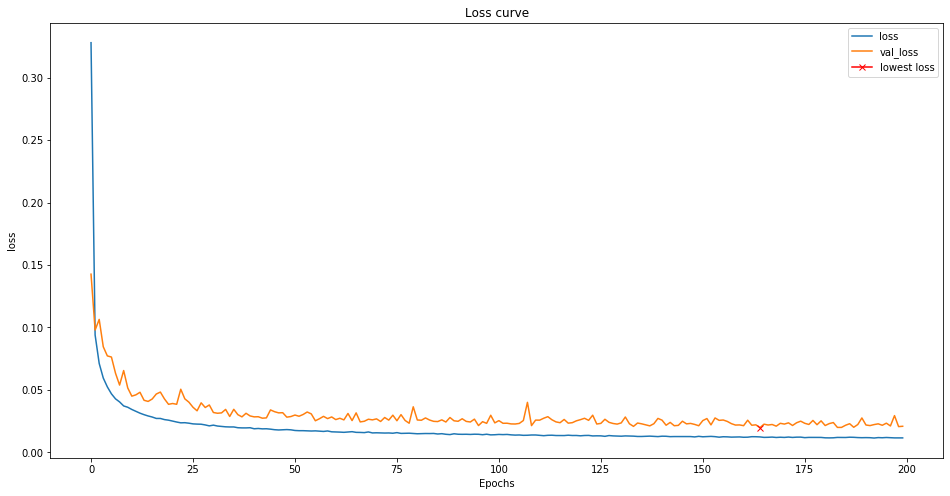

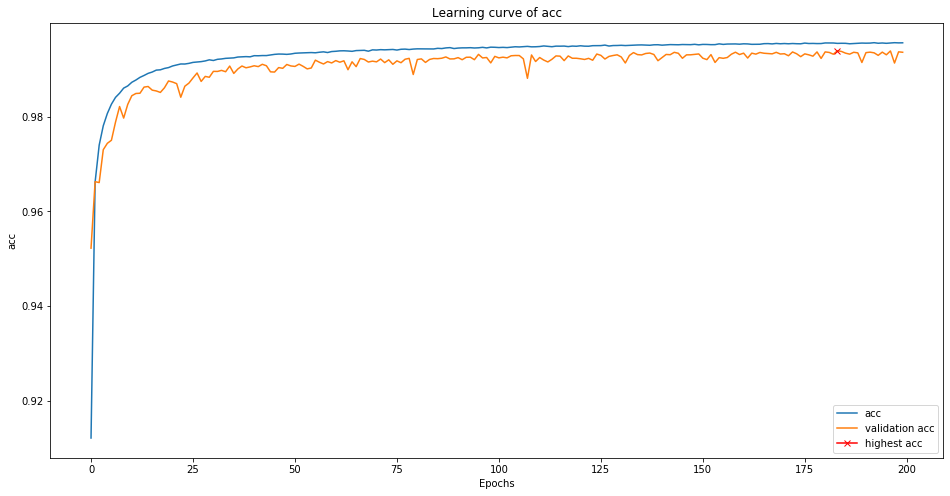

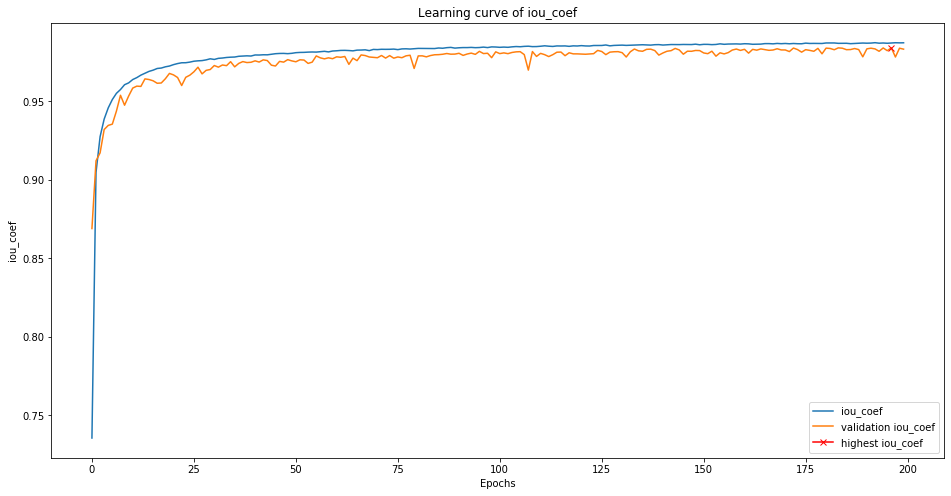

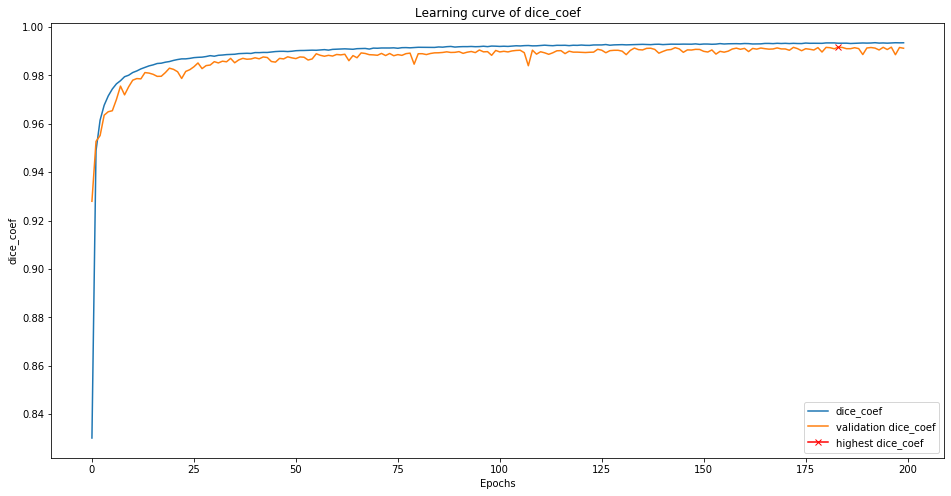

In [4]:
# save few predictions to dry
import training_plots
#training_plots.FIGSIZEm = (8,4)
#training_plots.FIGSIZE = (8,8)
str_folder = str(trainparam.outfolder)
nextset = next(biased_gen_test)
#predicted = model.predict(nextset[0])
#ground_truth = nextset[1]
# plot loss and other metrics
training_plots.plot_loss(fit_out,  str_folder)
training_plots.plot_metric(trainparam.metrics, fit_out, str_folder)


C:\Users\vinograd\Documents\GitHub\Seg-Grad-CAM\code\scr\training_plots.py:38: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=FIGSIZE)
C:\Users\vinograd\Documents\GitHub\Seg-Grad-CAM\code\scr\training_plots.py:18: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=FIGSIZE)
C:\Users\vinograd\Documents\GitHub\Seg-Grad-CAM\code\scr\training_plots.py:30: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed

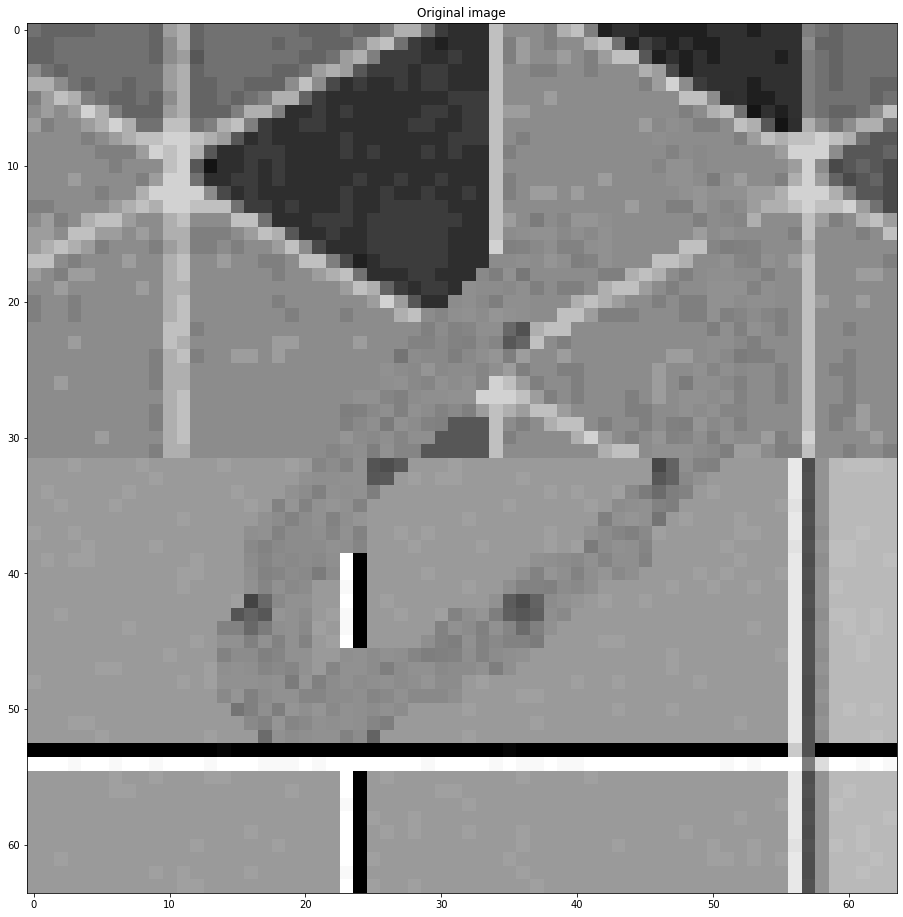

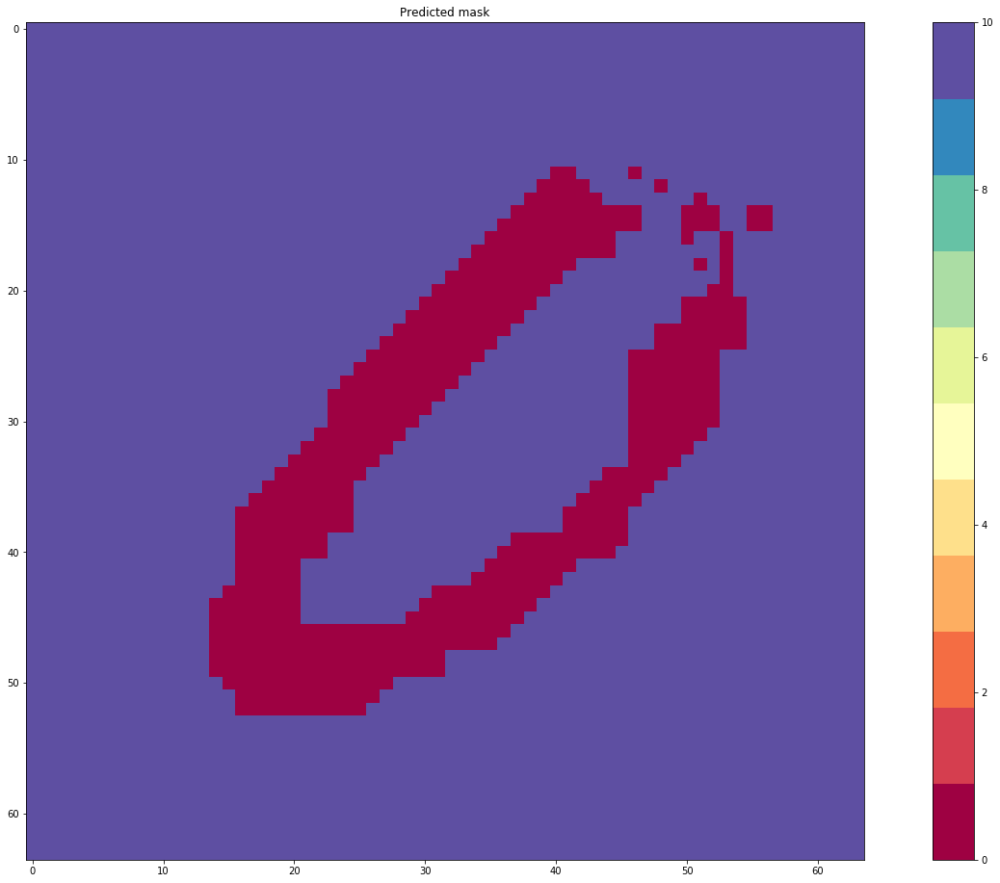

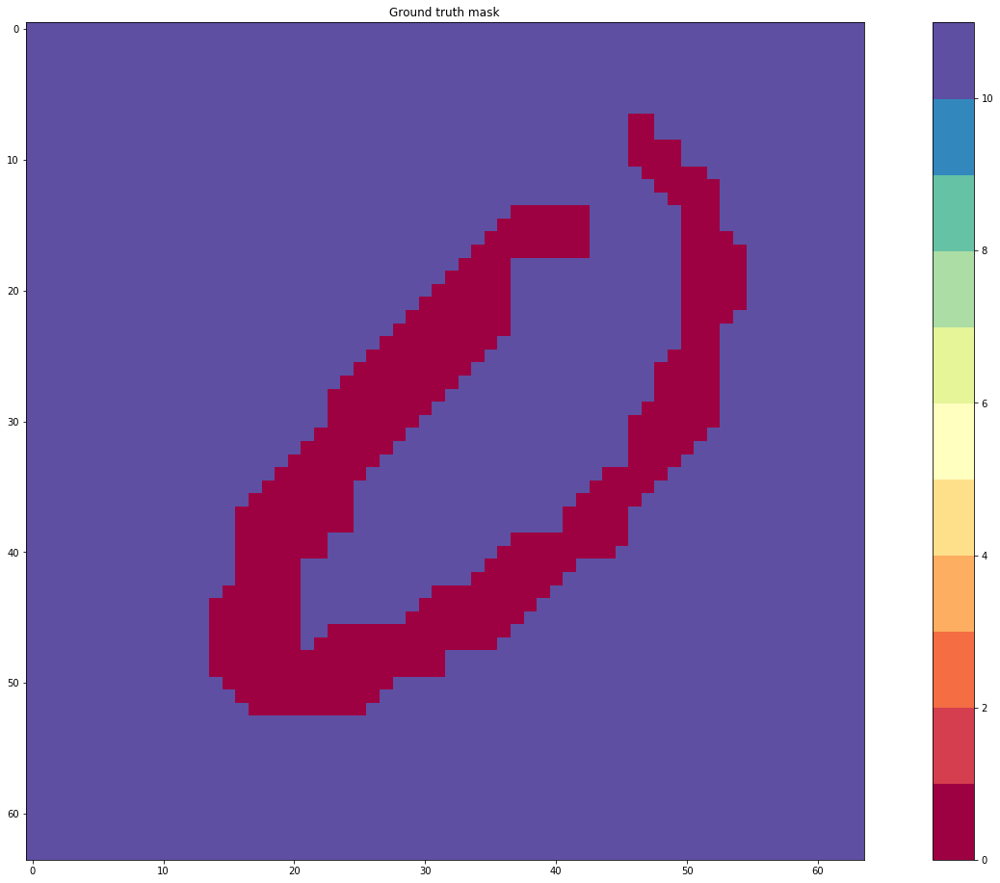

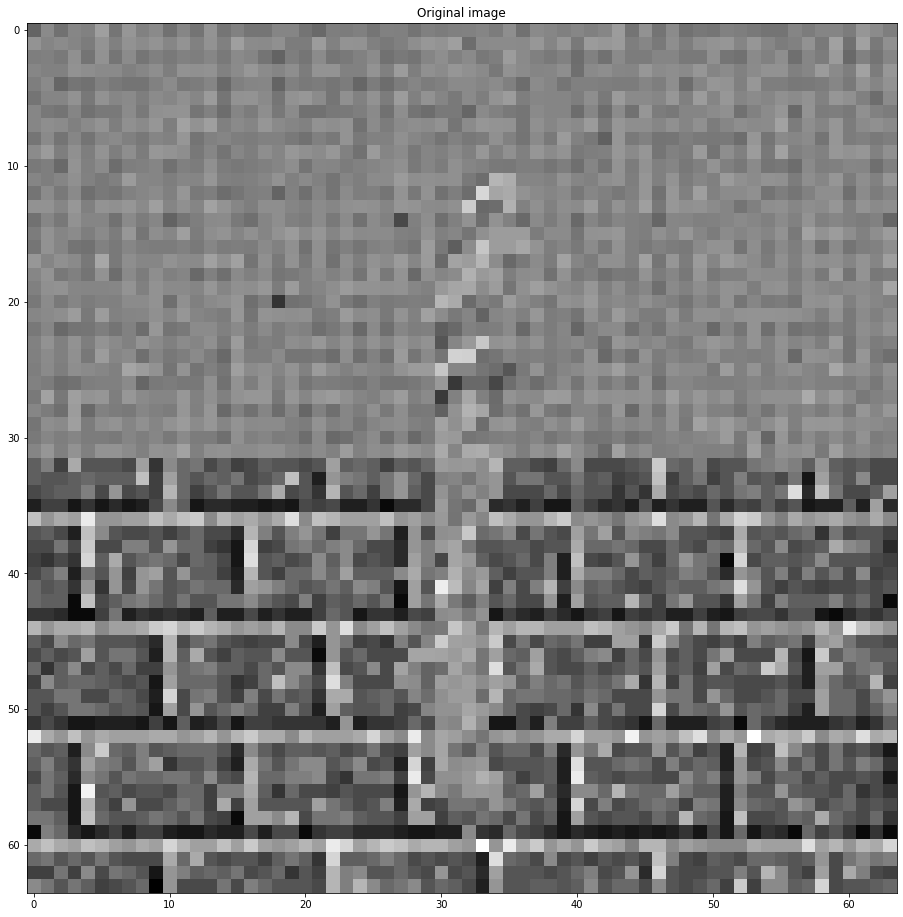

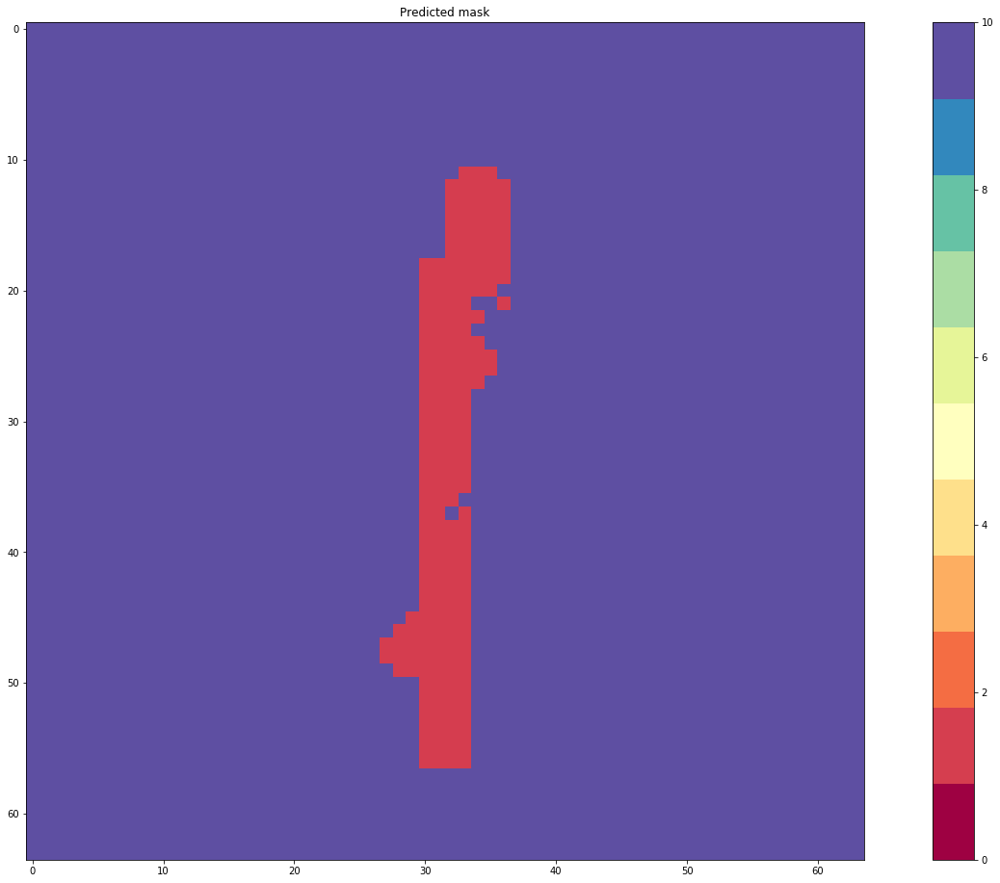

...

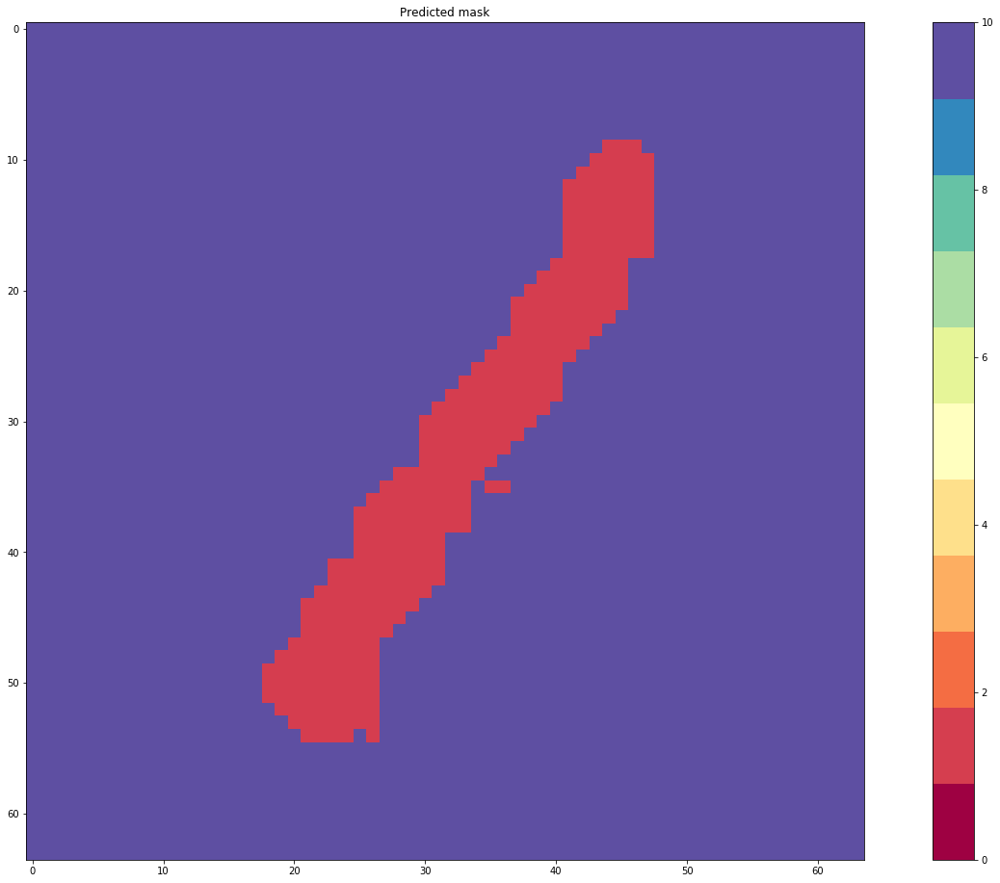

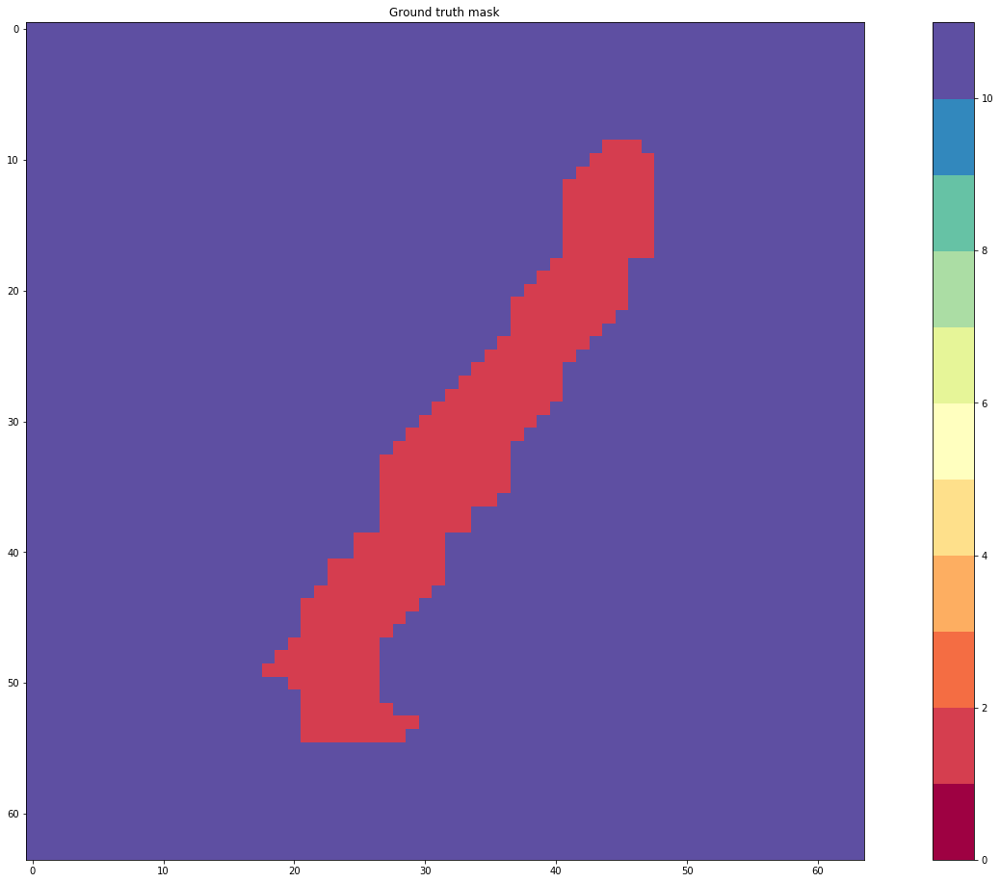

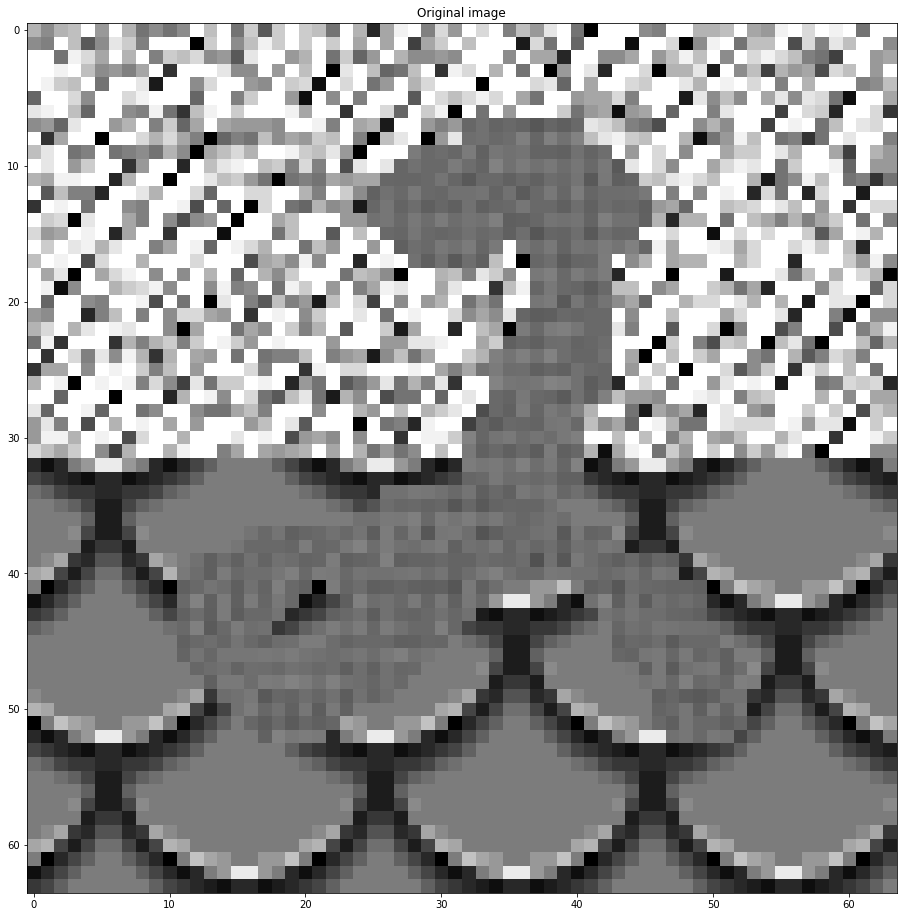

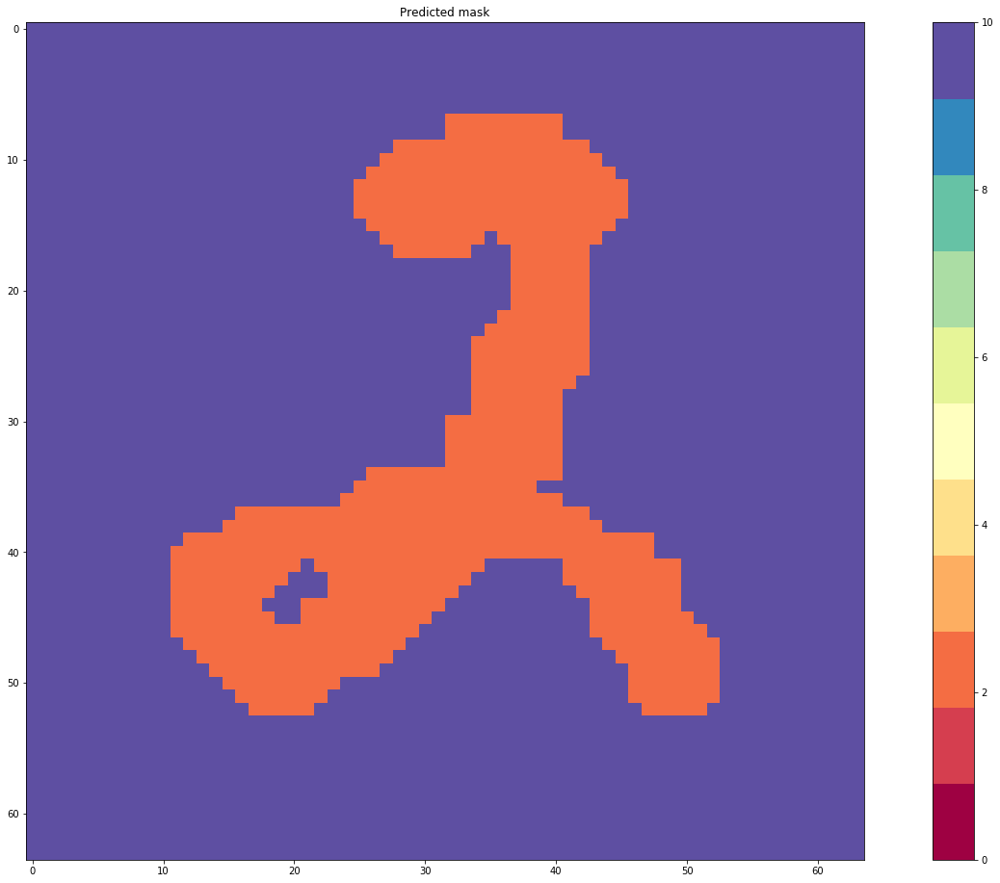

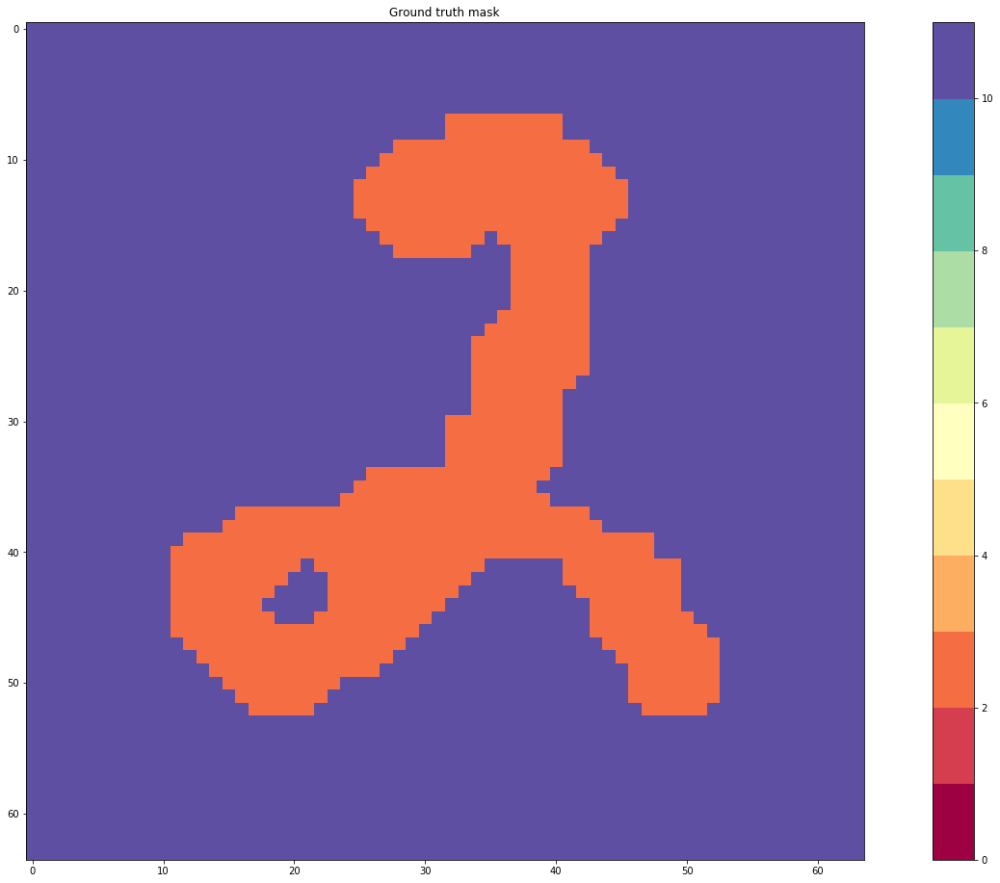

In [5]:
#from training_plots import plot_predict_and_gt, plot_loss, plot_metric

plot_predict_and_gt(trainunet.model, nextset[0], nextset[1], range(13), str_folder, trainparam.n_classes)
